In [3]:
import requests
import bs4
import os
import re
import unicodedata
import pandas as pd
import numpy as np
import nltk
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator

import acquire as a
import prepare as prep
import utilities as util

%matplotlib inline
import matplotlib.pyplot as plt
import seaborn as sns

import json
from typing import Dict, List, Optional, Union, cast


import sys
sys.path.insert(1, '/Users/matthewdalton/')
from env import github_token, github_username

from nltk.tokenize.toktok import ToktokTokenizer
from nltk.corpus import stopwords


from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report, accuracy_score
from sklearn.tree import export_graphviz
from sklearn.metrics import confusion_matrix
from sklearn.tree import DecisionTreeClassifier
    #import to be able to do decision tress
from sklearn.neighbors import KNeighborsClassifier
    #import to be able to do KNN
from sklearn.linear_model import LogisticRegression
    #import to be able to do logistic regression
from sklearn.linear_model import RidgeClassifier
from sklearn.linear_model import SGDClassifier

In [4]:
df = pd.read_csv('prepped_microsoft.csv')

In [5]:
df.drop(columns='Unnamed: 0', inplace=True)

In [12]:
top_10 = list(df.language.value_counts().index[:10])

In [14]:
df = df[df.language.isin(top_10)]

In [16]:
df.to_csv('prepped_microsoft2.csv')

In [18]:
df.drop(columns='Unnamed: 0.1')

,repo,language,readme_contents,lemmed_readme
0,microsoft/vscode-java-test,Java,# Java Test Runner\n\n> Run and debug Java tes...,java test runner run debug java test case visu...
1,microsoft/checkedc-clang,C++,# The Checked C clang repo\n\nThis repo contai...,checked c clang repothis repo contains version...
2,microsoft/azure-maven-plugins,Java,# Maven Plugins for Azure Services\n\nThis rep...,maven plugins azure servicesthis repository co...
3,microsoft/vscode-node-debug,TypeScript,# Node Debug (legacy)\n\n[![build status](http...,node debug legacybuild extension bundled visua...
4,microsoft/graphics-driver-samples,C++,# Overview\r\n\r\nThis project is focused on p...,overview project focused providing window grap...
...,...,...,...,...
1899,microsoft/Partner-Smart-Office,C#,# Partner Smart Office\n\n![Build status](http...,partner smart officebuild primary concern micr...
1900,microsoft/prepose,C#,PK,pk
1901,microsoft/python-type-stubs,Python,# Python Type Stubs\n\n## Introduction\n\nAs t...,python type stub introductionas python team he...
1902,microsoft/Cognitive-Emotion-Windows,C#,# Microsoft Emotion API: Windows Client Librar...,microsoft emotion api window client library sa...


In [19]:
df.dropna(inplace=True)

<ipython-input-19-c64f9f573c18>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.dropna(inplace=True)


Drop, &#9, provides no value

In [20]:
df.lemmed_readme = df.lemmed_readme.str.replace('&#9', '')

/usr/local/anaconda3/lib/python3.8/site-packages/pandas/core/generic.py:5168: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self[name] = value


In [22]:
df.lemmed_readme = df.lemmed_readme.str.replace(';', '')

# Explore

In [95]:
python = df[df.language == 'Python']

In [96]:
c_sharp = df[df.language == "C#"]

In [97]:
java = df[df.language == 'Java']

In [98]:
python_words = ' '.join(python.lemmed_readme)

In [99]:
c_sharp_words = ''.join(c_sharp.lemmed_readme)

In [100]:
java_words = ' '.join(java.lemmed_readme)

In [101]:
from PIL import Image

font_path = ('Users/matthewdalton/Library/Fonts/MesloLGS NF Bold Italic.ttf')

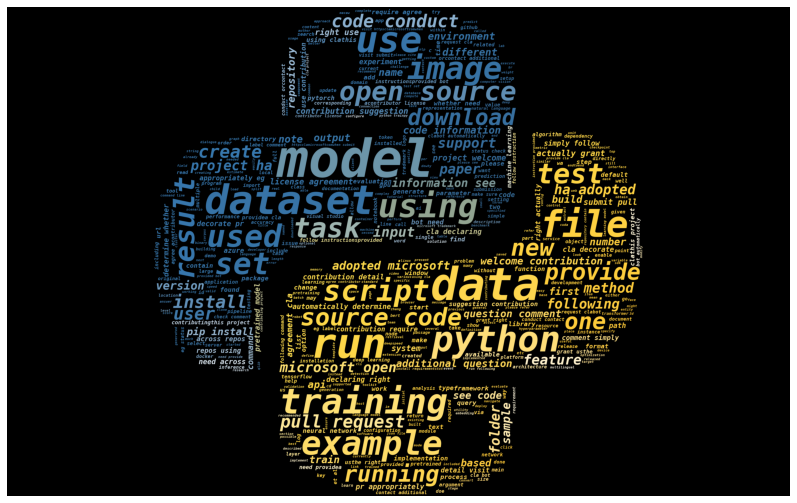

In [240]:
plt.figure(figsize=(16, 9))


mask = np.array(Image.open('python logo.jpeg'))
image_colors = ImageColorGenerator(mask)
img = WordCloud(background_color="black", font_path=font_path, mask=mask, 
                max_words=500, stopwords=STOPWORDS, max_font_size=256,
                random_state=42, width=1200, height=1200, color_func=image_colors).generate(python_words)
plt.imshow(img)

plt.axis('off')
plt.show()


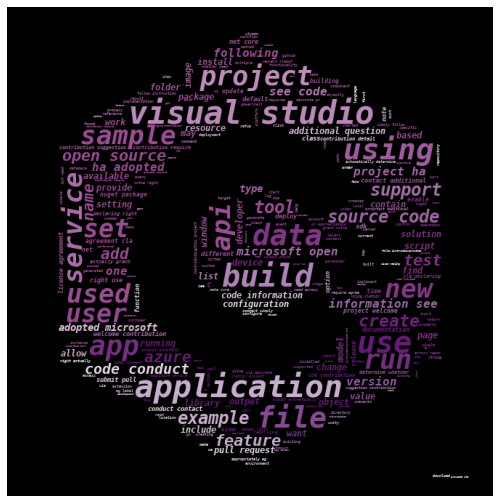

In [241]:
plt.figure(figsize=(16, 9))


mask = np.array(Image.open('C_sharp.jpeg'))
image_colors = ImageColorGenerator(mask)
img = WordCloud(background_color="black", font_path=font_path, mask=mask, 
                max_words=500, stopwords=STOPWORDS, max_font_size=128,
                random_state=42, width=1200, height=1200, color_func=image_colors).generate(c_sharp_words)
plt.imshow(img)

plt.axis('off')
plt.show()


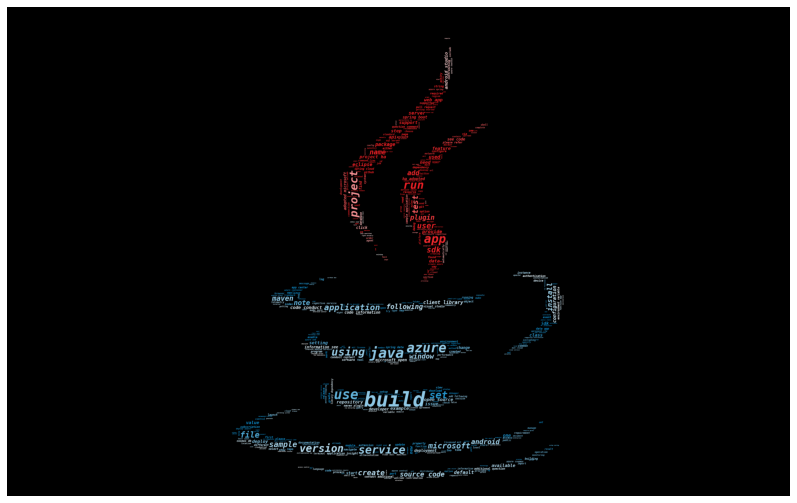

In [242]:
plt.figure(figsize=(16, 9))


mask = np.array(Image.open('Java-Emblem.jpeg'))
image_colors = ImageColorGenerator(mask)
img = WordCloud(background_color="black", font_path=font_path, mask=mask, 
                max_words=500, stopwords=STOPWORDS, max_font_size=256,
                random_state=42, width=1200, height=1200, color_func=image_colors).generate(java_words)
plt.imshow(img)

plt.axis('off')
plt.show()


In [243]:
all_words = ' '.join(df.lemmed_readme)

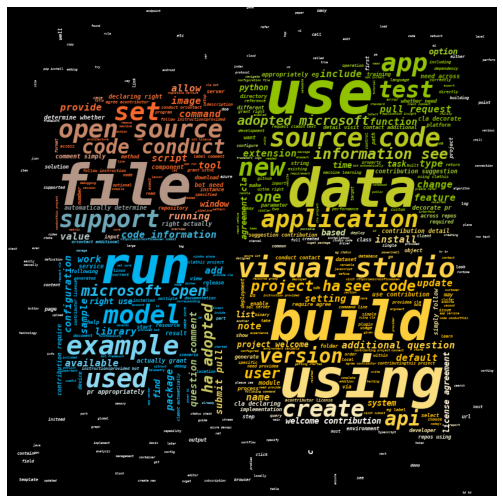

In [244]:
plt.figure(figsize=(16, 9))


mask = np.array(Image.open('LOGO.jpeg'))
image_colors = ImageColorGenerator(mask)
img = WordCloud(background_color="black", font_path=font_path, mask=mask, 
                max_words=500, stopwords=STOPWORDS, max_font_size=100,
                random_state=42, width=1200, height=1200, color_func=image_colors).generate(all_words)
plt.imshow(img)

plt.axis('off')
plt.show()


In [258]:
bigrams_python = nltk.ngrams(python_words.split(), 2)
trigrams_python = nltk.ngrams(python_words.split(), 3)

In [259]:
bigrams_python

<generator object ngrams at 0x7ff4110d5b30>

In [260]:
top_10_py_bigrams = (pd.Series(bigrams_python)
                      .value_counts()
                      .head(10))

top_10_py_bigrams.head()

(open, source)       219
(source, code)       215
(code, conduct)      176
(microsoft, open)    168
(pull, request)      168
dtype: int64

In [261]:
top_10_py_trigrams = (pd.Series(trigrams_python)
                      .value_counts()
                      .head(10))

top_10_py_trigrams.head()

(open, source, code)          175
(microsoft, open, source)     167
(ha, adopted, microsoft)      157
(adopted, microsoft, open)    157
(project, ha, adopted)        157
dtype: int64

In [262]:
bigrams_c_sharp = nltk.ngrams(c_sharp_words.split(), 2)
trigrams_c_sharp = nltk.ngrams(c_sharp_words.split(), 3)

In [263]:
bigrams_c_sharp

<generator object ngrams at 0x7ff4110d5740>

In [264]:
top_10_c_bigrams = (pd.Series(bigrams_c_sharp)
                      .value_counts()
                      .head(10))

top_10_c_bigrams

(visual, studio)        801
(source, code)          452
(open, source)          396
(code, conduct)         338
(microsoft, open)       333
(information, see)      323
(project, ha)           322
(ha, adopted)           315
(see, code)             313
(adopted, microsoft)    312
dtype: int64

In [265]:
top_10_c_trigrams = (pd.Series(trigrams_c_sharp)
                      .value_counts()
                      .head(10))

top_10_c_trigrams

(open, source, code)           332
(microsoft, open, source)      329
(adopted, microsoft, open)     312
(project, ha, adopted)         312
(ha, adopted, microsoft)       312
(information, see, code)       308
(see, code, conduct)           302
(source, code, information)    301
(code, information, see)       300
(submit, pull, request)        190
dtype: int64

In [266]:
bigrams_java = nltk.ngrams(java_words.split(), 2)
trigrams_java = nltk.ngrams(java_words.split(), 3)

In [267]:
bigrams_java

<generator object ngrams at 0x7ff3e5b77120>

In [268]:
top_10_java_bigrams = (pd.Series(bigrams_java)
                      .value_counts()
                      .head(10))

top_10_java_bigrams.head()

(source, code)       50
(client, library)    43
(code, conduct)      37
(android, studio)    35
(project, ha)        34
dtype: int64

In [269]:
top_10_java_trigrams = (pd.Series(trigrams_java)
                      .value_counts()
                      .head(10))

top_10_java_trigrams.head()

(open, source, code)           31
(microsoft, open, source)      31
(see, code, conduct)           28
(source, code, information)    28
(project, ha, adopted)         28
dtype: int64

# Split the Data

In [23]:
train, validate, test = util.split_dataframe(df)

In [24]:
print(train.shape)
print(validate.shape)
print(test.shape)

(1008, 5)
(433, 5)
(361, 5)


In [25]:
# Setup our X variables
X_train = train.lemmed_readme
X_validate = validate.lemmed_readme
X_test = test.lemmed_readme

In [26]:
# Setup our y variables
y_train = train.language
y_validate = validate.language
y_test = test.language

In [27]:
from sklearn.feature_extraction.text import TfidfVectorizer

In [28]:
# create the vectorized object
tfidf = TfidfVectorizer()

# fir the vectorized object onto train
tfidf.fit(X_train)

TfidfVectorizer()

In [29]:
# set up on the training data
X_train_vectorized = tfidf.transform(X_train)
X_validate_vectorized = tfidf.transform(X_validate)
X_test_vectorized = tfidf.transform(X_test)

In [30]:
X_train_vectorized.todense().shape

(1008, 45544)

In [31]:
# make the actual outcomes
train = pd.DataFrame(dict(actual=y_train))
validate = pd.DataFrame(dict(actual=y_validate))
test = pd.DataFrame(dict(actual=y_test))

# Pre-Modeling

In [32]:
# ignore warnings
import warnings
warnings.filterwarnings("ignore")

from sklearn.model_selection import RandomizedSearchCV, GridSearchCV
from scipy.stats import uniform

### Logisitic Regression Parameter tuning

In [149]:
# Create a parameter dictionary for the model, {'parameter': [list of settings]}
parameters = [
    {
    'penalty': ['l2'],
    'C': [1, 2, 3, 4, 5, 10],
    },
]
# Created variable model which holds the KNN model
model = LogisticRegression()

# Create grid_search model, looking at recall
grid_search = GridSearchCV(model,
                           param_grid=parameters,
                           cv=5,
                           scoring='accuracy',
                           )

# Create variable r that hold the FIT grid_search
r = grid_search.fit(X_train_vectorized, y_train)
scores = r.cv_results_
lm = r.best_estimator_


In [150]:
# Returns max value of the mean test score 
max(scores['mean_test_score'])

0.5667596775622287

In [151]:
# loop that runs all of the possible parameter configurations from the parameter dictionary above
for mean_score, params in sorted(list(zip(scores["mean_test_score"], scores["params"])),key = lambda x: x[0]):
     print(f'Best parameters for Logisitc Regression are {params} with a score of {mean_score}')

Best parameters for Logisitc Regression are {'C': 1, 'penalty': 'l2'} with a score of 0.497191956772079
Best parameters for Logisitc Regression are {'C': 2, 'penalty': 'l2'} with a score of 0.528231021348215
Best parameters for Logisitc Regression are {'C': 3, 'penalty': 'l2'} with a score of 0.5394986269820179
Best parameters for Logisitc Regression are {'C': 4, 'penalty': 'l2'} with a score of 0.5470147931614846
Best parameters for Logisitc Regression are {'C': 5, 'penalty': 'l2'} with a score of 0.5507839489768802
Best parameters for Logisitc Regression are {'C': 10, 'penalty': 'l2'} with a score of 0.5667596775622287


#### Logisitc Regression Parameters = {'C': 10, 'penalty': 'l2'}

### KNN Parameter tuning

In [129]:
# Create a parameter dictionary for the model, {'parameter': [list of settings]}
parameters = [
    {
        'n_neighbors': [5, 10, 20, 50, 100],
        'weights': ['uniform', 'distance'],
        'algorithm': ['auto', 'ball_tree', 'kd_tree', 'brute'],
        'p': [1, 2],
    },
]
# Created variable model which holds the KNN model
model = KNeighborsClassifier()

# Create grid_search model, looking at recall
grid_search = GridSearchCV(model,
                           param_grid=parameters,
                           cv=5,
                           scoring='accuracy',
                           )

# Create variable r that hold the FIT grid_search
r = grid_search.fit(X_train_vectorized, y_train)
scores = r.cv_results_
knn = r.best_estimator_


In [130]:
# Returns max value of the mean test score 
max(scores['mean_test_score'])

0.4943617680928337

In [132]:
# loop that runs all of the possible parameter configurations from the parameter dictionary above
for mean_score, params in sorted(list(zip(scores["mean_test_score"], scores["params"])),key = lambda x: x[0]):
     print(mean_score, params)

0.2104925148374524 {'algorithm': 'auto', 'n_neighbors': 5, 'p': 1, 'weights': 'distance'}
0.2104925148374524 {'algorithm': 'ball_tree', 'n_neighbors': 5, 'p': 1, 'weights': 'distance'}
0.2104925148374524 {'algorithm': 'kd_tree', 'n_neighbors': 5, 'p': 1, 'weights': 'distance'}
0.2104925148374524 {'algorithm': 'brute', 'n_neighbors': 5, 'p': 1, 'weights': 'distance'}
0.26224200549207194 {'algorithm': 'auto', 'n_neighbors': 10, 'p': 1, 'weights': 'distance'}
0.26224200549207194 {'algorithm': 'ball_tree', 'n_neighbors': 10, 'p': 1, 'weights': 'distance'}
0.26224200549207194 {'algorithm': 'kd_tree', 'n_neighbors': 10, 'p': 1, 'weights': 'distance'}
0.26224200549207194 {'algorithm': 'brute', 'n_neighbors': 10, 'p': 1, 'weights': 'distance'}
0.2716183895827797 {'algorithm': 'auto', 'n_neighbors': 20, 'p': 1, 'weights': 'uniform'}
0.2716183895827797 {'algorithm': 'auto', 'n_neighbors': 50, 'p': 1, 'weights': 'uniform'}
0.2716183895827797 {'algorithm': 'ball_tree', 'n_neighbors': 20, 'p': 1, '

#### KNN Parameters = {'algorithm': 'auto', 'n_neighbors': 20, 'p': 2, 'weights': 'distance'} and accuracy = 0.4943617680928337

### Decision Tree Parameter tuning

In [133]:
# Create a parameter dictionary for the model, {'parameter': [list of settings]}
parameters = [
    {
        'criterion': ["gini", "entropy"],
        'splitter': ['best', 'random'],
        'max_depth': [1, 3, 5, 7, 9],
        'min_samples_split': [1, 2],
    },
]
# Created variable model which holds the KNN model
model = DecisionTreeClassifier()

# Create grid_search model, looking at recall
grid_search = GridSearchCV(model,
                           param_grid=parameters,
                           cv=5,
                           scoring='accuracy',
                           )

# Create variable r that hold the FIT grid_search
r = grid_search.fit(X_train_vectorized, y_train)
scores = r.cv_results_
dt = r.best_estimator_


In [134]:
# Returns max value of the mean test score 
max(scores['mean_test_score'])

nan

In [135]:
# loop that runs all of the possible parameter configurations from the parameter dictionary above
for mean_score, params in sorted(list(zip(scores["mean_test_score"], scores["params"])),key = lambda x: x[0]):
     print(mean_score, params)

nan {'criterion': 'gini', 'max_depth': 1, 'min_samples_split': 1, 'splitter': 'best'}
nan {'criterion': 'gini', 'max_depth': 1, 'min_samples_split': 1, 'splitter': 'random'}
0.3082868278855523 {'criterion': 'gini', 'max_depth': 1, 'min_samples_split': 2, 'splitter': 'random'}
0.3233413056958101 {'criterion': 'gini', 'max_depth': 1, 'min_samples_split': 2, 'splitter': 'best'}
nan {'criterion': 'gini', 'max_depth': 3, 'min_samples_split': 1, 'splitter': 'best'}
nan {'criterion': 'gini', 'max_depth': 3, 'min_samples_split': 1, 'splitter': 'random'}
0.3421029320577553 {'criterion': 'entropy', 'max_depth': 3, 'min_samples_split': 2, 'splitter': 'random'}
0.3505713526441669 {'criterion': 'entropy', 'max_depth': 1, 'min_samples_split': 2, 'splitter': 'best'}
0.3609309947736735 {'criterion': 'gini', 'max_depth': 3, 'min_samples_split': 2, 'splitter': 'random'}
0.3928913101249004 {'criterion': 'gini', 'max_depth': 7, 'min_samples_split': 2, 'splitter': 'random'}
0.42857649038887413 {'criterion'

#### Decision Tree Parameters = {'criterion': 'entropy', 'max_depth': 3, 'min_samples_split': 2, 'splitter': 'best'} and accuracy = 0.44454336079369294

### Ridge Classifier Parameter tuning

In [146]:
# Create a parameter dictionary for the model, {'parameter': [list of settings]}
parameters = [
    {
    'alpha': [1.0, 1.5, 2.0, 5.0],
    'fit_intercept':[True,False],
    'normalize': [True, False],
    'copy_X':[True, False],
    'class_weight':[None, 'balanced'],    
    },
]
# Created variable model which holds the KNN model
model = RidgeClassifier()

# Create grid_search model, looking at recall
grid_search = GridSearchCV(model,
                           param_grid=parameters,
                           cv=5,
                           scoring='accuracy',
                           )

# Create variable r that hold the FIT grid_search
r = grid_search.fit(X_train_vectorized, y_train)
scores = r.cv_results_
rc = r.best_estimator_


In [147]:
# Returns max value of the mean test score 
max(scores['mean_test_score'])

0.5827309770573124

In [148]:
# loop that runs all of the possible parameter configurations from the parameter dictionary above
for mean_score, params in sorted(list(zip(scores["mean_test_score"], scores["params"])),key = lambda x: x[0]):
     print(mean_score, params)

0.40700682079900796 {'alpha': 5.0, 'class_weight': 'balanced', 'copy_X': True, 'fit_intercept': True, 'normalize': False}
0.40700682079900796 {'alpha': 5.0, 'class_weight': 'balanced', 'copy_X': False, 'fit_intercept': True, 'normalize': False}
0.43800159447249537 {'alpha': 2.0, 'class_weight': 'balanced', 'copy_X': True, 'fit_intercept': True, 'normalize': False}
0.43800159447249537 {'alpha': 2.0, 'class_weight': 'balanced', 'copy_X': False, 'fit_intercept': True, 'normalize': False}
0.4389405616086456 {'alpha': 1.5, 'class_weight': 'balanced', 'copy_X': True, 'fit_intercept': True, 'normalize': False}
0.4389405616086456 {'alpha': 1.5, 'class_weight': 'balanced', 'copy_X': False, 'fit_intercept': True, 'normalize': False}
0.44834794933120736 {'alpha': 5.0, 'class_weight': 'balanced', 'copy_X': True, 'fit_intercept': True, 'normalize': True}
0.44834794933120736 {'alpha': 5.0, 'class_weight': 'balanced', 'copy_X': False, 'fit_intercept': True, 'normalize': True}
0.44835237842147224 {'al

#### Ridge Classifier Parameters = {'alpha': 1.0, 'class_weight': None, 'copy_X': False, 'fit_intercept': False, 'normalize': False} and accuracy = 0.5827309770573124

### SGDClassifier Parameter tuning

In [156]:
# Create a parameter dictionary for the model, {'parameter': [list of settings]}
parameters = [
    {
        'loss': ['hinge', 'log', 'modified_huber', 'squared_hinge', 'perceptron'],
        'penalty': ['l2'],
        'alpha': [0.0001, 0.001, 0.01],
        'fit_intercept': [True, False],
        'max_iter': [10],
        'shuffle': [True, False],
        'verbose': [0, 1, 3, 5, 10],
    },
]
# Created variable model which holds the KNN model
model = SGDClassifier()

# Create grid_search model, looking at recall
grid_search = GridSearchCV(model,
                           param_grid=parameters,
                           cv=5,
                           scoring='accuracy',
                           )

# Create variable r that hold the FIT grid_search
r = grid_search.fit(X_train_vectorized, y_train)
scores = r.cv_results_
sgd = r.best_estimator_

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


-- Epoch 1
Norm: 40.71, NNZs: 5814, Bias: -1.050509, T: 851, Avg. loss: 0.089599
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 30.49, NNZs: 6233, Bias: -1.195959, T: 1702, Avg. loss: 0.009147
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 24.58, NNZs: 6651, Bias: -1.193569, T: 2553, Avg. loss: 0.002537
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 23.18, NNZs: 7168, Bias: -1.141182, T: 3404, Avg. loss: 0.004351
Total training time: 0.00 seconds.
-- Epoch 5
Norm: 21.25, NNZs: 7288, Bias: -1.117227, T: 4255, Avg. loss: 0.002566
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 19.91, NNZs: 8025, Bias: -1.114723, T: 5106, Avg. loss: 0.002447
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 18.00, NNZs: 8065, Bias: -1.114143, T: 5957, Avg. loss: 0.000216
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 17.53, NNZs: 8286, Bias: -1.087422, T: 6808, Avg. loss: 0.002268
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 16.24, NNZs: 8582, Bias: -1.087817, T: 7659, Avg

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 30.36, NNZs: 16223, Bias: -1.409040, T: 5957, Avg. loss: 0.013723
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 28.83, NNZs: 16621, Bias: -1.380277, T: 6808, Avg. loss: 0.014632
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 27.24, NNZs: 16885, Bias: -1.331619, T: 7659, Avg. loss: 0.012702
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 26.75, NNZs: 17256, Bias: -1.279101, T: 8510, Avg. loss: 0.013616
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 25.38, NNZs: 2434, Bias: -0.943216, T: 851, Avg. loss: 0.036783
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 20.56, NNZs: 3200, Bias: -1.041349, T: 1702, Avg. loss: 0.005644
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 16.99, NNZs: 3299, Bias: -1.083440, T: 2553, Avg. loss: 0.003799
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 14.91, NNZs: 3454, Bias: -1.084206, T: 3404, Avg. loss: 0.000967
Total training time: 0.00 seconds.
-- Epoch 5
Norm: 13.83, NNZs: 3532, Bias: -1.062372, T: 4255, Avg. loss

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s


Norm: 35.95, NNZs: 3974, Bias: -1.298639, T: 852, Avg. loss: 0.083683
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 27.56, NNZs: 4243, Bias: -1.339367, T: 1704, Avg. loss: 0.011506
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 24.69, NNZs: 4553, Bias: -1.301121, T: 2556, Avg. loss: 0.006780
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 22.09, NNZs: 4661, Bias: -1.274436, T: 3408, Avg. loss: 0.004809
Total training time: 0.00 seconds.
-- Epoch 5
Norm: 20.41, NNZs: 4764, Bias: -1.277770, T: 4260, Avg. loss: 0.004231
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 18.41, NNZs: 4832, Bias: -1.257935, T: 5112, Avg. loss: 0.000718
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 17.68, NNZs: 5096, Bias: -1.243444, T: 5964, Avg. loss: 0.002156
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 16.49, NNZs: 5295, Bias: -1.258081, T: 6816, Avg. loss: 0.000764
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 15.50, NNZs: 5323, Bias: -1.246254, T: 7668, Avg. loss: 0.0

[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 14.72, NNZs: 5509, Bias: -1.295868, T: 8510, Avg. loss: 0.007394
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 56.79, NNZs: 8864, Bias: -1.330219, T: 851, Avg. loss: 0.311192
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 46.91, NNZs: 10150, Bias: -1.495342, T: 1702, Avg. loss: 0.060685
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 42.44, NNZs: 11124, Bias: -1.403806, T: 2553, Avg. loss: 0.037473
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 38.95, NNZs: 12111, Bias: -1.383711, T: 3404, Avg. loss: 0.029048
Total training time: 0.00 seconds.
-- Epoch 5
Norm: 34.99, NNZs: 12729, Bias: -1.440603, T: 4255, Avg. loss: 0.020969
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 32.22, NNZs: 12876, Bias: -1.369450, T: 5106, Avg. loss: 0.018363
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 29.93, NNZs: 13148, Bias: -1.368667, T: 5957, Avg. loss: 0.016430
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 28.89, NNZs: 13689, Bias: -1.328386, T: 6808, Avg. lo

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s


Norm: 21.28, NNZs: 7534, Bias: -1.256969, T: 6808, Avg. loss: 0.007290
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 20.82, NNZs: 7576, Bias: -1.232689, T: 7659, Avg. loss: 0.006377
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 19.80, NNZs: 7854, Bias: -1.221468, T: 8510, Avg. loss: 0.005718
Total training time: 0.01 seconds.
Convergence after 10 epochs took 0.01 seconds
-- Epoch 1
Norm: 67.12, NNZs: 14026, Bias: -0.980767, T: 851, Avg. loss: 0.299317
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 53.58, NNZs: 15315, Bias: -0.964207, T: 1702, Avg. loss: 0.056509
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 44.76, NNZs: 16946, Bias: -1.006080, T: 2553, Avg. loss: 0.023956
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 39.27, NNZs: 17338, Bias: -0.953732, T: 3404, Avg. loss: 0.017916
Total training time: 0.00 seconds.
-- Epoch 5
Norm: 34.96, NNZs: 18349, Bias: -1.014232, T: 4255, Avg. loss: 0.013486
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 32.40, 

[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 17.72, NNZs: 4291, Bias: -1.203226, T: 3404, Avg. loss: 0.000886
Total training time: 0.00 seconds.
-- Epoch 5
Norm: 15.23, NNZs: 4329, Bias: -1.202726, T: 4255, Avg. loss: 0.000877
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 14.16, NNZs: 4375, Bias: -1.168863, T: 5106, Avg. loss: 0.000972
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 13.82, NNZs: 4555, Bias: -1.185108, T: 5957, Avg. loss: 0.001530
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 12.89, NNZs: 4958, Bias: -1.185679, T: 6808, Avg. loss: 0.000844
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 12.90, NNZs: 5121, Bias: -1.161328, T: 7659, Avg. loss: 0.001097
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 78.69, NNZs: 15996, Bias: -0.807965, T: 851, Avg. loss: 0.450439
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 62.24, NNZs: 17791, Bias: -1.113429, T: 1702, Avg. loss: 0.068734
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 51.80, NNZs:

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s


Convergence after 10 epochs took 0.01 seconds
-- Epoch 1
Norm: 88.18, NNZs: 15246, Bias: -1.167323, T: 851, Avg. loss: 0.627859
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 70.70, NNZs: 17640, Bias: -1.203903, T: 1702, Avg. loss: 0.132323
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 58.96, NNZs: 19052, Bias: -1.103643, T: 2553, Avg. loss: 0.052359
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 52.01, NNZs: 20190, Bias: -1.143088, T: 3404, Avg. loss: 0.041323
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 46.94, NNZs: 20794, Bias: -1.076990, T: 4255, Avg. loss: 0.038728
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 43.47, NNZs: 21511, Bias: -1.039095, T: 5106, Avg. loss: 0.031510
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 41.89, NNZs: 21948, Bias: -1.006927, T: 5957, Avg. loss: 0.030685
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 40.16, NNZs: 22622, Bias: -0.953060, T: 6808, Avg. loss: 0.024520
Total training time: 0.01 seconds.
-- Epoch 9


[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s


Norm: 42.97, NNZs: 13298, Bias: -1.487559, T: 2553, Avg. loss: 0.027686
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 38.11, NNZs: 13845, Bias: -1.423574, T: 3404, Avg. loss: 0.022824
Total training time: 0.00 seconds.
-- Epoch 5
Norm: 35.75, NNZs: 15160, Bias: -1.429235, T: 4255, Avg. loss: 0.024482
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 32.29, NNZs: 15489, Bias: -1.414645, T: 5106, Avg. loss: 0.016072
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 29.99, NNZs: 15969, Bias: -1.401685, T: 5957, Avg. loss: 0.012015
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 28.67, NNZs: 16241, Bias: -1.415623, T: 6808, Avg. loss: 0.015452
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 27.46, NNZs: 16644, Bias: -1.357199, T: 7659, Avg. loss: 0.013754
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 26.45, NNZs: 16957, Bias: -1.379628, T: 8510, Avg. loss: 0.012010
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 26.53, NNZs: 2418, Bias: -1.010708, T: 851, Avg. 

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


-- Epoch 8
Norm: 11.39, NNZs: 3584, Bias: -1.119158, T: 6808, Avg. loss: 0.000663
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 10.69, NNZs: 3700, Bias: -1.142942, T: 7659, Avg. loss: 0.000214
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 25.29, NNZs: 2401, Bias: -1.292560, T: 851, Avg. loss: 0.025504
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 18.43, NNZs: 2528, Bias: -1.249859, T: 1702, Avg. loss: 0.005466
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 16.66, NNZs: 2593, Bias: -1.201973, T: 2553, Avg. loss: 0.003125
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 14.34, NNZs: 3255, Bias: -1.310965, T: 3404, Avg. loss: 0.003064
Total training time: 0.00 seconds.
-- Epoch 5
Norm: 12.88, NNZs: 3326, Bias: -1.310423, T: 4255, Avg. loss: 0.002305
Total training time: 0.00 seconds.
-- Epoch 6
Norm: 11.98, NNZs: 3365, Bias: -1.294186, T: 5106, Avg. loss: 0.000478
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 10.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s


Norm: 11.78, NNZs: 3185, Bias: -1.225592, T: 5112, Avg. loss: 0.000911
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 10.73, NNZs: 3185, Bias: -1.211128, T: 5964, Avg. loss: 0.000095
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 10.61, NNZs: 3223, Bias: -1.212754, T: 6816, Avg. loss: 0.001751
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 34.68, NNZs: 4770, Bias: -1.157352, T: 852, Avg. loss: 0.068804
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 25.73, NNZs: 5145, Bias: -1.268216, T: 1704, Avg. loss: 0.009185
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 23.01, NNZs: 5646, Bias: -1.211223, T: 2556, Avg. loss: 0.005650
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 20.85, NNZs: 5994, Bias: -1.195135, T: 3408, Avg. loss: 0.005509
Total training time: 0.00 seconds.
-- Epoch 5
Norm: 18.94, NNZs: 6378, Bias: -1.239218, T: 4260, Avg. loss: 0.003307
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 16.90, NNZs: 6

[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


-- Epoch 3
Norm: 25.23, NNZs: 4592, Bias: -1.365843, T: 2553, Avg. loss: 0.014411
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 23.13, NNZs: 4969, Bias: -1.312100, T: 3404, Avg. loss: 0.016232
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 20.91, NNZs: 5273, Bias: -1.333097, T: 4255, Avg. loss: 0.008795
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 19.14, NNZs: 5283, Bias: -1.317865, T: 5106, Avg. loss: 0.005416
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 18.49, NNZs: 5594, Bias: -1.334369, T: 5957, Avg. loss: 0.008033
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 17.55, NNZs: 5695, Bias: -1.307323, T: 6808, Avg. loss: 0.004861
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 16.45, NNZs: 5766, Bias: -1.319579, T: 7659, Avg. loss: 0.004695
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 15.33, NNZs: 5793, Bias: -1.308290, T: 8510, Avg. loss: 0.004247
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 36.55, NNZs: 3344, Bias: -1.246111, T: 851, Av

[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s


Norm: 16.54, NNZs: 5402, Bias: -1.196031, T: 7659, Avg. loss: 0.004186
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 16.01, NNZs: 5486, Bias: -1.196049, T: 8510, Avg. loss: 0.004790
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 34.96, NNZs: 4503, Bias: -1.093373, T: 851, Avg. loss: 0.090223
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 27.79, NNZs: 4763, Bias: -1.202654, T: 1702, Avg. loss: 0.029318
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 24.63, NNZs: 5176, Bias: -1.203618, T: 2553, Avg. loss: 0.011548
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 20.63, NNZs: 5216, Bias: -1.231555, T: 3404, Avg. loss: 0.008802
Total training time: 0.00 seconds.
-- Epoch 5
Norm: 18.62, NNZs: 5519, Bias: -1.191256, T: 4255, Avg. loss: 0.006177
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 17.26, NNZs: 5633, Bias: -1.227224, T: 5106, Avg. loss: 0.008124
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 17.59, NNZs: 5950, Bias: -1.226471, T: 5957, Avg. loss: 0.

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Norm: 16.19, NNZs: 4670, Bias: -1.272955, T: 5957, Avg. loss: 0.004519
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 14.90, NNZs: 4689, Bias: -1.259105, T: 6808, Avg. loss: 0.004671
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 14.54, NNZs: 5049, Bias: -1.234635, T: 7659, Avg. loss: 0.005233
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 14.32, NNZs: 5097, Bias: -1.225512, T: 8510, Avg. loss: 0.004502
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 55.31, NNZs: 10142, Bias: -1.231513, T: 851, Avg. loss: 0.330937
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 45.84, NNZs: 11210, Bias: -1.302112, T: 1702, Avg. loss: 0.065389
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 41.88, NNZs: 11999, Bias: -1.345297, T: 2553, Avg. loss: 0.046254
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 37.67, NNZs: 12564, Bias: -1.327765, T: 3404, Avg. loss: 0.037533
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 34.27, NNZs: 12984, Bias: -1.389107, T: 4255, Avg. los

[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s


Norm: 43.30, NNZs: 10726, Bias: -1.402593, T: 2553, Avg. loss: 0.040742
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 38.08, NNZs: 11041, Bias: -1.365236, T: 3404, Avg. loss: 0.023728
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 35.23, NNZs: 11456, Bias: -1.435750, T: 4255, Avg. loss: 0.023821
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 32.59, NNZs: 12397, Bias: -1.399603, T: 5106, Avg. loss: 0.019187
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 30.88, NNZs: 12690, Bias: -1.372148, T: 5957, Avg. loss: 0.019627
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 29.06, NNZs: 13358, Bias: -1.411829, T: 6808, Avg. loss: 0.014496
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 27.63, NNZs: 13880, Bias: -1.383809, T: 7659, Avg. loss: 0.014728
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 26.95, NNZs: 14070, Bias: -1.329067, T: 8510, Avg. loss: 0.013892
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 46.29, NNZs: 8786, Bias: -1.331234, T: 851, Avg. 

[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished


Norm: 28.15, NNZs: 13210, Bias: -1.244955, T: 6816, Avg. loss: 0.009355
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 27.11, NNZs: 14066, Bias: -1.231454, T: 7668, Avg. loss: 0.007459
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 26.14, NNZs: 14374, Bias: -1.230616, T: 8520, Avg. loss: 0.008076
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 46.73, NNZs: 9209, Bias: -1.180339, T: 852, Avg. loss: 0.149242
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 35.40, NNZs: 9631, Bias: -1.323567, T: 1704, Avg. loss: 0.017359
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 30.46, NNZs: 10124, Bias: -1.293012, T: 2556, Avg. loss: 0.011625
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 28.15, NNZs: 10925, Bias: -1.287305, T: 3408, Avg. loss: 0.009742
Total training time: 0.00 seconds.
-- Epoch 5
Norm: 25.78, NNZs: 11282, Bias: -1.229004, T: 4260, Avg. loss: 0.004363
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 24.01, NNZs: 11654, Bias: -1.232223, T: 5112, Avg. l

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


-- Epoch 1
Norm: 41.09, NNZs: 5838, Bias: -1.219055, T: 851, Avg. loss: 0.091202
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 31.68, NNZs: 6186, Bias: -1.254753, T: 1702, Avg. loss: 0.008475
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 25.59, NNZs: 6402, Bias: -1.192946, T: 2553, Avg. loss: 0.003668
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 22.83, NNZs: 6717, Bias: -1.142684, T: 3404, Avg. loss: 0.001829
Total training time: 0.00 seconds.
-- Epoch 5
Norm: 22.18, NNZs: 7220, Bias: -1.104928, T: 4255, Avg. loss: 0.004059
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 19.76, NNZs: 7450, Bias: -1.140604, T: 5106, Avg. loss: 0.000724
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 18.29, NNZs: 7484, Bias: -1.124481, T: 5957, Avg. loss: 0.001213
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 17.39, NNZs: 7754, Bias: -1.097256, T: 6808, Avg. loss: 0.000710
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 16.08, NNZs: 7763, Bias: -1.098110, T: 7659, Avg

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 38.02, NNZs: 14219, Bias: -1.354902, T: 3404, Avg. loss: 0.019573
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 34.54, NNZs: 14698, Bias: -1.294668, T: 4255, Avg. loss: 0.019970
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 32.61, NNZs: 15502, Bias: -1.311349, T: 5106, Avg. loss: 0.015419
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 30.03, NNZs: 15718, Bias: -1.280062, T: 5957, Avg. loss: 0.012815
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 28.78, NNZs: 16180, Bias: -1.254761, T: 6808, Avg. loss: 0.011899
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 27.64, NNZs: 16646, Bias: -1.255836, T: 7659, Avg. loss: 0.012128
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 26.93, NNZs: 17136, Bias: -1.234626, T: 8510, Avg. loss: 0.011265
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 26.29, NNZs: 2124, Bias: -0.985645, T: 851, Avg. loss: 0.036209
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 21.41, NNZs: 2909, Bias: -1.211398, T: 1702, Avg. l

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s


Norm: 27.48, NNZs: 4763, Bias: -1.312279, T: 1704, Avg. loss: 0.010999
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 23.06, NNZs: 4781, Bias: -1.219124, T: 2556, Avg. loss: 0.003712
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 20.79, NNZs: 5318, Bias: -1.245210, T: 3408, Avg. loss: 0.003046
Total training time: 0.00 seconds.
-- Epoch 5
Norm: 18.97, NNZs: 5415, Bias: -1.204822, T: 4260, Avg. loss: 0.002993
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 17.00, NNZs: 5601, Bias: -1.224151, T: 5112, Avg. loss: 0.000973
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 15.97, NNZs: 6054, Bias: -1.224860, T: 5964, Avg. loss: 0.002340
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 15.01, NNZs: 6099, Bias: -1.212032, T: 6816, Avg. loss: 0.000345
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 14.88, NNZs: 6327, Bias: -1.199916, T: 7668, Avg. loss: 0.001558
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 13.96, NNZs: 6393, Bias: -1.211018, T: 8520, Avg. loss: 0

[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 36.18, NNZs: 4223, Bias: -1.415845, T: 851, Avg. loss: 0.096478
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 29.47, NNZs: 4543, Bias: -1.374153, T: 1702, Avg. loss: 0.025144
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 27.16, NNZs: 5147, Bias: -1.438087, T: 2553, Avg. loss: 0.014432
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 23.46, NNZs: 5292, Bias: -1.413880, T: 3404, Avg. loss: 0.005935
Total training time: 0.00 seconds.
-- Epoch 5
Norm: 21.17, NNZs: 5348, Bias: -1.413365, T: 4255, Avg. loss: 0.008030
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 19.63, NNZs: 5631, Bias: -1.413743, T: 5106, Avg. loss: 0.006199
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 18.19, NNZs: 5649, Bias: -1.396933, T: 5957, Avg. loss: 0.005263
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 17.77, NNZs: 5862, Bias: -1.357851, T: 6808, Avg. loss: 0.005347
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 16.65, NNZs: 6005, Bias: -1.371564, T: 7659, Avg. loss: 0.0

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 30.42, NNZs: 14046, Bias: -1.206634, T: 5957, Avg. loss: 0.016180
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 29.20, NNZs: 14306, Bias: -1.207367, T: 6808, Avg. loss: 0.017852
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 28.12, NNZs: 14719, Bias: -1.182092, T: 7659, Avg. loss: 0.014643
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 27.05, NNZs: 14788, Bias: -1.171426, T: 8510, Avg. loss: 0.013391
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 44.94, NNZs: 7591, Bias: -1.288132, T: 851, Avg. loss: 0.151983
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 38.09, NNZs: 9378, Bias: -1.307308, T: 1702, Avg. loss: 0.027751
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 32.38, NNZs: 9914, Bias: -1.322720, T: 2553, Avg. loss: 0.012479
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 27.68, NNZs: 10075, Bias: -1.378979, T: 3404, Avg. loss: 0.005057
Total training time: 0.00 seconds.
-- Epoch 5
Norm: 25.04, NNZs: 10549, Bias: -1.398443, T: 4255, Avg. lo

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s


Norm: 24.78, NNZs: 10333, Bias: -1.301602, T: 4255, Avg. loss: 0.004125
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 23.67, NNZs: 10885, Bias: -1.303894, T: 5106, Avg. loss: 0.003830
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 22.46, NNZs: 11104, Bias: -1.290346, T: 5957, Avg. loss: 0.005346
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 20.75, NNZs: 11603, Bias: -1.317474, T: 6808, Avg. loss: 0.001978
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 20.04, NNZs: 11795, Bias: -1.280234, T: 7659, Avg. loss: 0.001606
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 19.32, NNZs: 12145, Bias: -1.279731, T: 8510, Avg. loss: 0.001896
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 24.25, NNZs: 2965, Bias: -1.246569, T: 851, Avg. loss: 0.022664
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 19.72, NNZs: 3414, Bias: -1.250237, T: 1702, Avg. loss: 0.009029
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 15.85, NNZs: 4312, Bias: -1.279591, T: 2553, Avg. lo

[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 11.52, NNZs: 3512, Bias: -1.241022, T: 5112, Avg. loss: 0.002166
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 10.82, NNZs: 3609, Bias: -1.242143, T: 5964, Avg. loss: 0.001950
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 10.35, NNZs: 3613, Bias: -1.255406, T: 6816, Avg. loss: 0.001439
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 10.18, NNZs: 3626, Bias: -1.243065, T: 7668, Avg. loss: 0.002072
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 45.10, NNZs: 5201, Bias: -0.851214, T: 852, Avg. loss: 0.141965
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 37.08, NNZs: 6040, Bias: -1.168954, T: 1704, Avg. loss: 0.036091
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 31.73, NNZs: 6190, Bias: -1.122440, T: 2556, Avg. loss: 0.019870
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 28.50, NNZs: 6454, Bias: -1.138458, T: 3408, Avg. loss: 0.014435
Total training time: 0.00 seconds.
-- Epoch 5
Norm: 26.03, NNZs: 6

[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


-- Epoch 5
Norm: 25.76, NNZs: 7398, Bias: -1.129378, T: 4255, Avg. loss: 0.012769
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 23.64, NNZs: 7955, Bias: -1.165485, T: 5106, Avg. loss: 0.011222
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 22.68, NNZs: 8101, Bias: -1.105474, T: 5957, Avg. loss: 0.010720
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 21.55, NNZs: 8101, Bias: -1.055564, T: 6808, Avg. loss: 0.010200
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 20.47, NNZs: 8296, Bias: -1.083646, T: 7659, Avg. loss: 0.009828
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 19.87, NNZs: 8610, Bias: -1.085262, T: 8510, Avg. loss: 0.009249
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 64.82, NNZs: 12433, Bias: -1.062911, T: 851, Avg. loss: 0.294871
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 51.53, NNZs: 14362, Bias: -1.022935, T: 1702, Avg. loss: 0.042883
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 45.06, NNZs: 15694, Bias: -1.070527, T: 2553,

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 15.17, NNZs: 4999, Bias: -1.254916, T: 5106, Avg. loss: 0.001201
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 13.99, NNZs: 5165, Bias: -1.269626, T: 5957, Avg. loss: 0.000773
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 13.29, NNZs: 5340, Bias: -1.255331, T: 6808, Avg. loss: 0.000909
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 12.53, NNZs: 5659, Bias: -1.255036, T: 7659, Avg. loss: 0.000469
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 12.13, NNZs: 5799, Bias: -1.243417, T: 8510, Avg. loss: 0.000613
Total training time: 0.01 seconds.
Convergence after 10 epochs took 0.01 seconds
-- Epoch 1
Norm: 76.78, NNZs: 15539, Bias: -1.286038, T: 851, Avg. loss: 0.417416
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 60.84, NNZs: 17643, Bias: -1.344563, T: 1702, Avg. loss: 0.076568
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 51.01, NNZs: 18515, Bias: -1.336900, T: 2553, Avg. loss: 0.031529
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 45.25, NN

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s


Norm: 78.41, NNZs: 15627, Bias: -1.155716, T: 851, Avg. loss: 0.428002
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 60.32, NNZs: 17277, Bias: -1.256159, T: 1702, Avg. loss: 0.074457
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 50.72, NNZs: 18455, Bias: -1.191928, T: 2553, Avg. loss: 0.033609
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 44.10, NNZs: 19384, Bias: -1.213818, T: 3404, Avg. loss: 0.019388
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 40.51, NNZs: 19982, Bias: -1.147648, T: 4255, Avg. loss: 0.014875
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 37.90, NNZs: 20613, Bias: -1.076798, T: 5106, Avg. loss: 0.018031
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 35.29, NNZs: 21142, Bias: -1.049348, T: 5957, Avg. loss: 0.013101
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 33.53, NNZs: 21743, Bias: -1.035131, T: 6808, Avg. loss: 0.012686
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 32.91, NNZs: 22424, Bias: -0.988204, T: 7659, Avg. 

[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 35.31, NNZs: 20340, Bias: -0.969167, T: 5964, Avg. loss: 0.019936
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 34.08, NNZs: 20900, Bias: -0.976496, T: 6816, Avg. loss: 0.023940
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 32.43, NNZs: 21831, Bias: -0.981313, T: 7668, Avg. loss: 0.018932
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 31.20, NNZs: 22148, Bias: -0.952068, T: 8520, Avg. loss: 0.021719
Total training time: 0.01 seconds.
Using ThreadingBackend as joblib.Parallel backend instead of LokyBackend as the latter does not provide shared memory semantics.
-- Epoch 1
Norm: 41.09, NNZs: 5838, Bias: -1.219055, T: 851, Avg. loss: 0.091202
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 31.68, NNZs: 6186, Bias: -1.254753, T: 1702, Avg. loss: 0.008475
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 25.59, NNZs: 6402, Bias: -1.192946, T: 2553, Avg. loss: 0.003668
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 22.83, NNZs: 6717, Bias: -1.142684, T: 340

[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s


Using ThreadingBackend as joblib.Parallel backend instead of LokyBackend as the latter does not provide shared memory semantics.
-- Epoch 1
Norm: 40.55, NNZs: 6029, Bias: -1.245788, T: 851, Avg. loss: 0.098026
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 32.02, NNZs: 6683, Bias: -1.237648, T: 1702, Avg. loss: 0.004991
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 25.53, NNZs: 6700, Bias: -1.208801, T: 2553, Avg. loss: 0.002964
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 23.89, NNZs: 7465, Bias: -1.140227, T: 3404, Avg. loss: 0.002904
Total training time: 0.00 seconds.
-- Epoch 5
Norm: 21.90, NNZs: 7687, Bias: -1.145809, T: 4255, Avg. loss: 0.002717
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 19.94, NNZs: 8367, Bias: -1.165389, T: 5106, Avg. loss: 0.002030
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 18.26, NNZs: 8861, Bias: -1.164676, T: 5957, Avg. loss: 0.000408
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 17.51, NNZs: 8889, Bias: -1.124996, 

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 20.45, NNZs: 8481, Bias: -1.267807, T: 5106, Avg. loss: 0.002177
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 19.15, NNZs: 8691, Bias: -1.265706, T: 5957, Avg. loss: 0.001177
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 17.89, NNZs: 8897, Bias: -1.239650, T: 6808, Avg. loss: 0.000883
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 16.73, NNZs: 9154, Bias: -1.240212, T: 7659, Avg. loss: 0.000923
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 16.87, NNZs: 9409, Bias: -1.197378, T: 8510, Avg. loss: 0.000972
Total training time: 0.01 seconds.
Convergence after 10 epochs took 0.01 seconds
-- Epoch 1
Norm: 87.38, NNZs: 16712, Bias: -0.969536, T: 851, Avg. loss: 0.609742
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 71.13, NNZs: 19384, Bias: -1.342997, T: 1702, Avg. loss: 0.142752
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 58.70, NNZs: 20624, Bias: -1.271740, T: 2553, Avg. loss: 0.064812
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 51.81, NN

[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 21.30, NNZs: 7618, Bias: -1.181065, T: 4255, Avg. loss: 0.001510
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 19.06, NNZs: 8043, Bias: -1.234863, T: 5106, Avg. loss: 0.000760
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 18.70, NNZs: 8289, Bias: -1.217373, T: 5957, Avg. loss: 0.002244
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 17.53, NNZs: 8479, Bias: -1.205009, T: 6808, Avg. loss: 0.001022
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 16.41, NNZs: 8556, Bias: -1.181502, T: 7659, Avg. loss: 0.000171
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 86.32, NNZs: 16896, Bias: -0.855473, T: 851, Avg. loss: 0.615394
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 69.59, NNZs: 19064, Bias: -1.216907, T: 1702, Avg. loss: 0.142470
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 59.93, NNZs: 20300, Bias: -1.187953, T: 2553, Avg. loss: 0.081922
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 52.48, NNZs

[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s


-- Epoch 1
Norm: 87.59, NNZs: 17248, Bias: -1.344799, T: 852, Avg. loss: 0.644394
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 70.97, NNZs: 19265, Bias: -1.398762, T: 1704, Avg. loss: 0.150033
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 59.57, NNZs: 20368, Bias: -1.345962, T: 2556, Avg. loss: 0.068759
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 52.84, NNZs: 21861, Bias: -1.305350, T: 3408, Avg. loss: 0.057192
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 48.16, NNZs: 22094, Bias: -1.130810, T: 4260, Avg. loss: 0.049181
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 44.72, NNZs: 23520, Bias: -1.163342, T: 5112, Avg. loss: 0.039238
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 42.62, NNZs: 24074, Bias: -1.111163, T: 5964, Avg. loss: 0.039645
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 40.28, NNZs: 24535, Bias: -1.108093, T: 6816, Avg. loss: 0.034826
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 38.26, NNZs: 24645, Bias: -1.069304, T: 

[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


-- Epoch 1
Norm: 29.73, NNZs: 38792, Bias: -1.342621, T: 851, Avg. loss: 0.128511
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 28.00, NNZs: 38792, Bias: -1.688993, T: 1702, Avg. loss: 0.035702
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 27.01, NNZs: 38792, Bias: -1.865961, T: 2553, Avg. loss: 0.030924
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 26.40, NNZs: 38792, Bias: -1.969053, T: 3404, Avg. loss: 0.030439
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 25.97, NNZs: 38792, Bias: -2.077643, T: 4255, Avg. loss: 0.029511
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 25.59, NNZs: 38792, Bias: -2.160305, T: 5106, Avg. loss: 0.028633
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 25.29, NNZs: 38792, Bias: -2.217395, T: 5957, Avg. loss: 0.028943
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 25.07, NNZs: 38792, Bias: -2.269644, T: 6808, Avg. loss: 0.028682
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
N

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 21.85, NNZs: 39095, Bias: -2.185387, T: 2553, Avg. loss: 0.022323
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 21.23, NNZs: 39095, Bias: -2.326103, T: 3404, Avg. loss: 0.020399
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 20.72, NNZs: 39095, Bias: -2.452618, T: 4255, Avg. loss: 0.019063
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 20.35, NNZs: 39095, Bias: -2.539553, T: 5106, Avg. loss: 0.019036
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 19.99, NNZs: 39095, Bias: -2.622217, T: 5957, Avg. loss: 0.018192
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 19.75, NNZs: 39095, Bias: -2.684325, T: 6808, Avg. loss: 0.018392
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 19.57, NNZs: 39095, Bias: -2.735053, T: 7659, Avg. loss: 0.018440
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 19.44, NNZs: 39095, Bias: -2.777822, T: 8510, Avg. loss: 0.018444
Total training time: 0.01 seconds.
Convergence after 10 epochs took 0.01 seconds
-- Epoch 1
Norm: 51.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 39.04, NNZs: 40322, Bias: -1.300843, T: 2553, Avg. loss: 0.072885
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 38.03, NNZs: 40322, Bias: -1.427340, T: 3404, Avg. loss: 0.070858
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 37.46, NNZs: 40322, Bias: -1.448245, T: 4255, Avg. loss: 0.071621
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 37.06, NNZs: 40322, Bias: -1.476704, T: 5106, Avg. loss: 0.070826
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 36.65, NNZs: 40322, Bias: -1.537934, T: 5957, Avg. loss: 0.070061
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 36.43, NNZs: 40322, Bias: -1.565319, T: 6808, Avg. loss: 0.070877
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 36.22, NNZs: 40322, Bias: -1.592317, T: 7659, Avg. loss: 0.070405
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 23.37, NNZs: 40322, Bias: -1.684603, T: 851, Avg. loss: 0.087941
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 22.88,

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 28.46, NNZs: 40123, Bias: -2.181493, T: 4255, Avg. loss: 0.045970
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 28.00, NNZs: 40123, Bias: -2.258564, T: 5106, Avg. loss: 0.044977
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 27.71, NNZs: 40123, Bias: -2.327005, T: 5957, Avg. loss: 0.044907
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 27.46, NNZs: 40123, Bias: -2.392180, T: 6808, Avg. loss: 0.044371
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 44.45, NNZs: 40123, Bias: -0.951380, T: 851, Avg. loss: 0.269907
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 40.24, NNZs: 40123, Bias: -1.224415, T: 1702, Avg. loss: 0.083834
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 38.51, NNZs: 40123, Bias: -1.337461, T: 2553, Avg. loss: 0.076505
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 37.34, NNZs: 40123, Bias: -1.456406, T: 3404, Avg. loss: 0.073531
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 36.77,

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 15.73, NNZs: 40380, Bias: -3.009210, T: 8520, Avg. loss: 0.012534
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 33.78, NNZs: 40380, Bias: -1.480663, T: 852, Avg. loss: 0.161047
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 30.65, NNZs: 40380, Bias: -1.780541, T: 1704, Avg. loss: 0.053013
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 29.62, NNZs: 40380, Bias: -1.919280, T: 2556, Avg. loss: 0.046419
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 28.85, NNZs: 40380, Bias: -2.021769, T: 3408, Avg. loss: 0.045558
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 28.23, NNZs: 40380, Bias: -2.127357, T: 4260, Avg. loss: 0.042987
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 27.74, NNZs: 40380, Bias: -2.232514, T: 5112, Avg. loss: 0.042810
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 27.52, NNZs: 40380, Bias: -2.274881, T: 5964, Avg. loss: 0.043352
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 27.27, NNZs: 40380, Bias: -2.342598, T: 6816, Avg. 

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 28.14, NNZs: 38792, Bias: -2.305154, T: 4255, Avg. loss: 0.038005
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 27.87, NNZs: 38792, Bias: -2.366218, T: 5106, Avg. loss: 0.037799
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 27.52, NNZs: 38792, Bias: -2.461329, T: 5957, Avg. loss: 0.037106
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 27.34, NNZs: 38792, Bias: -2.505426, T: 6808, Avg. loss: 0.036926
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 27.01, NNZs: 38792, Bias: -2.579145, T: 7659, Avg. loss: 0.035617
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 26.98, NNZs: 38792, Bias: -2.595038, T: 8510, Avg. loss: 0.036993
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 20.38, NNZs: 38792, Bias: -1.785952, T: 851, Avg. loss: 0.059679
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 19.35, NNZs: 38792, Bias: -2.111016, T: 1702, Avg. loss: 0.023744
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 18.61, NNZs: 38792, Bias: -2.345861, T: 2553, Avg.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


-- Epoch 3
Norm: 36.28, NNZs: 39095, Bias: -1.756924, T: 2553, Avg. loss: 0.072437
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 35.28, NNZs: 39095, Bias: -1.902889, T: 3404, Avg. loss: 0.070268
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 34.85, NNZs: 39095, Bias: -1.906593, T: 4255, Avg. loss: 0.068870
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 34.28, NNZs: 39095, Bias: -2.019984, T: 5106, Avg. loss: 0.069061
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 34.01, NNZs: 39095, Bias: -2.063839, T: 5957, Avg. loss: 0.068837
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 33.78, NNZs: 39095, Bias: -2.102691, T: 6808, Avg. loss: 0.068170
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 33.56, NNZs: 39095, Bias: -2.137371, T: 7659, Avg. loss: 0.067514
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 33.38, NNZs: 39095, Bias: -2.176660, T: 8510, Avg. loss: 0.067405
Total training time: 0.01 seconds.
Convergence after 10 epochs took 0.01 seconds
-- Epoch 

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 23.75, NNZs: 40322, Bias: -2.503081, T: 5957, Avg. loss: 0.033508
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 23.53, NNZs: 40322, Bias: -2.555115, T: 6808, Avg. loss: 0.033697
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 23.38, NNZs: 40322, Bias: -2.618728, T: 7659, Avg. loss: 0.033154
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 23.21, NNZs: 40322, Bias: -2.658362, T: 8510, Avg. loss: 0.033060
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 28.13, NNZs: 40322, Bias: -1.585295, T: 851, Avg. loss: 0.103206
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 25.31, NNZs: 40322, Bias: -1.990136, T: 1702, Avg. loss: 0.033898
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 24.30, NNZs: 40322, Bias: -2.137531, T: 2553, Avg. loss: 0.032385
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 23.52, NNZs: 40322, Bias: -2.283536, T: 3404, Avg. loss: 0.029665
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 23.14, NNZs: 40322, Bias: -2.382388, T: 4255, Avg.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 16.07, NNZs: 40123, Bias: -2.992533, T: 8510, Avg. loss: 0.011954
Total training time: 0.01 seconds.
Convergence after 10 epochs took 0.01 seconds
-- Epoch 1
Norm: 26.21, NNZs: 40123, Bias: -1.388076, T: 851, Avg. loss: 0.101616
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 24.61, NNZs: 40123, Bias: -1.816523, T: 1702, Avg. loss: 0.032141
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 24.01, NNZs: 40123, Bias: -2.003028, T: 2553, Avg. loss: 0.028638
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 23.28, NNZs: 40123, Bias: -2.141483, T: 3404, Avg. loss: 0.025895
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 22.83, NNZs: 40123, Bias: -2.271989, T: 4255, Avg. loss: 0.024510
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 22.53, NNZs: 40123, Bias: -2.338215, T: 5106, Avg. loss: 0.024925
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 22.26, NNZs: 40123, Bias: -2.410298, T: 5957, Avg. loss: 0.023974
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 22.06

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 22.39, NNZs: 40380, Bias: -1.767223, T: 852, Avg. loss: 0.066962
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 21.05, NNZs: 40380, Bias: -2.079839, T: 1704, Avg. loss: 0.020792
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 19.87, NNZs: 40380, Bias: -2.314498, T: 2556, Avg. loss: 0.015707
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 19.32, NNZs: 40380, Bias: -2.449640, T: 3408, Avg. loss: 0.016369
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 18.78, NNZs: 40380, Bias: -2.568512, T: 4260, Avg. loss: 0.015291
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 18.34, NNZs: 40380, Bias: -2.662897, T: 5112, Avg. loss: 0.014949
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 18.04, NNZs: 40380, Bias: -2.737562, T: 5964, Avg. loss: 0.014826
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 17.85, NNZs: 40380, Bias: -2.796687, T: 6816, Avg. loss: 0.014898
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 22.41,

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 45.96, NNZs: 38792, Bias: -1.470224, T: 5957, Avg. loss: 0.129626
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 45.48, NNZs: 38792, Bias: -1.537383, T: 6808, Avg. loss: 0.128500
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 45.23, NNZs: 38792, Bias: -1.545512, T: 7659, Avg. loss: 0.129152
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 44.98, NNZs: 38792, Bias: -1.560177, T: 8510, Avg. loss: 0.128380
Total training time: 0.01 seconds.
Convergence after 10 epochs took 0.01 seconds
-- Epoch 1
Norm: 44.62, NNZs: 38792, Bias: -1.290193, T: 851, Avg. loss: 0.272639
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 39.52, NNZs: 38792, Bias: -1.685605, T: 1702, Avg. loss: 0.077954
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 37.74, NNZs: 38792, Bias: -1.783607, T: 2553, Avg. loss: 0.071913
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 36.71, NNZs: 38792, Bias: -1.882675, T: 3404, Avg. loss: 0.070169
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 36.0

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 30.14, NNZs: 39095, Bias: -1.453736, T: 851, Avg. loss: 0.128751
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 28.17, NNZs: 39095, Bias: -1.680191, T: 1702, Avg. loss: 0.035665
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 27.06, NNZs: 39095, Bias: -1.889924, T: 2553, Avg. loss: 0.030921
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 26.29, NNZs: 39095, Bias: -2.039464, T: 3404, Avg. loss: 0.029141
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 25.93, NNZs: 39095, Bias: -2.108484, T: 4255, Avg. loss: 0.030585
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 25.61, NNZs: 39095, Bias: -2.182564, T: 5106, Avg. loss: 0.029680
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 25.42, NNZs: 39095, Bias: -2.221941, T: 5957, Avg. loss: 0.030005
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 25.19, NNZs: 39095, Bias: -2.287404, T: 6808, Avg. loss: 0.029073
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 25.03, NNZs: 39095, Bias: -2.333781, T: 7659, Avg. 

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 36.67, NNZs: 40322, Bias: -1.526906, T: 5957, Avg. loss: 0.071514
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 36.41, NNZs: 40322, Bias: -1.584773, T: 6808, Avg. loss: 0.070257
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 36.30, NNZs: 40322, Bias: -1.580890, T: 7659, Avg. loss: 0.070995
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 36.11, NNZs: 40322, Bias: -1.616430, T: 8510, Avg. loss: 0.070423
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 22.70, NNZs: 40322, Bias: -1.588334, T: 851, Avg. loss: 0.088117
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 22.75, NNZs: 40322, Bias: -1.969704, T: 1702, Avg. loss: 0.029724
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 22.10, NNZs: 40322, Bias: -2.180457, T: 2553, Avg. loss: 0.023131
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 21.40, NNZs: 40322, Bias: -2.361440, T: 3404, Avg. loss: 0.020352
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 20.86, NNZs: 40322, Bias: -2.484350, T: 4255, Avg.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 30.67, NNZs: 40123, Bias: -1.800755, T: 1702, Avg. loss: 0.062467
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 29.75, NNZs: 40123, Bias: -1.948030, T: 2553, Avg. loss: 0.051217
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 28.90, NNZs: 40123, Bias: -2.067728, T: 3404, Avg. loss: 0.044669
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 28.42, NNZs: 40123, Bias: -2.186672, T: 4255, Avg. loss: 0.046436
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 27.94, NNZs: 40123, Bias: -2.264306, T: 5106, Avg. loss: 0.045023
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 27.64, NNZs: 40123, Bias: -2.330487, T: 5957, Avg. loss: 0.043700
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 27.39, NNZs: 40123, Bias: -2.389224, T: 6808, Avg. loss: 0.044761
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 27.16, NNZs: 40123, Bias: -2.450572, T: 7659, Avg. loss: 0.043872
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 44.46

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 27.46, NNZs: 40380, Bias: -2.487754, T: 7668, Avg. loss: 0.037686
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 27.27, NNZs: 40380, Bias: -2.542158, T: 8520, Avg. loss: 0.037172
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 19.49, NNZs: 40380, Bias: -1.769838, T: 852, Avg. loss: 0.060638
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 19.36, NNZs: 40380, Bias: -2.109649, T: 1704, Avg. loss: 0.021673
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 18.48, NNZs: 40380, Bias: -2.347627, T: 2556, Avg. loss: 0.016008
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 17.54, NNZs: 40380, Bias: -2.527806, T: 3408, Avg. loss: 0.014101
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 17.00, NNZs: 40380, Bias: -2.654261, T: 4260, Avg. loss: 0.013887
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 16.63, NNZs: 40380, Bias: -2.743628, T: 5112, Avg. loss: 0.014016
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 16.30, NNZs: 40380, Bias: -2.827852, T: 5964, Avg.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 34.47, NNZs: 38792, Bias: -2.050251, T: 5106, Avg. loss: 0.072932
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 34.14, NNZs: 38792, Bias: -2.109094, T: 5957, Avg. loss: 0.071747
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 33.95, NNZs: 38792, Bias: -2.141838, T: 6808, Avg. loss: 0.071850
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 33.71, NNZs: 38792, Bias: -2.184063, T: 7659, Avg. loss: 0.070783
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 33.55, NNZs: 38792, Bias: -2.215941, T: 8510, Avg. loss: 0.070880
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 33.53, NNZs: 38792, Bias: -1.629957, T: 851, Avg. loss: 0.156146
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 31.15, NNZs: 38792, Bias: -1.867902, T: 1702, Avg. loss: 0.045395
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 29.33, NNZs: 38792, Bias: -2.083994, T: 2553, Avg. loss: 0.039051
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 28.69, NNZs: 38792, Bias: -2.204329, T: 3404, Avg.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 23.16, NNZs: 39095, Bias: -2.608846, T: 7659, Avg. loss: 0.031964
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 27.35, NNZs: 39095, Bias: -1.463269, T: 851, Avg. loss: 0.112601
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 25.74, NNZs: 39095, Bias: -1.944768, T: 1702, Avg. loss: 0.038466
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 24.57, NNZs: 39095, Bias: -2.120779, T: 2553, Avg. loss: 0.035330
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 23.79, NNZs: 39095, Bias: -2.251119, T: 3404, Avg. loss: 0.033262
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 23.46, NNZs: 39095, Bias: -2.361296, T: 4255, Avg. loss: 0.032666
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 23.12, NNZs: 39095, Bias: -2.453527, T: 5106, Avg. loss: 0.031341
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 22.82, NNZs: 39095, Bias: -2.524926, T: 5957, Avg. loss: 0.030679
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 22.56,

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 26.48, NNZs: 40322, Bias: -1.486153, T: 851, Avg. loss: 0.107193
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 24.86, NNZs: 40322, Bias: -1.830442, T: 1702, Avg. loss: 0.030933
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 24.04, NNZs: 40322, Bias: -2.018331, T: 2553, Avg. loss: 0.028406
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 23.50, NNZs: 40322, Bias: -2.152138, T: 3404, Avg. loss: 0.027093
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 23.10, NNZs: 40322, Bias: -2.236985, T: 4255, Avg. loss: 0.026470
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 22.75, NNZs: 40322, Bias: -2.341049, T: 5106, Avg. loss: 0.025269
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 22.48, NNZs: 40322, Bias: -2.417651, T: 5957, Avg. loss: 0.024882
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 22.27, NNZs: 40322, Bias: -2.477853, T: 6808, Avg. loss: 0.024649
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 22.09, NNZs: 40322, Bias: -2.529883, T: 7659, Avg. 

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 20.10, NNZs: 40123, Bias: -2.197806, T: 2553, Avg. loss: 0.018562
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 19.60, NNZs: 40123, Bias: -2.344577, T: 3404, Avg. loss: 0.017397
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 19.10, NNZs: 40123, Bias: -2.461124, T: 4255, Avg. loss: 0.016081
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 18.76, NNZs: 40123, Bias: -2.542888, T: 5106, Avg. loss: 0.016248
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 18.47, NNZs: 40123, Bias: -2.624401, T: 5957, Avg. loss: 0.015493
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 18.24, NNZs: 40123, Bias: -2.688169, T: 6808, Avg. loss: 0.015443
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 18.04, NNZs: 40123, Bias: -2.744948, T: 7659, Avg. loss: 0.015154
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 17.87, NNZs: 40123, Bias: -2.795158, T: 8510, Avg. loss: 0.015036
Total training time: 0.01 seconds.
Convergence after 10 epochs took 0.01 seconds
-- Epoch 1
Norm: 22.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 44.90, NNZs: 40380, Bias: -1.587679, T: 7668, Avg. loss: 0.127017
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 44.65, NNZs: 40380, Bias: -1.618551, T: 8520, Avg. loss: 0.126037
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 45.73, NNZs: 40380, Bias: -1.401967, T: 852, Avg. loss: 0.302974
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 40.91, NNZs: 40380, Bias: -1.676292, T: 1704, Avg. loss: 0.081416
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 38.87, NNZs: 40380, Bias: -1.800534, T: 2556, Avg. loss: 0.075327
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 37.79, NNZs: 40380, Bias: -1.922766, T: 3408, Avg. loss: 0.073923
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 37.17, NNZs: 40380, Bias: -1.967507, T: 4260, Avg. loss: 0.073220
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 36.59, NNZs: 40380, Bias: -2.058335, T: 5112, Avg. loss: 0.072472
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 36.29, NNZs: 40380, Bias: -2.095046, T: 5964, Avg.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


-- Epoch 1
Norm: 30.35, NNZs: 38792, Bias: -1.435379, T: 851, Avg. loss: 0.131293
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 28.20, NNZs: 38792, Bias: -1.736805, T: 1702, Avg. loss: 0.033577
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 27.19, NNZs: 38792, Bias: -1.898232, T: 2553, Avg. loss: 0.030739
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 26.51, NNZs: 38792, Bias: -2.013756, T: 3404, Avg. loss: 0.029747
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 26.03, NNZs: 38792, Bias: -2.102636, T: 4255, Avg. loss: 0.029287
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 25.67, NNZs: 38792, Bias: -2.174359, T: 5106, Avg. loss: 0.029006
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 25.40, NNZs: 38792, Bias: -2.234090, T: 5957, Avg. loss: 0.028810
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 25.18, NNZs: 38792, Bias: -2.284989, T: 6808, Avg. loss: 0.028660
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
N

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 20.07, NNZs: 39095, Bias: -2.606360, T: 5957, Avg. loss: 0.018606
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 19.83, NNZs: 39095, Bias: -2.670005, T: 6808, Avg. loss: 0.018405
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 19.62, NNZs: 39095, Bias: -2.725500, T: 7659, Avg. loss: 0.018241
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 51.01, NNZs: 39095, Bias: -1.070779, T: 851, Avg. loss: 0.357006
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 45.99, NNZs: 39095, Bias: -1.317781, T: 1702, Avg. loss: 0.110390
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 43.58, NNZs: 39095, Bias: -1.420670, T: 2553, Avg. loss: 0.097834
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 42.28, NNZs: 39095, Bias: -1.488114, T: 3404, Avg. loss: 0.096649
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 41.49, NNZs: 39095, Bias: -1.537735, T: 4255, Avg. loss: 0.096150
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 40.95,

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 23.07, NNZs: 40322, Bias: -2.043598, T: 1702, Avg. loss: 0.026127
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 22.11, NNZs: 40322, Bias: -2.246271, T: 2553, Avg. loss: 0.021376
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 21.41, NNZs: 40322, Bias: -2.389727, T: 3404, Avg. loss: 0.020318
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 20.89, NNZs: 40322, Bias: -2.501082, T: 4255, Avg. loss: 0.019726
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 20.50, NNZs: 40322, Bias: -2.591581, T: 5106, Avg. loss: 0.019345
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 20.19, NNZs: 40322, Bias: -2.667415, T: 5957, Avg. loss: 0.019069
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 19.93, NNZs: 40322, Bias: -2.732402, T: 6808, Avg. loss: 0.018855
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 19.72, NNZs: 40322, Bias: -2.789060, T: 7659, Avg. loss: 0.018680
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 51.32

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 38.62, NNZs: 40123, Bias: -1.333032, T: 2553, Avg. loss: 0.076320
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 37.59, NNZs: 40123, Bias: -1.417892, T: 3404, Avg. loss: 0.074819
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 36.94, NNZs: 40123, Bias: -1.478083, T: 4255, Avg. loss: 0.074050
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 36.50, NNZs: 40123, Bias: -1.524451, T: 5106, Avg. loss: 0.073548
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 36.17, NNZs: 40123, Bias: -1.561998, T: 5957, Avg. loss: 0.073190
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 35.92, NNZs: 40123, Bias: -1.593421, T: 6808, Avg. loss: 0.072922
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 35.72, NNZs: 40123, Bias: -1.620338, T: 7659, Avg. loss: 0.072713
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 23.96, NNZs: 40123, Bias: -1.709176, T: 851, Avg. loss: 0.086859
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 22.88,

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 28.88, NNZs: 40380, Bias: -2.019034, T: 3408, Avg. loss: 0.045799
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 28.33, NNZs: 40380, Bias: -2.119598, T: 4260, Avg. loss: 0.044686
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 27.94, NNZs: 40380, Bias: -2.199420, T: 5112, Avg. loss: 0.043954
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 27.64, NNZs: 40380, Bias: -2.265194, T: 5964, Avg. loss: 0.043424
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 27.41, NNZs: 40380, Bias: -2.320816, T: 6816, Avg. loss: 0.043017
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 27.22, NNZs: 40380, Bias: -2.368778, T: 7668, Avg. loss: 0.042692
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 27.06, NNZs: 40380, Bias: -2.410772, T: 8520, Avg. loss: 0.042424
Total training time: 0.01 seconds.
Convergence after 10 epochs took 0.01 seconds
-- Epoch 1
Norm: 44.97, NNZs: 40380, Bias: -1.157990, T: 852, Avg. loss: 0.270423
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 40.4

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 16.88, NNZs: 38792, Bias: -2.792558, T: 5106, Avg. loss: 0.014156
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 16.54, NNZs: 38792, Bias: -2.872960, T: 5957, Avg. loss: 0.013822
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 16.25, NNZs: 38792, Bias: -2.941991, T: 6808, Avg. loss: 0.013567
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 16.02, NNZs: 38792, Bias: -3.002286, T: 7659, Avg. loss: 0.013360
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 34.03, NNZs: 38792, Bias: -1.353337, T: 851, Avg. loss: 0.165030
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 31.59, NNZs: 38792, Bias: -1.663102, T: 1702, Avg. loss: 0.060317
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 30.26, NNZs: 38792, Bias: -1.862222, T: 2553, Avg. loss: 0.049715
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 29.43, NNZs: 38792, Bias: -1.995906, T: 3404, Avg. loss: 0.047208
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 28.87,

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 29.17, NNZs: 39095, Bias: -2.092724, T: 3404, Avg. loss: 0.037635
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 28.60, NNZs: 39095, Bias: -2.187829, T: 4255, Avg. loss: 0.037190
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 28.19, NNZs: 39095, Bias: -2.264090, T: 5106, Avg. loss: 0.036894
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 27.88, NNZs: 39095, Bias: -2.327454, T: 5957, Avg. loss: 0.036677
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 27.63, NNZs: 39095, Bias: -2.381402, T: 6808, Avg. loss: 0.036506
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 20.27, NNZs: 39095, Bias: -1.779124, T: 851, Avg. loss: 0.055154
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 19.41, NNZs: 39095, Bias: -2.094696, T: 1702, Avg. loss: 0.021616
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 18.51, NNZs: 39095, Bias: -2.307546, T: 2553, Avg. loss: 0.016115
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 17.79,

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 33.75, NNZs: 40322, Bias: -2.104213, T: 7659, Avg. loss: 0.072638
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 33.57, NNZs: 40322, Bias: -2.138526, T: 8510, Avg. loss: 0.072251
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 33.79, NNZs: 40322, Bias: -1.568447, T: 851, Avg. loss: 0.159980
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 31.28, NNZs: 40322, Bias: -1.926678, T: 1702, Avg. loss: 0.047148
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 29.87, NNZs: 40322, Bias: -2.128871, T: 2553, Avg. loss: 0.040580
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 29.00, NNZs: 40322, Bias: -2.263189, T: 3404, Avg. loss: 0.039216
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 28.42, NNZs: 40322, Bias: -2.364654, T: 4255, Avg. loss: 0.038518
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 28.00, NNZs: 40322, Bias: -2.446000, T: 5106, Avg. loss: 0.038071
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 27.67, NNZs: 40322, Bias: -2.513594, T: 5957, Avg.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 40.14, NNZs: 40123, Bias: -1.308216, T: 851, Avg. loss: 0.293416
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 37.95, NNZs: 40123, Bias: -1.690952, T: 1702, Avg. loss: 0.100184
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 36.63, NNZs: 40123, Bias: -1.874981, T: 2553, Avg. loss: 0.083266
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 35.76, NNZs: 40123, Bias: -1.998312, T: 3404, Avg. loss: 0.078773
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 35.14, NNZs: 40123, Bias: -2.090036, T: 4255, Avg. loss: 0.076491
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 34.68, NNZs: 40123, Bias: -2.162159, T: 5106, Avg. loss: 0.075111
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 34.32, NNZs: 40123, Bias: -2.221077, T: 5957, Avg. loss: 0.074182
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 34.04, NNZs: 40123, Bias: -2.270555, T: 6808, Avg. loss: 0.073510
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 33.80, NNZs: 40123, Bias: -2.312982, T: 7659, Avg. 

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 28.63, NNZs: 40380, Bias: -1.630892, T: 852, Avg. loss: 0.118336
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 26.16, NNZs: 40380, Bias: -1.933510, T: 1704, Avg. loss: 0.035336
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 25.00, NNZs: 40380, Bias: -2.104879, T: 2556, Avg. loss: 0.032344
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 24.28, NNZs: 40380, Bias: -2.230211, T: 3408, Avg. loss: 0.031141
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 23.78, NNZs: 40380, Bias: -2.328236, T: 4260, Avg. loss: 0.030464
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 23.42, NNZs: 40380, Bias: -2.408069, T: 5112, Avg. loss: 0.030007
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 23.13, NNZs: 40380, Bias: -2.474975, T: 5964, Avg. loss: 0.029667
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 22.91, NNZs: 40380, Bias: -2.532269, T: 6816, Avg. loss: 0.029401
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 22.73, NNZs: 40380, Bias: -2.582164, T: 7668, Avg. 

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 24.64, NNZs: 38792, Bias: -2.523768, T: 4255, Avg. loss: 0.034601
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 24.23, NNZs: 38792, Bias: -2.615977, T: 5106, Avg. loss: 0.033844
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 23.90, NNZs: 38792, Bias: -2.692536, T: 5957, Avg. loss: 0.033328
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 23.64, NNZs: 38792, Bias: -2.757676, T: 6808, Avg. loss: 0.032948
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 23.41, NNZs: 38792, Bias: -2.814142, T: 7659, Avg. loss: 0.032651
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 23.23, NNZs: 38792, Bias: -2.863814, T: 8510, Avg. loss: 0.032410
Total training time: 0.01 seconds.
Convergence after 10 epochs took 0.01 seconds
-- Epoch 1
Norm: 27.75, NNZs: 38792, Bias: -1.796345, T: 851, Avg. loss: 0.117012
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 25.92, NNZs: 38792, Bias: -2.071630, T: 1702, Avg. loss: 0.041629
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 24.7

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 23.07, NNZs: 39095, Bias: -2.351456, T: 4255, Avg. loss: 0.026401
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 22.71, NNZs: 39095, Bias: -2.434098, T: 5106, Avg. loss: 0.025890
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 22.44, NNZs: 39095, Bias: -2.503354, T: 5957, Avg. loss: 0.025525
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 22.21, NNZs: 39095, Bias: -2.562676, T: 6808, Avg. loss: 0.025247
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 22.03, NNZs: 39095, Bias: -2.614365, T: 7659, Avg. loss: 0.025026
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 25.42, NNZs: 39095, Bias: -1.468098, T: 851, Avg. loss: 0.128217
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 25.89, NNZs: 39095, Bias: -1.800732, T: 1702, Avg. loss: 0.048444
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 25.43, NNZs: 39095, Bias: -2.019260, T: 2553, Avg. loss: 0.038214
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 24.91,

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 17.25, NNZs: 40322, Bias: -2.585618, T: 4255, Avg. loss: 0.012104
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 16.82, NNZs: 40322, Bias: -2.684719, T: 5106, Avg. loss: 0.011774
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 16.47, NNZs: 40322, Bias: -2.767803, T: 5957, Avg. loss: 0.011522
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 16.19, NNZs: 40322, Bias: -2.839064, T: 6808, Avg. loss: 0.011320
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 26.82, NNZs: 40322, Bias: -1.576754, T: 851, Avg. loss: 0.100972
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 25.04, NNZs: 40322, Bias: -1.880324, T: 1702, Avg. loss: 0.031238
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 24.07, NNZs: 40322, Bias: -2.060004, T: 2553, Avg. loss: 0.027535
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 23.44, NNZs: 40322, Bias: -2.188925, T: 3404, Avg. loss: 0.026328
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 22.98,

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 18.56, NNZs: 40123, Bias: -2.613550, T: 5957, Avg. loss: 0.015534
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 18.31, NNZs: 40123, Bias: -2.677693, T: 6808, Avg. loss: 0.015342
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 20.97, NNZs: 40123, Bias: -1.755262, T: 851, Avg. loss: 0.057892
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 19.89, NNZs: 40123, Bias: -2.100231, T: 1702, Avg. loss: 0.018031
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 18.95, NNZs: 40123, Bias: -2.327973, T: 2553, Avg. loss: 0.014810
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 18.24, NNZs: 40123, Bias: -2.489627, T: 3404, Avg. loss: 0.013748
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 17.69, NNZs: 40123, Bias: -2.614157, T: 4255, Avg. loss: 0.013175
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 17.27, NNZs: 40123, Bias: -2.714947, T: 5106, Avg. loss: 0.012796
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 16.92,

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 37.28, NNZs: 40380, Bias: -2.000191, T: 4260, Avg. loss: 0.072480
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 36.78, NNZs: 40380, Bias: -2.061480, T: 5112, Avg. loss: 0.072187
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 36.41, NNZs: 40380, Bias: -2.111517, T: 5964, Avg. loss: 0.071963
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 36.12, NNZs: 40380, Bias: -2.153529, T: 6816, Avg. loss: 0.071773
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 35.89, NNZs: 40380, Bias: -2.189571, T: 7668, Avg. loss: 0.071606
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 22.58, NNZs: 40380, Bias: -1.722352, T: 852, Avg. loss: 0.062855
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 21.22, NNZs: 40380, Bias: -2.054274, T: 1704, Avg. loss: 0.020350
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 20.18, NNZs: 40380, Bias: -2.263512, T: 2556, Avg. loss: 0.016789
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 19.46,

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 45.28, NNZs: 38792, Bias: -1.548635, T: 7659, Avg. loss: 0.128930
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 45.05, NNZs: 38792, Bias: -1.565501, T: 8510, Avg. loss: 0.128644
Total training time: 0.02 seconds.
Convergence after 10 epochs took 0.02 seconds
-- Epoch 1
Norm: 44.71, NNZs: 38792, Bias: -1.443812, T: 851, Avg. loss: 0.277609
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 39.92, NNZs: 38792, Bias: -1.701496, T: 1702, Avg. loss: 0.075398
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 37.97, NNZs: 38792, Bias: -1.824383, T: 2553, Avg. loss: 0.070165
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 36.89, NNZs: 38792, Bias: -1.914451, T: 3404, Avg. loss: 0.069072
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 36.20, NNZs: 38792, Bias: -1.985614, T: 4255, Avg. loss: 0.068537
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 35.72, NNZs: 38792, Bias: -2.043629, T: 5106, Avg. loss: 0.068174
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 35.3

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 26.68, NNZs: 39095, Bias: -2.002827, T: 3404, Avg. loss: 0.030160
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 26.19, NNZs: 39095, Bias: -2.094967, T: 4255, Avg. loss: 0.029714
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 25.83, NNZs: 39095, Bias: -2.169227, T: 5106, Avg. loss: 0.029430
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 25.55, NNZs: 39095, Bias: -2.231037, T: 5957, Avg. loss: 0.029228
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 25.33, NNZs: 39095, Bias: -2.283698, T: 6808, Avg. loss: 0.029073
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 57.07, NNZs: 39095, Bias: -0.969181, T: 851, Avg. loss: 0.456146
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 51.36, NNZs: 39095, Bias: -1.207450, T: 1702, Avg. loss: 0.147623
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 48.62, NNZs: 39095, Bias: -1.305328, T: 2553, Avg. loss: 0.127330
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 47.13,

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 19.72, NNZs: 40322, Bias: -2.789060, T: 7659, Avg. loss: 0.018680
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 51.32, NNZs: 40322, Bias: -1.155010, T: 851, Avg. loss: 0.350378
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 46.14, NNZs: 40322, Bias: -1.388888, T: 1702, Avg. loss: 0.103688
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 43.68, NNZs: 40322, Bias: -1.484185, T: 2553, Avg. loss: 0.091247
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 42.35, NNZs: 40322, Bias: -1.545477, T: 3404, Avg. loss: 0.091549
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 41.52, NNZs: 40322, Bias: -1.591440, T: 4255, Avg. loss: 0.091880
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 40.96, NNZs: 40322, Bias: -1.628919, T: 5106, Avg. loss: 0.092056
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 40.56, NNZs: 40322, Bias: -1.660783, T: 5957, Avg. loss: 0.092130
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 40.26,

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


-- Epoch 1
Norm: 23.96, NNZs: 40123, Bias: -1.709176, T: 851, Avg. loss: 0.086859
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 22.88, NNZs: 40123, Bias: -2.013325, T: 1702, Avg. loss: 0.025200
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 21.96, NNZs: 40123, Bias: -2.209008, T: 2553, Avg. loss: 0.021136
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 21.30, NNZs: 40123, Bias: -2.349323, T: 3404, Avg. loss: 0.020103
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 20.81, NNZs: 40123, Bias: -2.457864, T: 4255, Avg. loss: 0.019539
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 20.44, NNZs: 40123, Bias: -2.545915, T: 5106, Avg. loss: 0.019170
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 20.14, NNZs: 40123, Bias: -2.619620, T: 5957, Avg. loss: 0.018903
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 19.90, NNZs: 40123, Bias: -2.682735, T: 6808, Avg. loss: 0.018695
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 19.70, NNZs: 40123, Bias: -2.737732, T: 

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 27.22, NNZs: 40380, Bias: -2.368778, T: 7668, Avg. loss: 0.042692
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 27.06, NNZs: 40380, Bias: -2.410772, T: 8520, Avg. loss: 0.042424
Total training time: 0.01 seconds.
Convergence after 10 epochs took 0.01 seconds
-- Epoch 1
Norm: 44.97, NNZs: 40380, Bias: -1.157990, T: 852, Avg. loss: 0.270423
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 40.48, NNZs: 40380, Bias: -1.329647, T: 1704, Avg. loss: 0.077520
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 38.56, NNZs: 40380, Bias: -1.436212, T: 2556, Avg. loss: 0.072268
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 37.51, NNZs: 40380, Bias: -1.508690, T: 3408, Avg. loss: 0.071373
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 36.85, NNZs: 40380, Bias: -1.562690, T: 4260, Avg. loss: 0.070962
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 36.39, NNZs: 40380, Bias: -1.605617, T: 5112, Avg. loss: 0.070701
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 36.0

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


-- Epoch 1
Norm: 115.42, NNZs: 6166, Bias: -1.222712, T: 851, Avg. loss: 0.412897
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 83.47, NNZs: 6807, Bias: -1.576455, T: 1702, Avg. loss: 0.045714
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 63.52, NNZs: 7177, Bias: -1.588175, T: 2553, Avg. loss: 0.000208
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 51.42, NNZs: 7236, Bias: -1.558954, T: 3404, Avg. loss: 0.000421
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 43.37, NNZs: 7307, Bias: -1.516845, T: 4255, Avg. loss: 0.000519
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 37.43, NNZs: 7307, Bias: -1.502506, T: 5106, Avg. loss: 0.000209
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 32.86, NNZs: 7307, Bias: -1.499797, T: 5957, Avg. loss: 0.000008
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 29.47, NNZs: 7307, Bias: -1.477380, T: 6808, Avg. loss: 0.000242
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 26

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 34.57, NNZs: 9351, Bias: -1.509834, T: 5957, Avg. loss: 0.000176
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 30.84, NNZs: 9351, Bias: -1.505375, T: 6808, Avg. loss: 0.000017
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 27.91, NNZs: 9351, Bias: -1.492326, T: 7659, Avg. loss: 0.000097
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 264.07, NNZs: 16301, Bias: -1.602557, T: 851, Avg. loss: 3.902474
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 201.73, NNZs: 18261, Bias: -2.063089, T: 1702, Avg. loss: 0.832142
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 158.89, NNZs: 19415, Bias: -1.996678, T: 2553, Avg. loss: 0.337256
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 130.24, NNZs: 20402, Bias: -1.831611, T: 3404, Avg. loss: 0.163561
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 110.01, NNZs: 20545, Bias: -1.824350, T: 4255, Avg. loss: 0.161632
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 95.7

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 161.65, NNZs: 18917, Bias: -2.234044, T: 2556, Avg. loss: 0.414846
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 133.93, NNZs: 19433, Bias: -2.260779, T: 3408, Avg. loss: 0.176972
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 114.25, NNZs: 19782, Bias: -2.162257, T: 4260, Avg. loss: 0.179446
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 99.32, NNZs: 19889, Bias: -2.053356, T: 5112, Avg. loss: 0.045706
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 87.69, NNZs: 20033, Bias: -2.131438, T: 5964, Avg. loss: 0.087078
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 79.05, NNZs: 20849, Bias: -1.957020, T: 6816, Avg. loss: 0.085091
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 71.63, NNZs: 21006, Bias: -2.015068, T: 7668, Avg. loss: 0.064520
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 65.73, NNZs: 21058, Bias: -1.947199, T: 8520, Avg. loss: 0.089900
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 203.55, NNZs: 12043, Bias: -2.481967, T: 852, 

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s


Norm: 95.53, NNZs: 19823, Bias: -2.286949, T: 5106, Avg. loss: 0.086863
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 84.93, NNZs: 19990, Bias: -2.154985, T: 5957, Avg. loss: 0.049564
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 76.05, NNZs: 20687, Bias: -2.119145, T: 6808, Avg. loss: 0.097627
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 69.55, NNZs: 21005, Bias: -2.034512, T: 7659, Avg. loss: 0.066556
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 63.75, NNZs: 21205, Bias: -2.006393, T: 8510, Avg. loss: 0.071933
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 187.22, NNZs: 10072, Bias: -2.152446, T: 851, Avg. loss: 1.323066
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 138.91, NNZs: 11403, Bias: -2.169478, T: 1702, Avg. loss: 0.341539
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 109.56, NNZs: 11554, Bias: -2.131354, T: 2553, Avg. loss: 0.164801
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 89.64, NNZs: 11782, Bias: -2.084657, T: 3404, A

[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s


Norm: 85.14, NNZs: 21174, Bias: -1.494369, T: 5957, Avg. loss: 0.083289
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 76.50, NNZs: 21816, Bias: -1.389919, T: 6808, Avg. loss: 0.075952
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 69.43, NNZs: 22098, Bias: -1.421375, T: 7659, Avg. loss: 0.085340
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 63.64, NNZs: 22795, Bias: -1.375166, T: 8510, Avg. loss: 0.087165
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 194.36, NNZs: 12301, Bias: -2.787020, T: 851, Avg. loss: 1.518391
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 146.56, NNZs: 13922, Bias: -2.455302, T: 1702, Avg. loss: 0.350773
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 113.99, NNZs: 14585, Bias: -2.684306, T: 2553, Avg. loss: 0.153908
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 93.24, NNZs: 14772, Bias: -2.811577, T: 3404, Avg. loss: 0.035396
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 78.58, NNZs: 14873, Bias: -2.784981, T: 4255, A

[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 64.27, NNZs: 20900, Bias: -1.449813, T: 8510, Avg. loss: 0.078480
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 201.92, NNZs: 12449, Bias: -1.794652, T: 851, Avg. loss: 1.705217
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 148.01, NNZs: 13381, Bias: -2.482769, T: 1702, Avg. loss: 0.225120
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 116.82, NNZs: 13596, Bias: -2.112717, T: 2553, Avg. loss: 0.150640
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 96.54, NNZs: 14099, Bias: -2.236425, T: 3404, Avg. loss: 0.118160
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 81.90, NNZs: 14230, Bias: -2.214146, T: 4255, Avg. loss: 0.025376
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 71.02, NNZs: 14232, Bias: -2.154929, T: 5106, Avg. loss: 0.077999
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 62.74, NNZs: 14376, Bias: -2.137121, T: 5957, Avg. loss: 0.044516
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 55.97, NNZs: 14498, Bias: -2.129757, T: 6808, Av

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 64.78, NNZs: 19795, Bias: -1.953219, T: 8520, Avg. loss: 0.079745
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 198.82, NNZs: 12603, Bias: -1.530547, T: 852, Avg. loss: 1.567282
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 149.37, NNZs: 14004, Bias: -1.847483, T: 1704, Avg. loss: 0.373298
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 114.79, NNZs: 14534, Bias: -2.198521, T: 2556, Avg. loss: 0.104782
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 94.59, NNZs: 14861, Bias: -2.131899, T: 3408, Avg. loss: 0.086254
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 80.22, NNZs: 14986, Bias: -2.088725, T: 4260, Avg. loss: 0.055026
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 69.05, NNZs: 14986, Bias: -2.087814, T: 5112, Avg. loss: 0.063429
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 61.19, NNZs: 15072, Bias: -2.140641, T: 5964, Avg. loss: 0.020780
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 54.92, NNZs: 15103, Bias: -2.066769, T: 6816, Av

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


-- Epoch 2
Norm: 146.51, NNZs: 10528, Bias: -1.948430, T: 1702, Avg. loss: 0.270152
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 113.15, NNZs: 10729, Bias: -2.016662, T: 2553, Avg. loss: 0.057041
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 92.02, NNZs: 10929, Bias: -2.088690, T: 3404, Avg. loss: 0.124299
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 77.94, NNZs: 11491, Bias: -2.048170, T: 4255, Avg. loss: 0.065158
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 67.41, NNZs: 11491, Bias: -2.005302, T: 5106, Avg. loss: 0.037738
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 59.94, NNZs: 12042, Bias: -2.032146, T: 5957, Avg. loss: 0.030930
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 53.60, NNZs: 12266, Bias: -2.023964, T: 6808, Avg. loss: 0.045346
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 48.88, NNZs: 12405, Bias: -1.932671, T: 7659, Avg. loss: 0.048996
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 44.57, NNZs: 12524, Bias: -1.932365,

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 117.42, NNZs: 13217, Bias: -2.975645, T: 2553, Avg. loss: 0.074594
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 95.94, NNZs: 13323, Bias: -2.709738, T: 3404, Avg. loss: 0.041444
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 81.06, NNZs: 13842, Bias: -2.807962, T: 4255, Avg. loss: 0.060520
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 70.88, NNZs: 14015, Bias: -2.703794, T: 5106, Avg. loss: 0.035318
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 62.52, NNZs: 14020, Bias: -2.670954, T: 5957, Avg. loss: 0.044158
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 55.77, NNZs: 14049, Bias: -2.678286, T: 6808, Avg. loss: 0.040273
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 50.91, NNZs: 14051, Bias: -2.602844, T: 7659, Avg. loss: 0.016405
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 46.55, NNZs: 14051, Bias: -2.597913, T: 8510, Avg. loss: 0.050793
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 73.51, NNZs: 2860, Bias: -1.289888, T: 851, Avg.

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 112.70, NNZs: 21427, Bias: -1.622221, T: 4255, Avg. loss: 0.121535
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 97.34, NNZs: 21741, Bias: -1.624084, T: 5106, Avg. loss: 0.128566
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 86.14, NNZs: 21849, Bias: -1.576519, T: 5957, Avg. loss: 0.046432
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 77.27, NNZs: 22055, Bias: -1.568449, T: 6808, Avg. loss: 0.043355
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 70.09, NNZs: 22252, Bias: -1.481253, T: 7659, Avg. loss: 0.058923
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 63.98, NNZs: 22393, Bias: -1.545708, T: 8510, Avg. loss: 0.052620
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 201.49, NNZs: 11572, Bias: -2.480983, T: 851, Avg. loss: 1.984041
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 153.52, NNZs: 13474, Bias: -2.851830, T: 1702, Avg. loss: 0.336214
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 119.14, NNZs: 13576, Bias: -2.849981, T: 2553, 

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 132.32, NNZs: 20209, Bias: -1.776919, T: 3404, Avg. loss: 0.192142
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 112.16, NNZs: 20505, Bias: -1.705812, T: 4255, Avg. loss: 0.149991
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 97.29, NNZs: 21004, Bias: -1.672829, T: 5106, Avg. loss: 0.133404
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 85.94, NNZs: 21249, Bias: -1.662078, T: 5957, Avg. loss: 0.084387
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 77.09, NNZs: 21512, Bias: -1.574701, T: 6808, Avg. loss: 0.074776
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 69.82, NNZs: 21812, Bias: -1.543018, T: 7659, Avg. loss: 0.084080
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 64.09, NNZs: 22101, Bias: -1.500487, T: 8510, Avg. loss: 0.058142
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 198.03, NNZs: 10495, Bias: -1.888597, T: 851, Avg. loss: 1.895596
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 144.81, NNZs: 11442, Bias: -2.473618, T: 1702, 

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s


Norm: 275.36, NNZs: 16013, Bias: -1.677278, T: 852, Avg. loss: 4.305899
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 207.10, NNZs: 18473, Bias: -2.038741, T: 1704, Avg. loss: 1.067534
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 164.45, NNZs: 19102, Bias: -2.134178, T: 2556, Avg. loss: 0.331888
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 134.36, NNZs: 19526, Bias: -2.028476, T: 3408, Avg. loss: 0.199052
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 114.09, NNZs: 19984, Bias: -1.940438, T: 4260, Avg. loss: 0.139885
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 98.72, NNZs: 20018, Bias: -2.001767, T: 5112, Avg. loss: 0.084616
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 87.40, NNZs: 20227, Bias: -1.882618, T: 5964, Avg. loss: 0.100573
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 78.83, NNZs: 20261, Bias: -1.891916, T: 6816, Avg. loss: 0.085328
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 71.73, NNZs: 20306, Bias: -1.904440, T: 7668, 

[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s


Norm: 159.85, NNZs: 16341, Bias: -2.569665, T: 2553, Avg. loss: 0.398215
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 132.11, NNZs: 17138, Bias: -2.620151, T: 3404, Avg. loss: 0.233774
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 112.21, NNZs: 17337, Bias: -2.463913, T: 4255, Avg. loss: 0.097076
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 97.20, NNZs: 17605, Bias: -2.456109, T: 5106, Avg. loss: 0.126269
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 86.18, NNZs: 17772, Bias: -2.320975, T: 5957, Avg. loss: 0.105965
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 77.59, NNZs: 18059, Bias: -2.292349, T: 6808, Avg. loss: 0.073525
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 70.27, NNZs: 18133, Bias: -2.285535, T: 7659, Avg. loss: 0.079047
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 64.20, NNZs: 18135, Bias: -2.261291, T: 8510, Avg. loss: 0.079563
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 196.12, NNZs: 11583, Bias: -2.519675, T: 851, 

[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s


Norm: 262.79, NNZs: 14990, Bias: -2.577440, T: 851, Avg. loss: 3.792911
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 203.05, NNZs: 17641, Bias: -2.011487, T: 1702, Avg. loss: 1.001536
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 159.54, NNZs: 18830, Bias: -1.931602, T: 2553, Avg. loss: 0.328307
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 130.06, NNZs: 19502, Bias: -1.866005, T: 3404, Avg. loss: 0.216929
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 110.62, NNZs: 20167, Bias: -1.791179, T: 4255, Avg. loss: 0.127221
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 95.75, NNZs: 20311, Bias: -1.630421, T: 5106, Avg. loss: 0.082866
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 84.48, NNZs: 20501, Bias: -1.748555, T: 5957, Avg. loss: 0.078713
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 75.80, NNZs: 20933, Bias: -1.710679, T: 6808, Avg. loss: 0.064771
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 68.77, NNZs: 21018, Bias: -1.600359, T: 7659, 

[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s


-- Epoch 9
Norm: 26.83, NNZs: 8505, Bias: -1.505043, T: 7659, Avg. loss: 0.000033
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 273.32, NNZs: 15768, Bias: -1.636760, T: 851, Avg. loss: 4.103064
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 206.93, NNZs: 18240, Bias: -2.411455, T: 1702, Avg. loss: 0.897430
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 163.34, NNZs: 19577, Bias: -2.210985, T: 2553, Avg. loss: 0.326529
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 134.13, NNZs: 19834, Bias: -2.166237, T: 3404, Avg. loss: 0.183628
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 112.88, NNZs: 20007, Bias: -2.247696, T: 4255, Avg. loss: 0.181908
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 98.54, NNZs: 20208, Bias: -2.082028, T: 5106, Avg. loss: 0.155384
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 87.67, NNZs: 20501, Bias: -2.051739, T: 5957, Avg. loss: 0.116540
Total training time: 0.01 seconds.
-- Epoch

[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 30.91, NNZs: 8322, Bias: -1.794219, T: 6816, Avg. loss: 0.000077
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 261.06, NNZs: 14927, Bias: -1.732398, T: 852, Avg. loss: 3.915530
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 199.54, NNZs: 18869, Bias: -2.744798, T: 1704, Avg. loss: 0.925705
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 160.98, NNZs: 19598, Bias: -2.749562, T: 2556, Avg. loss: 0.459378
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 133.16, NNZs: 20164, Bias: -2.476999, T: 3408, Avg. loss: 0.263449
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 112.97, NNZs: 20672, Bias: -2.503153, T: 4260, Avg. loss: 0.153021
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 98.51, NNZs: 20703, Bias: -2.289320, T: 5112, Avg. loss: 0.097081
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 86.77, NNZs: 21021, Bias: -2.341515, T: 5964, Avg. loss: 0.106560
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 77

[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


-- Epoch 1
Norm: 124.00, NNZs: 7434, Bias: -1.304220, T: 851, Avg. loss: 0.505768
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 86.25, NNZs: 7792, Bias: -1.501214, T: 1702, Avg. loss: 0.005412
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 65.59, NNZs: 7807, Bias: -1.500989, T: 2553, Avg. loss: 0.000000
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 53.09, NNZs: 7807, Bias: -1.465265, T: 3404, Avg. loss: 0.000329
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 44.53, NNZs: 7867, Bias: -1.458270, T: 4255, Avg. loss: 0.000038
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 38.32, NNZs: 7867, Bias: -1.458270, T: 5106, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 33.72, NNZs: 7867, Bias: -1.446199, T: 5957, Avg. loss: 0.000093
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 30.11, NNZs: 8032, Bias: -1.436856, T: 6808, Avg. loss: 0.000076
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 27

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 30.61, NNZs: 7566, Bias: -1.851341, T: 6808, Avg. loss: 0.000074
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 268.58, NNZs: 15498, Bias: -1.757951, T: 851, Avg. loss: 3.777626
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 205.66, NNZs: 18135, Bias: -2.015029, T: 1702, Avg. loss: 0.896223
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 161.05, NNZs: 19290, Bias: -2.097763, T: 2553, Avg. loss: 0.367470
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 132.26, NNZs: 20364, Bias: -2.004500, T: 3404, Avg. loss: 0.211278
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 111.24, NNZs: 20503, Bias: -1.975729, T: 4255, Avg. loss: 0.178386
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 96.28, NNZs: 20632, Bias: -1.895058, T: 5106, Avg. loss: 0.143386
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 84.71, NNZs: 20920, Bias: -1.887476, T: 5957, Avg. loss: 0.136439
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 75

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 77.81, NNZs: 20290, Bias: -1.856830, T: 6816, Avg. loss: 0.137914
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 70.38, NNZs: 20543, Bias: -1.817529, T: 7668, Avg. loss: 0.117187
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 64.27, NNZs: 20712, Bias: -1.784572, T: 8520, Avg. loss: 0.102656
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 202.18, NNZs: 11865, Bias: -1.439106, T: 852, Avg. loss: 1.833128
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 148.14, NNZs: 13184, Bias: -2.355098, T: 1704, Avg. loss: 0.353467
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 114.67, NNZs: 13617, Bias: -2.332983, T: 2556, Avg. loss: 0.078340
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 93.13, NNZs: 14018, Bias: -2.288636, T: 3408, Avg. loss: 0.045012
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 78.49, NNZs: 14296, Bias: -2.252668, T: 4260, Avg. loss: 0.038405
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 67.69, NNZs: 14468, Bias: -2.240628, T: 5112, A

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s


Norm: 109.79, NNZs: 12158, Bias: -2.258225, T: 2553, Avg. loss: 0.112650
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 88.70, NNZs: 12282, Bias: -2.145792, T: 3404, Avg. loss: 0.088548
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 74.50, NNZs: 12539, Bias: -2.149172, T: 4255, Avg. loss: 0.040027
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 64.36, NNZs: 13145, Bias: -2.107886, T: 5106, Avg. loss: 0.034906
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 56.55, NNZs: 13247, Bias: -2.107495, T: 5957, Avg. loss: 0.030732
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 50.69, NNZs: 13269, Bias: -2.065374, T: 6808, Avg. loss: 0.028947
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 45.86, NNZs: 13278, Bias: -2.046529, T: 7659, Avg. loss: 0.027137
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 42.04, NNZs: 13399, Bias: -2.023180, T: 8510, Avg. loss: 0.025847
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 70.81, NNZs: 2765, Bias: -1.852231, T: 851, Avg.

[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 78.79, NNZs: 13529, Bias: -2.473533, T: 4255, Avg. loss: 0.054103
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 68.81, NNZs: 13615, Bias: -2.422530, T: 5106, Avg. loss: 0.044007
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 60.72, NNZs: 13778, Bias: -2.424595, T: 5957, Avg. loss: 0.052965
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 54.34, NNZs: 13778, Bias: -2.402447, T: 6808, Avg. loss: 0.048907
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 49.20, NNZs: 13821, Bias: -2.376510, T: 7659, Avg. loss: 0.046485
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 45.06, NNZs: 13821, Bias: -2.342157, T: 8510, Avg. loss: 0.042029
Total training time: 0.03 seconds.
-- Epoch 1
Norm: 71.67, NNZs: 2143, Bias: -1.812954, T: 851, Avg. loss: 0.271402
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 51.66, NNZs: 2143, Bias: -1.599130, T: 1702, Avg. loss: 0.005894
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 39.32, NNZs: 2170, Bias: -1.592478, T: 2553, Avg. lo

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 125.91, NNZs: 7385, Bias: -1.608346, T: 851, Avg. loss: 0.567597
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 86.89, NNZs: 7490, Bias: -1.971386, T: 1702, Avg. loss: 0.003878
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 66.24, NNZs: 7506, Bias: -1.938669, T: 2553, Avg. loss: 0.000255
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 53.57, NNZs: 7506, Bias: -1.913253, T: 3404, Avg. loss: 0.000177
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 45.01, NNZs: 7566, Bias: -1.896427, T: 4255, Avg. loss: 0.000138
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 38.83, NNZs: 7566, Bias: -1.883190, T: 5106, Avg. loss: 0.000107
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 34.22, NNZs: 7566, Bias: -1.863983, T: 5957, Avg. loss: 0.000132
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 30.61, NNZs: 7566, Bias: -1.851341, T: 6808, Avg. loss: 0.000074
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 268.58, NNZs:

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s


-- Epoch 1
Norm: 266.78, NNZs: 15913, Bias: -2.367493, T: 852, Avg. loss: 4.194093
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 207.43, NNZs: 18043, Bias: -2.176194, T: 1704, Avg. loss: 0.986374
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 164.49, NNZs: 19115, Bias: -2.198054, T: 2556, Avg. loss: 0.377980
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 134.62, NNZs: 19515, Bias: -2.149707, T: 3408, Avg. loss: 0.267081
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 113.75, NNZs: 19997, Bias: -2.083461, T: 4260, Avg. loss: 0.180557
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 98.72, NNZs: 19999, Bias: -1.970184, T: 5112, Avg. loss: 0.160100
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 86.98, NNZs: 20169, Bias: -1.915254, T: 5964, Avg. loss: 0.158801
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 77.81, NNZs: 20290, Bias: -1.856830, T: 6816, Avg. loss: 0.137914
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 70.38, NNZs: 20543, Bias: -1.817529

[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 115.49, NNZs: 19749, Bias: -2.231588, T: 4255, Avg. loss: 0.147164
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 100.17, NNZs: 19774, Bias: -2.218088, T: 5106, Avg. loss: 0.112933
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 88.42, NNZs: 19944, Bias: -2.143649, T: 5957, Avg. loss: 0.111036
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 79.03, NNZs: 20050, Bias: -2.096172, T: 6808, Avg. loss: 0.097231
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 71.47, NNZs: 20139, Bias: -2.054039, T: 7659, Avg. loss: 0.093362
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 65.31, NNZs: 20165, Bias: -2.009183, T: 8510, Avg. loss: 0.086859
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 190.35, NNZs: 10051, Bias: -2.140680, T: 851, Avg. loss: 1.723707
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 140.14, NNZs: 11821, Bias: -2.425746, T: 1702, Avg. loss: 0.263320
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 109.79, NNZs: 12158, Bias: -2.258225, T: 2553,

[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s


Norm: 95.13, NNZs: 19020, Bias: -1.690448, T: 5106, Avg. loss: 0.132397
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 83.62, NNZs: 19174, Bias: -1.647889, T: 5957, Avg. loss: 0.115574
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 74.58, NNZs: 19182, Bias: -1.625174, T: 6808, Avg. loss: 0.101974
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 67.37, NNZs: 19457, Bias: -1.592359, T: 7659, Avg. loss: 0.091797
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 61.53, NNZs: 19495, Bias: -1.557930, T: 8510, Avg. loss: 0.082494
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 197.32, NNZs: 10858, Bias: -2.487190, T: 851, Avg. loss: 1.732227
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 145.11, NNZs: 12664, Bias: -2.517943, T: 1702, Avg. loss: 0.291427
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 113.04, NNZs: 13078, Bias: -2.475742, T: 2553, Avg. loss: 0.085990
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 92.94, NNZs: 13418, Bias: -2.473875, T: 3404, A

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 75.63, NNZs: 21690, Bias: -1.839999, T: 6808, Avg. loss: 0.128560
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 68.36, NNZs: 22017, Bias: -1.801397, T: 7659, Avg. loss: 0.115730
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 62.43, NNZs: 22227, Bias: -1.752543, T: 8510, Avg. loss: 0.105280
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 191.50, NNZs: 10915, Bias: -1.995149, T: 851, Avg. loss: 1.932895
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 140.97, NNZs: 12353, Bias: -2.175505, T: 1702, Avg. loss: 0.201386
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 109.85, NNZs: 12506, Bias: -2.351799, T: 2553, Avg. loss: 0.076083
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 89.68, NNZs: 12705, Bias: -2.199755, T: 3404, Avg. loss: 0.075786
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 75.46, NNZs: 12959, Bias: -2.176712, T: 4255, Avg. loss: 0.042123
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 65.07, NNZs: 12972, Bias: -2.154514, T: 5106, A

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


-- Epoch 1
Norm: 193.41, NNZs: 10658, Bias: -1.691622, T: 851, Avg. loss: 1.741251
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 144.29, NNZs: 12911, Bias: -2.180316, T: 1702, Avg. loss: 0.332673
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 112.37, NNZs: 13475, Bias: -2.072511, T: 2553, Avg. loss: 0.094615
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 91.24, NNZs: 13926, Bias: -2.033520, T: 3404, Avg. loss: 0.044180
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 77.31, NNZs: 14114, Bias: -1.997478, T: 4255, Avg. loss: 0.034419
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 66.66, NNZs: 14114, Bias: -1.973089, T: 5106, Avg. loss: 0.032730
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 58.68, NNZs: 14117, Bias: -1.941041, T: 5957, Avg. loss: 0.028950
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 52.41, NNZs: 14117, Bias: -1.922698, T: 6808, Avg. loss: 0.025507
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 47.42, NNZs: 14432, Bias: -1.902995, 

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s


Norm: 202.18, NNZs: 11865, Bias: -1.439106, T: 852, Avg. loss: 1.833128
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 148.14, NNZs: 13184, Bias: -2.355098, T: 1704, Avg. loss: 0.353467
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 114.67, NNZs: 13617, Bias: -2.332983, T: 2556, Avg. loss: 0.078340
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 93.13, NNZs: 14018, Bias: -2.288636, T: 3408, Avg. loss: 0.045012
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 78.49, NNZs: 14296, Bias: -2.252668, T: 4260, Avg. loss: 0.038405
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 67.69, NNZs: 14468, Bias: -2.240628, T: 5112, Avg. loss: 0.033746
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 59.61, NNZs: 14468, Bias: -2.199243, T: 5964, Avg. loss: 0.029449
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 53.29, NNZs: 14468, Bias: -2.162389, T: 6816, Avg. loss: 0.026614
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 48.21, NNZs: 14472, Bias: -2.136589, T: 7668, Av

[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s


Norm: 56.55, NNZs: 13247, Bias: -2.107495, T: 5957, Avg. loss: 0.030732
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 50.69, NNZs: 13269, Bias: -2.065374, T: 6808, Avg. loss: 0.028947
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 45.86, NNZs: 13278, Bias: -2.046529, T: 7659, Avg. loss: 0.027137
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 42.04, NNZs: 13399, Bias: -2.023180, T: 8510, Avg. loss: 0.025847
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 70.81, NNZs: 2765, Bias: -1.852231, T: 851, Avg. loss: 0.155134
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 48.50, NNZs: 2765, Bias: -1.852231, T: 1702, Avg. loss: 0.000000
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 37.02, NNZs: 2797, Bias: -1.833241, T: 2553, Avg. loss: 0.000095
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 30.11, NNZs: 2797, Bias: -1.810160, T: 3404, Avg. loss: 0.000276
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 25.24, NNZs: 2797, Bias: -1.810160, T: 4255, Avg. loss

[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s


Norm: 60.72, NNZs: 13778, Bias: -2.424595, T: 5957, Avg. loss: 0.052965
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 54.34, NNZs: 13778, Bias: -2.402447, T: 6808, Avg. loss: 0.048907
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 49.20, NNZs: 13821, Bias: -2.376510, T: 7659, Avg. loss: 0.046485
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 45.06, NNZs: 13821, Bias: -2.342157, T: 8510, Avg. loss: 0.042029
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 71.67, NNZs: 2143, Bias: -1.812954, T: 851, Avg. loss: 0.271402
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 51.66, NNZs: 2143, Bias: -1.599130, T: 1702, Avg. loss: 0.005894
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 39.32, NNZs: 2170, Bias: -1.592478, T: 2553, Avg. loss: 0.000013
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 31.76, NNZs: 2170, Bias: -1.587713, T: 3404, Avg. loss: 0.000011
Total training time: 0.00 seconds.
-- Epoch 5
Norm: 26.69, NNZs: 2170, Bias: -1.577548, T: 4255, Avg. loss

[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 68.83, NNZs: 20858, Bias: -1.543203, T: 7659, Avg. loss: 0.089556
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 62.83, NNZs: 21122, Bias: -1.510349, T: 8510, Avg. loss: 0.082267
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 193.41, NNZs: 10658, Bias: -1.691622, T: 851, Avg. loss: 1.741251
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 144.29, NNZs: 12911, Bias: -2.180316, T: 1702, Avg. loss: 0.332673
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 112.37, NNZs: 13475, Bias: -2.072511, T: 2553, Avg. loss: 0.094615
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 91.24, NNZs: 13926, Bias: -2.033520, T: 3404, Avg. loss: 0.044180
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 77.31, NNZs: 14114, Bias: -1.997478, T: 4255, Avg. loss: 0.034419
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 66.66, NNZs: 14114, Bias: -1.973089, T: 5106, Avg. loss: 0.032730
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 58.68, NNZs: 14117, Bias: -1.941041, T: 5957, A

[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


-- Epoch 10
Norm: 64.27, NNZs: 20712, Bias: -1.784572, T: 8520, Avg. loss: 0.102656
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 202.18, NNZs: 11865, Bias: -1.439106, T: 852, Avg. loss: 1.833128
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 148.14, NNZs: 13184, Bias: -2.355098, T: 1704, Avg. loss: 0.353467
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 114.67, NNZs: 13617, Bias: -2.332983, T: 2556, Avg. loss: 0.078340
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 93.13, NNZs: 14018, Bias: -2.288636, T: 3408, Avg. loss: 0.045012
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 78.49, NNZs: 14296, Bias: -2.252668, T: 4260, Avg. loss: 0.038405
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 67.69, NNZs: 14468, Bias: -2.240628, T: 5112, Avg. loss: 0.033746
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 59.61, NNZs: 14468, Bias: -2.199243, T: 5964, Avg. loss: 0.029449
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 53.29, NNZs: 14468, Bias: -2.162389,

[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


-- Epoch 1
Norm: 126658.29, NNZs: 6596, Bias: -313.793335, T: 851, Avg. loss: 193645.046097
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 576949.60, NNZs: 8467, Bias: -3977.855060, T: 1702, Avg. loss: 8845916.123372
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 445997.15, NNZs: 9046, Bias: -4927.105868, T: 2553, Avg. loss: 372927.329480
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 359833.57, NNZs: 9046, Bias: -4901.612991, T: 3404, Avg. loss: 346.634058
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 301550.67, NNZs: 9046, Bias: -4901.612991, T: 4255, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 259546.56, NNZs: 9046, Bias: -4886.492899, T: 5106, Avg. loss: 249.907317
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 227820.56, NNZs: 9046, Bias: -4872.478489, T: 5957, Avg. loss: 129.812330
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 203019.88, NNZs: 9046, Bias: -4858.066181, T: 6808, Avg. loss: 97.286059
Total training time: 0

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 24989.48, NNZs: 11248, Bias: -356.275803, T: 5957, Avg. loss: 3.905291
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 22265.51, NNZs: 11248, Bias: -356.275803, T: 6808, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 20078.23, NNZs: 11248, Bias: -355.570708, T: 7659, Avg. loss: 1.039882
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 18282.67, NNZs: 11248, Bias: -354.864567, T: 8510, Avg. loss: 0.687568
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 1098882.46, NNZs: 6166, Bias: -3516.718796, T: 851, Avg. loss: 14619652.289006
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 37946097.74, NNZs: 8606, Bias: -211615.926641, T: 1702, Avg. loss: 40864791825.124916
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 83858746.87, NNZs: 9656, Bias: -508826.813490, T: 2553, Avg. loss: 331416129037.527588
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 71546987.10, NNZs: 9887, Bias: -835159.149775, T: 3404, Avg. loss: 55085470892.128448
Total t

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 962381.63, NNZs: 15956, Bias: -262.157542, T: 1704, Avg. loss: 25862909.821823
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 1380698.14, NNZs: 18665, Bias: -11412.212644, T: 2556, Avg. loss: 71779139.209555
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 1303096.12, NNZs: 19126, Bias: -4781.723636, T: 3408, Avg. loss: 43168205.152802
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 3321821.69, NNZs: 19939, Bias: 615.104493, T: 4260, Avg. loss: 1587175592.902541
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 15293460.43, NNZs: 21290, Bias: 96794.716398, T: 5112, Avg. loss: 59207037786.663017
Total training time: 0.01 seconds.
Convergence after 6 epochs took 0.01 seconds
-- Epoch 1
Norm: 1137.00, NNZs: 5242, Bias: -8.784195, T: 852, Avg. loss: 15.308560
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 1593.05, NNZs: 6573, Bias: -20.696882, T: 1704, Avg. loss: 51.767628
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 1232.44, NNZs: 7244, Bias: -23.253993, T:

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


-- Epoch 1
Norm: 12011.96, NNZs: 7636, Bias: -53.319436, T: 851, Avg. loss: 1728.399913
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 15677.55, NNZs: 8451, Bias: -143.786632, T: 1702, Avg. loss: 4877.049001
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 12016.25, NNZs: 8505, Bias: -118.624009, T: 2553, Avg. loss: 94.168552
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 9692.25, NNZs: 8577, Bias: -121.238630, T: 3404, Avg. loss: 1.426048
Total training time: 0.00 seconds.
-- Epoch 5
Norm: 8122.38, NNZs: 8577, Bias: -121.238630, T: 4255, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 6990.17, NNZs: 8577, Bias: -121.238630, T: 5106, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 6136.04, NNZs: 8577, Bias: -120.713749, T: 5957, Avg. loss: 0.366901
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 5467.96, NNZs: 8577, Bias: -120.326309, T: 6808, Avg. loss: 0.119778
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 4930.67

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s


Norm: 263127660.28, NNZs: 9312, Bias: -2391452.096699, T: 1702, Avg. loss: 1979804194258.547607
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 1953107793.49, NNZs: 11040, Bias: -28059061.428835, T: 2553, Avg. loss: 207297105515094.562500
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 6224534469.47, NNZs: 12179, Bias: -46268342.689440, T: 3404, Avg. loss: 3297374714786260.000000
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 5542972690.69, NNZs: 12300, Bias: -58219045.322580, T: 4255, Avg. loss: 565056784479551.000000
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4792529962.82, NNZs: 12343, Bias: -57501250.352073, T: 5106, Avg. loss: 52973401279045.890625
Total training time: 0.01 seconds.
Convergence after 6 epochs took 0.01 seconds
-- Epoch 1
Norm: 1035.52, NNZs: 4991, Bias: -7.092555, T: 851, Avg. loss: 12.718169
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 6518.51, NNZs: 6300, Bias: -51.888074, T: 1702, Avg. loss: 1189.313792
Total training time: 0.00 sec

[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Norm: 57965872008.08, NNZs: 18946, Bias: -468351085.072065, T: 3408, Avg. loss: 137928681368282384.000000
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 68536989635.10, NNZs: 19377, Bias: -727872477.091271, T: 4260, Avg. loss: 361880139054681792.000000
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 69306460514.14, NNZs: 19431, Bias: -904865930.954878, T: 5112, Avg. loss: 348175821230258048.000000
Total training time: 0.01 seconds.
Convergence after 6 epochs took 0.01 seconds
-- Epoch 1
Norm: 523437.85, NNZs: 9658, Bias: -3394.254092, T: 852, Avg. loss: 3285422.751172
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 2650884.23, NNZs: 11395, Bias: -22701.804014, T: 1704, Avg. loss: 198447256.064179
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4408014.83, NNZs: 12518, Bias: -48329.220938, T: 2556, Avg. loss: 826431745.640229
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 3579236.43, NNZs: 12994, Bias: -49669.638742, T: 3408, Avg. loss: 15633702.815470
Total traini

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


-- Epoch 1
Norm: 32846.52, NNZs: 8934, Bias: -198.349925, T: 851, Avg. loss: 12995.469410
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 43506.96, NNZs: 10914, Bias: -392.831486, T: 1702, Avg. loss: 37108.979391
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 34720.81, NNZs: 11038, Bias: -502.462634, T: 2553, Avg. loss: 5943.986647
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 28062.73, NNZs: 11053, Bias: -489.805667, T: 3404, Avg. loss: 159.650613
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 23517.36, NNZs: 11053, Bias: -489.805667, T: 4255, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 20243.85, NNZs: 11053, Bias: -487.797062, T: 5106, Avg. loss: 3.890069
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 17767.21, NNZs: 11053, Bias: -487.797062, T: 5957, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 15831.85, NNZs: 11053, Bias: -487.314363, T: 6808, Avg. loss: 0.375127
Total training time: 0.01 seconds.
-- Ep

[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


-- Epoch 2
Norm: 11005362.85, NNZs: 14664, Bias: -92283.020959, T: 1702, Avg. loss: 3409464571.496282
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 640602810.24, NNZs: 17584, Bias: -2387921.506849, T: 2553, Avg. loss: 21725181754617.292969
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 816126585.73, NNZs: 18252, Bias: -4939455.006812, T: 3404, Avg. loss: 36133215737457.351562
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 1518717864.57, NNZs: 18957, Bias: -2068201.198952, T: 4255, Avg. loss: 303775599912817.875000
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 1609290322.91, NNZs: 19795, Bias: -9659269.015065, T: 5106, Avg. loss: 216541510941023.218750
Total training time: 0.01 seconds.
Convergence after 6 epochs took 0.01 seconds
-- Epoch 1
Norm: 548.50, NNZs: 4323, Bias: -5.025780, T: 851, Avg. loss: 3.597708
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 469.65, NNZs: 4555, Bias: -8.696848, T: 1702, Avg. loss: 2.234247
Total training time: 0.00 seconds.
-- 

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s



Norm: 2502.14, NNZs: 5877, Bias: -39.566834, T: 852, Avg. loss: 75.172084
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 16371.36, NNZs: 8212, Bias: -104.834197, T: 1704, Avg. loss: 7223.280677
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 64303.66, NNZs: 8988, Bias: -402.165411, T: 2556, Avg. loss: 221090.811061
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 156846.36, NNZs: 10865, Bias: -1338.745189, T: 3408, Avg. loss: 2060081.320301
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 133523.00, NNZs: 11035, Bias: -1145.790070, T: 4260, Avg. loss: 83412.331236
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 114859.84, NNZs: 11131, Bias: -1236.571017, T: 5112, Avg. loss: 1798.982605
Total training time: 0.01 seconds.
Convergence after 6 epochs took 0.01 seconds
-- Epoch 1
Norm: 100186.12, NNZs: 6867, Bias: -968.766473, T: 852, Avg. loss: 120445.446918
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 544440.92, NNZs: 8005, Bias: -4923.468257, T: 1704, Avg. loss

[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elaps

Norm: 84783757916.37, NNZs: 15567, Bias: -219600736.865854, T: 2553, Avg. loss: 394760561035538112.000000
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 107085760905.91, NNZs: 16759, Bias: -957984649.909700, T: 3404, Avg. loss: 620058479242826368.000000
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 141253616670.24, NNZs: 17446, Bias: -1602218101.092652, T: 4255, Avg. loss: 1933533291112348928.000000
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 181422092897.84, NNZs: 18075, Bias: -1400576487.091835, T: 5106, Avg. loss: 4467555866535255552.000000
Total training time: 0.01 seconds.
Convergence after 6 epochs took 0.01 seconds
-- Epoch 1
Norm: 222022412.89, NNZs: 8793, Bias: -2261339.288997, T: 851, Avg. loss: 603229411528.184692
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 55958487179.19, NNZs: 12278, Bias: -381482213.238144, T: 1702, Avg. loss: 88416243549272016.000000
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 78602812919.38, NNZs: 13475, Bias: -5515761

[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elaps

Norm: 65012989.53, NNZs: 7578, Bias: -548752.509429, T: 851, Avg. loss: 51230138795.230705
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 3124435499.57, NNZs: 10297, Bias: -22566705.012872, T: 1702, Avg. loss: 278641721839032.593750
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 11588375733.84, NNZs: 11705, Bias: -127088591.194833, T: 2553, Avg. loss: 6985294584041752.000000
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 12786515316.15, NNZs: 12680, Bias: -164625725.027411, T: 3404, Avg. loss: 7167746891606817.000000
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 12224638840.45, NNZs: 12785, Bias: -225260590.218327, T: 4255, Avg. loss: 5557827709683492.000000
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 10905262645.25, NNZs: 12814, Bias: -230663774.934511, T: 5106, Avg. loss: 2043291493617198.250000
Total training time: 0.01 seconds.
Convergence after 6 epochs took 0.01 seconds
-- Epoch 1
Norm: 63607478.28, NNZs: 12311, Bias: -288972.575879, T: 851, Avg. loss

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 

Norm: 1607347377915.51, NNZs: 17562, Bias: -5827578338.975533, T: 852, Avg. loss: 31259815453137735680.000000
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 25825060938692.91, NNZs: 23771, Bias: -58172149895.091652, T: 1704, Avg. loss: 73436851012231902527488.000000
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 24544290986019.43, NNZs: 25530, Bias: -138320689286.168365, T: 2556, Avg. loss: 27131670682863568683008.000000
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 20679546078711.62, NNZs: 26479, Bias: -185324631245.228882, T: 3408, Avg. loss: 16690558476728676646912.000000
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 17625201336103.08, NNZs: 26578, Bias: -229029477180.797028, T: 4260, Avg. loss: 6208068432028196929536.000000
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 15526529373581.93, NNZs: 26755, Bias: -153814004189.033691, T: 5112, Avg. loss: 2925223893593449037824.000000
Total training time: 0.01 seconds.
Convergence after 6 epochs took 0.01 second

[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


-- Epoch 1
Norm: 10567.83, NNZs: 7381, Bias: -90.894896, T: 851, Avg. loss: 1347.237588
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 31159.78, NNZs: 8329, Bias: -178.880678, T: 1702, Avg. loss: 25490.123455
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 26503.51, NNZs: 9268, Bias: -230.147504, T: 2553, Avg. loss: 7517.950356
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 21544.35, NNZs: 9313, Bias: -255.368275, T: 3404, Avg. loss: 673.468227
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 18054.77, NNZs: 9313, Bias: -255.368275, T: 4255, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 15539.73, NNZs: 9347, Bias: -254.345346, T: 5106, Avg. loss: 1.056314
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 13638.59, NNZs: 9347, Bias: -254.345346, T: 5957, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 12152.24, NNZs: 9347, Bias: -254.188944, T: 6808, Avg. loss: 0.034616
Total training time: 0.01 seconds.
-- Epoch 9
Nor

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


-- Epoch 4
Norm: 11641026108692.28, NNZs: 14913, Bias: -128363797750.500702, T: 3404, Avg. loss: 14549146020169581068288.000000
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 10015369826676.58, NNZs: 14942, Bias: -121933891640.048660, T: 4255, Avg. loss: 3302115231189439086592.000000
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 8724749612197.90, NNZs: 15059, Bias: -135184172416.080475, T: 5106, Avg. loss: 2487650011650915303424.000000
Total training time: 0.01 seconds.
Convergence after 6 epochs took 0.01 seconds
-- Epoch 1
Norm: 5348611.45, NNZs: 9541, Bias: -31367.156373, T: 851, Avg. loss: 347269093.487893
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 156487169.46, NNZs: 11584, Bias: -842096.909261, T: 1702, Avg. loss: 693916573604.188477
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 174320244.26, NNZs: 12925, Bias: -2654913.771122, T: 2553, Avg. loss: 865716380581.887939
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 141837978.09, NNZs: 13256, Bias: -23

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s


Norm: 14178826133.47, NNZs: 21907, Bias: -66816625.202307, T: 5112, Avg. loss: 13083192885159578.000000
Total training time: 0.01 seconds.
Convergence after 6 epochs took 0.01 seconds
-- Epoch 1
Norm: 8706.47, NNZs: 6207, Bias: -84.740826, T: 852, Avg. loss: 886.721630
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 16069.05, NNZs: 7410, Bias: -340.233692, T: 1704, Avg. loss: 6351.661491
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 14038.47, NNZs: 7925, Bias: -272.105256, T: 2556, Avg. loss: 2341.915292
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 11418.42, NNZs: 7925, Bias: -295.397899, T: 3408, Avg. loss: 265.826043
Total training time: 0.00 seconds.
-- Epoch 5
Norm: 9570.20, NNZs: 7925, Bias: -294.754296, T: 4260, Avg. loss: 0.263716
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 8236.28, NNZs: 7925, Bias: -294.629101, T: 5112, Avg. loss: 0.013963
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 7233.85, NNZs: 7925, Bias: -293.136159, T: 5964, Avg. loss: 1.

[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 31838.91, NNZs: 10001, Bias: -380.429390, T: 7659, Avg. loss: 1.123407
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 28989.59, NNZs: 10001, Bias: -380.367345, T: 8510, Avg. loss: 0.009205
Total training time: 0.01 seconds.
Convergence after 10 epochs took 0.01 seconds
-- Epoch 1
Norm: 228778845737.67, NNZs: 16287, Bias: -945781637.095499, T: 851, Avg. loss: 637445858718726528.000000
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 19272705146652.85, NNZs: 20052, Bias: -21161530723.851929, T: 1702, Avg. loss: 37833874223606169337856.000000
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 21345131713554.64, NNZs: 21726, Bias: -137078927461.438202, T: 2553, Avg. loss: 40843780356321029652480.000000
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 18970334098418.93, NNZs: 23081, Bias: -136632320003.213821, T: 3404, Avg. loss: 19099029754877944266752.000000
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 16109307248420.55, NNZs: 23601, Bias: -158328316306.816925, T

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 4395.71, NNZs: 4201, Bias: -146.278557, T: 5106, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 3857.93, NNZs: 4201, Bias: -146.278557, T: 5957, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 3437.40, NNZs: 4201, Bias: -146.278557, T: 6808, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 3099.54, NNZs: 4201, Bias: -146.278557, T: 7659, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 2822.15, NNZs: 4201, Bias: -146.278557, T: 8510, Avg. loss: 0.000000
Total training time: 0.01 seconds.
Convergence after 10 epochs took 0.01 seconds
-- Epoch 1
Norm: 18925.17, NNZs: 6645, Bias: -177.356525, T: 851, Avg. loss: 4302.921558
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 47827.02, NNZs: 8210, Bias: -616.415544, T: 1702, Avg. loss: 59707.602814
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 43572.14, NNZs: 8426, Bias: -662.237175, T: 2553, Avg. loss: 32015.475172
Total training tim

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 423824.23, NNZs: 11930, Bias: -6328.587943, T: 3408, Avg. loss: 194392.646236
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 355847.21, NNZs: 11930, Bias: -6339.729607, T: 4260, Avg. loss: 69645.316676
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 306255.17, NNZs: 11930, Bias: -6329.260383, T: 5112, Avg. loss: 109.499237
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 268828.02, NNZs: 11930, Bias: -6308.061508, T: 5964, Avg. loss: 166.360926
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 239600.31, NNZs: 11930, Bias: -6275.126213, T: 6816, Avg. loss: 500.966321
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 216125.35, NNZs: 11930, Bias: -6246.469385, T: 7668, Avg. loss: 485.517709
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 196883.60, NNZs: 11930, Bias: -6210.784088, T: 8520, Avg. loss: 672.296841
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 241.42, NNZs: 3161, Bias: -4.746121, T: 852, Avg. loss: 0.691428
Total training time: 0.00 seconds.

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Norm: 1695080897.86, NNZs: 18398, Bias: -4535271.773409, T: 2553, Avg. loss: 137973865562077.671875
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 5997554217.02, NNZs: 20064, Bias: -8076921.991091, T: 3404, Avg. loss: 3307286481662514.500000
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 30380735764.07, NNZs: 21309, Bias: -47817593.672244, T: 4255, Avg. loss: 143810745339170032.000000
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 109419226550.40, NNZs: 21905, Bias: -132093500.030723, T: 5106, Avg. loss: 2906238908129651200.000000
Total training time: 0.01 seconds.
Convergence after 6 epochs took 0.01 seconds
-- Epoch 1
Norm: 14566.87, NNZs: 5670, Bias: -129.864259, T: 851, Avg. loss: 2519.008555
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 56610.59, NNZs: 6705, Bias: -850.189770, T: 1702, Avg. loss: 85951.837427
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 44261.43, NNZs: 6892, Bias: -744.653409, T: 2553, Avg. loss: 4906.002397
Total training time: 0.00 se

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s


Norm: 11876.04, NNZs: 9476, Bias: -219.572058, T: 4255, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 10220.59, NNZs: 9476, Bias: -219.572058, T: 5106, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 8970.20, NNZs: 9476, Bias: -219.572058, T: 5957, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 7993.47, NNZs: 9476, Bias: -219.150741, T: 6808, Avg. loss: 0.282708
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 7207.92, NNZs: 9476, Bias: -219.105515, T: 7659, Avg. loss: 0.004331
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 9652274655726.91, NNZs: 17088, Bias: -30057918119.294533, T: 851, Avg. loss: 2155624310709132722176.000000
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 31556138356373.38, NNZs: 21771, Bias: -166009135527.310760, T: 1702, Avg. loss: 89220406166131660816384.000000
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 27317065035289.46, N

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Norm: 2282.42, NNZs: 9429, Bias: -62.672089, T: 5112, Avg. loss: 0.121764
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 2003.91, NNZs: 9429, Bias: -62.399701, T: 5964, Avg. loss: 0.052663
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 1785.95, NNZs: 9429, Bias: -62.240549, T: 6816, Avg. loss: 0.024221
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 1610.94, NNZs: 9429, Bias: -62.075867, T: 7668, Avg. loss: 0.022358
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 1467.93, NNZs: 9429, Bias: -61.775917, T: 8520, Avg. loss: 0.056205
Total training time: 0.01 seconds.
Convergence after 10 epochs took 0.01 seconds
-- Epoch 1
Norm: 98989.77, NNZs: 6931, Bias: -398.252786, T: 852, Avg. loss: 118733.528444
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 3186217.08, NNZs: 8229, Bias: -24476.588207, T: 1704, Avg. loss: 289252437.373724
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4853188.23, NNZs: 8703, Bias: -48562.287967, T: 2556, Avg. loss: 955769825.181298
Total

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 

Norm: 8526462116310.10, NNZs: 15420, Bias: -90411551442.096313, T: 3404, Avg. loss: 9324858244367700197376.000000
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 7619271623411.38, NNZs: 15514, Bias: -87308101118.271713, T: 4255, Avg. loss: 3353190917080935301120.000000
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 6689147626977.80, NNZs: 15585, Bias: -89239589517.648621, T: 5106, Avg. loss: 2704782058473910173696.000000
Total training time: 0.01 seconds.
Convergence after 6 epochs took 0.01 seconds
-- Epoch 1
Norm: 844244.87, NNZs: 7587, Bias: -6143.995118, T: 851, Avg. loss: 8576611.720018
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 14680993.80, NNZs: 10058, Bias: -92328.489300, T: 1702, Avg. loss: 6060673125.638227
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 12716679.95, NNZs: 11069, Bias: -185971.528606, T: 2553, Avg. loss: 1968804494.514122
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 10300984.25, NNZs: 11069, Bias: -170270.965296, T: 3404, Avg. los

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elaps

-- Epoch 3
Norm: 529086584632.44, NNZs: 17425, Bias: -2797138487.402717, T: 2553, Avg. loss: 14423517503177928704.000000
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 1040885036116.49, NNZs: 19252, Bias: -2782119553.092932, T: 3404, Avg. loss: 83577699142371491840.000000
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 1141928274445.44, NNZs: 20369, Bias: -1860660906.093501, T: 4255, Avg. loss: 82860509776983261184.000000
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 1079544991338.41, NNZs: 20639, Bias: -3129982626.775851, T: 5106, Avg. loss: 49294736053657231360.000000
Total training time: 0.01 seconds.
Convergence after 6 epochs took 0.01 seconds
-- Epoch 1
Norm: 2685.53, NNZs: 4490, Bias: -25.105440, T: 851, Avg. loss: 85.387541
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 8315.96, NNZs: 5381, Bias: -112.536280, T: 1702, Avg. loss: 1807.192318
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 6778.60, NNZs: 5427, Bias: -106.940335, T: 2553, Avg. loss: 301.958

[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


-- Epoch 3
Norm: 14150.40, NNZs: 8329, Bias: -213.338973, T: 2553, Avg. loss: 543.568831
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 11421.67, NNZs: 8332, Bias: -217.167058, T: 3404, Avg. loss: 20.046961
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 9571.68, NNZs: 8332, Bias: -217.167058, T: 4255, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 8239.56, NNZs: 8332, Bias: -216.292091, T: 5106, Avg. loss: 0.702022
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 7231.53, NNZs: 8332, Bias: -216.292091, T: 5957, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 6445.53, NNZs: 8332, Bias: -215.590870, T: 6808, Avg. loss: 0.338999
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 5815.91, NNZs: 8332, Bias: -214.468247, T: 7659, Avg. loss: 0.740805
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 5299.62, NNZs: 8553, Bias: -213.379080, T: 8510, Avg. loss: 0.667397
Total training time: 0.01 seconds.
Convergence after 10 epoch

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished


-- Epoch 7
Norm: 15767199928.32, NNZs: 18221, Bias: -291976364.037181, T: 5964, Avg. loss: 927677891884738.750000
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 14195855564.60, NNZs: 18222, Bias: -284315797.583221, T: 6816, Avg. loss: 2282821513695961.500000
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 12804499593.94, NNZs: 18222, Bias: -282587712.961839, T: 7668, Avg. loss: 42307233215290.656250
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 11661046748.02, NNZs: 18222, Bias: -282169907.324595, T: 8520, Avg. loss: 138513001893859.750000
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 6902.87, NNZs: 3175, Bias: -93.184173, T: 852, Avg. loss: 580.234864
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 7233.72, NNZs: 3783, Bias: -127.675542, T: 1704, Avg. loss: 817.461466
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 5607.61, NNZs: 3905, Bias: -123.069107, T: 2556, Avg. loss: 58.229497
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 4532.39, NNZs: 3905,

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


-- Epoch 1
Norm: 34.19, NNZs: 5021, Bias: -0.201240, T: 851, Avg. loss: 0.035024
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 24.18, NNZs: 5315, Bias: -0.268303, T: 1702, Avg. loss: 0.000811
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 19.09, NNZs: 5430, Bias: -0.277307, T: 2553, Avg. loss: 0.001483
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 15.52, NNZs: 5433, Bias: -0.305318, T: 3404, Avg. loss: 0.000128
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 13.01, NNZs: 5433, Bias: -0.305318, T: 4255, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 11.19, NNZs: 5433, Bias: -0.305318, T: 5106, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 9.82, NNZs: 5433, Bias: -0.305318, T: 5957, Avg. loss: 0.000000
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 70.70, NNZs: 14267, Bias: -0.566610, T: 851, Avg. loss: 0.290557
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 56.0

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


-- Epoch 9
Norm: 20.09, NNZs: 17330, Bias: -0.512077, T: 7659, Avg. loss: 0.004327
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 18.34, NNZs: 17523, Bias: -0.501514, T: 8510, Avg. loss: 0.004132
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 53.93, NNZs: 9675, Bias: -0.539467, T: 851, Avg. loss: 0.115167
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 40.62, NNZs: 10584, Bias: -0.669188, T: 1702, Avg. loss: 0.021017
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 31.54, NNZs: 10714, Bias: -0.665952, T: 2553, Avg. loss: 0.005613
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 26.17, NNZs: 10841, Bias: -0.618737, T: 3404, Avg. loss: 0.008542
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 22.40, NNZs: 11056, Bias: -0.620697, T: 4255, Avg. loss: 0.002957
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 19.39, NNZs: 11146, Bias: -0.605714, T: 5106, Avg. loss: 0.006248
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 17.14, NNZs: 11146, Bias: -0.607320, T: 

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 9.18, NNZs: 2819, Bias: -0.299673, T: 3408, Avg. loss: 0.000000
Total training time: 0.00 seconds.
-- Epoch 5
Norm: 7.69, NNZs: 2819, Bias: -0.299673, T: 4260, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 6.89, NNZs: 2819, Bias: -0.282909, T: 5112, Avg. loss: 0.000007
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 6.05, NNZs: 2819, Bias: -0.282909, T: 5964, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 5.39, NNZs: 2819, Bias: -0.282909, T: 6816, Avg. loss: 0.000000
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 20.25, NNZs: 1341, Bias: -0.448426, T: 852, Avg. loss: 0.014702
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 13.86, NNZs: 1341, Bias: -0.448426, T: 1704, Avg. loss: 0.000000
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 11.15, NNZs: 1485, Bias: -0.448035, T: 2556, Avg. loss: 0.000604
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 9.00, NNZs: 1485, B

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s


Norm: 13.85, NNZs: 1716, Bias: -0.385428, T: 1702, Avg. loss: 0.002550
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 11.35, NNZs: 1816, Bias: -0.420803, T: 2553, Avg. loss: 0.001041
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 9.15, NNZs: 1816, Bias: -0.420803, T: 3404, Avg. loss: 0.000000
Total training time: 0.00 seconds.
-- Epoch 5
Norm: 7.99, NNZs: 1816, Bias: -0.401153, T: 4255, Avg. loss: 0.000075
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 6.93, NNZs: 1898, Bias: -0.419658, T: 5106, Avg. loss: 0.000280
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 6.09, NNZs: 1898, Bias: -0.419658, T: 5957, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 5.42, NNZs: 1898, Bias: -0.419658, T: 6808, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 4.89, NNZs: 1898, Bias: -0.419658, T: 7659, Avg. loss: 0.000000
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 26.00, NNZs: 2893, 

[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 5.12, NNZs: 1453, Bias: -0.471984, T: 5957, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 4.56, NNZs: 1453, Bias: -0.471984, T: 6808, Avg. loss: 0.000000
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 29.38, NNZs: 3531, Bias: -0.433941, T: 851, Avg. loss: 0.031556
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 21.20, NNZs: 3860, Bias: -0.482249, T: 1702, Avg. loss: 0.004959
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 16.92, NNZs: 3868, Bias: -0.514343, T: 2553, Avg. loss: 0.002583
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 13.74, NNZs: 3881, Bias: -0.514338, T: 3404, Avg. loss: 0.002141
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 11.75, NNZs: 3896, Bias: -0.514195, T: 4255, Avg. loss: 0.000662
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 10.11, NNZs: 3896, Bias: -0.514195, T: 5106, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 9.06, NNZs: 3896

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 6.84, NNZs: 3920, Bias: -0.242550, T: 7659, Avg. loss: 0.001073
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 29.46, NNZs: 2990, Bias: -0.367717, T: 851, Avg. loss: 0.043136
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 22.35, NNZs: 3499, Bias: -0.455752, T: 1702, Avg. loss: 0.007803
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 17.91, NNZs: 3507, Bias: -0.454651, T: 2553, Avg. loss: 0.003688
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 14.78, NNZs: 3538, Bias: -0.454884, T: 3404, Avg. loss: 0.003443
Total training time: 0.00 seconds.
-- Epoch 5
Norm: 12.59, NNZs: 3538, Bias: -0.435429, T: 4255, Avg. loss: 0.002535
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 11.14, NNZs: 3601, Bias: -0.453955, T: 5106, Avg. loss: 0.002196
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 10.05, NNZs: 3703, Bias: -0.453223, T: 5957, Avg. loss: 0.001296
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 9.23, NNZs: 371

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s


Norm: 7.84, NNZs: 3364, Bias: -0.411569, T: 6816, Avg. loss: 0.000000
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 29.26, NNZs: 3471, Bias: -0.377970, T: 852, Avg. loss: 0.048925
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 22.48, NNZs: 3770, Bias: -0.386641, T: 1704, Avg. loss: 0.006856
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 17.93, NNZs: 4060, Bias: -0.478165, T: 2556, Avg. loss: 0.000931
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 14.46, NNZs: 4060, Bias: -0.427371, T: 3408, Avg. loss: 0.004284
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 12.34, NNZs: 4071, Bias: -0.427276, T: 4260, Avg. loss: 0.000578
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 10.57, NNZs: 4071, Bias: -0.446077, T: 5112, Avg. loss: 0.003024
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 9.28, NNZs: 4071, Bias: -0.445932, T: 5964, Avg. loss: 0.001799
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 8.30, NNZs: 4071

[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


-- Epoch 5
Norm: 12.17, NNZs: 4784, Bias: -0.584936, T: 4255, Avg. loss: 0.004455
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 10.76, NNZs: 4784, Bias: -0.566390, T: 5106, Avg. loss: 0.003582
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 9.56, NNZs: 4793, Bias: -0.565049, T: 5957, Avg. loss: 0.002616
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 8.71, NNZs: 4793, Bias: -0.551599, T: 6808, Avg. loss: 0.001398
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 7.98, NNZs: 4796, Bias: -0.575906, T: 7659, Avg. loss: 0.000509
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 7.57, NNZs: 4796, Bias: -0.554202, T: 8510, Avg. loss: 0.001348
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 47.70, NNZs: 7273, Bias: -0.469217, T: 851, Avg. loss: 0.115822
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 36.19, NNZs: 9162, Bias: -0.620418, T: 1702, Avg. loss: 0.031332
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 28.46, NNZs: 9314, Bias: -0.617652, T: 2553, Avg. l

[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s


-- Epoch 5
Norm: 12.23, NNZs: 4136, Bias: -0.619457, T: 4255, Avg. loss: 0.001684
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 10.67, NNZs: 4136, Bias: -0.636378, T: 5106, Avg. loss: 0.003288
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 9.66, NNZs: 4136, Bias: -0.620264, T: 5957, Avg. loss: 0.000990
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 8.84, NNZs: 4154, Bias: -0.632013, T: 6808, Avg. loss: 0.001263
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 8.11, NNZs: 4154, Bias: -0.607748, T: 7659, Avg. loss: 0.001616
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 7.47, NNZs: 4154, Bias: -0.618444, T: 8510, Avg. loss: 0.000541
Total training time: 0.01 seconds.
Convergence after 10 epochs took 0.01 seconds
-- Epoch 1
Norm: 48.70, NNZs: 7087, Bias: -0.483899, T: 851, Avg. loss: 0.111678
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 36.79, NNZs: 8821, Bias: -0.528583, T: 1702, Avg. loss: 0.025699
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 28.73

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Norm: 7.59, NNZs: 3733, Bias: -0.402403, T: 7659, Avg. loss: 0.000896
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 48.87, NNZs: 7065, Bias: -0.455504, T: 851, Avg. loss: 0.155492
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 37.72, NNZs: 8993, Bias: -0.740962, T: 1702, Avg. loss: 0.032481
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 30.18, NNZs: 9146, Bias: -0.741606, T: 2553, Avg. loss: 0.013439
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 24.70, NNZs: 9147, Bias: -0.690541, T: 3404, Avg. loss: 0.008983
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 21.13, NNZs: 9187, Bias: -0.691361, T: 4255, Avg. loss: 0.006462
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 18.64, NNZs: 9212, Bias: -0.674182, T: 5106, Avg. loss: 0.003769
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 16.42, NNZs: 9213, Bias: -0.673404, T: 5957, Avg. loss: 0.004663
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 14.90, NNZs: 92

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s


Norm: 19.17, NNZs: 8561, Bias: -0.404064, T: 3408, Avg. loss: 0.000251
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 16.12, NNZs: 8569, Bias: -0.423225, T: 4260, Avg. loss: 0.000044
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 13.87, NNZs: 8569, Bias: -0.423225, T: 5112, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 12.18, NNZs: 8569, Bias: -0.423225, T: 5964, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 10.85, NNZs: 8569, Bias: -0.423225, T: 6816, Avg. loss: 0.000000
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 16.03, NNZs: 1967, Bias: -0.402997, T: 852, Avg. loss: 0.007461
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 13.92, NNZs: 2791, Bias: -0.400172, T: 1704, Avg. loss: 0.007782
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 10.87, NNZs: 2791, Bias: -0.371876, T: 2556, Avg. loss: 0.000834
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 9.33, NNZs: 29

[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 17.74, NNZs: 2775, Bias: -0.385162, T: 851, Avg. loss: 0.015945
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 13.31, NNZs: 2999, Bias: -0.436635, T: 1702, Avg. loss: 0.002135
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 10.35, NNZs: 2999, Bias: -0.434023, T: 2553, Avg. loss: 0.002615
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 8.35, NNZs: 2999, Bias: -0.434023, T: 3404, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 7.76, NNZs: 3090, Bias: -0.413673, T: 4255, Avg. loss: 0.000386
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 6.95, NNZs: 3173, Bias: -0.412630, T: 5106, Avg. loss: 0.000656
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 6.10, NNZs: 3173, Bias: -0.412630, T: 5957, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 5.43, NNZs: 3173, Bias: -0.412630, T: 6808, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 4.90, NNZs: 3173, Bias: -0.412630, T: 7659, Avg. loss: 0.000000


[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s


Norm: 7.66, NNZs: 2289, Bias: -0.460481, T: 4255, Avg. loss: 0.000101
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 6.63, NNZs: 2289, Bias: -0.478108, T: 5106, Avg. loss: 0.000316
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 6.10, NNZs: 2289, Bias: -0.462834, T: 5957, Avg. loss: 0.000031
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 37.71, NNZs: 4329, Bias: -0.302747, T: 851, Avg. loss: 0.052634
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 28.72, NNZs: 4976, Bias: -0.584756, T: 1702, Avg. loss: 0.013770
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 22.90, NNZs: 5394, Bias: -0.555388, T: 2553, Avg. loss: 0.006581
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 18.79, NNZs: 5464, Bias: -0.554301, T: 3404, Avg. loss: 0.002718
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 16.04, NNZs: 5544, Bias: -0.551063, T: 4255, Avg. loss: 0.001657
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 14.09, NNZs: 5546

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Norm: 38.72, NNZs: 5484, Bias: -0.446687, T: 851, Avg. loss: 0.075493
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 28.92, NNZs: 5985, Bias: -0.417249, T: 1702, Avg. loss: 0.014419
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 22.64, NNZs: 6117, Bias: -0.488815, T: 2553, Avg. loss: 0.003801
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 18.55, NNZs: 6122, Bias: -0.465374, T: 3404, Avg. loss: 0.002282
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 15.52, NNZs: 6168, Bias: -0.485742, T: 4255, Avg. loss: 0.003573
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 13.35, NNZs: 6168, Bias: -0.485731, T: 5106, Avg. loss: 0.001961
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 11.86, NNZs: 6168, Bias: -0.470243, T: 5957, Avg. loss: 0.001807
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 10.78, NNZs: 6178, Bias: -0.470711, T: 6808, Avg. loss: 0.001036
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 9.83, NNZs: 6200, Bias: -0.458591, T: 7659, Avg. loss: 0.00

[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s


Norm: 14.12, NNZs: 4956, Bias: -0.491174, T: 5106, Avg. loss: 0.000938
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 12.56, NNZs: 4971, Bias: -0.493431, T: 5957, Avg. loss: 0.003737
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 11.45, NNZs: 4987, Bias: -0.494692, T: 6808, Avg. loss: 0.000390
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 10.58, NNZs: 5043, Bias: -0.471543, T: 7659, Avg. loss: 0.002637
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 9.62, NNZs: 5043, Bias: -0.482831, T: 8510, Avg. loss: 0.001521
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 52.02, NNZs: 10770, Bias: -0.361058, T: 851, Avg. loss: 0.102754
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 40.24, NNZs: 13184, Bias: -0.419839, T: 1702, Avg. loss: 0.040598
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 31.69, NNZs: 13736, Bias: -0.414471, T: 2553, Avg. loss: 0.012254
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 25.98, NNZs: 13974, Bias: -0.368572, T: 3404, Avg. loss:

[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished


Norm: 9.86, NNZs: 5417, Bias: -0.431237, T: 7668, Avg. loss: 0.001531
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 9.15, NNZs: 5417, Bias: -0.408852, T: 8520, Avg. loss: 0.002967
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 51.11, NNZs: 9439, Bias: -0.175308, T: 852, Avg. loss: 0.116587
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 39.08, NNZs: 11251, Bias: -0.408587, T: 1704, Avg. loss: 0.029814
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 30.88, NNZs: 11643, Bias: -0.341680, T: 2556, Avg. loss: 0.008459
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 25.27, NNZs: 11810, Bias: -0.339337, T: 3408, Avg. loss: 0.005168
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 21.25, NNZs: 11835, Bias: -0.341308, T: 4260, Avg. loss: 0.005108
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 18.55, NNZs: 11890, Bias: -0.291080, T: 5112, Avg. loss: 0.003716
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 16.45, NNZs: 11890, Bias: -0.290816, T: 5964, Avg. loss

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


-- Epoch 1
Norm: 34.80, NNZs: 4730, Bias: -0.372541, T: 851, Avg. loss: 0.030383
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 24.87, NNZs: 4782, Bias: -0.285320, T: 1702, Avg. loss: 0.001779
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 19.64, NNZs: 5030, Bias: -0.365269, T: 2553, Avg. loss: 0.000435
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 15.84, NNZs: 5030, Bias: -0.365269, T: 3404, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 13.46, NNZs: 5207, Bias: -0.344283, T: 4255, Avg. loss: 0.000052
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 11.58, NNZs: 5207, Bias: -0.344283, T: 5106, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 10.16, NNZs: 5207, Bias: -0.344283, T: 5957, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 9.06, NNZs: 5207, Bias: -0.344283, T: 6808, Avg. loss: 0.000000
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 70.7

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 21.73, NNZs: 16682, Bias: -0.463557, T: 6808, Avg. loss: 0.007243
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 19.71, NNZs: 16709, Bias: -0.449715, T: 7659, Avg. loss: 0.007398
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 18.06, NNZs: 16938, Bias: -0.437873, T: 8510, Avg. loss: 0.006505
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 51.71, NNZs: 8974, Bias: -0.522402, T: 851, Avg. loss: 0.120214
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 38.83, NNZs: 9741, Bias: -0.543792, T: 1702, Avg. loss: 0.015379
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 30.87, NNZs: 10632, Bias: -0.552111, T: 2553, Avg. loss: 0.007590
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 25.95, NNZs: 10799, Bias: -0.563881, T: 3404, Avg. loss: 0.005967
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 22.07, NNZs: 10999, Bias: -0.567464, T: 4255, Avg. loss: 0.002685
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 19.25, NNZs: 11021, Bias: -0.551764, T: 5106, Avg. l

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s


Norm: 16.60, NNZs: 1597, Bias: -0.378195, T: 852, Avg. loss: 0.009354
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 12.55, NNZs: 1721, Bias: -0.436618, T: 1704, Avg. loss: 0.002115
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 10.37, NNZs: 1855, Bias: -0.468037, T: 2556, Avg. loss: 0.001373
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 8.80, NNZs: 1857, Bias: -0.464586, T: 3408, Avg. loss: 0.000800
Total training time: 0.00 seconds.
-- Epoch 5
Norm: 7.38, NNZs: 1857, Bias: -0.464586, T: 4260, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 6.66, NNZs: 1857, Bias: -0.447616, T: 5112, Avg. loss: 0.000007
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 5.85, NNZs: 1857, Bias: -0.447616, T: 5964, Avg. loss: 0.000000
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 29.54, NNZs: 3698, Bias: -0.380176, T: 852, Avg. loss: 0.030430
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 21.92, NNZs: 4479, 

[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 16.07, NNZs: 4148, Bias: -0.450571, T: 2553, Avg. loss: 0.002434
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 13.27, NNZs: 4156, Bias: -0.425201, T: 3404, Avg. loss: 0.002625
Total training time: 0.00 seconds.
-- Epoch 5
Norm: 11.51, NNZs: 4162, Bias: -0.405688, T: 4255, Avg. loss: 0.001256
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 10.10, NNZs: 4162, Bias: -0.407575, T: 5106, Avg. loss: 0.000722
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 9.09, NNZs: 4205, Bias: -0.407767, T: 5957, Avg. loss: 0.000079
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 8.09, NNZs: 4205, Bias: -0.407767, T: 6808, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 7.45, NNZs: 4205, Bias: -0.395899, T: 7659, Avg. loss: 0.000034
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 6.82, NNZs: 4342, Bias: -0.418310, T: 8510, Avg. loss: 0.000046
Total training time: 0.01 seconds.
Convergence after 10 epochs took 0.01 seconds
-- Epoch 1
Norm: 30.70, NNZs: 40

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s


Norm: 11.29, NNZs: 3876, Bias: -0.535295, T: 5106, Avg. loss: 0.001006
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 10.32, NNZs: 3922, Bias: -0.535821, T: 5957, Avg. loss: 0.001775
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 9.44, NNZs: 4022, Bias: -0.523176, T: 6808, Avg. loss: 0.000861
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 28.57, NNZs: 3156, Bias: -0.471422, T: 851, Avg. loss: 0.032183
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 20.87, NNZs: 3454, Bias: -0.477262, T: 1702, Avg. loss: 0.005955
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 16.97, NNZs: 3526, Bias: -0.511401, T: 2553, Avg. loss: 0.004203
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 13.95, NNZs: 3526, Bias: -0.486976, T: 3404, Avg. loss: 0.002977
Total training time: 0.00 seconds.
-- Epoch 5
Norm: 11.69, NNZs: 3526, Bias: -0.486280, T: 4255, Avg. loss: 0.002405
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 10.06, NNZs: 35

[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 8.57, NNZs: 3751, Bias: -0.497663, T: 6808, Avg. loss: 0.000849
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 7.97, NNZs: 3751, Bias: -0.485366, T: 7659, Avg. loss: 0.000687
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 7.35, NNZs: 3751, Bias: -0.484897, T: 8510, Avg. loss: 0.000542
Total training time: 0.01 seconds.
Convergence after 10 epochs took 0.01 seconds
-- Epoch 1
Norm: 50.86, NNZs: 7796, Bias: -0.442735, T: 851, Avg. loss: 0.146566
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 38.13, NNZs: 8913, Bias: -0.699217, T: 1702, Avg. loss: 0.039366
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 29.90, NNZs: 8955, Bias: -0.737526, T: 2553, Avg. loss: 0.011340
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 24.79, NNZs: 9061, Bias: -0.712632, T: 3404, Avg. loss: 0.004800
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 21.86, NNZs: 9158, Bias: -0.671606, T: 4255, Avg. loss: 0.005678
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 19.50, NNZs: 91

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


-- Epoch 6
Norm: 13.53, NNZs: 7698, Bias: -0.619818, T: 5106, Avg. loss: 0.000128
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 11.88, NNZs: 7698, Bias: -0.619818, T: 5957, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 10.73, NNZs: 7698, Bias: -0.605479, T: 6808, Avg. loss: 0.000001
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 9.67, NNZs: 7698, Bias: -0.605479, T: 7659, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 8.81, NNZs: 7698, Bias: -0.605479, T: 8510, Avg. loss: 0.000000
Total training time: 0.01 seconds.
Convergence after 10 epochs took 0.01 seconds
-- Epoch 1
Norm: 18.45, NNZs: 2626, Bias: -0.480153, T: 851, Avg. loss: 0.008531
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 14.67, NNZs: 2810, Bias: -0.465460, T: 1702, Avg. loss: 0.005575
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 11.15, NNZs: 2810, Bias: -0.465460, T: 2553, Avg. loss: 0.000000
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 9.1

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s


Norm: 17.86, NNZs: 1279, Bias: -0.528556, T: 851, Avg. loss: 0.006729
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 14.32, NNZs: 2234, Bias: -0.605375, T: 1702, Avg. loss: 0.003939
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 11.58, NNZs: 2237, Bias: -0.574261, T: 2553, Avg. loss: 0.002770
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 10.02, NNZs: 2258, Bias: -0.573857, T: 3404, Avg. loss: 0.002271
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 8.73, NNZs: 2258, Bias: -0.573462, T: 4255, Avg. loss: 0.000598
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 7.74, NNZs: 2258, Bias: -0.555369, T: 5106, Avg. loss: 0.000330
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 6.79, NNZs: 2258, Bias: -0.555369, T: 5957, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 6.05, NNZs: 2258, Bias: -0.555369, T: 6808, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 5.46, NNZs: 2258, Bias: -0.555369, T: 7659, Avg. loss: 0.000000

[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 5.42, NNZs: 2143, Bias: -0.349666, T: 5957, Avg. loss: 0.000003
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 5.09, NNZs: 2264, Bias: -0.350033, T: 6808, Avg. loss: 0.000388
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 36.53, NNZs: 4520, Bias: -0.454708, T: 851, Avg. loss: 0.069890
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 28.60, NNZs: 5275, Bias: -0.401209, T: 1702, Avg. loss: 0.017577
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 22.34, NNZs: 5365, Bias: -0.478025, T: 2553, Avg. loss: 0.004471
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 18.02, NNZs: 5365, Bias: -0.477918, T: 3404, Avg. loss: 0.002986
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 15.28, NNZs: 5365, Bias: -0.458702, T: 4255, Avg. loss: 0.002473
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 13.34, NNZs: 5367, Bias: -0.458710, T: 5106, Avg. loss: 0.002285
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 11.71, NNZs: 536

[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s


Norm: 19.58, NNZs: 5304, Bias: -0.542405, T: 3404, Avg. loss: 0.005513
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 16.96, NNZs: 5304, Bias: -0.458385, T: 4255, Avg. loss: 0.003577
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 14.78, NNZs: 5339, Bias: -0.494317, T: 5106, Avg. loss: 0.003024
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 13.20, NNZs: 5392, Bias: -0.478846, T: 5957, Avg. loss: 0.002447
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 12.09, NNZs: 5449, Bias: -0.452888, T: 6808, Avg. loss: 0.002122
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 10.92, NNZs: 5472, Bias: -0.465300, T: 7659, Avg. loss: 0.002932
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 9.94, NNZs: 5472, Bias: -0.465842, T: 8510, Avg. loss: 0.002636
Total training time: 0.01 seconds.
Convergence after 10 epochs took 0.01 seconds
-- Epoch 1
Norm: 49.12, NNZs: 8829, Bias: -0.359182, T: 851, Avg. loss: 0.113193
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 37.45, NNZs: 

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s


-- Epoch 4
Norm: 25.24, NNZs: 11360, Bias: -0.382344, T: 3408, Avg. loss: 0.005831
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 21.34, NNZs: 11405, Bias: -0.342306, T: 4260, Avg. loss: 0.004413
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 18.54, NNZs: 11405, Bias: -0.306604, T: 5112, Avg. loss: 0.003454
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 16.69, NNZs: 11763, Bias: -0.292341, T: 5964, Avg. loss: 0.003582
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 14.97, NNZs: 11770, Bias: -0.278865, T: 6816, Avg. loss: 0.003739
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 13.50, NNZs: 11770, Bias: -0.266735, T: 7668, Avg. loss: 0.003223
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 12.35, NNZs: 11894, Bias: -0.244686, T: 8520, Avg. loss: 0.002949
Total training time: 0.01 seconds.
Convergence after 10 epochs took 0.01 seconds
-- Epoch 1
Norm: 26.01, NNZs: 3668, Bias: -0.487213, T: 852, Avg. loss: 0.021162
Total training time: 0.00 seconds.
-- Epoch 2


[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s


Norm: 13.72, NNZs: 12465, Bias: -0.358646, T: 7659, Avg. loss: 0.002694
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 12.53, NNZs: 12465, Bias: -0.359258, T: 8510, Avg. loss: 0.002007
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 25.10, NNZs: 3621, Bias: -0.471783, T: 851, Avg. loss: 0.024472
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 17.69, NNZs: 3861, Bias: -0.456057, T: 1702, Avg. loss: 0.002084
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 13.45, NNZs: 3861, Bias: -0.456057, T: 2553, Avg. loss: 0.000000
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 10.85, NNZs: 3861, Bias: -0.456057, T: 3404, Avg. loss: 0.000000
Total training time: 0.00 seconds.
-- Epoch 5
Norm: 9.36, NNZs: 3861, Bias: -0.434318, T: 4255, Avg. loss: 0.000064
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 8.06, NNZs: 3861, Bias: -0.434318, T: 5106, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 7.07, NNZs: 3861, Bias: -0.434318, T: 5957, Avg. loss: 0.0

[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s


Norm: 19.22, NNZs: 3065, Bias: -0.540887, T: 1702, Avg. loss: 0.005410
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 15.15, NNZs: 3128, Bias: -0.543413, T: 2553, Avg. loss: 0.000101
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 12.22, NNZs: 3128, Bias: -0.543413, T: 3404, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 10.24, NNZs: 3128, Bias: -0.543413, T: 4255, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 8.81, NNZs: 3128, Bias: -0.543413, T: 5106, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 7.73, NNZs: 3128, Bias: -0.543413, T: 5957, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 7.09, NNZs: 3128, Bias: -0.529462, T: 6808, Avg. loss: 0.000060
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 59.12, NNZs: 10029, Bias: -0.371470, T: 851, Avg. loss: 0.164370
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 46.52, NNZs: 122

[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s


Norm: 36.94, NNZs: 14470, Bias: -0.546687, T: 2553, Avg. loss: 0.009063
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 30.34, NNZs: 14687, Bias: -0.518988, T: 3404, Avg. loss: 0.004524
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 25.77, NNZs: 15147, Bias: -0.521794, T: 4255, Avg. loss: 0.006215
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 22.47, NNZs: 15212, Bias: -0.488580, T: 5106, Avg. loss: 0.002520
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 19.92, NNZs: 15632, Bias: -0.503913, T: 5957, Avg. loss: 0.002137
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 17.82, NNZs: 15653, Bias: -0.490446, T: 6808, Avg. loss: 0.001786
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 16.14, NNZs: 15670, Bias: -0.478657, T: 7659, Avg. loss: 0.001411
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 14.77, NNZs: 15672, Bias: -0.467456, T: 8510, Avg. loss: 0.001274
Total training time: 0.01 seconds.
Using ThreadingBackend as joblib.Parallel backend instead of LokyB

[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 22.81, NNZs: 15998, Bias: -0.461954, T: 5106, Avg. loss: 0.000964
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 20.23, NNZs: 16027, Bias: -0.446851, T: 5957, Avg. loss: 0.001271
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 18.19, NNZs: 16027, Bias: -0.459674, T: 6808, Avg. loss: 0.000588
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 16.51, NNZs: 16055, Bias: -0.447149, T: 7659, Avg. loss: 0.002123
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 15.16, NNZs: 16068, Bias: -0.424950, T: 8510, Avg. loss: 0.001329
Total training time: 0.01 seconds.
Using ThreadingBackend as joblib.Parallel backend instead of LokyBackend as the latter does not provide shared memory semantics.
-- Epoch 1
Norm: 34.01, NNZs: 5531, Bias: -0.344386, T: 852, Avg. loss: 0.034144
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 24.80, NNZs: 5799, Bias: -0.367897, T: 1704, Avg. loss: 0.002223
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 19.46, NNZs: 6157, Bias: -0.441098, T: 25

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


-- Epoch 1
Norm: 50.68, NNZs: 6884, Bias: 0.000000, T: 851, Avg. loss: 0.116992
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 38.02, NNZs: 7275, Bias: 0.000000, T: 1702, Avg. loss: 0.008355
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 31.73, NNZs: 7702, Bias: 0.000000, T: 2553, Avg. loss: 0.002544
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 28.18, NNZs: 8398, Bias: 0.000000, T: 3404, Avg. loss: 0.003229
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 27.07, NNZs: 9168, Bias: 0.000000, T: 4255, Avg. loss: 0.003984
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 24.42, NNZs: 9445, Bias: 0.000000, T: 5106, Avg. loss: 0.001447
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 22.76, NNZs: 9815, Bias: 0.000000, T: 5957, Avg. loss: 0.001149
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 21.85, NNZs: 10150, Bias: 0.000000, T: 6808, Avg. loss: 0.001451
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 20.37, NNZs: 10414, Bias: 0.000000, T: 7659, Avg. loss:

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


-- Epoch 8
Norm: 19.23, NNZs: 8149, Bias: 0.000000, T: 6808, Avg. loss: 0.001670
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 18.20, NNZs: 8600, Bias: 0.000000, T: 7659, Avg. loss: 0.001679
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 17.80, NNZs: 9195, Bias: 0.000000, T: 8510, Avg. loss: 0.002081
Total training time: 0.01 seconds.
Convergence after 10 epochs took 0.01 seconds
-- Epoch 1
Norm: 78.78, NNZs: 15229, Bias: 0.000000, T: 851, Avg. loss: 0.453272
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 64.41, NNZs: 17499, Bias: 0.000000, T: 1702, Avg. loss: 0.092379
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 53.60, NNZs: 18320, Bias: 0.000000, T: 2553, Avg. loss: 0.046020
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 47.16, NNZs: 19779, Bias: 0.000000, T: 3404, Avg. loss: 0.036055
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 42.60, NNZs: 20310, Bias: 0.000000, T: 4255, Avg. loss: 0.031505
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 39.3

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 38.33, NNZs: 19664, Bias: 0.000000, T: 4255, Avg. loss: 0.015517
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 34.60, NNZs: 20195, Bias: 0.000000, T: 5106, Avg. loss: 0.012412
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 31.84, NNZs: 20552, Bias: 0.000000, T: 5957, Avg. loss: 0.009132
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 30.83, NNZs: 21464, Bias: 0.000000, T: 6808, Avg. loss: 0.011492
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 29.91, NNZs: 21854, Bias: 0.000000, T: 7659, Avg. loss: 0.011240
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 28.63, NNZs: 22317, Bias: 0.000000, T: 8510, Avg. loss: 0.008735
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 42.07, NNZs: 4909, Bias: 0.000000, T: 851, Avg. loss: 0.073488
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 34.48, NNZs: 5499, Bias: 0.000000, T: 1702, Avg. loss: 0.012559
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 30.57, NNZs: 6742, Bias: 0.000000, T: 2553, Avg. loss: 0.007

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 15.82, NNZs: 8771, Bias: 0.000000, T: 8510, Avg. loss: 0.001625
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 52.31, NNZs: 6860, Bias: 0.000000, T: 851, Avg. loss: 0.172392
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 43.01, NNZs: 7966, Bias: 0.000000, T: 1702, Avg. loss: 0.053194
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 36.86, NNZs: 8340, Bias: 0.000000, T: 2553, Avg. loss: 0.024685
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 32.94, NNZs: 8892, Bias: 0.000000, T: 3404, Avg. loss: 0.020684
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 30.87, NNZs: 9667, Bias: 0.000000, T: 4255, Avg. loss: 0.016995
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 28.84, NNZs: 9999, Bias: 0.000000, T: 5106, Avg. loss: 0.012942
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 26.38, NNZs: 10241, Bias: 0.000000, T: 5957, Avg. loss: 0.010557
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 25.14, NNZs: 10416, Bias: 0.000000, T: 6808, Avg. loss: 0.012221
T

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 23.86, NNZs: 15139, Bias: 0.000000, T: 7668, Avg. loss: 0.003168
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 22.84, NNZs: 15357, Bias: 0.000000, T: 8520, Avg. loss: 0.002945
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 40.18, NNZs: 5083, Bias: 0.000000, T: 852, Avg. loss: 0.047217
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 30.96, NNZs: 5516, Bias: 0.000000, T: 1704, Avg. loss: 0.012530
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 27.18, NNZs: 6283, Bias: 0.000000, T: 2556, Avg. loss: 0.009772
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 23.73, NNZs: 6621, Bias: 0.000000, T: 3408, Avg. loss: 0.004227
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 21.31, NNZs: 6999, Bias: 0.000000, T: 4260, Avg. loss: 0.003307
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 20.08, NNZs: 7477, Bias: 0.000000, T: 5112, Avg. loss: 0.004250
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 19.06, NNZs: 7707, Bias: 0.000000, T: 5964, Avg. loss: 0.003283


[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 29.22, NNZs: 15888, Bias: 0.000000, T: 7659, Avg. loss: 0.013665
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 28.81, NNZs: 16658, Bias: 0.000000, T: 8510, Avg. loss: 0.015969
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 54.08, NNZs: 8108, Bias: 0.000000, T: 851, Avg. loss: 0.166921
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 44.13, NNZs: 9665, Bias: 0.000000, T: 1702, Avg. loss: 0.023293
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 38.76, NNZs: 10589, Bias: 0.000000, T: 2553, Avg. loss: 0.012202
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 32.60, NNZs: 10758, Bias: 0.000000, T: 3404, Avg. loss: 0.005182
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 29.89, NNZs: 11582, Bias: 0.000000, T: 4255, Avg. loss: 0.005744
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 27.85, NNZs: 12019, Bias: 0.000000, T: 5106, Avg. loss: 0.004725
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 26.44, NNZs: 12532, Bias: 0.000000, T: 5957, Avg. loss: 0.00

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 44.27, NNZs: 4933, Bias: 0.000000, T: 851, Avg. loss: 0.095163
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 36.14, NNZs: 5666, Bias: 0.000000, T: 1702, Avg. loss: 0.014984
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 30.75, NNZs: 6077, Bias: 0.000000, T: 2553, Avg. loss: 0.011787
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 27.50, NNZs: 6943, Bias: 0.000000, T: 3404, Avg. loss: 0.008133
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 25.09, NNZs: 7674, Bias: 0.000000, T: 4255, Avg. loss: 0.006533
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 22.99, NNZs: 8058, Bias: 0.000000, T: 5106, Avg. loss: 0.006265
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 21.47, NNZs: 8519, Bias: 0.000000, T: 5957, Avg. loss: 0.004616
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 20.34, NNZs: 8815, Bias: 0.000000, T: 6808, Avg. loss: 0.003554
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 19.50, NNZs: 9231, Bias: 0.000000, T: 7659, Avg. loss: 0.004256
Tot

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 31.26, NNZs: 19523, Bias: 0.000000, T: 6808, Avg. loss: 0.015724
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 29.64, NNZs: 20056, Bias: 0.000000, T: 7659, Avg. loss: 0.014661
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 28.37, NNZs: 20301, Bias: 0.000000, T: 8510, Avg. loss: 0.014922
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 38.92, NNZs: 4435, Bias: 0.000000, T: 851, Avg. loss: 0.051973
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 33.10, NNZs: 5400, Bias: 0.000000, T: 1702, Avg. loss: 0.011946
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 27.16, NNZs: 5668, Bias: 0.000000, T: 2553, Avg. loss: 0.004464
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 24.06, NNZs: 6308, Bias: 0.000000, T: 3404, Avg. loss: 0.002472
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 21.33, NNZs: 6555, Bias: 0.000000, T: 4255, Avg. loss: 0.001908
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 20.06, NNZs: 6981, Bias: 0.000000, T: 5106, Avg. loss: 0.002518

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 20.29, NNZs: 11896, Bias: 0.000000, T: 7659, Avg. loss: 0.003276
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 89.18, NNZs: 17803, Bias: 0.000000, T: 851, Avg. loss: 0.645721
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 72.53, NNZs: 19762, Bias: 0.000000, T: 1702, Avg. loss: 0.145981
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 61.23, NNZs: 21732, Bias: 0.000000, T: 2553, Avg. loss: 0.081331
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 54.36, NNZs: 23047, Bias: 0.000000, T: 3404, Avg. loss: 0.053276
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 49.66, NNZs: 23961, Bias: 0.000000, T: 4255, Avg. loss: 0.049448
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 45.99, NNZs: 24804, Bias: 0.000000, T: 5106, Avg. loss: 0.038396
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 42.93, NNZs: 25405, Bias: 0.000000, T: 5957, Avg. loss: 0.035106
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 41.07, NNZs: 2

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


-- Epoch 1
Norm: 71.41, NNZs: 14174, Bias: 0.000000, T: 852, Avg. loss: 0.291287
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 55.44, NNZs: 15890, Bias: 0.000000, T: 1704, Avg. loss: 0.053421
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 47.40, NNZs: 17180, Bias: 0.000000, T: 2556, Avg. loss: 0.036569
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 41.36, NNZs: 17764, Bias: 0.000000, T: 3408, Avg. loss: 0.017689
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 36.69, NNZs: 18540, Bias: 0.000000, T: 4260, Avg. loss: 0.016672
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 33.73, NNZs: 19053, Bias: 0.000000, T: 5112, Avg. loss: 0.015095
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 31.36, NNZs: 19620, Bias: 0.000000, T: 5964, Avg. loss: 0.012662
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 30.05, NNZs: 20315, Bias: 0.000000, T: 6816, Avg. loss: 0.014845
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 28.86, NNZs: 20988, Bias: 0.000000, T: 7668, Avg

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 53.55, NNZs: 7015, Bias: 0.000000, T: 851, Avg. loss: 0.170578
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 43.34, NNZs: 7605, Bias: 0.000000, T: 1702, Avg. loss: 0.042909
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 36.41, NNZs: 8013, Bias: 0.000000, T: 2553, Avg. loss: 0.019414
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 32.93, NNZs: 8469, Bias: 0.000000, T: 3404, Avg. loss: 0.014477
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 30.32, NNZs: 8922, Bias: 0.000000, T: 4255, Avg. loss: 0.014190
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 28.26, NNZs: 9517, Bias: 0.000000, T: 5106, Avg. loss: 0.007940
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 26.20, NNZs: 9745, Bias: 0.000000, T: 5957, Avg. loss: 0.010297
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 24.52, NNZs: 10171, Bias: 0.000000, T: 6808, Avg. loss: 0.008211
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 23.39, NNZs: 10685, Bias: 0.000000, T: 7659, Avg. loss: 0.008759
T

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 30.27, NNZs: 4495, Bias: 0.000000, T: 1702, Avg. loss: 0.016662
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 24.77, NNZs: 4641, Bias: 0.000000, T: 2553, Avg. loss: 0.002922
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 23.38, NNZs: 5427, Bias: 0.000000, T: 3404, Avg. loss: 0.007134
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 20.78, NNZs: 5764, Bias: 0.000000, T: 4255, Avg. loss: 0.001758
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 19.84, NNZs: 6358, Bias: 0.000000, T: 5106, Avg. loss: 0.003868
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 18.71, NNZs: 6568, Bias: 0.000000, T: 5957, Avg. loss: 0.003669
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 17.71, NNZs: 6997, Bias: 0.000000, T: 6808, Avg. loss: 0.003397
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 17.15, NNZs: 7444, Bias: 0.000000, T: 7659, Avg. loss: 0.002958
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 16.00, NNZs: 7597, Bias: 0.000000, T: 8510, Avg. loss: 0.001544
T

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 32.99, NNZs: 15348, Bias: 0.000000, T: 5957, Avg. loss: 0.021011
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 31.07, NNZs: 15640, Bias: 0.000000, T: 6808, Avg. loss: 0.015228
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 30.41, NNZs: 15975, Bias: 0.000000, T: 7659, Avg. loss: 0.016889
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 29.78, NNZs: 16229, Bias: 0.000000, T: 8510, Avg. loss: 0.014488
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 53.04, NNZs: 9586, Bias: 0.000000, T: 851, Avg. loss: 0.168234
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 42.86, NNZs: 10979, Bias: 0.000000, T: 1702, Avg. loss: 0.023306
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 38.63, NNZs: 12468, Bias: 0.000000, T: 2553, Avg. loss: 0.015971
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 34.13, NNZs: 12766, Bias: 0.000000, T: 3404, Avg. loss: 0.007295
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 31.22, NNZs: 13366, Bias: 0.000000, T: 4255, Avg. loss: 0.0

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 32.50, NNZs: 7477, Bias: 0.000000, T: 2553, Avg. loss: 0.009867
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 28.78, NNZs: 7913, Bias: 0.000000, T: 3404, Avg. loss: 0.008791
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 26.34, NNZs: 8861, Bias: 0.000000, T: 4255, Avg. loss: 0.006878
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 23.98, NNZs: 9333, Bias: 0.000000, T: 5106, Avg. loss: 0.006453
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 21.83, NNZs: 9446, Bias: 0.000000, T: 5957, Avg. loss: 0.005183
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 20.55, NNZs: 9621, Bias: 0.000000, T: 6808, Avg. loss: 0.005606
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 20.10, NNZs: 10135, Bias: 0.000000, T: 7659, Avg. loss: 0.006743
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 19.62, NNZs: 10421, Bias: 0.000000, T: 8510, Avg. loss: 0.006340
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 61.85, NNZs: 9753, Bias: 0.000000, T: 851, Avg. loss: 0.352280


[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


-- Epoch 2
Norm: 38.47, NNZs: 6088, Bias: 0.000000, T: 1704, Avg. loss: 0.017184
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 32.20, NNZs: 7094, Bias: 0.000000, T: 2556, Avg. loss: 0.007085
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 29.63, NNZs: 7586, Bias: 0.000000, T: 3408, Avg. loss: 0.006394
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 26.99, NNZs: 8194, Bias: 0.000000, T: 4260, Avg. loss: 0.004109
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 24.68, NNZs: 8908, Bias: 0.000000, T: 5112, Avg. loss: 0.002722
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 23.11, NNZs: 9084, Bias: 0.000000, T: 5964, Avg. loss: 0.002205
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 21.94, NNZs: 9471, Bias: 0.000000, T: 6816, Avg. loss: 0.002894
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 21.09, NNZs: 9866, Bias: 0.000000, T: 7668, Avg. loss: 0.002975
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 20.63, NNZs: 10279, Bias: 0.000000, T: 8520, Avg. loss

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 16.21, NNZs: 6645, Bias: 0.000000, T: 8510, Avg. loss: 0.001091
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 43.12, NNZs: 5627, Bias: 0.000000, T: 851, Avg. loss: 0.083829
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 36.32, NNZs: 6695, Bias: 0.000000, T: 1702, Avg. loss: 0.014279
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 30.74, NNZs: 7050, Bias: 0.000000, T: 2553, Avg. loss: 0.006043
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 27.61, NNZs: 7641, Bias: 0.000000, T: 3404, Avg. loss: 0.006068
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 24.74, NNZs: 8088, Bias: 0.000000, T: 4255, Avg. loss: 0.003292
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 22.93, NNZs: 8485, Bias: 0.000000, T: 5106, Avg. loss: 0.005456
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 21.64, NNZs: 8894, Bias: 0.000000, T: 5957, Avg. loss: 0.003903
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 20.54, NNZs: 9048, Bias: 0.000000, T: 6808, Avg. loss: 0.003374
Tot

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 18.63, NNZs: 5609, Bias: 0.000000, T: 5957, Avg. loss: 0.002076
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 18.07, NNZs: 6171, Bias: 0.000000, T: 6808, Avg. loss: 0.002177
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 17.11, NNZs: 6455, Bias: 0.000000, T: 7659, Avg. loss: 0.001851
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 39.57, NNZs: 3027, Bias: 0.000000, T: 851, Avg. loss: 0.038765
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 29.31, NNZs: 3309, Bias: 0.000000, T: 1702, Avg. loss: 0.008088
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 25.63, NNZs: 4048, Bias: 0.000000, T: 2553, Avg. loss: 0.005709
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 23.02, NNZs: 4643, Bias: 0.000000, T: 3404, Avg. loss: 0.003854
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 20.27, NNZs: 4883, Bias: 0.000000, T: 4255, Avg. loss: 0.002722
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 19.13, NNZs: 5137, Bia

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 41.24, NNZs: 15837, Bias: 0.000000, T: 3404, Avg. loss: 0.024633
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 38.05, NNZs: 16893, Bias: 0.000000, T: 4255, Avg. loss: 0.021332
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 35.29, NNZs: 18301, Bias: 0.000000, T: 5106, Avg. loss: 0.020894
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 32.95, NNZs: 18839, Bias: 0.000000, T: 5957, Avg. loss: 0.019255
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 30.91, NNZs: 19084, Bias: 0.000000, T: 6808, Avg. loss: 0.013517
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 29.60, NNZs: 19705, Bias: 0.000000, T: 7659, Avg. loss: 0.014433
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 28.47, NNZs: 19961, Bias: 0.000000, T: 8510, Avg. loss: 0.015527
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 40.31, NNZs: 4276, Bias: 0.000000, T: 851, Avg. loss: 0.046244
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 32.33, NNZs: 5160, Bias: 0.000000, T: 1702, Avg. loss: 0.00

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 62.56, NNZs: 21461, Bias: 0.000000, T: 2553, Avg. loss: 0.086069
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 54.57, NNZs: 22380, Bias: 0.000000, T: 3404, Avg. loss: 0.045929
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 49.41, NNZs: 23447, Bias: 0.000000, T: 4255, Avg. loss: 0.041867
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 45.41, NNZs: 24502, Bias: 0.000000, T: 5106, Avg. loss: 0.040295
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 42.99, NNZs: 25765, Bias: 0.000000, T: 5957, Avg. loss: 0.035457
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 40.62, NNZs: 26172, Bias: 0.000000, T: 6808, Avg. loss: 0.033591
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 39.15, NNZs: 27196, Bias: 0.000000, T: 7659, Avg. loss: 0.031601
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 38.17, NNZs: 28149, Bias: 0.000000, T: 8510, Avg. loss: 0.025345
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 71.21, NNZs: 12673, Bias: 0.000000, T: 851, Avg. loss: 0.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 51.78, NNZs: 8597, Bias: 0.000000, T: 852, Avg. loss: 0.118473
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 40.81, NNZs: 9415, Bias: 0.000000, T: 1704, Avg. loss: 0.018572
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 33.09, NNZs: 9992, Bias: 0.000000, T: 2556, Avg. loss: 0.003666
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 29.05, NNZs: 10410, Bias: 0.000000, T: 3408, Avg. loss: 0.003451
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 26.24, NNZs: 11334, Bias: 0.000000, T: 4260, Avg. loss: 0.004815
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 25.11, NNZs: 11915, Bias: 0.000000, T: 5112, Avg. loss: 0.003286
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 23.58, NNZs: 12232, Bias: 0.000000, T: 5964, Avg. loss: 0.003784
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 22.44, NNZs: 12621, Bias: 0.000000, T: 6816, Avg. loss: 0.002840
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 91.46, NNZs: 1849

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


-- Epoch 1
Norm: 50.32, NNZs: 6767, Bias: 0.000000, T: 851, Avg. loss: 0.106214
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 39.22, NNZs: 7706, Bias: 0.000000, T: 1702, Avg. loss: 0.009744
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 32.76, NNZs: 8219, Bias: 0.000000, T: 2553, Avg. loss: 0.002374
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 29.01, NNZs: 8612, Bias: 0.000000, T: 3404, Avg. loss: 0.001546
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 26.42, NNZs: 9295, Bias: 0.000000, T: 4255, Avg. loss: 0.002852
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 24.89, NNZs: 9933, Bias: 0.000000, T: 5106, Avg. loss: 0.002672
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 23.72, NNZs: 10329, Bias: 0.000000, T: 5957, Avg. loss: 0.002186
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 21.96, NNZs: 10442, Bias: 0.000000, T: 6808, Avg. loss: 0.000583
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 90.69, NN

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 79.47, NNZs: 15094, Bias: 0.000000, T: 851, Avg. loss: 0.447227
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 65.28, NNZs: 17630, Bias: 0.000000, T: 1702, Avg. loss: 0.087178
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 53.67, NNZs: 18381, Bias: 0.000000, T: 2553, Avg. loss: 0.043155
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 47.36, NNZs: 19022, Bias: 0.000000, T: 3404, Avg. loss: 0.033984
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 42.56, NNZs: 19825, Bias: 0.000000, T: 4255, Avg. loss: 0.027651
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 38.90, NNZs: 20332, Bias: 0.000000, T: 5106, Avg. loss: 0.025211
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 36.44, NNZs: 21056, Bias: 0.000000, T: 5957, Avg. loss: 0.021986
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 34.75, NNZs: 21458, Bias: 0.000000, T: 6808, Avg. loss: 0.025351
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 33.33, NNZs: 22010, Bias: 0.000000, T: 7659, Avg. loss: 0.0

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


-- Epoch 2
Norm: 34.84, NNZs: 6130, Bias: 0.000000, T: 1702, Avg. loss: 0.013407
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 29.93, NNZs: 6413, Bias: 0.000000, T: 2553, Avg. loss: 0.007551
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 25.85, NNZs: 7226, Bias: 0.000000, T: 3404, Avg. loss: 0.003072
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 22.90, NNZs: 7484, Bias: 0.000000, T: 4255, Avg. loss: 0.002005
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 21.75, NNZs: 7787, Bias: 0.000000, T: 5106, Avg. loss: 0.003724
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 20.04, NNZs: 8034, Bias: 0.000000, T: 5957, Avg. loss: 0.001831
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 19.27, NNZs: 8798, Bias: 0.000000, T: 6808, Avg. loss: 0.003253
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 18.32, NNZs: 9413, Bias: 0.000000, T: 7659, Avg. loss: 0.002050
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 17.88, NNZs: 9733, Bias: 0.000000, T: 8510, Avg. loss:

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


-- Epoch 1
Norm: 67.18, NNZs: 13800, Bias: 0.000000, T: 851, Avg. loss: 0.327595
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 55.08, NNZs: 16936, Bias: 0.000000, T: 1702, Avg. loss: 0.065711
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 45.87, NNZs: 17743, Bias: 0.000000, T: 2553, Avg. loss: 0.030535
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 40.01, NNZs: 18468, Bias: 0.000000, T: 3404, Avg. loss: 0.017607
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 36.29, NNZs: 19066, Bias: 0.000000, T: 4255, Avg. loss: 0.020358
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 33.46, NNZs: 19800, Bias: 0.000000, T: 5106, Avg. loss: 0.018223
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 31.29, NNZs: 20325, Bias: 0.000000, T: 5957, Avg. loss: 0.016732
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 30.34, NNZs: 20903, Bias: 0.000000, T: 6808, Avg. loss: 0.016336
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 29.34, NNZs: 21111, Bias: 0.000000, T: 7659, Avg

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 19.23, NNZs: 7111, Bias: 0.000000, T: 5964, Avg. loss: 0.004124
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 18.08, NNZs: 7647, Bias: 0.000000, T: 6816, Avg. loss: 0.002607
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 17.03, NNZs: 8035, Bias: 0.000000, T: 7668, Avg. loss: 0.003381
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 16.79, NNZs: 8802, Bias: 0.000000, T: 8520, Avg. loss: 0.002581
Total training time: 0.01 seconds.
Convergence after 10 epochs took 0.01 seconds
-- Epoch 1
Norm: 52.09, NNZs: 6799, Bias: 0.000000, T: 852, Avg. loss: 0.158936
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 42.80, NNZs: 7789, Bias: 0.000000, T: 1704, Avg. loss: 0.040932
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 37.47, NNZs: 8393, Bias: 0.000000, T: 2556, Avg. loss: 0.020211
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 32.27, NNZs: 9345, Bias: 0.000000, T: 3408, Avg. loss: 0.014865
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 30.09, NNZs: 9826, B

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 30.09, NNZs: 11412, Bias: 0.000000, T: 4255, Avg. loss: 0.006699
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 27.92, NNZs: 11768, Bias: 0.000000, T: 5106, Avg. loss: 0.004750
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 25.96, NNZs: 12114, Bias: 0.000000, T: 5957, Avg. loss: 0.003543
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 25.08, NNZs: 12925, Bias: 0.000000, T: 6808, Avg. loss: 0.003299
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 23.90, NNZs: 13443, Bias: 0.000000, T: 7659, Avg. loss: 0.001906
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 23.37, NNZs: 13880, Bias: 0.000000, T: 8510, Avg. loss: 0.003180
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 40.19, NNZs: 4530, Bias: 0.000000, T: 851, Avg. loss: 0.051258
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 32.43, NNZs: 4840, Bias: 0.000000, T: 1702, Avg. loss: 0.012501
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 28.06, NNZs: 5404, Bias: 0.000000, T: 2553, Avg. loss: 0.006

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 53.36, NNZs: 10524, Bias: 0.000000, T: 1702, Avg. loss: 0.066506
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 46.29, NNZs: 11370, Bias: 0.000000, T: 2553, Avg. loss: 0.030393
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 41.01, NNZs: 12740, Bias: 0.000000, T: 3404, Avg. loss: 0.022361
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 36.87, NNZs: 13448, Bias: 0.000000, T: 4255, Avg. loss: 0.019648
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 33.67, NNZs: 13819, Bias: 0.000000, T: 5106, Avg. loss: 0.014375
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 31.92, NNZs: 14252, Bias: 0.000000, T: 5957, Avg. loss: 0.014094
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 30.22, NNZs: 15201, Bias: 0.000000, T: 6808, Avg. loss: 0.013170
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 29.75, NNZs: 15693, Bias: 0.000000, T: 7659, Avg. loss: 0.012184
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 28.53, NNZs: 16073, Bias: 0.000000, T: 8510, Avg. loss: 0

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


-- Epoch 2
Norm: 35.49, NNZs: 5726, Bias: 0.000000, T: 1702, Avg. loss: 0.019577
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 31.12, NNZs: 6168, Bias: 0.000000, T: 2553, Avg. loss: 0.008630
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 28.38, NNZs: 6576, Bias: 0.000000, T: 3404, Avg. loss: 0.012234
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 25.73, NNZs: 6991, Bias: 0.000000, T: 4255, Avg. loss: 0.007334
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 23.12, NNZs: 7698, Bias: 0.000000, T: 5106, Avg. loss: 0.006147
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 21.69, NNZs: 8315, Bias: 0.000000, T: 5957, Avg. loss: 0.006890
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 20.23, NNZs: 8656, Bias: 0.000000, T: 6808, Avg. loss: 0.005695
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 19.58, NNZs: 9173, Bias: 0.000000, T: 7659, Avg. loss: 0.006356
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 18.96, NNZs: 9436, Bias: 0.000000, T: 8510, Avg. loss:

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 22.35, NNZs: 8753, Bias: 0.000000, T: 5106, Avg. loss: 0.006802
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 21.20, NNZs: 8986, Bias: 0.000000, T: 5957, Avg. loss: 0.004405
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 20.19, NNZs: 9526, Bias: 0.000000, T: 6808, Avg. loss: 0.003953
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 19.49, NNZs: 9868, Bias: 0.000000, T: 7659, Avg. loss: 0.003765
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 18.77, NNZs: 10227, Bias: 0.000000, T: 8510, Avg. loss: 0.003080
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 44.71, NNZs: 5184, Bias: 0.000000, T: 851, Avg. loss: 0.129115
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 39.02, NNZs: 6243, Bias: 0.000000, T: 1702, Avg. loss: 0.029662
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 34.62, NNZs: 7577, Bias: 0.000000, T: 2553, Avg. loss: 0.017513
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 29.88, NNZs: 7753, Bias: 0.000000, T: 3404, Avg. loss: 0.008784
T

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 16.02, NNZs: 7672, Bias: 0.000000, T: 8520, Avg. loss: 0.001380
Total training time: 0.01 seconds.
Convergence after 10 epochs took 0.01 seconds
-- Epoch 1
Norm: 36.90, NNZs: 2819, Bias: 0.000000, T: 852, Avg. loss: 0.042852
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 30.79, NNZs: 4181, Bias: 0.000000, T: 1704, Avg. loss: 0.013971
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 26.33, NNZs: 5368, Bias: 0.000000, T: 2556, Avg. loss: 0.003239
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 23.66, NNZs: 5622, Bias: 0.000000, T: 3408, Avg. loss: 0.004648
Total training time: 0.00 seconds.
-- Epoch 5
Norm: 21.26, NNZs: 6059, Bias: 0.000000, T: 4260, Avg. loss: 0.002973
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 19.69, NNZs: 6588, Bias: 0.000000, T: 5112, Avg. loss: 0.002837
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 18.66, NNZs: 6934, Bias: 0.000000, T: 5964, Avg. loss: 0.002365
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 17.66, NNZs: 7251, Bi

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 30.44, NNZs: 4030, Bias: 0.000000, T: 1702, Avg. loss: 0.004385
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 26.52, NNZs: 4711, Bias: 0.000000, T: 2553, Avg. loss: 0.003241
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 23.93, NNZs: 5281, Bias: 0.000000, T: 3404, Avg. loss: 0.001691
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 20.90, NNZs: 5459, Bias: 0.000000, T: 4255, Avg. loss: 0.000257
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 19.19, NNZs: 5755, Bias: 0.000000, T: 5106, Avg. loss: 0.000541
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 18.03, NNZs: 5995, Bias: 0.000000, T: 5957, Avg. loss: 0.000660
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 17.13, NNZs: 6323, Bias: 0.000000, T: 6808, Avg. loss: 0.000598
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 16.20, NNZs: 6512, Bias: 0.000000, T: 7659, Avg. loss: 0.000390
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 15.74, NNZs: 6923, Bias: 0.000000, T: 8510, Avg. loss: 0.000600
T

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 46.93, NNZs: 14811, Bias: 0.000000, T: 2553, Avg. loss: 0.031715
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 41.03, NNZs: 15672, Bias: 0.000000, T: 3404, Avg. loss: 0.019664
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 37.23, NNZs: 16106, Bias: 0.000000, T: 4255, Avg. loss: 0.018462
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 35.52, NNZs: 17337, Bias: 0.000000, T: 5106, Avg. loss: 0.016366
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 33.24, NNZs: 17567, Bias: 0.000000, T: 5957, Avg. loss: 0.013547
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 31.13, NNZs: 17821, Bias: 0.000000, T: 6808, Avg. loss: 0.012010
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 29.95, NNZs: 18254, Bias: 0.000000, T: 7659, Avg. loss: 0.010771
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 29.11, NNZs: 18840, Bias: 0.000000, T: 8510, Avg. loss: 0.011209
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 40.25, NNZs: 3037, Bias: 0.000000, T: 851, Avg. loss: 0.0

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 62.18, NNZs: 21642, Bias: 0.000000, T: 2553, Avg. loss: 0.072941
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 53.74, NNZs: 23009, Bias: 0.000000, T: 3404, Avg. loss: 0.046537
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 49.04, NNZs: 24478, Bias: 0.000000, T: 4255, Avg. loss: 0.040111
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 45.36, NNZs: 24923, Bias: 0.000000, T: 5106, Avg. loss: 0.038829
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 42.55, NNZs: 25725, Bias: 0.000000, T: 5957, Avg. loss: 0.031508
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 40.65, NNZs: 26372, Bias: 0.000000, T: 6808, Avg. loss: 0.031478
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 39.34, NNZs: 26981, Bias: 0.000000, T: 7659, Avg. loss: 0.030383
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 37.92, NNZs: 27497, Bias: 0.000000, T: 8510, Avg. loss: 0.028779
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 70.42, NNZs: 12901, Bias: 0.000000, T: 851, Avg. loss: 0.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 26.61, NNZs: 10402, Bias: 0.000000, T: 4255, Avg. loss: 0.004674
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 24.73, NNZs: 11123, Bias: 0.000000, T: 5106, Avg. loss: 0.002965
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 23.13, NNZs: 11558, Bias: 0.000000, T: 5957, Avg. loss: 0.002395
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 21.61, NNZs: 11875, Bias: 0.000000, T: 6808, Avg. loss: 0.002474
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 20.05, NNZs: 12077, Bias: 0.000000, T: 7659, Avg. loss: 0.002398
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 89.49, NNZs: 18063, Bias: 0.000000, T: 851, Avg. loss: 0.624865
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 72.55, NNZs: 19631, Bias: 0.000000, T: 1702, Avg. loss: 0.140050
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 61.78, NNZs: 21645, Bias: 0.000000, T: 2553, Avg. loss: 0.080044
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 54.07, NNZs: 2

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 20.71, NNZs: 8863, Bias: 0.000000, T: 5964, Avg. loss: 0.001724
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 19.93, NNZs: 9245, Bias: 0.000000, T: 6816, Avg. loss: 0.002939
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 18.58, NNZs: 9651, Bias: 0.000000, T: 7668, Avg. loss: 0.002341
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 82.00, NNZs: 16505, Bias: 0.000000, T: 852, Avg. loss: 0.446788
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 64.19, NNZs: 18237, Bias: 0.000000, T: 1704, Avg. loss: 0.063338
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 53.90, NNZs: 19030, Bias: 0.000000, T: 2556, Avg. loss: 0.047935
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 45.96, NNZs: 20004, Bias: 0.000000, T: 3408, Avg. loss: 0.026911
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 40.80, NNZs: 20563, Bias: 0.000000, T: 4260, Avg. loss: 0.023705
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 37.98, NNZs: 2121

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 30.00, NNZs: 19058, Bias: 0.000000, T: 6808, Avg. loss: 0.010938
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 28.94, NNZs: 19532, Bias: 0.000000, T: 7659, Avg. loss: 0.011080
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 28.01, NNZs: 20174, Bias: 0.000000, T: 8510, Avg. loss: 0.010642
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 43.28, NNZs: 5922, Bias: 0.000000, T: 851, Avg. loss: 0.074849
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 35.97, NNZs: 6653, Bias: 0.000000, T: 1702, Avg. loss: 0.011384
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 30.63, NNZs: 7190, Bias: 0.000000, T: 2553, Avg. loss: 0.003455
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 27.11, NNZs: 7462, Bias: 0.000000, T: 3404, Avg. loss: 0.001492
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 24.34, NNZs: 8076, Bias: 0.000000, T: 4255, Avg. loss: 0.001011
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 22.80, NNZs: 8447, Bias: 0.000000, T: 5106, Avg. loss: 0.002006

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 25.48, NNZs: 10698, Bias: 0.000000, T: 6808, Avg. loss: 0.008325
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 24.32, NNZs: 10946, Bias: 0.000000, T: 7659, Avg. loss: 0.006966
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 23.58, NNZs: 11178, Bias: 0.000000, T: 8510, Avg. loss: 0.006663
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 67.35, NNZs: 13220, Bias: 0.000000, T: 851, Avg. loss: 0.309130
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 53.54, NNZs: 14277, Bias: 0.000000, T: 1702, Avg. loss: 0.061033
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 46.01, NNZs: 16636, Bias: 0.000000, T: 2553, Avg. loss: 0.033069
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 40.27, NNZs: 17617, Bias: 0.000000, T: 3404, Avg. loss: 0.021435
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 35.68, NNZs: 18121, Bias: 0.000000, T: 4255, Avg. loss: 0.013331
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 32.98, NNZs: 18807, Bias: 0.000000, T: 5106, Avg. loss: 0.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 16.15, NNZs: 7783, Bias: 0.000000, T: 7659, Avg. loss: 0.001813
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 15.49, NNZs: 8166, Bias: 0.000000, T: 8510, Avg. loss: 0.002025
Total training time: 0.01 seconds.
Convergence after 10 epochs took 0.01 seconds
-- Epoch 1
Norm: 53.91, NNZs: 7437, Bias: 0.000000, T: 851, Avg. loss: 0.170345
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 43.77, NNZs: 8185, Bias: 0.000000, T: 1702, Avg. loss: 0.039892
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 37.83, NNZs: 8609, Bias: 0.000000, T: 2553, Avg. loss: 0.019341
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 33.26, NNZs: 8988, Bias: 0.000000, T: 3404, Avg. loss: 0.012598
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 30.10, NNZs: 9308, Bias: 0.000000, T: 4255, Avg. loss: 0.010333
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 28.02, NNZs: 10005, Bias: 0.000000, T: 5106, Avg. loss: 0.010228
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 26.70, NNZs: 10608,

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 30.08, NNZs: 12868, Bias: 0.000000, T: 4255, Avg. loss: 0.010159
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 27.64, NNZs: 13396, Bias: 0.000000, T: 5106, Avg. loss: 0.005176
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 25.89, NNZs: 13767, Bias: 0.000000, T: 5957, Avg. loss: 0.004875
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 24.55, NNZs: 14174, Bias: 0.000000, T: 6808, Avg. loss: 0.004079
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 23.83, NNZs: 14831, Bias: 0.000000, T: 7659, Avg. loss: 0.004804
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 22.88, NNZs: 14952, Bias: 0.000000, T: 8510, Avg. loss: 0.003172
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 38.57, NNZs: 4932, Bias: 0.000000, T: 851, Avg. loss: 0.037650
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 32.07, NNZs: 5562, Bias: 0.000000, T: 1702, Avg. loss: 0.011132
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 25.96, NNZs: 5835, Bias: 0.000000, T: 2553, Avg. loss: 0.003

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 45.26, NNZs: 12101, Bias: 0.000000, T: 2556, Avg. loss: 0.024405
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 40.43, NNZs: 13403, Bias: 0.000000, T: 3408, Avg. loss: 0.015847
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 37.36, NNZs: 14048, Bias: 0.000000, T: 4260, Avg. loss: 0.016088
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 34.84, NNZs: 14678, Bias: 0.000000, T: 5112, Avg. loss: 0.013365
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 31.97, NNZs: 15001, Bias: 0.000000, T: 5964, Avg. loss: 0.008920
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 30.43, NNZs: 15488, Bias: 0.000000, T: 6816, Avg. loss: 0.008820
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 29.56, NNZs: 16014, Bias: 0.000000, T: 7668, Avg. loss: 0.010165
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 28.48, NNZs: 16419, Bias: 0.000000, T: 8520, Avg. loss: 0.008949
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 55.70, NNZs: 9306, Bias: 0.000000, T: 852, Avg. loss: 0.1

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


-- Epoch 1
Norm: 34.64, NNZs: 38792, Bias: 0.000000, T: 851, Avg. loss: 0.138358
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 32.50, NNZs: 38792, Bias: 0.000000, T: 1702, Avg. loss: 0.041326
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 31.65, NNZs: 38792, Bias: 0.000000, T: 2553, Avg. loss: 0.038399
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 31.32, NNZs: 38792, Bias: 0.000000, T: 3404, Avg. loss: 0.036558
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 30.86, NNZs: 38792, Bias: 0.000000, T: 4255, Avg. loss: 0.038243
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 30.80, NNZs: 38792, Bias: 0.000000, T: 5106, Avg. loss: 0.037299
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 30.64, NNZs: 38792, Bias: 0.000000, T: 5957, Avg. loss: 0.037601
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 30.53, NNZs: 38792, Bias: 0.000000, T: 6808, Avg. loss: 0.037419
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 30.45, NNZs: 38792, Bias: 0.000000, T: 7659, Avg

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 29.46, NNZs: 39095, Bias: 0.000000, T: 1702, Avg. loss: 0.037537
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 28.95, NNZs: 39095, Bias: 0.000000, T: 2553, Avg. loss: 0.031432
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 28.52, NNZs: 39095, Bias: 0.000000, T: 3404, Avg. loss: 0.031506
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 28.54, NNZs: 39095, Bias: 0.000000, T: 4255, Avg. loss: 0.030747
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 28.41, NNZs: 39095, Bias: 0.000000, T: 5106, Avg. loss: 0.030723
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 28.27, NNZs: 39095, Bias: 0.000000, T: 5957, Avg. loss: 0.030245
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 28.19, NNZs: 39095, Bias: 0.000000, T: 6808, Avg. loss: 0.030438
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 53.14, NNZs: 39095, Bias: 0.000000, T: 851, Avg. loss: 0.374517
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 47.26, NNZs: 3

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 33.09, NNZs: 40322, Bias: 0.000000, T: 5957, Avg. loss: 0.053082
Total training time: 0.02 seconds.
-- Epoch 8
Norm: 32.94, NNZs: 40322, Bias: 0.000000, T: 6808, Avg. loss: 0.052778
Total training time: 0.02 seconds.
-- Epoch 9
Norm: 32.83, NNZs: 40322, Bias: 0.000000, T: 7659, Avg. loss: 0.052792
Total training time: 0.02 seconds.
Convergence after 9 epochs took 0.02 seconds
-- Epoch 1
Norm: 46.97, NNZs: 40322, Bias: 0.000000, T: 851, Avg. loss: 0.279901
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 42.72, NNZs: 40322, Bias: 0.000000, T: 1702, Avg. loss: 0.085437
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 41.00, NNZs: 40322, Bias: 0.000000, T: 2553, Avg. loss: 0.075310
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 40.10, NNZs: 40322, Bias: 0.000000, T: 3404, Avg. loss: 0.075716
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 39.44, NNZs: 40322, Bias: 0.000000, T: 4255, Avg. loss: 0.075839
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 39.03, NNZs: 4

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 35.78, NNZs: 40123, Bias: 0.000000, T: 1702, Avg. loss: 0.054094
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 34.56, NNZs: 40123, Bias: 0.000000, T: 2553, Avg. loss: 0.051005
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 34.21, NNZs: 40123, Bias: 0.000000, T: 3404, Avg. loss: 0.050465
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 33.70, NNZs: 40123, Bias: 0.000000, T: 4255, Avg. loss: 0.049163
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 33.45, NNZs: 40123, Bias: 0.000000, T: 5106, Avg. loss: 0.049364
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 33.38, NNZs: 40123, Bias: 0.000000, T: 5957, Avg. loss: 0.049132
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 33.13, NNZs: 40123, Bias: 0.000000, T: 6808, Avg. loss: 0.049344
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 33.02, NNZs: 40123, Bias: 0.000000, T: 7659, Avg. loss: 0.049442
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 32.95, NNZs: 40123, Bias: 0.000000, T: 8510, Avg. loss: 0

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 30.00, NNZs: 40380, Bias: 0.000000, T: 4260, Avg. loss: 0.041764
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 29.87, NNZs: 40380, Bias: 0.000000, T: 5112, Avg. loss: 0.040834
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 29.89, NNZs: 40380, Bias: 0.000000, T: 5964, Avg. loss: 0.041340
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 29.68, NNZs: 40380, Bias: 0.000000, T: 6816, Avg. loss: 0.041035
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 29.64, NNZs: 40380, Bias: 0.000000, T: 7668, Avg. loss: 0.040980
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 43.56, NNZs: 40380, Bias: 0.000000, T: 852, Avg. loss: 0.291973
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 40.84, NNZs: 40380, Bias: 0.000000, T: 1704, Avg. loss: 0.089287
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 39.41, NNZs: 40380, Bias: 0.000000, T: 2556, Avg. loss: 0.078147
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 38.44, NNZs: 4

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 29.29, NNZs: 38792, Bias: 0.000000, T: 7659, Avg. loss: 0.035147
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 32.81, NNZs: 38792, Bias: 0.000000, T: 851, Avg. loss: 0.157692
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 32.69, NNZs: 38792, Bias: 0.000000, T: 1702, Avg. loss: 0.055935
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 31.95, NNZs: 38792, Bias: 0.000000, T: 2553, Avg. loss: 0.051761
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 31.62, NNZs: 38792, Bias: 0.000000, T: 3404, Avg. loss: 0.049313
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 31.51, NNZs: 38792, Bias: 0.000000, T: 4255, Avg. loss: 0.047552
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 31.58, NNZs: 38792, Bias: 0.000000, T: 5106, Avg. loss: 0.046159
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 31.18, NNZs: 38792, Bias: 0.000000, T: 5957, Avg. loss: 0.046831
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 31.13, NNZs: 3

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Total training time: 0.01 seconds.
-- Epoch 7
Norm: 27.54, NNZs: 39095, Bias: 0.000000, T: 5957, Avg. loss: 0.027038
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 27.40, NNZs: 39095, Bias: 0.000000, T: 6808, Avg. loss: 0.027043
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 27.37, NNZs: 39095, Bias: 0.000000, T: 7659, Avg. loss: 0.027007
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 29.22, NNZs: 39095, Bias: 0.000000, T: 851, Avg. loss: 0.070392
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 27.71, NNZs: 39095, Bias: 0.000000, T: 1702, Avg. loss: 0.024967
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 27.23, NNZs: 39095, Bias: 0.000000, T: 2553, Avg. loss: 0.023919
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 26.93, NNZs: 39095, Bias: 0.000000, T: 3404, Avg. loss: 0.024167
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 26.80, NNZs: 39095, Bias: 0.000000, T: 4255, Avg. loss: 0.023662
Total training time:

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 46.36, NNZs: 40322, Bias: 0.000000, T: 6808, Avg. loss: 0.130638
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 47.73, NNZs: 40322, Bias: 0.000000, T: 851, Avg. loss: 0.303653
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 43.01, NNZs: 40322, Bias: 0.000000, T: 1702, Avg. loss: 0.084015
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 40.86, NNZs: 40322, Bias: 0.000000, T: 2553, Avg. loss: 0.084519
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 39.97, NNZs: 40322, Bias: 0.000000, T: 3404, Avg. loss: 0.084136
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 39.49, NNZs: 40322, Bias: 0.000000, T: 4255, Avg. loss: 0.081994
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 39.10, NNZs: 40322, Bias: 0.000000, T: 5106, Avg. loss: 0.080587
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 38.68, NNZs: 40322, Bias: 0.000000, T: 5957, Avg. loss: 0.080766
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 38.57, NNZs: 4

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


-- Epoch 3
Norm: 31.81, NNZs: 40123, Bias: 0.000000, T: 2553, Avg. loss: 0.037315
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 31.20, NNZs: 40123, Bias: 0.000000, T: 3404, Avg. loss: 0.037776
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 30.80, NNZs: 40123, Bias: 0.000000, T: 4255, Avg. loss: 0.038031
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 30.67, NNZs: 40123, Bias: 0.000000, T: 5106, Avg. loss: 0.037610
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 30.53, NNZs: 40123, Bias: 0.000000, T: 5957, Avg. loss: 0.037742
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 30.37, NNZs: 40123, Bias: 0.000000, T: 6808, Avg. loss: 0.037910
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 59.62, NNZs: 40123, Bias: 0.000000, T: 851, Avg. loss: 0.487660
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 52.85, NNZs: 40123, Bias: 0.000000, T: 1702, Avg. loss: 0.163806
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 49.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 29.92, NNZs: 40380, Bias: 0.000000, T: 1704, Avg. loss: 0.038885
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 29.42, NNZs: 40380, Bias: 0.000000, T: 2556, Avg. loss: 0.033604
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 29.35, NNZs: 40380, Bias: 0.000000, T: 3408, Avg. loss: 0.032473
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 29.00, NNZs: 40380, Bias: 0.000000, T: 4260, Avg. loss: 0.032906
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 28.84, NNZs: 40380, Bias: 0.000000, T: 5112, Avg. loss: 0.032523
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 28.81, NNZs: 40380, Bias: 0.000000, T: 5964, Avg. loss: 0.032292
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 28.73, NNZs: 40380, Bias: 0.000000, T: 6816, Avg. loss: 0.031921
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 28.58, NNZs: 40380, Bias: 0.000000, T: 7668, Avg. loss: 0.032150
Total training time: 0.02 seconds.
Convergence after 9 epochs took 0.02 seconds
-- Epoch 1
Norm: 53.03, NNZs: 

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 33.07, NNZs: 38792, Bias: 0.000000, T: 5106, Avg. loss: 0.054384
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 32.86, NNZs: 38792, Bias: 0.000000, T: 5957, Avg. loss: 0.053760
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 32.80, NNZs: 38792, Bias: 0.000000, T: 6808, Avg. loss: 0.054044
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 32.80, NNZs: 38792, Bias: 0.000000, T: 7659, Avg. loss: 0.051916
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 32.69, NNZs: 38792, Bias: 0.000000, T: 8510, Avg. loss: 0.052975
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 46.21, NNZs: 38792, Bias: 0.000000, T: 851, Avg. loss: 0.268646
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 41.98, NNZs: 38792, Bias: 0.000000, T: 1702, Avg. loss: 0.088309
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 40.17, NNZs: 38792, Bias: 0.000000, T: 2553, Avg. loss: 0.077572
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 39.34, NNZs: 38792, Bias: 0.000000, T: 3404, Avg. loss: 0.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


-- Epoch 6
Norm: 33.22, NNZs: 39095, Bias: 0.000000, T: 5106, Avg. loss: 0.047289
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 33.04, NNZs: 39095, Bias: 0.000000, T: 5957, Avg. loss: 0.047454
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 32.94, NNZs: 39095, Bias: 0.000000, T: 6808, Avg. loss: 0.047168
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 28.57, NNZs: 39095, Bias: 0.000000, T: 851, Avg. loss: 0.073150
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 27.75, NNZs: 39095, Bias: 0.000000, T: 1702, Avg. loss: 0.031498
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 27.38, NNZs: 39095, Bias: 0.000000, T: 2553, Avg. loss: 0.026728
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 26.97, NNZs: 39095, Bias: 0.000000, T: 3404, Avg. loss: 0.026262
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 26.76, NNZs: 39095, Bias: 0.000000, T: 4255, Avg. loss: 0.026085
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 26.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


-- Epoch 9
Norm: 29.54, NNZs: 40322, Bias: 0.000000, T: 7659, Avg. loss: 0.039768
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 29.51, NNZs: 40322, Bias: 0.000000, T: 8510, Avg. loss: 0.039491
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 42.71, NNZs: 40322, Bias: 0.000000, T: 851, Avg. loss: 0.303029
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 40.20, NNZs: 40322, Bias: 0.000000, T: 1702, Avg. loss: 0.102721
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 38.98, NNZs: 40322, Bias: 0.000000, T: 2553, Avg. loss: 0.089291
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 38.42, NNZs: 40322, Bias: 0.000000, T: 3404, Avg. loss: 0.086562
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 37.86, NNZs: 40322, Bias: 0.000000, T: 4255, Avg. loss: 0.085502
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 37.52, NNZs: 40322, Bias: 0.000000, T: 5106, Avg. loss: 0.083705
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 37.24, NNZs: 40322, Bias: 0.000000, T: 5957, Av

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 32.33, NNZs: 40123, Bias: 0.000000, T: 851, Avg. loss: 0.160776
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 32.13, NNZs: 40123, Bias: 0.000000, T: 1702, Avg. loss: 0.058847
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 31.78, NNZs: 40123, Bias: 0.000000, T: 2553, Avg. loss: 0.050343
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 31.27, NNZs: 40123, Bias: 0.000000, T: 3404, Avg. loss: 0.049085
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 31.36, NNZs: 40123, Bias: 0.000000, T: 4255, Avg. loss: 0.047469
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 31.10, NNZs: 40123, Bias: 0.000000, T: 5106, Avg. loss: 0.047398
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 31.04, NNZs: 40123, Bias: 0.000000, T: 5957, Avg. loss: 0.046704
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 30.84, NNZs: 40123, Bias: 0.000000, T: 6808, Avg. loss: 0.046651
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 30.72, NNZs: 40123, Bias: 0.000000, T: 7659, Avg. loss: 0.0

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 28.00, NNZs: 40380, Bias: 0.000000, T: 2556, Avg. loss: 0.026073
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 27.68, NNZs: 40380, Bias: 0.000000, T: 3408, Avg. loss: 0.026257
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 27.48, NNZs: 40380, Bias: 0.000000, T: 4260, Avg. loss: 0.026175
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 27.44, NNZs: 40380, Bias: 0.000000, T: 5112, Avg. loss: 0.025746
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 27.31, NNZs: 40380, Bias: 0.000000, T: 5964, Avg. loss: 0.025964
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 27.22, NNZs: 40380, Bias: 0.000000, T: 6816, Avg. loss: 0.025967
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 32.22, NNZs: 40380, Bias: 0.000000, T: 852, Avg. loss: 0.123645
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 31.17, NNZs: 40380, Bias: 0.000000, T: 1704, Avg. loss: 0.038912
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 30.39, NNZs: 4

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 30.28, NNZs: 38792, Bias: 0.000000, T: 851, Avg. loss: 0.079873
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 28.57, NNZs: 38792, Bias: 0.000000, T: 1702, Avg. loss: 0.024680
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 27.76, NNZs: 38792, Bias: 0.000000, T: 2553, Avg. loss: 0.024736
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 27.53, NNZs: 38792, Bias: 0.000000, T: 3404, Avg. loss: 0.024756
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 27.36, NNZs: 38792, Bias: 0.000000, T: 4255, Avg. loss: 0.024816
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 27.25, NNZs: 38792, Bias: 0.000000, T: 5106, Avg. loss: 0.024474
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 27.14, NNZs: 38792, Bias: 0.000000, T: 5957, Avg. loss: 0.024656
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 29.65, NNZs: 38792, Bias: 0.000000, T: 851, Avg. loss: 0.079139
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 28.08, NNZs: 38

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 46.86, NNZs: 39095, Bias: 0.000000, T: 5106, Avg. loss: 0.126883
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 46.43, NNZs: 39095, Bias: 0.000000, T: 5957, Avg. loss: 0.126012
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 46.02, NNZs: 39095, Bias: 0.000000, T: 6808, Avg. loss: 0.126682
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 45.79, NNZs: 39095, Bias: 0.000000, T: 7659, Avg. loss: 0.125314
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 45.59, NNZs: 39095, Bias: 0.000000, T: 8510, Avg. loss: 0.125527
Total training time: 0.02 seconds.
Convergence after 10 epochs took 0.02 seconds
-- Epoch 1
Norm: 47.13, NNZs: 39095, Bias: 0.000000, T: 851, Avg. loss: 0.301804
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 42.64, NNZs: 39095, Bias: 0.000000, T: 1702, Avg. loss: 0.083960
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 40.80, NNZs: 39095, Bias: 0.000000, T: 2553, Avg. loss: 0.077853
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 40.05, NNZs:

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 34.49, NNZs: 40322, Bias: 0.000000, T: 851, Avg. loss: 0.148304
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 32.95, NNZs: 40322, Bias: 0.000000, T: 1702, Avg. loss: 0.045098
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 32.01, NNZs: 40322, Bias: 0.000000, T: 2553, Avg. loss: 0.042085
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 31.70, NNZs: 40322, Bias: 0.000000, T: 3404, Avg. loss: 0.040572
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 31.41, NNZs: 40322, Bias: 0.000000, T: 4255, Avg. loss: 0.039779
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 31.20, NNZs: 40322, Bias: 0.000000, T: 5106, Avg. loss: 0.040143
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 31.04, NNZs: 40322, Bias: 0.000000, T: 5957, Avg. loss: 0.039981
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 30.88, NNZs: 40322, Bias: 0.000000, T: 6808, Avg. loss: 0.039809
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 30.80, NNZs: 40322, Bias: 0.000000, T: 7659, Avg. loss: 0.0

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 42.15, NNZs: 40123, Bias: 0.000000, T: 1702, Avg. loss: 0.084795
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 40.18, NNZs: 40123, Bias: 0.000000, T: 2553, Avg. loss: 0.080687
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 39.43, NNZs: 40123, Bias: 0.000000, T: 3404, Avg. loss: 0.079043
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 38.88, NNZs: 40123, Bias: 0.000000, T: 4255, Avg. loss: 0.078547
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 38.46, NNZs: 40123, Bias: 0.000000, T: 5106, Avg. loss: 0.078788
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 38.17, NNZs: 40123, Bias: 0.000000, T: 5957, Avg. loss: 0.078205
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 37.99, NNZs: 40123, Bias: 0.000000, T: 6808, Avg. loss: 0.077847
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 37.87, NNZs: 40123, Bias: 0.000000, T: 7659, Avg. loss: 0.076706
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 37.71, NNZs: 40123, Bias: 0.000000, T: 8510, Avg. loss: 0

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


-- Epoch 8
Norm: 27.10, NNZs: 40380, Bias: 0.000000, T: 6816, Avg. loss: 0.026603
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 27.02, NNZs: 40380, Bias: 0.000000, T: 7668, Avg. loss: 0.026839
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 37.50, NNZs: 40380, Bias: 0.000000, T: 852, Avg. loss: 0.176784
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 34.55, NNZs: 40380, Bias: 0.000000, T: 1704, Avg. loss: 0.061917
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 33.98, NNZs: 40380, Bias: 0.000000, T: 2556, Avg. loss: 0.056566
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 33.55, NNZs: 40380, Bias: 0.000000, T: 3408, Avg. loss: 0.053589
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 33.06, NNZs: 40380, Bias: 0.000000, T: 4260, Avg. loss: 0.054103
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 32.86, NNZs: 40380, Bias: 0.000000, T: 5112, Avg. loss: 0.052983
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 32.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


-- Epoch 1
Norm: 34.92, NNZs: 38792, Bias: 0.000000, T: 851, Avg. loss: 0.142169
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 32.79, NNZs: 38792, Bias: 0.000000, T: 1702, Avg. loss: 0.039467
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 31.93, NNZs: 38792, Bias: 0.000000, T: 2553, Avg. loss: 0.037670
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 31.44, NNZs: 38792, Bias: 0.000000, T: 3404, Avg. loss: 0.037357
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 31.12, NNZs: 38792, Bias: 0.000000, T: 4255, Avg. loss: 0.037284
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 30.89, NNZs: 38792, Bias: 0.000000, T: 5106, Avg. loss: 0.037258
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 30.72, NNZs: 38792, Bias: 0.000000, T: 5957, Avg. loss: 0.037247
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 30.60, NNZs: 38792, Bias: 0.000000, T: 6808, Avg. loss: 0.037240
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 59.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


-- Epoch 6
Norm: 28.50, NNZs: 39095, Bias: 0.000000, T: 5106, Avg. loss: 0.030409
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 28.37, NNZs: 39095, Bias: 0.000000, T: 5957, Avg. loss: 0.030372
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 28.27, NNZs: 39095, Bias: 0.000000, T: 6808, Avg. loss: 0.030349
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 52.36, NNZs: 39095, Bias: 0.000000, T: 851, Avg. loss: 0.367022
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 47.57, NNZs: 39095, Bias: 0.000000, T: 1702, Avg. loss: 0.116470
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 45.20, NNZs: 39095, Bias: 0.000000, T: 2553, Avg. loss: 0.104012
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 43.93, NNZs: 39095, Bias: 0.000000, T: 3404, Avg. loss: 0.103241
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 43.15, NNZs: 39095, Bias: 0.000000, T: 4255, Avg. loss: 0.102957
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 42.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 39.18, NNZs: 40322, Bias: 0.000000, T: 5106, Avg. loss: 0.075055
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 38.88, NNZs: 40322, Bias: 0.000000, T: 5957, Avg. loss: 0.074878
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 38.66, NNZs: 40322, Bias: 0.000000, T: 6808, Avg. loss: 0.074754
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 38.48, NNZs: 40322, Bias: 0.000000, T: 7659, Avg. loss: 0.074660
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 30.99, NNZs: 40322, Bias: 0.000000, T: 851, Avg. loss: 0.107534
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 30.24, NNZs: 40322, Bias: 0.000000, T: 1702, Avg. loss: 0.036343
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 29.68, NNZs: 40322, Bias: 0.000000, T: 2553, Avg. loss: 0.032219
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 29.30, NNZs: 40322, Bias: 0.000000, T: 3404, Avg. loss: 0.031765
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 29.05, NNZs: 4

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 33.04, NNZs: 40123, Bias: 0.000000, T: 5957, Avg. loss: 0.055704
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 32.88, NNZs: 40123, Bias: 0.000000, T: 6808, Avg. loss: 0.055418
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 32.76, NNZs: 40123, Bias: 0.000000, T: 7659, Avg. loss: 0.055201
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 32.66, NNZs: 40123, Bias: 0.000000, T: 8510, Avg. loss: 0.055028
Total training time: 0.01 seconds.
Convergence after 10 epochs took 0.02 seconds
-- Epoch 1
Norm: 46.25, NNZs: 40123, Bias: 0.000000, T: 851, Avg. loss: 0.282725
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 42.20, NNZs: 40123, Bias: 0.000000, T: 1702, Avg. loss: 0.085716
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 40.53, NNZs: 40123, Bias: 0.000000, T: 2553, Avg. loss: 0.080498
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 39.63, NNZs: 40123, Bias: 0.000000, T: 3404, Avg. loss: 0.079050
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 39.06, NNZs:

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 27.48, NNZs: 40380, Bias: 0.000000, T: 4260, Avg. loss: 0.027120
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 27.33, NNZs: 40380, Bias: 0.000000, T: 5112, Avg. loss: 0.026949
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 27.23, NNZs: 40380, Bias: 0.000000, T: 5964, Avg. loss: 0.026855
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 27.15, NNZs: 40380, Bias: 0.000000, T: 6816, Avg. loss: 0.026797
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 36.71, NNZs: 40380, Bias: 0.000000, T: 852, Avg. loss: 0.173048
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 34.76, NNZs: 40380, Bias: 0.000000, T: 1704, Avg. loss: 0.063891
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 33.91, NNZs: 40380, Bias: 0.000000, T: 2556, Avg. loss: 0.056962
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 33.40, NNZs: 40380, Bias: 0.000000, T: 3408, Avg. loss: 0.055395
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 33.06, NNZs: 4

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 33.47, NNZs: 38792, Bias: 0.000000, T: 5957, Avg. loss: 0.048183
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 33.32, NNZs: 38792, Bias: 0.000000, T: 6808, Avg. loss: 0.048110
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 29.39, NNZs: 38792, Bias: 0.000000, T: 851, Avg. loss: 0.083015
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 28.59, NNZs: 38792, Bias: 0.000000, T: 1702, Avg. loss: 0.034692
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 28.13, NNZs: 38792, Bias: 0.000000, T: 2553, Avg. loss: 0.028760
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 27.82, NNZs: 38792, Bias: 0.000000, T: 3404, Avg. loss: 0.027556
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 27.61, NNZs: 38792, Bias: 0.000000, T: 4255, Avg. loss: 0.027195
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 27.47, NNZs: 38792, Bias: 0.000000, T: 5106, Avg. loss: 0.027043
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 27.36, NNZs: 3

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 39.31, NNZs: 39095, Bias: 0.000000, T: 2553, Avg. loss: 0.082480
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 38.52, NNZs: 39095, Bias: 0.000000, T: 3404, Avg. loss: 0.080352
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 38.00, NNZs: 39095, Bias: 0.000000, T: 4255, Avg. loss: 0.079315
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 37.63, NNZs: 39095, Bias: 0.000000, T: 5106, Avg. loss: 0.078678
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 37.36, NNZs: 39095, Bias: 0.000000, T: 5957, Avg. loss: 0.078241
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 37.14, NNZs: 39095, Bias: 0.000000, T: 6808, Avg. loss: 0.077921
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 36.97, NNZs: 39095, Bias: 0.000000, T: 7659, Avg. loss: 0.077676
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 36.83, NNZs: 39095, Bias: 0.000000, T: 8510, Avg. loss: 0.077482
Total training time: 0.02 seconds.
Convergence after 10 epochs took 0.02 seconds
-- Epoch 1
Norm: 38.47, NNZs

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 30.91, NNZs: 40322, Bias: 0.000000, T: 2553, Avg. loss: 0.040529
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 30.46, NNZs: 40322, Bias: 0.000000, T: 3404, Avg. loss: 0.040171
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 30.17, NNZs: 40322, Bias: 0.000000, T: 4255, Avg. loss: 0.039923
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 29.98, NNZs: 40322, Bias: 0.000000, T: 5106, Avg. loss: 0.039743
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 29.83, NNZs: 40322, Bias: 0.000000, T: 5957, Avg. loss: 0.039607
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 29.73, NNZs: 40322, Bias: 0.000000, T: 6808, Avg. loss: 0.039502
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 42.40, NNZs: 40322, Bias: 0.000000, T: 851, Avg. loss: 0.299856
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 40.53, NNZs: 40322, Bias: 0.000000, T: 1702, Avg. loss: 0.107922
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 39.34, NNZs: 4

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 31.10, NNZs: 40123, Bias: 0.000000, T: 5957, Avg. loss: 0.046529
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 30.97, NNZs: 40123, Bias: 0.000000, T: 6808, Avg. loss: 0.046333
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 30.86, NNZs: 40123, Bias: 0.000000, T: 7659, Avg. loss: 0.046194
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 34.55, NNZs: 40123, Bias: 0.000000, T: 851, Avg. loss: 0.132168
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 32.36, NNZs: 40123, Bias: 0.000000, T: 1702, Avg. loss: 0.042578
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 31.42, NNZs: 40123, Bias: 0.000000, T: 2553, Avg. loss: 0.038608
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 30.90, NNZs: 40123, Bias: 0.000000, T: 3404, Avg. loss: 0.038199
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 30.57, NNZs: 40123, Bias: 0.000000, T: 4255, Avg. loss: 0.037989
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 30.35, NNZs: 4

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 29.98, NNZs: 40380, Bias: 0.000000, T: 4260, Avg. loss: 0.035046
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 29.78, NNZs: 40380, Bias: 0.000000, T: 5112, Avg. loss: 0.034936
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 29.64, NNZs: 40380, Bias: 0.000000, T: 5964, Avg. loss: 0.034869
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 29.52, NNZs: 40380, Bias: 0.000000, T: 6816, Avg. loss: 0.034825
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 31.20, NNZs: 40380, Bias: 0.000000, T: 852, Avg. loss: 0.145535
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 32.19, NNZs: 40380, Bias: 0.000000, T: 1704, Avg. loss: 0.052486
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 31.98, NNZs: 40380, Bias: 0.000000, T: 2556, Avg. loss: 0.043052
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 31.66, NNZs: 40380, Bias: 0.000000, T: 3408, Avg. loss: 0.041069
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 31.40, NNZs: 4

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 27.23, NNZs: 38792, Bias: 0.000000, T: 6808, Avg. loss: 0.025221
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 32.72, NNZs: 38792, Bias: 0.000000, T: 851, Avg. loss: 0.119293
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 31.13, NNZs: 38792, Bias: 0.000000, T: 1702, Avg. loss: 0.040063
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 30.43, NNZs: 38792, Bias: 0.000000, T: 2553, Avg. loss: 0.036912
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 30.04, NNZs: 38792, Bias: 0.000000, T: 3404, Avg. loss: 0.036088
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 29.79, NNZs: 38792, Bias: 0.000000, T: 4255, Avg. loss: 0.035713
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 29.61, NNZs: 38792, Bias: 0.000000, T: 5106, Avg. loss: 0.035485
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 29.49, NNZs: 38792, Bias: 0.000000, T: 5957, Avg. loss: 0.035332
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 29.39, NNZs: 3

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 27.87, NNZs: 39095, Bias: 0.000000, T: 4255, Avg. loss: 0.027004
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 27.71, NNZs: 39095, Bias: 0.000000, T: 5106, Avg. loss: 0.026995
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 27.59, NNZs: 39095, Bias: 0.000000, T: 5957, Avg. loss: 0.026991
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 27.50, NNZs: 39095, Bias: 0.000000, T: 6808, Avg. loss: 0.026988
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 27.96, NNZs: 39095, Bias: 0.000000, T: 851, Avg. loss: 0.071714
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 27.39, NNZs: 39095, Bias: 0.000000, T: 1702, Avg. loss: 0.026902
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 27.09, NNZs: 39095, Bias: 0.000000, T: 2553, Avg. loss: 0.024847
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 26.90, NNZs: 39095, Bias: 0.000000, T: 3404, Avg. loss: 0.024378
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 26.76, NNZs: 3

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 41.57, NNZs: 40322, Bias: 0.000000, T: 2553, Avg. loss: 0.080182
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 40.50, NNZs: 40322, Bias: 0.000000, T: 3404, Avg. loss: 0.080333
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 39.83, NNZs: 40322, Bias: 0.000000, T: 4255, Avg. loss: 0.080495
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 39.38, NNZs: 40322, Bias: 0.000000, T: 5106, Avg. loss: 0.080553
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 39.04, NNZs: 40322, Bias: 0.000000, T: 5957, Avg. loss: 0.080540
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 38.79, NNZs: 40322, Bias: 0.000000, T: 6808, Avg. loss: 0.080491
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 29.45, NNZs: 40322, Bias: 0.000000, T: 851, Avg. loss: 0.077701
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 28.74, NNZs: 40322, Bias: 0.000000, T: 1702, Avg. loss: 0.031803
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 28.20, NNZs: 4

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 48.62, NNZs: 40123, Bias: 0.000000, T: 3404, Avg. loss: 0.137236
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 47.73, NNZs: 40123, Bias: 0.000000, T: 4255, Avg. loss: 0.135552
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 47.13, NNZs: 40123, Bias: 0.000000, T: 5106, Avg. loss: 0.134480
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 46.70, NNZs: 40123, Bias: 0.000000, T: 5957, Avg. loss: 0.133720
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 46.37, NNZs: 40123, Bias: 0.000000, T: 6808, Avg. loss: 0.133150
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 46.12, NNZs: 40123, Bias: 0.000000, T: 7659, Avg. loss: 0.132706
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 45.91, NNZs: 40123, Bias: 0.000000, T: 8510, Avg. loss: 0.132349
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 48.21, NNZs: 40123, Bias: 0.000000, T: 851, Avg. loss: 0.305521
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 43.78, NNZs: 40123, Bias: 0.000000, T: 1702, Avg. loss: 0.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 32.08, NNZs: 40380, Bias: 0.000000, T: 3408, Avg. loss: 0.041402
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 31.78, NNZs: 40380, Bias: 0.000000, T: 4260, Avg. loss: 0.041057
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 31.55, NNZs: 40380, Bias: 0.000000, T: 5112, Avg. loss: 0.040895
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 31.38, NNZs: 40380, Bias: 0.000000, T: 5964, Avg. loss: 0.040809
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 31.25, NNZs: 40380, Bias: 0.000000, T: 6816, Avg. loss: 0.040759
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 59.84, NNZs: 40380, Bias: 0.000000, T: 852, Avg. loss: 0.491366
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 53.58, NNZs: 40380, Bias: 0.000000, T: 1704, Avg. loss: 0.163252
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 50.72, NNZs: 40380, Bias: 0.000000, T: 2556, Avg. loss: 0.143065
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 49.18, NNZs: 4

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Using ThreadingBackend as joblib.Parallel backend instead of LokyBackend as the latter does not provide shared memory semantics.
-- Epoch 1
Norm: 34.92, NNZs: 38792, Bias: 0.000000, T: 851, Avg. loss: 0.142169
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 32.79, NNZs: 38792, Bias: 0.000000, T: 1702, Avg. loss: 0.039467
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 31.93, NNZs: 38792, Bias: 0.000000, T: 2553, Avg. loss: 0.037670
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 31.44, NNZs: 38792, Bias: 0.000000, T: 3404, Avg. loss: 0.037357
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 31.12, NNZs: 38792, Bias: 0.000000, T: 4255, Avg. loss: 0.037284
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 30.89, NNZs: 38792, Bias: 0.000000, T: 5106, Avg. loss: 0.037258
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 30.72, NNZs: 38792, Bias: 0.000000, T: 5957, Avg. loss: 0.037247
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 30.60, NNZs: 38792, Bias: 0.000000, 

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 38.86, NNZs: 39095, Bias: 0.000000, T: 4255, Avg. loss: 0.075932
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 38.49, NNZs: 39095, Bias: 0.000000, T: 5106, Avg. loss: 0.075579
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 38.21, NNZs: 39095, Bias: 0.000000, T: 5957, Avg. loss: 0.075338
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 38.00, NNZs: 39095, Bias: 0.000000, T: 6808, Avg. loss: 0.075161
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 37.83, NNZs: 39095, Bias: 0.000000, T: 7659, Avg. loss: 0.075023
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 30.84, NNZs: 39095, Bias: 0.000000, T: 851, Avg. loss: 0.100677
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 29.88, NNZs: 39095, Bias: 0.000000, T: 1702, Avg. loss: 0.034956
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 29.30, NNZs: 39095, Bias: 0.000000, T: 2553, Avg. loss: 0.031194
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 28.93, NNZs: 3

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


-- Epoch 4
Norm: 34.04, NNZs: 40322, Bias: 0.000000, T: 3404, Avg. loss: 0.054547
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 33.68, NNZs: 40322, Bias: 0.000000, T: 4255, Avg. loss: 0.053781
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 33.42, NNZs: 40322, Bias: 0.000000, T: 5106, Avg. loss: 0.053328
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 33.22, NNZs: 40322, Bias: 0.000000, T: 5957, Avg. loss: 0.053033
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 33.07, NNZs: 40322, Bias: 0.000000, T: 6808, Avg. loss: 0.052826
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 32.94, NNZs: 40322, Bias: 0.000000, T: 7659, Avg. loss: 0.052673
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 46.85, NNZs: 40322, Bias: 0.000000, T: 851, Avg. loss: 0.288868
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 42.71, NNZs: 40322, Bias: 0.000000, T: 1702, Avg. loss: 0.082940
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 41.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 27.39, NNZs: 40123, Bias: 0.000000, T: 3404, Avg. loss: 0.026439
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 27.20, NNZs: 40123, Bias: 0.000000, T: 4255, Avg. loss: 0.026187
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 27.07, NNZs: 40123, Bias: 0.000000, T: 5106, Avg. loss: 0.026072
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 26.97, NNZs: 40123, Bias: 0.000000, T: 5957, Avg. loss: 0.026009
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 26.89, NNZs: 40123, Bias: 0.000000, T: 6808, Avg. loss: 0.025968
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 37.13, NNZs: 40123, Bias: 0.000000, T: 851, Avg. loss: 0.181592
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 35.30, NNZs: 40123, Bias: 0.000000, T: 1702, Avg. loss: 0.071635
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 34.43, NNZs: 40123, Bias: 0.000000, T: 2553, Avg. loss: 0.060524
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 33.88, NNZs: 4

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 34.01, NNZs: 40380, Bias: 0.000000, T: 4260, Avg. loss: 0.049515
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 33.72, NNZs: 40380, Bias: 0.000000, T: 5112, Avg. loss: 0.049314
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 33.51, NNZs: 40380, Bias: 0.000000, T: 5964, Avg. loss: 0.049194
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 33.35, NNZs: 40380, Bias: 0.000000, T: 6816, Avg. loss: 0.049114
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 29.08, NNZs: 40380, Bias: 0.000000, T: 852, Avg. loss: 0.077954
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 28.35, NNZs: 40380, Bias: 0.000000, T: 1704, Avg. loss: 0.032550
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 27.95, NNZs: 40380, Bias: 0.000000, T: 2556, Avg. loss: 0.028487
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 27.67, NNZs: 40380, Bias: 0.000000, T: 3408, Avg. loss: 0.027487
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 27.48, NNZs: 4

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


-- Epoch 1
Norm: 123.29, NNZs: 7531, Bias: 0.000000, T: 851, Avg. loss: 0.450604
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 87.64, NNZs: 8411, Bias: 0.000000, T: 1702, Avg. loss: 0.012313
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 66.98, NNZs: 9012, Bias: 0.000000, T: 2553, Avg. loss: 0.001005
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 54.16, NNZs: 9546, Bias: 0.000000, T: 3404, Avg. loss: 0.000433
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 45.57, NNZs: 10476, Bias: 0.000000, T: 4255, Avg. loss: 0.000341
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 39.33, NNZs: 11157, Bias: 0.000000, T: 5106, Avg. loss: 0.000133
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 34.60, NNZs: 11777, Bias: 0.000000, T: 5957, Avg. loss: 0.000072
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 31.02, NNZs: 12651, Bias: 0.000000, T: 6808, Avg. loss: 0.000209
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 260.98

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


-- Epoch 5
Norm: 96.18, NNZs: 18818, Bias: 0.000000, T: 4255, Avg. loss: 0.145532
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 84.00, NNZs: 19281, Bias: 0.000000, T: 5106, Avg. loss: 0.064516
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 74.38, NNZs: 19526, Bias: 0.000000, T: 5957, Avg. loss: 0.112450
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 66.70, NNZs: 19882, Bias: 0.000000, T: 6808, Avg. loss: 0.094491
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 60.12, NNZs: 20208, Bias: 0.000000, T: 7659, Avg. loss: 0.082526
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 54.99, NNZs: 20379, Bias: 0.000000, T: 8510, Avg. loss: 0.059378
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 121.16, NNZs: 9263, Bias: 0.000000, T: 851, Avg. loss: 0.465647
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 89.21, NNZs: 9727, Bias: 0.000000, T: 1702, Avg. loss: 0.039524
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 69.97, NNZs: 10860, Bias: 0.000000, T: 2553, Avg

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 68.34, NNZs: 7105, Bias: 0.000000, T: 1702, Avg. loss: 0.028430
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 51.99, NNZs: 7111, Bias: 0.000000, T: 2553, Avg. loss: 0.001191
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 42.07, NNZs: 7240, Bias: 0.000000, T: 3404, Avg. loss: 0.001399
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 35.39, NNZs: 7751, Bias: 0.000000, T: 4255, Avg. loss: 0.001336
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 30.59, NNZs: 8270, Bias: 0.000000, T: 5106, Avg. loss: 0.001338
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 27.02, NNZs: 10005, Bias: 0.000000, T: 5957, Avg. loss: 0.001319
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 24.31, NNZs: 10626, Bias: 0.000000, T: 6808, Avg. loss: 0.001429
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 224.52, NNZs: 14248, Bias: 0.000000, T: 851, Avg. loss: 2.456337
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 175.08, NNZs: 1677

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 191.91, NNZs: 12915, Bias: 0.000000, T: 851, Avg. loss: 1.851172
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 147.06, NNZs: 16326, Bias: 0.000000, T: 1702, Avg. loss: 0.448879
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 114.36, NNZs: 16862, Bias: 0.000000, T: 2553, Avg. loss: 0.119931
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 93.25, NNZs: 17559, Bias: 0.000000, T: 3404, Avg. loss: 0.109229
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 78.42, NNZs: 17714, Bias: 0.000000, T: 4255, Avg. loss: 0.110556
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 68.19, NNZs: 17933, Bias: 0.000000, T: 5106, Avg. loss: 0.072165
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 60.07, NNZs: 18019, Bias: 0.000000, T: 5957, Avg. loss: 0.066610
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 54.15, NNZs: 18741, Bias: 0.000000, T: 6808, Avg. loss: 0.062152
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 49.10, NNZs: 18941, Bias: 0.000000, T: 7659, Avg. loss: 

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 105.61, NNZs: 6255, Bias: 0.000000, T: 1704, Avg. loss: 0.295412
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 84.49, NNZs: 7036, Bias: 0.000000, T: 2556, Avg. loss: 0.115899
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 69.30, NNZs: 8042, Bias: 0.000000, T: 3408, Avg. loss: 0.076234
Total training time: 0.00 seconds.
-- Epoch 5
Norm: 58.45, NNZs: 8155, Bias: 0.000000, T: 4260, Avg. loss: 0.067747
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 50.84, NNZs: 8503, Bias: 0.000000, T: 5112, Avg. loss: 0.040331
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 45.65, NNZs: 8877, Bias: 0.000000, T: 5964, Avg. loss: 0.041181
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 41.00, NNZs: 9287, Bias: 0.000000, T: 6816, Avg. loss: 0.025504
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 37.48, NNZs: 10122, Bias: 0.000000, T: 7668, Avg. loss: 0.023594
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 34.59, NNZs: 10345, Bias: 0.000000, T: 8520, Avg. loss: 0.03086

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 54.77, NNZs: 6336, Bias: 0.000000, T: 1702, Avg. loss: 0.081835
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 42.25, NNZs: 6802, Bias: 0.000000, T: 2553, Avg. loss: 0.037597
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 34.21, NNZs: 7197, Bias: 0.000000, T: 3404, Avg. loss: 0.000114
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 28.85, NNZs: 8118, Bias: 0.000000, T: 4255, Avg. loss: 0.000156
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 25.03, NNZs: 8559, Bias: 0.000000, T: 5106, Avg. loss: 0.000161
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 22.24, NNZs: 9385, Bias: 0.000000, T: 5957, Avg. loss: 0.000191
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 20.04, NNZs: 10637, Bias: 0.000000, T: 6808, Avg. loss: 0.000177
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 18.44, NNZs: 11856, Bias: 0.000000, T: 7659, Avg. loss: 0.000209
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 146.93, NNZs: 6249,

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 110.65, NNZs: 10798, Bias: 0.000000, T: 1702, Avg. loss: 0.087048
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 84.57, NNZs: 11179, Bias: 0.000000, T: 2553, Avg. loss: 0.003499
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 68.28, NNZs: 11498, Bias: 0.000000, T: 3404, Avg. loss: 0.001297
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 57.33, NNZs: 11822, Bias: 0.000000, T: 4255, Avg. loss: 0.001385
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 49.42, NNZs: 12351, Bias: 0.000000, T: 5106, Avg. loss: 0.001348
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 43.46, NNZs: 12769, Bias: 0.000000, T: 5957, Avg. loss: 0.001302
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 38.88, NNZs: 13597, Bias: 0.000000, T: 6808, Avg. loss: 0.001407
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 35.21, NNZs: 14087, Bias: 0.000000, T: 7659, Avg. loss: 0.001417
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 60.37, NNZs:

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 141.05, NNZs: 11970, Bias: 0.000000, T: 1702, Avg. loss: 0.425778
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 110.64, NNZs: 12424, Bias: 0.000000, T: 2553, Avg. loss: 0.201649
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 91.47, NNZs: 12760, Bias: 0.000000, T: 3404, Avg. loss: 0.061343
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 77.51, NNZs: 13135, Bias: 0.000000, T: 4255, Avg. loss: 0.059664
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 67.29, NNZs: 13188, Bias: 0.000000, T: 5106, Avg. loss: 0.070304
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 59.82, NNZs: 13498, Bias: 0.000000, T: 5957, Avg. loss: 0.051899
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 54.14, NNZs: 13635, Bias: 0.000000, T: 6808, Avg. loss: 0.040456
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 49.23, NNZs: 13706, Bias: 0.000000, T: 7659, Avg. loss: 0.042019
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 45.44, NNZs: 14096, Bias: 0.000000, T: 8510, Avg. loss:

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Total training time: 0.01 seconds.
-- Epoch 8
Norm: 34.75, NNZs: 9234, Bias: 0.000000, T: 6808, Avg. loss: 0.022485
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 31.39, NNZs: 10132, Bias: 0.000000, T: 7659, Avg. loss: 0.023433
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 29.03, NNZs: 11185, Bias: 0.000000, T: 8510, Avg. loss: 0.012497
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 113.46, NNZs: 5504, Bias: 0.000000, T: 851, Avg. loss: 0.542162
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 82.38, NNZs: 6151, Bias: 0.000000, T: 1702, Avg. loss: 0.098288
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 63.47, NNZs: 6917, Bias: 0.000000, T: 2553, Avg. loss: 0.004688
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 52.00, NNZs: 7103, Bias: 0.000000, T: 3404, Avg. loss: 0.016311
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 44.07, NNZs: 8003, Bias: 0.000000, T: 4255, Avg. loss: 0.034124
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 38.44, NNZs: 8485

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 114.33, NNZs: 6571, Bias: 0.000000, T: 852, Avg. loss: 0.556749
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 82.15, NNZs: 6977, Bias: 0.000000, T: 1704, Avg. loss: 0.040857
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 63.22, NNZs: 7273, Bias: 0.000000, T: 2556, Avg. loss: 0.004537
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 51.05, NNZs: 7722, Bias: 0.000000, T: 3408, Avg. loss: 0.001252
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 42.90, NNZs: 8452, Bias: 0.000000, T: 4260, Avg. loss: 0.001320
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 37.09, NNZs: 9292, Bias: 0.000000, T: 5112, Avg. loss: 0.001466
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 32.74, NNZs: 10298, Bias: 0.000000, T: 5964, Avg. loss: 0.001374
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 29.37, NNZs: 10448, Bias: 0.000000, T: 6816, Avg. loss: 0.001442
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 26.67, NNZs: 11421, Bias: 0.000000, T: 7668, Avg. loss: 0.001345

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 56.22, NNZs: 7679, Bias: 0.000000, T: 2553, Avg. loss: 0.020348
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 46.28, NNZs: 8227, Bias: 0.000000, T: 3404, Avg. loss: 0.004772
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 39.89, NNZs: 8919, Bias: 0.000000, T: 4255, Avg. loss: 0.009804
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 35.08, NNZs: 9127, Bias: 0.000000, T: 5106, Avg. loss: 0.019270
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 31.34, NNZs: 9867, Bias: 0.000000, T: 5957, Avg. loss: 0.009822
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 28.09, NNZs: 9994, Bias: 0.000000, T: 6808, Avg. loss: 0.000311
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 25.50, NNZs: 10956, Bias: 0.000000, T: 7659, Avg. loss: 0.000194
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 23.47, NNZs: 12077, Bias: 0.000000, T: 8510, Avg. loss: 0.000290
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 116.65, NNZs: 5362, Bias: 0.000000, T: 851, Avg. loss: 0.961361

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 71.14, NNZs: 3953, Bias: 0.000000, T: 851, Avg. loss: 0.246966
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 51.13, NNZs: 4043, Bias: 0.000000, T: 1702, Avg. loss: 0.007434
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 38.98, NNZs: 4513, Bias: 0.000000, T: 2553, Avg. loss: 0.001257
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 31.72, NNZs: 4942, Bias: 0.000000, T: 3404, Avg. loss: 0.001508
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 26.81, NNZs: 5816, Bias: 0.000000, T: 4255, Avg. loss: 0.001373
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 23.30, NNZs: 6558, Bias: 0.000000, T: 5106, Avg. loss: 0.001316
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 20.67, NNZs: 7054, Bias: 0.000000, T: 5957, Avg. loss: 0.001334
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 18.78, NNZs: 7963, Bias: 0.000000, T: 6808, Avg. loss: 0.001432
Total training time: 0.01 seconds.
Convergence after 8 epochs t

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 56.38, NNZs: 17680, Bias: 0.000000, T: 6808, Avg. loss: 0.022264
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 50.77, NNZs: 17849, Bias: 0.000000, T: 7659, Avg. loss: 0.064112
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 46.48, NNZs: 18726, Bias: 0.000000, T: 8510, Avg. loss: 0.043623
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 75.90, NNZs: 3858, Bias: 0.000000, T: 851, Avg. loss: 0.260055
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 56.20, NNZs: 4661, Bias: 0.000000, T: 1702, Avg. loss: 0.018304
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 43.09, NNZs: 5140, Bias: 0.000000, T: 2553, Avg. loss: 0.001962
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 34.96, NNZs: 5746, Bias: 0.000000, T: 3404, Avg. loss: 0.001414
Total training time: 0.00 seconds.
-- Epoch 5
Norm: 29.49, NNZs: 6478, Bias: 0.000000, T: 4255, Avg. loss: 0.001346
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 25.54, NNZs: 6970, Bias: 0.000000, T: 5106, Avg. loss: 0.001280

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 85.18, NNZs: 21162, Bias: 0.000000, T: 5957, Avg. loss: 0.128467
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 76.42, NNZs: 22297, Bias: 0.000000, T: 6808, Avg. loss: 0.112775
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 69.16, NNZs: 23188, Bias: 0.000000, T: 7659, Avg. loss: 0.088582
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 63.63, NNZs: 24120, Bias: 0.000000, T: 8510, Avg. loss: 0.071213
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 205.04, NNZs: 10843, Bias: 0.000000, T: 851, Avg. loss: 1.950661
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 153.62, NNZs: 13705, Bias: 0.000000, T: 1702, Avg. loss: 0.239417
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 120.40, NNZs: 14294, Bias: 0.000000, T: 2553, Avg. loss: 0.140814
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 98.28, NNZs: 14366, Bias: 0.000000, T: 3404, Avg. loss: 0.053899
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 83.29, NNZs: 15291, Bias: 0.000000, T: 4255, Avg. loss:

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 37.78, NNZs: 11763, Bias: 0.000000, T: 5964, Avg. loss: 0.001280
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 33.76, NNZs: 12982, Bias: 0.000000, T: 6816, Avg. loss: 0.001271
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 30.55, NNZs: 13349, Bias: 0.000000, T: 7668, Avg. loss: 0.001257
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 265.28, NNZs: 16943, Bias: 0.000000, T: 852, Avg. loss: 4.107048
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 201.70, NNZs: 20083, Bias: 0.000000, T: 1704, Avg. loss: 0.852478
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 159.76, NNZs: 21322, Bias: 0.000000, T: 2556, Avg. loss: 0.388016
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 131.63, NNZs: 21702, Bias: 0.000000, T: 3408, Avg. loss: 0.272914
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 111.55, NNZs: 21909, Bias: 0.000000, T: 4260, Avg. loss: 0.169275
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 97.28, NN

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


-- Epoch 1
Norm: 122.84, NNZs: 8161, Bias: 0.000000, T: 851, Avg. loss: 0.421801
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 89.21, NNZs: 8941, Bias: 0.000000, T: 1702, Avg. loss: 0.021338
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 67.91, NNZs: 9100, Bias: 0.000000, T: 2553, Avg. loss: 0.000212
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 54.83, NNZs: 9367, Bias: 0.000000, T: 3404, Avg. loss: 0.000073
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 46.08, NNZs: 9953, Bias: 0.000000, T: 4255, Avg. loss: 0.000196
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 39.78, NNZs: 10457, Bias: 0.000000, T: 5106, Avg. loss: 0.000151
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 35.05, NNZs: 11229, Bias: 0.000000, T: 5957, Avg. loss: 0.000190
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 31.36, NNZs: 11727, Bias: 0.000000, T: 6808, Avg. loss: 0.000149
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 279.92,

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 37.72, NNZs: 6621, Bias: 0.000000, T: 4255, Avg. loss: 0.001317
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 32.61, NNZs: 7208, Bias: 0.000000, T: 5106, Avg. loss: 0.001398
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 28.77, NNZs: 7669, Bias: 0.000000, T: 5957, Avg. loss: 0.001311
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 25.79, NNZs: 8321, Bias: 0.000000, T: 6808, Avg. loss: 0.001308
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 23.46, NNZs: 9110, Bias: 0.000000, T: 7659, Avg. loss: 0.001415
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 229.88, NNZs: 14053, Bias: 0.000000, T: 851, Avg. loss: 2.455541
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 179.83, NNZs: 16187, Bias: 0.000000, T: 1702, Avg. loss: 0.777909
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 140.15, NNZs: 16925, Bias: 0.000000, T: 2553, Avg. loss: 0.226628
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 113.91, NNZs: 17

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 98.61, NNZs: 6618, Bias: 0.000000, T: 851, Avg. loss: 0.273231
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 72.23, NNZs: 7242, Bias: 0.000000, T: 1702, Avg. loss: 0.040808
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 56.14, NNZs: 7835, Bias: 0.000000, T: 2553, Avg. loss: 0.017971
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 45.38, NNZs: 8915, Bias: 0.000000, T: 3404, Avg. loss: 0.001296
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 38.17, NNZs: 9091, Bias: 0.000000, T: 4255, Avg. loss: 0.001374
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 33.01, NNZs: 9567, Bias: 0.000000, T: 5106, Avg. loss: 0.001443
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 29.10, NNZs: 9958, Bias: 0.000000, T: 5957, Avg. loss: 0.001305
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 26.07, NNZs: 11105, Bias: 0.000000, T: 6808, Avg. loss: 0.001288
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 23.73, NNZs: 11715, Bias: 0.000000, T: 7659, Avg. loss: 0.001417
T

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 37.50, NNZs: 10608, Bias: 0.000000, T: 7659, Avg. loss: 0.042214
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 34.42, NNZs: 11099, Bias: 0.000000, T: 8510, Avg. loss: 0.037462
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 189.92, NNZs: 11944, Bias: 0.000000, T: 851, Avg. loss: 1.649897
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 149.15, NNZs: 15596, Bias: 0.000000, T: 1702, Avg. loss: 0.462904
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 115.98, NNZs: 16459, Bias: 0.000000, T: 2553, Avg. loss: 0.163036
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 95.34, NNZs: 17415, Bias: 0.000000, T: 3404, Avg. loss: 0.059809
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 80.18, NNZs: 17911, Bias: 0.000000, T: 4255, Avg. loss: 0.081806
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 69.32, NNZs: 17988, Bias: 0.000000, T: 5106, Avg. loss: 0.042214
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 60.93, NNZs: 18399, Bias: 0.000000, T: 5957, Avg. loss:

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 18.79, NNZs: 11171, Bias: 0.000000, T: 7668, Avg. loss: 0.001283
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 136.17, NNZs: 7024, Bias: 0.000000, T: 852, Avg. loss: 0.844030
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 106.67, NNZs: 7971, Bias: 0.000000, T: 1704, Avg. loss: 0.264359
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 83.73, NNZs: 8125, Bias: 0.000000, T: 2556, Avg. loss: 0.091348
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 68.19, NNZs: 8462, Bias: 0.000000, T: 3408, Avg. loss: 0.073867
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 58.01, NNZs: 8817, Bias: 0.000000, T: 4260, Avg. loss: 0.047380
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 50.24, NNZs: 9046, Bias: 0.000000, T: 5112, Avg. loss: 0.029460
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 44.52, NNZs: 9935, Bias: 0.000000, T: 5964, Avg. loss: 0.052918
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 40.27, NNZs: 10268,

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished


-- Epoch 1
Norm: 128.95, NNZs: 7679, Bias: 0.000000, T: 851, Avg. loss: 0.479526
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 90.15, NNZs: 8159, Bias: 0.000000, T: 1702, Avg. loss: 0.007333
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 68.56, NNZs: 8416, Bias: 0.000000, T: 2553, Avg. loss: 0.000012
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 55.36, NNZs: 8587, Bias: 0.000000, T: 3404, Avg. loss: 0.000089
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 46.50, NNZs: 8868, Bias: 0.000000, T: 4255, Avg. loss: 0.000172
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 40.12, NNZs: 9538, Bias: 0.000000, T: 5106, Avg. loss: 0.000136
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 35.32, NNZs: 10947, Bias: 0.000000, T: 5957, Avg. loss: 0.000116
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 31.60, NNZs: 11295, Bias: 0.000000, T: 6808, Avg. loss: 0.000134
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 268.45, 

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


-- Epoch 1
Norm: 120.13, NNZs: 8110, Bias: 0.000000, T: 851, Avg. loss: 0.460079
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 83.05, NNZs: 8973, Bias: 0.000000, T: 1702, Avg. loss: 0.003580
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 63.19, NNZs: 9046, Bias: 0.000000, T: 2553, Avg. loss: 0.001241
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 51.08, NNZs: 9791, Bias: 0.000000, T: 3404, Avg. loss: 0.001321
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 42.92, NNZs: 10255, Bias: 0.000000, T: 4255, Avg. loss: 0.001334
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 37.05, NNZs: 10614, Bias: 0.000000, T: 5106, Avg. loss: 0.001298
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 32.62, NNZs: 11244, Bias: 0.000000, T: 5957, Avg. loss: 0.001259
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 29.25, NNZs: 12239, Bias: 0.000000, T: 6808, Avg. loss: 0.001322
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 251.10

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


-- Epoch 4
Norm: 110.07, NNZs: 19980, Bias: 0.000000, T: 3404, Avg. loss: 0.055451
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 92.33, NNZs: 20171, Bias: 0.000000, T: 4255, Avg. loss: 0.074473
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 79.58, NNZs: 20384, Bias: 0.000000, T: 5106, Avg. loss: 0.063181
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 69.91, NNZs: 21064, Bias: 0.000000, T: 5957, Avg. loss: 0.057715
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 62.39, NNZs: 21790, Bias: 0.000000, T: 6808, Avg. loss: 0.050177
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 56.38, NNZs: 22187, Bias: 0.000000, T: 7659, Avg. loss: 0.044720
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 51.50, NNZs: 23018, Bias: 0.000000, T: 8510, Avg. loss: 0.040372
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 124.94, NNZs: 7227, Bias: 0.000000, T: 851, Avg. loss: 0.484514
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 89.10, NNZs: 8369, Bias: 0.000000, T: 1702, Av

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 97.95, NNZs: 5684, Bias: 0.000000, T: 851, Avg. loss: 0.346822
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 68.25, NNZs: 5864, Bias: 0.000000, T: 1702, Avg. loss: 0.004524
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 52.37, NNZs: 6382, Bias: 0.000000, T: 2553, Avg. loss: 0.002567
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 42.31, NNZs: 6728, Bias: 0.000000, T: 3404, Avg. loss: 0.001229
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 35.61, NNZs: 8139, Bias: 0.000000, T: 4255, Avg. loss: 0.001312
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 30.74, NNZs: 8429, Bias: 0.000000, T: 5106, Avg. loss: 0.001251
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 27.16, NNZs: 9616, Bias: 0.000000, T: 5957, Avg. loss: 0.001313
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 24.36, NNZs: 9986, Bias: 0.000000, T: 6808, Avg. loss: 0.001275
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 22.19, NNZs: 10418, Bias: 0.000000, T: 7659, Avg. loss: 0.001344
To

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 89.16, NNZs: 15385, Bias: 0.000000, T: 3408, Avg. loss: 0.078849
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 75.25, NNZs: 16130, Bias: 0.000000, T: 4260, Avg. loss: 0.059299
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 65.24, NNZs: 17465, Bias: 0.000000, T: 5112, Avg. loss: 0.046945
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 57.94, NNZs: 18247, Bias: 0.000000, T: 5964, Avg. loss: 0.045146
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 51.99, NNZs: 18526, Bias: 0.000000, T: 6816, Avg. loss: 0.049769
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 47.02, NNZs: 18950, Bias: 0.000000, T: 7668, Avg. loss: 0.047043
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 42.94, NNZs: 19501, Bias: 0.000000, T: 8520, Avg. loss: 0.042433
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 99.82, NNZs: 6023, Bias: 0.000000, T: 852, Avg. loss: 0.305546
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 69.07, NNZs: 6165, Bias: 0.000000, T: 1704, Avg. loss: 0.00

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 43.97, NNZs: 9906, Bias: 0.000000, T: 5957, Avg. loss: 0.057433
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 39.30, NNZs: 10221, Bias: 0.000000, T: 6808, Avg. loss: 0.050727
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 35.59, NNZs: 10419, Bias: 0.000000, T: 7659, Avg. loss: 0.045442
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 32.54, NNZs: 11084, Bias: 0.000000, T: 8510, Avg. loss: 0.041114
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 187.18, NNZs: 11952, Bias: 0.000000, T: 851, Avg. loss: 1.773829
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 140.25, NNZs: 13413, Bias: 0.000000, T: 1702, Avg. loss: 0.361963
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 108.37, NNZs: 14159, Bias: 0.000000, T: 2553, Avg. loss: 0.108688
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 88.14, NNZs: 15211, Bias: 0.000000, T: 3404, Avg. loss: 0.071152
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 74.63, NNZs: 15882, Bias: 0.000000, T: 4255, Avg. loss: 

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 17.83, NNZs: 10739, Bias: 0.000000, T: 8510, Avg. loss: 0.001293
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 139.11, NNZs: 7320, Bias: 0.000000, T: 851, Avg. loss: 0.818115
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 110.62, NNZs: 7860, Bias: 0.000000, T: 1702, Avg. loss: 0.232188
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 85.98, NNZs: 8111, Bias: 0.000000, T: 2553, Avg. loss: 0.043514
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 70.01, NNZs: 8432, Bias: 0.000000, T: 3404, Avg. loss: 0.026060
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 59.70, NNZs: 8936, Bias: 0.000000, T: 4255, Avg. loss: 0.033685
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 52.09, NNZs: 9238, Bias: 0.000000, T: 5106, Avg. loss: 0.022399
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 45.91, NNZs: 9463, Bias: 0.000000, T: 5957, Avg. loss: 0.023083
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 41.32, NNZs: 10215, Bias: 0.000000, T: 6808, Avg. loss: 0.015708

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


-- Epoch 3
Norm: 34.79, NNZs: 6029, Bias: 0.000000, T: 2553, Avg. loss: 0.001339
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 28.34, NNZs: 6772, Bias: 0.000000, T: 3404, Avg. loss: 0.001411
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 24.03, NNZs: 7323, Bias: 0.000000, T: 4255, Avg. loss: 0.001402
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 20.94, NNZs: 8455, Bias: 0.000000, T: 5106, Avg. loss: 0.001352
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 18.69, NNZs: 10065, Bias: 0.000000, T: 5957, Avg. loss: 0.001341
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 144.90, NNZs: 8124, Bias: 0.000000, T: 851, Avg. loss: 1.030774
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 109.15, NNZs: 8814, Bias: 0.000000, T: 1702, Avg. loss: 0.258999
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 84.64, NNZs: 9294, Bias: 0.000000, T: 2553, Avg. loss: 0.069506
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 68.34, N

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 45.11, NNZs: 13369, Bias: 0.000000, T: 5957, Avg. loss: 0.001305
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 40.27, NNZs: 13538, Bias: 0.000000, T: 6808, Avg. loss: 0.001250
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 36.43, NNZs: 13959, Bias: 0.000000, T: 7659, Avg. loss: 0.001317
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 33.33, NNZs: 14676, Bias: 0.000000, T: 8510, Avg. loss: 0.001368
Total training time: 0.01 seconds.
Convergence after 10 epochs took 0.01 seconds
-- Epoch 1
Norm: 67.13, NNZs: 5030, Bias: 0.000000, T: 851, Avg. loss: 0.096818
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 50.47, NNZs: 6376, Bias: 0.000000, T: 1702, Avg. loss: 0.047818
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 39.55, NNZs: 6766, Bias: 0.000000, T: 2553, Avg. loss: 0.011940
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 32.06, NNZs: 7020, Bias: 0.000000, T: 3404, Avg. loss: 0.001312
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 27.07, NNZs: 798

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


-- Epoch 1
Norm: 143.19, NNZs: 9593, Bias: 0.000000, T: 852, Avg. loss: 0.756625
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 107.15, NNZs: 10425, Bias: 0.000000, T: 1704, Avg. loss: 0.120242
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 84.05, NNZs: 11185, Bias: 0.000000, T: 2556, Avg. loss: 0.017291
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 68.23, NNZs: 11194, Bias: 0.000000, T: 3408, Avg. loss: 0.004523
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 57.22, NNZs: 11955, Bias: 0.000000, T: 4260, Avg. loss: 0.001246
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 49.31, NNZs: 12211, Bias: 0.000000, T: 5112, Avg. loss: 0.001276
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 43.36, NNZs: 12896, Bias: 0.000000, T: 5964, Avg. loss: 0.001295
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 38.75, NNZs: 13914, Bias: 0.000000, T: 6816, Avg. loss: 0.001350
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 35.11, NNZs: 14217, Bias: 0.000000, T: 7668, Av

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 190.22, NNZs: 11470, Bias: 0.000000, T: 851, Avg. loss: 1.982034
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 144.19, NNZs: 12639, Bias: 0.000000, T: 1702, Avg. loss: 0.485492
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 112.07, NNZs: 13691, Bias: 0.000000, T: 2553, Avg. loss: 0.180586
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 91.22, NNZs: 13837, Bias: 0.000000, T: 3404, Avg. loss: 0.101980
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 77.29, NNZs: 14001, Bias: 0.000000, T: 4255, Avg. loss: 0.074432
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 67.37, NNZs: 14270, Bias: 0.000000, T: 5106, Avg. loss: 0.053412
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 59.64, NNZs: 14436, Bias: 0.000000, T: 5957, Avg. loss: 0.038287
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 53.54, NNZs: 14691, Bias: 0.000000, T: 6808, Avg. loss: 0.034196
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 48.55, NNZs: 14911, Bias: 0.000000, T: 7659, Avg. loss: 

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


-- Epoch 3
Norm: 66.16, NNZs: 6926, Bias: 0.000000, T: 2553, Avg. loss: 0.085312
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 54.53, NNZs: 7049, Bias: 0.000000, T: 3404, Avg. loss: 0.061678
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 47.08, NNZs: 7136, Bias: 0.000000, T: 4255, Avg. loss: 0.048249
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 41.33, NNZs: 7617, Bias: 0.000000, T: 5106, Avg. loss: 0.047806
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 36.62, NNZs: 8269, Bias: 0.000000, T: 5957, Avg. loss: 0.048757
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 33.04, NNZs: 8693, Bias: 0.000000, T: 6808, Avg. loss: 0.041078
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 30.27, NNZs: 9187, Bias: 0.000000, T: 7659, Avg. loss: 0.035879
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 28.00, NNZs: 9655, Bias: 0.000000, T: 8510, Avg. loss: 0.029990
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 186.60, NNZs: 8934, Bias: 0.000000, T: 851, Avg. loss:

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 56.13, NNZs: 7239, Bias: 0.000000, T: 3404, Avg. loss: 0.015035
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 47.96, NNZs: 7934, Bias: 0.000000, T: 4255, Avg. loss: 0.014319
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 41.95, NNZs: 8129, Bias: 0.000000, T: 5106, Avg. loss: 0.010421
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 37.26, NNZs: 8634, Bias: 0.000000, T: 5957, Avg. loss: 0.007974
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 33.79, NNZs: 9019, Bias: 0.000000, T: 6808, Avg. loss: 0.017897
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 30.73, NNZs: 9571, Bias: 0.000000, T: 7659, Avg. loss: 0.018753
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 28.22, NNZs: 9966, Bias: 0.000000, T: 8510, Avg. loss: 0.018898
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 103.76, NNZs: 5645, Bias: 0.000000, T: 851, Avg. loss: 0.456919
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 76.63, NNZs: 6434, Bias: 0.000000, T: 1702, Avg. loss: 0.083074
T

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 27.04, NNZs: 10809, Bias: 0.000000, T: 7659, Avg. loss: 0.001323
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 24.81, NNZs: 11318, Bias: 0.000000, T: 8510, Avg. loss: 0.001354
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 122.35, NNZs: 6338, Bias: 0.000000, T: 851, Avg. loss: 0.722157
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 88.65, NNZs: 6877, Bias: 0.000000, T: 1702, Avg. loss: 0.069148
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 71.12, NNZs: 7033, Bias: 0.000000, T: 2553, Avg. loss: 0.035524
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 58.19, NNZs: 7069, Bias: 0.000000, T: 3404, Avg. loss: 0.034150
Total training time: 0.00 seconds.
-- Epoch 5
Norm: 49.43, NNZs: 7790, Bias: 0.000000, T: 4255, Avg. loss: 0.019076
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 43.10, NNZs: 8168, Bias: 0.000000, T: 5106, Avg. loss: 0.007844
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 38.38, NNZs: 8925, Bias: 0.000000, T: 5957, Avg. loss: 0.011873

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 20.92, NNZs: 8885, Bias: 0.000000, T: 5964, Avg. loss: 0.001287
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 18.91, NNZs: 9811, Bias: 0.000000, T: 6816, Avg. loss: 0.001306
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 17.31, NNZs: 10160, Bias: 0.000000, T: 7668, Avg. loss: 0.001281
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 16.06, NNZs: 10635, Bias: 0.000000, T: 8520, Avg. loss: 0.001270
Total training time: 0.01 seconds.
Convergence after 10 epochs took 0.01 seconds
-- Epoch 1
Norm: 110.37, NNZs: 6590, Bias: 0.000000, T: 852, Avg. loss: 0.418331
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 77.50, NNZs: 7455, Bias: 0.000000, T: 1704, Avg. loss: 0.016278
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 59.08, NNZs: 7946, Bias: 0.000000, T: 2556, Avg. loss: 0.001418
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 47.79, NNZs: 8772, Bias: 0.000000, T: 3408, Avg. loss: 0.001343
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 40.18, NNZs: 9381

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 74.28, NNZs: 4928, Bias: 0.000000, T: 851, Avg. loss: 0.090756
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 53.37, NNZs: 5254, Bias: 0.000000, T: 1702, Avg. loss: 0.016026
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 43.18, NNZs: 5472, Bias: 0.000000, T: 2553, Avg. loss: 0.020347
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 35.49, NNZs: 5817, Bias: 0.000000, T: 3404, Avg. loss: 0.020584
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 30.22, NNZs: 6046, Bias: 0.000000, T: 4255, Avg. loss: 0.001933
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 26.09, NNZs: 6371, Bias: 0.000000, T: 5106, Avg. loss: 0.000069
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 23.04, NNZs: 7111, Bias: 0.000000, T: 5957, Avg. loss: 0.000090
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 20.70, NNZs: 8858, Bias: 0.000000, T: 6808, Avg. loss: 0.000081
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 18.87, NNZs

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 45.65, NNZs: 17021, Bias: 0.000000, T: 8510, Avg. loss: 0.042612
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 82.65, NNZs: 2627, Bias: 0.000000, T: 851, Avg. loss: 0.279096
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 58.23, NNZs: 3085, Bias: 0.000000, T: 1702, Avg. loss: 0.004828
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 44.81, NNZs: 3819, Bias: 0.000000, T: 2553, Avg. loss: 0.002257
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 36.32, NNZs: 4530, Bias: 0.000000, T: 3404, Avg. loss: 0.001330
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 30.61, NNZs: 4826, Bias: 0.000000, T: 4255, Avg. loss: 0.001332
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 26.50, NNZs: 5532, Bias: 0.000000, T: 5106, Avg. loss: 0.001280
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 23.50, NNZs: 6550, Bias: 0.000000, T: 5957, Avg. loss: 0.001308
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 21.16, NNZs: 7387, Bias: 0.000000, T: 6808, Avg. loss: 0.001280
To

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 195.98, NNZs: 11098, Bias: 0.000000, T: 851, Avg. loss: 1.810927
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 144.66, NNZs: 12797, Bias: 0.000000, T: 1702, Avg. loss: 0.269756
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 114.12, NNZs: 13310, Bias: 0.000000, T: 2553, Avg. loss: 0.099931
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 92.81, NNZs: 13792, Bias: 0.000000, T: 3404, Avg. loss: 0.084978
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 78.06, NNZs: 14004, Bias: 0.000000, T: 4255, Avg. loss: 0.042816
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 67.23, NNZs: 14247, Bias: 0.000000, T: 5106, Avg. loss: 0.033285
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 59.07, NNZs: 15014, Bias: 0.000000, T: 5957, Avg. loss: 0.029196
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 52.75, NNZs: 15584, Bias: 0.000000, T: 6808, Avg. loss: 0.027206
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 47.74, NNZs: 16588, Bias: 0.000000, T: 7659, Avg. loss: 

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 93.41, NNZs: 21652, Bias: 0.000000, T: 5106, Avg. loss: 0.139572
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 82.20, NNZs: 22837, Bias: 0.000000, T: 5957, Avg. loss: 0.104444
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 73.56, NNZs: 23247, Bias: 0.000000, T: 6808, Avg. loss: 0.082119
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 66.75, NNZs: 23494, Bias: 0.000000, T: 7659, Avg. loss: 0.090465
Total training time: 0.02 seconds.
-- Epoch 10
Norm: 60.96, NNZs: 24241, Bias: 0.000000, T: 8510, Avg. loss: 0.084360
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 199.06, NNZs: 11070, Bias: 0.000000, T: 851, Avg. loss: 1.759557
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 147.74, NNZs: 12947, Bias: 0.000000, T: 1702, Avg. loss: 0.338022
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 116.17, NNZs: 13783, Bias: 0.000000, T: 2553, Avg. loss: 0.125228
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 94.51, NNZs: 14343, Bias: 0.000000, T: 3404, Avg. loss:

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 41.32, NNZs: 11894, Bias: 0.000000, T: 5112, Avg. loss: 0.001322
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 36.37, NNZs: 12614, Bias: 0.000000, T: 5964, Avg. loss: 0.001266
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 32.55, NNZs: 12927, Bias: 0.000000, T: 6816, Avg. loss: 0.001336
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 262.10, NNZs: 15727, Bias: 0.000000, T: 852, Avg. loss: 3.713330
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 206.00, NNZs: 19406, Bias: 0.000000, T: 1704, Avg. loss: 1.089923
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 161.61, NNZs: 20586, Bias: 0.000000, T: 2556, Avg. loss: 0.397525
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 132.89, NNZs: 21356, Bias: 0.000000, T: 3408, Avg. loss: 0.224083
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 112.55, NNZs: 21605, Bias: 0.000000, T: 4260, Avg. loss: 0.183506
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 97.32, NN

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


-- Epoch 1
Norm: 23652.76, NNZs: 6833, Bias: 0.000000, T: 851, Avg. loss: 6667.661540
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 26570.09, NNZs: 8539, Bias: 0.000000, T: 1702, Avg. loss: 12598.402276
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 20287.42, NNZs: 8594, Bias: 0.000000, T: 2553, Avg. loss: 174.840350
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 16366.85, NNZs: 8597, Bias: 0.000000, T: 3404, Avg. loss: 1.556084
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 13715.89, NNZs: 8597, Bias: 0.000000, T: 4255, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 11803.97, NNZs: 8597, Bias: 0.000000, T: 5106, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 10359.87, NNZs: 8597, Bias: 0.000000, T: 5957, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 9230.60, NNZs: 8597, Bias: 0.000000, T: 6808, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 8323.31, NNZs: 8597, Bia

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 4226.14, NNZs: 9669, Bias: 0.000000, T: 5106, Avg. loss: 10.534163
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 3709.12, NNZs: 9669, Bias: 0.000000, T: 5957, Avg. loss: 0.025752
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 3304.81, NNZs: 9669, Bias: 0.000000, T: 6808, Avg. loss: 0.001175
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 2979.98, NNZs: 9669, Bias: 0.000000, T: 7659, Avg. loss: 0.001175
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 2713.29, NNZs: 9669, Bias: 0.000000, T: 8510, Avg. loss: 0.001175
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 43701.85, NNZs: 5457, Bias: 0.000000, T: 851, Avg. loss: 23132.133257
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 1421697.11, NNZs: 8398, Bias: 0.000000, T: 1702, Avg. loss: 57455688.475087
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 2655704.64, NNZs: 9896, Bias: 0.000000, T: 2553, Avg. loss: 315234994.310554
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 2300870.99, NNZs: 10136

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s


Norm: 146957.18, NNZs: 15961, Bias: 0.000000, T: 4260, Avg. loss: 7582.646204
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 126475.65, NNZs: 15964, Bias: 0.000000, T: 5112, Avg. loss: 499.429025
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 110999.96, NNZs: 15964, Bias: 0.000000, T: 5964, Avg. loss: 0.001174
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 98898.62, NNZs: 15964, Bias: 0.000000, T: 6816, Avg. loss: 0.001174
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 89176.50, NNZs: 15964, Bias: 0.000000, T: 7668, Avg. loss: 0.001174
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 81194.74, NNZs: 15964, Bias: 0.000000, T: 8520, Avg. loss: 0.001174
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 3325.78, NNZs: 5193, Bias: 0.000000, T: 852, Avg. loss: 131.940795
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 11666.43, NNZs: 7115, Bias: 0.000000, T: 1704, Avg. loss: 3738.891722
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 44264.20, NNZs: 8244, Bi

[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 162111268.18, NNZs: 18056, Bias: 0.000000, T: 1702, Avg. loss: 751574815271.777954
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 609823830.77, NNZs: 20656, Bias: 0.000000, T: 2553, Avg. loss: 19465871142837.863281
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 1263135566.34, NNZs: 22040, Bias: 0.000000, T: 3404, Avg. loss: 131021016135083.843750
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 1436307479.48, NNZs: 23150, Bias: 0.000000, T: 4255, Avg. loss: 150522394907413.250000
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 2800797677.27, NNZs: 24328, Bias: 0.000000, T: 5106, Avg. loss: 1647468040135778.000000
Total training time: 0.01 seconds.
Convergence after 6 epochs took 0.01 seconds
-- Epoch 1
Norm: 575.17, NNZs: 6009, Bias: 0.000000, T: 851, Avg. loss: 3.895563
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 499.81, NNZs: 7008, Bias: 0.000000, T: 1702, Avg. loss: 2.573357
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 390.77, NNZs: 7031, Bias: 

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Total training time: 0.01 seconds.
-- Epoch 6
Norm: 12997735427662.15, NNZs: 28810, Bias: 0.000000, T: 5106, Avg. loss: 5396948020196036050944.000000
Total training time: 0.01 seconds.
Convergence after 6 epochs took 0.01 seconds
-- Epoch 1
Norm: 1829284.07, NNZs: 12293, Bias: 0.000000, T: 851, Avg. loss: 40595379.626087
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 236542319.66, NNZs: 16935, Bias: 0.000000, T: 1702, Avg. loss: 1602006971529.104248
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 391690801.59, NNZs: 18510, Bias: 0.000000, T: 2553, Avg. loss: 6649523612311.970703
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 767620009.45, NNZs: 19774, Bias: 0.000000, T: 3404, Avg. loss: 46982253591562.585938
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 1684451915.83, NNZs: 21619, Bias: 0.000000, T: 4255, Avg. loss: 384719044904496.812500
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 1886521359.67, NNZs: 21936, Bias: 0.000000, T: 5106, Avg. loss: 4074793783756

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 54611.38, NNZs: 6652, Bias: 0.000000, T: 2556, Avg. loss: 118181.940160
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 44119.56, NNZs: 6659, Bias: 0.000000, T: 3408, Avg. loss: 546.815097
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 36971.84, NNZs: 6659, Bias: 0.000000, T: 4260, Avg. loss: 0.001174
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 31817.20, NNZs: 6659, Bias: 0.000000, T: 5112, Avg. loss: 0.001174
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 27924.01, NNZs: 6659, Bias: 0.000000, T: 5964, Avg. loss: 0.001174
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 24879.70, NNZs: 6659, Bias: 0.000000, T: 6816, Avg. loss: 0.001174
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 22433.93, NNZs: 6659, Bias: 0.000000, T: 7668, Avg. loss: 0.001174
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 20425.98, NNZs: 6659, Bias: 0.000000, T: 8520, Avg. loss: 0.001174
Total training time: 0.01 seconds.
Convergence after 10 epochs took 0.01 seconds
-- Ep

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Norm: 202.63, NNZs: 4204, Bias: 0.000000, T: 4255, Avg. loss: 0.000015
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 174.38, NNZs: 4204, Bias: 0.000000, T: 5106, Avg. loss: 0.000001
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 153.05, NNZs: 4204, Bias: 0.000000, T: 5957, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 136.37, NNZs: 4303, Bias: 0.000000, T: 6808, Avg. loss: 0.000024
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 122.97, NNZs: 4303, Bias: 0.000000, T: 7659, Avg. loss: 0.000039
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 5466.84, NNZs: 6214, Bias: 0.000000, T: 851, Avg. loss: 364.103800
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 35038.31, NNZs: 7992, Bias: 0.000000, T: 1702, Avg. loss: 34656.115862
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 88630.35, NNZs: 9663, Bias: 0.000000, T: 2553, Avg. loss: 388317.092895
Total training time: 0.00 seconds.
-- Epoch 4
Norm

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 957928.20, NNZs: 7925, Bias: 0.000000, T: 851, Avg. loss: 11253071.405101
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 42833054.64, NNZs: 10263, Bias: 0.000000, T: 1702, Avg. loss: 53044132519.658188
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 57443328.26, NNZs: 11270, Bias: 0.000000, T: 2553, Avg. loss: 126131744735.046417
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 69907183.75, NNZs: 11735, Bias: 0.000000, T: 3404, Avg. loss: 259926726623.643463
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 59259217.59, NNZs: 11778, Bias: 0.000000, T: 4255, Avg. loss: 12559230353.347973
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 51097532.43, NNZs: 11780, Bias: 0.000000, T: 5106, Avg. loss: 2477857850.051104
Total training time: 0.01 seconds.
Convergence after 6 epochs took 0.01 seconds
-- Epoch 1
Norm: 127138533.13, NNZs: 15604, Bias: 0.000000, T: 851, Avg. loss: 196694812347.021881
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 700465185.21, NNZs: 191

[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Norm: 1992.87, NNZs: 6398, Bias: 0.000000, T: 3404, Avg. loss: 0.001175
Total training time: 0.00 seconds.
-- Epoch 5
Norm: 1670.08, NNZs: 6398, Bias: 0.000000, T: 4255, Avg. loss: 0.001175
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 1437.28, NNZs: 6398, Bias: 0.000000, T: 5106, Avg. loss: 0.001175
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 1261.44, NNZs: 6398, Bias: 0.000000, T: 5957, Avg. loss: 0.001175
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 1123.94, NNZs: 6398, Bias: 0.000000, T: 6808, Avg. loss: 0.001175
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 1013.47, NNZs: 6398, Bias: 0.000000, T: 7659, Avg. loss: 0.001175
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 96094655.03, NNZs: 16551, Bias: 0.000000, T: 851, Avg. loss: 113052330664.847000
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 6758632891.72, NNZs: 21601, Bias: 0.000000, T: 1702, Avg. loss: 1305334450427909.500000
Total training time:

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 

Norm: 7617.98, NNZs: 8284, Bias: 0.000000, T: 5957, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 6787.58, NNZs: 8284, Bias: 0.000000, T: 6808, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 6120.43, NNZs: 8284, Bias: 0.000000, T: 7659, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 5572.69, NNZs: 8284, Bias: 0.000000, T: 8510, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 64024662908.99, NNZs: 16642, Bias: 0.000000, T: 851, Avg. loss: 50208213877316392.000000
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 21299787643397.16, NNZs: 22637, Bias: 0.000000, T: 1702, Avg. loss: 23218343013020206104576.000000
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 23317430229740.50, NNZs: 25645, Bias: 0.000000, T: 2553, Avg. loss: 29271153592484583440384.000000
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 20532551486559.95, NNZs: 26557, Bias: 0.000000, T: 3404, Avg. loss: 1275049798

[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elaps

Norm: 4428146993.07, NNZs: 19644, Bias: 0.000000, T: 3404, Avg. loss: 224692323729336.343750
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 3803575673.25, NNZs: 19725, Bias: 0.000000, T: 4255, Avg. loss: 113805862415493.953125
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 3524243257.65, NNZs: 20019, Bias: 0.000000, T: 5106, Avg. loss: 439013972980244.500000
Total training time: 0.01 seconds.
Convergence after 6 epochs took 0.01 seconds
-- Epoch 1
Norm: 4872.53, NNZs: 3787, Bias: 0.000000, T: 851, Avg. loss: 278.261058
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 11783.68, NNZs: 4445, Bias: 0.000000, T: 1702, Avg. loss: 3577.848913
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 8988.29, NNZs: 4475, Bias: 0.000000, T: 2553, Avg. loss: 27.101321
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 7251.09, NNZs: 4482, Bias: 0.000000, T: 3404, Avg. loss: 0.039507
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 6076.61, NNZs: 4482, Bias: 0.000000, T: 4255, Avg. los

[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elaps

Norm: 41680.09, NNZs: 9989, Bias: 0.000000, T: 2553, Avg. loss: 90493.335946
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 88218.45, NNZs: 10867, Bias: 0.000000, T: 3404, Avg. loss: 615425.124098
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 82524.07, NNZs: 11500, Bias: 0.000000, T: 4255, Avg. loss: 204232.522559
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 71552.07, NNZs: 11500, Bias: 0.000000, T: 5106, Avg. loss: 19385.310347
Total training time: 0.01 seconds.
Convergence after 6 epochs took 0.01 seconds
-- Epoch 1
Norm: 16708.19, NNZs: 7604, Bias: 0.000000, T: 851, Avg. loss: 3401.453860
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 96874.59, NNZs: 9955, Bias: 0.000000, T: 1702, Avg. loss: 258393.992431
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 347263.50, NNZs: 10860, Bias: 0.000000, T: 2553, Avg. loss: 6328511.030741
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 368753.98, NNZs: 11805, Bias: 0.000000, T: 3404, Avg. loss: 5153804.334129
Total

[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 33196.95, NNZs: 12957, Bias: 0.000000, T: 2556, Avg. loss: 7584.759840
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 27588.08, NNZs: 13261, Bias: 0.000000, T: 3408, Avg. loss: 4205.521682
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 23227.57, NNZs: 13275, Bias: 0.000000, T: 4260, Avg. loss: 735.926600
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 19989.17, NNZs: 13275, Bias: 0.000000, T: 5112, Avg. loss: 0.001174
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 17543.27, NNZs: 13275, Bias: 0.000000, T: 5964, Avg. loss: 0.001174
Total training time: 0.02 seconds.
-- Epoch 8
Norm: 15630.68, NNZs: 13275, Bias: 0.000000, T: 6816, Avg. loss: 0.001174
Total training time: 0.02 seconds.
-- Epoch 9
Norm: 14094.13, NNZs: 13275, Bias: 0.000000, T: 7668, Avg. loss: 0.001174
Total training time: 0.03 seconds.
-- Epoch 10
Norm: 12832.63, NNZs: 13275, Bias: 0.000000, T: 8520, Avg. loss: 0.001174
Total training time: 0.03 seconds.
-- Epoch 1
Norm: 395.26, NNZs: 3389, Bias:

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


-- Epoch 1
Norm: 5817.65, NNZs: 7314, Bias: 0.000000, T: 851, Avg. loss: 409.526331
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 11602.91, NNZs: 8055, Bias: 0.000000, T: 1702, Avg. loss: 3328.964152
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 9670.74, NNZs: 8893, Bias: 0.000000, T: 2553, Avg. loss: 830.603538
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 7868.64, NNZs: 8983, Bias: 0.000000, T: 3404, Avg. loss: 93.693253
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 6594.14, NNZs: 8983, Bias: 0.000000, T: 4255, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 5674.96, NNZs: 8983, Bias: 0.000000, T: 5106, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4980.68, NNZs: 8983, Bias: 0.000000, T: 5957, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 4437.77, NNZs: 8983, Bias: 0.000000, T: 6808, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 4001.58, NNZs: 8983, Bias: 0.00

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 514.58, NNZs: 4922, Bias: 0.000000, T: 7659, Avg. loss: 0.001175
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 12306.52, NNZs: 7480, Bias: 0.000000, T: 851, Avg. loss: 1827.132167
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 26752.01, NNZs: 8886, Bias: 0.000000, T: 1702, Avg. loss: 18098.333332
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 21179.26, NNZs: 9437, Bias: 0.000000, T: 2553, Avg. loss: 1861.410091
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 17944.85, NNZs: 9667, Bias: 0.000000, T: 3404, Avg. loss: 2975.065320
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 15054.71, NNZs: 9667, Bias: 0.000000, T: 4255, Avg. loss: 79.832378
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 12961.77, NNZs: 9675, Bias: 0.000000, T: 5106, Avg. loss: 35.197370
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 11376.02, NNZs: 9675, Bias: 0.000000, T: 5957, Avg. loss: 0.001175
Total training time: 0.01 seconds.
--

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s


Norm: 522825.85, NNZs: 12187, Bias: 0.000000, T: 1704, Avg. loss: 6591530.780185
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 469354.46, NNZs: 13019, Bias: 0.000000, T: 2556, Avg. loss: 3296188.393848
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 383179.46, NNZs: 13097, Bias: 0.000000, T: 3408, Avg. loss: 323711.664035
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 321311.75, NNZs: 13175, Bias: 0.000000, T: 4260, Avg. loss: 19887.462740
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 276514.24, NNZs: 13175, Bias: 0.000000, T: 5112, Avg. loss: 0.001174
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 242679.67, NNZs: 13175, Bias: 0.000000, T: 5964, Avg. loss: 0.001174
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 216222.46, NNZs: 13175, Bias: 0.000000, T: 6816, Avg. loss: 0.001174
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 194966.94, NNZs: 13175, Bias: 0.000000, T: 7668, Avg. loss: 0.001174
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 1775

[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 120015096.10, NNZs: 11017, Bias: 0.000000, T: 3404, Avg. loss: 705457639814.277222
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 132863417.22, NNZs: 11589, Bias: 0.000000, T: 4255, Avg. loss: 1214935998594.113770
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 140086700.40, NNZs: 11783, Bias: 0.000000, T: 5106, Avg. loss: 1681816454066.780273
Total training time: 0.01 seconds.
Convergence after 6 epochs took 0.01 seconds
-- Epoch 1
Norm: 244310.96, NNZs: 12211, Bias: 0.000000, T: 851, Avg. loss: 732829.390011
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 8618954.73, NNZs: 15495, Bias: 0.000000, T: 1702, Avg. loss: 2160264894.668132
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 14707090.70, NNZs: 18399, Bias: 0.000000, T: 2553, Avg. loss: 9304137763.162201
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 16875190.44, NNZs: 19058, Bias: 0.000000, T: 3404, Avg. loss: 14021206324.239344
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 70233836.61, NNZs: 20

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


-- Epoch 6
Norm: 12429655759661.54, NNZs: 25898, Bias: 0.000000, T: 5106, Avg. loss: 4972562341848790597632.000000
Total training time: 0.01 seconds.
Convergence after 6 epochs took 0.01 seconds
-- Epoch 1
Norm: 978558547.37, NNZs: 12731, Bias: 0.000000, T: 851, Avg. loss: 11715012386918.193359
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 57452514083.62, NNZs: 15607, Bias: 0.000000, T: 1702, Avg. loss: 93450888602432144.000000
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 113852890528.70, NNZs: 18517, Bias: 0.000000, T: 2553, Avg. loss: 593575490550045696.000000
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 372599457657.19, NNZs: 20440, Bias: 0.000000, T: 3404, Avg. loss: 12556342609452054528.000000
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 898210130920.44, NNZs: 21021, Bias: 0.000000, T: 4255, Avg. loss: 112505515573045870592.000000
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 1464116154020.19, NNZs: 21723, Bias: 0.000000, T: 5106, Avg. loss: 395713

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s


Norm: 7019.41, NNZs: 4899, Bias: 0.000000, T: 7668, Avg. loss: 0.001174
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 6391.14, NNZs: 4899, Bias: 0.000000, T: 8520, Avg. loss: 0.001174
Total training time: 0.01 seconds.
Convergence after 10 epochs took 0.01 seconds
-- Epoch 1
Norm: 520.26, NNZs: 4244, Bias: 0.000000, T: 852, Avg. loss: 3.215539
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 373.36, NNZs: 4498, Bias: 0.000000, T: 1704, Avg. loss: 0.330234
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 284.48, NNZs: 4562, Bias: 0.000000, T: 2556, Avg. loss: 0.016563
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 229.58, NNZs: 4562, Bias: 0.000000, T: 3408, Avg. loss: 0.004188
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 192.39, NNZs: 4562, Bias: 0.000000, T: 4260, Avg. loss: 0.001174
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 165.57, NNZs: 4568, Bias: 0.000000, T: 5112, Avg. loss: 0.001190
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 145.31, NN

[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Norm: 6046.57, NNZs: 5037, Bias: 0.000000, T: 851, Avg. loss: 440.114119
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 14542.45, NNZs: 7442, Bias: 0.000000, T: 1702, Avg. loss: 5493.439196
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 21797.11, NNZs: 8516, Bias: 0.000000, T: 2553, Avg. loss: 19330.441313
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 25072.79, NNZs: 9072, Bias: 0.000000, T: 3404, Avg. loss: 31468.568875
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 22328.05, NNZs: 9129, Bias: 0.000000, T: 4255, Avg. loss: 8942.016331
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 20483.55, NNZs: 9208, Bias: 0.000000, T: 5106, Avg. loss: 12542.830815
Total training time: 0.01 seconds.
Convergence after 6 epochs took 0.01 seconds
-- Epoch 1
Norm: 43473.04, NNZs: 7929, Bias: 0.000000, T: 851, Avg. loss: 23047.945532
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 830516.22, NNZs: 9859, Bias: 0.000000, T: 1702, Avg. loss: 19875094.695165
Total training time:

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 5019962.97, NNZs: 11085, Bias: 0.000000, T: 1702, Avg. loss: 733522278.987652
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 92987101.43, NNZs: 12463, Bias: 0.000000, T: 2553, Avg. loss: 488524194165.192688
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 782964231.78, NNZs: 13303, Bias: 0.000000, T: 3404, Avg. loss: 59854194848131.703125
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 2671567635.64, NNZs: 14790, Bias: 0.000000, T: 4255, Avg. loss: 1086566207397928.250000
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4647779832.50, NNZs: 15347, Bias: 0.000000, T: 5106, Avg. loss: 4215857899700891.000000
Total training time: 0.01 seconds.
Convergence after 6 epochs took 0.01 seconds
-- Epoch 1
Norm: 35568339.55, NNZs: 14255, Bias: 0.000000, T: 851, Avg. loss: 15504672521.159178
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 6103548994.64, NNZs: 15925, Bias: 0.000000, T: 1702, Avg. loss: 1079051085520383.125000
Total training time: 0.00 seconds.
-- Epoch 3
No

[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Norm: 10143.27, NNZs: 7683, Bias: 0.000000, T: 2553, Avg. loss: 409.352790
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 8258.62, NNZs: 7683, Bias: 0.000000, T: 3404, Avg. loss: 111.157087
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 6920.96, NNZs: 7683, Bias: 0.000000, T: 4255, Avg. loss: 0.001175
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 5956.22, NNZs: 7683, Bias: 0.000000, T: 5106, Avg. loss: 0.001175
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 5227.53, NNZs: 7683, Bias: 0.000000, T: 5957, Avg. loss: 0.001175
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 4657.71, NNZs: 7683, Bias: 0.000000, T: 6808, Avg. loss: 0.001175
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 4199.90, NNZs: 7683, Bias: 0.000000, T: 7659, Avg. loss: 0.001175
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 3824.03, NNZs: 7683, Bias: 0.000000, T: 8510, Avg. loss: 0.001175
Total training time: 0.01 seconds.
Convergence after 10 epochs took 0.01 seconds
-- Epoch 1
Norm

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 

Norm: 176203859.47, NNZs: 17969, Bias: 0.000000, T: 3404, Avg. loss: 1452705241652.739014
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 180401689.33, NNZs: 18531, Bias: 0.000000, T: 4255, Avg. loss: 1745576077943.409912
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 242373457.07, NNZs: 18870, Bias: 0.000000, T: 5106, Avg. loss: 9154020954355.617188
Total training time: 0.01 seconds.
Convergence after 6 epochs took 0.01 seconds
-- Epoch 1
Norm: 10948.42, NNZs: 2927, Bias: 0.000000, T: 851, Avg. loss: 1422.460637
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 23857.55, NNZs: 4143, Bias: 0.000000, T: 1702, Avg. loss: 14292.479427
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 18338.65, NNZs: 4228, Bias: 0.000000, T: 2553, Avg. loss: 373.873144
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 14794.20, NNZs: 4228, Bias: 0.000000, T: 3404, Avg. loss: 0.001175
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 12397.96, NNZs: 4228, Bias: 0.000000, T: 4255, Avg. loss:

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elaps

Norm: 640.48, NNZs: 4922, Bias: 0.000000, T: 5957, Avg. loss: 0.001175
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 570.67, NNZs: 4922, Bias: 0.000000, T: 6808, Avg. loss: 0.001175
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 514.58, NNZs: 4922, Bias: 0.000000, T: 7659, Avg. loss: 0.001175
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 12306.52, NNZs: 7480, Bias: 0.000000, T: 851, Avg. loss: 1827.132167
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 26752.01, NNZs: 8886, Bias: 0.000000, T: 1702, Avg. loss: 18098.333332
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 21179.26, NNZs: 9437, Bias: 0.000000, T: 2553, Avg. loss: 1861.410091
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 17944.85, NNZs: 9667, Bias: 0.000000, T: 3404, Avg. loss: 2975.065320
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 15054.71, NNZs: 9667, Bias: 0.000000, T: 4255, Avg. loss: 79.832378
Total training time: 0.01 seconds.
-- Epoc

[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elaps

Norm: 181372914.64, NNZs: 11476, Bias: 0.000000, T: 4255, Avg. loss: 2537983940618.377930
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 160796374.71, NNZs: 11636, Bias: 0.000000, T: 5106, Avg. loss: 410683363122.819031
Total training time: 0.01 seconds.
Convergence after 6 epochs took 0.01 seconds
-- Epoch 1
Norm: 5890.89, NNZs: 5320, Bias: 0.000000, T: 851, Avg. loss: 425.497662
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 83620.97, NNZs: 6537, Bias: 0.000000, T: 1702, Avg. loss: 203214.581097
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 498941.11, NNZs: 7769, Bias: 0.000000, T: 2553, Avg. loss: 13846840.302982
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 2581351.41, NNZs: 8159, Bias: 0.000000, T: 3404, Avg. loss: 642965531.445687
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 10871784.85, NNZs: 8603, Bias: 0.000000, T: 4255, Avg. loss: 18579169005.276051
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 34542186.87, NNZs: 9132, Bias: 0.000000, T: 510

[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 1403759855.51, NNZs: 11588, Bias: 0.000000, T: 852, Avg. loss: 24112792106120.589844
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 818743798856.12, NNZs: 12760, Bias: 0.000000, T: 1704, Avg. loss: 19075494852637446144.000000
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4069502583782.65, NNZs: 15979, Bias: 0.000000, T: 2556, Avg. loss: 875733244464129245184.000000
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 4786790426089.85, NNZs: 17190, Bias: 0.000000, T: 3408, Avg. loss: 2712938864521967566848.000000
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4599499710899.61, NNZs: 17762, Bias: 0.000000, T: 4260, Avg. loss: 1518972468393164931072.000000
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4212709335449.09, NNZs: 17835, Bias: 0.000000, T: 5112, Avg. loss: 504418164858316324864.000000
Total training time: 0.01 seconds.
Convergence after 6 epochs took 0.01 seconds
-- Epoch 1
Norm: 263019.87, NNZs: 9933, Bias: 0.000000, T: 852, Avg. loss: 840664.039893


[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


-- Epoch 1
Norm: 37.23, NNZs: 5251, Bias: 0.000000, T: 851, Avg. loss: 0.027674
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 27.25, NNZs: 5606, Bias: 0.000000, T: 1702, Avg. loss: 0.006562
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 21.08, NNZs: 5740, Bias: 0.000000, T: 2553, Avg. loss: 0.000239
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 17.00, NNZs: 5740, Bias: 0.000000, T: 3404, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 14.25, NNZs: 5740, Bias: 0.000000, T: 4255, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 12.26, NNZs: 5740, Bias: 0.000000, T: 5106, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 10.76, NNZs: 5740, Bias: 0.000000, T: 5957, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 9.59, NNZs: 5740, Bias: 0.000000, T: 6808, Avg. loss: 0.000000
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 70.19, NNZs:

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished


Norm: 11.69, NNZs: 6549, Bias: 0.000000, T: 5106, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 10.26, NNZs: 6549, Bias: 0.000000, T: 5957, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 9.14, NNZs: 6549, Bias: 0.000000, T: 6808, Avg. loss: 0.000000
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 71.03, NNZs: 13308, Bias: 0.000000, T: 851, Avg. loss: 0.276553
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 54.08, NNZs: 15085, Bias: 0.000000, T: 1702, Avg. loss: 0.059458
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 43.06, NNZs: 15646, Bias: 0.000000, T: 2553, Avg. loss: 0.024175
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 35.88, NNZs: 16402, Bias: 0.000000, T: 3404, Avg. loss: 0.013981
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 30.48, NNZs: 16788, Bias: 0.000000, T: 4255, Avg. loss: 0.010910
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 26.73, NNZs: 16932

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 10.75, NNZs: 5990, Bias: 0.000000, T: 5957, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 9.58, NNZs: 5990, Bias: 0.000000, T: 6808, Avg. loss: 0.000000
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 69.91, NNZs: 12111, Bias: 0.000000, T: 851, Avg. loss: 0.238663
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 55.21, NNZs: 14852, Bias: 0.000000, T: 1702, Avg. loss: 0.070890
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 43.89, NNZs: 15624, Bias: 0.000000, T: 2553, Avg. loss: 0.025317
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 36.33, NNZs: 16015, Bias: 0.000000, T: 3404, Avg. loss: 0.013556
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 31.28, NNZs: 16444, Bias: 0.000000, T: 4255, Avg. loss: 0.008013
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 27.46, NNZs: 16642, Bias: 0.000000, T: 5106, Avg. loss: 0.009404
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 24.45, NNZs: 1667

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished


Norm: 10.34, NNZs: 5227, Bias: 0.000000, T: 5957, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 9.22, NNZs: 5227, Bias: 0.000000, T: 6808, Avg. loss: 0.000000
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 69.97, NNZs: 11839, Bias: 0.000000, T: 851, Avg. loss: 0.251601
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 55.98, NNZs: 15886, Bias: 0.000000, T: 1702, Avg. loss: 0.079143
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 45.75, NNZs: 16526, Bias: 0.000000, T: 2553, Avg. loss: 0.025492
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 38.29, NNZs: 16862, Bias: 0.000000, T: 3404, Avg. loss: 0.014128
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 32.92, NNZs: 16988, Bias: 0.000000, T: 4255, Avg. loss: 0.008697
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 28.89, NNZs: 17110, Bias: 0.000000, T: 5106, Avg. loss: 0.007227
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 25.50, NNZs: 1712

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 10.54, NNZs: 5978, Bias: 0.000000, T: 5957, Avg. loss: 0.000000
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 65.15, NNZs: 11926, Bias: 0.000000, T: 851, Avg. loss: 0.224563
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 54.70, NNZs: 15530, Bias: 0.000000, T: 1702, Avg. loss: 0.077555
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 43.97, NNZs: 16170, Bias: 0.000000, T: 2553, Avg. loss: 0.029499
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 36.27, NNZs: 16511, Bias: 0.000000, T: 3404, Avg. loss: 0.011588
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 30.69, NNZs: 16539, Bias: 0.000000, T: 4255, Avg. loss: 0.010985
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 26.64, NNZs: 16574, Bias: 0.000000, T: 5106, Avg. loss: 0.005809
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 23.65, NNZs: 16615, Bias: 0.000000, T: 5957, Avg. loss: 0.004423
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 21.39, NNZs: 16

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s


Norm: 71.05, NNZs: 12940, Bias: 0.000000, T: 851, Avg. loss: 0.260661
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 55.64, NNZs: 15577, Bias: 0.000000, T: 1702, Avg. loss: 0.064000
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 44.08, NNZs: 16100, Bias: 0.000000, T: 2553, Avg. loss: 0.017929
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 36.94, NNZs: 16526, Bias: 0.000000, T: 3404, Avg. loss: 0.011436
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 31.65, NNZs: 16786, Bias: 0.000000, T: 4255, Avg. loss: 0.010508
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 27.45, NNZs: 16881, Bias: 0.000000, T: 5106, Avg. loss: 0.006771
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 24.34, NNZs: 16895, Bias: 0.000000, T: 5957, Avg. loss: 0.005681
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 21.65, NNZs: 16912, Bias: 0.000000, T: 6808, Avg. loss: 0.006400
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 19.67, NNZs: 16933, Bias: 0.000000, T: 7659, Avg. loss: 0.0

[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s


Norm: 55.42, NNZs: 16503, Bias: 0.000000, T: 1704, Avg. loss: 0.082403
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 44.66, NNZs: 17180, Bias: 0.000000, T: 2556, Avg. loss: 0.020897
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 37.52, NNZs: 17927, Bias: 0.000000, T: 3408, Avg. loss: 0.014490
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 31.99, NNZs: 17996, Bias: 0.000000, T: 4260, Avg. loss: 0.011318
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 27.79, NNZs: 18021, Bias: 0.000000, T: 5112, Avg. loss: 0.006603
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 24.73, NNZs: 18080, Bias: 0.000000, T: 5964, Avg. loss: 0.007281
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 22.22, NNZs: 18183, Bias: 0.000000, T: 6816, Avg. loss: 0.006375
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 20.22, NNZs: 18194, Bias: 0.000000, T: 7668, Avg. loss: 0.006810
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 18.58, NNZs: 18566, Bias: 0.000000, T: 8520, Avg. loss: 0

[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s


Norm: 73.22, NNZs: 13121, Bias: 0.000000, T: 851, Avg. loss: 0.284882
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 57.15, NNZs: 15522, Bias: 0.000000, T: 1702, Avg. loss: 0.075351
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 45.04, NNZs: 16059, Bias: 0.000000, T: 2553, Avg. loss: 0.018062
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 37.39, NNZs: 16616, Bias: 0.000000, T: 3404, Avg. loss: 0.011347
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 32.05, NNZs: 16857, Bias: 0.000000, T: 4255, Avg. loss: 0.011528
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 27.76, NNZs: 16865, Bias: 0.000000, T: 5106, Avg. loss: 0.009800
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 24.73, NNZs: 16953, Bias: 0.000000, T: 5957, Avg. loss: 0.005644
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 22.26, NNZs: 16999, Bias: 0.000000, T: 6808, Avg. loss: 0.003066
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 20.23, NNZs: 17128, Bias: 0.000000, T: 7659, Avg. loss: 0.0

[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 55.05, NNZs: 14043, Bias: 0.000000, T: 1702, Avg. loss: 0.067457
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 44.13, NNZs: 14966, Bias: 0.000000, T: 2553, Avg. loss: 0.021255
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 36.35, NNZs: 15216, Bias: 0.000000, T: 3404, Avg. loss: 0.005363
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 30.89, NNZs: 15272, Bias: 0.000000, T: 4255, Avg. loss: 0.004799
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 27.00, NNZs: 15550, Bias: 0.000000, T: 5106, Avg. loss: 0.004786
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 23.82, NNZs: 15629, Bias: 0.000000, T: 5957, Avg. loss: 0.003593
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 21.41, NNZs: 15675, Bias: 0.000000, T: 6808, Avg. loss: 0.003440
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 19.44, NNZs: 15688, Bias: 0.000000, T: 7659, Avg. loss: 0.004245
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 17.72, NNZs: 15735, Bias: 0.000000, T: 8510, Avg. loss: 0

[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s


-- Epoch 4
Norm: 35.63, NNZs: 15780, Bias: 0.000000, T: 3404, Avg. loss: 0.007606
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 30.69, NNZs: 16034, Bias: 0.000000, T: 4255, Avg. loss: 0.013605
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 26.99, NNZs: 16346, Bias: 0.000000, T: 5106, Avg. loss: 0.008903
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 24.34, NNZs: 16731, Bias: 0.000000, T: 5957, Avg. loss: 0.006252
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 21.95, NNZs: 16797, Bias: 0.000000, T: 6808, Avg. loss: 0.004540
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 19.86, NNZs: 17139, Bias: 0.000000, T: 7659, Avg. loss: 0.007159
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 18.17, NNZs: 17141, Bias: 0.000000, T: 8510, Avg. loss: 0.006112
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 57.48, NNZs: 9275, Bias: 0.000000, T: 851, Avg. loss: 0.117673
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 43.38, NNZs: 11584, Bias: 0.000000, T: 1702, Avg

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 24.49, NNZs: 17242, Bias: 0.000000, T: 5957, Avg. loss: 0.006854
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 22.14, NNZs: 17441, Bias: 0.000000, T: 6808, Avg. loss: 0.005036
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 20.10, NNZs: 17465, Bias: 0.000000, T: 7659, Avg. loss: 0.005028
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 18.31, NNZs: 17465, Bias: 0.000000, T: 8510, Avg. loss: 0.005560
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 55.46, NNZs: 10564, Bias: 0.000000, T: 851, Avg. loss: 0.130248
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 43.22, NNZs: 11464, Bias: 0.000000, T: 1702, Avg. loss: 0.024313
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 33.43, NNZs: 11715, Bias: 0.000000, T: 2553, Avg. loss: 0.007630
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 27.62, NNZs: 11944, Bias: 0.000000, T: 3404, Avg. loss: 0.005987
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 23.29, NNZs: 11948, Bias: 0.000000, T: 4255, Avg. loss: 0.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 24.64, NNZs: 17418, Bias: 0.000000, T: 5964, Avg. loss: 0.006811
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 22.08, NNZs: 17721, Bias: 0.000000, T: 6816, Avg. loss: 0.008216
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 19.99, NNZs: 17721, Bias: 0.000000, T: 7668, Avg. loss: 0.006172
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 18.31, NNZs: 17744, Bias: 0.000000, T: 8520, Avg. loss: 0.003458
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 56.66, NNZs: 9525, Bias: 0.000000, T: 852, Avg. loss: 0.142085
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 42.19, NNZs: 10705, Bias: 0.000000, T: 1704, Avg. loss: 0.018506
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 32.95, NNZs: 10802, Bias: 0.000000, T: 2556, Avg. loss: 0.003501
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 27.13, NNZs: 10900, Bias: 0.000000, T: 3408, Avg. loss: 0.006276
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 23.29, NNZs: 11077, Bias: 0.000000, T: 4260, Avg. loss: 0.0

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 18.31, NNZs: 17372, Bias: 0.000000, T: 8510, Avg. loss: 0.003966
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 54.46, NNZs: 8732, Bias: 0.000000, T: 851, Avg. loss: 0.104720
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 41.59, NNZs: 9850, Bias: 0.000000, T: 1702, Avg. loss: 0.027432
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 33.45, NNZs: 10756, Bias: 0.000000, T: 2553, Avg. loss: 0.009767
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 27.45, NNZs: 10785, Bias: 0.000000, T: 3404, Avg. loss: 0.001561
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 23.45, NNZs: 10901, Bias: 0.000000, T: 4255, Avg. loss: 0.004952
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 20.19, NNZs: 10901, Bias: 0.000000, T: 5106, Avg. loss: 0.005236
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 17.96, NNZs: 10949, Bias: 0.000000, T: 5957, Avg. loss: 0.004330
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 16.05, NNZs: 10980, Bias: 0.000000, T: 6808, Avg. loss: 0.003

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s


Norm: 17.60, NNZs: 16182, Bias: 0.000000, T: 8510, Avg. loss: 0.003885
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 54.58, NNZs: 9450, Bias: 0.000000, T: 851, Avg. loss: 0.126689
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 41.93, NNZs: 10523, Bias: 0.000000, T: 1702, Avg. loss: 0.026289
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 33.02, NNZs: 11298, Bias: 0.000000, T: 2553, Avg. loss: 0.010414
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 26.83, NNZs: 11515, Bias: 0.000000, T: 3404, Avg. loss: 0.006106
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 22.75, NNZs: 11529, Bias: 0.000000, T: 4255, Avg. loss: 0.001918
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 19.80, NNZs: 11533, Bias: 0.000000, T: 5106, Avg. loss: 0.001817
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 17.39, NNZs: 11533, Bias: 0.000000, T: 5957, Avg. loss: 0.003493
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 15.60, NNZs: 11546, Bias: 0.000000, T: 6808, Avg. loss: 0.00

[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s


Norm: 33.63, NNZs: 11261, Bias: 0.000000, T: 2553, Avg. loss: 0.009466
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 27.57, NNZs: 11400, Bias: 0.000000, T: 3404, Avg. loss: 0.009990
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 23.21, NNZs: 11400, Bias: 0.000000, T: 4255, Avg. loss: 0.005643
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 20.23, NNZs: 11423, Bias: 0.000000, T: 5106, Avg. loss: 0.005148
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 18.12, NNZs: 11466, Bias: 0.000000, T: 5957, Avg. loss: 0.003285
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 16.29, NNZs: 11477, Bias: 0.000000, T: 6808, Avg. loss: 0.003238
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 14.67, NNZs: 11477, Bias: 0.000000, T: 7659, Avg. loss: 0.003017
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 13.36, NNZs: 11477, Bias: 0.000000, T: 8510, Avg. loss: 0.003273
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 26.02, NNZs: 1990, Bias: 0.000000, T: 851, Avg. loss: 0.0

[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 54.75, NNZs: 9714, Bias: 0.000000, T: 851, Avg. loss: 0.112226
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 42.73, NNZs: 11097, Bias: 0.000000, T: 1702, Avg. loss: 0.035744
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 33.75, NNZs: 11744, Bias: 0.000000, T: 2553, Avg. loss: 0.013711
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 27.75, NNZs: 11924, Bias: 0.000000, T: 3404, Avg. loss: 0.003796
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 23.75, NNZs: 11988, Bias: 0.000000, T: 4255, Avg. loss: 0.001937
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 20.82, NNZs: 12085, Bias: 0.000000, T: 5106, Avg. loss: 0.004190
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 18.42, NNZs: 12121, Bias: 0.000000, T: 5957, Avg. loss: 0.003083
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 16.75, NNZs: 12290, Bias: 0.000000, T: 6808, Avg. loss: 0.003376
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 15.29, NNZs: 12326, Bias: 0.000000, T: 7659, Avg. loss: 0.00

[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


-- Epoch 1
Norm: 36.83, NNZs: 4583, Bias: 0.000000, T: 851, Avg. loss: 0.030062
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 26.42, NNZs: 4925, Bias: 0.000000, T: 1702, Avg. loss: 0.001371
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 20.25, NNZs: 4987, Bias: 0.000000, T: 2553, Avg. loss: 0.000423
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 16.34, NNZs: 4987, Bias: 0.000000, T: 3404, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 13.69, NNZs: 4987, Bias: 0.000000, T: 4255, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 11.78, NNZs: 4987, Bias: 0.000000, T: 5106, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 10.34, NNZs: 4987, Bias: 0.000000, T: 5957, Avg. loss: 0.000000
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 71.97, NNZs: 13179, Bias: 0.000000, T: 851, Avg. loss: 0.289531
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 56.60, NNZs

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 36.54, NNZs: 17166, Bias: 0.000000, T: 3404, Avg. loss: 0.014412
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 31.02, NNZs: 17205, Bias: 0.000000, T: 4255, Avg. loss: 0.009955
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 26.91, NNZs: 17346, Bias: 0.000000, T: 5106, Avg. loss: 0.008940
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 24.04, NNZs: 17564, Bias: 0.000000, T: 5957, Avg. loss: 0.009296
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 21.74, NNZs: 17588, Bias: 0.000000, T: 6808, Avg. loss: 0.007581
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 19.71, NNZs: 17601, Bias: 0.000000, T: 7659, Avg. loss: 0.004923
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 18.02, NNZs: 17610, Bias: 0.000000, T: 8510, Avg. loss: 0.005659
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 53.86, NNZs: 9027, Bias: 0.000000, T: 851, Avg. loss: 0.119239
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 40.28, NNZs: 10381, Bias: 0.000000, T: 1702, Avg. loss: 0.0

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 18.26, NNZs: 12101, Bias: 0.000000, T: 5964, Avg. loss: 0.001838
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 16.27, NNZs: 12101, Bias: 0.000000, T: 6816, Avg. loss: 0.001622
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 14.67, NNZs: 12101, Bias: 0.000000, T: 7668, Avg. loss: 0.001451
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 13.36, NNZs: 12101, Bias: 0.000000, T: 8520, Avg. loss: 0.001313
Total training time: 0.01 seconds.
Convergence after 10 epochs took 0.01 seconds
-- Epoch 1
Norm: 24.32, NNZs: 2387, Bias: 0.000000, T: 852, Avg. loss: 0.016770
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 18.10, NNZs: 2476, Bias: 0.000000, T: 1704, Avg. loss: 0.000908
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 14.70, NNZs: 2727, Bias: 0.000000, T: 2556, Avg. loss: 0.001341
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 11.86, NNZs: 2727, Bias: 0.000000, T: 3408, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 9.94, NNZs: 2727

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s


Norm: 24.47, NNZs: 1900, Bias: 0.000000, T: 851, Avg. loss: 0.010647
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 17.86, NNZs: 2118, Bias: 0.000000, T: 1702, Avg. loss: 0.000508
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 13.86, NNZs: 2126, Bias: 0.000000, T: 2553, Avg. loss: 0.000057
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 11.39, NNZs: 2141, Bias: 0.000000, T: 3404, Avg. loss: 0.000181
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 9.54, NNZs: 2141, Bias: 0.000000, T: 4255, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 8.21, NNZs: 2141, Bias: 0.000000, T: 5106, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 7.21, NNZs: 2141, Bias: 0.000000, T: 5957, Avg. loss: 0.000000
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 24.18, NNZs: 1861, Bias: 0.000000, T: 851, Avg. loss: 0.006968
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 18.04, NNZs: 2154, Bias: 0

[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 17.52, NNZs: 1783, Bias: 0.000000, T: 1702, Avg. loss: 0.001046
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 14.11, NNZs: 1889, Bias: 0.000000, T: 2553, Avg. loss: 0.000618
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 11.38, NNZs: 1889, Bias: 0.000000, T: 3404, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 9.54, NNZs: 1889, Bias: 0.000000, T: 4255, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 8.21, NNZs: 1889, Bias: 0.000000, T: 5106, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 7.20, NNZs: 1889, Bias: 0.000000, T: 5957, Avg. loss: 0.000000
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 21.55, NNZs: 2027, Bias: 0.000000, T: 851, Avg. loss: 0.008138
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 15.66, NNZs: 2106, Bias: 0.000000, T: 1702, Avg. loss: 0.002820
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 12.97, NNZs: 2226, Bias: 

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 8.89, NNZs: 2203, Bias: 0.000000, T: 4255, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 7.65, NNZs: 2203, Bias: 0.000000, T: 5106, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 6.71, NNZs: 2203, Bias: 0.000000, T: 5957, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 5.98, NNZs: 2203, Bias: 0.000000, T: 6808, Avg. loss: 0.000000
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 31.89, NNZs: 3496, Bias: 0.000000, T: 851, Avg. loss: 0.021822
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 24.94, NNZs: 3994, Bias: 0.000000, T: 1702, Avg. loss: 0.003463
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 19.56, NNZs: 4072, Bias: 0.000000, T: 2553, Avg. loss: 0.001965
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 15.92, NNZs: 4075, Bias: 0.000000, T: 3404, Avg. loss: 0.001656
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 13.55, NNZs: 4075, Bias: 0

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


-- Epoch 2
Norm: 24.25, NNZs: 4695, Bias: 0.000000, T: 1704, Avg. loss: 0.005882
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 18.95, NNZs: 4696, Bias: 0.000000, T: 2556, Avg. loss: 0.001075
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 15.45, NNZs: 4727, Bias: 0.000000, T: 3408, Avg. loss: 0.000052
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 12.95, NNZs: 4727, Bias: 0.000000, T: 4260, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 11.14, NNZs: 4727, Bias: 0.000000, T: 5112, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 9.78, NNZs: 4727, Bias: 0.000000, T: 5964, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 8.71, NNZs: 4727, Bias: 0.000000, T: 6816, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 7.86, NNZs: 4727, Bias: 0.000000, T: 7668, Avg. loss: 0.000000
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 33.11, NNZs: 

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished


-- Epoch 1
Norm: 24.47, NNZs: 1900, Bias: 0.000000, T: 851, Avg. loss: 0.010647
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 17.86, NNZs: 2118, Bias: 0.000000, T: 1702, Avg. loss: 0.000508
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 13.86, NNZs: 2126, Bias: 0.000000, T: 2553, Avg. loss: 0.000057
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 11.39, NNZs: 2141, Bias: 0.000000, T: 3404, Avg. loss: 0.000181
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 9.54, NNZs: 2141, Bias: 0.000000, T: 4255, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 8.21, NNZs: 2141, Bias: 0.000000, T: 5106, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 7.21, NNZs: 2141, Bias: 0.000000, T: 5957, Avg. loss: 0.000000
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 24.18, NNZs: 1861, Bias: 0.000000, T: 851, Avg. loss: 0.006968
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 18.04, NNZs: 21

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 24.09, NNZs: 1663, Bias: 0.000000, T: 851, Avg. loss: 0.019325
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 17.52, NNZs: 1783, Bias: 0.000000, T: 1702, Avg. loss: 0.001046
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 14.11, NNZs: 1889, Bias: 0.000000, T: 2553, Avg. loss: 0.000618
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 11.38, NNZs: 1889, Bias: 0.000000, T: 3404, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 9.54, NNZs: 1889, Bias: 0.000000, T: 4255, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 8.21, NNZs: 1889, Bias: 0.000000, T: 5106, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 7.20, NNZs: 1889, Bias: 0.000000, T: 5957, Avg. loss: 0.000000
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 21.55, NNZs: 2027, Bias: 0.000000, T: 851, Avg. loss: 0.008138
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 15.66, NNZs: 2106, Bias: 0

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s


Norm: 8.79, NNZs: 2500, Bias: 0.000000, T: 4255, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 7.57, NNZs: 2500, Bias: 0.000000, T: 5106, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 6.64, NNZs: 2500, Bias: 0.000000, T: 5957, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 5.92, NNZs: 2500, Bias: 0.000000, T: 6808, Avg. loss: 0.000000
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 22.68, NNZs: 2023, Bias: 0.000000, T: 851, Avg. loss: 0.009521
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 15.84, NNZs: 2026, Bias: 0.000000, T: 1702, Avg. loss: 0.000658
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 12.66, NNZs: 2249, Bias: 0.000000, T: 2553, Avg. loss: 0.000131
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 10.22, NNZs: 2249, Bias: 0.000000, T: 3404, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 8.56, NNZs: 2249, Bias: 0.

[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 10.60, NNZs: 2203, Bias: 0.000000, T: 3404, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 8.89, NNZs: 2203, Bias: 0.000000, T: 4255, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 7.65, NNZs: 2203, Bias: 0.000000, T: 5106, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 6.71, NNZs: 2203, Bias: 0.000000, T: 5957, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 5.98, NNZs: 2203, Bias: 0.000000, T: 6808, Avg. loss: 0.000000
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 31.89, NNZs: 3496, Bias: 0.000000, T: 851, Avg. loss: 0.021822
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 24.94, NNZs: 3994, Bias: 0.000000, T: 1702, Avg. loss: 0.003463
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 19.56, NNZs: 4072, Bias: 0.000000, T: 2553, Avg. loss: 0.001965
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 15.92, NNZs: 4075, Bias: 0

[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s



Norm: 15.45, NNZs: 4727, Bias: 0.000000, T: 3408, Avg. loss: 0.000052
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 12.95, NNZs: 4727, Bias: 0.000000, T: 4260, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 11.14, NNZs: 4727, Bias: 0.000000, T: 5112, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 9.78, NNZs: 4727, Bias: 0.000000, T: 5964, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 8.71, NNZs: 4727, Bias: 0.000000, T: 6816, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 7.86, NNZs: 4727, Bias: 0.000000, T: 7668, Avg. loss: 0.000000
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 33.11, NNZs: 3569, Bias: 0.000000, T: 852, Avg. loss: 0.037532
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 24.86, NNZs: 3862, Bias: 0.000000, T: 1704, Avg. loss: 0.003935
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 19.08, NNZs: 3961, Bias:

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Norm: 10.98, NNZs: 3732, Bias: 0.000000, T: 5106, Avg. loss: 0.001448
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 9.81, NNZs: 3732, Bias: 0.000000, T: 5957, Avg. loss: 0.000302
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 8.91, NNZs: 3880, Bias: 0.000000, T: 6808, Avg. loss: 0.000169
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 8.11, NNZs: 3971, Bias: 0.000000, T: 7659, Avg. loss: 0.000045
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 7.39, NNZs: 3971, Bias: 0.000000, T: 8510, Avg. loss: 0.000000
Total training time: 0.01 seconds.
Convergence after 10 epochs took 0.01 seconds
-- Epoch 1
Norm: 34.65, NNZs: 4418, Bias: 0.000000, T: 851, Avg. loss: 0.046035
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 25.26, NNZs: 4638, Bias: 0.000000, T: 1702, Avg. loss: 0.006367
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 20.89, NNZs: 4795, Bias: 0.000000, T: 2553, Avg. loss: 0.002545
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 16.91, NNZs: 4795, Bias:

[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s


Norm: 7.45, NNZs: 4253, Bias: 0.000000, T: 8510, Avg. loss: 0.000000
Total training time: 0.01 seconds.
Convergence after 10 epochs took 0.01 seconds
-- Epoch 1
Norm: 30.48, NNZs: 2974, Bias: 0.000000, T: 851, Avg. loss: 0.046924
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 23.53, NNZs: 3190, Bias: 0.000000, T: 1702, Avg. loss: 0.005968
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 19.21, NNZs: 3255, Bias: 0.000000, T: 2553, Avg. loss: 0.001413
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 16.40, NNZs: 3431, Bias: 0.000000, T: 3404, Avg. loss: 0.001950
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 14.19, NNZs: 3561, Bias: 0.000000, T: 4255, Avg. loss: 0.001780
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 12.34, NNZs: 3561, Bias: 0.000000, T: 5106, Avg. loss: 0.000760
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 10.90, NNZs: 3561, Bias: 0.000000, T: 5957, Avg. loss: 0.000229
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 9.98, NNZs: 3584, Bias

[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s


-- Epoch 5
Norm: 14.59, NNZs: 4497, Bias: 0.000000, T: 4255, Avg. loss: 0.000977
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 12.61, NNZs: 4497, Bias: 0.000000, T: 5106, Avg. loss: 0.000537
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 11.19, NNZs: 4512, Bias: 0.000000, T: 5957, Avg. loss: 0.001459
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 10.03, NNZs: 4554, Bias: 0.000000, T: 6808, Avg. loss: 0.001747
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 9.05, NNZs: 4554, Bias: 0.000000, T: 7659, Avg. loss: 0.001391
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 8.24, NNZs: 4554, Bias: 0.000000, T: 8510, Avg. loss: 0.001264
Total training time: 0.01 seconds.
Convergence after 10 epochs took 0.01 seconds
-- Epoch 1
Norm: 30.37, NNZs: 3193, Bias: 0.000000, T: 851, Avg. loss: 0.033840
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 23.28, NNZs: 3617, Bias: 0.000000, T: 1702, Avg. loss: 0.008295
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 18.76, NNZs

[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s


Norm: 25.33, NNZs: 3867, Bias: 0.000000, T: 1702, Avg. loss: 0.015518
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 19.84, NNZs: 3950, Bias: 0.000000, T: 2553, Avg. loss: 0.004007
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 16.23, NNZs: 3959, Bias: 0.000000, T: 3404, Avg. loss: 0.002239
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 13.68, NNZs: 3959, Bias: 0.000000, T: 4255, Avg. loss: 0.001702
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 11.85, NNZs: 3959, Bias: 0.000000, T: 5106, Avg. loss: 0.001335
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 10.47, NNZs: 3959, Bias: 0.000000, T: 5957, Avg. loss: 0.001061
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 9.41, NNZs: 3959, Bias: 0.000000, T: 6808, Avg. loss: 0.000850
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 8.57, NNZs: 3959, Bias: 0.000000, T: 7659, Avg. loss: 0.000682
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 50.66, NNZs: 7290, Bias

[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


-- Epoch 1
Norm: 8.66, NNZs: 6511, Bias: -0.943484, T: 851, Avg. loss: 0.075906
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 6.94, NNZs: 7882, Bias: -0.923562, T: 1702, Avg. loss: 0.044404
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 6.51, NNZs: 9277, Bias: -0.936762, T: 2553, Avg. loss: 0.037607
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 6.29, NNZs: 11001, Bias: -0.929096, T: 3404, Avg. loss: 0.034488
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 6.21, NNZs: 11893, Bias: -0.928620, T: 4255, Avg. loss: 0.031807
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 6.15, NNZs: 12642, Bias: -0.928461, T: 5106, Avg. loss: 0.030922
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 6.12, NNZs: 14199, Bias: -0.926543, T: 5957, Avg. loss: 0.030259
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 6.10, NNZs: 14863, Bias: -0.926173, T: 6808, Avg. loss: 0.029456
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 6.08, NNZs: 15568, Bias: -0.921731, T: 7659, Avg. l

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 4.87, NNZs: 4771, Bias: -0.936101, T: 1702, Avg. loss: 0.022966
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.30, NNZs: 5544, Bias: -0.955144, T: 2553, Avg. loss: 0.018994
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 3.94, NNZs: 6152, Bias: -0.951983, T: 3404, Avg. loss: 0.018143
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 3.79, NNZs: 6353, Bias: -0.957549, T: 4255, Avg. loss: 0.017113
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 3.72, NNZs: 7098, Bias: -0.962167, T: 5106, Avg. loss: 0.016530
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 3.67, NNZs: 7734, Bias: -0.969360, T: 5957, Avg. loss: 0.016527
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 3.62, NNZs: 7885, Bias: -0.972408, T: 6808, Avg. loss: 0.015849
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 3.60, NNZs: 8571, Bias: -0.976233, T: 7659, Avg. loss: 0.015565
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 3.57, NNZs: 8883, Bias: -0.972802, T: 8510, Avg. loss: 0.015491
T

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 7.76, NNZs: 12550, Bias: -0.961073, T: 4255, Avg. loss: 0.047785
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 7.70, NNZs: 13125, Bias: -0.958652, T: 5106, Avg. loss: 0.045965
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 7.69, NNZs: 13772, Bias: -0.951867, T: 5957, Avg. loss: 0.045788
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 7.67, NNZs: 14500, Bias: -0.957895, T: 6808, Avg. loss: 0.043243
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 7.64, NNZs: 14956, Bias: -0.952420, T: 7659, Avg. loss: 0.042976
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 7.66, NNZs: 15293, Bias: -0.952418, T: 8510, Avg. loss: 0.042369
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 15.52, NNZs: 17471, Bias: -0.808208, T: 851, Avg. loss: 0.247768
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 13.82, NNZs: 22146, Bias: -0.779414, T: 1702, Avg. loss: 0.127811
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 13.42, NNZs: 24167, Bias: -0.739095, T: 2553, Avg. loss:

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 8.71, NNZs: 21053, Bias: -0.966559, T: 6808, Avg. loss: 0.091163
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 8.70, NNZs: 21417, Bias: -0.967019, T: 7659, Avg. loss: 0.090073
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 8.70, NNZs: 22227, Bias: -0.959567, T: 8510, Avg. loss: 0.088636
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 9.77, NNZs: 9619, Bias: -0.984534, T: 851, Avg. loss: 0.117832
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 8.52, NNZs: 12031, Bias: -1.019357, T: 1702, Avg. loss: 0.063874
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 8.18, NNZs: 13782, Bias: -1.020513, T: 2553, Avg. loss: 0.054038
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 7.89, NNZs: 14565, Bias: -1.031292, T: 3404, Avg. loss: 0.047395
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 7.85, NNZs: 15404, Bias: -1.017161, T: 4255, Avg. loss: 0.044833
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 7.74, NNZs: 16034, Bias: -1.016421, T: 5106, Avg. loss: 0.0

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 4.95, NNZs: 11815, Bias: -0.991943, T: 8520, Avg. loss: 0.026091
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 7.84, NNZs: 4412, Bias: -0.969411, T: 852, Avg. loss: 0.067483
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 6.00, NNZs: 6108, Bias: -0.995026, T: 1704, Avg. loss: 0.038848
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 5.52, NNZs: 6910, Bias: -0.997592, T: 2556, Avg. loss: 0.034190
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 5.33, NNZs: 7640, Bias: -0.999584, T: 3408, Avg. loss: 0.030955
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 5.27, NNZs: 8490, Bias: -1.003262, T: 4260, Avg. loss: 0.029465
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 5.21, NNZs: 9196, Bias: -0.992861, T: 5112, Avg. loss: 0.028255
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 5.18, NNZs: 9835, Bias: -0.996361, T: 5964, Avg. loss: 0.027916
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 5.16, NNZs: 10668, Bias: -0.991491, T: 6816, Avg. loss: 0.026713
T

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 5.01, NNZs: 7099, Bias: -0.939364, T: 2553, Avg. loss: 0.025937
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 4.76, NNZs: 8039, Bias: -0.946882, T: 3404, Avg. loss: 0.024560
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.65, NNZs: 9223, Bias: -0.952145, T: 4255, Avg. loss: 0.022903
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.58, NNZs: 9881, Bias: -0.958300, T: 5106, Avg. loss: 0.022180
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.53, NNZs: 10746, Bias: -0.957809, T: 5957, Avg. loss: 0.021778
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 4.50, NNZs: 11752, Bias: -0.959174, T: 6808, Avg. loss: 0.021244
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 4.48, NNZs: 12118, Bias: -0.960477, T: 7659, Avg. loss: 0.020981
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 4.46, NNZs: 12337, Bias: -0.959341, T: 8510, Avg. loss: 0.020772
Total training time: 0.01 seconds.
Convergence after 10 epochs took 0.01 seconds
-- Epoch 1
Norm: 7.16, NNZs: 460

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


-- Epoch 2
Norm: 4.47, NNZs: 3476, Bias: -0.948108, T: 1702, Avg. loss: 0.015647
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 3.84, NNZs: 3900, Bias: -0.966233, T: 2553, Avg. loss: 0.013917
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 3.54, NNZs: 4223, Bias: -0.968721, T: 3404, Avg. loss: 0.012391
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 3.40, NNZs: 4483, Bias: -0.978651, T: 4255, Avg. loss: 0.012036
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 3.28, NNZs: 4786, Bias: -0.978144, T: 5106, Avg. loss: 0.011718
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 3.22, NNZs: 4799, Bias: -0.979785, T: 5957, Avg. loss: 0.011243
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 3.18, NNZs: 5173, Bias: -0.984271, T: 6808, Avg. loss: 0.011203
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 3.15, NNZs: 5502, Bias: -0.986962, T: 7659, Avg. loss: 0.010816
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 6.20, NNZs

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 18.51, NNZs: 33626, Bias: -0.732188, T: 6808, Avg. loss: 0.136376
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 18.49, NNZs: 33724, Bias: -0.723201, T: 7659, Avg. loss: 0.133590
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 18.52, NNZs: 33818, Bias: -0.715638, T: 8510, Avg. loss: 0.131189
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 13.58, NNZs: 13244, Bias: -0.982562, T: 851, Avg. loss: 0.233808
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 12.42, NNZs: 16858, Bias: -0.981230, T: 1702, Avg. loss: 0.136006
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 11.99, NNZs: 19078, Bias: -0.993511, T: 2553, Avg. loss: 0.105167
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 11.83, NNZs: 21465, Bias: -0.964050, T: 3404, Avg. loss: 0.096042
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 11.81, NNZs: 22527, Bias: -0.951085, T: 4255, Avg. loss: 0.088446
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 11.72, NNZs: 23258, Bias: -0.947650, T: 5106, Avg.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 7.04, NNZs: 9149, Bias: -0.952353, T: 1702, Avg. loss: 0.043289
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 6.63, NNZs: 10181, Bias: -0.958981, T: 2553, Avg. loss: 0.034599
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 6.45, NNZs: 11201, Bias: -0.963219, T: 3404, Avg. loss: 0.032508
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 6.35, NNZs: 12215, Bias: -0.960677, T: 4255, Avg. loss: 0.031005
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 6.25, NNZs: 13047, Bias: -0.960798, T: 5106, Avg. loss: 0.029151
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 6.23, NNZs: 13646, Bias: -0.957036, T: 5957, Avg. loss: 0.028296
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 6.17, NNZs: 14146, Bias: -0.958517, T: 6808, Avg. loss: 0.027504
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 6.17, NNZs: 15523, Bias: -0.958460, T: 7659, Avg. loss: 0.027184
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 6.14, NNZs: 16089, Bias: -0.957031, T: 8510, Avg. loss: 0.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 12.83, NNZs: 28921, Bias: -0.771444, T: 7668, Avg. loss: 0.067000
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 12.83, NNZs: 29020, Bias: -0.771337, T: 8520, Avg. loss: 0.065473
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 6.90, NNZs: 5322, Bias: -0.949355, T: 852, Avg. loss: 0.039109
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 4.97, NNZs: 5957, Bias: -0.990920, T: 1704, Avg. loss: 0.022396
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.30, NNZs: 7123, Bias: -1.002139, T: 2556, Avg. loss: 0.018859
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 4.00, NNZs: 7911, Bias: -1.005231, T: 3408, Avg. loss: 0.017773
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 3.82, NNZs: 8837, Bias: -1.007409, T: 4260, Avg. loss: 0.017126
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 3.74, NNZs: 9497, Bias: -1.010873, T: 5112, Avg. loss: 0.016228
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 3.67, NNZs: 10223, Bias: -1.012328, T: 5964, Avg. loss: 0.0158

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 8.21, NNZs: 8315, Bias: -0.908646, T: 1702, Avg. loss: 0.073324
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 7.89, NNZs: 9375, Bias: -0.930633, T: 2553, Avg. loss: 0.060168
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 7.69, NNZs: 10251, Bias: -0.913435, T: 3404, Avg. loss: 0.056837
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 7.61, NNZs: 11573, Bias: -0.915514, T: 4255, Avg. loss: 0.053856
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 7.54, NNZs: 12720, Bias: -0.900009, T: 5106, Avg. loss: 0.051099
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 7.53, NNZs: 13205, Bias: -0.911403, T: 5957, Avg. loss: 0.049904
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 7.49, NNZs: 13958, Bias: -0.912231, T: 6808, Avg. loss: 0.047255
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 7.48, NNZs: 14330, Bias: -0.907713, T: 7659, Avg. loss: 0.046890
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 7.47, NNZs: 14562, Bias: -0.907127, T: 8510, Avg. loss: 0.0

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 7.99, NNZs: 13067, Bias: -0.958432, T: 2553, Avg. loss: 0.056785
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 7.88, NNZs: 14688, Bias: -0.964100, T: 3404, Avg. loss: 0.050529
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 7.76, NNZs: 15503, Bias: -0.962588, T: 4255, Avg. loss: 0.046719
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 7.74, NNZs: 16165, Bias: -0.965269, T: 5106, Avg. loss: 0.043947
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 7.74, NNZs: 16722, Bias: -0.963193, T: 5957, Avg. loss: 0.042171
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 7.71, NNZs: 17214, Bias: -0.962997, T: 6808, Avg. loss: 0.041176
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 7.72, NNZs: 17594, Bias: -0.966727, T: 7659, Avg. loss: 0.040429
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 7.72, NNZs: 18043, Bias: -0.963869, T: 8510, Avg. loss: 0.039513
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 5.87, NNZs: 3397, Bias: -0.911462, T: 851, Avg. loss: 0.0

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 5.18, NNZs: 10708, Bias: -0.997664, T: 8510, Avg. loss: 0.023530
Total training time: 0.01 seconds.
Convergence after 10 epochs took 0.01 seconds
-- Epoch 1
Norm: 10.86, NNZs: 10122, Bias: -0.949009, T: 851, Avg. loss: 0.210836
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 9.27, NNZs: 12216, Bias: -0.948011, T: 1702, Avg. loss: 0.135673
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 8.94, NNZs: 15346, Bias: -0.961817, T: 2553, Avg. loss: 0.114264
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 8.71, NNZs: 16230, Bias: -0.931349, T: 3404, Avg. loss: 0.108009
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 8.68, NNZs: 17630, Bias: -0.941295, T: 4255, Avg. loss: 0.100257
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 8.63, NNZs: 18984, Bias: -0.925351, T: 5106, Avg. loss: 0.096803
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 8.63, NNZs: 20064, Bias: -0.932590, T: 5957, Avg. loss: 0.094292
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 8.63, NNZs: 

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 7.81, NNZs: 5138, Bias: -0.948567, T: 851, Avg. loss: 0.066241
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 5.79, NNZs: 5994, Bias: -0.975885, T: 1702, Avg. loss: 0.043012
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 5.13, NNZs: 6821, Bias: -0.990839, T: 2553, Avg. loss: 0.037390
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 4.86, NNZs: 7703, Bias: -1.001464, T: 3404, Avg. loss: 0.035140
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.68, NNZs: 8222, Bias: -1.000545, T: 4255, Avg. loss: 0.034067
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.57, NNZs: 8966, Bias: -0.996472, T: 5106, Avg. loss: 0.033234
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.52, NNZs: 9514, Bias: -1.001874, T: 5957, Avg. loss: 0.032417
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 4.47, NNZs: 9911, Bias: -1.000118, T: 6808, Avg. loss: 0.031914
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 4.45, NNZs: 10560, Bias: -0.998783, T: 7659, Avg. loss: 0.031266
To

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 4.41, NNZs: 3721, Bias: -0.995089, T: 1704, Avg. loss: 0.012453
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 3.75, NNZs: 4234, Bias: -1.006731, T: 2556, Avg. loss: 0.011110
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 3.41, NNZs: 4745, Bias: -1.008533, T: 3408, Avg. loss: 0.010631
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 3.24, NNZs: 4798, Bias: -1.007846, T: 4260, Avg. loss: 0.010086
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 3.14, NNZs: 4842, Bias: -1.003812, T: 5112, Avg. loss: 0.009808
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 3.09, NNZs: 5060, Bias: -1.007721, T: 5964, Avg. loss: 0.009513
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 3.07, NNZs: 5324, Bias: -1.013629, T: 6816, Avg. loss: 0.008921
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 7.44, NNZs: 4941, Bias: -0.935855, T: 852, Avg. loss: 0.055371
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 5.67, NNZs: 7351, Bias

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


-- Epoch 5
Norm: 11.86, NNZs: 21487, Bias: -0.960022, T: 4255, Avg. loss: 0.083080
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 11.67, NNZs: 22523, Bias: -0.949248, T: 5106, Avg. loss: 0.078208
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 11.72, NNZs: 23148, Bias: -0.946704, T: 5957, Avg. loss: 0.077064
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 11.73, NNZs: 23382, Bias: -0.941968, T: 6808, Avg. loss: 0.073691
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 11.74, NNZs: 23475, Bias: -0.932633, T: 7659, Avg. loss: 0.072138
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 11.71, NNZs: 23842, Bias: -0.932549, T: 8510, Avg. loss: 0.070006
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 6.62, NNZs: 2649, Bias: -0.914242, T: 851, Avg. loss: 0.027569
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 4.71, NNZs: 3188, Bias: -0.935958, T: 1702, Avg. loss: 0.013653
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.04, NNZs: 3716, Bias: -0.936278, T: 2553,

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 6.31, NNZs: 17523, Bias: -0.945021, T: 8510, Avg. loss: 0.027544
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 20.74, NNZs: 19916, Bias: -0.894672, T: 851, Avg. loss: 0.502736
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 19.35, NNZs: 25672, Bias: -0.824982, T: 1702, Avg. loss: 0.236454
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 18.54, NNZs: 27472, Bias: -0.787143, T: 2553, Avg. loss: 0.191604
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 18.47, NNZs: 29133, Bias: -0.798216, T: 3404, Avg. loss: 0.170235
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 18.22, NNZs: 29937, Bias: -0.777950, T: 4255, Avg. loss: 0.156174
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 18.21, NNZs: 30777, Bias: -0.772309, T: 5106, Avg. loss: 0.145047
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 18.21, NNZs: 31141, Bias: -0.767088, T: 5957, Avg. loss: 0.140733
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 18.27, NNZs: 31617, Bias: -0.760400, T: 6808, Avg. l

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 12.89, NNZs: 28687, Bias: -0.724750, T: 8510, Avg. loss: 0.069000
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 6.60, NNZs: 4599, Bias: -0.939942, T: 851, Avg. loss: 0.040917
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 4.85, NNZs: 5793, Bias: -0.978096, T: 1702, Avg. loss: 0.022018
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.23, NNZs: 6835, Bias: -0.994389, T: 2553, Avg. loss: 0.019198
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 3.89, NNZs: 7777, Bias: -0.990836, T: 3404, Avg. loss: 0.018313
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 3.76, NNZs: 8429, Bias: -1.000206, T: 4255, Avg. loss: 0.017095
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 3.66, NNZs: 9386, Bias: -1.001651, T: 5106, Avg. loss: 0.016759
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 3.59, NNZs: 9854, Bias: -1.003260, T: 5957, Avg. loss: 0.016487
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 3.56, NNZs: 10362, Bias: -1.004513, T: 6808, Avg. loss: 0.016034


[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 7.55, NNZs: 12004, Bias: -0.950090, T: 5106, Avg. loss: 0.050074
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 7.51, NNZs: 12747, Bias: -0.950475, T: 5957, Avg. loss: 0.047731
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 7.48, NNZs: 13126, Bias: -0.953616, T: 6808, Avg. loss: 0.046974
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 7.49, NNZs: 13693, Bias: -0.952077, T: 7659, Avg. loss: 0.046096
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 7.47, NNZs: 14139, Bias: -0.951837, T: 8510, Avg. loss: 0.044574
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 15.50, NNZs: 17418, Bias: -0.775818, T: 851, Avg. loss: 0.239302
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 13.79, NNZs: 21560, Bias: -0.794321, T: 1702, Avg. loss: 0.122918
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 13.27, NNZs: 23520, Bias: -0.775742, T: 2553, Avg. loss: 0.100093
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 13.12, NNZs: 24704, Bias: -0.753012, T: 3404, Avg. loss

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 7.75, NNZs: 15411, Bias: -0.999468, T: 4260, Avg. loss: 0.046763
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 7.71, NNZs: 15724, Bias: -0.992722, T: 5112, Avg. loss: 0.044865
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 7.71, NNZs: 16399, Bias: -0.985054, T: 5964, Avg. loss: 0.042665
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 7.67, NNZs: 16693, Bias: -0.986152, T: 6816, Avg. loss: 0.041023
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 7.67, NNZs: 16831, Bias: -0.977713, T: 7668, Avg. loss: 0.040570
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 7.68, NNZs: 17144, Bias: -0.975409, T: 8520, Avg. loss: 0.039744
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 6.05, NNZs: 3434, Bias: -0.915366, T: 852, Avg. loss: 0.021565
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 3.99, NNZs: 3877, Bias: -0.951339, T: 1704, Avg. loss: 0.010723
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 3.13, NNZs: 4152, Bias: -0.965403, T: 2556, Avg. loss: 0.010

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


-- Epoch 1
Norm: 8.44, NNZs: 6425, Bias: -0.952702, T: 851, Avg. loss: 0.075251
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 6.86, NNZs: 7989, Bias: -0.942723, T: 1702, Avg. loss: 0.046013
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 6.46, NNZs: 9475, Bias: -0.950169, T: 2553, Avg. loss: 0.038913
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 6.28, NNZs: 10638, Bias: -0.950183, T: 3404, Avg. loss: 0.035144
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 6.18, NNZs: 11822, Bias: -0.942919, T: 4255, Avg. loss: 0.032862
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 6.13, NNZs: 12530, Bias: -0.940941, T: 5106, Avg. loss: 0.031725
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 6.09, NNZs: 13557, Bias: -0.936064, T: 5957, Avg. loss: 0.030533
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 6.07, NNZs: 14134, Bias: -0.931642, T: 6808, Avg. loss: 0.029692
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 6.06, NNZs: 14747, Bias: -0.931826, T: 7659, Avg. l

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 6.61, NNZs: 4044, Bias: -0.919141, T: 851, Avg. loss: 0.042029
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 4.88, NNZs: 4916, Bias: -0.963055, T: 1702, Avg. loss: 0.022342
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.25, NNZs: 5374, Bias: -0.969729, T: 2553, Avg. loss: 0.018650
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 3.95, NNZs: 5944, Bias: -0.974969, T: 3404, Avg. loss: 0.017975
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 3.80, NNZs: 6709, Bias: -0.979150, T: 4255, Avg. loss: 0.016803
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 3.70, NNZs: 7421, Bias: -0.982815, T: 5106, Avg. loss: 0.016641
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 3.65, NNZs: 7718, Bias: -0.985686, T: 5957, Avg. loss: 0.016134
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 3.60, NNZs: 8144, Bias: -0.988415, T: 6808, Avg. loss: 0.015916
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 3.57, NNZs: 8646, Bias: -0.989602, T: 7659, Avg. loss: 0.015669
Tot

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 7.71, NNZs: 14009, Bias: -0.936949, T: 5957, Avg. loss: 0.045154
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 7.68, NNZs: 14321, Bias: -0.939206, T: 6808, Avg. loss: 0.044608
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 7.69, NNZs: 15241, Bias: -0.939560, T: 7659, Avg. loss: 0.043385
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 7.69, NNZs: 15579, Bias: -0.938788, T: 8510, Avg. loss: 0.042687
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 15.96, NNZs: 17688, Bias: -0.784977, T: 851, Avg. loss: 0.251212
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 13.75, NNZs: 21446, Bias: -0.769541, T: 1702, Avg. loss: 0.126026
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 13.44, NNZs: 23455, Bias: -0.746045, T: 2553, Avg. loss: 0.100888
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 13.12, NNZs: 24842, Bias: -0.731652, T: 3404, Avg. loss: 0.086985
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 13.08, NNZs: 25819, Bias: -0.732531, T: 4255, Avg. los

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 3.74, NNZs: 4267, Bias: -0.971507, T: 1702, Avg. loss: 0.009201
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 2.95, NNZs: 4544, Bias: -0.983981, T: 2553, Avg. loss: 0.008080
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 2.57, NNZs: 4696, Bias: -0.992927, T: 3404, Avg. loss: 0.007582
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 2.33, NNZs: 4986, Bias: -0.998170, T: 4255, Avg. loss: 0.007458
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 2.18, NNZs: 5300, Bias: -1.002043, T: 5106, Avg. loss: 0.007368
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 2.09, NNZs: 5374, Bias: -1.003574, T: 5957, Avg. loss: 0.007084
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 2.01, NNZs: 6097, Bias: -1.003502, T: 6808, Avg. loss: 0.007079
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 9.64, NNZs: 6817, Bias: -0.885999, T: 851, Avg. loss: 0.116576
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 8.20, NNZs: 8156, Bias

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 9.10, NNZs: 20662, Bias: -0.916069, T: 5964, Avg. loss: 0.085777
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 9.09, NNZs: 21344, Bias: -0.913361, T: 6816, Avg. loss: 0.084706
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 9.09, NNZs: 21964, Bias: -0.913579, T: 7668, Avg. loss: 0.082775
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 9.09, NNZs: 22331, Bias: -0.913764, T: 8520, Avg. loss: 0.081813
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 9.83, NNZs: 9336, Bias: -0.964734, T: 852, Avg. loss: 0.115127
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 8.36, NNZs: 11571, Bias: -0.965713, T: 1704, Avg. loss: 0.067817
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 8.00, NNZs: 13005, Bias: -0.967181, T: 2556, Avg. loss: 0.055399
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 7.86, NNZs: 14084, Bias: -0.959726, T: 3408, Avg. loss: 0.049142
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 7.81, NNZs: 15048, Bias: -0.964221, T: 4260, Avg. loss: 0.0

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 5.32, NNZs: 8163, Bias: -1.005233, T: 4255, Avg. loss: 0.028729
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 5.27, NNZs: 8800, Bias: -1.012265, T: 5106, Avg. loss: 0.028037
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 5.24, NNZs: 9294, Bias: -1.011198, T: 5957, Avg. loss: 0.026976
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 5.21, NNZs: 9599, Bias: -1.008710, T: 6808, Avg. loss: 0.026628
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 5.19, NNZs: 9676, Bias: -1.002879, T: 7659, Avg. loss: 0.025885
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 5.19, NNZs: 10007, Bias: -1.003810, T: 8510, Avg. loss: 0.025509
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 10.77, NNZs: 9058, Bias: -0.934471, T: 851, Avg. loss: 0.200308
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 9.38, NNZs: 11860, Bias: -0.948278, T: 1702, Avg. loss: 0.130198
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 8.96, NNZs: 14730, Bias: -0.957814, T: 2553, Avg. loss: 0.11367

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 4.52, NNZs: 13444, Bias: -0.972182, T: 8510, Avg. loss: 0.022279
Total training time: 0.01 seconds.
Convergence after 10 epochs took 0.01 seconds
-- Epoch 1
Norm: 7.63, NNZs: 3990, Bias: -0.893292, T: 851, Avg. loss: 0.065192
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 5.86, NNZs: 5057, Bias: -0.923690, T: 1702, Avg. loss: 0.041176
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 5.27, NNZs: 6227, Bias: -0.932648, T: 2553, Avg. loss: 0.035897
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 5.03, NNZs: 7036, Bias: -0.945419, T: 3404, Avg. loss: 0.033637
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.88, NNZs: 7540, Bias: -0.947603, T: 4255, Avg. loss: 0.032173
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.78, NNZs: 8114, Bias: -0.948144, T: 5106, Avg. loss: 0.031187
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.72, NNZs: 8589, Bias: -0.948609, T: 5957, Avg. loss: 0.030650
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 4.69, NNZs: 9164, Bi

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 6.32, NNZs: 2958, Bias: -0.911247, T: 851, Avg. loss: 0.022431
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 4.47, NNZs: 3681, Bias: -0.935923, T: 1702, Avg. loss: 0.008581
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 3.93, NNZs: 4075, Bias: -0.963836, T: 2553, Avg. loss: 0.007469
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 3.49, NNZs: 4610, Bias: -0.970755, T: 3404, Avg. loss: 0.006202
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 3.39, NNZs: 4776, Bias: -0.981012, T: 4255, Avg. loss: 0.006237
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 3.22, NNZs: 4855, Bias: -0.985202, T: 5106, Avg. loss: 0.005610
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 3.20, NNZs: 5031, Bias: -0.992616, T: 5957, Avg. loss: 0.005896
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 3.18, NNZs: 5260, Bias: -0.995723, T: 6808, Avg. loss: 0.005547
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 3.17, NNZs: 5554, Bias: -0.997044, T: 7659, Avg. loss: 0.005177
Tot

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 11.69, NNZs: 23191, Bias: -0.954361, T: 4255, Avg. loss: 0.092122
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 11.70, NNZs: 24173, Bias: -0.942449, T: 5106, Avg. loss: 0.086444
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 11.63, NNZs: 24953, Bias: -0.943078, T: 5957, Avg. loss: 0.084005
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 11.62, NNZs: 25698, Bias: -0.941898, T: 6808, Avg. loss: 0.081464
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 11.62, NNZs: 26138, Bias: -0.938218, T: 7659, Avg. loss: 0.080027
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 11.60, NNZs: 26341, Bias: -0.935992, T: 8510, Avg. loss: 0.078416
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 6.43, NNZs: 3060, Bias: -0.908027, T: 851, Avg. loss: 0.030723
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 4.52, NNZs: 3621, Bias: -0.933829, T: 1702, Avg. loss: 0.015170
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 3.87, NNZs: 4633, Bias: -0.946000, T: 2553, Avg. loss:

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 18.44, NNZs: 30032, Bias: -0.818299, T: 3408, Avg. loss: 0.177038
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 18.33, NNZs: 30476, Bias: -0.804667, T: 4260, Avg. loss: 0.163326
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 18.38, NNZs: 31109, Bias: -0.794964, T: 5112, Avg. loss: 0.156003
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 18.30, NNZs: 31383, Bias: -0.785650, T: 5964, Avg. loss: 0.146738
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 18.28, NNZs: 31562, Bias: -0.789847, T: 6816, Avg. loss: 0.142390
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 18.36, NNZs: 31792, Bias: -0.785310, T: 7668, Avg. loss: 0.139528
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 18.27, NNZs: 32069, Bias: -0.780352, T: 8520, Avg. loss: 0.135357
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 13.37, NNZs: 13944, Bias: -0.983296, T: 852, Avg. loss: 0.246452
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 12.09, NNZs: 18025, Bias: -0.989329, T: 1704, Avg.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


-- Epoch 1
Norm: 8.44, NNZs: 6425, Bias: -0.952702, T: 851, Avg. loss: 0.075251
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 6.86, NNZs: 7989, Bias: -0.942723, T: 1702, Avg. loss: 0.046013
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 6.46, NNZs: 9475, Bias: -0.950169, T: 2553, Avg. loss: 0.038913
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 6.28, NNZs: 10638, Bias: -0.950183, T: 3404, Avg. loss: 0.035144
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 6.18, NNZs: 11822, Bias: -0.942919, T: 4255, Avg. loss: 0.032862
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 6.13, NNZs: 12530, Bias: -0.940941, T: 5106, Avg. loss: 0.031725
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 6.09, NNZs: 13557, Bias: -0.936064, T: 5957, Avg. loss: 0.030533
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 6.07, NNZs: 14134, Bias: -0.931642, T: 6808, Avg. loss: 0.029692
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 6.06, NNZs: 14747, Bias: -0.931826, T: 7659, Avg. l

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 12.82, NNZs: 26198, Bias: -0.729448, T: 5957, Avg. loss: 0.067581
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 12.78, NNZs: 26631, Bias: -0.726518, T: 6808, Avg. loss: 0.064531
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 12.76, NNZs: 26973, Bias: -0.724178, T: 7659, Avg. loss: 0.063700
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 12.71, NNZs: 27308, Bias: -0.729003, T: 8510, Avg. loss: 0.062300
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 6.61, NNZs: 4044, Bias: -0.919141, T: 851, Avg. loss: 0.042029
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 4.88, NNZs: 4916, Bias: -0.963055, T: 1702, Avg. loss: 0.022342
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.25, NNZs: 5374, Bias: -0.969729, T: 2553, Avg. loss: 0.018650
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 3.95, NNZs: 5944, Bias: -0.974969, T: 3404, Avg. loss: 0.017975
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 3.80, NNZs: 6709, Bias: -0.979150, T: 4255, Avg. loss: 0.0

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 9.65, NNZs: 7209, Bias: -0.894094, T: 851, Avg. loss: 0.117509
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 8.40, NNZs: 8633, Bias: -0.916837, T: 1702, Avg. loss: 0.070333
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 7.99, NNZs: 9742, Bias: -0.928167, T: 2553, Avg. loss: 0.057575
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 7.87, NNZs: 10759, Bias: -0.931832, T: 3404, Avg. loss: 0.052764
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 7.77, NNZs: 11840, Bias: -0.936424, T: 4255, Avg. loss: 0.049231
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 7.76, NNZs: 13420, Bias: -0.939579, T: 5106, Avg. loss: 0.046698
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 7.71, NNZs: 14009, Bias: -0.936949, T: 5957, Avg. loss: 0.045154
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 7.68, NNZs: 14321, Bias: -0.939206, T: 6808, Avg. loss: 0.044608
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 7.69, NNZs: 15241, Bias: -0.939560, T: 7659, Avg. loss: 0.0433

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 7.72, NNZs: 15803, Bias: -0.994441, T: 5106, Avg. loss: 0.042858
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 7.74, NNZs: 16131, Bias: -0.997647, T: 5957, Avg. loss: 0.041113
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 7.72, NNZs: 16800, Bias: -0.995728, T: 6808, Avg. loss: 0.039985
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 7.71, NNZs: 16901, Bias: -0.994423, T: 7659, Avg. loss: 0.039364
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 7.70, NNZs: 17229, Bias: -0.995511, T: 8510, Avg. loss: 0.038560
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 5.93, NNZs: 3616, Bias: -0.942179, T: 851, Avg. loss: 0.018810
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 3.74, NNZs: 4267, Bias: -0.971507, T: 1702, Avg. loss: 0.009201
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 2.95, NNZs: 4544, Bias: -0.983981, T: 2553, Avg. loss: 0.008080
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 2.57, NNZs: 4696, Bias: -0.992927, T: 3404, Avg. loss: 0.0075

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 5.28, NNZs: 9322, Bias: -0.984370, T: 5964, Avg. loss: 0.026904
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 5.25, NNZs: 9869, Bias: -0.983709, T: 6816, Avg. loss: 0.026310
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 5.22, NNZs: 10326, Bias: -0.981938, T: 7668, Avg. loss: 0.025953
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 5.21, NNZs: 10842, Bias: -0.980377, T: 8520, Avg. loss: 0.025477
Total training time: 0.01 seconds.
Convergence after 10 epochs took 0.01 seconds
-- Epoch 1
Norm: 10.93, NNZs: 8898, Bias: -0.913679, T: 852, Avg. loss: 0.203033
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 9.68, NNZs: 12770, Bias: -0.922750, T: 1704, Avg. loss: 0.126729
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 9.32, NNZs: 15415, Bias: -0.927680, T: 2556, Avg. loss: 0.108348
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 9.18, NNZs: 17391, Bias: -0.924337, T: 3408, Avg. loss: 0.098775
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 9.12, NNZs: 18

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


-- Epoch 4
Norm: 4.86, NNZs: 7923, Bias: -1.010644, T: 3404, Avg. loss: 0.034605
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.76, NNZs: 8768, Bias: -1.015843, T: 4255, Avg. loss: 0.032690
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.68, NNZs: 9352, Bias: -1.017909, T: 5106, Avg. loss: 0.031973
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.63, NNZs: 9972, Bias: -1.016139, T: 5957, Avg. loss: 0.031235
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 4.60, NNZs: 10448, Bias: -1.013296, T: 6808, Avg. loss: 0.030488
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 4.58, NNZs: 10929, Bias: -1.017421, T: 7659, Avg. loss: 0.030112
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 4.56, NNZs: 11098, Bias: -1.015153, T: 8510, Avg. loss: 0.029731
Total training time: 0.01 seconds.
Convergence after 10 epochs took 0.01 seconds
-- Epoch 1
Norm: 7.65, NNZs: 5093, Bias: -0.996486, T: 851, Avg. loss: 0.069404
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 6.07, 

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 3.01, NNZs: 4795, Bias: -0.986690, T: 5957, Avg. loss: 0.007594
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 2.97, NNZs: 4884, Bias: -0.990012, T: 6808, Avg. loss: 0.007466
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 7.57, NNZs: 5057, Bias: -0.943887, T: 851, Avg. loss: 0.056375
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 5.71, NNZs: 6232, Bias: -0.950920, T: 1702, Avg. loss: 0.032058
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 5.13, NNZs: 7037, Bias: -0.964084, T: 2553, Avg. loss: 0.028231
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 4.87, NNZs: 8050, Bias: -0.971354, T: 3404, Avg. loss: 0.026185
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.72, NNZs: 9135, Bias: -0.967270, T: 4255, Avg. loss: 0.024677
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.64, NNZs: 10211, Bias: -0.968821, T: 5106, Avg. loss: 0.024065
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.59, NNZs: 11441, Bi

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 11.87, NNZs: 26107, Bias: -0.943807, T: 6808, Avg. loss: 0.075693
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 11.83, NNZs: 26353, Bias: -0.943164, T: 7659, Avg. loss: 0.073596
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 11.81, NNZs: 26567, Bias: -0.941084, T: 8510, Avg. loss: 0.072822
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 6.41, NNZs: 3110, Bias: -0.908019, T: 851, Avg. loss: 0.030683
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 4.49, NNZs: 3546, Bias: -0.931861, T: 1702, Avg. loss: 0.015457
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 3.82, NNZs: 4358, Bias: -0.938854, T: 2553, Avg. loss: 0.013652
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 3.54, NNZs: 4605, Bias: -0.948408, T: 3404, Avg. loss: 0.012505
Total training time: 0.00 seconds.
-- Epoch 5
Norm: 3.36, NNZs: 5013, Bias: -0.952882, T: 4255, Avg. loss: 0.012340
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 3.24, NNZs: 5646, Bias: -0.954515, T: 5106, Avg. loss: 0.012

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 18.82, NNZs: 29119, Bias: -0.750514, T: 2553, Avg. loss: 0.194796
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 18.73, NNZs: 30508, Bias: -0.752418, T: 3404, Avg. loss: 0.171935
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 18.57, NNZs: 31495, Bias: -0.738736, T: 4255, Avg. loss: 0.158552
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 18.53, NNZs: 31962, Bias: -0.737530, T: 5106, Avg. loss: 0.146607
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 18.53, NNZs: 32236, Bias: -0.723298, T: 5957, Avg. loss: 0.141357
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 18.48, NNZs: 32586, Bias: -0.728711, T: 6808, Avg. loss: 0.136701
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 18.48, NNZs: 32690, Bias: -0.719962, T: 7659, Avg. loss: 0.133690
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 18.44, NNZs: 32896, Bias: -0.720730, T: 8510, Avg. loss: 0.129889
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 13.46, NNZs: 13548, Bias: -0.974222, T: 851, Avg.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Using ThreadingBackend as joblib.Parallel backend instead of LokyBackend as the latter does not provide shared memory semantics.
-- Epoch 1
Norm: 8.36, NNZs: 7449, Bias: -0.929734, T: 852, Avg. loss: 0.076684
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 6.77, NNZs: 9346, Bias: -0.958798, T: 1704, Avg. loss: 0.048192
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 6.31, NNZs: 11114, Bias: -0.970908, T: 2556, Avg. loss: 0.040696
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 6.07, NNZs: 12790, Bias: -0.969800, T: 3408, Avg. loss: 0.037955
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 5.98, NNZs: 14126, Bias: -0.970970, T: 4260, Avg. loss: 0.035407
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 5.94, NNZs: 15360, Bias: -0.973736, T: 5112, Avg. loss: 0.033628
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 5.91, NNZs: 16230, Bias: -0.974084, T: 5964, Avg. loss: 0.032634
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 5.89, NNZs: 16833, Bias: -0.973348, T:

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


-- Epoch 1
Norm: 9.12, NNZs: 38792, Bias: -1.283605, T: 851, Avg. loss: 0.155913
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 8.65, NNZs: 38792, Bias: -1.485758, T: 1702, Avg. loss: 0.118535
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 8.43, NNZs: 38792, Bias: -1.600591, T: 2553, Avg. loss: 0.113067
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 8.21, NNZs: 38792, Bias: -1.675522, T: 3404, Avg. loss: 0.110720
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 8.05, NNZs: 38792, Bias: -1.731748, T: 4255, Avg. loss: 0.109078
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 7.96, NNZs: 38792, Bias: -1.777961, T: 5106, Avg. loss: 0.108168
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 7.87, NNZs: 38792, Bias: -1.815133, T: 5957, Avg. loss: 0.107313
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 7.79, NNZs: 38792, Bias: -1.846482, T: 6808, Avg. loss: 0.106856
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 7.73, NNZs: 38792, Bias: -1.873885, T: 7659, Avg

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 8.92, NNZs: 39095, Bias: -1.572619, T: 8510, Avg. loss: 0.202064
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 10.07, NNZs: 39095, Bias: -1.220712, T: 851, Avg. loss: 0.197850
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 9.50, NNZs: 39095, Bias: -1.423590, T: 1702, Avg. loss: 0.146513
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 9.23, NNZs: 39095, Bias: -1.537633, T: 2553, Avg. loss: 0.140020
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 9.01, NNZs: 39095, Bias: -1.610873, T: 3404, Avg. loss: 0.137117
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 8.90, NNZs: 39095, Bias: -1.670483, T: 4255, Avg. loss: 0.135451
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 8.81, NNZs: 39095, Bias: -1.717151, T: 5106, Avg. loss: 0.133899
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 8.73, NNZs: 39095, Bias: -1.754257, T: 5957, Avg. loss: 0.133000
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 8.66, NNZs: 39095, Bias: -1.785042, T: 6808, Avg. loss: 0.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 7.51, NNZs: 40322, Bias: -1.828812, T: 4255, Avg. loss: 0.089888
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 7.38, NNZs: 40322, Bias: -1.879398, T: 5106, Avg. loss: 0.088723
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 7.28, NNZs: 40322, Bias: -1.921449, T: 5957, Avg. loss: 0.087802
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 7.19, NNZs: 40322, Bias: -1.956932, T: 6808, Avg. loss: 0.087206
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 7.11, NNZs: 40322, Bias: -1.987401, T: 7659, Avg. loss: 0.086584
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 7.05, NNZs: 40322, Bias: -2.014538, T: 8510, Avg. loss: 0.086150
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 9.00, NNZs: 40322, Bias: -1.348879, T: 851, Avg. loss: 0.149663
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 7.88, NNZs: 40322, Bias: -1.549195, T: 1702, Avg. loss: 0.113169
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 7.63, NNZs: 40322, Bias: -1.676352, T: 2553, Avg. loss: 0.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 10.70, NNZs: 40123, Bias: -1.239440, T: 1702, Avg. loss: 0.246005
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 10.52, NNZs: 40123, Bias: -1.323768, T: 2553, Avg. loss: 0.235170
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 10.42, NNZs: 40123, Bias: -1.381199, T: 3404, Avg. loss: 0.231370
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 10.33, NNZs: 40123, Bias: -1.420345, T: 4255, Avg. loss: 0.228812
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 10.28, NNZs: 40123, Bias: -1.455744, T: 5106, Avg. loss: 0.227350
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 10.23, NNZs: 40123, Bias: -1.482387, T: 5957, Avg. loss: 0.226484
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 10.20, NNZs: 40123, Bias: -1.507369, T: 6808, Avg. loss: 0.225368
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 10.17, NNZs: 40123, Bias: -1.528174, T: 7659, Avg. loss: 0.224934
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 10.14, NNZs: 40123, Bias: -1.546186, T: 8510, Avg

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 9.13, NNZs: 40380, Bias: -1.555678, T: 2556, Avg. loss: 0.142666
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 8.99, NNZs: 40380, Bias: -1.630854, T: 3408, Avg. loss: 0.140198
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 8.87, NNZs: 40380, Bias: -1.684301, T: 4260, Avg. loss: 0.138172
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 8.79, NNZs: 40380, Bias: -1.729986, T: 5112, Avg. loss: 0.137031
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 8.71, NNZs: 40380, Bias: -1.765106, T: 5964, Avg. loss: 0.135706
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 8.66, NNZs: 40380, Bias: -1.796186, T: 6816, Avg. loss: 0.135408
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 8.62, NNZs: 40380, Bias: -1.822682, T: 7668, Avg. loss: 0.134789
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 8.57, NNZs: 40380, Bias: -1.845180, T: 8520, Avg. loss: 0.134367
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 12.26, NNZs: 40380, Bias: -0.921766, T: 852, Avg. loss: 0

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


-- Epoch 10
Norm: 7.22, NNZs: 38792, Bias: -2.039375, T: 8510, Avg. loss: 0.096793
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 9.62, NNZs: 38792, Bias: -1.113065, T: 851, Avg. loss: 0.283626
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 9.24, NNZs: 38792, Bias: -1.280766, T: 1702, Avg. loss: 0.227611
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 9.32, NNZs: 38792, Bias: -1.401092, T: 2553, Avg. loss: 0.215388
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 9.11, NNZs: 38792, Bias: -1.457288, T: 3404, Avg. loss: 0.213004
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 8.96, NNZs: 38792, Bias: -1.499232, T: 4255, Avg. loss: 0.210470
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 8.87, NNZs: 38792, Bias: -1.535599, T: 5106, Avg. loss: 0.209013
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 8.85, NNZs: 38792, Bias: -1.570378, T: 5957, Avg. loss: 0.207617
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 8.81, NNZs: 38792, Bias: -1.596805, T: 6808, Av

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 7.20, NNZs: 39095, Bias: -2.026677, T: 5106, Avg. loss: 0.051737
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 7.06, NNZs: 39095, Bias: -2.073736, T: 5957, Avg. loss: 0.050940
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 6.94, NNZs: 39095, Bias: -2.113733, T: 6808, Avg. loss: 0.050280
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 6.84, NNZs: 39095, Bias: -2.148716, T: 7659, Avg. loss: 0.049573
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 6.76, NNZs: 39095, Bias: -2.179420, T: 8510, Avg. loss: 0.049120
Total training time: 0.02 seconds.
Convergence after 10 epochs took 0.02 seconds
-- Epoch 1
Norm: 9.01, NNZs: 39095, Bias: -1.329412, T: 851, Avg. loss: 0.135368
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 8.37, NNZs: 39095, Bias: -1.554188, T: 1702, Avg. loss: 0.100876
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 7.94, NNZs: 39095, Bias: -1.676629, T: 2553, Avg. loss: 0.095199
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 7.71, NNZs: 

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 13.68, NNZs: 40322, Bias: -0.761148, T: 1702, Avg. loss: 0.386108
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 13.56, NNZs: 40322, Bias: -0.817242, T: 2553, Avg. loss: 0.373228
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 13.46, NNZs: 40322, Bias: -0.852484, T: 3404, Avg. loss: 0.367091
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 13.40, NNZs: 40322, Bias: -0.883021, T: 4255, Avg. loss: 0.364207
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 13.36, NNZs: 40322, Bias: -0.888988, T: 5106, Avg. loss: 0.362615
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 13.31, NNZs: 40322, Bias: -0.920645, T: 5957, Avg. loss: 0.360457
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 13.28, NNZs: 40322, Bias: -0.926864, T: 6808, Avg. loss: 0.361029
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 13.27, NNZs: 40322, Bias: -0.938187, T: 7659, Avg. loss: 0.360060
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 13.24, NNZs: 40322, Bias: -0.951014, T: 8510, Avg

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 8.53, NNZs: 40123, Bias: -1.869462, T: 8510, Avg. loss: 0.132157
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 8.90, NNZs: 40123, Bias: -1.428651, T: 851, Avg. loss: 0.090068
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 7.92, NNZs: 40123, Bias: -1.676890, T: 1702, Avg. loss: 0.060356
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 7.43, NNZs: 40123, Bias: -1.818517, T: 2553, Avg. loss: 0.056359
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 7.14, NNZs: 40123, Bias: -1.916711, T: 3404, Avg. loss: 0.054284
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 6.92, NNZs: 40123, Bias: -1.990662, T: 4255, Avg. loss: 0.052548
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 6.75, NNZs: 40123, Bias: -2.049677, T: 5106, Avg. loss: 0.051331
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 6.60, NNZs: 40123, Bias: -2.098175, T: 5957, Avg. loss: 0.050232
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 6.49, NNZs: 40123, Bias: -2.139753, T: 6808, Avg. loss: 0.0

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 7.20, NNZs: 40380, Bias: -1.933009, T: 5964, Avg. loss: 0.099971
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 7.12, NNZs: 40380, Bias: -1.969180, T: 6816, Avg. loss: 0.099134
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 7.04, NNZs: 40380, Bias: -2.000033, T: 7668, Avg. loss: 0.098446
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 6.98, NNZs: 40380, Bias: -2.027483, T: 8520, Avg. loss: 0.097930
Total training time: 0.01 seconds.
Convergence after 10 epochs took 0.02 seconds
-- Epoch 1
Norm: 9.30, NNZs: 40380, Bias: -1.335459, T: 852, Avg. loss: 0.146621
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 8.58, NNZs: 40380, Bias: -1.548429, T: 1704, Avg. loss: 0.108714
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 8.20, NNZs: 40380, Bias: -1.670415, T: 2556, Avg. loss: 0.103603
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 7.94, NNZs: 40380, Bias: -1.752527, T: 3408, Avg. loss: 0.100919
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 7.77, NNZs: 

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 7.77, NNZs: 38792, Bias: -1.772681, T: 2553, Avg. loss: 0.064060
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 7.50, NNZs: 38792, Bias: -1.864616, T: 3404, Avg. loss: 0.062201
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 7.32, NNZs: 38792, Bias: -1.934454, T: 4255, Avg. loss: 0.060620
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 7.15, NNZs: 38792, Bias: -1.989110, T: 5106, Avg. loss: 0.059502
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 7.02, NNZs: 38792, Bias: -2.034752, T: 5957, Avg. loss: 0.058694
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 6.92, NNZs: 38792, Bias: -2.073543, T: 6808, Avg. loss: 0.058006
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 6.82, NNZs: 38792, Bias: -2.106948, T: 7659, Avg. loss: 0.057360
Total training time: 0.02 seconds.
-- Epoch 10
Norm: 6.75, NNZs: 38792, Bias: -2.136441, T: 8510, Avg. loss: 0.056981
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 9.13, NNZs: 38792, Bias: -1.427814, T: 851, Avg. loss: 0.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


-- Epoch 1
Norm: 9.55, NNZs: 39095, Bias: -1.258821, T: 851, Avg. loss: 0.159610
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 8.80, NNZs: 39095, Bias: -1.449323, T: 1702, Avg. loss: 0.120188
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 8.54, NNZs: 39095, Bias: -1.563763, T: 2553, Avg. loss: 0.115195
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 8.36, NNZs: 39095, Bias: -1.641817, T: 3404, Avg. loss: 0.112647
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 8.23, NNZs: 39095, Bias: -1.700461, T: 4255, Avg. loss: 0.111328
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 8.11, NNZs: 39095, Bias: -1.746201, T: 5106, Avg. loss: 0.109969
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 8.00, NNZs: 39095, Bias: -1.782987, T: 5957, Avg. loss: 0.109392
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 7.92, NNZs: 39095, Bias: -1.814800, T: 6808, Avg. loss: 0.108689
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 7.86, NNZs: 39095, Bias: -1.843007, T: 7659, Avg

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 8.90, NNZs: 40322, Bias: -1.554926, T: 6808, Avg. loss: 0.206355
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 8.86, NNZs: 40322, Bias: -1.576756, T: 7659, Avg. loss: 0.205726
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 8.84, NNZs: 40322, Bias: -1.596527, T: 8510, Avg. loss: 0.205229
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 9.58, NNZs: 40322, Bias: -1.277905, T: 851, Avg. loss: 0.198695
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 9.30, NNZs: 40322, Bias: -1.494573, T: 1702, Avg. loss: 0.149873
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 9.09, NNZs: 40322, Bias: -1.619939, T: 2553, Avg. loss: 0.140494
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 8.90, NNZs: 40322, Bias: -1.697057, T: 3404, Avg. loss: 0.137771
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 8.78, NNZs: 40322, Bias: -1.755974, T: 4255, Avg. loss: 0.135760
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 8.66, NNZs: 40322, Bias: -1.800363, T: 5106, Avg. loss: 0.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 7.74, NNZs: 40123, Bias: -1.765617, T: 3404, Avg. loss: 0.089477
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 7.59, NNZs: 40123, Bias: -1.829804, T: 4255, Avg. loss: 0.088416
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 7.47, NNZs: 40123, Bias: -1.880789, T: 5106, Avg. loss: 0.087287
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 7.36, NNZs: 40123, Bias: -1.922656, T: 5957, Avg. loss: 0.086437
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 7.27, NNZs: 40123, Bias: -1.957827, T: 6808, Avg. loss: 0.085718
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 7.19, NNZs: 40123, Bias: -1.988644, T: 7659, Avg. loss: 0.085367
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 7.12, NNZs: 40123, Bias: -2.015470, T: 8510, Avg. loss: 0.084776
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 8.70, NNZs: 40123, Bias: -1.356919, T: 851, Avg. loss: 0.155446
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 8.00, NNZs: 40123, Bias: -1.582253, T: 1702, Avg. loss: 0.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


-- Epoch 1
Norm: 11.06, NNZs: 40380, Bias: -1.090269, T: 852, Avg. loss: 0.324883
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 10.70, NNZs: 40380, Bias: -1.246196, T: 1704, Avg. loss: 0.247772
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 10.52, NNZs: 40380, Bias: -1.329819, T: 2556, Avg. loss: 0.238217
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 10.37, NNZs: 40380, Bias: -1.380587, T: 3408, Avg. loss: 0.234587
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 10.33, NNZs: 40380, Bias: -1.430122, T: 4260, Avg. loss: 0.231760
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 10.26, NNZs: 40380, Bias: -1.464072, T: 5112, Avg. loss: 0.229887
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 10.20, NNZs: 40380, Bias: -1.489897, T: 5964, Avg. loss: 0.229409
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 10.17, NNZs: 40380, Bias: -1.515120, T: 6816, Avg. loss: 0.228479
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 10.13, NNZs: 40380, Bias: -1.533226, T: 

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.2s remaining:    0.0s


Norm: 6.43, NNZs: 38792, Bias: -2.164805, T: 6808, Avg. loss: 0.052615
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 6.33, NNZs: 38792, Bias: -2.199888, T: 7659, Avg. loss: 0.051936
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 6.25, NNZs: 38792, Bias: -2.230720, T: 8510, Avg. loss: 0.051376
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 10.14, NNZs: 38792, Bias: -1.199576, T: 851, Avg. loss: 0.200303
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 9.43, NNZs: 38792, Bias: -1.381572, T: 1702, Avg. loss: 0.153514
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 9.16, NNZs: 38792, Bias: -1.492721, T: 2553, Avg. loss: 0.147813
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 8.97, NNZs: 38792, Bias: -1.566766, T: 3404, Avg. loss: 0.144632
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 8.87, NNZs: 38792, Bias: -1.625459, T: 4255, Avg. loss: 0.142443
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 8.78, NNZs: 38792, Bias: -1.670521, T: 5106, Avg. loss: 0

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 7.99, NNZs: 39095, Bias: -1.750722, T: 3404, Avg. loss: 0.101142
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 7.83, NNZs: 39095, Bias: -1.814925, T: 4255, Avg. loss: 0.099501
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 7.68, NNZs: 39095, Bias: -1.865749, T: 5106, Avg. loss: 0.098027
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 7.57, NNZs: 39095, Bias: -1.907783, T: 5957, Avg. loss: 0.097226
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 7.48, NNZs: 39095, Bias: -1.943447, T: 6808, Avg. loss: 0.096593
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 7.40, NNZs: 39095, Bias: -1.974027, T: 7659, Avg. loss: 0.095758
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 7.34, NNZs: 39095, Bias: -2.001405, T: 8510, Avg. loss: 0.095413
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 10.08, NNZs: 39095, Bias: -1.059882, T: 851, Avg. loss: 0.280387
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 9.63, NNZs: 39095, Bias: -1.224638, T: 1702, Avg. loss: 0

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


-- Epoch 1
Norm: 9.29, NNZs: 40322, Bias: -1.430239, T: 851, Avg. loss: 0.093520
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 8.25, NNZs: 40322, Bias: -1.667170, T: 1702, Avg. loss: 0.061945
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 7.78, NNZs: 40322, Bias: -1.805881, T: 2553, Avg. loss: 0.057681
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 7.54, NNZs: 40322, Bias: -1.903614, T: 3404, Avg. loss: 0.055310
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 7.31, NNZs: 40322, Bias: -1.975189, T: 4255, Avg. loss: 0.053937
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 7.15, NNZs: 40322, Bias: -2.032875, T: 5106, Avg. loss: 0.052713
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 7.01, NNZs: 40322, Bias: -2.080663, T: 5957, Avg. loss: 0.051633
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 6.90, NNZs: 40322, Bias: -2.121418, T: 6808, Avg. loss: 0.050864
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 6.80, NNZs: 40322, Bias: -2.156638, T: 7659, Avg

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 8.07, NNZs: 40123, Bias: -1.757191, T: 5106, Avg. loss: 0.106701
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 7.98, NNZs: 40123, Bias: -1.795659, T: 5957, Avg. loss: 0.106083
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 7.90, NNZs: 40123, Bias: -1.828120, T: 6808, Avg. loss: 0.105391
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 7.83, NNZs: 40123, Bias: -1.855818, T: 7659, Avg. loss: 0.105062
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 7.77, NNZs: 40123, Bias: -1.880450, T: 8510, Avg. loss: 0.104566
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 13.90, NNZs: 40123, Bias: -0.669692, T: 851, Avg. loss: 0.498857
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 13.68, NNZs: 40123, Bias: -0.786249, T: 1702, Avg. loss: 0.385699
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 13.54, NNZs: 40123, Bias: -0.840572, T: 2553, Avg. loss: 0.372668
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 13.47, NNZs: 40123, Bias: -0.863529, T: 3404, Avg. loss

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 8.71, NNZs: 40380, Bias: -1.734478, T: 5112, Avg. loss: 0.136730
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 8.63, NNZs: 40380, Bias: -1.772186, T: 5964, Avg. loss: 0.135580
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 8.57, NNZs: 40380, Bias: -1.803589, T: 6816, Avg. loss: 0.134840
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 8.52, NNZs: 40380, Bias: -1.830668, T: 7668, Avg. loss: 0.134441
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 8.48, NNZs: 40380, Bias: -1.855118, T: 8520, Avg. loss: 0.133759
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 8.94, NNZs: 40380, Bias: -1.470008, T: 852, Avg. loss: 0.095103
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 7.95, NNZs: 40380, Bias: -1.712028, T: 1704, Avg. loss: 0.062316
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 7.50, NNZs: 40380, Bias: -1.852681, T: 2556, Avg. loss: 0.058275
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 7.20, NNZs: 40380, Bias: -1.948593, T: 3408, Avg. loss: 0.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


-- Epoch 1
Norm: 9.13, NNZs: 38792, Bias: -1.297182, T: 851, Avg. loss: 0.158618
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 8.61, NNZs: 38792, Bias: -1.497215, T: 1702, Avg. loss: 0.118871
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 8.34, NNZs: 38792, Bias: -1.609715, T: 2553, Avg. loss: 0.113472
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 8.15, NNZs: 38792, Bias: -1.686219, T: 3404, Avg. loss: 0.110868
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 8.02, NNZs: 38792, Bias: -1.743441, T: 4255, Avg. loss: 0.109301
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 7.91, NNZs: 38792, Bias: -1.788768, T: 5106, Avg. loss: 0.108237
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 7.82, NNZs: 38792, Bias: -1.826079, T: 5957, Avg. loss: 0.107460
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 7.75, NNZs: 38792, Bias: -1.857649, T: 6808, Avg. loss: 0.106861
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 7.69, NNZs: 38792, Bias: -1.884921, T: 7659, Avg

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 8.95, NNZs: 39095, Bias: -1.657131, T: 4255, Avg. loss: 0.135459
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 8.85, NNZs: 39095, Bias: -1.703209, T: 5106, Avg. loss: 0.134179
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 8.77, NNZs: 39095, Bias: -1.741122, T: 5957, Avg. loss: 0.133242
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 8.70, NNZs: 39095, Bias: -1.773191, T: 6808, Avg. loss: 0.132519
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 8.65, NNZs: 39095, Bias: -1.800885, T: 7659, Avg. loss: 0.131939
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 8.60, NNZs: 39095, Bias: -1.825191, T: 8510, Avg. loss: 0.131460
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 9.09, NNZs: 39095, Bias: -1.431109, T: 851, Avg. loss: 0.092190
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 8.10, NNZs: 39095, Bias: -1.670463, T: 1702, Avg. loss: 0.061579
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 7.62, NNZs: 39095, Bias: -1.807916, T: 2553, Avg. loss: 0.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 7.40, NNZs: 40322, Bias: -1.744753, T: 3404, Avg. loss: 0.106969
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 7.25, NNZs: 40322, Bias: -1.809910, T: 4255, Avg. loss: 0.105129
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 7.13, NNZs: 40322, Bias: -1.861582, T: 5106, Avg. loss: 0.103840
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 7.03, NNZs: 40322, Bias: -1.904166, T: 5957, Avg. loss: 0.102872
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 6.94, NNZs: 40322, Bias: -1.940239, T: 6808, Avg. loss: 0.102111
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 6.87, NNZs: 40322, Bias: -1.971433, T: 7659, Avg. loss: 0.101491
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 6.81, NNZs: 40322, Bias: -1.998846, T: 8510, Avg. loss: 0.100973
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 9.39, NNZs: 40322, Bias: -1.320696, T: 851, Avg. loss: 0.146497
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 8.62, NNZs: 40322, Bias: -1.536779, T: 1702, Avg. loss: 0.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


-- Epoch 4
Norm: 7.45, NNZs: 40123, Bias: -1.864231, T: 3404, Avg. loss: 0.064261
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 7.23, NNZs: 40123, Bias: -1.932733, T: 4255, Avg. loss: 0.062794
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 7.06, NNZs: 40123, Bias: -1.987399, T: 5106, Avg. loss: 0.061725
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 6.92, NNZs: 40123, Bias: -2.032671, T: 5957, Avg. loss: 0.060897
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 6.81, NNZs: 40123, Bias: -2.071172, T: 6808, Avg. loss: 0.060227
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 6.71, NNZs: 40123, Bias: -2.104577, T: 7659, Avg. loss: 0.059669
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 6.63, NNZs: 40123, Bias: -2.134017, T: 8510, Avg. loss: 0.059194
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 8.93, NNZs: 40123, Bias: -1.427553, T: 851, Avg. loss: 0.098085
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 8.16, NNZs: 40123, Bias: -1.675497, T: 1702, Av

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 8.42, NNZs: 40380, Bias: -1.493922, T: 1704, Avg. loss: 0.124268
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 8.17, NNZs: 40380, Bias: -1.612895, T: 2556, Avg. loss: 0.118181
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 7.99, NNZs: 40380, Bias: -1.693509, T: 3408, Avg. loss: 0.115234
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 7.86, NNZs: 40380, Bias: -1.753700, T: 4260, Avg. loss: 0.113448
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 7.75, NNZs: 40380, Bias: -1.801331, T: 5112, Avg. loss: 0.112227
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 7.66, NNZs: 40380, Bias: -1.840514, T: 5964, Avg. loss: 0.111330
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 7.59, NNZs: 40380, Bias: -1.873654, T: 6816, Avg. loss: 0.110635
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 7.53, NNZs: 40380, Bias: -1.902272, T: 7668, Avg. loss: 0.110078
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 7.47, NNZs: 40380, Bias: -1.927390, T: 8520, Avg. loss: 0

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 8.69, NNZs: 38792, Bias: -1.822199, T: 5957, Avg. loss: 0.132435
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 8.62, NNZs: 38792, Bias: -1.854023, T: 6808, Avg. loss: 0.131693
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 8.57, NNZs: 38792, Bias: -1.881502, T: 7659, Avg. loss: 0.131096
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 8.52, NNZs: 38792, Bias: -1.905617, T: 8510, Avg. loss: 0.130601
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 8.94, NNZs: 38792, Bias: -1.494943, T: 851, Avg. loss: 0.095210
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 7.91, NNZs: 38792, Bias: -1.732682, T: 1702, Avg. loss: 0.063023
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 7.41, NNZs: 38792, Bias: -1.868889, T: 2553, Avg. loss: 0.058956
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 7.09, NNZs: 38792, Bias: -1.962780, T: 3404, Avg. loss: 0.056664
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 6.86, NNZs: 38792, Bias: -2.033722, T: 4255, Avg. loss: 0.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 7.28, NNZs: 39095, Bias: -1.849738, T: 5106, Avg. loss: 0.101790
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 7.18, NNZs: 39095, Bias: -1.892337, T: 5957, Avg. loss: 0.100834
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 7.09, NNZs: 39095, Bias: -1.928422, T: 6808, Avg. loss: 0.100082
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 7.02, NNZs: 39095, Bias: -1.959629, T: 7659, Avg. loss: 0.099471
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 6.96, NNZs: 39095, Bias: -1.987054, T: 8510, Avg. loss: 0.098961
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 9.43, NNZs: 39095, Bias: -1.318290, T: 851, Avg. loss: 0.149636
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 8.64, NNZs: 39095, Bias: -1.532647, T: 1702, Avg. loss: 0.109088
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 8.26, NNZs: 39095, Bias: -1.656214, T: 2553, Avg. loss: 0.103766
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 8.01, NNZs: 39095, Bias: -1.741282, T: 3404, Avg. loss: 0.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 7.46, NNZs: 40322, Bias: -1.859757, T: 3404, Avg. loss: 0.064187
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 7.24, NNZs: 40322, Bias: -1.928295, T: 4255, Avg. loss: 0.062721
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 7.08, NNZs: 40322, Bias: -1.983002, T: 5106, Avg. loss: 0.061652
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 6.94, NNZs: 40322, Bias: -2.028314, T: 5957, Avg. loss: 0.060822
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 6.83, NNZs: 40322, Bias: -2.066857, T: 6808, Avg. loss: 0.060150
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 6.73, NNZs: 40322, Bias: -2.100302, T: 7659, Avg. loss: 0.059590
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 6.65, NNZs: 40322, Bias: -2.129781, T: 8510, Avg. loss: 0.059113
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 9.06, NNZs: 40322, Bias: -1.429060, T: 851, Avg. loss: 0.093761
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 8.22, NNZs: 40322, Bias: -1.673939, T: 1702, Avg. loss: 0.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 8.28, NNZs: 40123, Bias: -1.675008, T: 3404, Avg. loss: 0.109454
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 8.13, NNZs: 40123, Bias: -1.733303, T: 4255, Avg. loss: 0.107855
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 8.02, NNZs: 40123, Bias: -1.779493, T: 5106, Avg. loss: 0.106768
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 7.93, NNZs: 40123, Bias: -1.817524, T: 5957, Avg. loss: 0.105970
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 7.86, NNZs: 40123, Bias: -1.849709, T: 6808, Avg. loss: 0.105353
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 7.79, NNZs: 40123, Bias: -1.877516, T: 7659, Avg. loss: 0.104859
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 7.74, NNZs: 40123, Bias: -1.901932, T: 8510, Avg. loss: 0.104451
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 13.89, NNZs: 40123, Bias: -0.689347, T: 851, Avg. loss: 0.494741
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 13.67, NNZs: 40123, Bias: -0.793586, T: 1702, Avg. loss: 

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 8.51, NNZs: 40380, Bias: -1.849852, T: 8520, Avg. loss: 0.133648
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 9.04, NNZs: 40380, Bias: -1.450675, T: 852, Avg. loss: 0.094783
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 8.04, NNZs: 40380, Bias: -1.694145, T: 1704, Avg. loss: 0.062797
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 7.55, NNZs: 40380, Bias: -1.833707, T: 2556, Avg. loss: 0.058617
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 7.24, NNZs: 40380, Bias: -1.929872, T: 3408, Avg. loss: 0.056232
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 7.01, NNZs: 40380, Bias: -2.002500, T: 4260, Avg. loss: 0.054613
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 6.83, NNZs: 40380, Bias: -2.060471, T: 5112, Avg. loss: 0.053409
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 6.69, NNZs: 40380, Bias: -2.108490, T: 5964, Avg. loss: 0.052463
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 6.57, NNZs: 40380, Bias: -2.149338, T: 6816, Avg. loss: 0.0

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 6.83, NNZs: 38792, Bias: -2.007400, T: 5957, Avg. loss: 0.104131
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 6.75, NNZs: 38792, Bias: -2.044029, T: 6808, Avg. loss: 0.103282
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 6.67, NNZs: 38792, Bias: -2.075702, T: 7659, Avg. loss: 0.102589
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 6.61, NNZs: 38792, Bias: -2.103533, T: 8510, Avg. loss: 0.102010
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 9.28, NNZs: 38792, Bias: -1.374434, T: 851, Avg. loss: 0.147357
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 8.50, NNZs: 38792, Bias: -1.586778, T: 1702, Avg. loss: 0.111233
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 8.12, NNZs: 38792, Bias: -1.708860, T: 2553, Avg. loss: 0.105261
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 7.87, NNZs: 38792, Bias: -1.792879, T: 3404, Avg. loss: 0.102392
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 7.70, NNZs: 38792, Bias: -1.856213, T: 4255, Avg. loss: 0.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 7.21, NNZs: 39095, Bias: -1.947126, T: 4255, Avg. loss: 0.063361
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 7.04, NNZs: 39095, Bias: -2.002435, T: 5106, Avg. loss: 0.062235
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 6.91, NNZs: 39095, Bias: -2.048255, T: 5957, Avg. loss: 0.061361
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 6.79, NNZs: 39095, Bias: -2.087235, T: 6808, Avg. loss: 0.060653
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 6.70, NNZs: 39095, Bias: -2.121066, T: 7659, Avg. loss: 0.060062
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 6.61, NNZs: 39095, Bias: -2.150888, T: 8510, Avg. loss: 0.059558
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 8.96, NNZs: 39095, Bias: -1.417853, T: 851, Avg. loss: 0.092517
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 8.18, NNZs: 39095, Bias: -1.662560, T: 1702, Avg. loss: 0.061885
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 7.77, NNZs: 39095, Bias: -1.801671, T: 2553, Avg. loss: 0.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 8.08, NNZs: 40322, Bias: -1.724991, T: 4255, Avg. loss: 0.112667
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 7.97, NNZs: 40322, Bias: -1.771299, T: 5106, Avg. loss: 0.111533
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 7.88, NNZs: 40322, Bias: -1.809439, T: 5957, Avg. loss: 0.110701
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 7.80, NNZs: 40322, Bias: -1.841724, T: 6808, Avg. loss: 0.110057
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 7.74, NNZs: 40322, Bias: -1.869623, T: 7659, Avg. loss: 0.109540
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 7.69, NNZs: 40322, Bias: -1.894123, T: 8510, Avg. loss: 0.109113
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 13.94, NNZs: 40322, Bias: -0.683745, T: 851, Avg. loss: 0.497022
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 13.72, NNZs: 40322, Bias: -0.784571, T: 1702, Avg. loss: 0.385293
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 13.57, NNZs: 40322, Bias: -0.835378, T: 2553, Avg. loss:

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 8.74, NNZs: 40123, Bias: -1.777921, T: 5957, Avg. loss: 0.133888
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 8.67, NNZs: 40123, Bias: -1.810289, T: 6808, Avg. loss: 0.133133
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 8.62, NNZs: 40123, Bias: -1.838239, T: 7659, Avg. loss: 0.132526
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 8.57, NNZs: 40123, Bias: -1.862765, T: 8510, Avg. loss: 0.132024
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 8.99, NNZs: 40123, Bias: -1.451459, T: 851, Avg. loss: 0.090696
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 7.98, NNZs: 40123, Bias: -1.695926, T: 1702, Avg. loss: 0.059971
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 7.48, NNZs: 40123, Bias: -1.835860, T: 2553, Avg. loss: 0.055966
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 7.16, NNZs: 40123, Bias: -1.932267, T: 3404, Avg. loss: 0.053656
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 6.93, NNZs: 40123, Bias: -2.005085, T: 4255, Avg. loss: 0.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 7.09, NNZs: 40380, Bias: -1.959310, T: 6816, Avg. loss: 0.099478
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 7.02, NNZs: 40380, Bias: -1.990792, T: 7668, Avg. loss: 0.098819
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 6.96, NNZs: 40380, Bias: -2.018447, T: 8520, Avg. loss: 0.098270
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 9.54, NNZs: 40380, Bias: -1.320833, T: 852, Avg. loss: 0.149315
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 8.69, NNZs: 40380, Bias: -1.530900, T: 1704, Avg. loss: 0.108408
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 8.29, NNZs: 40380, Bias: -1.652252, T: 2556, Avg. loss: 0.103339
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 8.04, NNZs: 40380, Bias: -1.735838, T: 3408, Avg. loss: 0.100825
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 7.86, NNZs: 40380, Bias: -1.798853, T: 4260, Avg. loss: 0.099254
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 7.72, NNZs: 40380, Bias: -1.849045, T: 5112, Avg. loss: 0.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 6.90, NNZs: 38792, Bias: -2.081436, T: 6808, Avg. loss: 0.057806
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 6.81, NNZs: 38792, Bias: -2.114632, T: 7659, Avg. loss: 0.057267
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 6.73, NNZs: 38792, Bias: -2.143884, T: 8510, Avg. loss: 0.056807
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 8.65, NNZs: 38792, Bias: -1.465258, T: 851, Avg. loss: 0.096034
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 7.89, NNZs: 38792, Bias: -1.711113, T: 1702, Avg. loss: 0.064812
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 7.48, NNZs: 38792, Bias: -1.850116, T: 2553, Avg. loss: 0.060292
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 7.21, NNZs: 38792, Bias: -1.945327, T: 3404, Avg. loss: 0.057778
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 7.01, NNZs: 38792, Bias: -2.016992, T: 4255, Avg. loss: 0.056103
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 6.86, NNZs: 38792, Bias: -2.074068, T: 5106, Avg. loss: 0.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 7.98, NNZs: 39095, Bias: -1.793434, T: 5957, Avg. loss: 0.109345
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 7.90, NNZs: 39095, Bias: -1.825495, T: 6808, Avg. loss: 0.108728
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 7.84, NNZs: 39095, Bias: -1.853205, T: 7659, Avg. loss: 0.108233
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 7.78, NNZs: 39095, Bias: -1.877542, T: 8510, Avg. loss: 0.107826
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 13.92, NNZs: 39095, Bias: -0.690010, T: 851, Avg. loss: 0.485545
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 13.75, NNZs: 39095, Bias: -0.795918, T: 1702, Avg. loss: 0.376938
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 13.62, NNZs: 39095, Bias: -0.849414, T: 2553, Avg. loss: 0.364808
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 13.54, NNZs: 39095, Bias: -0.884046, T: 3404, Avg. loss: 0.359687
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 13.48, NNZs: 39095, Bias: -0.909379, T: 4255, Avg. los

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


-- Epoch 9
Norm: 8.55, NNZs: 40322, Bias: -1.863952, T: 7659, Avg. loss: 0.132822
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 8.50, NNZs: 40322, Bias: -1.889114, T: 8510, Avg. loss: 0.132285
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 9.05, NNZs: 40322, Bias: -1.435240, T: 851, Avg. loss: 0.092814
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 8.09, NNZs: 40322, Bias: -1.676664, T: 1702, Avg. loss: 0.061691
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 7.61, NNZs: 40322, Bias: -1.814913, T: 2553, Avg. loss: 0.057694
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 7.30, NNZs: 40322, Bias: -1.910160, T: 3404, Avg. loss: 0.055418
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 7.08, NNZs: 40322, Bias: -1.982099, T: 4255, Avg. loss: 0.053875
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 6.90, NNZs: 40322, Bias: -2.039527, T: 5106, Avg. loss: 0.052728
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 6.76, NNZs: 40322, Bias: -2.087104, T: 5957, Av

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 7.03, NNZs: 40123, Bias: -1.888468, T: 5106, Avg. loss: 0.105526
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 6.93, NNZs: 40123, Bias: -1.931925, T: 5957, Avg. loss: 0.104487
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 6.85, NNZs: 40123, Bias: -1.968736, T: 6808, Avg. loss: 0.103668
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 6.77, NNZs: 40123, Bias: -2.000569, T: 7659, Avg. loss: 0.103001
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 6.71, NNZs: 40123, Bias: -2.028541, T: 8510, Avg. loss: 0.102442
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 9.46, NNZs: 40123, Bias: -1.316540, T: 851, Avg. loss: 0.148552
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 8.70, NNZs: 40123, Bias: -1.530360, T: 1702, Avg. loss: 0.107291
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 8.33, NNZs: 40123, Bias: -1.653283, T: 2553, Avg. loss: 0.101938
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 8.09, NNZs: 40123, Bias: -1.737794, T: 3404, Avg. loss: 0.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 7.46, NNZs: 40380, Bias: -1.880540, T: 3408, Avg. loss: 0.064102
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 7.24, NNZs: 40380, Bias: -1.950355, T: 4260, Avg. loss: 0.062531
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 7.08, NNZs: 40380, Bias: -2.006051, T: 5112, Avg. loss: 0.061387
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 6.94, NNZs: 40380, Bias: -2.052165, T: 5964, Avg. loss: 0.060500
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 6.83, NNZs: 40380, Bias: -2.091377, T: 6816, Avg. loss: 0.059782
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 6.73, NNZs: 40380, Bias: -2.125394, T: 7668, Avg. loss: 0.059184
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 6.65, NNZs: 40380, Bias: -2.155370, T: 8520, Avg. loss: 0.058673
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 8.79, NNZs: 40380, Bias: -1.424188, T: 852, Avg. loss: 0.097710
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 8.07, NNZs: 40380, Bias: -1.673162, T: 1704, Avg. loss: 0.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


-- Epoch 1
Norm: 18.29, NNZs: 14188, Bias: -0.658057, T: 851, Avg. loss: 0.136232
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 10.84, NNZs: 17136, Bias: -0.761895, T: 1702, Avg. loss: 0.009630
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 8.73, NNZs: 19681, Bias: -0.753369, T: 2553, Avg. loss: 0.007757
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 8.10, NNZs: 22381, Bias: -0.764670, T: 3404, Avg. loss: 0.011345
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 7.79, NNZs: 24664, Bias: -0.766727, T: 4255, Avg. loss: 0.011696
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 7.58, NNZs: 25743, Bias: -0.775699, T: 5106, Avg. loss: 0.011007
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 7.48, NNZs: 26099, Bias: -0.777286, T: 5957, Avg. loss: 0.011801
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 7.42, NNZs: 26600, Bias: -0.778704, T: 6808, Avg. loss: 0.012118
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 4

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 14.83, NNZs: 36105, Bias: -0.669268, T: 5957, Avg. loss: 0.058725
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 14.65, NNZs: 36182, Bias: -0.673273, T: 6808, Avg. loss: 0.056101
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 18.92, NNZs: 14585, Bias: -0.749528, T: 851, Avg. loss: 0.158118
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 10.98, NNZs: 16192, Bias: -0.797110, T: 1702, Avg. loss: 0.006139
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 8.79, NNZs: 20925, Bias: -0.786023, T: 2553, Avg. loss: 0.008641
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 8.13, NNZs: 24190, Bias: -0.784966, T: 3404, Avg. loss: 0.011684
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 7.80, NNZs: 26295, Bias: -0.794831, T: 4255, Avg. loss: 0.011699
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 7.54, NNZs: 27234, Bias: -0.799480, T: 5106, Avg. loss: 0.010400
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 7.41, NNZs

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 16.39, NNZs: 34551, Bias: -0.586601, T: 3404, Avg. loss: 0.052232
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 15.70, NNZs: 35348, Bias: -0.587748, T: 4255, Avg. loss: 0.056102
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 15.33, NNZs: 35675, Bias: -0.580306, T: 5106, Avg. loss: 0.054318
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 15.09, NNZs: 35956, Bias: -0.572290, T: 5957, Avg. loss: 0.055737
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 14.86, NNZs: 36120, Bias: -0.586178, T: 6808, Avg. loss: 0.053712
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 19.61, NNZs: 14880, Bias: -0.728584, T: 852, Avg. loss: 0.213689
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 11.61, NNZs: 19058, Bias: -0.773047, T: 1704, Avg. loss: 0.010472
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 9.31, NNZs: 23003, Bias: -0.797163, T: 2556, Avg. loss: 0.009372
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 8.41, N

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 5.25, NNZs: 21323, Bias: -0.921150, T: 5964, Avg. loss: 0.006300
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 35.35, NNZs: 21343, Bias: -0.584347, T: 852, Avg. loss: 0.660312
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 22.25, NNZs: 26920, Bias: -0.639136, T: 1704, Avg. loss: 0.136412
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 17.86, NNZs: 29796, Bias: -0.618312, T: 2556, Avg. loss: 0.066579
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 16.18, NNZs: 31983, Bias: -0.620169, T: 3408, Avg. loss: 0.062265
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 15.57, NNZs: 32971, Bias: -0.605509, T: 4260, Avg. loss: 0.065180
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 15.13, NNZs: 33989, Bias: -0.605755, T: 5112, Avg. loss: 0.064370
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 14.84, NNZs: 34554, Bias: -0.609522, T: 5964, Avg. loss: 0.061113
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 14.67, 

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 12.50, NNZs: 31707, Bias: -0.635842, T: 6808, Avg. loss: 0.038878
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 14.53, NNZs: 10532, Bias: -0.835224, T: 851, Avg. loss: 0.102980
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 8.54, NNZs: 13562, Bias: -0.860694, T: 1702, Avg. loss: 0.004527
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 6.95, NNZs: 17346, Bias: -0.864711, T: 2553, Avg. loss: 0.005869
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 6.11, NNZs: 19621, Bias: -0.881974, T: 3404, Avg. loss: 0.005007
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 5.74, NNZs: 21027, Bias: -0.890615, T: 4255, Avg. loss: 0.006192
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 5.57, NNZs: 22562, Bias: -0.893533, T: 5106, Avg. loss: 0.007010
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 5.45, NNZs: 23428, Bias: -0.900296, T: 5957, Avg. loss: 0.006876
Total training time: 0.01 seconds.
Convergence after 7 epochs to

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 18.20, NNZs: 25177, Bias: -0.635815, T: 1702, Avg. loss: 0.067280
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 14.84, NNZs: 28329, Bias: -0.617753, T: 2553, Avg. loss: 0.042122
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 13.57, NNZs: 30896, Bias: -0.613295, T: 3404, Avg. loss: 0.041179
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 13.00, NNZs: 31753, Bias: -0.618023, T: 4255, Avg. loss: 0.044434
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 12.64, NNZs: 32632, Bias: -0.618534, T: 5106, Avg. loss: 0.042288
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 12.40, NNZs: 32798, Bias: -0.624995, T: 5957, Avg. loss: 0.040608
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 12.30, NNZs: 33286, Bias: -0.620642, T: 6808, Avg. loss: 0.042678
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 14.07, NNZs: 8469, Bias: -0.782693, T: 851, Avg. loss: 0.091831
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 8.20, N

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 9.13, NNZs: 22800, Bias: -0.834487, T: 5106, Avg. loss: 0.022828
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 8.94, NNZs: 23488, Bias: -0.836574, T: 5957, Avg. loss: 0.023025
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 8.78, NNZs: 24764, Bias: -0.846071, T: 6808, Avg. loss: 0.023273
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 8.68, NNZs: 25001, Bias: -0.846926, T: 7659, Avg. loss: 0.023465
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 30.90, NNZs: 20748, Bias: -0.553386, T: 851, Avg. loss: 0.497021
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 19.22, NNZs: 25352, Bias: -0.522567, T: 1702, Avg. loss: 0.054550
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 15.50, NNZs: 28873, Bias: -0.529886, T: 2553, Avg. loss: 0.037786
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 14.11, NNZs: 30547, Bias: -0.544100, T: 3404, Avg. loss: 0.039669
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 13.51, NNZ

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 4.51, NNZs: 13595, Bias: -0.883188, T: 2553, Avg. loss: 0.003293
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 4.02, NNZs: 15197, Bias: -0.891179, T: 3404, Avg. loss: 0.003507
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 3.67, NNZs: 16535, Bias: -0.906136, T: 4255, Avg. loss: 0.002927
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 3.49, NNZs: 17690, Bias: -0.913835, T: 5106, Avg. loss: 0.003189
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 3.41, NNZs: 18906, Bias: -0.913141, T: 5957, Avg. loss: 0.003582
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 3.33, NNZs: 20145, Bias: -0.922633, T: 6808, Avg. loss: 0.003476
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 21.94, NNZs: 10845, Bias: -0.716073, T: 851, Avg. loss: 0.319536
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 13.61, NNZs: 13923, Bias: -0.768972, T: 1702, Avg. loss: 0.045966
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 10.88, NNZs:

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 6.16, NNZs: 8367, Bias: -0.890933, T: 1704, Avg. loss: 0.007524
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.61, NNZs: 11440, Bias: -0.917543, T: 2556, Avg. loss: 0.003033
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 4.13, NNZs: 13875, Bias: -0.922883, T: 3408, Avg. loss: 0.003163
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 3.83, NNZs: 14809, Bias: -0.924489, T: 4260, Avg. loss: 0.004105
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 3.56, NNZs: 16447, Bias: -0.937111, T: 5112, Avg. loss: 0.003672
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 3.47, NNZs: 16743, Bias: -0.940040, T: 5964, Avg. loss: 0.004480
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 3.42, NNZs: 17089, Bias: -0.941546, T: 6816, Avg. loss: 0.004628
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 22.63, NNZs: 10031, Bias: -0.722996, T: 852, Avg. loss: 0.345861
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 13.94, NNZs: 1

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 9.24, NNZs: 22026, Bias: -0.855694, T: 4255, Avg. loss: 0.017905
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 8.95, NNZs: 22351, Bias: -0.854756, T: 5106, Avg. loss: 0.017873
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 8.78, NNZs: 22910, Bias: -0.863925, T: 5957, Avg. loss: 0.017533
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 8.65, NNZs: 23847, Bias: -0.866344, T: 6808, Avg. loss: 0.017612
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 9.25, NNZs: 6865, Bias: -0.876993, T: 851, Avg. loss: 0.088157
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 6.31, NNZs: 10381, Bias: -0.902949, T: 1702, Avg. loss: 0.012170
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.83, NNZs: 12294, Bias: -0.910787, T: 2553, Avg. loss: 0.003765
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 4.27, NNZs: 14807, Bias: -0.921617, T: 3404, Avg. loss: 0.004961
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.00, NNZs: 152

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 12.47, NNZs: 28670, Bias: -0.787089, T: 4255, Avg. loss: 0.043348
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 12.03, NNZs: 29516, Bias: -0.792045, T: 5106, Avg. loss: 0.041378
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 11.79, NNZs: 29815, Bias: -0.779877, T: 5957, Avg. loss: 0.043059
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 11.62, NNZs: 30097, Bias: -0.784110, T: 6808, Avg. loss: 0.041244
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 22.96, NNZs: 14815, Bias: -0.854500, T: 851, Avg. loss: 0.254580
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 13.54, NNZs: 16538, Bias: -0.854183, T: 1702, Avg. loss: 0.015438
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 10.89, NNZs: 19613, Bias: -0.840516, T: 2553, Avg. loss: 0.013842
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 9.83, NNZs: 21632, Bias: -0.843442, T: 3404, Avg. loss: 0.015426
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 9.36, N

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 30.00, NNZs: 14873, Bias: -0.823322, T: 851, Avg. loss: 0.627192
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 18.61, NNZs: 18767, Bias: -0.885977, T: 1702, Avg. loss: 0.079871
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 14.99, NNZs: 21980, Bias: -0.850402, T: 2553, Avg. loss: 0.051171
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 13.49, NNZs: 25555, Bias: -0.850537, T: 3404, Avg. loss: 0.051433
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 12.71, NNZs: 27412, Bias: -0.832549, T: 4255, Avg. loss: 0.046076
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 12.27, NNZs: 28835, Bias: -0.829734, T: 5106, Avg. loss: 0.049517
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 11.98, NNZs: 29466, Bias: -0.829472, T: 5957, Avg. loss: 0.048973
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 11.77, NNZs: 29922, Bias: -0.824501, T: 6808, Avg. loss: 0.047407
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 11.60, NNZs: 30443, Bias: -0.827129, T: 7659, Avg. 

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 6.78, NNZs: 22008, Bias: -0.871770, T: 5106, Avg. loss: 0.012532
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 6.69, NNZs: 22321, Bias: -0.865842, T: 5957, Avg. loss: 0.012764
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 6.56, NNZs: 23289, Bias: -0.880677, T: 6808, Avg. loss: 0.012124
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 29.74, NNZs: 16645, Bias: -0.818771, T: 851, Avg. loss: 0.598210
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 18.57, NNZs: 19845, Bias: -0.887666, T: 1702, Avg. loss: 0.088732
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 14.81, NNZs: 21989, Bias: -0.885375, T: 2553, Avg. loss: 0.046780
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 13.37, NNZs: 24917, Bias: -0.878477, T: 3404, Avg. loss: 0.047637
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 12.69, NNZs: 26127, Bias: -0.863777, T: 4255, Avg. loss: 0.049555
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 12.21, NN

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 6.74, NNZs: 22438, Bias: -0.839259, T: 5964, Avg. loss: 0.015477
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 6.64, NNZs: 23225, Bias: -0.840185, T: 6816, Avg. loss: 0.015333
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 30.10, NNZs: 16022, Bias: -0.715363, T: 852, Avg. loss: 0.542563
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 18.01, NNZs: 19134, Bias: -0.767539, T: 1704, Avg. loss: 0.058787
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 14.51, NNZs: 22792, Bias: -0.758218, T: 2556, Avg. loss: 0.036471
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 13.16, NNZs: 27107, Bias: -0.759654, T: 3408, Avg. loss: 0.038437
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 12.46, NNZs: 28936, Bias: -0.777528, T: 4260, Avg. loss: 0.039290
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 12.06, NNZs: 29899, Bias: -0.779854, T: 5112, Avg. loss: 0.038180
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 11.84, N

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 16.36, NNZs: 8708, Bias: -0.848220, T: 851, Avg. loss: 0.129842
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 10.11, NNZs: 11113, Bias: -0.891648, T: 1702, Avg. loss: 0.039089
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 8.22, NNZs: 13495, Bias: -0.890340, T: 2553, Avg. loss: 0.020757
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 7.38, NNZs: 15889, Bias: -0.894307, T: 3404, Avg. loss: 0.018938
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 6.96, NNZs: 17229, Bias: -0.894921, T: 4255, Avg. loss: 0.017743
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 6.78, NNZs: 18632, Bias: -0.898604, T: 5106, Avg. loss: 0.017877
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 6.61, NNZs: 19857, Bias: -0.901780, T: 5957, Avg. loss: 0.016840
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 6.49, NNZs: 20567, Bias: -0.906662, T: 6808, Avg. loss: 0.016431
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 6.40, NNZs: 20730, Bias: -0.905122, T: 7659, Avg. loss: 0.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 16.75, NNZs: 8352, Bias: -0.751883, T: 851, Avg. loss: 0.223117
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 10.31, NNZs: 11929, Bias: -0.793267, T: 1702, Avg. loss: 0.021640
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 8.51, NNZs: 13496, Bias: -0.838349, T: 2553, Avg. loss: 0.023774
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 7.72, NNZs: 16255, Bias: -0.840469, T: 3404, Avg. loss: 0.017503
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 7.23, NNZs: 19797, Bias: -0.849960, T: 4255, Avg. loss: 0.017156
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 7.01, NNZs: 21683, Bias: -0.854887, T: 5106, Avg. loss: 0.018237
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 6.84, NNZs: 22726, Bias: -0.857676, T: 5957, Avg. loss: 0.017684
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 6.74, NNZs: 24467, Bias: -0.863164, T: 6808, Avg. loss: 0.017302
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 6.66, NNZs: 25010, Bias: -0.867370, T: 7659, Avg. loss: 0.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 16.39, NNZs: 11587, Bias: -0.731528, T: 851, Avg. loss: 0.158101
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 9.59, NNZs: 15597, Bias: -0.830397, T: 1702, Avg. loss: 0.013948
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 7.81, NNZs: 18542, Bias: -0.822246, T: 2553, Avg. loss: 0.009934
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 7.18, NNZs: 21716, Bias: -0.825952, T: 3404, Avg. loss: 0.012238
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 6.73, NNZs: 24083, Bias: -0.838181, T: 4255, Avg. loss: 0.010105
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 6.50, NNZs: 24981, Bias: -0.838119, T: 5106, Avg. loss: 0.010834
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 6.35, NNZs: 25947, Bias: -0.846660, T: 5957, Avg. loss: 0.010579
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 6.25, NNZs: 26273, Bias: -0.850714, T: 6808, Avg. loss: 0.010778
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 18.15, NNZs: 

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


-- Epoch 5
Norm: 4.05, NNZs: 13715, Bias: -0.879541, T: 4255, Avg. loss: 0.003897
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 3.89, NNZs: 14628, Bias: -0.890173, T: 5106, Avg. loss: 0.003556
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 3.72, NNZs: 14900, Bias: -0.896462, T: 5957, Avg. loss: 0.003371
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 3.70, NNZs: 15228, Bias: -0.900407, T: 6808, Avg. loss: 0.003673
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 15.60, NNZs: 10432, Bias: -0.867698, T: 851, Avg. loss: 0.170277
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 9.36, NNZs: 12932, Bias: -0.869556, T: 1702, Avg. loss: 0.012257
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 7.68, NNZs: 17171, Bias: -0.850719, T: 2553, Avg. loss: 0.010739
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 6.87, NNZs: 19783, Bias: -0.857587, T: 3404, Avg. loss: 0.008765
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 6.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 4.78, NNZs: 12269, Bias: -0.880560, T: 4260, Avg. loss: 0.004265
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.60, NNZs: 12973, Bias: -0.885996, T: 5112, Avg. loss: 0.004551
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.47, NNZs: 13783, Bias: -0.890708, T: 5964, Avg. loss: 0.004246
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 4.38, NNZs: 14007, Bias: -0.896559, T: 6816, Avg. loss: 0.004282
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 9.89, NNZs: 6554, Bias: -0.862326, T: 852, Avg. loss: 0.060437
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 6.23, NNZs: 7824, Bias: -0.861974, T: 1704, Avg. loss: 0.004506
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.93, NNZs: 10183, Bias: -0.878959, T: 2556, Avg. loss: 0.003139
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 4.36, NNZs: 11663, Bias: -0.894618, T: 3408, Avg. loss: 0.003463
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.09, NNZs: 1259

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


-- Epoch 1
Norm: 19.12, NNZs: 14107, Bias: -0.732261, T: 851, Avg. loss: 0.150639
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 11.23, NNZs: 15845, Bias: -0.750680, T: 1702, Avg. loss: 0.006583
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 9.10, NNZs: 19969, Bias: -0.762882, T: 2553, Avg. loss: 0.007488
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 8.37, NNZs: 22325, Bias: -0.768168, T: 3404, Avg. loss: 0.010305
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 8.00, NNZs: 23767, Bias: -0.772387, T: 4255, Avg. loss: 0.010919
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 7.77, NNZs: 24867, Bias: -0.776476, T: 5106, Avg. loss: 0.011157
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 7.62, NNZs: 25396, Bias: -0.780149, T: 5957, Avg. loss: 0.011291
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 43.55, NNZs: 21737, Bias: -0.574718, T: 851, Avg. loss: 1.184279
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 2

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 7.89, NNZs: 26253, Bias: -0.836649, T: 5106, Avg. loss: 0.011687
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 7.73, NNZs: 26790, Bias: -0.839597, T: 5957, Avg. loss: 0.011826
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 43.18, NNZs: 22732, Bias: -0.618228, T: 851, Avg. loss: 1.029775
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 26.94, NNZs: 29205, Bias: -0.671449, T: 1702, Avg. loss: 0.164905
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 21.54, NNZs: 32418, Bias: -0.639362, T: 2553, Avg. loss: 0.091910
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 19.44, NNZs: 34172, Bias: -0.627830, T: 3404, Avg. loss: 0.087479
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 18.43, NNZs: 35248, Bias: -0.621565, T: 4255, Avg. loss: 0.086707
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 17.87, NNZs: 35712, Bias: -0.618112, T: 5106, Avg. loss: 0.086318
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 17.52, N

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 17.27, NNZs: 36400, Bias: -0.650068, T: 6816, Avg. loss: 0.091366
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 32.75, NNZs: 19995, Bias: -0.755262, T: 852, Avg. loss: 0.587963
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 19.70, NNZs: 22999, Bias: -0.817034, T: 1704, Avg. loss: 0.058798
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 15.83, NNZs: 27247, Bias: -0.804735, T: 2556, Avg. loss: 0.037367
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 14.37, NNZs: 30190, Bias: -0.798201, T: 3408, Avg. loss: 0.039111
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 13.65, NNZs: 31354, Bias: -0.797097, T: 4260, Avg. loss: 0.040049
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 13.22, NNZs: 32144, Bias: -0.798041, T: 5112, Avg. loss: 0.040510
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 12.94, NNZs: 32482, Bias: -0.799481, T: 5964, Avg. loss: 0.040748
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 12.74,

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 15.20, NNZs: 24036, Bias: -0.797533, T: 2553, Avg. loss: 0.039093
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 13.80, NNZs: 26550, Bias: -0.787803, T: 3404, Avg. loss: 0.039370
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 13.10, NNZs: 27814, Bias: -0.782932, T: 4255, Avg. loss: 0.039634
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 12.70, NNZs: 28774, Bias: -0.781496, T: 5106, Avg. loss: 0.039569
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 12.44, NNZs: 28935, Bias: -0.781548, T: 5957, Avg. loss: 0.039465
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 12.26, NNZs: 29184, Bias: -0.782315, T: 6808, Avg. loss: 0.039380
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 10.62, NNZs: 6891, Bias: -0.795827, T: 851, Avg. loss: 0.056285
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 6.37, NNZs: 8678, Bias: -0.816433, T: 1702, Avg. loss: 0.002133
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 5.30, NNZ

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


-- Epoch 1
Norm: 31.48, NNZs: 18133, Bias: -0.791216, T: 851, Avg. loss: 0.526717
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 19.22, NNZs: 22137, Bias: -0.842657, T: 1702, Avg. loss: 0.054194
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 15.46, NNZs: 24555, Bias: -0.824188, T: 2553, Avg. loss: 0.035945
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 14.02, NNZs: 27338, Bias: -0.814693, T: 3404, Avg. loss: 0.038138
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 13.29, NNZs: 28883, Bias: -0.810135, T: 4255, Avg. loss: 0.038515
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 12.87, NNZs: 29547, Bias: -0.807999, T: 5106, Avg. loss: 0.038444
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 12.59, NNZs: 30236, Bias: -0.807132, T: 5957, Avg. loss: 0.038373
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 12.41, NNZs: 30567, Bias: -0.807141, T: 6808, Avg. loss: 0.038321
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
N

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s


Norm: 31.41, NNZs: 18559, Bias: -0.765483, T: 851, Avg. loss: 0.554588
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 19.17, NNZs: 22353, Bias: -0.807040, T: 1702, Avg. loss: 0.051160
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 15.47, NNZs: 25891, Bias: -0.801842, T: 2553, Avg. loss: 0.037783
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 14.07, NNZs: 28650, Bias: -0.794559, T: 3404, Avg. loss: 0.039442
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 13.35, NNZs: 29782, Bias: -0.792801, T: 4255, Avg. loss: 0.040286
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 12.92, NNZs: 30474, Bias: -0.793168, T: 5106, Avg. loss: 0.040721
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 12.64, NNZs: 30742, Bias: -0.794716, T: 5957, Avg. loss: 0.040923
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 12.44, NNZs: 31150, Bias: -0.796716, T: 6808, Avg. loss: 0.041018
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 12.06,

[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 13.52, NNZs: 30631, Bias: -0.796709, T: 4255, Avg. loss: 0.040537
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 13.08, NNZs: 31302, Bias: -0.796030, T: 5106, Avg. loss: 0.040736
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 12.80, NNZs: 31833, Bias: -0.796545, T: 5957, Avg. loss: 0.040804
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 12.61, NNZs: 31958, Bias: -0.797711, T: 6808, Avg. loss: 0.040860
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 12.10, NNZs: 6111, Bias: -0.788141, T: 851, Avg. loss: 0.092623
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 7.06, NNZs: 7681, Bias: -0.819056, T: 1702, Avg. loss: 0.003313
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 5.66, NNZs: 10673, Bias: -0.828499, T: 2553, Avg. loss: 0.003603
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 5.12, NNZs: 12367, Bias: -0.839122, T: 3404, Avg. loss: 0.004528
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.84, NNZs:

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 10.62, NNZs: 6891, Bias: -0.795827, T: 851, Avg. loss: 0.056285
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 6.37, NNZs: 8678, Bias: -0.816433, T: 1702, Avg. loss: 0.002133
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 5.30, NNZs: 12082, Bias: -0.825720, T: 2553, Avg. loss: 0.003454
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 4.86, NNZs: 13874, Bias: -0.834022, T: 3404, Avg. loss: 0.003612
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.62, NNZs: 15280, Bias: -0.840455, T: 4255, Avg. loss: 0.003678
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.48, NNZs: 15549, Bias: -0.845523, T: 5106, Avg. loss: 0.003717
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.38, NNZs: 15929, Bias: -0.849863, T: 5957, Avg. loss: 0.003753
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 8.82, NNZs: 7391, Bias: -0.881585, T: 851, Avg. loss: 0.030102
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 5.90, NNZs: 8548,

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 12.59, NNZs: 30236, Bias: -0.807132, T: 5957, Avg. loss: 0.038373
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 12.41, NNZs: 30567, Bias: -0.807141, T: 6808, Avg. loss: 0.038321
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 11.52, NNZs: 4266, Bias: -0.849844, T: 851, Avg. loss: 0.102590
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 6.83, NNZs: 6343, Bias: -0.862856, T: 1702, Avg. loss: 0.002340
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 5.60, NNZs: 9698, Bias: -0.871605, T: 2553, Avg. loss: 0.004041
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 5.06, NNZs: 11492, Bias: -0.880251, T: 3404, Avg. loss: 0.004282
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.77, NNZs: 12671, Bias: -0.887045, T: 4255, Avg. loss: 0.004396
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.60, NNZs: 13180, Bias: -0.892373, T: 5106, Avg. loss: 0.004465
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.48, NNZs: 13

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished


Norm: 12.64, NNZs: 30742, Bias: -0.794716, T: 5957, Avg. loss: 0.040923
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 12.44, NNZs: 31150, Bias: -0.796716, T: 6808, Avg. loss: 0.041018
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 12.06, NNZs: 5389, Bias: -0.786146, T: 851, Avg. loss: 0.089963
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 7.05, NNZs: 6858, Bias: -0.813311, T: 1702, Avg. loss: 0.002549
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 5.68, NNZs: 9508, Bias: -0.828379, T: 2553, Avg. loss: 0.004019
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 5.14, NNZs: 11833, Bias: -0.838879, T: 3404, Avg. loss: 0.004654
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.85, NNZs: 12504, Bias: -0.846832, T: 4255, Avg. loss: 0.004784
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.68, NNZs: 13347, Bias: -0.853352, T: 5106, Avg. loss: 0.004834
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.56, NNZs: 14

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished


Norm: 12.10, NNZs: 6111, Bias: -0.788141, T: 851, Avg. loss: 0.092623
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 7.06, NNZs: 7681, Bias: -0.819056, T: 1702, Avg. loss: 0.003313
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 5.66, NNZs: 10673, Bias: -0.828499, T: 2553, Avg. loss: 0.003603
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 5.12, NNZs: 12367, Bias: -0.839122, T: 3404, Avg. loss: 0.004528
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.84, NNZs: 14137, Bias: -0.847640, T: 4255, Avg. loss: 0.004705
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.66, NNZs: 14903, Bias: -0.854353, T: 5106, Avg. loss: 0.004776
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.55, NNZs: 16001, Bias: -0.859807, T: 5957, Avg. loss: 0.004807
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 9.22, NNZs: 6203, Bias: -0.885496, T: 851, Avg. loss: 0.055936
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 5.91, NNZs: 6881,

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 11.76, NNZs: 5574, Bias: -0.802515, T: 852, Avg. loss: 0.091059
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 6.88, NNZs: 6868, Bias: -0.831410, T: 1704, Avg. loss: 0.001866
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 5.50, NNZs: 9713, Bias: -0.849753, T: 2556, Avg. loss: 0.003539
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 4.99, NNZs: 11283, Bias: -0.859840, T: 3408, Avg. loss: 0.004405
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.72, NNZs: 12370, Bias: -0.867755, T: 4260, Avg. loss: 0.004444
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.55, NNZs: 13054, Bias: -0.874242, T: 5112, Avg. loss: 0.004457
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.44, NNZs: 13636, Bias: -0.879551, T: 5964, Avg. loss: 0.004459
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 8.89, NNZs: 6277, Bias: -0.810186, T: 852, Avg. loss: 0.049179
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 6.00, NNZs: 8225, 

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 5.30, NNZs: 12082, Bias: -0.825720, T: 2553, Avg. loss: 0.003454
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 4.86, NNZs: 13874, Bias: -0.834022, T: 3404, Avg. loss: 0.003612
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.62, NNZs: 15280, Bias: -0.840455, T: 4255, Avg. loss: 0.003678
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.48, NNZs: 15549, Bias: -0.845523, T: 5106, Avg. loss: 0.003717
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.38, NNZs: 15929, Bias: -0.849863, T: 5957, Avg. loss: 0.003753
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 8.82, NNZs: 7391, Bias: -0.881585, T: 851, Avg. loss: 0.030102
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 5.90, NNZs: 8548, Bias: -0.880467, T: 1702, Avg. loss: 0.005392
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.88, NNZs: 9791, Bias: -0.892563, T: 2553, Avg. loss: 0.004759
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 4.41, NNZs: 10751

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 6.83, NNZs: 6343, Bias: -0.862856, T: 1702, Avg. loss: 0.002340
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 5.60, NNZs: 9698, Bias: -0.871605, T: 2553, Avg. loss: 0.004041
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 5.06, NNZs: 11492, Bias: -0.880251, T: 3404, Avg. loss: 0.004282
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.77, NNZs: 12671, Bias: -0.887045, T: 4255, Avg. loss: 0.004396
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.60, NNZs: 13180, Bias: -0.892373, T: 5106, Avg. loss: 0.004465
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.48, NNZs: 13497, Bias: -0.896675, T: 5957, Avg. loss: 0.004498
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 9.18, NNZs: 5539, Bias: -0.862465, T: 851, Avg. loss: 0.051434
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 5.78, NNZs: 5748, Bias: -0.874396, T: 1702, Avg. loss: 0.005895
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.61, NNZs: 7726, 

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s


Norm: 7.05, NNZs: 6858, Bias: -0.813311, T: 1702, Avg. loss: 0.002549
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 5.68, NNZs: 9508, Bias: -0.828379, T: 2553, Avg. loss: 0.004019
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 5.14, NNZs: 11833, Bias: -0.838879, T: 3404, Avg. loss: 0.004654
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.85, NNZs: 12504, Bias: -0.846832, T: 4255, Avg. loss: 0.004784
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.68, NNZs: 13347, Bias: -0.853352, T: 5106, Avg. loss: 0.004834
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.56, NNZs: 14372, Bias: -0.858740, T: 5957, Avg. loss: 0.004859
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 8.62, NNZs: 6016, Bias: -0.847723, T: 851, Avg. loss: 0.043398
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 5.37, NNZs: 6921, Bias: -0.859725, T: 1702, Avg. loss: 0.001507
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.40, NNZs: 10023,

[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 4.84, NNZs: 14137, Bias: -0.847640, T: 4255, Avg. loss: 0.004705
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.66, NNZs: 14903, Bias: -0.854353, T: 5106, Avg. loss: 0.004776
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.55, NNZs: 16001, Bias: -0.859807, T: 5957, Avg. loss: 0.004807
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 9.22, NNZs: 6203, Bias: -0.885496, T: 851, Avg. loss: 0.055936
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 5.91, NNZs: 6881, Bias: -0.881229, T: 1702, Avg. loss: 0.003200
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.89, NNZs: 8890, Bias: -0.895467, T: 2553, Avg. loss: 0.003567
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 4.41, NNZs: 9882, Bias: -0.905009, T: 3404, Avg. loss: 0.003468
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.14, NNZs: 11083, Bias: -0.912371, T: 4255, Avg. loss: 0.003509
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 3.98, NNZs: 12109,

[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished


Norm: 8.89, NNZs: 6277, Bias: -0.810186, T: 852, Avg. loss: 0.049179
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 6.00, NNZs: 8225, Bias: -0.871612, T: 1704, Avg. loss: 0.005783
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.98, NNZs: 9935, Bias: -0.885325, T: 2556, Avg. loss: 0.003644
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 4.53, NNZs: 11080, Bias: -0.894947, T: 3408, Avg. loss: 0.003898
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.27, NNZs: 12034, Bias: -0.902851, T: 4260, Avg. loss: 0.003949
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.11, NNZs: 12284, Bias: -0.909122, T: 5112, Avg. loss: 0.003953
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.00, NNZs: 12408, Bias: -0.914169, T: 5964, Avg. loss: 0.003944
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 3.92, NNZs: 12665, Bias: -0.918425, T: 6816, Avg. loss: 0.003936
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 16.99, NNZs: 1122

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished


-- Epoch 1
Norm: 23.75, NNZs: 11161, Bias: -0.672876, T: 851, Avg. loss: 0.213278
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 13.80, NNZs: 14410, Bias: -0.712509, T: 1702, Avg. loss: 0.014400
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 10.37, NNZs: 16674, Bias: -0.714190, T: 2553, Avg. loss: 0.006791
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 9.01, NNZs: 20293, Bias: -0.734951, T: 3404, Avg. loss: 0.009332
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 8.30, NNZs: 22946, Bias: -0.746552, T: 4255, Avg. loss: 0.009024
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 7.96, NNZs: 24235, Bias: -0.751364, T: 5106, Avg. loss: 0.011088
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 7.74, NNZs: 24926, Bias: -0.759318, T: 5957, Avg. loss: 0.010947
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 7.57, NNZs: 25282, Bias: -0.765443, T: 6808, Avg. loss: 0.010699
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


-- Epoch 1
Norm: 22.12, NNZs: 14850, Bias: -0.722738, T: 851, Avg. loss: 0.199239
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 12.40, NNZs: 16674, Bias: -0.756968, T: 1702, Avg. loss: 0.002934
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 9.59, NNZs: 20633, Bias: -0.755327, T: 2553, Avg. loss: 0.007417
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 8.57, NNZs: 24452, Bias: -0.766614, T: 3404, Avg. loss: 0.009315
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 8.11, NNZs: 26696, Bias: -0.771199, T: 4255, Avg. loss: 0.010915
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 7.83, NNZs: 27293, Bias: -0.776621, T: 5106, Avg. loss: 0.010969
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 7.66, NNZs: 28148, Bias: -0.786052, T: 5957, Avg. loss: 0.011060
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 292.33, NNZs: 15918, Bias: -2.630241, T: 851, Avg. loss: 60.865703
Total training time: 0.00 seconds.
-- Epoch 2
Norm:

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished


Norm: 15.69, NNZs: 34559, Bias: -0.866598, T: 6808, Avg. loss: 0.052502
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 15.31, NNZs: 34963, Bias: -0.858553, T: 7659, Avg. loss: 0.054665
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 26.60, NNZs: 13469, Bias: -0.772676, T: 851, Avg. loss: 0.278947
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 15.13, NNZs: 16217, Bias: -0.819348, T: 1702, Avg. loss: 0.015842
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 11.10, NNZs: 18609, Bias: -0.825026, T: 2553, Avg. loss: 0.005417
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 9.46, NNZs: 21664, Bias: -0.819056, T: 3404, Avg. loss: 0.008778
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 8.65, NNZs: 23845, Bias: -0.822714, T: 4255, Avg. loss: 0.009776
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 8.15, NNZs: 25647, Bias: -0.826346, T: 5106, Avg. loss: 0.009512
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 7.83, NNZ

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 31.22, NNZs: 24299, Bias: -0.744786, T: 1702, Avg. loss: 0.120754
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 23.02, NNZs: 28131, Bias: -0.712453, T: 2553, Avg. loss: 0.047902
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 19.41, NNZs: 30318, Bias: -0.689583, T: 3404, Avg. loss: 0.046541
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 17.59, NNZs: 31951, Bias: -0.676923, T: 4255, Avg. loss: 0.047219
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 16.52, NNZs: 33038, Bias: -0.669050, T: 5106, Avg. loss: 0.047496
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 15.86, NNZs: 34155, Bias: -0.658179, T: 5957, Avg. loss: 0.050302
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 15.48, NNZs: 35165, Bias: -0.657890, T: 6808, Avg. loss: 0.052024
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 15.23, NNZs: 35650, Bias: -0.647021, T: 7659, Avg. loss: 0.051633
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 24.57

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished


Norm: 27.56, NNZs: 24618, Bias: -0.941677, T: 3408, Avg. loss: 0.051686
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 23.41, NNZs: 27081, Bias: -0.893986, T: 4260, Avg. loss: 0.051289
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 20.79, NNZs: 28541, Bias: -0.864533, T: 5112, Avg. loss: 0.052448
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 19.08, NNZs: 30472, Bias: -0.848021, T: 5964, Avg. loss: 0.054032
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 17.96, NNZs: 31151, Bias: -0.820292, T: 6816, Avg. loss: 0.055327
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 17.16, NNZs: 31897, Bias: -0.801161, T: 7668, Avg. loss: 0.056952
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 21.20, NNZs: 12827, Bias: -0.714257, T: 851, Avg. loss: 0.159485
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 12.23, NNZs: 14917, Bias: -0.752301, T: 1702, Avg. loss: 0.014641
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 9.48, 

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 20.15, NNZs: 9989, Bias: -1.161679, T: 3404, Avg. loss: 0.020073
Total training time: 0.00 seconds.
-- Epoch 5
Norm: 16.86, NNZs: 11102, Bias: -1.144153, T: 4255, Avg. loss: 0.016877
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 14.78, NNZs: 11672, Bias: -1.118462, T: 5106, Avg. loss: 0.019965
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 13.41, NNZs: 12397, Bias: -1.095454, T: 5957, Avg. loss: 0.022846
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 12.39, NNZs: 13265, Bias: -1.089997, T: 6808, Avg. loss: 0.020620
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 72.94, NNZs: 14940, Bias: -0.930785, T: 851, Avg. loss: 2.522025
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 40.84, NNZs: 18458, Bias: -0.803958, T: 1702, Avg. loss: 0.151746
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 28.70, NNZs: 20864, Bias: -0.785738, T: 2553, Avg. loss: 0.034734
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 22.81, 

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 4.42, NNZs: 5945, Bias: -1.174853, T: 5957, Avg. loss: 0.003592
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 4.17, NNZs: 6224, Bias: -1.170248, T: 6808, Avg. loss: 0.003433
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 41.13, NNZs: 9187, Bias: -1.011431, T: 851, Avg. loss: 0.875108
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 23.43, NNZs: 10000, Bias: -0.955669, T: 1702, Avg. loss: 0.089228
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 16.65, NNZs: 11315, Bias: -0.948439, T: 2553, Avg. loss: 0.024342
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 13.44, NNZs: 11960, Bias: -0.931199, T: 3404, Avg. loss: 0.017783
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 11.61, NNZs: 14512, Bias: -0.928100, T: 4255, Avg. loss: 0.017447
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 10.61, NNZs: 16609, Bias: -0.916782, T: 5106, Avg. loss: 0.019074
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 9.94, NNZs:

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 6.06, NNZs: 10271, Bias: -0.862171, T: 1702, Avg. loss: 0.004813
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.68, NNZs: 12515, Bias: -0.862480, T: 2553, Avg. loss: 0.001618
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 4.20, NNZs: 16433, Bias: -0.875553, T: 3404, Avg. loss: 0.003017
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 3.92, NNZs: 16998, Bias: -0.883223, T: 4255, Avg. loss: 0.002969
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 3.69, NNZs: 18077, Bias: -0.896281, T: 5106, Avg. loss: 0.002740
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 3.60, NNZs: 18877, Bias: -0.899431, T: 5957, Avg. loss: 0.003118
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 3.53, NNZs: 19255, Bias: -0.903203, T: 6808, Avg. loss: 0.003108
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 103.31, NNZs: 9060, Bias: -1.716837, T: 851, Avg. loss: 5.577878
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 56.83, NNZs: 

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


-- Epoch 2
Norm: 17.67, NNZs: 13670, Bias: -0.939840, T: 1702, Avg. loss: 0.024018
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 12.88, NNZs: 15641, Bias: -0.957704, T: 2553, Avg. loss: 0.008762
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 11.09, NNZs: 18053, Bias: -0.928667, T: 3404, Avg. loss: 0.014379
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 10.16, NNZs: 20357, Bias: -0.923928, T: 4255, Avg. loss: 0.015185
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 9.60, NNZs: 21645, Bias: -0.924088, T: 5106, Avg. loss: 0.016028
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 9.21, NNZs: 22304, Bias: -0.927260, T: 5957, Avg. loss: 0.016259
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 8.97, NNZs: 22722, Bias: -0.926194, T: 6808, Avg. loss: 0.016434
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 10.47, NNZs: 8097, Bias: -0.841616, T: 851, Avg. loss: 0.044973
Total training time: 0.00 seconds.
-- Epoch 2
Norm:

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 18.63, NNZs: 19809, Bias: -0.848798, T: 4260, Avg. loss: 0.022694
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 16.54, NNZs: 22193, Bias: -0.849609, T: 5112, Avg. loss: 0.025846
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 15.14, NNZs: 24018, Bias: -0.845390, T: 5964, Avg. loss: 0.029252
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 14.17, NNZs: 25052, Bias: -0.838230, T: 6816, Avg. loss: 0.030704
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 34.93, NNZs: 12550, Bias: -1.004195, T: 852, Avg. loss: 0.519985
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 20.16, NNZs: 14287, Bias: -0.945819, T: 1704, Avg. loss: 0.035768
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 14.62, NNZs: 15894, Bias: -0.936835, T: 2556, Avg. loss: 0.010181
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 12.14, NNZs: 16904, Bias: -0.919960, T: 3408, Avg. loss: 0.012380
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 10.83,

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Total training time: 0.01 seconds.
-- Epoch 8
Norm: 6.62, NNZs: 21007, Bias: -0.891530, T: 6808, Avg. loss: 0.016831
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 6.49, NNZs: 21590, Bias: -0.898358, T: 7659, Avg. loss: 0.016586
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 53.14, NNZs: 12014, Bias: -1.029954, T: 851, Avg. loss: 1.321481
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 29.84, NNZs: 14896, Bias: -1.140231, T: 1702, Avg. loss: 0.108156
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 21.43, NNZs: 16165, Bias: -1.071795, T: 2553, Avg. loss: 0.035387
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 17.42, NNZs: 19372, Bias: -1.028682, T: 3404, Avg. loss: 0.030868
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 15.26, NNZs: 22762, Bias: -1.009764, T: 4255, Avg. loss: 0.035320
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 14.09, NNZs: 24445, Bias: -0.978683, T: 5106, Avg. loss: 0.038540
Total training

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s



Norm: 33.33, NNZs: 6900, Bias: -1.122001, T: 851, Avg. loss: 0.501772
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 18.72, NNZs: 7095, Bias: -1.112573, T: 1702, Avg. loss: 0.035758
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 13.45, NNZs: 7744, Bias: -1.075222, T: 2553, Avg. loss: 0.013854
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 10.78, NNZs: 9305, Bias: -1.062214, T: 3404, Avg. loss: 0.013881
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 9.39, NNZs: 10606, Bias: -1.043128, T: 4255, Avg. loss: 0.015329
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 8.43, NNZs: 12002, Bias: -1.048303, T: 5106, Avg. loss: 0.014104
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 7.86, NNZs: 13184, Bias: -1.034884, T: 5957, Avg. loss: 0.016032
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 7.46, NNZs: 14136, Bias: -1.030050, T: 6808, Avg. loss: 0.015661
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 46.08, NNZs: 

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 34.49, NNZs: 7907, Bias: -0.754175, T: 851, Avg. loss: 0.562446
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 19.25, NNZs: 9536, Bias: -0.845449, T: 1702, Avg. loss: 0.033249
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 13.58, NNZs: 11536, Bias: -0.841404, T: 2553, Avg. loss: 0.009921
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 10.86, NNZs: 13151, Bias: -0.834194, T: 3404, Avg. loss: 0.011871
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 9.35, NNZs: 16043, Bias: -0.846596, T: 4255, Avg. loss: 0.011799
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 8.45, NNZs: 17824, Bias: -0.852118, T: 5106, Avg. loss: 0.012995
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 7.91, NNZs: 19254, Bias: -0.854119, T: 5957, Avg. loss: 0.014608
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 7.57, NNZs: 20530, Bias: -0.854433, T: 6808, Avg. loss: 0.015528
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 21.49, NNZs:

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 11.33, NNZs: 13336, Bias: -0.843715, T: 1702, Avg. loss: 0.018677
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 8.45, NNZs: 14837, Bias: -0.835859, T: 2553, Avg. loss: 0.008988
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 7.41, NNZs: 19702, Bias: -0.829374, T: 3404, Avg. loss: 0.009441
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 6.85, NNZs: 22735, Bias: -0.832055, T: 4255, Avg. loss: 0.009678
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 6.55, NNZs: 24452, Bias: -0.839881, T: 5106, Avg. loss: 0.010056
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 6.37, NNZs: 25246, Bias: -0.845909, T: 5957, Avg. loss: 0.009959
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 6.25, NNZs: 25790, Bias: -0.844056, T: 6808, Avg. loss: 0.010142
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 106.75, NNZs: 5246, Bias: -1.577246, T: 851, Avg. loss: 6.168121
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 58.47, NNZs:

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 9.51, NNZs: 7254, Bias: -0.856988, T: 852, Avg. loss: 0.034684
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 5.90, NNZs: 9656, Bias: -0.854751, T: 1704, Avg. loss: 0.006308
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.69, NNZs: 11032, Bias: -0.861584, T: 2556, Avg. loss: 0.006384
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 4.26, NNZs: 13260, Bias: -0.879756, T: 3408, Avg. loss: 0.004102
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 3.97, NNZs: 13995, Bias: -0.884090, T: 4260, Avg. loss: 0.004267
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 3.85, NNZs: 14934, Bias: -0.892501, T: 5112, Avg. loss: 0.004482
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 3.80, NNZs: 15290, Bias: -0.895385, T: 5964, Avg. loss: 0.004825
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 3.73, NNZs: 15761, Bias: -0.903684, T: 6816, Avg. loss: 0.003994
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 3.71, NNZs: 15761, Bias: -0.904023, T: 7668, Avg. loss: 0.004

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 13.25, NNZs: 27451, Bias: -0.799482, T: 5106, Avg. loss: 0.037964
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 12.80, NNZs: 28455, Bias: -0.795892, T: 5957, Avg. loss: 0.037993
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 12.47, NNZs: 29096, Bias: -0.802318, T: 6808, Avg. loss: 0.037160
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 12.29, NNZs: 29699, Bias: -0.786096, T: 7659, Avg. loss: 0.038172
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 13.29, NNZs: 7323, Bias: -0.750282, T: 851, Avg. loss: 0.067733
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 7.59, NNZs: 9493, Bias: -0.788733, T: 1702, Avg. loss: 0.001467
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 5.63, NNZs: 11526, Bias: -0.802897, T: 2553, Avg. loss: 0.001048
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 5.02, NNZs: 13943, Bias: -0.816080, T: 3404, Avg. loss: 0.003310
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.75, NNZs:

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 22.97, NNZs: 30711, Bias: -0.797901, T: 7659, Avg. loss: 0.068013
Total training time: 0.02 seconds.
Convergence after 9 epochs took 0.02 seconds
-- Epoch 1
Norm: 40.24, NNZs: 16148, Bias: -0.872263, T: 851, Avg. loss: 0.674149
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 23.58, NNZs: 20239, Bias: -0.878562, T: 1702, Avg. loss: 0.069873
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 17.68, NNZs: 23721, Bias: -0.873656, T: 2553, Avg. loss: 0.029436
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 15.10, NNZs: 26105, Bias: -0.861148, T: 3404, Avg. loss: 0.034563
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 13.93, NNZs: 28254, Bias: -0.846516, T: 4255, Avg. loss: 0.037485
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 13.26, NNZs: 29217, Bias: -0.843337, T: 5106, Avg. loss: 0.037652
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 12.85, NNZs: 30218, Bias: -0.837489, T: 5957, Avg. loss: 0.037923
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 12.60,

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 28.29, NNZs: 33820, Bias: -0.692867, T: 5106, Avg. loss: 0.060956
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 25.43, NNZs: 34763, Bias: -0.680183, T: 5957, Avg. loss: 0.064490
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 23.47, NNZs: 35195, Bias: -0.675123, T: 6808, Avg. loss: 0.069161
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 22.04, NNZs: 35630, Bias: -0.657944, T: 7659, Avg. loss: 0.070832
Total training time: 0.02 seconds.
Convergence after 9 epochs took 0.02 seconds
-- Epoch 1
Norm: 43.91, NNZs: 17356, Bias: -0.941690, T: 851, Avg. loss: 1.001142
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 24.99, NNZs: 20712, Bias: -1.013182, T: 1702, Avg. loss: 0.157034
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 18.45, NNZs: 22846, Bias: -0.952156, T: 2553, Avg. loss: 0.041703
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 15.48, NNZs: 24523, Bias: -0.938458, T: 3404, Avg. loss: 0.034074
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 14.03,

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s



Norm: 53.80, NNZs: 25774, Bias: -0.642402, T: 1702, Avg. loss: 0.447862
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 37.85, NNZs: 28181, Bias: -0.616694, T: 2553, Avg. loss: 0.073485
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 30.05, NNZs: 31495, Bias: -0.584610, T: 3404, Avg. loss: 0.060871
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 25.71, NNZs: 33484, Bias: -0.583928, T: 4255, Avg. loss: 0.067310
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 23.04, NNZs: 34969, Bias: -0.572762, T: 5106, Avg. loss: 0.068686
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 21.29, NNZs: 35636, Bias: -0.569364, T: 5957, Avg. loss: 0.070263
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 20.11, NNZs: 35782, Bias: -0.574636, T: 6808, Avg. loss: 0.074281
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 19.29, NNZs: 35995, Bias: -0.574324, T: 7659, Avg. loss: 0.078012
Total training time: 0.02 seconds.
Convergence after 9 epochs took 0.02 seconds
-- Epoch 1
Norm: 57.3

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


-- Epoch 1
Norm: 24.28, NNZs: 13303, Bias: -0.829198, T: 852, Avg. loss: 0.234226
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 13.61, NNZs: 15124, Bias: -0.873442, T: 1704, Avg. loss: 0.004870
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 10.23, NNZs: 17931, Bias: -0.857720, T: 2556, Avg. loss: 0.006387
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 8.86, NNZs: 21772, Bias: -0.860187, T: 3408, Avg. loss: 0.008324
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 8.26, NNZs: 24408, Bias: -0.859305, T: 4260, Avg. loss: 0.010676
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 7.95, NNZs: 26465, Bias: -0.858450, T: 5112, Avg. loss: 0.011688
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 7.75, NNZs: 27477, Bias: -0.858545, T: 5964, Avg. loss: 0.012004
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 83.49, NNZs: 19558, Bias: -0.881239, T: 852, Avg. loss: 3.270013
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


-- Epoch 1
Norm: 21.79, NNZs: 13818, Bias: -0.740715, T: 851, Avg. loss: 0.183330
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 12.53, NNZs: 15228, Bias: -0.754053, T: 1702, Avg. loss: 0.006770
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 9.61, NNZs: 18986, Bias: -0.758669, T: 2553, Avg. loss: 0.005614
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 8.61, NNZs: 21094, Bias: -0.766736, T: 3404, Avg. loss: 0.008940
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 8.13, NNZs: 23116, Bias: -0.771669, T: 4255, Avg. loss: 0.010217
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 7.86, NNZs: 24480, Bias: -0.776034, T: 5106, Avg. loss: 0.010768
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 7.68, NNZs: 25075, Bias: -0.779905, T: 5957, Avg. loss: 0.011043
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 7.56, NNZs: 25404, Bias: -0.783404, T: 6808, Avg. loss: 0.011194
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 9

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 9.66, NNZs: 17787, Bias: -0.806310, T: 2553, Avg. loss: 0.006263
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 8.61, NNZs: 23122, Bias: -0.812498, T: 3404, Avg. loss: 0.008971
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 8.09, NNZs: 25067, Bias: -0.817525, T: 4255, Avg. loss: 0.009821
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 7.80, NNZs: 26311, Bias: -0.821301, T: 5106, Avg. loss: 0.010327
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 7.61, NNZs: 26890, Bias: -0.824367, T: 5957, Avg. loss: 0.010608
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 91.57, NNZs: 20986, Bias: -0.720554, T: 851, Avg. loss: 4.310751
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 51.54, NNZs: 26109, Bias: -0.787105, T: 1702, Avg. loss: 0.438834
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 36.51, NNZs: 28811, Bias: -0.725578, T: 2553, Avg. loss: 0.098930
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 29.26, NNZs

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished


Norm: 22.22, NNZs: 14434, Bias: -0.761917, T: 852, Avg. loss: 0.185873
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 12.80, NNZs: 17517, Bias: -0.853650, T: 1704, Avg. loss: 0.008560
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 9.97, NNZs: 19870, Bias: -0.831213, T: 2556, Avg. loss: 0.006993
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 8.88, NNZs: 23434, Bias: -0.835370, T: 3408, Avg. loss: 0.010078
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 8.34, NNZs: 25542, Bias: -0.840337, T: 4260, Avg. loss: 0.011074
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 8.03, NNZs: 26406, Bias: -0.844478, T: 5112, Avg. loss: 0.011600
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 7.83, NNZs: 27367, Bias: -0.847932, T: 5964, Avg. loss: 0.011875
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 7.69, NNZs: 27710, Bias: -0.850908, T: 6816, Avg. loss: 0.012033
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 93.21, NNZs:

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 9.61, NNZs: 18986, Bias: -0.758669, T: 2553, Avg. loss: 0.005614
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 8.61, NNZs: 21094, Bias: -0.766736, T: 3404, Avg. loss: 0.008940
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 8.13, NNZs: 23116, Bias: -0.771669, T: 4255, Avg. loss: 0.010217
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 7.86, NNZs: 24480, Bias: -0.776034, T: 5106, Avg. loss: 0.010768
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 7.68, NNZs: 25075, Bias: -0.779905, T: 5957, Avg. loss: 0.011043
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 7.56, NNZs: 25404, Bias: -0.783404, T: 6808, Avg. loss: 0.011194
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 94.00, NNZs: 19756, Bias: -0.701734, T: 851, Avg. loss: 4.676704
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 52.77, NNZs: 24748, Bias: -0.870581, T: 1702, Avg. loss: 0.796556
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 37.25, NNZs:

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


-- Epoch 1
Norm: 22.64, NNZs: 13864, Bias: -0.735398, T: 851, Avg. loss: 0.200583
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 12.92, NNZs: 15520, Bias: -0.759677, T: 1702, Avg. loss: 0.005342
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 9.96, NNZs: 20028, Bias: -0.767439, T: 2553, Avg. loss: 0.006734
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 8.81, NNZs: 23720, Bias: -0.777351, T: 3404, Avg. loss: 0.008760
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 8.26, NNZs: 25049, Bias: -0.784500, T: 4255, Avg. loss: 0.009803
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 7.96, NNZs: 26261, Bias: -0.789786, T: 5106, Avg. loss: 0.010396
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 7.76, NNZs: 26877, Bias: -0.794141, T: 5957, Avg. loss: 0.010745
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 148.09, NNZs: 17045, Bias: -0.370455, T: 851, Avg. loss: 14.780938
Total training time: 0.00 seconds.
-- Epoch 2
Norm:

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


-- Epoch 1
Norm: 22.57, NNZs: 13843, Bias: -0.836973, T: 851, Avg. loss: 0.196225
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 12.93, NNZs: 15785, Bias: -0.844556, T: 1702, Avg. loss: 0.005937
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 9.96, NNZs: 20259, Bias: -0.844736, T: 2553, Avg. loss: 0.005986
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 8.86, NNZs: 23208, Bias: -0.846597, T: 3404, Avg. loss: 0.009435
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 8.32, NNZs: 24448, Bias: -0.849591, T: 4255, Avg. loss: 0.010590
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 8.02, NNZs: 25265, Bias: -0.851916, T: 5106, Avg. loss: 0.011178
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 7.82, NNZs: 26054, Bias: -0.853833, T: 5957, Avg. loss: 0.011487
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 90.18, NNZs: 19917, Bias: -0.733333, T: 851, Avg. loss: 4.012634
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 5

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


-- Epoch 1
Norm: 21.68, NNZs: 12911, Bias: -0.781416, T: 851, Avg. loss: 0.178640
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 12.44, NNZs: 14631, Bias: -0.814232, T: 1702, Avg. loss: 0.006490
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 9.66, NNZs: 17787, Bias: -0.806310, T: 2553, Avg. loss: 0.006263
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 8.61, NNZs: 23122, Bias: -0.812498, T: 3404, Avg. loss: 0.008971
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 8.09, NNZs: 25067, Bias: -0.817525, T: 4255, Avg. loss: 0.009821
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 7.80, NNZs: 26311, Bias: -0.821301, T: 5106, Avg. loss: 0.010327
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 7.61, NNZs: 26890, Bias: -0.824367, T: 5957, Avg. loss: 0.010608
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 91.57, NNZs: 20986, Bias: -0.720554, T: 851, Avg. loss: 4.310751
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 5

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 16.57, NNZs: 31686, Bias: -0.656598, T: 5964, Avg. loss: 0.054277
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 15.98, NNZs: 32597, Bias: -0.653044, T: 6816, Avg. loss: 0.055205
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 15.56, NNZs: 33073, Bias: -0.650411, T: 7668, Avg. loss: 0.055953
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 21.79, NNZs: 13818, Bias: -0.740715, T: 851, Avg. loss: 0.183330
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 12.53, NNZs: 15228, Bias: -0.754053, T: 1702, Avg. loss: 0.006770
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 9.61, NNZs: 18986, Bias: -0.758669, T: 2553, Avg. loss: 0.005614
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 8.61, NNZs: 21094, Bias: -0.766736, T: 3404, Avg. loss: 0.008940
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 8.13, NNZs: 23116, Bias: -0.771669, T: 4255, Avg. loss: 0.010217
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 7.86, NNZ

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 6.80, NNZs: 9581, Bias: -1.215067, T: 5957, Avg. loss: 0.004366
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 6.39, NNZs: 10637, Bias: -1.206688, T: 6808, Avg. loss: 0.004637
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 47.62, NNZs: 18961, Bias: -0.772889, T: 851, Avg. loss: 1.040034
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 27.96, NNZs: 25022, Bias: -0.765074, T: 1702, Avg. loss: 0.198765
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 21.01, NNZs: 27371, Bias: -0.732999, T: 2553, Avg. loss: 0.053929
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 18.07, NNZs: 30186, Bias: -0.714040, T: 3404, Avg. loss: 0.052257
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 16.62, NNZs: 31453, Bias: -0.701759, T: 4255, Avg. loss: 0.054736
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 15.82, NNZs: 32546, Bias: -0.692709, T: 5106, Avg. loss: 0.056514
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 15.33, NN

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


-- Epoch 1
Norm: 29.22, NNZs: 10382, Bias: -0.929408, T: 851, Avg. loss: 0.380614
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 17.34, NNZs: 11298, Bias: -0.926364, T: 1702, Avg. loss: 0.043395
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 13.10, NNZs: 13089, Bias: -0.915541, T: 2553, Avg. loss: 0.019308
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 11.26, NNZs: 15830, Bias: -0.908045, T: 3404, Avg. loss: 0.019732
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 10.30, NNZs: 18163, Bias: -0.904270, T: 4255, Avg. loss: 0.020591
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 9.75, NNZs: 19126, Bias: -0.902456, T: 5106, Avg. loss: 0.021291
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 9.39, NNZs: 19951, Bias: -0.901374, T: 5957, Avg. loss: 0.021767
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 9.15, NNZs: 20078, Bias: -0.900702, T: 6808, Avg. loss: 0.022022
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 9.19, NNZs: 22072, Bias: -0.900181, T: 5957, Avg. loss: 0.016977
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 9.00, NNZs: 22228, Bias: -0.902522, T: 6808, Avg. loss: 0.017347
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 9.73, NNZs: 8764, Bias: -0.844244, T: 851, Avg. loss: 0.034180
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 5.92, NNZs: 10321, Bias: -0.855664, T: 1702, Avg. loss: 0.003590
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.65, NNZs: 12263, Bias: -0.865908, T: 2553, Avg. loss: 0.002150
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 4.16, NNZs: 14137, Bias: -0.876178, T: 3404, Avg. loss: 0.002797
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 3.89, NNZs: 15183, Bias: -0.884710, T: 4255, Avg. loss: 0.002980
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 3.73, NNZs: 15948, Bias: -0.891626, T: 5106, Avg. loss: 0.003051
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 3.62, NNZs: 166

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished


Norm: 9.09, NNZs: 22842, Bias: -0.873252, T: 5957, Avg. loss: 0.016646
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 8.91, NNZs: 23471, Bias: -0.875924, T: 6808, Avg. loss: 0.016946
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 9.40, NNZs: 8479, Bias: -0.909158, T: 851, Avg. loss: 0.036939
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 6.01, NNZs: 10490, Bias: -0.905219, T: 1702, Avg. loss: 0.008117
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.72, NNZs: 12588, Bias: -0.912559, T: 2553, Avg. loss: 0.003516
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 4.12, NNZs: 13840, Bias: -0.920181, T: 3404, Avg. loss: 0.002892
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 3.79, NNZs: 14260, Bias: -0.926339, T: 4255, Avg. loss: 0.003092
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 3.59, NNZs: 14870, Bias: -0.931507, T: 5106, Avg. loss: 0.003211
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 3.45, NNZs: 151

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished


Norm: 9.83, NNZs: 22003, Bias: -0.839026, T: 4260, Avg. loss: 0.015319
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 9.43, NNZs: 23052, Bias: -0.842086, T: 5112, Avg. loss: 0.016382
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 9.18, NNZs: 24257, Bias: -0.844533, T: 5964, Avg. loss: 0.016909
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 9.00, NNZs: 24417, Bias: -0.846602, T: 6816, Avg. loss: 0.017198
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 9.46, NNZs: 8335, Bias: -0.869989, T: 852, Avg. loss: 0.036421
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 6.12, NNZs: 10693, Bias: -0.905493, T: 1704, Avg. loss: 0.011005
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.78, NNZs: 12893, Bias: -0.907449, T: 2556, Avg. loss: 0.005369
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 4.23, NNZs: 13684, Bias: -0.913563, T: 3408, Avg. loss: 0.004662
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 3.92, NNZs: 143

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


-- Epoch 1
Norm: 77.67, NNZs: 9348, Bias: -1.311995, T: 851, Avg. loss: 2.651048
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 42.72, NNZs: 11523, Bias: -1.410964, T: 1702, Avg. loss: 0.031161
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 29.63, NNZs: 11858, Bias: -1.373951, T: 2553, Avg. loss: 0.004054
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 22.92, NNZs: 12297, Bias: -1.341072, T: 3404, Avg. loss: 0.004899
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 18.94, NNZs: 13317, Bias: -1.313793, T: 4255, Avg. loss: 0.006967
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 16.35, NNZs: 13825, Bias: -1.293275, T: 5106, Avg. loss: 0.008756
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 14.57, NNZs: 14382, Bias: -1.275923, T: 5957, Avg. loss: 0.010290
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 13.29, NNZs: 14777, Bias: -1.261112, T: 6808, Avg. loss: 0.011369
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
No

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 18.04, NNZs: 19793, Bias: -1.073691, T: 5106, Avg. loss: 0.031306
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 16.39, NNZs: 20506, Bias: -1.053945, T: 5957, Avg. loss: 0.032799
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 15.23, NNZs: 21878, Bias: -1.037597, T: 6808, Avg. loss: 0.034060
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 14.38, NNZs: 22832, Bias: -1.024085, T: 7659, Avg. loss: 0.035038
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 25.15, NNZs: 13313, Bias: -0.718585, T: 851, Avg. loss: 0.245746
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 14.85, NNZs: 16302, Bias: -0.819584, T: 1702, Avg. loss: 0.023082
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 11.53, NNZs: 19221, Bias: -0.810047, T: 2553, Avg. loss: 0.010554
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 10.28, NNZs: 20804, Bias: -0.813364, T: 3404, Avg. loss: 0.013537
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 9.67, 

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished


Norm: 24.78, NNZs: 15225, Bias: -1.203251, T: 4255, Avg. loss: 0.033309
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 21.45, NNZs: 17257, Bias: -1.170924, T: 5106, Avg. loss: 0.034831
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 19.15, NNZs: 18384, Bias: -1.144343, T: 5957, Avg. loss: 0.036205
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 17.50, NNZs: 19490, Bias: -1.122310, T: 6808, Avg. loss: 0.037437
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 16.28, NNZs: 20306, Bias: -1.103504, T: 7659, Avg. loss: 0.038559
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 28.24, NNZs: 12406, Bias: -0.779515, T: 851, Avg. loss: 0.342181
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 16.50, NNZs: 15994, Bias: -0.902769, T: 1702, Avg. loss: 0.024814
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 12.35, NNZs: 18143, Bias: -0.892002, T: 2553, Avg. loss: 0.009727
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 10.70,

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished


Norm: 24.78, NNZs: 15031, Bias: -1.363041, T: 4255, Avg. loss: 0.034598
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 21.49, NNZs: 15546, Bias: -1.325297, T: 5106, Avg. loss: 0.035619
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 19.21, NNZs: 16298, Bias: -1.294367, T: 5957, Avg. loss: 0.036539
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 17.58, NNZs: 17480, Bias: -1.268772, T: 6808, Avg. loss: 0.037603
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 16.37, NNZs: 18404, Bias: -1.247334, T: 7659, Avg. loss: 0.038681
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 26.82, NNZs: 12729, Bias: -0.735566, T: 851, Avg. loss: 0.286052
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 15.79, NNZs: 16585, Bias: -0.858047, T: 1702, Avg. loss: 0.027117
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 11.95, NNZs: 18653, Bias: -0.859929, T: 2553, Avg. loss: 0.010163
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 10.45,

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 98.59, NNZs: 9736, Bias: -1.238589, T: 852, Avg. loss: 4.881873
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 54.39, NNZs: 11710, Bias: -1.502839, T: 1704, Avg. loss: 0.176797
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 37.96, NNZs: 12706, Bias: -1.411418, T: 2556, Avg. loss: 0.019331
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 29.55, NNZs: 13448, Bias: -1.341337, T: 3408, Avg. loss: 0.019980
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 24.54, NNZs: 15635, Bias: -1.287959, T: 4260, Avg. loss: 0.022639
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 21.28, NNZs: 17201, Bias: -1.247815, T: 5112, Avg. loss: 0.024809
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 19.02, NNZs: 18405, Bias: -1.215791, T: 5964, Avg. loss: 0.026568
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 17.40, NNZs: 19069, Bias: -1.189612, T: 6816, Avg. loss: 0.028051
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 27.10, 

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


-- Epoch 1
Norm: 5.98, NNZs: 4545, Bias: -0.092279, T: 851, Avg. loss: 0.008211
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 3.44, NNZs: 5353, Bias: -0.085567, T: 1702, Avg. loss: 0.000459
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 2.45, NNZs: 5362, Bias: -0.082199, T: 2553, Avg. loss: 0.000141
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 1.88, NNZs: 5423, Bias: -0.085525, T: 3404, Avg. loss: 0.000004
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 1.55, NNZs: 5489, Bias: -0.083129, T: 4255, Avg. loss: 0.000005
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 1.32, NNZs: 5506, Bias: -0.081184, T: 5106, Avg. loss: 0.000009
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 1.16, NNZs: 5506, Bias: -0.079525, T: 5957, Avg. loss: 0.000003
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 12.85, NNZs: 12889, Bias: -0.136178, T: 851, Avg. loss: 0.081145
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 8.07, NNZs

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


-- Epoch 2
Norm: 2.99, NNZs: 3812, Bias: -0.119677, T: 1702, Avg. loss: 0.000063
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 2.09, NNZs: 3815, Bias: -0.119462, T: 2553, Avg. loss: 0.000279
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 1.67, NNZs: 3865, Bias: -0.116418, T: 3404, Avg. loss: 0.000085
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 1.41, NNZs: 3912, Bias: -0.116486, T: 4255, Avg. loss: 0.000117
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 1.21, NNZs: 3921, Bias: -0.116625, T: 5106, Avg. loss: 0.000039
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 1.05, NNZs: 3921, Bias: -0.114898, T: 5957, Avg. loss: 0.000120
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 5.11, NNZs: 3520, Bias: -0.149557, T: 851, Avg. loss: 0.012490
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 3.05, NNZs: 3847, Bias: -0.150389, T: 1702, Avg. loss: 0.002080
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 2.27, NNZs:

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 2.77, NNZs: 2148, Bias: -0.134435, T: 852, Avg. loss: 0.002961
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 1.66, NNZs: 2355, Bias: -0.133396, T: 1704, Avg. loss: 0.000109
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 1.16, NNZs: 2367, Bias: -0.133399, T: 2556, Avg. loss: 0.000394
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 1.07, NNZs: 2464, Bias: -0.130461, T: 3408, Avg. loss: 0.000245
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 0.85, NNZs: 2464, Bias: -0.133022, T: 4260, Avg. loss: 0.000085
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 0.76, NNZs: 2464, Bias: -0.130776, T: 5112, Avg. loss: 0.000028
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 0.66, NNZs: 2464, Bias: -0.130776, T: 5964, Avg. loss: 0.000000
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 6.48, NNZs: 4695, Bias: -0.117768, T: 852, Avg. loss: 0.017939
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 3.86, NNZs: 4900, Bias:

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s


-- Epoch 1
Norm: 5.87, NNZs: 5719, Bias: -0.101960, T: 851, Avg. loss: 0.010808
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 3.42, NNZs: 5923, Bias: -0.082253, T: 1702, Avg. loss: 0.000424
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 2.41, NNZs: 6056, Bias: -0.082972, T: 2553, Avg. loss: 0.000050
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 1.83, NNZs: 6056, Bias: -0.082972, T: 3404, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 1.48, NNZs: 6056, Bias: -0.082972, T: 4255, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 1.24, NNZs: 6056, Bias: -0.082972, T: 5106, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 1.09, NNZs: 6283, Bias: -0.081133, T: 5957, Avg. loss: 0.000006
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 12.52, NNZs: 12792, Bias: -0.096743, T: 851, Avg. loss: 0.079539
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 7.71, NNZs

[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 2.70, NNZs: 16051, Bias: -0.090070, T: 5957, Avg. loss: 0.000732
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 2.42, NNZs: 16260, Bias: -0.085582, T: 6808, Avg. loss: 0.000552
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 2.19, NNZs: 16324, Bias: -0.084283, T: 7659, Avg. loss: 0.000498
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 9.35, NNZs: 9478, Bias: -0.124136, T: 851, Avg. loss: 0.034702
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 5.72, NNZs: 10265, Bias: -0.130014, T: 1702, Avg. loss: 0.003887
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.13, NNZs: 10671, Bias: -0.131654, T: 2553, Avg. loss: 0.001813
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 3.25, NNZs: 11258, Bias: -0.128309, T: 3404, Avg. loss: 0.000907
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 2.71, NNZs: 11375, Bias: -0.126086, T: 4255, Avg. loss: 0.000223
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 2.30, NNZs: 113

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s


Norm: 1.48, NNZs: 2331, Bias: -0.116226, T: 2556, Avg. loss: 0.000000
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 1.19, NNZs: 2864, Bias: -0.116213, T: 3408, Avg. loss: 0.000048
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 1.01, NNZs: 2864, Bias: -0.113957, T: 4260, Avg. loss: 0.000004
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 0.85, NNZs: 2864, Bias: -0.113957, T: 5112, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 0.73, NNZs: 2864, Bias: -0.113957, T: 5964, Avg. loss: 0.000000
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 3.22, NNZs: 1572, Bias: -0.208206, T: 852, Avg. loss: 0.003897
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 1.95, NNZs: 1641, Bias: -0.200388, T: 1704, Avg. loss: 0.000467
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 1.42, NNZs: 1699, Bias: -0.196641, T: 2556, Avg. loss: 0.000091
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 1.08, NNZs: 1699, Bias

[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Norm: 1.01, NNZs: 4135, Bias: -0.110490, T: 5957, Avg. loss: 0.000038
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 5.24, NNZs: 3252, Bias: -0.113530, T: 851, Avg. loss: 0.011697
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 3.12, NNZs: 3591, Bias: -0.124693, T: 1702, Avg. loss: 0.001311
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 2.24, NNZs: 3643, Bias: -0.124884, T: 2553, Avg. loss: 0.000836
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 1.79, NNZs: 3643, Bias: -0.118742, T: 3404, Avg. loss: 0.000417
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 1.53, NNZs: 3743, Bias: -0.119098, T: 4255, Avg. loss: 0.000226
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 1.33, NNZs: 3743, Bias: -0.117017, T: 5106, Avg. loss: 0.000289
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 1.18, NNZs: 3743, Bias: -0.115354, T: 5957, Avg. loss: 0.000116
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 se

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 4.08, NNZs: 5357, Bias: -0.107164, T: 1702, Avg. loss: 0.002439
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 2.93, NNZs: 5480, Bias: -0.107637, T: 2553, Avg. loss: 0.000674
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 2.27, NNZs: 5514, Bias: -0.107567, T: 3404, Avg. loss: 0.000438
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 1.89, NNZs: 5545, Bias: -0.105173, T: 4255, Avg. loss: 0.000207
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 1.59, NNZs: 5545, Bias: -0.105006, T: 5106, Avg. loss: 0.000238
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 1.37, NNZs: 5545, Bias: -0.103310, T: 5957, Avg. loss: 0.000200
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 1.23, NNZs: 5545, Bias: -0.103242, T: 6808, Avg. loss: 0.000076
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 8.89, NNZs: 9267, Bias: -0.092841, T: 851, Avg. loss: 0.035228
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 5.55, NNZs: 11253, Bia

[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 2.44, NNZs: 3243, Bias: -0.124558, T: 1702, Avg. loss: 0.000573
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 1.73, NNZs: 3243, Bias: -0.119661, T: 2553, Avg. loss: 0.000091
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 1.32, NNZs: 3243, Bias: -0.119661, T: 3404, Avg. loss: 0.000000
Total training time: 0.00 seconds.
-- Epoch 5
Norm: 1.11, NNZs: 3243, Bias: -0.117394, T: 4255, Avg. loss: 0.000031
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 0.97, NNZs: 3243, Bias: -0.115448, T: 5106, Avg. loss: 0.000023
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 0.83, NNZs: 3243, Bias: -0.115448, T: 5957, Avg. loss: 0.000000
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 10.94, NNZs: 12001, Bias: -0.134345, T: 851, Avg. loss: 0.052724
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 6.75, NNZs: 13736, Bias: -0.105761, T: 1702, Avg. loss: 0.004789
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.80, NNZs: 13907, 

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 

Using ThreadingBackend as joblib.Parallel backend instead of LokyBackend as the latter does not provide shared memory semantics.
-- Epoch 1
Norm: 6.17, NNZs: 5504, Bias: -0.123669, T: 851, Avg. loss: 0.007591
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 3.45, NNZs: 5703, Bias: -0.128645, T: 1702, Avg. loss: 0.000322
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 2.41, NNZs: 5703, Bias: -0.124497, T: 2553, Avg. loss: 0.000077
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 1.87, NNZs: 5703, Bias: -0.121362, T: 3404, Avg. loss: 0.000021
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 1.57, NNZs: 5760, Bias: -0.119212, T: 4255, Avg. loss: 0.000113
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 1.34, NNZs: 5825, Bias: -0.117046, T: 5106, Avg. loss: 0.000035
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 1.16, NNZs: 5825, Bias: -0.117046, T: 5957, Avg. loss: 0.000000
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm

[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elaps

Norm: 3.03, NNZs: 4507, Bias: -0.101436, T: 1702, Avg. loss: 0.000990
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 2.12, NNZs: 4507, Bias: -0.101381, T: 2553, Avg. loss: 0.000213
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 1.65, NNZs: 4527, Bias: -0.101244, T: 3404, Avg. loss: 0.000113
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 1.35, NNZs: 4533, Bias: -0.101574, T: 4255, Avg. loss: 0.000182
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 1.13, NNZs: 4533, Bias: -0.101574, T: 5106, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 1.00, NNZs: 4533, Bias: -0.099931, T: 5957, Avg. loss: 0.000004
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 5.74, NNZs: 3281, Bias: -0.161767, T: 851, Avg. loss: 0.009427
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 3.41, NNZs: 3550, Bias: -0.155449, T: 1702, Avg. loss: 0.002348
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 2.35, NNZs: 3550, Bias

[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elaps

Norm: 3.02, NNZs: 3576, Bias: -0.123282, T: 1702, Avg. loss: 0.001902
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 2.13, NNZs: 3604, Bias: -0.118646, T: 2553, Avg. loss: 0.000465
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 1.73, NNZs: 3894, Bias: -0.115534, T: 3404, Avg. loss: 0.000235
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 1.41, NNZs: 3894, Bias: -0.115509, T: 4255, Avg. loss: 0.000213
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 1.25, NNZs: 3909, Bias: -0.111332, T: 5106, Avg. loss: 0.000150
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 1.09, NNZs: 3909, Bias: -0.111392, T: 5957, Avg. loss: 0.000153
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 0.96, NNZs: 3909, Bias: -0.111294, T: 6808, Avg. loss: 0.000087
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 8.85, NNZs: 7730, Bias: -0.139205, T: 851, Avg. loss: 0.035846
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 5.41, NNZs: 8861, Bias

[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elaps

Norm: 6.99, NNZs: 7529, Bias: -0.126318, T: 852, Avg. loss: 0.018279
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 4.01, NNZs: 7697, Bias: -0.126086, T: 1704, Avg. loss: 0.000379
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 2.88, NNZs: 8069, Bias: -0.122071, T: 2556, Avg. loss: 0.000183
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 2.23, NNZs: 8152, Bias: -0.122153, T: 3408, Avg. loss: 0.000022
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 1.85, NNZs: 8345, Bias: -0.119684, T: 4260, Avg. loss: 0.000030
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 1.58, NNZs: 8345, Bias: -0.117522, T: 5112, Avg. loss: 0.000002
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 1.40, NNZs: 8345, Bias: -0.114188, T: 5964, Avg. loss: 0.000018
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 2.90, NNZs: 2110, Bias: -0.122291, T: 852, Avg. loss: 0.004902
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 1.58, NNZs: 2110, Bias:

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


-- Epoch 1
Norm: 5.82, NNZs: 4325, Bias: -0.072963, T: 851, Avg. loss: 0.007406
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 3.46, NNZs: 4797, Bias: -0.067567, T: 1702, Avg. loss: 0.000352
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 2.45, NNZs: 5198, Bias: -0.073391, T: 2553, Avg. loss: 0.000095
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 1.90, NNZs: 5214, Bias: -0.070528, T: 3404, Avg. loss: 0.000015
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 1.53, NNZs: 5214, Bias: -0.070528, T: 4255, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 1.29, NNZs: 5214, Bias: -0.070528, T: 5106, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 1.11, NNZs: 5214, Bias: -0.070528, T: 5957, Avg. loss: 0.000000
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 12.74, NNZs: 12916, Bias: -0.114547, T: 851, Avg. loss: 0.076609
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 7.97, NNZs

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 1.13, NNZs: 3907, Bias: -0.079060, T: 5106, Avg. loss: 0.000078
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 0.99, NNZs: 3910, Bias: -0.079177, T: 5957, Avg. loss: 0.000117
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 5.58, NNZs: 3668, Bias: -0.118335, T: 851, Avg. loss: 0.009172
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 3.17, NNZs: 3727, Bias: -0.120909, T: 1702, Avg. loss: 0.000581
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 2.19, NNZs: 3729, Bias: -0.120872, T: 2553, Avg. loss: 0.000389
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 1.72, NNZs: 3762, Bias: -0.120638, T: 3404, Avg. loss: 0.000263
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 1.45, NNZs: 3762, Bias: -0.118351, T: 4255, Avg. loss: 0.000111
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 1.32, NNZs: 3927, Bias: -0.114575, T: 5106, Avg. loss: 0.000145
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 1.20, NNZs: 3930, Bias

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 1.34, NNZs: 5220, Bias: -0.107865, T: 5964, Avg. loss: 0.000411
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 1.20, NNZs: 5277, Bias: -0.106366, T: 6816, Avg. loss: 0.000356
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 9.14, NNZs: 9675, Bias: -0.124303, T: 852, Avg. loss: 0.030222
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 5.46, NNZs: 11221, Bias: -0.097289, T: 1704, Avg. loss: 0.004398
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 3.90, NNZs: 11545, Bias: -0.084440, T: 2556, Avg. loss: 0.001356
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 3.05, NNZs: 11848, Bias: -0.078551, T: 3408, Avg. loss: 0.000860
Total training time: 0.00 seconds.
-- Epoch 5
Norm: 2.52, NNZs: 11894, Bias: -0.073806, T: 4260, Avg. loss: 0.000757
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 2.15, NNZs: 11997, Bias: -0.069742, T: 5112, Avg. loss: 0.000488
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 1.87, NNZs: 12072

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 2.17, NNZs: 16242, Bias: -0.098925, T: 7659, Avg. loss: 0.000809
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 1.98, NNZs: 16247, Bias: -0.096459, T: 8510, Avg. loss: 0.000714
Total training time: 0.01 seconds.
Convergence after 10 epochs took 0.01 seconds
-- Epoch 1
Norm: 9.04, NNZs: 8583, Bias: -0.106649, T: 851, Avg. loss: 0.035043
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 5.53, NNZs: 10378, Bias: -0.126339, T: 1702, Avg. loss: 0.003524
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 3.94, NNZs: 10594, Bias: -0.118708, T: 2553, Avg. loss: 0.000924
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 3.13, NNZs: 10679, Bias: -0.114262, T: 3404, Avg. loss: 0.000754
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 2.57, NNZs: 10832, Bias: -0.114650, T: 4255, Avg. loss: 0.000366
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 2.17, NNZs: 10968, Bias: -0.112703, T: 5106, Avg. loss: 0.000249
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 1.90, NNZs: 1

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 0.86, NNZs: 1358, Bias: -0.147028, T: 4255, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 0.72, NNZs: 1358, Bias: -0.147028, T: 5106, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 0.67, NNZs: 1358, Bias: -0.145333, T: 5957, Avg. loss: 0.000023
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 5.00, NNZs: 3258, Bias: -0.103254, T: 851, Avg. loss: 0.008458
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 2.97, NNZs: 3473, Bias: -0.097803, T: 1702, Avg. loss: 0.000952
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 2.08, NNZs: 3484, Bias: -0.098713, T: 2553, Avg. loss: 0.000242
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 1.61, NNZs: 3489, Bias: -0.099118, T: 3404, Avg. loss: 0.000237
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 1.36, NNZs: 3489, Bias: -0.099122, T: 4255, Avg. loss: 0.000088
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 1.17, NNZs: 3489, Bias

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 1.29, NNZs: 2514, Bias: -0.170657, T: 2553, Avg. loss: 0.000425
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 1.05, NNZs: 2514, Bias: -0.167079, T: 3404, Avg. loss: 0.000044
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 0.89, NNZs: 2514, Bias: -0.167014, T: 4255, Avg. loss: 0.000116
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 0.84, NNZs: 2514, Bias: -0.164988, T: 5106, Avg. loss: 0.000038
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 0.73, NNZs: 2514, Bias: -0.164988, T: 5957, Avg. loss: 0.000000
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 6.95, NNZs: 4828, Bias: -0.118848, T: 851, Avg. loss: 0.014323
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 4.16, NNZs: 5279, Bias: -0.113350, T: 1702, Avg. loss: 0.003146
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 3.04, NNZs: 5513, Bias: -0.112246, T: 2553, Avg. loss: 0.001550
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 2.34, NNZs: 5521, Bias

[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


-- Epoch 1
Norm: 4.46, NNZs: 2607, Bias: -0.141750, T: 851, Avg. loss: 0.004340
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 2.56, NNZs: 3058, Bias: -0.144039, T: 1702, Avg. loss: 0.000918
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 1.77, NNZs: 3058, Bias: -0.144039, T: 2553, Avg. loss: 0.000000
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 1.40, NNZs: 3058, Bias: -0.140640, T: 3404, Avg. loss: 0.000018
Total training time: 0.00 seconds.
-- Epoch 5
Norm: 1.17, NNZs: 3058, Bias: -0.138009, T: 4255, Avg. loss: 0.000013
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 1.02, NNZs: 3058, Bias: -0.135864, T: 5106, Avg. loss: 0.000001
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 0.91, NNZs: 3442, Bias: -0.135840, T: 5957, Avg. loss: 0.000006
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 10.41, NNZs: 10766, Bias: -0.109797, T: 851, Avg. loss: 0.041044
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 6.53, NNZs

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


-- Epoch 1
Norm: 5.88, NNZs: 4715, Bias: -0.110970, T: 851, Avg. loss: 0.007564
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 3.34, NNZs: 4792, Bias: -0.105855, T: 1702, Avg. loss: 0.000185
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 2.30, NNZs: 4792, Bias: -0.105855, T: 2553, Avg. loss: 0.000000
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 1.79, NNZs: 4936, Bias: -0.102861, T: 3404, Avg. loss: 0.000031
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 1.48, NNZs: 4936, Bias: -0.100394, T: 4255, Avg. loss: 0.000007
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 1.26, NNZs: 4978, Bias: -0.100295, T: 5106, Avg. loss: 0.000042
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 1.14, NNZs: 5216, Bias: -0.096824, T: 5957, Avg. loss: 0.000015
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 12.49, NNZs: 12777, Bias: -0.112612, T: 851, Avg. loss: 0.070223
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 7.67, NNZs

[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s


-- Epoch 6
Norm: 1.19, NNZs: 3960, Bias: -0.118400, T: 5106, Avg. loss: 0.000083
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 1.05, NNZs: 3960, Bias: -0.116705, T: 5957, Avg. loss: 0.000018
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 5.34, NNZs: 4259, Bias: -0.169930, T: 851, Avg. loss: 0.011447
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 3.17, NNZs: 4414, Bias: -0.165720, T: 1702, Avg. loss: 0.001563
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 2.18, NNZs: 4414, Bias: -0.162018, T: 2553, Avg. loss: 0.000429
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 1.72, NNZs: 4414, Bias: -0.162666, T: 3404, Avg. loss: 0.000286
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 1.40, NNZs: 4414, Bias: -0.160395, T: 4255, Avg. loss: 0.000205
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 1.22, NNZs: 4414, Bias: -0.158543, T: 5106, Avg. loss: 0.000251
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 1.15, NNZs:

[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elaps

Norm: 5.26, NNZs: 8000, Bias: -0.115638, T: 1702, Avg. loss: 0.004646
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 3.84, NNZs: 8264, Bias: -0.120067, T: 2553, Avg. loss: 0.001111
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 3.03, NNZs: 8355, Bias: -0.107353, T: 3404, Avg. loss: 0.000488
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 2.47, NNZs: 8355, Bias: -0.107734, T: 4255, Avg. loss: 0.000319
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 2.09, NNZs: 8484, Bias: -0.105794, T: 5106, Avg. loss: 0.000254
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 1.84, NNZs: 8550, Bias: -0.102362, T: 5957, Avg. loss: 0.000231
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 1.66, NNZs: 8554, Bias: -0.101058, T: 6808, Avg. loss: 0.000192
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 6.91, NNZs: 6781, Bias: -0.124520, T: 851, Avg. loss: 0.014100
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 4.08, NNZs: 7374, Bias

[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 0.92, NNZs: 1989, Bias: -0.097895, T: 3404, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 0.80, NNZs: 1989, Bias: -0.095513, T: 4255, Avg. loss: 0.000004
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 0.68, NNZs: 2148, Bias: -0.097679, T: 5106, Avg. loss: 0.000009
Total training time: 0.01 seconds.
Convergence after 6 epochs took 0.01 seconds
-- Epoch 1
Norm: 6.60, NNZs: 4941, Bias: -0.129566, T: 851, Avg. loss: 0.017621
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 3.97, NNZs: 5338, Bias: -0.133272, T: 1702, Avg. loss: 0.001974
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 2.80, NNZs: 5633, Bias: -0.130254, T: 2553, Avg. loss: 0.000849
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 2.16, NNZs: 5633, Bias: -0.130794, T: 3404, Avg. loss: 0.000448
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 1.79, NNZs: 5657, Bias: -0.131043, T: 4255, Avg. loss: 0.000443
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 1.55, NNZs: 5676, Bias

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 

Norm: 4.45, NNZs: 3392, Bias: -0.141232, T: 851, Avg. loss: 0.006299
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 2.43, NNZs: 3392, Bias: -0.141232, T: 1702, Avg. loss: 0.000000
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 1.74, NNZs: 3392, Bias: -0.136610, T: 2553, Avg. loss: 0.000017
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 1.32, NNZs: 3392, Bias: -0.136610, T: 3404, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 1.16, NNZs: 3392, Bias: -0.131529, T: 4255, Avg. loss: 0.000039
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 1.00, NNZs: 3490, Bias: -0.131571, T: 5106, Avg. loss: 0.000076
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 0.93, NNZs: 3490, Bias: -0.127915, T: 5957, Avg. loss: 0.000002
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 10.72, NNZs: 12392, Bias: -0.130121, T: 851, Avg. loss: 0.040030
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 6.93, NNZs: 14931, Bi

[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


-- Epoch 1
Norm: 14.18, NNZs: 9457, Bias: 0.000000, T: 851, Avg. loss: 0.112061
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 11.58, NNZs: 12598, Bias: 0.000000, T: 1702, Avg. loss: 0.047383
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 11.24, NNZs: 14652, Bias: 0.000000, T: 2553, Avg. loss: 0.039547
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 10.97, NNZs: 15877, Bias: 0.000000, T: 3404, Avg. loss: 0.033935
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 10.75, NNZs: 16308, Bias: 0.000000, T: 4255, Avg. loss: 0.030522
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 10.72, NNZs: 17041, Bias: 0.000000, T: 5106, Avg. loss: 0.029028
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 10.57, NNZs: 17467, Bias: 0.000000, T: 5957, Avg. loss: 0.027641
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 10.57, NNZs: 17571, Bias: 0.000000, T: 6808, Avg. loss: 0.026377
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 10.57, NNZs: 17810, Bias: 0.000000, T: 7659, Avg.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 12.91, NNZs: 6306, Bias: 0.000000, T: 851, Avg. loss: 0.052367
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 10.52, NNZs: 9279, Bias: 0.000000, T: 1702, Avg. loss: 0.017895
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 9.65, NNZs: 10824, Bias: 0.000000, T: 2553, Avg. loss: 0.018168
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 9.24, NNZs: 12217, Bias: 0.000000, T: 3404, Avg. loss: 0.015188
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 9.03, NNZs: 12688, Bias: 0.000000, T: 4255, Avg. loss: 0.015710
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 8.99, NNZs: 13456, Bias: 0.000000, T: 5106, Avg. loss: 0.014172
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 8.90, NNZs: 13545, Bias: 0.000000, T: 5957, Avg. loss: 0.013129
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 8.77, NNZs: 14165, Bias: 0.000000, T: 6808, Avg. loss: 0.013321
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 8.79, NNZs: 14261, Bias: 0.000000, T: 7659, Avg. loss: 0.012306
Tot

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 10.79, NNZs: 13076, Bias: 0.000000, T: 2553, Avg. loss: 0.037852
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 10.34, NNZs: 14213, Bias: 0.000000, T: 3404, Avg. loss: 0.032600
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 10.26, NNZs: 14897, Bias: 0.000000, T: 4255, Avg. loss: 0.031158
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 10.16, NNZs: 15523, Bias: 0.000000, T: 5106, Avg. loss: 0.028382
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 10.18, NNZs: 16303, Bias: 0.000000, T: 5957, Avg. loss: 0.026919
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 10.02, NNZs: 16467, Bias: 0.000000, T: 6808, Avg. loss: 0.026370
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 10.08, NNZs: 16712, Bias: 0.000000, T: 7659, Avg. loss: 0.026164
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 9.98, NNZs: 16946, Bias: 0.000000, T: 8510, Avg. loss: 0.024507
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 15.53, NNZs: 12171, Bias: 0.000000, T: 851, Avg. loss: 0.2

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 9.47, NNZs: 13809, Bias: 0.000000, T: 5106, Avg. loss: 0.012778
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 9.37, NNZs: 14121, Bias: 0.000000, T: 5957, Avg. loss: 0.012158
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 9.32, NNZs: 14229, Bias: 0.000000, T: 6808, Avg. loss: 0.012039
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 9.25, NNZs: 14385, Bias: 0.000000, T: 7659, Avg. loss: 0.011540
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 9.27, NNZs: 14445, Bias: 0.000000, T: 8510, Avg. loss: 0.010962
Total training time: 0.01 seconds.
Convergence after 10 epochs took 0.01 seconds
-- Epoch 1
Norm: 13.91, NNZs: 8374, Bias: 0.000000, T: 851, Avg. loss: 0.083660
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 11.08, NNZs: 11368, Bias: 0.000000, T: 1702, Avg. loss: 0.036463
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 10.56, NNZs: 13654, Bias: 0.000000, T: 2553, Avg. loss: 0.030258
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 10.35, NNZs: 14602

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 19.63, NNZs: 33094, Bias: 0.000000, T: 6816, Avg. loss: 0.145279
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 19.60, NNZs: 33710, Bias: 0.000000, T: 7668, Avg. loss: 0.138354
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 19.65, NNZs: 34007, Bias: 0.000000, T: 8520, Avg. loss: 0.135536
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 17.80, NNZs: 16827, Bias: 0.000000, T: 852, Avg. loss: 0.293520
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 15.33, NNZs: 21451, Bias: 0.000000, T: 1704, Avg. loss: 0.148571
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 14.96, NNZs: 23432, Bias: 0.000000, T: 2556, Avg. loss: 0.121716
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 14.72, NNZs: 24767, Bias: 0.000000, T: 3408, Avg. loss: 0.104110
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 14.77, NNZs: 25675, Bias: 0.000000, T: 4260, Avg. loss: 0.097172
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 14.67, NNZs: 26425, Bias: 0.000000, T: 5112, Avg. loss: 0.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 11.37, NNZs: 19266, Bias: 0.000000, T: 7659, Avg. loss: 0.042027
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 11.37, NNZs: 19369, Bias: 0.000000, T: 8510, Avg. loss: 0.042617
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 18.91, NNZs: 18585, Bias: 0.000000, T: 851, Avg. loss: 0.263032
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 16.00, NNZs: 22136, Bias: 0.000000, T: 1702, Avg. loss: 0.116038
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 15.11, NNZs: 23609, Bias: 0.000000, T: 2553, Avg. loss: 0.096921
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 15.05, NNZs: 24252, Bias: 0.000000, T: 3404, Avg. loss: 0.082494
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 14.75, NNZs: 24899, Bias: 0.000000, T: 4255, Avg. loss: 0.076068
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 14.86, NNZs: 25170, Bias: 0.000000, T: 5106, Avg. loss: 0.072347
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 14.79, NNZs: 25298, Bias: 0.000000, T: 5957, Avg. loss: 0.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 14.87, NNZs: 12603, Bias: 0.000000, T: 851, Avg. loss: 0.148523
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 12.75, NNZs: 15765, Bias: 0.000000, T: 1702, Avg. loss: 0.074114
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 12.07, NNZs: 17340, Bias: 0.000000, T: 2553, Avg. loss: 0.060340
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 12.05, NNZs: 18513, Bias: 0.000000, T: 3404, Avg. loss: 0.052539
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 12.01, NNZs: 19202, Bias: 0.000000, T: 4255, Avg. loss: 0.045319
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 11.76, NNZs: 19991, Bias: 0.000000, T: 5106, Avg. loss: 0.043531
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 11.73, NNZs: 20329, Bias: 0.000000, T: 5957, Avg. loss: 0.042265
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 11.63, NNZs: 20349, Bias: 0.000000, T: 6808, Avg. loss: 0.039638
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 11.62, NNZs: 20406, Bias: 0.000000, T: 7659, Avg. loss: 0.0

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 11.28, NNZs: 11386, Bias: 0.000000, T: 1702, Avg. loss: 0.051045
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 10.22, NNZs: 13154, Bias: 0.000000, T: 2553, Avg. loss: 0.044016
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 10.22, NNZs: 14724, Bias: 0.000000, T: 3404, Avg. loss: 0.039783
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 10.02, NNZs: 15481, Bias: 0.000000, T: 4255, Avg. loss: 0.038099
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 9.94, NNZs: 15982, Bias: 0.000000, T: 5106, Avg. loss: 0.035625
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 9.70, NNZs: 16225, Bias: 0.000000, T: 5957, Avg. loss: 0.034850
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 9.66, NNZs: 16479, Bias: 0.000000, T: 6808, Avg. loss: 0.033751
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 9.69, NNZs: 16600, Bias: 0.000000, T: 7659, Avg. loss: 0.032684
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 9.63, NNZs: 16686, Bias: 0.000000, T: 8510, Avg. loss: 0.0330

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


-- Epoch 3
Norm: 9.87, NNZs: 11104, Bias: 0.000000, T: 2553, Avg. loss: 0.019590
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 9.64, NNZs: 12411, Bias: 0.000000, T: 3404, Avg. loss: 0.017155
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 9.34, NNZs: 13454, Bias: 0.000000, T: 4255, Avg. loss: 0.015706
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 9.24, NNZs: 13881, Bias: 0.000000, T: 5106, Avg. loss: 0.014638
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 9.20, NNZs: 14156, Bias: 0.000000, T: 5957, Avg. loss: 0.013974
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 9.16, NNZs: 14250, Bias: 0.000000, T: 6808, Avg. loss: 0.013245
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 9.06, NNZs: 14606, Bias: 0.000000, T: 7659, Avg. loss: 0.012660
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 9.04, NNZs: 14991, Bias: 0.000000, T: 8510, Avg. loss: 0.012695
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 13.26, NNZs: 7179, Bias: 0.000000, T: 851, Avg. loss: 

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


-- Epoch 1
Norm: 14.34, NNZs: 10827, Bias: 0.000000, T: 852, Avg. loss: 0.117256
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 11.70, NNZs: 13476, Bias: 0.000000, T: 1704, Avg. loss: 0.052660
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 10.99, NNZs: 15701, Bias: 0.000000, T: 2556, Avg. loss: 0.045942
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 10.84, NNZs: 17451, Bias: 0.000000, T: 3408, Avg. loss: 0.040498
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 10.76, NNZs: 18275, Bias: 0.000000, T: 4260, Avg. loss: 0.036546
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 10.60, NNZs: 18807, Bias: 0.000000, T: 5112, Avg. loss: 0.035181
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 10.53, NNZs: 19432, Bias: 0.000000, T: 5964, Avg. loss: 0.033539
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 10.60, NNZs: 19580, Bias: 0.000000, T: 6816, Avg. loss: 0.031992
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 10.57, NNZs: 19726, Bias: 0.000000, T: 7668, Avg

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 11.82, NNZs: 19733, Bias: 0.000000, T: 7659, Avg. loss: 0.038186
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 11.77, NNZs: 19877, Bias: 0.000000, T: 8510, Avg. loss: 0.037654
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 13.25, NNZs: 7014, Bias: 0.000000, T: 851, Avg. loss: 0.057972
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 10.50, NNZs: 9542, Bias: 0.000000, T: 1702, Avg. loss: 0.019611
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 9.75, NNZs: 11377, Bias: 0.000000, T: 2553, Avg. loss: 0.019799
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 9.42, NNZs: 13084, Bias: 0.000000, T: 3404, Avg. loss: 0.015917
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 9.35, NNZs: 13498, Bias: 0.000000, T: 4255, Avg. loss: 0.015204
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 9.10, NNZs: 14099, Bias: 0.000000, T: 5106, Avg. loss: 0.014242
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 9.05, NNZs: 14201, Bias: 0.000000, T: 5957, Avg. loss: 0.013602


[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s



Norm: 13.75, NNZs: 7717, Bias: 0.000000, T: 851, Avg. loss: 0.102233
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 11.13, NNZs: 10629, Bias: 0.000000, T: 1702, Avg. loss: 0.047778
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 10.63, NNZs: 13183, Bias: 0.000000, T: 2553, Avg. loss: 0.041646
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 10.47, NNZs: 13891, Bias: 0.000000, T: 3404, Avg. loss: 0.036763
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 10.29, NNZs: 14580, Bias: 0.000000, T: 4255, Avg. loss: 0.032400
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 10.06, NNZs: 15261, Bias: 0.000000, T: 5106, Avg. loss: 0.032048
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 10.05, NNZs: 16051, Bias: 0.000000, T: 5957, Avg. loss: 0.030561
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 10.04, NNZs: 16253, Bias: 0.000000, T: 6808, Avg. loss: 0.029504
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 9.94, NNZs: 16338, Bias: 0.000000, T: 7659, Avg. loss: 0.02

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 12.81, NNZs: 6950, Bias: 0.000000, T: 851, Avg. loss: 0.056401
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 10.66, NNZs: 9353, Bias: 0.000000, T: 1702, Avg. loss: 0.017610
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 9.85, NNZs: 11377, Bias: 0.000000, T: 2553, Avg. loss: 0.014670
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 9.47, NNZs: 12208, Bias: 0.000000, T: 3404, Avg. loss: 0.013298
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 9.41, NNZs: 12872, Bias: 0.000000, T: 4255, Avg. loss: 0.011643
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 9.20, NNZs: 13321, Bias: 0.000000, T: 5106, Avg. loss: 0.010212
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 9.29, NNZs: 13632, Bias: 0.000000, T: 5957, Avg. loss: 0.010347
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 9.16, NNZs: 14052, Bias: 0.000000, T: 6808, Avg. loss: 0.008948
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 9.15, NNZs: 14372, Bias: 0.000000, T: 7659, Avg. loss: 0.008678
Tot

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


-- Epoch 2
Norm: 20.61, NNZs: 28643, Bias: 0.000000, T: 1702, Avg. loss: 0.243360
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 20.04, NNZs: 31147, Bias: 0.000000, T: 2553, Avg. loss: 0.203684
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 20.00, NNZs: 32408, Bias: 0.000000, T: 3404, Avg. loss: 0.173899
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 19.80, NNZs: 32781, Bias: 0.000000, T: 4255, Avg. loss: 0.158373
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 19.74, NNZs: 33191, Bias: 0.000000, T: 5106, Avg. loss: 0.148363
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 19.72, NNZs: 33437, Bias: 0.000000, T: 5957, Avg. loss: 0.140751
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 19.59, NNZs: 33439, Bias: 0.000000, T: 6808, Avg. loss: 0.136595
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 19.60, NNZs: 33523, Bias: 0.000000, T: 7659, Avg. loss: 0.131898
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 19.60, NNZs: 33635, Bias: 0.000000, T: 8510, A

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 8.87, NNZs: 15119, Bias: 0.000000, T: 8520, Avg. loss: 0.012673
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 15.31, NNZs: 10429, Bias: 0.000000, T: 852, Avg. loss: 0.146060
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 12.89, NNZs: 13066, Bias: 0.000000, T: 1704, Avg. loss: 0.066631
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 12.11, NNZs: 14996, Bias: 0.000000, T: 2556, Avg. loss: 0.057857
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 11.84, NNZs: 16225, Bias: 0.000000, T: 3408, Avg. loss: 0.050890
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 11.84, NNZs: 17645, Bias: 0.000000, T: 4260, Avg. loss: 0.045826
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 11.62, NNZs: 17940, Bias: 0.000000, T: 5112, Avg. loss: 0.043940
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 11.46, NNZs: 18356, Bias: 0.000000, T: 5964, Avg. loss: 0.041335
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 11.46, NNZs: 18478, Bias: 0.000000, T: 6816, Avg. loss: 0.04

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 10.27, NNZs: 16933, Bias: 0.000000, T: 7659, Avg. loss: 0.028345
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 10.22, NNZs: 17291, Bias: 0.000000, T: 8510, Avg. loss: 0.026789
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 15.38, NNZs: 11565, Bias: 0.000000, T: 851, Avg. loss: 0.242571
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 13.08, NNZs: 15681, Bias: 0.000000, T: 1702, Avg. loss: 0.140102
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 13.09, NNZs: 18655, Bias: 0.000000, T: 2553, Avg. loss: 0.116483
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 12.72, NNZs: 20080, Bias: 0.000000, T: 3404, Avg. loss: 0.102178
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 12.63, NNZs: 21007, Bias: 0.000000, T: 4255, Avg. loss: 0.097911
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 12.50, NNZs: 21582, Bias: 0.000000, T: 5106, Avg. loss: 0.092039
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 12.49, NNZs: 21848, Bias: 0.000000, T: 5957, Avg. loss: 0.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


-- Epoch 10
Norm: 8.94, NNZs: 13638, Bias: 0.000000, T: 8510, Avg. loss: 0.009724
Total training time: 0.01 seconds.
Convergence after 10 epochs took 0.01 seconds
-- Epoch 1
Norm: 13.24, NNZs: 7858, Bias: 0.000000, T: 851, Avg. loss: 0.088070
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 11.00, NNZs: 10645, Bias: 0.000000, T: 1702, Avg. loss: 0.039629
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 10.39, NNZs: 12627, Bias: 0.000000, T: 2553, Avg. loss: 0.036070
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 10.03, NNZs: 14384, Bias: 0.000000, T: 3404, Avg. loss: 0.032090
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 9.81, NNZs: 14829, Bias: 0.000000, T: 4255, Avg. loss: 0.028563
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 9.78, NNZs: 15855, Bias: 0.000000, T: 5106, Avg. loss: 0.027489
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 9.73, NNZs: 16227, Bias: 0.000000, T: 5957, Avg. loss: 0.026363
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 9.65, 

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 19.89, NNZs: 32565, Bias: 0.000000, T: 5106, Avg. loss: 0.148823
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 19.78, NNZs: 33054, Bias: 0.000000, T: 5957, Avg. loss: 0.139034
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 19.75, NNZs: 33195, Bias: 0.000000, T: 6808, Avg. loss: 0.134554
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 19.78, NNZs: 33258, Bias: 0.000000, T: 7659, Avg. loss: 0.131536
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 19.77, NNZs: 33466, Bias: 0.000000, T: 8510, Avg. loss: 0.125863
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 17.34, NNZs: 16257, Bias: 0.000000, T: 851, Avg. loss: 0.273214
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 15.18, NNZs: 19904, Bias: 0.000000, T: 1702, Avg. loss: 0.146223
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 14.97, NNZs: 22102, Bias: 0.000000, T: 2553, Avg. loss: 0.111607
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 14.93, NNZs: 23575, Bias: 0.000000, T: 3404, Avg. loss: 0.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 14.59, NNZs: 10000, Bias: 0.000000, T: 851, Avg. loss: 0.153888
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 12.64, NNZs: 12598, Bias: 0.000000, T: 1702, Avg. loss: 0.077615
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 11.91, NNZs: 14738, Bias: 0.000000, T: 2553, Avg. loss: 0.061673
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 11.68, NNZs: 15945, Bias: 0.000000, T: 3404, Avg. loss: 0.056746
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 11.68, NNZs: 17122, Bias: 0.000000, T: 4255, Avg. loss: 0.052799
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 11.47, NNZs: 17969, Bias: 0.000000, T: 5106, Avg. loss: 0.049034
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 11.34, NNZs: 18450, Bias: 0.000000, T: 5957, Avg. loss: 0.047544
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 11.47, NNZs: 18714, Bias: 0.000000, T: 6808, Avg. loss: 0.047076
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 11.34, NNZs: 19170, Bias: 0.000000, T: 7659, Avg. loss: 0.0

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 10.15, NNZs: 17606, Bias: 0.000000, T: 8520, Avg. loss: 0.026693
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 15.83, NNZs: 12658, Bias: 0.000000, T: 852, Avg. loss: 0.242035
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 13.56, NNZs: 15799, Bias: 0.000000, T: 1704, Avg. loss: 0.132936
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 13.12, NNZs: 18315, Bias: 0.000000, T: 2556, Avg. loss: 0.109061
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 12.73, NNZs: 19891, Bias: 0.000000, T: 3408, Avg. loss: 0.099680
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 12.82, NNZs: 20994, Bias: 0.000000, T: 4260, Avg. loss: 0.091294
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 12.60, NNZs: 22023, Bias: 0.000000, T: 5112, Avg. loss: 0.086951
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 12.64, NNZs: 22640, Bias: 0.000000, T: 5964, Avg. loss: 0.085405
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 12.73, NNZs: 23120, Bias: 0.000000, T: 6816, Avg. loss: 0.0

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


-- Epoch 1
Norm: 14.79, NNZs: 9909, Bias: 0.000000, T: 851, Avg. loss: 0.105911
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 11.78, NNZs: 12393, Bias: 0.000000, T: 1702, Avg. loss: 0.047041
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 11.20, NNZs: 14301, Bias: 0.000000, T: 2553, Avg. loss: 0.038486
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 10.77, NNZs: 15087, Bias: 0.000000, T: 3404, Avg. loss: 0.033519
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 10.63, NNZs: 16201, Bias: 0.000000, T: 4255, Avg. loss: 0.031045
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 10.67, NNZs: 16837, Bias: 0.000000, T: 5106, Avg. loss: 0.029180
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 10.49, NNZs: 17290, Bias: 0.000000, T: 5957, Avg. loss: 0.026823
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 10.52, NNZs: 17500, Bias: 0.000000, T: 6808, Avg. loss: 0.026149
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 10.52, NNZs: 17676, Bias: 0.000000, T: 7659, Avg.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 8.88, NNZs: 13205, Bias: 0.000000, T: 5106, Avg. loss: 0.013814
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 8.82, NNZs: 13617, Bias: 0.000000, T: 5957, Avg. loss: 0.013132
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 8.77, NNZs: 14165, Bias: 0.000000, T: 6808, Avg. loss: 0.012543
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 8.71, NNZs: 14243, Bias: 0.000000, T: 7659, Avg. loss: 0.012005
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 14.79, NNZs: 9297, Bias: 0.000000, T: 851, Avg. loss: 0.140036
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 12.48, NNZs: 12590, Bias: 0.000000, T: 1702, Avg. loss: 0.076127
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 11.81, NNZs: 14088, Bias: 0.000000, T: 2553, Avg. loss: 0.062074
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 11.53, NNZs: 15791, Bias: 0.000000, T: 3404, Avg. loss: 0.054361
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 11.44, NNZs: 16216,

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 10.01, NNZs: 16724, Bias: 0.000000, T: 8510, Avg. loss: 0.024588
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 15.20, NNZs: 11789, Bias: 0.000000, T: 851, Avg. loss: 0.237922
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 13.05, NNZs: 15562, Bias: 0.000000, T: 1702, Avg. loss: 0.144828
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 12.51, NNZs: 17604, Bias: 0.000000, T: 2553, Avg. loss: 0.117671
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 12.39, NNZs: 18456, Bias: 0.000000, T: 3404, Avg. loss: 0.106508
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 12.42, NNZs: 19005, Bias: 0.000000, T: 4255, Avg. loss: 0.100420
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 12.26, NNZs: 19593, Bias: 0.000000, T: 5106, Avg. loss: 0.096096
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 12.26, NNZs: 20381, Bias: 0.000000, T: 5957, Avg. loss: 0.092111
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 12.22, NNZs: 20487, Bias: 0.000000, T: 6808, Avg. loss: 0.0

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


-- Epoch 1
Norm: 14.07, NNZs: 9152, Bias: 0.000000, T: 851, Avg. loss: 0.084753
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 11.45, NNZs: 11746, Bias: 0.000000, T: 1702, Avg. loss: 0.033754
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 10.53, NNZs: 13907, Bias: 0.000000, T: 2553, Avg. loss: 0.029304
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 10.28, NNZs: 14964, Bias: 0.000000, T: 3404, Avg. loss: 0.026906
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 10.13, NNZs: 15860, Bias: 0.000000, T: 4255, Avg. loss: 0.023879
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 9.95, NNZs: 16338, Bias: 0.000000, T: 5106, Avg. loss: 0.022619
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 9.90, NNZs: 16705, Bias: 0.000000, T: 5957, Avg. loss: 0.021394
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 9.84, NNZs: 16829, Bias: 0.000000, T: 6808, Avg. loss: 0.020709
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 9.80, NNZs: 17065, Bias: 0.000000, T: 7659, Avg. los

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 15.49, NNZs: 21349, Bias: 0.000000, T: 1704, Avg. loss: 0.154269
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 14.91, NNZs: 23998, Bias: 0.000000, T: 2556, Avg. loss: 0.119716
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 14.87, NNZs: 25291, Bias: 0.000000, T: 3408, Avg. loss: 0.103495
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 14.71, NNZs: 25800, Bias: 0.000000, T: 4260, Avg. loss: 0.094782
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 14.74, NNZs: 26214, Bias: 0.000000, T: 5112, Avg. loss: 0.089047
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 14.58, NNZs: 26446, Bias: 0.000000, T: 5964, Avg. loss: 0.084874
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 14.62, NNZs: 27167, Bias: 0.000000, T: 6816, Avg. loss: 0.083081
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 14.61, NNZs: 27284, Bias: 0.000000, T: 7668, Avg. loss: 0.080577
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 14.60, NNZs: 27417, Bias: 0.000000, T: 8520, Avg. loss: 0

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 14.88, NNZs: 24062, Bias: 0.000000, T: 3404, Avg. loss: 0.079210
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 14.89, NNZs: 24516, Bias: 0.000000, T: 4255, Avg. loss: 0.073234
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 14.77, NNZs: 24839, Bias: 0.000000, T: 5106, Avg. loss: 0.068175
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 14.74, NNZs: 25181, Bias: 0.000000, T: 5957, Avg. loss: 0.065746
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 14.68, NNZs: 25291, Bias: 0.000000, T: 6808, Avg. loss: 0.062812
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 14.71, NNZs: 25352, Bias: 0.000000, T: 7659, Avg. loss: 0.060852
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 14.62, NNZs: 25462, Bias: 0.000000, T: 8510, Avg. loss: 0.059181
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 13.93, NNZs: 8167, Bias: 0.000000, T: 851, Avg. loss: 0.076957
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 10.92, NNZs: 10735, Bias: 0.000000, T: 1702, Avg. loss: 0.0

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 12.78, NNZs: 15526, Bias: 0.000000, T: 1702, Avg. loss: 0.073562
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 12.23, NNZs: 17598, Bias: 0.000000, T: 2553, Avg. loss: 0.058576
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 11.89, NNZs: 18315, Bias: 0.000000, T: 3404, Avg. loss: 0.052411
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 11.79, NNZs: 18880, Bias: 0.000000, T: 4255, Avg. loss: 0.046595
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 11.76, NNZs: 19495, Bias: 0.000000, T: 5106, Avg. loss: 0.043681
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 11.70, NNZs: 19877, Bias: 0.000000, T: 5957, Avg. loss: 0.040929
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 11.68, NNZs: 20164, Bias: 0.000000, T: 6808, Avg. loss: 0.039917
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 11.67, NNZs: 20254, Bias: 0.000000, T: 7659, Avg. loss: 0.038823
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 11.67, NNZs: 20317, Bias: 0.000000, T: 8510, Avg. loss: 0

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 9.85, NNZs: 15143, Bias: 0.000000, T: 4255, Avg. loss: 0.037668
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 9.78, NNZs: 16041, Bias: 0.000000, T: 5106, Avg. loss: 0.035539
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 9.65, NNZs: 16267, Bias: 0.000000, T: 5957, Avg. loss: 0.035172
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 9.66, NNZs: 16652, Bias: 0.000000, T: 6808, Avg. loss: 0.033602
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 9.68, NNZs: 16725, Bias: 0.000000, T: 7659, Avg. loss: 0.032658
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 9.62, NNZs: 16733, Bias: 0.000000, T: 8510, Avg. loss: 0.031966
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 14.37, NNZs: 9125, Bias: 0.000000, T: 851, Avg. loss: 0.097026
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 11.42, NNZs: 11335, Bias: 0.000000, T: 1702, Avg. loss: 0.044667
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 10.82, NNZs: 13060, Bias: 0.000000, T: 2553, Avg. loss: 0.036129


[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 9.12, NNZs: 13957, Bias: 0.000000, T: 5957, Avg. loss: 0.013428
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 9.13, NNZs: 14522, Bias: 0.000000, T: 6808, Avg. loss: 0.013253
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 9.11, NNZs: 14742, Bias: 0.000000, T: 7659, Avg. loss: 0.012558
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 9.03, NNZs: 14849, Bias: 0.000000, T: 8510, Avg. loss: 0.011852
Total training time: 0.01 seconds.
Convergence after 10 epochs took 0.01 seconds
-- Epoch 1
Norm: 13.28, NNZs: 7903, Bias: 0.000000, T: 851, Avg. loss: 0.060475
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 10.72, NNZs: 9975, Bias: 0.000000, T: 1702, Avg. loss: 0.021939
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 10.05, NNZs: 11696, Bias: 0.000000, T: 2553, Avg. loss: 0.017874
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 9.81, NNZs: 12365, Bias: 0.000000, T: 3404, Avg. loss: 0.015540
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 9.51, NNZs: 12920, 

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 10.53, NNZs: 19856, Bias: 0.000000, T: 7668, Avg. loss: 0.031283
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 10.55, NNZs: 19910, Bias: 0.000000, T: 8520, Avg. loss: 0.030204
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 23.11, NNZs: 24021, Bias: 0.000000, T: 852, Avg. loss: 0.533469
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 20.80, NNZs: 28825, Bias: 0.000000, T: 1704, Avg. loss: 0.252779
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 20.29, NNZs: 29669, Bias: 0.000000, T: 2556, Avg. loss: 0.199573
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 20.03, NNZs: 30798, Bias: 0.000000, T: 3408, Avg. loss: 0.176391
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 20.00, NNZs: 31604, Bias: 0.000000, T: 4260, Avg. loss: 0.161464
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 19.96, NNZs: 32395, Bias: 0.000000, T: 5112, Avg. loss: 0.150166
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 19.87, NNZs: 32704, Bias: 0.000000, T: 5964, Avg. loss: 0.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 14.97, NNZs: 10057, Bias: 0.000000, T: 851, Avg. loss: 0.144873
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 12.56, NNZs: 12937, Bias: 0.000000, T: 1702, Avg. loss: 0.075401
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 11.60, NNZs: 14869, Bias: 0.000000, T: 2553, Avg. loss: 0.062333
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 11.47, NNZs: 16255, Bias: 0.000000, T: 3404, Avg. loss: 0.056543
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 11.48, NNZs: 16780, Bias: 0.000000, T: 4255, Avg. loss: 0.052139
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 11.38, NNZs: 17578, Bias: 0.000000, T: 5106, Avg. loss: 0.048260
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 11.27, NNZs: 18010, Bias: 0.000000, T: 5957, Avg. loss: 0.046070
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 11.33, NNZs: 18544, Bias: 0.000000, T: 6808, Avg. loss: 0.044653
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 11.28, NNZs: 18575, Bias: 0.000000, T: 7659, Avg. loss: 0.0

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 12.40, NNZs: 20512, Bias: 0.000000, T: 5106, Avg. loss: 0.087929
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 12.50, NNZs: 20634, Bias: 0.000000, T: 5957, Avg. loss: 0.085025
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 12.39, NNZs: 20940, Bias: 0.000000, T: 6808, Avg. loss: 0.082143
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 12.42, NNZs: 21207, Bias: 0.000000, T: 7659, Avg. loss: 0.080513
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 12.39, NNZs: 21468, Bias: 0.000000, T: 8510, Avg. loss: 0.079663
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 14.92, NNZs: 11975, Bias: 0.000000, T: 851, Avg. loss: 0.144080
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 12.78, NNZs: 15526, Bias: 0.000000, T: 1702, Avg. loss: 0.073562
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 12.23, NNZs: 17598, Bias: 0.000000, T: 2553, Avg. loss: 0.058576
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 11.89, NNZs: 18315, Bias: 0.000000, T: 3404, Avg. loss: 0.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 9.70, NNZs: 17079, Bias: 0.000000, T: 8510, Avg. loss: 0.021341
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 13.75, NNZs: 8931, Bias: 0.000000, T: 851, Avg. loss: 0.096132
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 11.05, NNZs: 11283, Bias: 0.000000, T: 1702, Avg. loss: 0.050867
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 10.30, NNZs: 13235, Bias: 0.000000, T: 2553, Avg. loss: 0.044783
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 10.00, NNZs: 14508, Bias: 0.000000, T: 3404, Avg. loss: 0.040503
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 9.85, NNZs: 15143, Bias: 0.000000, T: 4255, Avg. loss: 0.037668
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 9.78, NNZs: 16041, Bias: 0.000000, T: 5106, Avg. loss: 0.035539
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 9.65, NNZs: 16267, Bias: 0.000000, T: 5957, Avg. loss: 0.035172
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 9.66, NNZs: 16652, Bias: 0.000000, T: 6808, Avg. loss: 0.033602


[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 13.00, NNZs: 6917, Bias: 0.000000, T: 851, Avg. loss: 0.059754
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 10.63, NNZs: 9546, Bias: 0.000000, T: 1702, Avg. loss: 0.023496
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 10.12, NNZs: 10994, Bias: 0.000000, T: 2553, Avg. loss: 0.018355
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 9.67, NNZs: 12371, Bias: 0.000000, T: 3404, Avg. loss: 0.016248
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 9.45, NNZs: 13117, Bias: 0.000000, T: 4255, Avg. loss: 0.014218
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 9.23, NNZs: 13559, Bias: 0.000000, T: 5106, Avg. loss: 0.013866
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 9.12, NNZs: 13957, Bias: 0.000000, T: 5957, Avg. loss: 0.013428
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 9.13, NNZs: 14522, Bias: 0.000000, T: 6808, Avg. loss: 0.013253
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 9.11, NNZs: 14742, Bias: 0.000000, T: 7659, Avg. loss: 0.012558
To

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


-- Epoch 6
Norm: 10.58, NNZs: 18683, Bias: 0.000000, T: 5112, Avg. loss: 0.035221
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 10.54, NNZs: 19562, Bias: 0.000000, T: 5964, Avg. loss: 0.033149
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 10.47, NNZs: 19671, Bias: 0.000000, T: 6816, Avg. loss: 0.032554
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 10.53, NNZs: 19856, Bias: 0.000000, T: 7668, Avg. loss: 0.031283
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 10.55, NNZs: 19910, Bias: 0.000000, T: 8520, Avg. loss: 0.030204
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 23.11, NNZs: 24021, Bias: 0.000000, T: 852, Avg. loss: 0.533469
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 20.80, NNZs: 28825, Bias: 0.000000, T: 1704, Avg. loss: 0.252779
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 20.29, NNZs: 29669, Bias: 0.000000, T: 2556, Avg. loss: 0.199573
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 20.03, NNZs: 30798, Bias: 0.000000, T: 3408, Av

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 8.91, NNZs: 15078, Bias: 0.000000, T: 7659, Avg. loss: 0.012227
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 8.87, NNZs: 15148, Bias: 0.000000, T: 8510, Avg. loss: 0.011858
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 14.97, NNZs: 10057, Bias: 0.000000, T: 851, Avg. loss: 0.144873
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 12.56, NNZs: 12937, Bias: 0.000000, T: 1702, Avg. loss: 0.075401
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 11.60, NNZs: 14869, Bias: 0.000000, T: 2553, Avg. loss: 0.062333
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 11.47, NNZs: 16255, Bias: 0.000000, T: 3404, Avg. loss: 0.056543
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 11.48, NNZs: 16780, Bias: 0.000000, T: 4255, Avg. loss: 0.052139
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 11.38, NNZs: 17578, Bias: 0.000000, T: 5106, Avg. loss: 0.048260
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 11.27, NNZs: 18010, Bias: 0.000000, T: 5957, Avg. loss: 0.04

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


-- Epoch 4
Norm: 12.51, NNZs: 18159, Bias: 0.000000, T: 3404, Avg. loss: 0.099311
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 12.55, NNZs: 19776, Bias: 0.000000, T: 4255, Avg. loss: 0.092495
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 12.40, NNZs: 20512, Bias: 0.000000, T: 5106, Avg. loss: 0.087929
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 12.50, NNZs: 20634, Bias: 0.000000, T: 5957, Avg. loss: 0.085025
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 12.39, NNZs: 20940, Bias: 0.000000, T: 6808, Avg. loss: 0.082143
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 12.42, NNZs: 21207, Bias: 0.000000, T: 7659, Avg. loss: 0.080513
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 12.39, NNZs: 21468, Bias: 0.000000, T: 8510, Avg. loss: 0.079663
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 14.92, NNZs: 11975, Bias: 0.000000, T: 851, Avg. loss: 0.144080
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 12.78, NNZs: 15526, Bias: 0.000000, T: 1702, Av

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 9.76, NNZs: 16405, Bias: 0.000000, T: 5957, Avg. loss: 0.023433
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 9.69, NNZs: 16605, Bias: 0.000000, T: 6808, Avg. loss: 0.022409
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 9.67, NNZs: 16941, Bias: 0.000000, T: 7659, Avg. loss: 0.022161
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 9.70, NNZs: 17079, Bias: 0.000000, T: 8510, Avg. loss: 0.021341
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 13.75, NNZs: 8931, Bias: 0.000000, T: 851, Avg. loss: 0.096132
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 11.05, NNZs: 11283, Bias: 0.000000, T: 1702, Avg. loss: 0.050867
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 10.30, NNZs: 13235, Bias: 0.000000, T: 2553, Avg. loss: 0.044783
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 10.00, NNZs: 14508, Bias: 0.000000, T: 3404, Avg. loss: 0.040503
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 9.85, NNZs: 15143, Bias: 0.000000, T: 4255, Avg. loss: 0.037668

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 14.56, NNZs: 26803, Bias: 0.000000, T: 7659, Avg. loss: 0.077347
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 14.51, NNZs: 26840, Bias: 0.000000, T: 8510, Avg. loss: 0.076356
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 13.00, NNZs: 6917, Bias: 0.000000, T: 851, Avg. loss: 0.059754
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 10.63, NNZs: 9546, Bias: 0.000000, T: 1702, Avg. loss: 0.023496
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 10.12, NNZs: 10994, Bias: 0.000000, T: 2553, Avg. loss: 0.018355
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 9.67, NNZs: 12371, Bias: 0.000000, T: 3404, Avg. loss: 0.016248
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 9.45, NNZs: 13117, Bias: 0.000000, T: 4255, Avg. loss: 0.014218
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 9.23, NNZs: 13559, Bias: 0.000000, T: 5106, Avg. loss: 0.013866
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 9.12, NNZs: 13957, Bias: 0.000000, T: 5957, Avg. loss: 0.013428

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 11.20, NNZs: 15491, Bias: 0.000000, T: 2556, Avg. loss: 0.045607
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 10.87, NNZs: 17123, Bias: 0.000000, T: 3408, Avg. loss: 0.039552
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 10.69, NNZs: 18176, Bias: 0.000000, T: 4260, Avg. loss: 0.037075
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 10.58, NNZs: 18683, Bias: 0.000000, T: 5112, Avg. loss: 0.035221
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 10.54, NNZs: 19562, Bias: 0.000000, T: 5964, Avg. loss: 0.033149
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 10.47, NNZs: 19671, Bias: 0.000000, T: 6816, Avg. loss: 0.032554
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 10.53, NNZs: 19856, Bias: 0.000000, T: 7668, Avg. loss: 0.031283
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 10.55, NNZs: 19910, Bias: 0.000000, T: 8520, Avg. loss: 0.030204
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 23.11, NNZs: 24021, Bias: 0.000000, T: 852, Avg. loss: 0.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


-- Epoch 1
Norm: 12.94, NNZs: 38792, Bias: 0.000000, T: 851, Avg. loss: 0.188876
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 13.17, NNZs: 38792, Bias: 0.000000, T: 1702, Avg. loss: 0.152002
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 13.14, NNZs: 38792, Bias: 0.000000, T: 2553, Avg. loss: 0.147594
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 13.07, NNZs: 38792, Bias: 0.000000, T: 3404, Avg. loss: 0.145642
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 13.05, NNZs: 38792, Bias: 0.000000, T: 4255, Avg. loss: 0.145470
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 13.05, NNZs: 38792, Bias: 0.000000, T: 5106, Avg. loss: 0.145265
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 13.04, NNZs: 38792, Bias: 0.000000, T: 5957, Avg. loss: 0.144675
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 13.04, NNZs: 38792, Bias: 0.000000, T: 6808, Avg. loss: 0.144762
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 13.04, NNZs: 38792, Bias: 0.000000, T: 7659, Avg

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 13.68, NNZs: 39095, Bias: 0.000000, T: 851, Avg. loss: 0.230694
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 13.17, NNZs: 39095, Bias: 0.000000, T: 1702, Avg. loss: 0.183680
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 13.05, NNZs: 39095, Bias: 0.000000, T: 2553, Avg. loss: 0.179518
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 13.07, NNZs: 39095, Bias: 0.000000, T: 3404, Avg. loss: 0.178780
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 13.12, NNZs: 39095, Bias: 0.000000, T: 4255, Avg. loss: 0.177965
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 13.16, NNZs: 39095, Bias: 0.000000, T: 5106, Avg. loss: 0.176995
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 13.14, NNZs: 39095, Bias: 0.000000, T: 5957, Avg. loss: 0.175748
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 13.12, NNZs: 39095, Bias: 0.000000, T: 6808, Avg. loss: 0.175618
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 13.11, NNZs: 39095, Bias: 0.000000, T: 7659, Avg. loss: 0.1

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


-- Epoch 1
Norm: 13.38, NNZs: 40322, Bias: 0.000000, T: 851, Avg. loss: 0.306153
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 12.27, NNZs: 40322, Bias: 0.000000, T: 1702, Avg. loss: 0.247061
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 12.55, NNZs: 40322, Bias: 0.000000, T: 2553, Avg. loss: 0.245064
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 12.54, NNZs: 40322, Bias: 0.000000, T: 3404, Avg. loss: 0.240273
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 12.61, NNZs: 40322, Bias: 0.000000, T: 4255, Avg. loss: 0.239150
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 12.54, NNZs: 40322, Bias: 0.000000, T: 5106, Avg. loss: 0.236660
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 12.52, NNZs: 40322, Bias: 0.000000, T: 5957, Avg. loss: 0.236403
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 12.53, NNZs: 40322, Bias: 0.000000, T: 6808, Avg. loss: 0.236158
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 12.55, NNZs: 40322, Bias: 0.000000, T: 7659, Avg

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 13.14, NNZs: 40123, Bias: 0.000000, T: 3404, Avg. loss: 0.132121
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 13.13, NNZs: 40123, Bias: 0.000000, T: 4255, Avg. loss: 0.131720
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 13.12, NNZs: 40123, Bias: 0.000000, T: 5106, Avg. loss: 0.131205
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 13.09, NNZs: 40123, Bias: 0.000000, T: 5957, Avg. loss: 0.130529
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 13.08, NNZs: 40123, Bias: 0.000000, T: 6808, Avg. loss: 0.130881
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 13.06, NNZs: 40123, Bias: 0.000000, T: 7659, Avg. loss: 0.130557
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 13.08, NNZs: 40123, Bias: 0.000000, T: 851, Avg. loss: 0.196471
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 12.89, NNZs: 40123, Bias: 0.000000, T: 1702, Avg. loss: 0.159760
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 12.81, NNZs: 4

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 13.14, NNZs: 40380, Bias: 0.000000, T: 5112, Avg. loss: 0.261339
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 13.10, NNZs: 40380, Bias: 0.000000, T: 5964, Avg. loss: 0.260911
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 13.08, NNZs: 40380, Bias: 0.000000, T: 6816, Avg. loss: 0.260423
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 13.10, NNZs: 40380, Bias: 0.000000, T: 7668, Avg. loss: 0.260377
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 13.10, NNZs: 40380, Bias: 0.000000, T: 8520, Avg. loss: 0.259580
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 13.59, NNZs: 40380, Bias: 0.000000, T: 852, Avg. loss: 0.146005
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 13.47, NNZs: 40380, Bias: 0.000000, T: 1704, Avg. loss: 0.117429
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 13.33, NNZs: 40380, Bias: 0.000000, T: 2556, Avg. loss: 0.115296
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 13.27, NNZs: 40380, Bias: 0.000000, T: 3408, Avg. loss: 0.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 13.33, NNZs: 38792, Bias: 0.000000, T: 851, Avg. loss: 0.187403
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 13.06, NNZs: 38792, Bias: 0.000000, T: 1702, Avg. loss: 0.150445
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 13.09, NNZs: 38792, Bias: 0.000000, T: 2553, Avg. loss: 0.148457
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 13.08, NNZs: 38792, Bias: 0.000000, T: 3404, Avg. loss: 0.146495
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 13.09, NNZs: 38792, Bias: 0.000000, T: 4255, Avg. loss: 0.145883
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 13.07, NNZs: 38792, Bias: 0.000000, T: 5106, Avg. loss: 0.144950
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 13.05, NNZs: 38792, Bias: 0.000000, T: 5957, Avg. loss: 0.144470
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 13.06, NNZs: 38792, Bias: 0.000000, T: 6808, Avg. loss: 0.144768
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 13.06, NNZs: 38792, Bias: 0.000000, T: 7659, Avg. loss: 0.1

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


-- Epoch 5
Norm: 13.19, NNZs: 39095, Bias: 0.000000, T: 4255, Avg. loss: 0.175013
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 13.20, NNZs: 39095, Bias: 0.000000, T: 5106, Avg. loss: 0.173985
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 13.16, NNZs: 39095, Bias: 0.000000, T: 5957, Avg. loss: 0.173032
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 13.14, NNZs: 39095, Bias: 0.000000, T: 6808, Avg. loss: 0.173131
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 13.15, NNZs: 39095, Bias: 0.000000, T: 7659, Avg. loss: 0.173094
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 13.12, NNZs: 39095, Bias: 0.000000, T: 8510, Avg. loss: 0.172273
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 13.62, NNZs: 39095, Bias: 0.000000, T: 851, Avg. loss: 0.137045
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 13.29, NNZs: 39095, Bias: 0.000000, T: 1702, Avg. loss: 0.108515
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 13.23, NNZs: 39095, Bias: 0.000000, T: 2553, Av

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 12.90, NNZs: 40322, Bias: 0.000000, T: 4255, Avg. loss: 0.149728
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 12.87, NNZs: 40322, Bias: 0.000000, T: 5106, Avg. loss: 0.148575
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 12.84, NNZs: 40322, Bias: 0.000000, T: 5957, Avg. loss: 0.147938
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 12.82, NNZs: 40322, Bias: 0.000000, T: 6808, Avg. loss: 0.148126
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 12.81, NNZs: 40322, Bias: 0.000000, T: 7659, Avg. loss: 0.147947
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 12.82, NNZs: 40322, Bias: 0.000000, T: 8510, Avg. loss: 0.148275
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 13.56, NNZs: 40322, Bias: 0.000000, T: 851, Avg. loss: 0.184461
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 13.17, NNZs: 40322, Bias: 0.000000, T: 1702, Avg. loss: 0.145694
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 13.12, NNZs: 40322, Bias: 0.000000, T: 2553, Avg. loss: 0.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 13.27, NNZs: 40123, Bias: 0.000000, T: 2553, Avg. loss: 0.114489
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 13.21, NNZs: 40123, Bias: 0.000000, T: 3404, Avg. loss: 0.112579
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 13.21, NNZs: 40123, Bias: 0.000000, T: 4255, Avg. loss: 0.113063
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 13.19, NNZs: 40123, Bias: 0.000000, T: 5106, Avg. loss: 0.112237
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 13.17, NNZs: 40123, Bias: 0.000000, T: 5957, Avg. loss: 0.112268
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 13.17, NNZs: 40123, Bias: 0.000000, T: 6808, Avg. loss: 0.112308
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 13.16, NNZs: 40123, Bias: 0.000000, T: 7659, Avg. loss: 0.112148
Total training time: 0.02 seconds.
Convergence after 9 epochs took 0.02 seconds
-- Epoch 1
Norm: 13.39, NNZs: 40123, Bias: 0.000000, T: 851, Avg. loss: 0.145724
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 13.38, NNZs: 4

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 13.12, NNZs: 40380, Bias: 0.000000, T: 1704, Avg. loss: 0.159160
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 13.02, NNZs: 40380, Bias: 0.000000, T: 2556, Avg. loss: 0.154951
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 13.02, NNZs: 40380, Bias: 0.000000, T: 3408, Avg. loss: 0.153887
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 12.99, NNZs: 40380, Bias: 0.000000, T: 4260, Avg. loss: 0.152927
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 12.99, NNZs: 40380, Bias: 0.000000, T: 5112, Avg. loss: 0.152547
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 12.98, NNZs: 40380, Bias: 0.000000, T: 5964, Avg. loss: 0.152179
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 12.98, NNZs: 40380, Bias: 0.000000, T: 6816, Avg. loss: 0.151889
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 12.97, NNZs: 40380, Bias: 0.000000, T: 7668, Avg. loss: 0.151710
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 14.61, NNZs: 

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 13.20, NNZs: 38792, Bias: 0.000000, T: 4255, Avg. loss: 0.111879
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 13.21, NNZs: 38792, Bias: 0.000000, T: 5106, Avg. loss: 0.111962
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 13.19, NNZs: 38792, Bias: 0.000000, T: 5957, Avg. loss: 0.111323
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 13.15, NNZs: 38792, Bias: 0.000000, T: 851, Avg. loss: 0.237278
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 13.14, NNZs: 38792, Bias: 0.000000, T: 1702, Avg. loss: 0.187668
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 13.21, NNZs: 38792, Bias: 0.000000, T: 2553, Avg. loss: 0.182210
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 13.21, NNZs: 38792, Bias: 0.000000, T: 3404, Avg. loss: 0.180183
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 13.17, NNZs: 38792, Bias: 0.000000, T: 4255, Avg. loss: 0.178748
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 13.15, NNZs: 3

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


-- Epoch 9
Norm: 13.01, NNZs: 39095, Bias: 0.000000, T: 7659, Avg. loss: 0.143402
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 12.75, NNZs: 39095, Bias: 0.000000, T: 851, Avg. loss: 0.307399
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 12.40, NNZs: 39095, Bias: 0.000000, T: 1702, Avg. loss: 0.246472
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 12.55, NNZs: 39095, Bias: 0.000000, T: 2553, Avg. loss: 0.241384
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 12.72, NNZs: 39095, Bias: 0.000000, T: 3404, Avg. loss: 0.237439
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 12.65, NNZs: 39095, Bias: 0.000000, T: 4255, Avg. loss: 0.234033
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 12.65, NNZs: 39095, Bias: 0.000000, T: 5106, Avg. loss: 0.233551
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 12.63, NNZs: 39095, Bias: 0.000000, T: 5957, Avg. loss: 0.232635
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 12.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 13.30, NNZs: 40322, Bias: 0.000000, T: 5957, Avg. loss: 0.107836
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 13.69, NNZs: 40322, Bias: 0.000000, T: 851, Avg. loss: 0.164283
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 13.26, NNZs: 40322, Bias: 0.000000, T: 1702, Avg. loss: 0.136772
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 13.11, NNZs: 40322, Bias: 0.000000, T: 2553, Avg. loss: 0.134092
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 13.06, NNZs: 40322, Bias: 0.000000, T: 3404, Avg. loss: 0.133252
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 13.02, NNZs: 40322, Bias: 0.000000, T: 4255, Avg. loss: 0.132451
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 13.00, NNZs: 40322, Bias: 0.000000, T: 5106, Avg. loss: 0.132247
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 13.01, NNZs: 40322, Bias: 0.000000, T: 5957, Avg. loss: 0.132536
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 13.03, NNZs: 4

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 13.18, NNZs: 40123, Bias: 0.000000, T: 3404, Avg. loss: 0.261193
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 13.17, NNZs: 40123, Bias: 0.000000, T: 4255, Avg. loss: 0.258963
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 13.13, NNZs: 40123, Bias: 0.000000, T: 5106, Avg. loss: 0.257798
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 13.09, NNZs: 40123, Bias: 0.000000, T: 5957, Avg. loss: 0.256906
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 13.12, NNZs: 40123, Bias: 0.000000, T: 6808, Avg. loss: 0.257119
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 13.12, NNZs: 40123, Bias: 0.000000, T: 7659, Avg. loss: 0.256250
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 13.11, NNZs: 40123, Bias: 0.000000, T: 8510, Avg. loss: 0.255817
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 13.64, NNZs: 40123, Bias: 0.000000, T: 851, Avg. loss: 0.144337
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 13.31, NNZs: 40123, Bias: 0.000000, T: 1702, Avg. loss: 0.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


-- Epoch 2
Norm: 13.07, NNZs: 40380, Bias: 0.000000, T: 1704, Avg. loss: 0.158320
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 13.06, NNZs: 40380, Bias: 0.000000, T: 2556, Avg. loss: 0.154969
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 13.00, NNZs: 40380, Bias: 0.000000, T: 3408, Avg. loss: 0.153606
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 13.01, NNZs: 40380, Bias: 0.000000, T: 4260, Avg. loss: 0.153203
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 12.98, NNZs: 40380, Bias: 0.000000, T: 5112, Avg. loss: 0.152114
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 12.98, NNZs: 40380, Bias: 0.000000, T: 5964, Avg. loss: 0.152280
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 12.97, NNZs: 40380, Bias: 0.000000, T: 6816, Avg. loss: 0.151748
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 12.98, NNZs: 40380, Bias: 0.000000, T: 7668, Avg. loss: 0.151996
Total training time: 0.02 seconds.
-- Epoch 10
Norm: 12.97, NNZs: 40380, Bias: 0.000000, T: 8520, A

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 13.29, NNZs: 38792, Bias: 0.000000, T: 3404, Avg. loss: 0.179569
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 13.25, NNZs: 38792, Bias: 0.000000, T: 4255, Avg. loss: 0.177940
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 13.28, NNZs: 38792, Bias: 0.000000, T: 5106, Avg. loss: 0.177943
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 13.26, NNZs: 38792, Bias: 0.000000, T: 5957, Avg. loss: 0.176930
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 13.25, NNZs: 38792, Bias: 0.000000, T: 6808, Avg. loss: 0.176830
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 13.26, NNZs: 38792, Bias: 0.000000, T: 7659, Avg. loss: 0.176542
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 13.26, NNZs: 38792, Bias: 0.000000, T: 8510, Avg. loss: 0.176230
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 13.43, NNZs: 38792, Bias: 0.000000, T: 851, Avg. loss: 0.140782
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 13.29, NNZs: 38792, Bias: 0.000000, T: 1702, Avg. loss: 0.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 12.91, NNZs: 39095, Bias: 0.000000, T: 4255, Avg. loss: 0.145306
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 12.90, NNZs: 39095, Bias: 0.000000, T: 5106, Avg. loss: 0.145756
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 12.88, NNZs: 39095, Bias: 0.000000, T: 5957, Avg. loss: 0.145200
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 12.87, NNZs: 39095, Bias: 0.000000, T: 6808, Avg. loss: 0.145135
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 12.87, NNZs: 39095, Bias: 0.000000, T: 7659, Avg. loss: 0.145363
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 12.86, NNZs: 39095, Bias: 0.000000, T: 8510, Avg. loss: 0.144532
Total training time: 0.02 seconds.
Convergence after 10 epochs took 0.02 seconds
-- Epoch 1
Norm: 13.64, NNZs: 39095, Bias: 0.000000, T: 851, Avg. loss: 0.183576
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 12.91, NNZs: 39095, Bias: 0.000000, T: 1702, Avg. loss: 0.147647
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 12.99, NNZs:

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 13.17, NNZs: 40322, Bias: 0.000000, T: 3404, Avg. loss: 0.112333
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 13.15, NNZs: 40322, Bias: 0.000000, T: 4255, Avg. loss: 0.112011
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 13.17, NNZs: 40322, Bias: 0.000000, T: 5106, Avg. loss: 0.112438
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 13.17, NNZs: 40322, Bias: 0.000000, T: 5957, Avg. loss: 0.111709
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 13.15, NNZs: 40322, Bias: 0.000000, T: 6808, Avg. loss: 0.111353
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 13.44, NNZs: 40322, Bias: 0.000000, T: 851, Avg. loss: 0.139122
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 13.40, NNZs: 40322, Bias: 0.000000, T: 1702, Avg. loss: 0.110986
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 13.43, NNZs: 40322, Bias: 0.000000, T: 2553, Avg. loss: 0.109579
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 13.40, NNZs: 4

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 13.04, NNZs: 40123, Bias: 0.000000, T: 6808, Avg. loss: 0.144094
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 13.03, NNZs: 40123, Bias: 0.000000, T: 7659, Avg. loss: 0.143786
Total training time: 0.02 seconds.
-- Epoch 10
Norm: 13.03, NNZs: 40123, Bias: 0.000000, T: 8510, Avg. loss: 0.144101
Total training time: 0.02 seconds.
Convergence after 10 epochs took 0.02 seconds
-- Epoch 1
Norm: 14.56, NNZs: 40123, Bias: 0.000000, T: 851, Avg. loss: 0.508465
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 14.38, NNZs: 40123, Bias: 0.000000, T: 1702, Avg. loss: 0.399569
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 14.34, NNZs: 40123, Bias: 0.000000, T: 2553, Avg. loss: 0.388312
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 14.28, NNZs: 40123, Bias: 0.000000, T: 3404, Avg. loss: 0.382622
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 14.26, NNZs: 40123, Bias: 0.000000, T: 4255, Avg. loss: 0.380678
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 14.19, NNZs:

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 13.24, NNZs: 40380, Bias: 0.000000, T: 4260, Avg. loss: 0.110968
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 13.24, NNZs: 40380, Bias: 0.000000, T: 5112, Avg. loss: 0.111296
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 13.23, NNZs: 40380, Bias: 0.000000, T: 5964, Avg. loss: 0.111179
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 13.22, NNZs: 40380, Bias: 0.000000, T: 6816, Avg. loss: 0.110668
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 14.12, NNZs: 40380, Bias: 0.000000, T: 852, Avg. loss: 0.223654
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 13.29, NNZs: 40380, Bias: 0.000000, T: 1704, Avg. loss: 0.182031
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 13.16, NNZs: 40380, Bias: 0.000000, T: 2556, Avg. loss: 0.178593
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 13.19, NNZs: 40380, Bias: 0.000000, T: 3408, Avg. loss: 0.178211
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 13.21, NNZs: 4

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


-- Epoch 1
Norm: 13.21, NNZs: 38792, Bias: 0.000000, T: 851, Avg. loss: 0.190998
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 13.11, NNZs: 38792, Bias: 0.000000, T: 1702, Avg. loss: 0.150940
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 13.08, NNZs: 38792, Bias: 0.000000, T: 2553, Avg. loss: 0.147709
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 13.07, NNZs: 38792, Bias: 0.000000, T: 3404, Avg. loss: 0.146311
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 13.05, NNZs: 38792, Bias: 0.000000, T: 4255, Avg. loss: 0.145546
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 13.05, NNZs: 38792, Bias: 0.000000, T: 5106, Avg. loss: 0.145070
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 13.04, NNZs: 38792, Bias: 0.000000, T: 5957, Avg. loss: 0.144748
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 13.04, NNZs: 38792, Bias: 0.000000, T: 6808, Avg. loss: 0.144516
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 13.03, NNZs: 38792, Bias: 0.000000, T: 7659, Avg

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 13.07, NNZs: 39095, Bias: 0.000000, T: 4255, Avg. loss: 0.177419
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 13.07, NNZs: 39095, Bias: 0.000000, T: 5106, Avg. loss: 0.176737
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 13.07, NNZs: 39095, Bias: 0.000000, T: 5957, Avg. loss: 0.176277
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 13.06, NNZs: 39095, Bias: 0.000000, T: 6808, Avg. loss: 0.175947
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 13.06, NNZs: 39095, Bias: 0.000000, T: 7659, Avg. loss: 0.175700
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 13.06, NNZs: 39095, Bias: 0.000000, T: 8510, Avg. loss: 0.175509
Total training time: 0.02 seconds.
Convergence after 10 epochs took 0.02 seconds
-- Epoch 1
Norm: 13.84, NNZs: 39095, Bias: 0.000000, T: 851, Avg. loss: 0.321768
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 13.78, NNZs: 39095, Bias: 0.000000, T: 1702, Avg. loss: 0.253957
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 13.71, NNZs:

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


-- Epoch 2
Norm: 13.33, NNZs: 40322, Bias: 0.000000, T: 1702, Avg. loss: 0.189161
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 13.28, NNZs: 40322, Bias: 0.000000, T: 2553, Avg. loss: 0.184030
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 13.24, NNZs: 40322, Bias: 0.000000, T: 3404, Avg. loss: 0.182017
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 13.22, NNZs: 40322, Bias: 0.000000, T: 4255, Avg. loss: 0.180955
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 13.20, NNZs: 40322, Bias: 0.000000, T: 5106, Avg. loss: 0.180306
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 13.18, NNZs: 40322, Bias: 0.000000, T: 5957, Avg. loss: 0.179870
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 13.17, NNZs: 40322, Bias: 0.000000, T: 6808, Avg. loss: 0.179559
Total training time: 0.02 seconds.
-- Epoch 9
Norm: 13.16, NNZs: 40322, Bias: 0.000000, T: 7659, Avg. loss: 0.179326
Total training time: 0.02 seconds.
-- Epoch 10
Norm: 13.15, NNZs: 40322, Bias: 0.000000, T: 8510, A

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 13.55, NNZs: 40123, Bias: 0.000000, T: 851, Avg. loss: 0.188127
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 13.30, NNZs: 40123, Bias: 0.000000, T: 1702, Avg. loss: 0.147469
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 13.22, NNZs: 40123, Bias: 0.000000, T: 2553, Avg. loss: 0.144559
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 13.18, NNZs: 40123, Bias: 0.000000, T: 3404, Avg. loss: 0.143344
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 13.16, NNZs: 40123, Bias: 0.000000, T: 4255, Avg. loss: 0.142686
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 13.14, NNZs: 40123, Bias: 0.000000, T: 5106, Avg. loss: 0.142278
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 13.13, NNZs: 40123, Bias: 0.000000, T: 5957, Avg. loss: 0.142002
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 13.12, NNZs: 40123, Bias: 0.000000, T: 6808, Avg. loss: 0.141804
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 13.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



Norm: 13.28, NNZs: 40380, Bias: 0.000000, T: 4260, Avg. loss: 0.113260
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 13.28, NNZs: 40380, Bias: 0.000000, T: 5112, Avg. loss: 0.113000
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 13.28, NNZs: 40380, Bias: 0.000000, T: 5964, Avg. loss: 0.112823
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 13.27, NNZs: 40380, Bias: 0.000000, T: 6816, Avg. loss: 0.112696
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 13.67, NNZs: 40380, Bias: 0.000000, T: 852, Avg. loss: 0.172192
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 13.34, NNZs: 40380, Bias: 0.000000, T: 1704, Avg. loss: 0.139008
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 13.23, NNZs: 40380, Bias: 0.000000, T: 2556, Avg. loss: 0.136484
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 13.18, NNZs: 40380, Bias: 0.000000, T: 3408, Avg. loss: 0.135439
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 13.15, NNZs: 

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


-- Epoch 1
Norm: 13.63, NNZs: 38792, Bias: 0.000000, T: 851, Avg. loss: 0.337968
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 13.57, NNZs: 38792, Bias: 0.000000, T: 1702, Avg. loss: 0.263091
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 13.50, NNZs: 38792, Bias: 0.000000, T: 2553, Avg. loss: 0.255140
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 13.45, NNZs: 38792, Bias: 0.000000, T: 3404, Avg. loss: 0.251967
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 13.41, NNZs: 38792, Bias: 0.000000, T: 4255, Avg. loss: 0.250297
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 13.38, NNZs: 38792, Bias: 0.000000, T: 5106, Avg. loss: 0.249280
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 13.35, NNZs: 38792, Bias: 0.000000, T: 5957, Avg. loss: 0.248601
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 13.34, NNZs: 38792, Bias: 0.000000, T: 6808, Avg. loss: 0.248119
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 13.32, NNZs: 38792, Bias: 0.000000, T: 7659, Avg

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


-- Epoch 1
Norm: 13.24, NNZs: 39095, Bias: 0.000000, T: 851, Avg. loss: 0.192412
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 13.11, NNZs: 39095, Bias: 0.000000, T: 1702, Avg. loss: 0.152649
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 13.07, NNZs: 39095, Bias: 0.000000, T: 2553, Avg. loss: 0.149222
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 13.04, NNZs: 39095, Bias: 0.000000, T: 3404, Avg. loss: 0.147778
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 13.03, NNZs: 39095, Bias: 0.000000, T: 4255, Avg. loss: 0.146997
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 13.01, NNZs: 39095, Bias: 0.000000, T: 5106, Avg. loss: 0.146513
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 13.01, NNZs: 39095, Bias: 0.000000, T: 5957, Avg. loss: 0.146185
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 13.00, NNZs: 39095, Bias: 0.000000, T: 6808, Avg. loss: 0.145950
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 12.99, NNZs: 39095, Bias: 0.000000, T: 7659, Avg

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 13.26, NNZs: 40322, Bias: 0.000000, T: 3404, Avg. loss: 0.108122
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 13.24, NNZs: 40322, Bias: 0.000000, T: 4255, Avg. loss: 0.107871
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 13.23, NNZs: 40322, Bias: 0.000000, T: 5106, Avg. loss: 0.107710
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 13.22, NNZs: 40322, Bias: 0.000000, T: 5957, Avg. loss: 0.107599
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 12.90, NNZs: 40322, Bias: 0.000000, T: 851, Avg. loss: 0.233187
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 13.05, NNZs: 40322, Bias: 0.000000, T: 1702, Avg. loss: 0.187621
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 13.08, NNZs: 40322, Bias: 0.000000, T: 2553, Avg. loss: 0.182613
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 13.09, NNZs: 40322, Bias: 0.000000, T: 3404, Avg. loss: 0.180531
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 13.09, NNZs: 4

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 12.58, NNZs: 40123, Bias: 0.000000, T: 2553, Avg. loss: 0.251962
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 12.58, NNZs: 40123, Bias: 0.000000, T: 3404, Avg. loss: 0.248408
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 12.58, NNZs: 40123, Bias: 0.000000, T: 4255, Avg. loss: 0.246470
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 12.58, NNZs: 40123, Bias: 0.000000, T: 5106, Avg. loss: 0.245260
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 12.58, NNZs: 40123, Bias: 0.000000, T: 5957, Avg. loss: 0.244437
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 12.58, NNZs: 40123, Bias: 0.000000, T: 6808, Avg. loss: 0.243844
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 12.57, NNZs: 40123, Bias: 0.000000, T: 7659, Avg. loss: 0.243397
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 12.57, NNZs: 40123, Bias: 0.000000, T: 8510, Avg. loss: 0.243049
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 13.41, NNZs: 40123, Bias: 0.000000, T: 851, Avg. loss: 0.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 12.69, NNZs: 40380, Bias: 0.000000, T: 852, Avg. loss: 0.189031
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 12.80, NNZs: 40380, Bias: 0.000000, T: 1704, Avg. loss: 0.155614
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 12.85, NNZs: 40380, Bias: 0.000000, T: 2556, Avg. loss: 0.151859
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 12.87, NNZs: 40380, Bias: 0.000000, T: 3408, Avg. loss: 0.150170
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 12.88, NNZs: 40380, Bias: 0.000000, T: 4260, Avg. loss: 0.149227
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 12.89, NNZs: 40380, Bias: 0.000000, T: 5112, Avg. loss: 0.148631
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 12.89, NNZs: 40380, Bias: 0.000000, T: 5964, Avg. loss: 0.148222
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 12.90, NNZs: 40380, Bias: 0.000000, T: 6816, Avg. loss: 0.147926
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 12.90, NNZs: 40380, Bias: 0.000000, T: 7668, Avg. loss: 0.1

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 13.29, NNZs: 38792, Bias: 0.000000, T: 5106, Avg. loss: 0.109707
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 13.28, NNZs: 38792, Bias: 0.000000, T: 5957, Avg. loss: 0.109589
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 13.27, NNZs: 38792, Bias: 0.000000, T: 6808, Avg. loss: 0.109504
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 13.39, NNZs: 38792, Bias: 0.000000, T: 851, Avg. loss: 0.143361
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 13.29, NNZs: 38792, Bias: 0.000000, T: 1702, Avg. loss: 0.114315
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 13.26, NNZs: 38792, Bias: 0.000000, T: 2553, Avg. loss: 0.112908
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 13.25, NNZs: 38792, Bias: 0.000000, T: 3404, Avg. loss: 0.112251
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 13.25, NNZs: 38792, Bias: 0.000000, T: 4255, Avg. loss: 0.111880
Total training time: 0.02 seconds.
-- Epoch 6
Norm: 13.24, NNZs: 3

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 13.57, NNZs: 39095, Bias: 0.000000, T: 6808, Avg. loss: 0.241083
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 13.56, NNZs: 39095, Bias: 0.000000, T: 7659, Avg. loss: 0.240746
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 13.54, NNZs: 39095, Bias: 0.000000, T: 8510, Avg. loss: 0.240485
Total training time: 0.02 seconds.
Convergence after 10 epochs took 0.02 seconds
-- Epoch 1
Norm: 13.59, NNZs: 39095, Bias: 0.000000, T: 851, Avg. loss: 0.156364
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 13.29, NNZs: 39095, Bias: 0.000000, T: 1702, Avg. loss: 0.124298
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 13.20, NNZs: 39095, Bias: 0.000000, T: 2553, Avg. loss: 0.122558
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 13.15, NNZs: 39095, Bias: 0.000000, T: 3404, Avg. loss: 0.121802
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 13.12, NNZs: 39095, Bias: 0.000000, T: 4255, Avg. loss: 0.121383
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 13.10, NNZs:

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 13.30, NNZs: 40322, Bias: 0.000000, T: 2553, Avg. loss: 0.108561
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 13.26, NNZs: 40322, Bias: 0.000000, T: 3404, Avg. loss: 0.108122
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 13.24, NNZs: 40322, Bias: 0.000000, T: 4255, Avg. loss: 0.107871
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 13.23, NNZs: 40322, Bias: 0.000000, T: 5106, Avg. loss: 0.107710
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 13.22, NNZs: 40322, Bias: 0.000000, T: 5957, Avg. loss: 0.107599
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 12.90, NNZs: 40322, Bias: 0.000000, T: 851, Avg. loss: 0.233187
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 13.05, NNZs: 40322, Bias: 0.000000, T: 1702, Avg. loss: 0.187621
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 13.08, NNZs: 40322, Bias: 0.000000, T: 2553, Avg. loss: 0.182613
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 13.09, NNZs: 4

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 12.58, NNZs: 40123, Bias: 0.000000, T: 2553, Avg. loss: 0.251962
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 12.58, NNZs: 40123, Bias: 0.000000, T: 3404, Avg. loss: 0.248408
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 12.58, NNZs: 40123, Bias: 0.000000, T: 4255, Avg. loss: 0.246470
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 12.58, NNZs: 40123, Bias: 0.000000, T: 5106, Avg. loss: 0.245260
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 12.58, NNZs: 40123, Bias: 0.000000, T: 5957, Avg. loss: 0.244437
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 12.58, NNZs: 40123, Bias: 0.000000, T: 6808, Avg. loss: 0.243844
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 12.57, NNZs: 40123, Bias: 0.000000, T: 7659, Avg. loss: 0.243397
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 12.57, NNZs: 40123, Bias: 0.000000, T: 8510, Avg. loss: 0.243049
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 13.41, NNZs: 40123, Bias: 0.000000, T: 851, Avg. loss: 0.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 13.09, NNZs: 40380, Bias: 0.000000, T: 7668, Avg. loss: 0.133970
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 12.69, NNZs: 40380, Bias: 0.000000, T: 852, Avg. loss: 0.189031
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 12.80, NNZs: 40380, Bias: 0.000000, T: 1704, Avg. loss: 0.155614
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 12.85, NNZs: 40380, Bias: 0.000000, T: 2556, Avg. loss: 0.151859
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 12.87, NNZs: 40380, Bias: 0.000000, T: 3408, Avg. loss: 0.150170
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 12.88, NNZs: 40380, Bias: 0.000000, T: 4260, Avg. loss: 0.149227
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 12.89, NNZs: 40380, Bias: 0.000000, T: 5112, Avg. loss: 0.148631
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 12.89, NNZs: 40380, Bias: 0.000000, T: 5964, Avg. loss: 0.148222
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 12.90, NNZs: 4

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 13.45, NNZs: 38792, Bias: 0.000000, T: 1702, Avg. loss: 0.111764
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 13.37, NNZs: 38792, Bias: 0.000000, T: 2553, Avg. loss: 0.110641
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 13.33, NNZs: 38792, Bias: 0.000000, T: 3404, Avg. loss: 0.110152
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 13.31, NNZs: 38792, Bias: 0.000000, T: 4255, Avg. loss: 0.109879
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 13.29, NNZs: 38792, Bias: 0.000000, T: 5106, Avg. loss: 0.109707
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 13.28, NNZs: 38792, Bias: 0.000000, T: 5957, Avg. loss: 0.109589
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 13.27, NNZs: 38792, Bias: 0.000000, T: 6808, Avg. loss: 0.109504
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 13.39, NNZs: 38792, Bias: 0.000000, T: 851, Avg. loss: 0.143361
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 13.29, NNZs: 3

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 14.66, NNZs: 39095, Bias: 0.000000, T: 851, Avg. loss: 0.498417
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 14.55, NNZs: 39095, Bias: 0.000000, T: 1702, Avg. loss: 0.391291
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 14.45, NNZs: 39095, Bias: 0.000000, T: 2553, Avg. loss: 0.379948
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 14.37, NNZs: 39095, Bias: 0.000000, T: 3404, Avg. loss: 0.375261
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 14.32, NNZs: 39095, Bias: 0.000000, T: 4255, Avg. loss: 0.372727
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 14.27, NNZs: 39095, Bias: 0.000000, T: 5106, Avg. loss: 0.371155
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 14.24, NNZs: 39095, Bias: 0.000000, T: 5957, Avg. loss: 0.370092
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 14.22, NNZs: 39095, Bias: 0.000000, T: 6808, Avg. loss: 0.369329
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 14.19, NNZs: 39095, Bias: 0.000000, T: 7659, Avg. loss: 0.3

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 13.81, NNZs: 40322, Bias: 0.000000, T: 851, Avg. loss: 0.334447
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 13.72, NNZs: 40322, Bias: 0.000000, T: 1702, Avg. loss: 0.260841
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 13.64, NNZs: 40322, Bias: 0.000000, T: 2553, Avg. loss: 0.253587
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 13.59, NNZs: 40322, Bias: 0.000000, T: 3404, Avg. loss: 0.250670
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 13.55, NNZs: 40322, Bias: 0.000000, T: 4255, Avg. loss: 0.249114
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 13.52, NNZs: 40322, Bias: 0.000000, T: 5106, Avg. loss: 0.248155
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 13.50, NNZs: 40322, Bias: 0.000000, T: 5957, Avg. loss: 0.247509
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 13.49, NNZs: 40322, Bias: 0.000000, T: 6808, Avg. loss: 0.247046
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 13.47, NNZs: 40322, Bias: 0.000000, T: 7659, Avg. loss: 0.2

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 13.18, NNZs: 40123, Bias: 0.000000, T: 7659, Avg. loss: 0.176786
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 13.18, NNZs: 40123, Bias: 0.000000, T: 8510, Avg. loss: 0.176615
Total training time: 0.02 seconds.
Convergence after 10 epochs took 0.02 seconds
-- Epoch 1
Norm: 13.67, NNZs: 40123, Bias: 0.000000, T: 851, Avg. loss: 0.138292
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 13.38, NNZs: 40123, Bias: 0.000000, T: 1702, Avg. loss: 0.110023
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 13.29, NNZs: 40123, Bias: 0.000000, T: 2553, Avg. loss: 0.109127
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 13.25, NNZs: 40123, Bias: 0.000000, T: 3404, Avg. loss: 0.108699
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 13.23, NNZs: 40123, Bias: 0.000000, T: 4255, Avg. loss: 0.108451
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 13.21, NNZs: 40123, Bias: 0.000000, T: 5106, Avg. loss: 0.108291
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 13.20, NNZs:

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


-- Epoch 8
Norm: 13.13, NNZs: 40380, Bias: 0.000000, T: 6816, Avg. loss: 0.142481
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 13.12, NNZs: 40380, Bias: 0.000000, T: 7668, Avg. loss: 0.142348
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 12.80, NNZs: 40380, Bias: 0.000000, T: 852, Avg. loss: 0.305177
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 12.81, NNZs: 40380, Bias: 0.000000, T: 1704, Avg. loss: 0.247840
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 12.78, NNZs: 40380, Bias: 0.000000, T: 2556, Avg. loss: 0.239759
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 12.76, NNZs: 40380, Bias: 0.000000, T: 3408, Avg. loss: 0.236389
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 12.74, NNZs: 40380, Bias: 0.000000, T: 4260, Avg. loss: 0.234562
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 12.73, NNZs: 40380, Bias: 0.000000, T: 5112, Avg. loss: 0.233426
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 12.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


-- Epoch 1
Norm: 21.41, NNZs: 14491, Bias: 0.000000, T: 851, Avg. loss: 0.178434
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 13.17, NNZs: 18689, Bias: 0.000000, T: 1702, Avg. loss: 0.008135
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 11.13, NNZs: 20723, Bias: 0.000000, T: 2553, Avg. loss: 0.013574
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 10.60, NNZs: 21894, Bias: 0.000000, T: 3404, Avg. loss: 0.014015
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 10.27, NNZs: 22220, Bias: 0.000000, T: 4255, Avg. loss: 0.014188
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 10.08, NNZs: 22714, Bias: 0.000000, T: 5106, Avg. loss: 0.014715
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 9.97, NNZs: 22973, Bias: 0.000000, T: 5957, Avg. loss: 0.014612
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 45.44, NNZs: 23351, Bias: 0.000000, T: 851, Avg. loss: 1.221581
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 28.22

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 9.15, NNZs: 21020, Bias: 0.000000, T: 4255, Avg. loss: 0.011828
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 8.94, NNZs: 21205, Bias: 0.000000, T: 5106, Avg. loss: 0.012204
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 8.88, NNZs: 21400, Bias: 0.000000, T: 5957, Avg. loss: 0.011535
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 8.74, NNZs: 21400, Bias: 0.000000, T: 6808, Avg. loss: 0.011793
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 38.54, NNZs: 22171, Bias: 0.000000, T: 851, Avg. loss: 0.772030
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 23.86, NNZs: 27810, Bias: 0.000000, T: 1702, Avg. loss: 0.112355
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 18.90, NNZs: 30192, Bias: 0.000000, T: 2553, Avg. loss: 0.066279
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 17.18, NNZs: 32072, Bias: 0.000000, T: 3404, Avg. loss: 0.063538
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 16.34, NNZs: 32678

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 15.01, NNZs: 30028, Bias: 0.000000, T: 3404, Avg. loss: 0.042935
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 14.46, NNZs: 30854, Bias: 0.000000, T: 4255, Avg. loss: 0.041507
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 14.08, NNZs: 31477, Bias: 0.000000, T: 5106, Avg. loss: 0.042340
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 13.91, NNZs: 31928, Bias: 0.000000, T: 5957, Avg. loss: 0.042088
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 13.76, NNZs: 32110, Bias: 0.000000, T: 6808, Avg. loss: 0.041636
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 17.67, NNZs: 11195, Bias: 0.000000, T: 851, Avg. loss: 0.138882
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 11.36, NNZs: 15664, Bias: 0.000000, T: 1702, Avg. loss: 0.010525
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 9.98, NNZs: 18962, Bias: 0.000000, T: 2553, Avg. loss: 0.012717
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 9.53, NNZs: 208

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 15.48, NNZs: 18139, Bias: 0.000000, T: 1702, Avg. loss: 0.053804
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 12.89, NNZs: 21471, Bias: 0.000000, T: 2553, Avg. loss: 0.038493
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 12.11, NNZs: 23588, Bias: 0.000000, T: 3404, Avg. loss: 0.033815
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 11.58, NNZs: 24438, Bias: 0.000000, T: 4255, Avg. loss: 0.034304
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 11.36, NNZs: 25119, Bias: 0.000000, T: 5106, Avg. loss: 0.033168
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 11.15, NNZs: 25327, Bias: 0.000000, T: 5957, Avg. loss: 0.032637
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 11.06, NNZs: 25704, Bias: 0.000000, T: 6808, Avg. loss: 0.032173
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 10.97, NNZs: 25763, Bias: 0.000000, T: 7659, Avg. loss: 0.031416
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 32.23, NNZs: 

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 8.44, NNZs: 19867, Bias: 0.000000, T: 4260, Avg. loss: 0.010559
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 8.36, NNZs: 20131, Bias: 0.000000, T: 5112, Avg. loss: 0.010642
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 8.22, NNZs: 20281, Bias: 0.000000, T: 5964, Avg. loss: 0.010411
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 8.21, NNZs: 20300, Bias: 0.000000, T: 6816, Avg. loss: 0.009938
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 8.17, NNZs: 20477, Bias: 0.000000, T: 7668, Avg. loss: 0.010490
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 22.16, NNZs: 14706, Bias: 0.000000, T: 852, Avg. loss: 0.277533
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 14.73, NNZs: 20153, Bias: 0.000000, T: 1704, Avg. loss: 0.045867
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 12.30, NNZs: 22095, Bias: 0.000000, T: 2556, Avg. loss: 0.031019
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 11.68, NNZs: 23260,

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 12.79, NNZs: 22552, Bias: 0.000000, T: 2553, Avg. loss: 0.019855
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 11.92, NNZs: 23925, Bias: 0.000000, T: 3404, Avg. loss: 0.022150
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 11.58, NNZs: 24529, Bias: 0.000000, T: 4255, Avg. loss: 0.023032
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 11.42, NNZs: 24931, Bias: 0.000000, T: 5106, Avg. loss: 0.022338
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 11.31, NNZs: 25033, Bias: 0.000000, T: 5957, Avg. loss: 0.021728
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 11.19, NNZs: 25130, Bias: 0.000000, T: 6808, Avg. loss: 0.021948
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 14.56, NNZs: 11226, Bias: 0.000000, T: 851, Avg. loss: 0.086247
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 9.97, NNZs: 15988, Bias: 0.000000, T: 1702, Avg. loss: 0.010864
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 9.17, NNZs: 189

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 9.96, NNZs: 21261, Bias: 0.000000, T: 4255, Avg. loss: 0.023664
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 9.76, NNZs: 22081, Bias: 0.000000, T: 5106, Avg. loss: 0.022401
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 9.57, NNZs: 22552, Bias: 0.000000, T: 5957, Avg. loss: 0.022569
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 9.57, NNZs: 22790, Bias: 0.000000, T: 6808, Avg. loss: 0.022007
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 9.45, NNZs: 22814, Bias: 0.000000, T: 7659, Avg. loss: 0.021306
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 9.45, NNZs: 22967, Bias: 0.000000, T: 8510, Avg. loss: 0.021718
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 31.26, NNZs: 16391, Bias: 0.000000, T: 851, Avg. loss: 0.610116
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 19.55, NNZs: 21959, Bias: 0.000000, T: 1702, Avg. loss: 0.063626
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 16.00, NNZs: 26278, Bias: 0.000000, T: 2553, Avg. loss: 0.048756

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 9.20, NNZs: 23299, Bias: 0.000000, T: 6808, Avg. loss: 0.015681
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 19.65, NNZs: 13337, Bias: 0.000000, T: 851, Avg. loss: 0.248211
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 13.15, NNZs: 18332, Bias: 0.000000, T: 1702, Avg. loss: 0.033537
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 11.21, NNZs: 21659, Bias: 0.000000, T: 2553, Avg. loss: 0.022095
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 10.66, NNZs: 22673, Bias: 0.000000, T: 3404, Avg. loss: 0.023390
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 10.16, NNZs: 22952, Bias: 0.000000, T: 4255, Avg. loss: 0.024558
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 10.07, NNZs: 23496, Bias: 0.000000, T: 5106, Avg. loss: 0.022960
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 9.87, NNZs: 23964, Bias: 0.000000, T: 5957, Avg. loss: 0.023706
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 9.81, NNZs: 2409

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 17.80, NNZs: 14341, Bias: 0.000000, T: 851, Avg. loss: 0.124383
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 11.86, NNZs: 19263, Bias: 0.000000, T: 1702, Avg. loss: 0.020685
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 10.08, NNZs: 21314, Bias: 0.000000, T: 2553, Avg. loss: 0.013354
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 9.73, NNZs: 22331, Bias: 0.000000, T: 3404, Avg. loss: 0.015907
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 9.45, NNZs: 22708, Bias: 0.000000, T: 4255, Avg. loss: 0.015567
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 9.31, NNZs: 23205, Bias: 0.000000, T: 5106, Avg. loss: 0.014741
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 9.18, NNZs: 23348, Bias: 0.000000, T: 5957, Avg. loss: 0.014778
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 9.14, NNZs: 23865, Bias: 0.000000, T: 6808, Avg. loss: 0.014545
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 20.07, NNZs: 13834,

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 8.62, NNZs: 18732, Bias: 0.000000, T: 4260, Avg. loss: 0.008997
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 8.58, NNZs: 19485, Bias: 0.000000, T: 5112, Avg. loss: 0.009321
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 8.49, NNZs: 19905, Bias: 0.000000, T: 5964, Avg. loss: 0.009514
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 8.42, NNZs: 19946, Bias: 0.000000, T: 6816, Avg. loss: 0.009397
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 14.65, NNZs: 9982, Bias: 0.000000, T: 852, Avg. loss: 0.064236
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 10.04, NNZs: 14956, Bias: 0.000000, T: 1704, Avg. loss: 0.015407
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 9.05, NNZs: 17972, Bias: 0.000000, T: 2556, Avg. loss: 0.009363
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 8.62, NNZs: 18611, Bias: 0.000000, T: 3408, Avg. loss: 0.009885
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 8.51, NNZs: 19332, Bi

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


-- Epoch 9
Norm: 17.82, NNZs: 35653, Bias: 0.000000, T: 7659, Avg. loss: 0.095007
Total training time: 0.02 seconds.
Convergence after 9 epochs took 0.02 seconds
-- Epoch 1
Norm: 31.47, NNZs: 20008, Bias: 0.000000, T: 851, Avg. loss: 0.433446
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 19.64, NNZs: 24129, Bias: 0.000000, T: 1702, Avg. loss: 0.077699
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 16.15, NNZs: 26405, Bias: 0.000000, T: 2553, Avg. loss: 0.042445
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 14.92, NNZs: 28132, Bias: 0.000000, T: 3404, Avg. loss: 0.045556
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 14.32, NNZs: 28470, Bias: 0.000000, T: 4255, Avg. loss: 0.046360
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 14.01, NNZs: 28611, Bias: 0.000000, T: 5106, Avg. loss: 0.045745
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 13.83, NNZs: 28724, Bias: 0.000000, T: 5957, Avg. loss: 0.045803
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 13.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


-- Epoch 3
Norm: 11.15, NNZs: 22161, Bias: 0.000000, T: 2553, Avg. loss: 0.016351
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 10.56, NNZs: 23296, Bias: 0.000000, T: 3404, Avg. loss: 0.015087
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 10.20, NNZs: 23963, Bias: 0.000000, T: 4255, Avg. loss: 0.015401
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 10.09, NNZs: 24976, Bias: 0.000000, T: 5106, Avg. loss: 0.015707
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 9.96, NNZs: 25278, Bias: 0.000000, T: 5957, Avg. loss: 0.015832
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 43.50, NNZs: 21850, Bias: 0.000000, T: 851, Avg. loss: 1.058841
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 27.05, NNZs: 27707, Bias: 0.000000, T: 1702, Avg. loss: 0.155855
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 21.56, NNZs: 31838, Bias: 0.000000, T: 2553, Avg. loss: 0.075344
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 19.4

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 8.96, NNZs: 22492, Bias: 0.000000, T: 5957, Avg. loss: 0.011638
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 37.17, NNZs: 23967, Bias: 0.000000, T: 851, Avg. loss: 0.732999
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 23.51, NNZs: 28120, Bias: 0.000000, T: 1702, Avg. loss: 0.108808
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 18.72, NNZs: 31361, Bias: 0.000000, T: 2553, Avg. loss: 0.056585
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 17.02, NNZs: 33141, Bias: 0.000000, T: 3404, Avg. loss: 0.063962
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 16.29, NNZs: 33883, Bias: 0.000000, T: 4255, Avg. loss: 0.064232
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 15.92, NNZs: 34227, Bias: 0.000000, T: 5106, Avg. loss: 0.065428
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 15.65, NNZs: 34389, Bias: 0.000000, T: 5957, Avg. loss: 0.064047
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 15.50, NNZs: 34

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 10.87, NNZs: 25501, Bias: 0.000000, T: 8510, Avg. loss: 0.032217
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 32.11, NNZs: 22664, Bias: 0.000000, T: 851, Avg. loss: 0.509739
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 19.69, NNZs: 26894, Bias: 0.000000, T: 1702, Avg. loss: 0.049278
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 16.01, NNZs: 29732, Bias: 0.000000, T: 2553, Avg. loss: 0.040005
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 14.76, NNZs: 31047, Bias: 0.000000, T: 3404, Avg. loss: 0.048003
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 14.11, NNZs: 31302, Bias: 0.000000, T: 4255, Avg. loss: 0.046745
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 13.87, NNZs: 31779, Bias: 0.000000, T: 5106, Avg. loss: 0.048256
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 13.69, NNZs: 32077, Bias: 0.000000, T: 5957, Avg. loss: 0.046436
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 13.55, NNZs: 32077, Bias: 0.000000, T: 6808, Avg. loss: 0.0

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 8.14, NNZs: 20807, Bias: 0.000000, T: 6816, Avg. loss: 0.010316
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 23.59, NNZs: 14747, Bias: 0.000000, T: 852, Avg. loss: 0.301519
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 15.37, NNZs: 20229, Bias: 0.000000, T: 1704, Avg. loss: 0.041448
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 12.75, NNZs: 22634, Bias: 0.000000, T: 2556, Avg. loss: 0.031677
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 11.75, NNZs: 23725, Bias: 0.000000, T: 3408, Avg. loss: 0.030548
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 11.22, NNZs: 24384, Bias: 0.000000, T: 4260, Avg. loss: 0.029939
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 11.04, NNZs: 24696, Bias: 0.000000, T: 5112, Avg. loss: 0.031876
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 10.96, NNZs: 25168, Bias: 0.000000, T: 5964, Avg. loss: 0.030089
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 10.84, NNZs: 25

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 24.20, NNZs: 14896, Bias: 0.000000, T: 851, Avg. loss: 0.245329
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 15.34, NNZs: 19226, Bias: 0.000000, T: 1702, Avg. loss: 0.030003
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 12.81, NNZs: 22490, Bias: 0.000000, T: 2553, Avg. loss: 0.018155
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 12.02, NNZs: 23809, Bias: 0.000000, T: 3404, Avg. loss: 0.022504
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 11.62, NNZs: 24134, Bias: 0.000000, T: 4255, Avg. loss: 0.021410
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 11.41, NNZs: 24413, Bias: 0.000000, T: 5106, Avg. loss: 0.021880
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 11.29, NNZs: 24563, Bias: 0.000000, T: 5957, Avg. loss: 0.022521
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 11.18, NNZs: 24619, Bias: 0.000000, T: 6808, Avg. loss: 0.021816
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 14.23, NNZs: 1

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


-- Epoch 6
Norm: 9.77, NNZs: 22834, Bias: 0.000000, T: 5106, Avg. loss: 0.023068
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 9.64, NNZs: 23052, Bias: 0.000000, T: 5957, Avg. loss: 0.022198
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 9.57, NNZs: 23224, Bias: 0.000000, T: 6808, Avg. loss: 0.021820
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 9.53, NNZs: 23274, Bias: 0.000000, T: 7659, Avg. loss: 0.021651
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 31.13, NNZs: 15448, Bias: 0.000000, T: 851, Avg. loss: 0.652783
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 19.29, NNZs: 21132, Bias: 0.000000, T: 1702, Avg. loss: 0.061930
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 15.74, NNZs: 25613, Bias: 0.000000, T: 2553, Avg. loss: 0.048173
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 14.50, NNZs: 27572, Bias: 0.000000, T: 3404, Avg. loss: 0.049779
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 13.91, 

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 9.15, NNZs: 23793, Bias: 0.000000, T: 6808, Avg. loss: 0.015357
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 9.17, NNZs: 24060, Bias: 0.000000, T: 7659, Avg. loss: 0.015159
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 20.24, NNZs: 11845, Bias: 0.000000, T: 851, Avg. loss: 0.237838
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 13.68, NNZs: 17196, Bias: 0.000000, T: 1702, Avg. loss: 0.032822
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 11.35, NNZs: 19746, Bias: 0.000000, T: 2553, Avg. loss: 0.023788
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 10.62, NNZs: 20848, Bias: 0.000000, T: 3404, Avg. loss: 0.022786
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 10.16, NNZs: 21500, Bias: 0.000000, T: 4255, Avg. loss: 0.025286
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 10.08, NNZs: 22191, Bias: 0.000000, T: 5106, Avg. loss: 0.024429
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 9.93, NNZs: 2245

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 8.57, NNZs: 18689, Bias: 0.000000, T: 3404, Avg. loss: 0.009366
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 8.47, NNZs: 19193, Bias: 0.000000, T: 4255, Avg. loss: 0.009554
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 8.36, NNZs: 19451, Bias: 0.000000, T: 5106, Avg. loss: 0.009000
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 8.27, NNZs: 19587, Bias: 0.000000, T: 5957, Avg. loss: 0.009141
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 8.25, NNZs: 19713, Bias: 0.000000, T: 6808, Avg. loss: 0.009345
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 18.25, NNZs: 14535, Bias: 0.000000, T: 851, Avg. loss: 0.122940
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 11.66, NNZs: 18220, Bias: 0.000000, T: 1702, Avg. loss: 0.018386
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 10.06, NNZs: 21036, Bias: 0.000000, T: 2553, Avg. loss: 0.011772
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 9.58, NNZs: 22130, 

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 15.03, NNZs: 9546, Bias: 0.000000, T: 852, Avg. loss: 0.079185
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 10.26, NNZs: 15513, Bias: 0.000000, T: 1704, Avg. loss: 0.012212
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 9.21, NNZs: 17586, Bias: 0.000000, T: 2556, Avg. loss: 0.010154
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 8.84, NNZs: 18219, Bias: 0.000000, T: 3408, Avg. loss: 0.009474
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 8.67, NNZs: 18486, Bias: 0.000000, T: 4260, Avg. loss: 0.010018
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 8.51, NNZs: 18949, Bias: 0.000000, T: 5112, Avg. loss: 0.009986
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 8.46, NNZs: 19121, Bias: 0.000000, T: 5964, Avg. loss: 0.009535
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 8.41, NNZs: 19468, Bias: 0.000000, T: 6816, Avg. loss: 0.009605
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 14.37, NNZs: 10881, B

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


-- Epoch 1
Norm: 21.25, NNZs: 15004, Bias: 0.000000, T: 851, Avg. loss: 0.159589
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 13.08, NNZs: 18519, Bias: 0.000000, T: 1702, Avg. loss: 0.009033
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 11.18, NNZs: 20979, Bias: 0.000000, T: 2553, Avg. loss: 0.010904
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 10.59, NNZs: 21845, Bias: 0.000000, T: 3404, Avg. loss: 0.013266
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 10.30, NNZs: 22362, Bias: 0.000000, T: 4255, Avg. loss: 0.013864
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 10.12, NNZs: 22691, Bias: 0.000000, T: 5106, Avg. loss: 0.014061
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 10.01, NNZs: 22729, Bias: 0.000000, T: 5957, Avg. loss: 0.014163
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 44.12, NNZs: 23621, Bias: 0.000000, T: 851, Avg. loss: 1.182974
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 27.6

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 12.89, NNZs: 19512, Bias: 0.000000, T: 1702, Avg. loss: 0.009725
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 11.20, NNZs: 22884, Bias: 0.000000, T: 2553, Avg. loss: 0.013691
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 10.59, NNZs: 23847, Bias: 0.000000, T: 3404, Avg. loss: 0.014506
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 10.29, NNZs: 24184, Bias: 0.000000, T: 4255, Avg. loss: 0.014891
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 10.10, NNZs: 24487, Bias: 0.000000, T: 5106, Avg. loss: 0.015155
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 9.98, NNZs: 24580, Bias: 0.000000, T: 5957, Avg. loss: 0.015306
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 42.68, NNZs: 24832, Bias: 0.000000, T: 851, Avg. loss: 1.049775
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 26.81, NNZs: 30949, Bias: 0.000000, T: 1702, Avg. loss: 0.174776
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 21.73, NNZs: 33

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished


Norm: 15.50, NNZs: 34109, Bias: 0.000000, T: 6816, Avg. loss: 0.064061
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 21.25, NNZs: 15004, Bias: 0.000000, T: 851, Avg. loss: 0.159589
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 13.08, NNZs: 18519, Bias: 0.000000, T: 1702, Avg. loss: 0.009033
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 11.18, NNZs: 20979, Bias: 0.000000, T: 2553, Avg. loss: 0.010904
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 10.59, NNZs: 21845, Bias: 0.000000, T: 3404, Avg. loss: 0.013266
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 10.30, NNZs: 22362, Bias: 0.000000, T: 4255, Avg. loss: 0.013864
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 10.12, NNZs: 22691, Bias: 0.000000, T: 5106, Avg. loss: 0.014061
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 10.01, NNZs: 22729, Bias: 0.000000, T: 5957, Avg. loss: 0.014163
Total training time: 0.01 seconds.
Convergence after 7 epochs took

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 17.10, NNZs: 32332, Bias: 0.000000, T: 3404, Avg. loss: 0.063159
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 16.37, NNZs: 33061, Bias: 0.000000, T: 4255, Avg. loss: 0.064126
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 15.96, NNZs: 33318, Bias: 0.000000, T: 5106, Avg. loss: 0.064518
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 15.70, NNZs: 33368, Bias: 0.000000, T: 5957, Avg. loss: 0.064728
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 15.51, NNZs: 33580, Bias: 0.000000, T: 6808, Avg. loss: 0.064830
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 20.95, NNZs: 16166, Bias: 0.000000, T: 851, Avg. loss: 0.174881
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 12.87, NNZs: 19782, Bias: 0.000000, T: 1702, Avg. loss: 0.008596
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 11.18, NNZs: 21996, Bias: 0.000000, T: 2553, Avg. loss: 0.013983
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 10.60, NNZs: 2

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 9.00, NNZs: 21249, Bias: 0.000000, T: 5106, Avg. loss: 0.011322
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 8.89, NNZs: 21355, Bias: 0.000000, T: 5957, Avg. loss: 0.011467
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 8.82, NNZs: 21490, Bias: 0.000000, T: 6808, Avg. loss: 0.011545
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 36.91, NNZs: 22318, Bias: 0.000000, T: 851, Avg. loss: 0.745507
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 23.33, NNZs: 27718, Bias: 0.000000, T: 1702, Avg. loss: 0.128922
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 18.83, NNZs: 31753, Bias: 0.000000, T: 2553, Avg. loss: 0.061264
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 17.25, NNZs: 32903, Bias: 0.000000, T: 3404, Avg. loss: 0.064427
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 16.50, NNZs: 33165, Bias: 0.000000, T: 4255, Avg. loss: 0.065415
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 16.07, NNZs: 3327

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


-- Epoch 5
Norm: 9.25, NNZs: 21505, Bias: 0.000000, T: 4255, Avg. loss: 0.011684
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 9.10, NNZs: 21766, Bias: 0.000000, T: 5106, Avg. loss: 0.011849
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 9.00, NNZs: 21801, Bias: 0.000000, T: 5957, Avg. loss: 0.011933
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 36.91, NNZs: 23375, Bias: 0.000000, T: 851, Avg. loss: 0.699081
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 23.37, NNZs: 29255, Bias: 0.000000, T: 1702, Avg. loss: 0.121820
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 18.85, NNZs: 31501, Bias: 0.000000, T: 2553, Avg. loss: 0.047057
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 17.29, NNZs: 32303, Bias: 0.000000, T: 3404, Avg. loss: 0.054970
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 16.56, NNZs: 33594, Bias: 0.000000, T: 4255, Avg. loss: 0.058010
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 16.13,

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 13.80, NNZs: 31046, Bias: 0.000000, T: 5957, Avg. loss: 0.045818
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 13.65, NNZs: 31124, Bias: 0.000000, T: 6808, Avg. loss: 0.045556
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 13.54, NNZs: 31387, Bias: 0.000000, T: 7659, Avg. loss: 0.045354
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 17.51, NNZs: 12280, Bias: 0.000000, T: 851, Avg. loss: 0.127827
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 11.35, NNZs: 16729, Bias: 0.000000, T: 1702, Avg. loss: 0.009368
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 9.94, NNZs: 19800, Bias: 0.000000, T: 2553, Avg. loss: 0.010336
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 9.46, NNZs: 21257, Bias: 0.000000, T: 3404, Avg. loss: 0.011095
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 9.21, NNZs: 21566, Bias: 0.000000, T: 4255, Avg. loss: 0.011436
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 9.06, NNZs: 21853

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 15.07, NNZs: 30285, Bias: 0.000000, T: 3408, Avg. loss: 0.042407
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 14.43, NNZs: 30863, Bias: 0.000000, T: 4260, Avg. loss: 0.042580
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 14.07, NNZs: 31277, Bias: 0.000000, T: 5112, Avg. loss: 0.042638
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 13.84, NNZs: 31490, Bias: 0.000000, T: 5964, Avg. loss: 0.042597
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 13.67, NNZs: 31736, Bias: 0.000000, T: 6816, Avg. loss: 0.042519
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 18.02, NNZs: 12268, Bias: 0.000000, T: 852, Avg. loss: 0.132092
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 11.55, NNZs: 16945, Bias: 0.000000, T: 1704, Avg. loss: 0.006666
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 10.18, NNZs: 19910, Bias: 0.000000, T: 2556, Avg. loss: 0.010930
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 9.67, NNZs: 20

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 10.96, NNZs: 23038, Bias: 0.000000, T: 7659, Avg. loss: 0.029781
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 31.03, NNZs: 19566, Bias: 0.000000, T: 851, Avg. loss: 0.507595
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 19.56, NNZs: 24133, Bias: 0.000000, T: 1702, Avg. loss: 0.076173
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 16.15, NNZs: 26792, Bias: 0.000000, T: 2553, Avg. loss: 0.043868
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 14.89, NNZs: 28162, Bias: 0.000000, T: 3404, Avg. loss: 0.043073
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 14.30, NNZs: 28655, Bias: 0.000000, T: 4255, Avg. loss: 0.042813
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 13.97, NNZs: 28799, Bias: 0.000000, T: 5106, Avg. loss: 0.042502
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 13.76, NNZs: 28936, Bias: 0.000000, T: 5957, Avg. loss: 0.042309
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 13.62, NNZs: 2

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 24.00, NNZs: 13274, Bias: 0.000000, T: 851, Avg. loss: 0.276152
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 15.48, NNZs: 17224, Bias: 0.000000, T: 1702, Avg. loss: 0.045210
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 13.08, NNZs: 20711, Bias: 0.000000, T: 2553, Avg. loss: 0.028782
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 12.16, NNZs: 21852, Bias: 0.000000, T: 3404, Avg. loss: 0.028287
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 11.69, NNZs: 22792, Bias: 0.000000, T: 4255, Avg. loss: 0.028470
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 11.41, NNZs: 23366, Bias: 0.000000, T: 5106, Avg. loss: 0.028324
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 11.23, NNZs: 23574, Bias: 0.000000, T: 5957, Avg. loss: 0.028148
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 11.10, NNZs: 23651, Bias: 0.000000, T: 6808, Avg. loss: 0.028007
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 30.96, NNZs: 2

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 8.18, NNZs: 19698, Bias: 0.000000, T: 5106, Avg. loss: 0.008103
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 8.12, NNZs: 19935, Bias: 0.000000, T: 5957, Avg. loss: 0.008118
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 24.30, NNZs: 14219, Bias: 0.000000, T: 851, Avg. loss: 0.316067
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 15.43, NNZs: 17638, Bias: 0.000000, T: 1702, Avg. loss: 0.043536
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 13.04, NNZs: 21408, Bias: 0.000000, T: 2553, Avg. loss: 0.029498
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 12.16, NNZs: 22167, Bias: 0.000000, T: 3404, Avg. loss: 0.028846
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 11.71, NNZs: 22853, Bias: 0.000000, T: 4255, Avg. loss: 0.028976
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 11.45, NNZs: 23398, Bias: 0.000000, T: 5106, Avg. loss: 0.028862
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 11.27, NNZs: 236

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 13.84, NNZs: 11576, Bias: 0.000000, T: 851, Avg. loss: 0.058404
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 10.00, NNZs: 16783, Bias: 0.000000, T: 1702, Avg. loss: 0.012822
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 9.00, NNZs: 19212, Bias: 0.000000, T: 2553, Avg. loss: 0.008773
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 8.61, NNZs: 20385, Bias: 0.000000, T: 3404, Avg. loss: 0.009149
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 8.42, NNZs: 20697, Bias: 0.000000, T: 4255, Avg. loss: 0.009208
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 8.30, NNZs: 20757, Bias: 0.000000, T: 5106, Avg. loss: 0.009200
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 8.22, NNZs: 20862, Bias: 0.000000, T: 5957, Avg. loss: 0.009187
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 8.16, NNZs: 20971, Bias: 0.000000, T: 6808, Avg. loss: 0.009184
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 23.77, NNZs: 14451, 

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 11.37, NNZs: 25886, Bias: 0.000000, T: 5964, Avg. loss: 0.022375
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 11.25, NNZs: 26135, Bias: 0.000000, T: 6816, Avg. loss: 0.022456
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 13.79, NNZs: 11490, Bias: 0.000000, T: 852, Avg. loss: 0.059324
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 10.07, NNZs: 16549, Bias: 0.000000, T: 1704, Avg. loss: 0.014924
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 9.15, NNZs: 19080, Bias: 0.000000, T: 2556, Avg. loss: 0.011301
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 8.75, NNZs: 19826, Bias: 0.000000, T: 3408, Avg. loss: 0.010767
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 8.53, NNZs: 20138, Bias: 0.000000, T: 4260, Avg. loss: 0.010470
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 8.41, NNZs: 20665, Bias: 0.000000, T: 5112, Avg. loss: 0.010297
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 8.32, NNZs: 20782,

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 11.78, NNZs: 24015, Bias: 0.000000, T: 4255, Avg. loss: 0.021039
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 11.54, NNZs: 24225, Bias: 0.000000, T: 5106, Avg. loss: 0.021395
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 11.39, NNZs: 24319, Bias: 0.000000, T: 5957, Avg. loss: 0.021551
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 11.28, NNZs: 24429, Bias: 0.000000, T: 6808, Avg. loss: 0.021632
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 14.66, NNZs: 11353, Bias: 0.000000, T: 851, Avg. loss: 0.089506
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 10.44, NNZs: 17246, Bias: 0.000000, T: 1702, Avg. loss: 0.020740
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 9.27, NNZs: 18852, Bias: 0.000000, T: 2553, Avg. loss: 0.010191
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 8.85, NNZs: 19390, Bias: 0.000000, T: 3404, Avg. loss: 0.009670
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 8.63, NNZs: 1955

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 13.66, NNZs: 28666, Bias: 0.000000, T: 5106, Avg. loss: 0.046837
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 13.42, NNZs: 28900, Bias: 0.000000, T: 5957, Avg. loss: 0.046868
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 13.25, NNZs: 29104, Bias: 0.000000, T: 6808, Avg. loss: 0.046842
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 24.41, NNZs: 15527, Bias: 0.000000, T: 851, Avg. loss: 0.235525
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 15.56, NNZs: 20335, Bias: 0.000000, T: 1702, Avg. loss: 0.028661
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 12.97, NNZs: 22603, Bias: 0.000000, T: 2553, Avg. loss: 0.017106
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 12.08, NNZs: 24387, Bias: 0.000000, T: 3404, Avg. loss: 0.019547
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 11.66, NNZs: 24919, Bias: 0.000000, T: 4255, Avg. loss: 0.020341
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 11.42, NNZs: 2

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 30.81, NNZs: 15710, Bias: 0.000000, T: 851, Avg. loss: 0.638985
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 19.79, NNZs: 21293, Bias: 0.000000, T: 1702, Avg. loss: 0.120848
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 16.10, NNZs: 24569, Bias: 0.000000, T: 2553, Avg. loss: 0.053753
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 14.80, NNZs: 26430, Bias: 0.000000, T: 3404, Avg. loss: 0.055860
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 14.16, NNZs: 27432, Bias: 0.000000, T: 4255, Avg. loss: 0.055952
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 13.77, NNZs: 27598, Bias: 0.000000, T: 5106, Avg. loss: 0.055657
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 13.52, NNZs: 28149, Bias: 0.000000, T: 5957, Avg. loss: 0.055352
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 13.34, NNZs: 28275, Bias: 0.000000, T: 6808, Avg. loss: 0.055044
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 24.25, NNZs: 1

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 9.78, NNZs: 22083, Bias: 0.000000, T: 5957, Avg. loss: 0.017616
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 9.70, NNZs: 22127, Bias: 0.000000, T: 6808, Avg. loss: 0.017536
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 31.29, NNZs: 15951, Bias: 0.000000, T: 851, Avg. loss: 0.642700
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 20.13, NNZs: 20537, Bias: 0.000000, T: 1702, Avg. loss: 0.115231
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 16.49, NNZs: 24753, Bias: 0.000000, T: 2553, Avg. loss: 0.057864
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 15.14, NNZs: 26562, Bias: 0.000000, T: 3404, Avg. loss: 0.055921
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 14.48, NNZs: 27070, Bias: 0.000000, T: 4255, Avg. loss: 0.056275
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 14.08, NNZs: 27933, Bias: 0.000000, T: 5106, Avg. loss: 0.056170
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 13.82, NNZs: 282

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 11.04, NNZs: 20540, Bias: 0.000000, T: 2556, Avg. loss: 0.018031
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 10.41, NNZs: 21756, Bias: 0.000000, T: 3408, Avg. loss: 0.018936
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 10.09, NNZs: 21902, Bias: 0.000000, T: 4260, Avg. loss: 0.019233
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 9.89, NNZs: 22348, Bias: 0.000000, T: 5112, Avg. loss: 0.019343
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 9.75, NNZs: 22462, Bias: 0.000000, T: 5964, Avg. loss: 0.019372
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 9.66, NNZs: 22602, Bias: 0.000000, T: 6816, Avg. loss: 0.019348
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 30.82, NNZs: 15591, Bias: 0.000000, T: 852, Avg. loss: 0.612773
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 19.50, NNZs: 21950, Bias: 0.000000, T: 1704, Avg. loss: 0.083377
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 16.02, NNZs: 2585

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


-- Epoch 1
Norm: 22.72, NNZs: 15625, Bias: 0.000000, T: 851, Avg. loss: 0.175221
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 13.67, NNZs: 19135, Bias: 0.000000, T: 1702, Avg. loss: 0.009218
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 11.35, NNZs: 21085, Bias: 0.000000, T: 2553, Avg. loss: 0.011214
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 10.67, NNZs: 22091, Bias: 0.000000, T: 3404, Avg. loss: 0.013745
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 10.32, NNZs: 22620, Bias: 0.000000, T: 4255, Avg. loss: 0.013610
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 10.10, NNZs: 22720, Bias: 0.000000, T: 5106, Avg. loss: 0.013752
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 10.02, NNZs: 23058, Bias: 0.000000, T: 5957, Avg. loss: 0.014162
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 109.15, NNZs: 18847, Bias: 0.000000, T: 851, Avg. loss: 8.028569
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 60.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


-- Epoch 4
Norm: 21.04, NNZs: 27611, Bias: 0.000000, T: 3404, Avg. loss: 0.030872
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 18.34, NNZs: 28551, Bias: 0.000000, T: 4255, Avg. loss: 0.030685
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 16.74, NNZs: 29252, Bias: 0.000000, T: 5106, Avg. loss: 0.035367
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 15.72, NNZs: 29914, Bias: 0.000000, T: 5957, Avg. loss: 0.035672
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 15.02, NNZs: 30865, Bias: 0.000000, T: 6808, Avg. loss: 0.036747
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 14.52, NNZs: 30942, Bias: 0.000000, T: 7659, Avg. loss: 0.038507
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 21.74, NNZs: 11730, Bias: 0.000000, T: 851, Avg. loss: 0.181755
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 13.46, NNZs: 15271, Bias: 0.000000, T: 1702, Avg. loss: 0.018966
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 10.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 15.63, NNZs: 10721, Bias: 0.000000, T: 851, Avg. loss: 0.080295
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 10.24, NNZs: 14964, Bias: 0.000000, T: 1702, Avg. loss: 0.007984
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 9.08, NNZs: 17140, Bias: 0.000000, T: 2553, Avg. loss: 0.008208
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 8.63, NNZs: 18719, Bias: 0.000000, T: 3404, Avg. loss: 0.008104
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 8.34, NNZs: 19405, Bias: 0.000000, T: 4255, Avg. loss: 0.008162
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 8.24, NNZs: 19839, Bias: 0.000000, T: 5106, Avg. loss: 0.008326
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 8.19, NNZs: 20043, Bias: 0.000000, T: 5957, Avg. loss: 0.007710
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 38.28, NNZs: 15517, Bias: 0.000000, T: 851, Avg. loss: 0.661226
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 22.12, NNZs: 18037, 

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 18.77, NNZs: 19897, Bias: 0.000000, T: 1702, Avg. loss: 0.037824
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 14.55, NNZs: 22547, Bias: 0.000000, T: 2553, Avg. loss: 0.018167
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 12.91, NNZs: 24363, Bias: 0.000000, T: 3404, Avg. loss: 0.019465
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 12.21, NNZs: 25267, Bias: 0.000000, T: 4255, Avg. loss: 0.021255
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 11.79, NNZs: 26124, Bias: 0.000000, T: 5106, Avg. loss: 0.023170
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 11.56, NNZs: 26328, Bias: 0.000000, T: 5957, Avg. loss: 0.023443
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 11.37, NNZs: 26363, Bias: 0.000000, T: 6808, Avg. loss: 0.022952
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 17.70, NNZs: 11354, Bias: 0.000000, T: 851, Avg. loss: 0.119024
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 11.25, NNZs: 1

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 18.99, NNZs: 25529, Bias: 0.000000, T: 3408, Avg. loss: 0.034171
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 16.81, NNZs: 26532, Bias: 0.000000, T: 4260, Avg. loss: 0.036051
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 15.57, NNZs: 27846, Bias: 0.000000, T: 5112, Avg. loss: 0.038025
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 14.72, NNZs: 28163, Bias: 0.000000, T: 5964, Avg. loss: 0.040350
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 14.24, NNZs: 29304, Bias: 0.000000, T: 6816, Avg. loss: 0.040820
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 13.87, NNZs: 29775, Bias: 0.000000, T: 7668, Avg. loss: 0.041257
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 32.59, NNZs: 15713, Bias: 0.000000, T: 852, Avg. loss: 0.420283
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 19.38, NNZs: 20476, Bias: 0.000000, T: 1704, Avg. loss: 0.029109
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 14.91, NNZs: 2

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 12.03, NNZs: 19197, Bias: 0.000000, T: 4255, Avg. loss: 0.019075
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 11.24, NNZs: 20011, Bias: 0.000000, T: 5106, Avg. loss: 0.019172
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 10.74, NNZs: 20601, Bias: 0.000000, T: 5957, Avg. loss: 0.018980
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 10.44, NNZs: 21050, Bias: 0.000000, T: 6808, Avg. loss: 0.019282
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 10.25, NNZs: 21300, Bias: 0.000000, T: 7659, Avg. loss: 0.019859
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 141.53, NNZs: 13394, Bias: 0.000000, T: 851, Avg. loss: 10.751095
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 77.75, NNZs: 15307, Bias: 0.000000, T: 1702, Avg. loss: 0.428607
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 53.79, NNZs: 17469, Bias: 0.000000, T: 2553, Avg. loss: 0.035070
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 41.34, NNZs:

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 30.67, NNZs: 10188, Bias: 0.000000, T: 851, Avg. loss: 0.400072
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 18.16, NNZs: 13972, Bias: 0.000000, T: 1702, Avg. loss: 0.049571
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 13.86, NNZs: 17650, Bias: 0.000000, T: 2553, Avg. loss: 0.022994
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 12.01, NNZs: 18814, Bias: 0.000000, T: 3404, Avg. loss: 0.021329
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 11.13, NNZs: 20058, Bias: 0.000000, T: 4255, Avg. loss: 0.019620
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 10.57, NNZs: 20602, Bias: 0.000000, T: 5106, Avg. loss: 0.021321
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 10.29, NNZs: 21002, Bias: 0.000000, T: 5957, Avg. loss: 0.021301
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 10.01, NNZs: 21522, Bias: 0.000000, T: 6808, Avg. loss: 0.022239
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 9.91, NNZs: 21842, Bias: 0.000000, T: 7659, Avg. loss: 0.02

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 8.25, NNZs: 17507, Bias: 0.000000, T: 4255, Avg. loss: 0.008117
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 8.18, NNZs: 17847, Bias: 0.000000, T: 5106, Avg. loss: 0.008181
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 8.10, NNZs: 17908, Bias: 0.000000, T: 5957, Avg. loss: 0.007416
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 20.51, NNZs: 14621, Bias: 0.000000, T: 851, Avg. loss: 0.150226
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 12.78, NNZs: 19720, Bias: 0.000000, T: 1702, Avg. loss: 0.020389
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 10.57, NNZs: 21403, Bias: 0.000000, T: 2553, Avg. loss: 0.014344
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 9.91, NNZs: 22974, Bias: 0.000000, T: 3404, Avg. loss: 0.014817
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 9.54, NNZs: 23271, Bias: 0.000000, T: 4255, Avg. loss: 0.015227
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 9.43, NNZs: 23630, 

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 71.24, NNZs: 15309, Bias: 0.000000, T: 851, Avg. loss: 2.384749
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 40.12, NNZs: 19429, Bias: 0.000000, T: 1702, Avg. loss: 0.112695
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 28.44, NNZs: 22954, Bias: 0.000000, T: 2553, Avg. loss: 0.026606
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 22.79, NNZs: 25431, Bias: 0.000000, T: 3404, Avg. loss: 0.033397
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 19.64, NNZs: 27357, Bias: 0.000000, T: 4255, Avg. loss: 0.036870
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 17.76, NNZs: 27933, Bias: 0.000000, T: 5106, Avg. loss: 0.036862
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 16.59, NNZs: 29294, Bias: 0.000000, T: 5957, Avg. loss: 0.041299
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 15.84, NNZs: 29723, Bias: 0.000000, T: 6808, Avg. loss: 0.042902
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 15.73, NNZs: 1

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


-- Epoch 7
Norm: 9.11, NNZs: 21909, Bias: 0.000000, T: 5964, Avg. loss: 0.012598
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 9.09, NNZs: 22172, Bias: 0.000000, T: 6816, Avg. loss: 0.012416
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 71.51, NNZs: 19289, Bias: 0.000000, T: 852, Avg. loss: 2.762067
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 40.43, NNZs: 24276, Bias: 0.000000, T: 1704, Avg. loss: 0.451923
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 28.96, NNZs: 27384, Bias: 0.000000, T: 2556, Avg. loss: 0.072972
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 23.45, NNZs: 30180, Bias: 0.000000, T: 3408, Avg. loss: 0.056003
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 20.51, NNZs: 31135, Bias: 0.000000, T: 4260, Avg. loss: 0.058852
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 18.75, NNZs: 32322, Bias: 0.000000, T: 5112, Avg. loss: 0.055566
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 17.63

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 11.25, NNZs: 22848, Bias: 0.000000, T: 7659, Avg. loss: 0.027969
Total training time: 0.02 seconds.
Convergence after 9 epochs took 0.02 seconds
-- Epoch 1
Norm: 71.37, NNZs: 15184, Bias: 0.000000, T: 851, Avg. loss: 2.451558
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 39.92, NNZs: 19486, Bias: 0.000000, T: 1702, Avg. loss: 0.205648
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 28.33, NNZs: 22769, Bias: 0.000000, T: 2553, Avg. loss: 0.031517
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 22.78, NNZs: 24655, Bias: 0.000000, T: 3404, Avg. loss: 0.033394
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 19.66, NNZs: 26662, Bias: 0.000000, T: 4255, Avg. loss: 0.032656
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 17.80, NNZs: 27624, Bias: 0.000000, T: 5106, Avg. loss: 0.035418
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 16.54, NNZs: 28189, Bias: 0.000000, T: 5957, Avg. loss: 0.037134
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 15.71, NNZs: 2

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 12.13, NNZs: 24972, Bias: 0.000000, T: 5957, Avg. loss: 0.019047
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 11.76, NNZs: 25337, Bias: 0.000000, T: 6808, Avg. loss: 0.020235
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 18.59, NNZs: 10198, Bias: 0.000000, T: 851, Avg. loss: 0.144621
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 11.81, NNZs: 14512, Bias: 0.000000, T: 1702, Avg. loss: 0.028163
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 9.82, NNZs: 16930, Bias: 0.000000, T: 2553, Avg. loss: 0.008151
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 9.04, NNZs: 18624, Bias: 0.000000, T: 3404, Avg. loss: 0.008737
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 8.62, NNZs: 19067, Bias: 0.000000, T: 4255, Avg. loss: 0.009672
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 8.49, NNZs: 19423, Bias: 0.000000, T: 5106, Avg. loss: 0.009433
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 8.28, NNZs: 19423,

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 9.58, NNZs: 21663, Bias: 0.000000, T: 7659, Avg. loss: 0.018432
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 9.51, NNZs: 21920, Bias: 0.000000, T: 8510, Avg. loss: 0.018260
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 46.39, NNZs: 15852, Bias: 0.000000, T: 851, Avg. loss: 0.986227
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 26.99, NNZs: 19152, Bias: 0.000000, T: 1702, Avg. loss: 0.169895
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 20.14, NNZs: 23532, Bias: 0.000000, T: 2553, Avg. loss: 0.059719
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 17.02, NNZs: 25358, Bias: 0.000000, T: 3404, Avg. loss: 0.044625
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 15.50, NNZs: 27021, Bias: 0.000000, T: 4255, Avg. loss: 0.050959
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 14.58, NNZs: 27864, Bias: 0.000000, T: 5106, Avg. loss: 0.050621
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 14.08, NNZs: 28378, Bias: 0.000000, T: 5957, Avg. loss: 0.05

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 45.01, NNZs: 9334, Bias: 0.000000, T: 851, Avg. loss: 0.879920
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 24.48, NNZs: 13913, Bias: 0.000000, T: 1702, Avg. loss: 0.189496
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 17.84, NNZs: 17728, Bias: 0.000000, T: 2553, Avg. loss: 0.017860
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 14.61, NNZs: 20076, Bias: 0.000000, T: 3404, Avg. loss: 0.019117
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 12.95, NNZs: 21360, Bias: 0.000000, T: 4255, Avg. loss: 0.018290
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 11.98, NNZs: 22396, Bias: 0.000000, T: 5106, Avg. loss: 0.019391
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 11.38, NNZs: 22964, Bias: 0.000000, T: 5957, Avg. loss: 0.018742
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 10.90, NNZs: 23241, Bias: 0.000000, T: 6808, Avg. loss: 0.021436
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 20.54, NNZs: 14

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 9.43, NNZs: 18188, Bias: 0.000000, T: 5112, Avg. loss: 0.008698
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 9.04, NNZs: 18376, Bias: 0.000000, T: 5964, Avg. loss: 0.008996
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 8.90, NNZs: 18868, Bias: 0.000000, T: 6816, Avg. loss: 0.009077
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 16.21, NNZs: 10275, Bias: 0.000000, T: 852, Avg. loss: 0.088509
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 10.76, NNZs: 15166, Bias: 0.000000, T: 1704, Avg. loss: 0.019286
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 9.30, NNZs: 18153, Bias: 0.000000, T: 2556, Avg. loss: 0.010986
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 8.85, NNZs: 19870, Bias: 0.000000, T: 3408, Avg. loss: 0.008147
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 8.52, NNZs: 19975, Bias: 0.000000, T: 4260, Avg. loss: 0.008981
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 8.43, NNZs: 20155, B

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 10.99, NNZs: 22112, Bias: 0.000000, T: 5957, Avg. loss: 0.013181
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 10.67, NNZs: 22546, Bias: 0.000000, T: 6808, Avg. loss: 0.013462
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 120.76, NNZs: 18525, Bias: 0.000000, T: 851, Avg. loss: 7.470810
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 67.10, NNZs: 23830, Bias: 0.000000, T: 1702, Avg. loss: 0.455628
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 46.87, NNZs: 26227, Bias: 0.000000, T: 2553, Avg. loss: 0.079446
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 36.67, NNZs: 28412, Bias: 0.000000, T: 3404, Avg. loss: 0.060702
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 30.74, NNZs: 30726, Bias: 0.000000, T: 4255, Avg. loss: 0.068063
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 27.05, NNZs: 32003, Bias: 0.000000, T: 5106, Avg. loss: 0.070002
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 24.58, NNZs: 

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 10.40, NNZs: 18210, Bias: 0.000000, T: 2553, Avg. loss: 0.008730
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 9.56, NNZs: 19174, Bias: 0.000000, T: 3404, Avg. loss: 0.010654
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 9.28, NNZs: 19864, Bias: 0.000000, T: 4255, Avg. loss: 0.011014
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 9.05, NNZs: 20238, Bias: 0.000000, T: 5106, Avg. loss: 0.011367
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 8.94, NNZs: 20905, Bias: 0.000000, T: 5957, Avg. loss: 0.010950
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 8.76, NNZs: 21175, Bias: 0.000000, T: 6808, Avg. loss: 0.011468
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 486.61, NNZs: 13509, Bias: 0.000000, T: 851, Avg. loss: 116.981861
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 264.83, NNZs: 15482, Bias: 0.000000, T: 1702, Avg. loss: 3.400561
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 182.28, NNZs: 1

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 11.73, NNZs: 23557, Bias: 0.000000, T: 6808, Avg. loss: 0.026547
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 11.47, NNZs: 23836, Bias: 0.000000, T: 7659, Avg. loss: 0.026928
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 65.60, NNZs: 16295, Bias: 0.000000, T: 851, Avg. loss: 1.975224
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 36.89, NNZs: 21856, Bias: 0.000000, T: 1702, Avg. loss: 0.081964
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 26.39, NNZs: 24679, Bias: 0.000000, T: 2553, Avg. loss: 0.029704
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 21.44, NNZs: 27039, Bias: 0.000000, T: 3404, Avg. loss: 0.030434
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 18.73, NNZs: 28568, Bias: 0.000000, T: 4255, Avg. loss: 0.032454
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 17.06, NNZs: 28969, Bias: 0.000000, T: 5106, Avg. loss: 0.033788
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 16.05, NNZs: 3

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 40.69, NNZs: 10181, Bias: 0.000000, T: 851, Avg. loss: 0.812366
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 23.69, NNZs: 13981, Bias: 0.000000, T: 1702, Avg. loss: 0.085800
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 17.38, NNZs: 16866, Bias: 0.000000, T: 2553, Avg. loss: 0.036741
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 14.66, NNZs: 20415, Bias: 0.000000, T: 3404, Avg. loss: 0.030398
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 13.24, NNZs: 21835, Bias: 0.000000, T: 4255, Avg. loss: 0.025641
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 12.52, NNZs: 23016, Bias: 0.000000, T: 5106, Avg. loss: 0.030663
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 11.97, NNZs: 23269, Bias: 0.000000, T: 5957, Avg. loss: 0.030822
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 11.66, NNZs: 23752, Bias: 0.000000, T: 6808, Avg. loss: 0.030671
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 11.45, NNZs: 24118, Bias: 0.000000, T: 7659, Avg. loss: 0.0

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 30.46, NNZs: 7339, Bias: 0.000000, T: 852, Avg. loss: 0.594637
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 18.07, NNZs: 13256, Bias: 0.000000, T: 1704, Avg. loss: 0.052792
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 13.35, NNZs: 15842, Bias: 0.000000, T: 2556, Avg. loss: 0.007200
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 11.36, NNZs: 18085, Bias: 0.000000, T: 3408, Avg. loss: 0.007849
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 10.23, NNZs: 18481, Bias: 0.000000, T: 4260, Avg. loss: 0.007631
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 9.57, NNZs: 19047, Bias: 0.000000, T: 5112, Avg. loss: 0.007728
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 9.17, NNZs: 19444, Bias: 0.000000, T: 5964, Avg. loss: 0.008957
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 8.94, NNZs: 19864, Bias: 0.000000, T: 6816, Avg. loss: 0.008503
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 38.47, NNZs: 11232

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


-- Epoch 1
Norm: 23.37, NNZs: 14587, Bias: 0.000000, T: 851, Avg. loss: 0.187124
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 13.95, NNZs: 17605, Bias: 0.000000, T: 1702, Avg. loss: 0.007809
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 11.48, NNZs: 20970, Bias: 0.000000, T: 2553, Avg. loss: 0.009318
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 10.74, NNZs: 22061, Bias: 0.000000, T: 3404, Avg. loss: 0.012474
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 10.39, NNZs: 22426, Bias: 0.000000, T: 4255, Avg. loss: 0.013475
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 10.18, NNZs: 22685, Bias: 0.000000, T: 5106, Avg. loss: 0.013849
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 10.05, NNZs: 22828, Bias: 0.000000, T: 5957, Avg. loss: 0.014031
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 89.06, NNZs: 20828, Bias: 0.000000, T: 851, Avg. loss: 4.235539
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 50.2

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished


-- Epoch 1
Norm: 24.90, NNZs: 15501, Bias: 0.000000, T: 851, Avg. loss: 0.220777
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 14.72, NNZs: 18490, Bias: 0.000000, T: 1702, Avg. loss: 0.010611
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 12.09, NNZs: 21299, Bias: 0.000000, T: 2553, Avg. loss: 0.012146
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 11.16, NNZs: 22960, Bias: 0.000000, T: 3404, Avg. loss: 0.014822
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 10.70, NNZs: 23600, Bias: 0.000000, T: 4255, Avg. loss: 0.015770
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 10.44, NNZs: 23916, Bias: 0.000000, T: 5106, Avg. loss: 0.016239
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 10.28, NNZs: 24312, Bias: 0.000000, T: 5957, Avg. loss: 0.016494
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 80.50, NNZs: 21716, Bias: 0.000000, T: 851, Avg. loss: 3.181958
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 45.8

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


-- Epoch 2
Norm: 14.16, NNZs: 18281, Bias: 0.000000, T: 1702, Avg. loss: 0.010435
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 11.73, NNZs: 21333, Bias: 0.000000, T: 2553, Avg. loss: 0.011457
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 10.88, NNZs: 22655, Bias: 0.000000, T: 3404, Avg. loss: 0.013802
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 10.45, NNZs: 23842, Bias: 0.000000, T: 4255, Avg. loss: 0.014406
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 10.21, NNZs: 24081, Bias: 0.000000, T: 5106, Avg. loss: 0.014777
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 10.05, NNZs: 24396, Bias: 0.000000, T: 5957, Avg. loss: 0.015041
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 81.96, NNZs: 22305, Bias: 0.000000, T: 851, Avg. loss: 3.457363
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 46.66, NNZs: 28170, Bias: 0.000000, T: 1702, Avg. loss: 0.401644
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 33.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


-- Epoch 1
Norm: 60.73, NNZs: 20273, Bias: 0.000000, T: 852, Avg. loss: 1.727180
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 35.03, NNZs: 25491, Bias: 0.000000, T: 1704, Avg. loss: 0.266624
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 25.68, NNZs: 28778, Bias: 0.000000, T: 2556, Avg. loss: 0.057510
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 21.43, NNZs: 30355, Bias: 0.000000, T: 3408, Avg. loss: 0.055272
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 19.19, NNZs: 31516, Bias: 0.000000, T: 4260, Avg. loss: 0.056840
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 17.88, NNZs: 32113, Bias: 0.000000, T: 5112, Avg. loss: 0.058603
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 17.06, NNZs: 32680, Bias: 0.000000, T: 5964, Avg. loss: 0.059740
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 16.52, NNZs: 33494, Bias: 0.000000, T: 6816, Avg. loss: 0.060406
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 16.14, NNZs: 33585, Bias: 0.000000, T: 7668, Avg

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 13.96, NNZs: 28886, Bias: 0.000000, T: 7659, Avg. loss: 0.039927
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 30.17, NNZs: 9794, Bias: 0.000000, T: 851, Avg. loss: 0.386286
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 17.57, NNZs: 13544, Bias: 0.000000, T: 1702, Avg. loss: 0.013050
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 13.31, NNZs: 16984, Bias: 0.000000, T: 2553, Avg. loss: 0.006468
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 11.54, NNZs: 19204, Bias: 0.000000, T: 3404, Avg. loss: 0.008944
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 10.63, NNZs: 20331, Bias: 0.000000, T: 4255, Avg. loss: 0.009694
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 10.11, NNZs: 21165, Bias: 0.000000, T: 5106, Avg. loss: 0.010006
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 9.80, NNZs: 21336, Bias: 0.000000, T: 5957, Avg. loss: 0.010415
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 9.59, NNZs: 2158

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 11.47, NNZs: 23307, Bias: 0.000000, T: 5957, Avg. loss: 0.027161
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 11.28, NNZs: 23475, Bias: 0.000000, T: 6808, Avg. loss: 0.027263
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 57.25, NNZs: 17672, Bias: 0.000000, T: 851, Avg. loss: 1.471226
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 32.68, NNZs: 22136, Bias: 0.000000, T: 1702, Avg. loss: 0.145211
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 23.67, NNZs: 25235, Bias: 0.000000, T: 2553, Avg. loss: 0.039297
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 19.50, NNZs: 26735, Bias: 0.000000, T: 3404, Avg. loss: 0.035276
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 17.27, NNZs: 27777, Bias: 0.000000, T: 4255, Avg. loss: 0.036237
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 15.97, NNZs: 28275, Bias: 0.000000, T: 5106, Avg. loss: 0.037344
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 15.16, NNZs: 2

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 36.24, NNZs: 12980, Bias: 0.000000, T: 851, Avg. loss: 0.672021
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 20.90, NNZs: 15950, Bias: 0.000000, T: 1702, Avg. loss: 0.087786
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 15.87, NNZs: 20627, Bias: 0.000000, T: 2553, Avg. loss: 0.033334
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 13.79, NNZs: 22319, Bias: 0.000000, T: 3404, Avg. loss: 0.028022
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 12.73, NNZs: 22800, Bias: 0.000000, T: 4255, Avg. loss: 0.027049
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 12.13, NNZs: 23088, Bias: 0.000000, T: 5106, Avg. loss: 0.027143
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 11.74, NNZs: 23449, Bias: 0.000000, T: 5957, Avg. loss: 0.027376
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 11.49, NNZs: 23739, Bias: 0.000000, T: 6808, Avg. loss: 0.027499
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 11.31, NNZs: 24237, Bias: 0.000000, T: 7659, Avg. loss: 0.0

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 11.52, NNZs: 25192, Bias: 0.000000, T: 5957, Avg. loss: 0.022627
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 11.37, NNZs: 25334, Bias: 0.000000, T: 6808, Avg. loss: 0.022856
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 14.48, NNZs: 11352, Bias: 0.000000, T: 851, Avg. loss: 0.061330
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 10.32, NNZs: 16864, Bias: 0.000000, T: 1702, Avg. loss: 0.014091
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 9.11, NNZs: 19396, Bias: 0.000000, T: 2553, Avg. loss: 0.008561
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 8.66, NNZs: 20400, Bias: 0.000000, T: 3404, Avg. loss: 0.008814
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 8.45, NNZs: 20691, Bias: 0.000000, T: 4255, Avg. loss: 0.009001
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 8.32, NNZs: 20723, Bias: 0.000000, T: 5106, Avg. loss: 0.009060
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 8.24, NNZs: 20797,

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 13.99, NNZs: 23133, Bias: 0.000000, T: 2556, Avg. loss: 0.015973
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 12.71, NNZs: 24241, Bias: 0.000000, T: 3408, Avg. loss: 0.019245
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 12.10, NNZs: 25273, Bias: 0.000000, T: 4260, Avg. loss: 0.020718
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 11.75, NNZs: 25539, Bias: 0.000000, T: 5112, Avg. loss: 0.021465
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 11.53, NNZs: 25855, Bias: 0.000000, T: 5964, Avg. loss: 0.021852
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 11.37, NNZs: 25916, Bias: 0.000000, T: 6816, Avg. loss: 0.022069
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 14.55, NNZs: 11478, Bias: 0.000000, T: 852, Avg. loss: 0.061025
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 10.42, NNZs: 16219, Bias: 0.000000, T: 1704, Avg. loss: 0.016837
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 9.26, NNZs: 18

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 29.11, NNZs: 20764, Bias: 0.000000, T: 4255, Avg. loss: 0.032614
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 25.10, NNZs: 22515, Bias: 0.000000, T: 5106, Avg. loss: 0.034698
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 22.34, NNZs: 23731, Bias: 0.000000, T: 5957, Avg. loss: 0.036282
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 20.35, NNZs: 24041, Bias: 0.000000, T: 6808, Avg. loss: 0.037556
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 18.87, NNZs: 24535, Bias: 0.000000, T: 7659, Avg. loss: 0.038793
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 70.18, NNZs: 10576, Bias: 0.000000, T: 851, Avg. loss: 2.147216
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 39.11, NNZs: 14546, Bias: 0.000000, T: 1702, Avg. loss: 0.049513
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 27.47, NNZs: 16611, Bias: 0.000000, T: 2553, Avg. loss: 0.008864
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 21.70, NNZs: 1

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 13.53, NNZs: 18746, Bias: 0.000000, T: 2553, Avg. loss: 0.023716
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 11.85, NNZs: 20355, Bias: 0.000000, T: 3404, Avg. loss: 0.020712
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 11.00, NNZs: 21049, Bias: 0.000000, T: 4255, Avg. loss: 0.020850
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 10.51, NNZs: 21500, Bias: 0.000000, T: 5106, Avg. loss: 0.020924
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 10.21, NNZs: 21982, Bias: 0.000000, T: 5957, Avg. loss: 0.020858
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 10.00, NNZs: 22209, Bias: 0.000000, T: 6808, Avg. loss: 0.020784
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 9.85, NNZs: 22511, Bias: 0.000000, T: 7659, Avg. loss: 0.020727
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.02 seconds
-- Epoch 1
Norm: 71.59, NNZs: 12859, Bias: 0.000000, T: 851, Avg. loss: 2.459775
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 40.05, NNZs: 16

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 14.97, NNZs: 16479, Bias: 0.000000, T: 1702, Avg. loss: 0.025560
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 12.10, NNZs: 19550, Bias: 0.000000, T: 2553, Avg. loss: 0.019807
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 11.08, NNZs: 20598, Bias: 0.000000, T: 3404, Avg. loss: 0.022044
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 10.57, NNZs: 21475, Bias: 0.000000, T: 4255, Avg. loss: 0.022385
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 10.28, NNZs: 22041, Bias: 0.000000, T: 5106, Avg. loss: 0.022449
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 10.10, NNZs: 22275, Bias: 0.000000, T: 5957, Avg. loss: 0.022472
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 9.97, NNZs: 22289, Bias: 0.000000, T: 6808, Avg. loss: 0.022463
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 24.49, NNZs: 10481, Bias: 0.000000, T: 851, Avg. loss: 0.258442
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 14.96, NNZs: 14

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 10.90, NNZs: 18709, Bias: 0.000000, T: 2553, Avg. loss: 0.010796
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 10.06, NNZs: 20064, Bias: 0.000000, T: 3404, Avg. loss: 0.012788
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 9.69, NNZs: 21323, Bias: 0.000000, T: 4255, Avg. loss: 0.013596
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 9.48, NNZs: 22309, Bias: 0.000000, T: 5106, Avg. loss: 0.013823
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 9.34, NNZs: 22489, Bias: 0.000000, T: 5957, Avg. loss: 0.013917
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 25.26, NNZs: 14097, Bias: 0.000000, T: 851, Avg. loss: 0.264935
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 15.32, NNZs: 17207, Bias: 0.000000, T: 1702, Avg. loss: 0.028629
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 12.36, NNZs: 19959, Bias: 0.000000, T: 2553, Avg. loss: 0.019912
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 11.28, NNZs: 2256

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 9.45, NNZs: 17347, Bias: 0.000000, T: 2556, Avg. loss: 0.007420
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 8.95, NNZs: 18671, Bias: 0.000000, T: 3408, Avg. loss: 0.008420
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 8.69, NNZs: 19252, Bias: 0.000000, T: 4260, Avg. loss: 0.008525
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 8.53, NNZs: 19677, Bias: 0.000000, T: 5112, Avg. loss: 0.008613
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 8.43, NNZs: 19949, Bias: 0.000000, T: 5964, Avg. loss: 0.008668
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 8.36, NNZs: 20220, Bias: 0.000000, T: 6816, Avg. loss: 0.008699
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 22.19, NNZs: 13849, Bias: 0.000000, T: 852, Avg. loss: 0.171196
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 13.58, NNZs: 17169, Bias: 0.000000, T: 1704, Avg. loss: 0.020930
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 11.16, NNZs: 20094, 

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 9.29, NNZs: 15933, Bias: 0.000000, T: 2553, Avg. loss: 0.004922
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 8.78, NNZs: 16975, Bias: 0.000000, T: 3404, Avg. loss: 0.006216
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 8.54, NNZs: 17381, Bias: 0.000000, T: 4255, Avg. loss: 0.006598
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 8.40, NNZs: 17579, Bias: 0.000000, T: 5106, Avg. loss: 0.006749
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 8.32, NNZs: 17720, Bias: 0.000000, T: 5957, Avg. loss: 0.006854
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 15.15, NNZs: 11509, Bias: 0.000000, T: 851, Avg. loss: 0.061001
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 10.10, NNZs: 14874, Bias: 0.000000, T: 1702, Avg. loss: 0.009411
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 8.94, NNZs: 16733, Bias: 0.000000, T: 2553, Avg. loss: 0.007896
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 8.65, NNZs: 17517, B

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 17.72, NNZs: 27777, Bias: 0.000000, T: 3404, Avg. loss: 0.037047
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 16.14, NNZs: 29221, Bias: 0.000000, T: 4255, Avg. loss: 0.038628
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 15.26, NNZs: 30135, Bias: 0.000000, T: 5106, Avg. loss: 0.039998
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 14.73, NNZs: 30517, Bias: 0.000000, T: 5957, Avg. loss: 0.041042
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 14.38, NNZs: 30570, Bias: 0.000000, T: 6808, Avg. loss: 0.041798
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 27.97, NNZs: 6684, Bias: 0.000000, T: 851, Avg. loss: 0.347811
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 16.15, NNZs: 10170, Bias: 0.000000, T: 1702, Avg. loss: 0.007105
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 12.26, NNZs: 13059, Bias: 0.000000, T: 2553, Avg. loss: 0.006086
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 10.57, NNZs: 15

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 26.93, NNZs: 32167, Bias: 0.000000, T: 3404, Avg. loss: 0.079207
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 23.64, NNZs: 33170, Bias: 0.000000, T: 4255, Avg. loss: 0.078555
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 21.69, NNZs: 34231, Bias: 0.000000, T: 5106, Avg. loss: 0.079981
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 20.45, NNZs: 34565, Bias: 0.000000, T: 5957, Avg. loss: 0.081377
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 19.63, NNZs: 35045, Bias: 0.000000, T: 6808, Avg. loss: 0.082414
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 19.05, NNZs: 35235, Bias: 0.000000, T: 7659, Avg. loss: 0.083134
Total training time: 0.02 seconds.
Convergence after 9 epochs took 0.02 seconds
-- Epoch 1
Norm: 54.25, NNZs: 17960, Bias: 0.000000, T: 851, Avg. loss: 1.338507
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 31.18, NNZs: 21556, Bias: 0.000000, T: 1702, Avg. loss: 0.076908
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 22.83, NNZs: 2

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 10.88, NNZs: 22655, Bias: 0.000000, T: 3404, Avg. loss: 0.013802
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 10.45, NNZs: 23842, Bias: 0.000000, T: 4255, Avg. loss: 0.014406
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 10.21, NNZs: 24081, Bias: 0.000000, T: 5106, Avg. loss: 0.014777
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 10.05, NNZs: 24396, Bias: 0.000000, T: 5957, Avg. loss: 0.015041
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 81.96, NNZs: 22305, Bias: 0.000000, T: 851, Avg. loss: 3.457363
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 46.66, NNZs: 28170, Bias: 0.000000, T: 1702, Avg. loss: 0.401644
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 33.45, NNZs: 30871, Bias: 0.000000, T: 2553, Avg. loss: 0.103221
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 27.27, NNZs: 32454, Bias: 0.000000, T: 3404, Avg. loss: 0.082129
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 23.89, NNZs: 3

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


-- Epoch 1
Norm: 60.73, NNZs: 20273, Bias: 0.000000, T: 852, Avg. loss: 1.727180
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 35.03, NNZs: 25491, Bias: 0.000000, T: 1704, Avg. loss: 0.266624
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 25.68, NNZs: 28778, Bias: 0.000000, T: 2556, Avg. loss: 0.057510
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 21.43, NNZs: 30355, Bias: 0.000000, T: 3408, Avg. loss: 0.055272
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 19.19, NNZs: 31516, Bias: 0.000000, T: 4260, Avg. loss: 0.056840
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 17.88, NNZs: 32113, Bias: 0.000000, T: 5112, Avg. loss: 0.058603
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 17.06, NNZs: 32680, Bias: 0.000000, T: 5964, Avg. loss: 0.059740
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 16.52, NNZs: 33494, Bias: 0.000000, T: 6816, Avg. loss: 0.060406
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 16.14, NNZs: 33585, Bias: 0.000000, T: 7668, Avg

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


-- Epoch 1
Norm: 6.27, NNZs: 4834, Bias: 0.000000, T: 851, Avg. loss: 0.005320
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 3.79, NNZs: 5528, Bias: 0.000000, T: 1702, Avg. loss: 0.000766
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 2.70, NNZs: 5646, Bias: 0.000000, T: 2553, Avg. loss: 0.000110
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 2.07, NNZs: 5648, Bias: 0.000000, T: 3404, Avg. loss: 0.000021
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 1.68, NNZs: 5648, Bias: 0.000000, T: 4255, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 1.41, NNZs: 5648, Bias: 0.000000, T: 5106, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 1.21, NNZs: 5648, Bias: 0.000000, T: 5957, Avg. loss: 0.000000
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 13.20, NNZs: 14647, Bias: 0.000000, T: 851, Avg. loss: 0.082229
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 8.34, NNZs: 17039,

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 2.52, NNZs: 1914, Bias: 0.000000, T: 1702, Avg. loss: 0.000485
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 1.74, NNZs: 1914, Bias: 0.000000, T: 2553, Avg. loss: 0.000000
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 1.32, NNZs: 1914, Bias: 0.000000, T: 3404, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 1.07, NNZs: 1914, Bias: 0.000000, T: 4255, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 0.90, NNZs: 1914, Bias: 0.000000, T: 5106, Avg. loss: 0.000000
Total training time: 0.01 seconds.
Convergence after 6 epochs took 0.01 seconds
-- Epoch 1
Norm: 5.47, NNZs: 3709, Bias: 0.000000, T: 851, Avg. loss: 0.005678
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 3.26, NNZs: 3941, Bias: 0.000000, T: 1702, Avg. loss: 0.000491
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 2.30, NNZs: 4067, Bias: 0.000000, T: 2553, Avg. loss: 0.000251
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 1.78, NNZs: 4082, Bias: 0.0000

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s


-- Epoch 4
Norm: 1.89, NNZs: 3588, Bias: 0.000000, T: 3408, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 1.53, NNZs: 3588, Bias: 0.000000, T: 4260, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 1.28, NNZs: 3588, Bias: 0.000000, T: 5112, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 1.11, NNZs: 3588, Bias: 0.000000, T: 5964, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 0.97, NNZs: 3588, Bias: 0.000000, T: 6816, Avg. loss: 0.000000
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 5.73, NNZs: 3142, Bias: 0.000000, T: 852, Avg. loss: 0.009248
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 3.61, NNZs: 3772, Bias: 0.000000, T: 1704, Avg. loss: 0.002430
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 2.56, NNZs: 3993, Bias: 0.000000, T: 2556, Avg. loss: 0.000782
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 1.98, NNZs: 4012, B

[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 1.19, NNZs: 4581, Bias: 0.000000, T: 5957, Avg. loss: 0.000350
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 9.48, NNZs: 7834, Bias: 0.000000, T: 851, Avg. loss: 0.038622
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 5.83, NNZs: 9710, Bias: 0.000000, T: 1702, Avg. loss: 0.004853
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.16, NNZs: 9824, Bias: 0.000000, T: 2553, Avg. loss: 0.001029
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 3.23, NNZs: 10102, Bias: 0.000000, T: 3404, Avg. loss: 0.000392
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 2.65, NNZs: 10132, Bias: 0.000000, T: 4255, Avg. loss: 0.000630
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 2.24, NNZs: 10142, Bias: 0.000000, T: 5106, Avg. loss: 0.000500
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 1.96, NNZs: 10169, Bias: 0.000000, T: 5957, Avg. loss: 0.000346
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 1.73, NNZs: 10169, Bias: 0

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 8.89, NNZs: 9868, Bias: 0.000000, T: 851, Avg. loss: 0.030601
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 5.66, NNZs: 11551, Bias: 0.000000, T: 1702, Avg. loss: 0.003002
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.17, NNZs: 12286, Bias: 0.000000, T: 2553, Avg. loss: 0.000657
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 3.26, NNZs: 13015, Bias: 0.000000, T: 3404, Avg. loss: 0.000596
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 2.71, NNZs: 13111, Bias: 0.000000, T: 4255, Avg. loss: 0.000403
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 2.29, NNZs: 13172, Bias: 0.000000, T: 5106, Avg. loss: 0.000262
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 1.98, NNZs: 13172, Bias: 0.000000, T: 5957, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 1.73, NNZs: 13172, Bias: 0.000000, T: 6808, Avg. loss: 0.000173
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 4.89, NNZs: 3013, Bias:

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 12.84, NNZs: 13572, Bias: 0.000000, T: 851, Avg. loss: 0.080174
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 7.98, NNZs: 15714, Bias: 0.000000, T: 1702, Avg. loss: 0.010446
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 5.75, NNZs: 16596, Bias: 0.000000, T: 2553, Avg. loss: 0.003722
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 4.50, NNZs: 16778, Bias: 0.000000, T: 3404, Avg. loss: 0.001557
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 3.67, NNZs: 16807, Bias: 0.000000, T: 4255, Avg. loss: 0.001136
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 3.14, NNZs: 16945, Bias: 0.000000, T: 5106, Avg. loss: 0.000794
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 2.72, NNZs: 16975, Bias: 0.000000, T: 5957, Avg. loss: 0.000579
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 2.43, NNZs: 17050, Bias: 0.000000, T: 6808, Avg. loss: 0.000551
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 2.18, NNZs: 17108, Bias: 0.000000, T: 7659, Avg. loss: 0.000543
To

[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Norm: 4.31, NNZs: 11747, Bias: 0.000000, T: 2553, Avg. loss: 0.001081
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 3.35, NNZs: 11831, Bias: 0.000000, T: 3404, Avg. loss: 0.000703
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 2.72, NNZs: 11833, Bias: 0.000000, T: 4255, Avg. loss: 0.000506
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 2.29, NNZs: 11854, Bias: 0.000000, T: 5106, Avg. loss: 0.000372
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 1.99, NNZs: 11856, Bias: 0.000000, T: 5957, Avg. loss: 0.000349
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 1.77, NNZs: 11876, Bias: 0.000000, T: 6808, Avg. loss: 0.000227
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 3.83, NNZs: 1829, Bias: 0.000000, T: 851, Avg. loss: 0.004333
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 2.36, NNZs: 1996, Bias: 0.000000, T: 1702, Avg. loss: 0.000330
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 1.66, NNZs: 2017, Bias: 

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s


Norm: 0.90, NNZs: 2443, Bias: 0.000000, T: 5106, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 0.77, NNZs: 2443, Bias: 0.000000, T: 5957, Avg. loss: 0.000000
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 3.79, NNZs: 1484, Bias: 0.000000, T: 851, Avg. loss: 0.001991
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 2.31, NNZs: 1837, Bias: 0.000000, T: 1702, Avg. loss: 0.000734
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 1.59, NNZs: 1837, Bias: 0.000000, T: 2553, Avg. loss: 0.000000
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 1.21, NNZs: 1837, Bias: 0.000000, T: 3404, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 0.98, NNZs: 1837, Bias: 0.000000, T: 4255, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 0.82, NNZs: 1837, Bias: 0.000000, T: 5106, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 0.71, NNZs: 1837, Bias: 0.0000

[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Norm: 1.05, NNZs: 4306, Bias: 0.000000, T: 5957, Avg. loss: 0.000000
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 6.15, NNZs: 4561, Bias: 0.000000, T: 851, Avg. loss: 0.014713
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 3.58, NNZs: 4707, Bias: 0.000000, T: 1702, Avg. loss: 0.001358
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 2.49, NNZs: 4718, Bias: 0.000000, T: 2553, Avg. loss: 0.000467
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 1.90, NNZs: 4718, Bias: 0.000000, T: 3404, Avg. loss: 0.000347
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 1.54, NNZs: 4718, Bias: 0.000000, T: 4255, Avg. loss: 0.000274
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 1.35, NNZs: 4790, Bias: 0.000000, T: 5106, Avg. loss: 0.000283
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 1.18, NNZs: 4834, Bias: 0.000000, T: 5957, Avg. loss: 0.000153
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
--

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 

Norm: 1.58, NNZs: 3569, Bias: 0.000000, T: 2553, Avg. loss: 0.000307
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 1.21, NNZs: 3569, Bias: 0.000000, T: 3404, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 0.97, NNZs: 3569, Bias: 0.000000, T: 4255, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 0.82, NNZs: 3569, Bias: 0.000000, T: 5106, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 0.70, NNZs: 3569, Bias: 0.000000, T: 5957, Avg. loss: 0.000000
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 6.75, NNZs: 4999, Bias: 0.000000, T: 851, Avg. loss: 0.017231
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 4.31, NNZs: 5708, Bias: 0.000000, T: 1702, Avg. loss: 0.002590
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 3.10, NNZs: 5837, Bias: 0.000000, T: 2553, Avg. loss: 0.000845
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 2.46, NNZs: 6050, Bias: 0.0000

[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elaps

Norm: 4.09, NNZs: 11843, Bias: 0.000000, T: 2553, Avg. loss: 0.000949
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 3.19, NNZs: 11939, Bias: 0.000000, T: 3404, Avg. loss: 0.000510
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 2.57, NNZs: 11946, Bias: 0.000000, T: 4255, Avg. loss: 0.000473
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 2.18, NNZs: 11997, Bias: 0.000000, T: 5106, Avg. loss: 0.000343
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 1.92, NNZs: 12219, Bias: 0.000000, T: 5957, Avg. loss: 0.000278
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 1.69, NNZs: 12224, Bias: 0.000000, T: 6808, Avg. loss: 0.000227
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 4.90, NNZs: 2498, Bias: 0.000000, T: 851, Avg. loss: 0.005136
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 3.03, NNZs: 3067, Bias: 0.000000, T: 1702, Avg. loss: 0.000758
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 2.17, NNZs: 3168, Bias: 

[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elaps

Norm: 6.66, NNZs: 14149, Bias: 0.000000, T: 1702, Avg. loss: 0.007461
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.89, NNZs: 14792, Bias: 0.000000, T: 2553, Avg. loss: 0.001668
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 3.84, NNZs: 14977, Bias: 0.000000, T: 3404, Avg. loss: 0.000949
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 3.13, NNZs: 15147, Bias: 0.000000, T: 4255, Avg. loss: 0.000895
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 2.62, NNZs: 15176, Bias: 0.000000, T: 5106, Avg. loss: 0.000696
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 2.28, NNZs: 15189, Bias: 0.000000, T: 5957, Avg. loss: 0.000333
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 2.01, NNZs: 15259, Bias: 0.000000, T: 6808, Avg. loss: 0.000489
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
Using ThreadingBackend as joblib.Parallel backend instead of LokyBackend as the latter does not provide shared memory semantics.
-- Epoch 1
Norm: 6.33, NN

[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elaps

Norm: 6.62, NNZs: 5016, Bias: 0.000000, T: 852, Avg. loss: 0.008217
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 3.92, NNZs: 6566, Bias: 0.000000, T: 1704, Avg. loss: 0.000433
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 2.80, NNZs: 6827, Bias: 0.000000, T: 2556, Avg. loss: 0.000263
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 2.13, NNZs: 6827, Bias: 0.000000, T: 3408, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 1.72, NNZs: 6827, Bias: 0.000000, T: 4260, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 1.44, NNZs: 6827, Bias: 0.000000, T: 5112, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 1.24, NNZs: 6827, Bias: 0.000000, T: 5964, Avg. loss: 0.000000
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 12.83, NNZs: 14874, Bias: 0.000000, T: 852, Avg. loss: 0.073471
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 8.02, NNZs: 17186, Bias: 0.00

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


-- Epoch 1
Norm: 6.63, NNZs: 4583, Bias: 0.000000, T: 851, Avg. loss: 0.007202
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 3.80, NNZs: 4925, Bias: 0.000000, T: 1702, Avg. loss: 0.000225
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 2.63, NNZs: 4987, Bias: 0.000000, T: 2553, Avg. loss: 0.000060
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 2.01, NNZs: 4987, Bias: 0.000000, T: 3404, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 1.62, NNZs: 4987, Bias: 0.000000, T: 4255, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 1.36, NNZs: 4987, Bias: 0.000000, T: 5106, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 1.17, NNZs: 4987, Bias: 0.000000, T: 5957, Avg. loss: 0.000000
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 12.95, NNZs: 13179, Bias: 0.000000, T: 851, Avg. loss: 0.078491
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 8.14, NNZs: 16082,

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 1.29, NNZs: 4127, Bias: 0.000000, T: 5106, Avg. loss: 0.000110
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 1.12, NNZs: 4127, Bias: 0.000000, T: 5957, Avg. loss: 0.000023
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 6.16, NNZs: 3744, Bias: 0.000000, T: 851, Avg. loss: 0.009317
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 3.76, NNZs: 4276, Bias: 0.000000, T: 1702, Avg. loss: 0.001105
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 2.73, NNZs: 4462, Bias: 0.000000, T: 2553, Avg. loss: 0.000347
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 2.12, NNZs: 4497, Bias: 0.000000, T: 3404, Avg. loss: 0.000285
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 1.73, NNZs: 4497, Bias: 0.000000, T: 4255, Avg. loss: 0.000116
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 1.46, NNZs: 4497, Bias: 0.000000, T: 5106, Avg. loss: 0.000062
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 1.27, NNZs: 4512, Bias: 0.0000

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s


Norm: 0.86, NNZs: 3000, Bias: 0.000000, T: 5112, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 0.74, NNZs: 3000, Bias: 0.000000, T: 5964, Avg. loss: 0.000000
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 6.91, NNZs: 4222, Bias: 0.000000, T: 852, Avg. loss: 0.015068
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 4.08, NNZs: 5076, Bias: 0.000000, T: 1704, Avg. loss: 0.002665
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 2.90, NNZs: 5216, Bias: 0.000000, T: 2556, Avg. loss: 0.001172
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 2.28, NNZs: 5279, Bias: 0.000000, T: 3408, Avg. loss: 0.000415
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 1.86, NNZs: 5299, Bias: 0.000000, T: 4260, Avg. loss: 0.000485
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 1.58, NNZs: 5299, Bias: 0.000000, T: 5112, Avg. loss: 0.000516
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 1.36, NNZs: 5299, Bias: 0.0000

[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 1.65, NNZs: 12169, Bias: 0.000000, T: 6808, Avg. loss: 0.000158
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 5.19, NNZs: 3876, Bias: 0.000000, T: 851, Avg. loss: 0.007744
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 2.95, NNZs: 4136, Bias: 0.000000, T: 1702, Avg. loss: 0.000359
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 2.03, NNZs: 4136, Bias: 0.000000, T: 2553, Avg. loss: 0.000000
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 1.55, NNZs: 4136, Bias: 0.000000, T: 3404, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 1.25, NNZs: 4136, Bias: 0.000000, T: 4255, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 1.05, NNZs: 4136, Bias: 0.000000, T: 5106, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 0.90, NNZs: 4136, Bias: 0.000000, T: 5957, Avg. loss: 0.000000
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


-- Epoch 1
Norm: 6.66, NNZs: 5139, Bias: 0.000000, T: 851, Avg. loss: 0.007735
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 3.92, NNZs: 5491, Bias: 0.000000, T: 1702, Avg. loss: 0.000290
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 2.74, NNZs: 5607, Bias: 0.000000, T: 2553, Avg. loss: 0.000036
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 2.14, NNZs: 5753, Bias: 0.000000, T: 3404, Avg. loss: 0.000024
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 1.73, NNZs: 5753, Bias: 0.000000, T: 4255, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 1.45, NNZs: 5753, Bias: 0.000000, T: 5106, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 1.25, NNZs: 5753, Bias: 0.000000, T: 5957, Avg. loss: 0.000000
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 12.79, NNZs: 13173, Bias: 0.000000, T: 851, Avg. loss: 0.066580
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 7.94, NNZs: 15226,

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 1.90, NNZs: 4727, Bias: 0.000000, T: 3408, Avg. loss: 0.000007
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 1.53, NNZs: 4727, Bias: 0.000000, T: 4260, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 1.29, NNZs: 4727, Bias: 0.000000, T: 5112, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 1.11, NNZs: 4727, Bias: 0.000000, T: 5964, Avg. loss: 0.000000
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 5.96, NNZs: 3569, Bias: 0.000000, T: 852, Avg. loss: 0.009136
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 3.57, NNZs: 3862, Bias: 0.000000, T: 1704, Avg. loss: 0.000651
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 2.48, NNZs: 3961, Bias: 0.000000, T: 2556, Avg. loss: 0.000042
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 1.89, NNZs: 3961, Bias: 0.000000, T: 3408, Avg. loss: 0.000000
Total training time: 0.00 seconds.
-- Epoch 5
Norm: 1.53, NNZs: 3961, Bias: 0.0000

[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


-- Epoch 1
Norm: 9.53, NNZs: 8513, Bias: 0.000000, T: 851, Avg. loss: 0.037374
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 5.88, NNZs: 9902, Bias: 0.000000, T: 1702, Avg. loss: 0.005555
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.18, NNZs: 9968, Bias: 0.000000, T: 2553, Avg. loss: 0.001566
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 3.25, NNZs: 9991, Bias: 0.000000, T: 3404, Avg. loss: 0.000933
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 2.69, NNZs: 10097, Bias: 0.000000, T: 4255, Avg. loss: 0.000559
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 2.27, NNZs: 10097, Bias: 0.000000, T: 5106, Avg. loss: 0.000536
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 1.97, NNZs: 10113, Bias: 0.000000, T: 5957, Avg. loss: 0.000290
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 1.75, NNZs: 10147, Bias: 0.000000, T: 6808, Avg. loss: 0.000251
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 7.29, NNZs: 631

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 5.20, NNZs: 3613, Bias: 0.000000, T: 851, Avg. loss: 0.005627
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 2.96, NNZs: 3687, Bias: 0.000000, T: 1702, Avg. loss: 0.000249
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 2.07, NNZs: 3770, Bias: 0.000000, T: 2553, Avg. loss: 0.000226
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 1.60, NNZs: 3809, Bias: 0.000000, T: 3404, Avg. loss: 0.000011
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 1.30, NNZs: 3809, Bias: 0.000000, T: 4255, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 1.09, NNZs: 3809, Bias: 0.000000, T: 5106, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 0.94, NNZs: 3809, Bias: 0.000000, T: 5957, Avg. loss: 0.000000
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 11.32, NNZs: 12270, Bias: 0.000000, T: 851, Avg. loss: 0.042338
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 7.24, NNZs: 15810, Bias: 0.00

[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


-- Epoch 1
Norm: 6.65, NNZs: 5308, Bias: 0.000000, T: 852, Avg. loss: 0.007434
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 4.11, NNZs: 5922, Bias: 0.000000, T: 1704, Avg. loss: 0.000525
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 2.83, NNZs: 5922, Bias: 0.000000, T: 2556, Avg. loss: 0.000000
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 2.16, NNZs: 5922, Bias: 0.000000, T: 3408, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 1.74, NNZs: 5922, Bias: 0.000000, T: 4260, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 1.46, NNZs: 5922, Bias: 0.000000, T: 5112, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 1.26, NNZs: 5922, Bias: 0.000000, T: 5964, Avg. loss: 0.000000
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 12.91, NNZs: 13574, Bias: 0.000000, T: 852, Avg. loss: 0.070565
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 8.18, NNZs: 16535,

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 

-- Epoch 9
Norm: 2.22, NNZs: 17746, Bias: 0.000000, T: 7659, Avg. loss: 0.000596
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 9.69, NNZs: 7458, Bias: 0.000000, T: 851, Avg. loss: 0.026202
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 6.00, NNZs: 8986, Bias: 0.000000, T: 1702, Avg. loss: 0.004453
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.29, NNZs: 9283, Bias: 0.000000, T: 2553, Avg. loss: 0.001423
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 3.28, NNZs: 9333, Bias: 0.000000, T: 3404, Avg. loss: 0.000679
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 2.71, NNZs: 9334, Bias: 0.000000, T: 4255, Avg. loss: 0.000459
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 2.29, NNZs: 9455, Bias: 0.000000, T: 5106, Avg. loss: 0.000409
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 1.99, NNZs: 9509, Bias: 0.000000, T: 5957, Avg. loss: 0.000254
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 1.76, NNZs: 9538, 

[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elaps

Norm: 0.92, NNZs: 2233, Bias: 0.000000, T: 5106, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 0.80, NNZs: 2233, Bias: 0.000000, T: 5957, Avg. loss: 0.000000
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 5.96, NNZs: 3814, Bias: 0.000000, T: 851, Avg. loss: 0.009214
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 3.40, NNZs: 3925, Bias: 0.000000, T: 1702, Avg. loss: 0.001090
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 2.45, NNZs: 4176, Bias: 0.000000, T: 2553, Avg. loss: 0.000227
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 1.91, NNZs: 4197, Bias: 0.000000, T: 3404, Avg. loss: 0.000334
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 1.59, NNZs: 4243, Bias: 0.000000, T: 4255, Avg. loss: 0.000024
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 1.34, NNZs: 4253, Bias: 0.000000, T: 5106, Avg. loss: 0.000089
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 1.15, NNZs: 4253, Bias: 0.0000

[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elaps

Norm: 1.27, NNZs: 4512, Bias: 0.000000, T: 5957, Avg. loss: 0.000167
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 5.47, NNZs: 3193, Bias: 0.000000, T: 851, Avg. loss: 0.008258
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 3.35, NNZs: 3617, Bias: 0.000000, T: 1702, Avg. loss: 0.001351
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 2.44, NNZs: 3830, Bias: 0.000000, T: 2553, Avg. loss: 0.000545
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 1.92, NNZs: 3854, Bias: 0.000000, T: 3404, Avg. loss: 0.000203
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 1.55, NNZs: 3854, Bias: 0.000000, T: 4255, Avg. loss: 0.000291
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 1.30, NNZs: 3854, Bias: 0.000000, T: 5106, Avg. loss: 0.000241
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 1.12, NNZs: 3854, Bias: 0.000000, T: 5957, Avg. loss: 0.000205
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
--

[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 7.15, NNZs: 6999, Bias: 0.000000, T: 851, Avg. loss: 0.012615
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 4.44, NNZs: 8196, Bias: 0.000000, T: 1702, Avg. loss: 0.001571
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 3.23, NNZs: 8685, Bias: 0.000000, T: 2553, Avg. loss: 0.000408
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 2.49, NNZs: 8857, Bias: 0.000000, T: 3404, Avg. loss: 0.000058
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 2.05, NNZs: 8936, Bias: 0.000000, T: 4255, Avg. loss: 0.000185
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 1.72, NNZs: 8936, Bias: 0.000000, T: 5106, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 1.48, NNZs: 8936, Bias: 0.000000, T: 5957, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 1.30, NNZs: 8936, Bias: 0.000000, T: 6808, Avg. loss: 0.000000
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 3.87, NNZs: 2383, Bias: 0.0000

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished


-- Epoch 1
Norm: 1.94, NNZs: 10398, Bias: -0.836480, T: 851, Avg. loss: 0.081109
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 1.43, NNZs: 13190, Bias: -0.875203, T: 1702, Avg. loss: 0.059668
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 1.21, NNZs: 14524, Bias: -0.891671, T: 2553, Avg. loss: 0.058451
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 1.13, NNZs: 15548, Bias: -0.904812, T: 3404, Avg. loss: 0.057969
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 1.03, NNZs: 16270, Bias: -0.910300, T: 4255, Avg. loss: 0.057773
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 0.98, NNZs: 16792, Bias: -0.915848, T: 5106, Avg. loss: 0.057694
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 0.94, NNZs: 17212, Bias: -0.920884, T: 5957, Avg. loss: 0.057594
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 0.92, NNZs: 17433, Bias: -0.924919, T: 6808, Avg. loss: 0.057431
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 3.5

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


-- Epoch 1
Norm: 2.10, NNZs: 11375, Bias: -0.819851, T: 851, Avg. loss: 0.085662
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 1.52, NNZs: 13609, Bias: -0.857733, T: 1702, Avg. loss: 0.062410
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 1.30, NNZs: 14993, Bias: -0.877193, T: 2553, Avg. loss: 0.060876
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 1.20, NNZs: 15832, Bias: -0.891321, T: 3404, Avg. loss: 0.060169
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 1.10, NNZs: 16836, Bias: -0.897666, T: 4255, Avg. loss: 0.059954
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 1.06, NNZs: 17437, Bias: -0.905844, T: 5106, Avg. loss: 0.059772
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 1.01, NNZs: 17697, Bias: -0.910504, T: 5957, Avg. loss: 0.059641
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 0.99, NNZs: 18447, Bias: -0.915469, T: 6808, Avg. loss: 0.059516
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 3.5

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 0.76, NNZs: 15796, Bias: -0.925079, T: 6808, Avg. loss: 0.025005
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 3.02, NNZs: 23601, Bias: -0.743135, T: 851, Avg. loss: 0.401051
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 2.66, NNZs: 26738, Bias: -0.794382, T: 1702, Avg. loss: 0.351206
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 2.53, NNZs: 28514, Bias: -0.820037, T: 2553, Avg. loss: 0.345092
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 2.46, NNZs: 29318, Bias: -0.837069, T: 3404, Avg. loss: 0.342200
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 2.40, NNZs: 29896, Bias: -0.846970, T: 4255, Avg. loss: 0.341093
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 2.38, NNZs: 30077, Bias: -0.857334, T: 5106, Avg. loss: 0.339848
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 2.35, NNZs: 30519, Bias: -0.863714, T: 5957, Avg. loss: 0.339169
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 2.33, NNZs: 31

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 2.00, NNZs: 27684, Bias: -0.867043, T: 6808, Avg. loss: 0.230593
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 1.97, NNZs: 27832, Bias: -0.870844, T: 7659, Avg. loss: 0.230680
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 1.88, NNZs: 9106, Bias: -0.827748, T: 851, Avg. loss: 0.048200
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 1.34, NNZs: 11885, Bias: -0.872256, T: 1702, Avg. loss: 0.027251
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 1.11, NNZs: 12783, Bias: -0.891573, T: 2553, Avg. loss: 0.025866
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 0.99, NNZs: 13087, Bias: -0.904234, T: 3404, Avg. loss: 0.025448
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 0.90, NNZs: 13657, Bias: -0.912392, T: 4255, Avg. loss: 0.025186
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 0.83, NNZs: 14184, Bias: -0.918560, T: 5106, Avg. loss: 0.025089
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 0.78, NNZs: 147

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 2.84, NNZs: 21954, Bias: -0.761721, T: 852, Avg. loss: 0.277731
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 2.37, NNZs: 24275, Bias: -0.806804, T: 1704, Avg. loss: 0.238074
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 2.20, NNZs: 26225, Bias: -0.830328, T: 2556, Avg. loss: 0.234480
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 2.13, NNZs: 26686, Bias: -0.847973, T: 3408, Avg. loss: 0.232418
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 2.06, NNZs: 27474, Bias: -0.856401, T: 4260, Avg. loss: 0.231192
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 2.02, NNZs: 27595, Bias: -0.865186, T: 5112, Avg. loss: 0.230671
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 2.00, NNZs: 27959, Bias: -0.871890, T: 5964, Avg. loss: 0.230257
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 1.97, NNZs: 28148, Bias: -0.877243, T: 6816, Avg. loss: 0.229693
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 1.95, NNZs: 28173, Bias: -0.881405, T: 7668, Avg. loss: 0.2

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 0.73, NNZs: 13521, Bias: -0.925595, T: 5106, Avg. loss: 0.011680
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 0.68, NNZs: 13825, Bias: -0.930227, T: 5957, Avg. loss: 0.011614
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 2.24, NNZs: 12030, Bias: -0.809624, T: 851, Avg. loss: 0.121605
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 1.62, NNZs: 14074, Bias: -0.849995, T: 1702, Avg. loss: 0.094184
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 1.42, NNZs: 15929, Bias: -0.873597, T: 2553, Avg. loss: 0.092429
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 1.30, NNZs: 16855, Bias: -0.886450, T: 3404, Avg. loss: 0.091494
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 1.24, NNZs: 17270, Bias: -0.897921, T: 4255, Avg. loss: 0.091162
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 1.18, NNZs: 17863, Bias: -0.903977, T: 5106, Avg. loss: 0.090972
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 1.12, NNZs: 18

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 1.07, NNZs: 20044, Bias: -0.923309, T: 5957, Avg. loss: 0.088324
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 1.04, NNZs: 20552, Bias: -0.927758, T: 6808, Avg. loss: 0.088271
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 1.97, NNZs: 9117, Bias: -0.825610, T: 851, Avg. loss: 0.030581
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 1.35, NNZs: 10772, Bias: -0.866413, T: 1702, Avg. loss: 0.013002
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 1.11, NNZs: 11934, Bias: -0.886526, T: 2553, Avg. loss: 0.012193
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 0.97, NNZs: 12543, Bias: -0.898680, T: 3404, Avg. loss: 0.012006
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 0.86, NNZs: 12896, Bias: -0.906526, T: 4255, Avg. loss: 0.011856
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 0.80, NNZs: 13360, Bias: -0.914121, T: 5106, Avg. loss: 0.011780
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 0.75, NNZs: 134

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 1.14, NNZs: 22376, Bias: -0.918625, T: 7659, Avg. loss: 0.148228
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 2.15, NNZs: 13698, Bias: -0.826455, T: 851, Avg. loss: 0.119521
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 1.58, NNZs: 16379, Bias: -0.868468, T: 1702, Avg. loss: 0.092391
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 1.37, NNZs: 17932, Bias: -0.889297, T: 2553, Avg. loss: 0.090730
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 1.25, NNZs: 19009, Bias: -0.902039, T: 3404, Avg. loss: 0.089560
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 1.17, NNZs: 19477, Bias: -0.910862, T: 4255, Avg. loss: 0.089138
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 1.12, NNZs: 19942, Bias: -0.916531, T: 5106, Avg. loss: 0.088853
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 1.08, NNZs: 20375, Bias: -0.922095, T: 5957, Avg. loss: 0.088666
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 1.05, NNZs: 21

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 0.78, NNZs: 16160, Bias: -0.930611, T: 6808, Avg. loss: 0.045537
Total training time: 0.02 seconds.
Convergence after 8 epochs took 0.02 seconds
-- Epoch 1
Norm: 1.97, NNZs: 9625, Bias: -0.838236, T: 851, Avg. loss: 0.071128
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 1.37, NNZs: 12077, Bias: -0.874649, T: 1702, Avg. loss: 0.049675
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 1.18, NNZs: 13580, Bias: -0.895750, T: 2553, Avg. loss: 0.048216
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 1.04, NNZs: 14454, Bias: -0.906513, T: 3404, Avg. loss: 0.047608
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 0.97, NNZs: 14809, Bias: -0.915475, T: 4255, Avg. loss: 0.047325
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 0.92, NNZs: 15533, Bias: -0.921678, T: 5106, Avg. loss: 0.047124
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 0.87, NNZs: 15965, Bias: -0.926526, T: 5957, Avg. loss: 0.047011
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 0.85, NNZs: 164

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


-- Epoch 1
Norm: 2.01, NNZs: 10338, Bias: -0.836218, T: 852, Avg. loss: 0.061207
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 1.39, NNZs: 12028, Bias: -0.872541, T: 1704, Avg. loss: 0.040288
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 1.16, NNZs: 13044, Bias: -0.891699, T: 2556, Avg. loss: 0.039133
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 1.03, NNZs: 14512, Bias: -0.902978, T: 3408, Avg. loss: 0.038590
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 0.95, NNZs: 15536, Bias: -0.912208, T: 4260, Avg. loss: 0.038381
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 0.89, NNZs: 15983, Bias: -0.918249, T: 5112, Avg. loss: 0.038245
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 0.85, NNZs: 16086, Bias: -0.923739, T: 5964, Avg. loss: 0.038205
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 0.81, NNZs: 17024, Bias: -0.926830, T: 6816, Avg. loss: 0.038044
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 2.0

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 0.81, NNZs: 13072, Bias: -0.917730, T: 5957, Avg. loss: 0.017805
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 2.05, NNZs: 7998, Bias: -0.829225, T: 851, Avg. loss: 0.035118
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 1.40, NNZs: 10095, Bias: -0.867905, T: 1702, Avg. loss: 0.015292
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 1.12, NNZs: 11139, Bias: -0.885726, T: 2553, Avg. loss: 0.014223
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 1.01, NNZs: 11574, Bias: -0.901380, T: 3404, Avg. loss: 0.013894
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 0.90, NNZs: 12166, Bias: -0.908498, T: 4255, Avg. loss: 0.013677
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 0.84, NNZs: 12467, Bias: -0.915543, T: 5106, Avg. loss: 0.013641
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 0.79, NNZs: 12806, Bias: -0.921059, T: 5957, Avg. loss: 0.013600
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 0.74, NNZs: 129

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 1.52, NNZs: 24319, Bias: -0.909694, T: 5106, Avg. loss: 0.190584
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 1.49, NNZs: 25336, Bias: -0.915009, T: 5957, Avg. loss: 0.190428
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 1.46, NNZs: 25794, Bias: -0.918533, T: 6808, Avg. loss: 0.190217
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 1.44, NNZs: 26114, Bias: -0.922621, T: 7659, Avg. loss: 0.190051
Total training time: 0.02 seconds.
Convergence after 9 epochs took 0.02 seconds
-- Epoch 1
Norm: 1.96, NNZs: 8441, Bias: -0.826303, T: 851, Avg. loss: 0.039439
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 1.37, NNZs: 10162, Bias: -0.866550, T: 1702, Avg. loss: 0.019901
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 1.13, NNZs: 10879, Bias: -0.886013, T: 2553, Avg. loss: 0.018837
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 1.01, NNZs: 11589, Bias: -0.899146, T: 3404, Avg. loss: 0.018460
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 0.89, NNZs: 121

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


-- Epoch 1
Norm: 2.50, NNZs: 18638, Bias: -0.792863, T: 851, Avg. loss: 0.237263
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 2.01, NNZs: 21639, Bias: -0.843876, T: 1702, Avg. loss: 0.198519
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 1.78, NNZs: 23554, Bias: -0.866177, T: 2553, Avg. loss: 0.194382
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 1.66, NNZs: 24158, Bias: -0.879843, T: 3404, Avg. loss: 0.192662
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 1.60, NNZs: 24513, Bias: -0.890457, T: 4255, Avg. loss: 0.191798
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 1.55, NNZs: 25215, Bias: -0.898425, T: 5106, Avg. loss: 0.191193
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 1.51, NNZs: 25337, Bias: -0.904633, T: 5957, Avg. loss: 0.190827
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 1.49, NNZs: 25653, Bias: -0.909686, T: 6808, Avg. loss: 0.190440
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 1.46, NNZs: 26364, Bias: -0.913089, T: 7659, Avg

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 3.59, NNZs: 28189, Bias: -0.662005, T: 851, Avg. loss: 0.572796
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 3.28, NNZs: 31547, Bias: -0.732622, T: 1702, Avg. loss: 0.499250
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 3.14, NNZs: 32261, Bias: -0.766558, T: 2553, Avg. loss: 0.488484
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 3.04, NNZs: 32399, Bias: -0.786382, T: 3404, Avg. loss: 0.484083
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 3.00, NNZs: 32714, Bias: -0.803053, T: 4255, Avg. loss: 0.481625
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 2.95, NNZs: 32880, Bias: -0.813736, T: 5106, Avg. loss: 0.480027
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 2.93, NNZs: 33731, Bias: -0.824005, T: 5957, Avg. loss: 0.479028
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 2.89, NNZs: 33841, Bias: -0.829912, T: 6808, Avg. loss: 0.478208
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 2.87, NNZs: 34100, Bias: -0.836374, T: 7659, Avg. loss: 0.4

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


-- Epoch 1
Norm: 2.05, NNZs: 12206, Bias: -0.830270, T: 852, Avg. loss: 0.084568
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 1.44, NNZs: 14434, Bias: -0.866402, T: 1704, Avg. loss: 0.060914
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 1.26, NNZs: 16661, Bias: -0.889916, T: 2556, Avg. loss: 0.059348
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 1.12, NNZs: 17609, Bias: -0.900539, T: 3408, Avg. loss: 0.058598
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 1.04, NNZs: 18443, Bias: -0.909073, T: 4260, Avg. loss: 0.058328
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 0.99, NNZs: 19284, Bias: -0.916508, T: 5112, Avg. loss: 0.058100
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 0.94, NNZs: 19667, Bias: -0.920734, T: 5964, Avg. loss: 0.057963
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 0.91, NNZs: 19933, Bias: -0.924881, T: 6816, Avg. loss: 0.057890
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 3.4

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


-- Epoch 5
Norm: 0.89, NNZs: 14415, Bias: -0.914495, T: 4255, Avg. loss: 0.027419
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 0.83, NNZs: 14921, Bias: -0.920809, T: 5106, Avg. loss: 0.027263
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 0.78, NNZs: 15465, Bias: -0.925524, T: 5957, Avg. loss: 0.027208
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 0.75, NNZs: 15680, Bias: -0.930519, T: 6808, Avg. loss: 0.027114
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 3.15, NNZs: 23544, Bias: -0.740969, T: 851, Avg. loss: 0.401224
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 2.73, NNZs: 26716, Bias: -0.790537, T: 1702, Avg. loss: 0.349268
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 2.57, NNZs: 27814, Bias: -0.815677, T: 2553, Avg. loss: 0.343004
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 2.50, NNZs: 28520, Bias: -0.833684, T: 3404, Avg. loss: 0.340077
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 2.4

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 2.16, NNZs: 25734, Bias: -0.847770, T: 4255, Avg. loss: 0.231359
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 2.10, NNZs: 26049, Bias: -0.854357, T: 5106, Avg. loss: 0.230478
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 2.08, NNZs: 26134, Bias: -0.861437, T: 5957, Avg. loss: 0.230258
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 2.06, NNZs: 26773, Bias: -0.867701, T: 6808, Avg. loss: 0.229914
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 2.03, NNZs: 26870, Bias: -0.871304, T: 7659, Avg. loss: 0.229736
Total training time: 0.02 seconds.
Convergence after 9 epochs took 0.02 seconds
-- Epoch 1
Norm: 1.95, NNZs: 9888, Bias: -0.819427, T: 851, Avg. loss: 0.045489
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 1.41, NNZs: 12217, Bias: -0.865646, T: 1702, Avg. loss: 0.026984
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 1.15, NNZs: 13367, Bias: -0.883730, T: 2553, Avg. loss: 0.025760
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 1.03, NNZs: 143

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 1.18, NNZs: 18083, Bias: -0.903930, T: 5106, Avg. loss: 0.090827
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 1.14, NNZs: 18363, Bias: -0.910021, T: 5957, Avg. loss: 0.090603
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 1.11, NNZs: 18786, Bias: -0.915053, T: 6808, Avg. loss: 0.090553
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 2.80, NNZs: 22354, Bias: -0.760813, T: 851, Avg. loss: 0.275512
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 2.34, NNZs: 23960, Bias: -0.806245, T: 1702, Avg. loss: 0.240589
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 2.20, NNZs: 25128, Bias: -0.831818, T: 2553, Avg. loss: 0.235288
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 2.10, NNZs: 25687, Bias: -0.845726, T: 3404, Avg. loss: 0.233955
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 2.04, NNZs: 26126, Bias: -0.855692, T: 4255, Avg. loss: 0.232782
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 1.99, NNZs: 26

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


-- Epoch 5
Norm: 0.84, NNZs: 13547, Bias: -0.912384, T: 4255, Avg. loss: 0.009572
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 0.78, NNZs: 13796, Bias: -0.918920, T: 5106, Avg. loss: 0.009475
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 0.72, NNZs: 14551, Bias: -0.924105, T: 5957, Avg. loss: 0.009416
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 2.12, NNZs: 11425, Bias: -0.831641, T: 851, Avg. loss: 0.121006
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 1.56, NNZs: 14304, Bias: -0.868566, T: 1702, Avg. loss: 0.094453
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 1.36, NNZs: 15046, Bias: -0.888461, T: 2553, Avg. loss: 0.092408
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 1.23, NNZs: 16656, Bias: -0.898978, T: 3404, Avg. loss: 0.091504
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 1.17, NNZs: 17360, Bias: -0.908066, T: 4255, Avg. loss: 0.091274
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 1.1

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 2.27, NNZs: 14443, Bias: -0.811777, T: 852, Avg. loss: 0.120935
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 1.67, NNZs: 16970, Bias: -0.855297, T: 1704, Avg. loss: 0.092397
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 1.45, NNZs: 18615, Bias: -0.877599, T: 2556, Avg. loss: 0.090322
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 1.31, NNZs: 19439, Bias: -0.890266, T: 3408, Avg. loss: 0.089091
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 1.24, NNZs: 20088, Bias: -0.900294, T: 4260, Avg. loss: 0.088710
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 1.17, NNZs: 20328, Bias: -0.906594, T: 5112, Avg. loss: 0.088563
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 1.14, NNZs: 20726, Bias: -0.912691, T: 5964, Avg. loss: 0.088209
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 1.10, NNZs: 20945, Bias: -0.916417, T: 6816, Avg. loss: 0.088150
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 1.08, NNZs: 21340, Bias: -0.921328, T: 7668, Avg. loss: 0.0

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


-- Epoch 1
Norm: 1.99, NNZs: 10682, Bias: -0.845994, T: 851, Avg. loss: 0.081768
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 1.41, NNZs: 13072, Bias: -0.877880, T: 1702, Avg. loss: 0.059828
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 1.19, NNZs: 14421, Bias: -0.894435, T: 2553, Avg. loss: 0.058557
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 1.08, NNZs: 15184, Bias: -0.904973, T: 3404, Avg. loss: 0.058040
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 1.01, NNZs: 16289, Bias: -0.912857, T: 4255, Avg. loss: 0.057835
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 0.96, NNZs: 16673, Bias: -0.918227, T: 5106, Avg. loss: 0.057637
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 0.93, NNZs: 17118, Bias: -0.922844, T: 5957, Avg. loss: 0.057562
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 0.90, NNZs: 17710, Bias: -0.927241, T: 6808, Avg. loss: 0.057504
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 3.3

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 2.11, NNZs: 12533, Bias: -0.816971, T: 851, Avg. loss: 0.087199
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 1.55, NNZs: 14581, Bias: -0.860234, T: 1702, Avg. loss: 0.063019
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 1.30, NNZs: 15901, Bias: -0.878303, T: 2553, Avg. loss: 0.061276
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 1.18, NNZs: 17120, Bias: -0.891238, T: 3404, Avg. loss: 0.060628
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 1.10, NNZs: 17608, Bias: -0.900279, T: 4255, Avg. loss: 0.060293
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 1.04, NNZs: 17985, Bias: -0.906712, T: 5106, Avg. loss: 0.060081
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 1.00, NNZs: 18512, Bias: -0.912320, T: 5957, Avg. loss: 0.059972
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 0.97, NNZs: 18990, Bias: -0.916572, T: 6808, Avg. loss: 0.059874
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 3.54, NNZs: 28

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 2.10, NNZs: 12520, Bias: -0.817864, T: 851, Avg. loss: 0.084456
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 1.53, NNZs: 14604, Bias: -0.859929, T: 1702, Avg. loss: 0.060504
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 1.30, NNZs: 15626, Bias: -0.879737, T: 2553, Avg. loss: 0.058781
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 1.19, NNZs: 16685, Bias: -0.893027, T: 3404, Avg. loss: 0.058094
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 1.10, NNZs: 17341, Bias: -0.901084, T: 4255, Avg. loss: 0.057866
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 1.04, NNZs: 17909, Bias: -0.908041, T: 5106, Avg. loss: 0.057620
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 1.00, NNZs: 18666, Bias: -0.913110, T: 5957, Avg. loss: 0.057516
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 0.96, NNZs: 18896, Bias: -0.917337, T: 6808, Avg. loss: 0.057421
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 3.56, NNZs: 28

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 1.05, NNZs: 14115, Bias: -0.901935, T: 3408, Avg. loss: 0.025529
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 0.95, NNZs: 14892, Bias: -0.910086, T: 4260, Avg. loss: 0.025308
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 0.87, NNZs: 15145, Bias: -0.916480, T: 5112, Avg. loss: 0.025159
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 0.81, NNZs: 15507, Bias: -0.921264, T: 5964, Avg. loss: 0.025054
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 0.77, NNZs: 15947, Bias: -0.925458, T: 6816, Avg. loss: 0.025028
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 3.14, NNZs: 23364, Bias: -0.723786, T: 852, Avg. loss: 0.400885
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 2.72, NNZs: 26751, Bias: -0.775475, T: 1704, Avg. loss: 0.351320
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 2.55, NNZs: 27846, Bias: -0.801511, T: 2556, Avg. loss: 0.344003
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 2.47, NNZs: 28

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 1.98, NNZs: 25552, Bias: -0.878464, T: 7659, Avg. loss: 0.231030
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 1.95, NNZs: 9456, Bias: -0.845612, T: 851, Avg. loss: 0.051742
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 1.33, NNZs: 11263, Bias: -0.882001, T: 1702, Avg. loss: 0.029067
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 1.08, NNZs: 12516, Bias: -0.898629, T: 2553, Avg. loss: 0.027915
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 0.96, NNZs: 13508, Bias: -0.911240, T: 3404, Avg. loss: 0.027550
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 0.88, NNZs: 14455, Bias: -0.919635, T: 4255, Avg. loss: 0.027324
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 0.81, NNZs: 14919, Bias: -0.925040, T: 5106, Avg. loss: 0.027204
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 0.77, NNZs: 15361, Bias: -0.930009, T: 5957, Avg. loss: 0.027112
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 0.73, NNZs: 159

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 2.19, NNZs: 25011, Bias: -0.836530, T: 3404, Avg. loss: 0.232071
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 2.14, NNZs: 25484, Bias: -0.847925, T: 4255, Avg. loss: 0.231154
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 2.10, NNZs: 25612, Bias: -0.855334, T: 5106, Avg. loss: 0.230479
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 2.07, NNZs: 25713, Bias: -0.862181, T: 5957, Avg. loss: 0.230099
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 2.04, NNZs: 25772, Bias: -0.867196, T: 6808, Avg. loss: 0.229942
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 2.03, NNZs: 26461, Bias: -0.871887, T: 7659, Avg. loss: 0.229783
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 2.09, NNZs: 9299, Bias: -0.823825, T: 851, Avg. loss: 0.047175
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 1.42, NNZs: 11500, Bias: -0.861517, T: 1702, Avg. loss: 0.026793
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 1.18, NNZs: 124

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 1.15, NNZs: 18155, Bias: -0.908487, T: 5106, Avg. loss: 0.090921
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 1.10, NNZs: 18335, Bias: -0.913236, T: 5957, Avg. loss: 0.090732
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 1.07, NNZs: 18466, Bias: -0.917708, T: 6808, Avg. loss: 0.090618
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 2.70, NNZs: 21332, Bias: -0.755491, T: 851, Avg. loss: 0.278993
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 2.32, NNZs: 23467, Bias: -0.806281, T: 1702, Avg. loss: 0.240051
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 2.15, NNZs: 24513, Bias: -0.829705, T: 2553, Avg. loss: 0.235428
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 2.08, NNZs: 25493, Bias: -0.845838, T: 3404, Avg. loss: 0.233649
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 2.02, NNZs: 25944, Bias: -0.856249, T: 4255, Avg. loss: 0.232796
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 1.98, NNZs: 26

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 1.37, NNZs: 11453, Bias: -0.869655, T: 1702, Avg. loss: 0.010872
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 1.10, NNZs: 12383, Bias: -0.888927, T: 2553, Avg. loss: 0.010030
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 0.97, NNZs: 13153, Bias: -0.902078, T: 3404, Avg. loss: 0.009724
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 0.86, NNZs: 13811, Bias: -0.910511, T: 4255, Avg. loss: 0.009548
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 0.79, NNZs: 14210, Bias: -0.917064, T: 5106, Avg. loss: 0.009468
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 0.74, NNZs: 14412, Bias: -0.922252, T: 5957, Avg. loss: 0.009426
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 2.17, NNZs: 12059, Bias: -0.817705, T: 851, Avg. loss: 0.120869
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 1.59, NNZs: 14432, Bias: -0.858692, T: 1702, Avg. loss: 0.094760
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 1.38, NNZs: 15

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 1.48, NNZs: 18449, Bias: -0.876365, T: 2556, Avg. loss: 0.090002
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 1.35, NNZs: 19413, Bias: -0.890421, T: 3408, Avg. loss: 0.089073
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 1.25, NNZs: 19934, Bias: -0.898952, T: 4260, Avg. loss: 0.088703
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 1.19, NNZs: 20113, Bias: -0.905000, T: 5112, Avg. loss: 0.088469
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 1.15, NNZs: 20372, Bias: -0.911301, T: 5964, Avg. loss: 0.088304
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 1.11, NNZs: 20630, Bias: -0.915636, T: 6816, Avg. loss: 0.088146
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 2.01, NNZs: 9295, Bias: -0.828324, T: 852, Avg. loss: 0.033325
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 1.39, NNZs: 11088, Bias: -0.869818, T: 1704, Avg. loss: 0.013308
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 1.13, NNZs: 121

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 1.16, NNZs: 21006, Bias: -0.920022, T: 5106, Avg. loss: 0.146354
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 1.13, NNZs: 21501, Bias: -0.924629, T: 5957, Avg. loss: 0.146022
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 1.11, NNZs: 22010, Bias: -0.928765, T: 6808, Avg. loss: 0.145857
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 1.09, NNZs: 22866, Bias: -0.931993, T: 7659, Avg. loss: 0.145713
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 2.09, NNZs: 12554, Bias: -0.844667, T: 851, Avg. loss: 0.119416
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 1.49, NNZs: 15299, Bias: -0.877935, T: 1702, Avg. loss: 0.091937
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 1.32, NNZs: 16883, Bias: -0.899370, T: 2553, Avg. loss: 0.089978
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 1.20, NNZs: 17441, Bias: -0.909760, T: 3404, Avg. loss: 0.089036
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 1.13, NNZs: 17

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


-- Epoch 8
Norm: 0.90, NNZs: 16381, Bias: -0.918559, T: 6808, Avg. loss: 0.047098
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 2.33, NNZs: 14001, Bias: -0.801762, T: 851, Avg. loss: 0.182776
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 1.72, NNZs: 16337, Bias: -0.844288, T: 1702, Avg. loss: 0.151781
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 1.52, NNZs: 18209, Bias: -0.868247, T: 2553, Avg. loss: 0.148586
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 1.40, NNZs: 18807, Bias: -0.881865, T: 3404, Avg. loss: 0.146961
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 1.34, NNZs: 19510, Bias: -0.893557, T: 4255, Avg. loss: 0.146328
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 1.27, NNZs: 20134, Bias: -0.899727, T: 5106, Avg. loss: 0.145915
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 1.24, NNZs: 20349, Bias: -0.905930, T: 5957, Avg. loss: 0.145577
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 1.2

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 1.50, NNZs: 12365, Bias: -0.858025, T: 1702, Avg. loss: 0.047410
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 1.28, NNZs: 13498, Bias: -0.881520, T: 2553, Avg. loss: 0.045924
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 1.13, NNZs: 14271, Bias: -0.892851, T: 3404, Avg. loss: 0.045299
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 1.05, NNZs: 14980, Bias: -0.902553, T: 4255, Avg. loss: 0.045066
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 0.98, NNZs: 15465, Bias: -0.909274, T: 5106, Avg. loss: 0.044862
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 0.93, NNZs: 15739, Bias: -0.914784, T: 5957, Avg. loss: 0.044790
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 0.90, NNZs: 16029, Bias: -0.919259, T: 6808, Avg. loss: 0.044665
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 2.26, NNZs: 14082, Bias: -0.798312, T: 851, Avg. loss: 0.186204
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 1.71, NNZs: 16

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


-- Epoch 3
Norm: 1.23, NNZs: 13687, Bias: -0.883315, T: 2553, Avg. loss: 0.046919
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 1.08, NNZs: 14490, Bias: -0.895531, T: 3404, Avg. loss: 0.046281
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 0.98, NNZs: 15177, Bias: -0.904957, T: 4255, Avg. loss: 0.046006
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 0.92, NNZs: 15745, Bias: -0.912418, T: 5106, Avg. loss: 0.045800
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 0.87, NNZs: 16259, Bias: -0.917631, T: 5957, Avg. loss: 0.045693
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 0.83, NNZs: 16444, Bias: -0.922350, T: 6808, Avg. loss: 0.045573
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 2.15, NNZs: 10743, Bias: -0.822671, T: 851, Avg. loss: 0.074221
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 1.50, NNZs: 12956, Bias: -0.861228, T: 1702, Avg. loss: 0.050053
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 1.2

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 2.18, NNZs: 10982, Bias: -0.810026, T: 852, Avg. loss: 0.064900
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 1.57, NNZs: 12993, Bias: -0.856009, T: 1704, Avg. loss: 0.040935
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 1.30, NNZs: 14151, Bias: -0.876619, T: 2556, Avg. loss: 0.039296
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 1.15, NNZs: 15503, Bias: -0.890050, T: 3408, Avg. loss: 0.038685
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 1.06, NNZs: 16189, Bias: -0.899774, T: 4260, Avg. loss: 0.038398
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 0.98, NNZs: 16441, Bias: -0.906568, T: 5112, Avg. loss: 0.038256
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 0.94, NNZs: 16690, Bias: -0.912501, T: 5964, Avg. loss: 0.038173
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 0.89, NNZs: 16928, Bias: -0.916313, T: 6816, Avg. loss: 0.038083
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 2.04, NNZs: 10

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 0.79, NNZs: 12614, Bias: -0.921107, T: 5957, Avg. loss: 0.017803
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 1.87, NNZs: 7967, Bias: -0.855619, T: 851, Avg. loss: 0.033783
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 1.24, NNZs: 9575, Bias: -0.887161, T: 1702, Avg. loss: 0.014474
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 1.00, NNZs: 10673, Bias: -0.903761, T: 2553, Avg. loss: 0.014035
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 0.88, NNZs: 11134, Bias: -0.914858, T: 3404, Avg. loss: 0.013836
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 0.79, NNZs: 11899, Bias: -0.921735, T: 4255, Avg. loss: 0.013700
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 0.73, NNZs: 12143, Bias: -0.927974, T: 5106, Avg. loss: 0.013648
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 0.69, NNZs: 12437, Bias: -0.932657, T: 5957, Avg. loss: 0.013575
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Total training time: 0.00 seconds.
-- Epoch 3
Norm: 1.18, NNZs: 11330, Bias: -0.882863, T: 2553, Avg. loss: 0.018820
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 1.03, NNZs: 12039, Bias: -0.895654, T: 3404, Avg. loss: 0.018495
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 0.93, NNZs: 12549, Bias: -0.903327, T: 4255, Avg. loss: 0.018332
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 0.87, NNZs: 12701, Bias: -0.910921, T: 5106, Avg. loss: 0.018258
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 0.81, NNZs: 13107, Bias: -0.915940, T: 5957, Avg. loss: 0.018149
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 0.78, NNZs: 13570, Bias: -0.920883, T: 6808, Avg. loss: 0.018106
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 2.05, NNZs: 8636, Bias: -0.822744, T: 851, Avg. loss: 0.034268
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 1.39, NNZs: 10282, Bias: -0.860136, T: 1702, Avg. loss: 0.015077
Total training time: 

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 1.53, NNZs: 25041, Bias: -0.900512, T: 5106, Avg. loss: 0.191238
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 1.50, NNZs: 25694, Bias: -0.907016, T: 5957, Avg. loss: 0.190783
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 1.47, NNZs: 26062, Bias: -0.911091, T: 6808, Avg. loss: 0.190500
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 1.45, NNZs: 26321, Bias: -0.915935, T: 7659, Avg. loss: 0.190326
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 2.08, NNZs: 9340, Bias: -0.816120, T: 851, Avg. loss: 0.039896
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 1.45, NNZs: 11168, Bias: -0.856885, T: 1702, Avg. loss: 0.019965
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 1.19, NNZs: 11983, Bias: -0.876663, T: 2553, Avg. loss: 0.018825
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 1.06, NNZs: 12653, Bias: -0.890976, T: 3404, Avg. loss: 0.018510
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 0.95, NNZs: 129

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 2.83, NNZs: 34092, Bias: -0.852247, T: 8510, Avg. loss: 0.477583
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 2.43, NNZs: 18046, Bias: -0.797002, T: 851, Avg. loss: 0.238813
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 1.93, NNZs: 21975, Bias: -0.846998, T: 1702, Avg. loss: 0.199936
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 1.73, NNZs: 23862, Bias: -0.870456, T: 2553, Avg. loss: 0.195189
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 1.62, NNZs: 24934, Bias: -0.884004, T: 3404, Avg. loss: 0.193269
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 1.57, NNZs: 25645, Bias: -0.896187, T: 4255, Avg. loss: 0.192369
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 1.51, NNZs: 26384, Bias: -0.902890, T: 5106, Avg. loss: 0.191741
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 1.47, NNZs: 26789, Bias: -0.907894, T: 5957, Avg. loss: 0.191375
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 1.45, NNZs: 27041, Bias: -0.913052, T: 6808, Avg. loss: 0.1

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 3.01, NNZs: 32741, Bias: -0.809790, T: 3408, Avg. loss: 0.483713
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 2.96, NNZs: 32877, Bias: -0.823844, T: 4260, Avg. loss: 0.481286
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 2.91, NNZs: 33017, Bias: -0.833793, T: 5112, Avg. loss: 0.479916
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 2.88, NNZs: 33369, Bias: -0.842182, T: 5964, Avg. loss: 0.478993
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 2.85, NNZs: 33702, Bias: -0.848826, T: 6816, Avg. loss: 0.478359
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 2.83, NNZs: 33760, Bias: -0.854471, T: 7668, Avg. loss: 0.477967
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 2.82, NNZs: 33965, Bias: -0.859671, T: 8520, Avg. loss: 0.477479
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 2.49, NNZs: 18637, Bias: -0.804883, T: 852, Avg. loss: 0.241517
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 1.93, NNZs: 22124, Bias: -0.850470, T: 1704, Avg. loss: 0.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


-- Epoch 1
Norm: 3.45, NNZs: 38792, Bias: -0.773139, T: 851, Avg. loss: 0.280694
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 3.26, NNZs: 38792, Bias: -0.878320, T: 1702, Avg. loss: 0.245507
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 3.15, NNZs: 38792, Bias: -0.937799, T: 2553, Avg. loss: 0.237058
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 3.07, NNZs: 38792, Bias: -0.978627, T: 3404, Avg. loss: 0.232783
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 3.02, NNZs: 38792, Bias: -1.009573, T: 4255, Avg. loss: 0.229139
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 2.97, NNZs: 38792, Bias: -1.034457, T: 5106, Avg. loss: 0.226489
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 2.94, NNZs: 38792, Bias: -1.055184, T: 5957, Avg. loss: 0.224632
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 2.91, NNZs: 38792, Bias: -1.072912, T: 6808, Avg. loss: 0.222732
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 2.88, NNZs: 38792, Bias: -1.088401, T: 7659, Avg

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 2.81, NNZs: 39095, Bias: -0.851736, T: 3404, Avg. loss: 0.323488
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 2.76, NNZs: 39095, Bias: -0.878967, T: 4255, Avg. loss: 0.321121
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 2.71, NNZs: 39095, Bias: -0.900906, T: 5106, Avg. loss: 0.318599
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 2.68, NNZs: 39095, Bias: -0.919095, T: 5957, Avg. loss: 0.317519
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 2.65, NNZs: 39095, Bias: -0.934691, T: 6808, Avg. loss: 0.315629
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 2.62, NNZs: 39095, Bias: -0.948292, T: 7659, Avg. loss: 0.314805
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 2.60, NNZs: 39095, Bias: -0.960334, T: 8510, Avg. loss: 0.313803
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 3.46, NNZs: 39095, Bias: -0.717071, T: 851, Avg. loss: 0.318794
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 3.20, NNZs: 39095, Bias: -0.818792, T: 1702, Avg. loss: 0.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


-- Epoch 6
Norm: 3.08, NNZs: 40322, Bias: -1.084904, T: 5106, Avg. loss: 0.182775
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 3.04, NNZs: 40322, Bias: -1.107515, T: 5957, Avg. loss: 0.180034
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 3.00, NNZs: 40322, Bias: -1.126875, T: 6808, Avg. loss: 0.178174
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 2.97, NNZs: 40322, Bias: -1.143791, T: 7659, Avg. loss: 0.176392
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 2.95, NNZs: 40322, Bias: -1.158778, T: 8510, Avg. loss: 0.174858
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 3.58, NNZs: 40322, Bias: -0.780860, T: 851, Avg. loss: 0.268308
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 3.33, NNZs: 40322, Bias: -0.890014, T: 1702, Avg. loss: 0.226558
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 3.21, NNZs: 40322, Bias: -0.951125, T: 2553, Avg. loss: 0.219630
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 3.13, NNZs: 40322, Bias: -0.993467, T: 3404, Av

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 2.99, NNZs: 40123, Bias: -1.031223, T: 5957, Avg. loss: 0.226094
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 2.95, NNZs: 40123, Bias: -1.049204, T: 6808, Avg. loss: 0.224319
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 2.92, NNZs: 40123, Bias: -1.064903, T: 7659, Avg. loss: 0.222849
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 2.90, NNZs: 40123, Bias: -1.078801, T: 8510, Avg. loss: 0.221661
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 2.57, NNZs: 40123, Bias: -0.351846, T: 851, Avg. loss: 0.587109
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 2.46, NNZs: 40123, Bias: -0.402086, T: 1702, Avg. loss: 0.562174
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 2.42, NNZs: 40123, Bias: -0.430238, T: 2553, Avg. loss: 0.557800
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 2.39, NNZs: 40123, Bias: -0.449514, T: 3404, Avg. loss: 0.555331
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 2.37, NNZs: 40123, Bias: -0.464315, T: 4255, Avg. loss: 0.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 2.64, NNZs: 40380, Bias: -0.942145, T: 8520, Avg. loss: 0.316221
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 3.22, NNZs: 40380, Bias: -0.741056, T: 852, Avg. loss: 0.312579
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 3.09, NNZs: 40380, Bias: -0.844285, T: 1704, Avg. loss: 0.282477
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 3.00, NNZs: 40380, Bias: -0.901653, T: 2556, Avg. loss: 0.273562
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 2.93, NNZs: 40380, Bias: -0.940979, T: 3408, Avg. loss: 0.269204
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 2.88, NNZs: 40380, Bias: -0.970881, T: 4260, Avg. loss: 0.265592
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 2.84, NNZs: 40380, Bias: -0.994948, T: 5112, Avg. loss: 0.262773
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 2.80, NNZs: 40380, Bias: -1.014959, T: 5964, Avg. loss: 0.260705
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 2.77, NNZs: 40380, Bias: -1.032123, T: 6816, Avg. loss: 0.2

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 3.28, NNZs: 38792, Bias: -0.909963, T: 1702, Avg. loss: 0.226871
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 3.16, NNZs: 38792, Bias: -0.971750, T: 2553, Avg. loss: 0.217433
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 3.08, NNZs: 38792, Bias: -1.014362, T: 3404, Avg. loss: 0.212328
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 3.02, NNZs: 38792, Bias: -1.046655, T: 4255, Avg. loss: 0.208708
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 2.97, NNZs: 38792, Bias: -1.072629, T: 5106, Avg. loss: 0.206102
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 2.93, NNZs: 38792, Bias: -1.094279, T: 5957, Avg. loss: 0.203950
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 2.90, NNZs: 38792, Bias: -1.112812, T: 6808, Avg. loss: 0.201824
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 2.87, NNZs: 38792, Bias: -1.128997, T: 7659, Avg. loss: 0.200205
Total training time: 0.02 seconds.
-- Epoch 10
Norm: 2.85, NNZs: 38792, Bias: -1.143333, T: 8510, Avg. loss: 0

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 2.43, NNZs: 39095, Bias: -0.451369, T: 3404, Avg. loss: 0.552937
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 2.42, NNZs: 39095, Bias: -0.466232, T: 4255, Avg. loss: 0.551569
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 2.41, NNZs: 39095, Bias: -0.478085, T: 5106, Avg. loss: 0.550705
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 2.39, NNZs: 39095, Bias: -0.487804, T: 5957, Avg. loss: 0.549713
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 2.38, NNZs: 39095, Bias: -0.496073, T: 6808, Avg. loss: 0.549033
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 2.38, NNZs: 39095, Bias: -0.503333, T: 7659, Avg. loss: 0.548641
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 2.37, NNZs: 39095, Bias: -0.509716, T: 8510, Avg. loss: 0.548198
Total training time: 0.02 seconds.
Convergence after 10 epochs took 0.02 seconds
-- Epoch 1
Norm: 2.99, NNZs: 39095, Bias: -0.644104, T: 851, Avg. loss: 0.402531
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 2.83, NNZs: 

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 2.84, NNZs: 40322, Bias: -0.984078, T: 4255, Avg. loss: 0.265158
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 2.80, NNZs: 40322, Bias: -1.007959, T: 5106, Avg. loss: 0.263126
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 2.76, NNZs: 40322, Bias: -1.027878, T: 5957, Avg. loss: 0.261064
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 2.73, NNZs: 40322, Bias: -1.044939, T: 6808, Avg. loss: 0.259543
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 2.71, NNZs: 40322, Bias: -1.059801, T: 7659, Avg. loss: 0.258232
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 2.68, NNZs: 40322, Bias: -1.072966, T: 8510, Avg. loss: 0.256807
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 3.58, NNZs: 40322, Bias: -0.818102, T: 851, Avg. loss: 0.240489
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 3.37, NNZs: 40322, Bias: -0.931789, T: 1702, Avg. loss: 0.200826
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 3.25, NNZs: 40322, Bias: -0.995479, T: 2553, Avg. loss: 0.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s



Norm: 3.02, NNZs: 40123, Bias: -1.056527, T: 5106, Avg. loss: 0.207405
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 2.98, NNZs: 40123, Bias: -1.078087, T: 5957, Avg. loss: 0.205452
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 2.94, NNZs: 40123, Bias: -1.096551, T: 6808, Avg. loss: 0.203595
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 2.92, NNZs: 40123, Bias: -1.112665, T: 7659, Avg. loss: 0.201874
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 2.89, NNZs: 40123, Bias: -1.126955, T: 8510, Avg. loss: 0.200599
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 3.45, NNZs: 40123, Bias: -0.779601, T: 851, Avg. loss: 0.279164
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 3.23, NNZs: 40123, Bias: -0.888356, T: 1702, Avg. loss: 0.240608
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 3.11, NNZs: 40123, Bias: -0.949675, T: 2553, Avg. loss: 0.231751
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 3.03, NNZs: 40123, Bias: -0.991992, T: 3404, Avg. loss: 0

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 2.32, NNZs: 40380, Bias: -0.503640, T: 5964, Avg. loss: 0.552475
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 2.31, NNZs: 40380, Bias: -0.512011, T: 6816, Avg. loss: 0.551884
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 2.30, NNZs: 40380, Bias: -0.519275, T: 7668, Avg. loss: 0.551264
Total training time: 0.02 seconds.
-- Epoch 10
Norm: 2.29, NNZs: 40380, Bias: -0.525684, T: 8520, Avg. loss: 0.551025
Total training time: 0.02 seconds.
Convergence after 10 epochs took 0.02 seconds
-- Epoch 1
Norm: 3.00, NNZs: 40380, Bias: -0.649659, T: 852, Avg. loss: 0.408078
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 2.81, NNZs: 40380, Bias: -0.734859, T: 1704, Avg. loss: 0.377026
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 2.71, NNZs: 40380, Bias: -0.783085, T: 2556, Avg. loss: 0.370286
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 2.64, NNZs: 40380, Bias: -0.816317, T: 3408, Avg. loss: 0.366929
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 2.59, NNZs: 

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 2.71, NNZs: 38792, Bias: -1.066493, T: 8510, Avg. loss: 0.256720
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 3.61, NNZs: 38792, Bias: -0.810706, T: 851, Avg. loss: 0.244151
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 3.38, NNZs: 38792, Bias: -0.925478, T: 1702, Avg. loss: 0.203625
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 3.25, NNZs: 38792, Bias: -0.989906, T: 2553, Avg. loss: 0.193270
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 3.17, NNZs: 38792, Bias: -1.034419, T: 3404, Avg. loss: 0.187660
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 3.11, NNZs: 38792, Bias: -1.068296, T: 4255, Avg. loss: 0.183911
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 3.06, NNZs: 38792, Bias: -1.095531, T: 5106, Avg. loss: 0.180613
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 3.02, NNZs: 38792, Bias: -1.118252, T: 5957, Avg. loss: 0.178240
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 2.98, NNZs: 38792, Bias: -1.137712, T: 6808, Avg. loss: 0.1

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


-- Epoch 2
Norm: 3.25, NNZs: 39095, Bias: -0.886780, T: 1702, Avg. loss: 0.238094
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 3.14, NNZs: 39095, Bias: -0.948022, T: 2553, Avg. loss: 0.229023
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 3.06, NNZs: 39095, Bias: -0.989955, T: 3404, Avg. loss: 0.223844
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 3.00, NNZs: 39095, Bias: -1.021964, T: 4255, Avg. loss: 0.220513
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 2.96, NNZs: 39095, Bias: -1.047604, T: 5106, Avg. loss: 0.217273
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 2.92, NNZs: 39095, Bias: -1.069008, T: 5957, Avg. loss: 0.215399
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 2.89, NNZs: 39095, Bias: -1.087328, T: 6808, Avg. loss: 0.213363
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 2.86, NNZs: 39095, Bias: -1.103321, T: 7659, Avg. loss: 0.211792
Total training time: 0.02 seconds.
-- Epoch 10
Norm: 2.83, NNZs: 39095, Bias: -1.117496, T: 8510, A

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 2.67, NNZs: 40322, Bias: -0.808581, T: 2553, Avg. loss: 0.365932
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 2.62, NNZs: 40322, Bias: -0.840935, T: 3404, Avg. loss: 0.361783
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 2.58, NNZs: 40322, Bias: -0.865523, T: 4255, Avg. loss: 0.359072
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 2.55, NNZs: 40322, Bias: -0.885319, T: 5106, Avg. loss: 0.357453
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 2.52, NNZs: 40322, Bias: -0.901741, T: 5957, Avg. loss: 0.356135
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 2.50, NNZs: 40322, Bias: -0.915751, T: 6808, Avg. loss: 0.354986
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 2.48, NNZs: 40322, Bias: -0.927973, T: 7659, Avg. loss: 0.353939
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 2.46, NNZs: 40322, Bias: -0.938796, T: 8510, Avg. loss: 0.352829
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 3.62, NNZs: 40322, Bias: -0.796319, T: 851, Avg. loss: 0.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


-- Epoch 2
Norm: 3.36, NNZs: 40123, Bias: -0.946447, T: 1702, Avg. loss: 0.197711
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 3.24, NNZs: 40123, Bias: -1.010036, T: 2553, Avg. loss: 0.188647
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 3.15, NNZs: 40123, Bias: -1.054156, T: 3404, Avg. loss: 0.182823
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 3.09, NNZs: 40123, Bias: -1.087687, T: 4255, Avg. loss: 0.178928
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 3.04, NNZs: 40123, Bias: -1.114682, T: 5106, Avg. loss: 0.175777
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 3.00, NNZs: 40123, Bias: -1.137205, T: 5957, Avg. loss: 0.173412
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 2.97, NNZs: 40123, Bias: -1.156479, T: 6808, Avg. loss: 0.171247
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 2.94, NNZs: 40123, Bias: -1.173308, T: 7659, Avg. loss: 0.169453
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 2.91, NNZs: 40123, Bias: -1.188229, T: 8510, A

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 3.24, NNZs: 40380, Bias: -0.888353, T: 1704, Avg. loss: 0.239285
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 3.13, NNZs: 40380, Bias: -0.949757, T: 2556, Avg. loss: 0.230770
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 3.05, NNZs: 40380, Bias: -0.992044, T: 3408, Avg. loss: 0.225410
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 2.99, NNZs: 40380, Bias: -1.024243, T: 4260, Avg. loss: 0.221270
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 2.94, NNZs: 40380, Bias: -1.050068, T: 5112, Avg. loss: 0.218635
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 2.90, NNZs: 40380, Bias: -1.071619, T: 5964, Avg. loss: 0.216526
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 2.87, NNZs: 40380, Bias: -1.090075, T: 6816, Avg. loss: 0.214439
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 2.84, NNZs: 40380, Bias: -1.106194, T: 7668, Avg. loss: 0.212895
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 2.82, NNZs: 40380, Bias: -1.120466, T: 8520, Avg. loss: 0

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.2s remaining:    0.0s


Norm: 2.65, NNZs: 38792, Bias: -0.831720, T: 4255, Avg. loss: 0.360595
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 2.62, NNZs: 38792, Bias: -0.852177, T: 5106, Avg. loss: 0.359086
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 2.59, NNZs: 38792, Bias: -0.869212, T: 5957, Avg. loss: 0.357276
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 2.57, NNZs: 38792, Bias: -0.883775, T: 6808, Avg. loss: 0.356015
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 2.55, NNZs: 38792, Bias: -0.896470, T: 7659, Avg. loss: 0.354981
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 2.53, NNZs: 38792, Bias: -0.907677, T: 8510, Avg. loss: 0.354397
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 3.61, NNZs: 38792, Bias: -0.799272, T: 851, Avg. loss: 0.247456
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 3.40, NNZs: 38792, Bias: -0.912007, T: 1702, Avg. loss: 0.208243
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 3.28, NNZs: 38792, Bias: -0.975765, T: 2553, Avg. loss: 0.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.2s remaining:    0.0s


Norm: 3.23, NNZs: 39095, Bias: -1.009597, T: 3404, Avg. loss: 0.188312
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 3.17, NNZs: 39095, Bias: -1.043609, T: 4255, Avg. loss: 0.184193
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 3.12, NNZs: 39095, Bias: -1.070984, T: 5106, Avg. loss: 0.181129
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 3.08, NNZs: 39095, Bias: -1.093791, T: 5957, Avg. loss: 0.178569
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 3.05, NNZs: 39095, Bias: -1.113338, T: 6808, Avg. loss: 0.176623
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 3.02, NNZs: 39095, Bias: -1.130398, T: 7659, Avg. loss: 0.174633
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 2.99, NNZs: 39095, Bias: -1.145529, T: 8510, Avg. loss: 0.173137
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 3.35, NNZs: 39095, Bias: -0.742462, T: 851, Avg. loss: 0.317036
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 3.15, NNZs: 39095, Bias: -0.843637, T: 1702, Avg. loss: 0.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.2s remaining:    0.0s


Norm: 2.91, NNZs: 40322, Bias: -1.070454, T: 5957, Avg. loss: 0.215660
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 2.87, NNZs: 40322, Bias: -1.088788, T: 6808, Avg. loss: 0.213653
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 2.85, NNZs: 40322, Bias: -1.104796, T: 7659, Avg. loss: 0.212209
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 2.82, NNZs: 40322, Bias: -1.118985, T: 8510, Avg. loss: 0.211009
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 3.46, NNZs: 40322, Bias: -0.779155, T: 851, Avg. loss: 0.274819
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 3.26, NNZs: 40322, Bias: -0.887138, T: 1702, Avg. loss: 0.237386
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 3.15, NNZs: 40322, Bias: -0.948100, T: 2553, Avg. loss: 0.228836
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 3.07, NNZs: 40322, Bias: -0.990236, T: 3404, Avg. loss: 0.223535
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 3.01, NNZs: 40322, Bias: -1.022266, T: 4255, Avg. loss: 0.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.2s remaining:    0.0s


-- Epoch 9
Norm: 2.52, NNZs: 40123, Bias: -0.889480, T: 7659, Avg. loss: 0.357969
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 2.50, NNZs: 40123, Bias: -0.900753, T: 8510, Avg. loss: 0.356814
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 3.56, NNZs: 40123, Bias: -0.807789, T: 851, Avg. loss: 0.245173
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 3.36, NNZs: 40123, Bias: -0.920798, T: 1702, Avg. loss: 0.207497
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 3.25, NNZs: 40123, Bias: -0.984183, T: 2553, Avg. loss: 0.197944
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 3.17, NNZs: 40123, Bias: -1.027932, T: 3404, Avg. loss: 0.192663
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 3.11, NNZs: 40123, Bias: -1.061151, T: 4255, Avg. loss: 0.188335
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 3.06, NNZs: 40123, Bias: -1.087917, T: 5106, Avg. loss: 0.185527
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 3.02, NNZs: 40123, Bias: -1.110208, T: 5957, Av

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.2s remaining:    0.0s


Norm: 3.33, NNZs: 40380, Bias: -0.747479, T: 852, Avg. loss: 0.317492
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 3.13, NNZs: 40380, Bias: -0.848134, T: 1704, Avg. loss: 0.281111
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 3.01, NNZs: 40380, Bias: -0.904650, T: 2556, Avg. loss: 0.273162
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 2.94, NNZs: 40380, Bias: -0.943810, T: 3408, Avg. loss: 0.269268
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 2.89, NNZs: 40380, Bias: -0.973407, T: 4260, Avg. loss: 0.265693
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 2.84, NNZs: 40380, Bias: -0.997202, T: 5112, Avg. loss: 0.263518
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 2.81, NNZs: 40380, Bias: -1.017048, T: 5964, Avg. loss: 0.261569
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 2.78, NNZs: 40380, Bias: -1.033985, T: 6816, Avg. loss: 0.259961
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 2.75, NNZs: 40380, Bias: -1.048781, T: 7668, Avg. loss: 0.2

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


-- Epoch 1
Norm: 3.44, NNZs: 38792, Bias: -0.783729, T: 851, Avg. loss: 0.280986
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 3.24, NNZs: 38792, Bias: -0.889198, T: 1702, Avg. loss: 0.244260
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 3.13, NNZs: 38792, Bias: -0.948200, T: 2553, Avg. loss: 0.236215
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 3.06, NNZs: 38792, Bias: -0.988853, T: 3404, Avg. loss: 0.231468
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 3.00, NNZs: 38792, Bias: -1.019704, T: 4255, Avg. loss: 0.228146
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 2.96, NNZs: 38792, Bias: -1.044475, T: 5106, Avg. loss: 0.225613
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 2.92, NNZs: 38792, Bias: -1.065118, T: 5957, Avg. loss: 0.223579
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 2.89, NNZs: 38792, Bias: -1.082779, T: 6808, Avg. loss: 0.221887
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 2.86, NNZs: 38792, Bias: -1.098191, T: 7659, Avg

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 3.37, NNZs: 39095, Bias: -0.719879, T: 851, Avg. loss: 0.314641
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 3.17, NNZs: 39095, Bias: -0.822187, T: 1702, Avg. loss: 0.280861
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 3.07, NNZs: 39095, Bias: -0.879658, T: 2553, Avg. loss: 0.273011
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 2.99, NNZs: 39095, Bias: -0.919309, T: 3404, Avg. loss: 0.268395
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 2.94, NNZs: 39095, Bias: -0.949416, T: 4255, Avg. loss: 0.265173
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 2.90, NNZs: 39095, Bias: -0.973595, T: 5106, Avg. loss: 0.262721
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 2.86, NNZs: 39095, Bias: -0.993746, T: 5957, Avg. loss: 0.260756
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 2.83, NNZs: 39095, Bias: -1.010987, T: 6808, Avg. loss: 0.259123
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 2.80, NNZs: 39095, Bias: -1.026030, T: 7659, Avg. loss: 0.2

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 3.03, NNZs: 40322, Bias: -1.051994, T: 5957, Avg. loss: 0.207714
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 2.99, NNZs: 40322, Bias: -1.070683, T: 6808, Avg. loss: 0.205816
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 2.96, NNZs: 40322, Bias: -1.087001, T: 7659, Avg. loss: 0.204192
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 2.94, NNZs: 40322, Bias: -1.101467, T: 8510, Avg. loss: 0.202777
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 3.41, NNZs: 40322, Bias: -0.777940, T: 851, Avg. loss: 0.273355
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 3.22, NNZs: 40322, Bias: -0.887084, T: 1702, Avg. loss: 0.238068
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 3.11, NNZs: 40322, Bias: -0.948288, T: 2553, Avg. loss: 0.229488
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 3.04, NNZs: 40322, Bias: -0.990500, T: 3404, Avg. loss: 0.224367
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 2.98, NNZs: 40322, Bias: -1.022554, T: 4255, Avg. loss: 0.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


-- Epoch 3
Norm: 2.78, NNZs: 40123, Bias: -0.759604, T: 2553, Avg. loss: 0.370097
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 2.71, NNZs: 40123, Bias: -0.793381, T: 3404, Avg. loss: 0.366396
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 2.66, NNZs: 40123, Bias: -0.819004, T: 4255, Avg. loss: 0.363880
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 2.62, NNZs: 40123, Bias: -0.839562, T: 5106, Avg. loss: 0.362001
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 2.59, NNZs: 40123, Bias: -0.856680, T: 5957, Avg. loss: 0.360514
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 2.56, NNZs: 40123, Bias: -0.871313, T: 6808, Avg. loss: 0.359291
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 2.54, NNZs: 40123, Bias: -0.884070, T: 7659, Avg. loss: 0.358258
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 2.52, NNZs: 40123, Bias: -0.895364, T: 8510, Avg. loss: 0.357367
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 3.67, NNZs: 40123, Bias: -0.788483, T: 851, Av

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 2.99, NNZs: 40380, Bias: -1.136607, T: 6816, Avg. loss: 0.176362
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 2.96, NNZs: 40380, Bias: -1.153617, T: 7668, Avg. loss: 0.174554
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 2.93, NNZs: 40380, Bias: -1.168697, T: 8520, Avg. loss: 0.172977
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 3.27, NNZs: 40380, Bias: -0.738022, T: 852, Avg. loss: 0.315238
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 3.10, NNZs: 40380, Bias: -0.840930, T: 1704, Avg. loss: 0.281968
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 3.00, NNZs: 40380, Bias: -0.898355, T: 2556, Avg. loss: 0.274159
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 2.93, NNZs: 40380, Bias: -0.937849, T: 3408, Avg. loss: 0.269582
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 2.88, NNZs: 40380, Bias: -0.967780, T: 4260, Avg. loss: 0.266396
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 2.84, NNZs: 40380, Bias: -0.991788, T: 5112, Avg. loss: 0.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 3.31, NNZs: 38792, Bias: -0.864304, T: 1702, Avg. loss: 0.244017
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 3.18, NNZs: 38792, Bias: -0.925976, T: 2553, Avg. loss: 0.235090
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 3.09, NNZs: 38792, Bias: -0.968623, T: 3404, Avg. loss: 0.229777
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 3.03, NNZs: 38792, Bias: -1.001051, T: 4255, Avg. loss: 0.226039
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 2.98, NNZs: 38792, Bias: -1.027122, T: 5106, Avg. loss: 0.223179
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 2.94, NNZs: 38792, Bias: -1.048866, T: 5957, Avg. loss: 0.220876
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 2.90, NNZs: 38792, Bias: -1.067481, T: 6808, Avg. loss: 0.218956
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 2.87, NNZs: 38792, Bias: -1.083732, T: 7659, Avg. loss: 0.217316
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 2.85, NNZs: 38792, Bias: -1.098137, T: 8510, Avg. loss: 0

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 3.04, NNZs: 39095, Bias: -1.096114, T: 5957, Avg. loss: 0.185273
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 3.01, NNZs: 39095, Bias: -1.115312, T: 6808, Avg. loss: 0.183248
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 2.98, NNZs: 39095, Bias: -1.132078, T: 7659, Avg. loss: 0.181514
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 2.95, NNZs: 39095, Bias: -1.146942, T: 8510, Avg. loss: 0.180001
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 3.61, NNZs: 39095, Bias: -0.803396, T: 851, Avg. loss: 0.243499
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 3.39, NNZs: 39095, Bias: -0.917109, T: 1702, Avg. loss: 0.203661
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 3.27, NNZs: 39095, Bias: -0.981109, T: 2553, Avg. loss: 0.194360
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 3.19, NNZs: 39095, Bias: -1.025333, T: 3404, Avg. loss: 0.188762
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 3.13, NNZs: 39095, Bias: -1.058956, T: 4255, Avg. loss: 0.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 3.25, NNZs: 40322, Bias: -0.874790, T: 1702, Avg. loss: 0.247951
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 3.14, NNZs: 40322, Bias: -0.933734, T: 2553, Avg. loss: 0.239918
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 3.06, NNZs: 40322, Bias: -0.974371, T: 3404, Avg. loss: 0.235175
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 3.01, NNZs: 40322, Bias: -1.005221, T: 4255, Avg. loss: 0.231855
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 2.96, NNZs: 40322, Bias: -1.029998, T: 5106, Avg. loss: 0.229323
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 2.92, NNZs: 40322, Bias: -1.050649, T: 5957, Avg. loss: 0.227289
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 2.89, NNZs: 40322, Bias: -1.068320, T: 6808, Avg. loss: 0.225597
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 2.87, NNZs: 40322, Bias: -1.083740, T: 7659, Avg. loss: 0.224153
Total training time: 0.02 seconds.
-- Epoch 10
Norm: 2.84, NNZs: 40322, Bias: -1.097404, T: 8510, Avg. loss: 0

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 2.49, NNZs: 40123, Bias: -0.975099, T: 8510, Avg. loss: 0.319145
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 3.36, NNZs: 40123, Bias: -0.724213, T: 851, Avg. loss: 0.318474
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 3.15, NNZs: 40123, Bias: -0.827018, T: 1702, Avg. loss: 0.283056
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 3.04, NNZs: 40123, Bias: -0.884788, T: 2553, Avg. loss: 0.275002
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 2.97, NNZs: 40123, Bias: -0.924647, T: 3404, Avg. loss: 0.270276
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 2.91, NNZs: 40123, Bias: -0.954912, T: 4255, Avg. loss: 0.266980
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 2.87, NNZs: 40123, Bias: -0.979218, T: 5106, Avg. loss: 0.264475
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 2.83, NNZs: 40123, Bias: -0.999474, T: 5957, Avg. loss: 0.262466
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 2.80, NNZs: 40123, Bias: -1.016803, T: 6808, Avg. loss: 0.2

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 3.10, NNZs: 40380, Bias: -1.006675, T: 4260, Avg. loss: 0.214121
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 3.05, NNZs: 40380, Bias: -1.032999, T: 5112, Avg. loss: 0.211239
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 3.01, NNZs: 40380, Bias: -1.054958, T: 5964, Avg. loss: 0.208917
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 2.97, NNZs: 40380, Bias: -1.073761, T: 6816, Avg. loss: 0.206979
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 2.94, NNZs: 40380, Bias: -1.090178, T: 7668, Avg. loss: 0.205322
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 2.92, NNZs: 40380, Bias: -1.104731, T: 8520, Avg. loss: 0.203878
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 3.39, NNZs: 40380, Bias: -0.780036, T: 852, Avg. loss: 0.274294
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 3.21, NNZs: 40380, Bias: -0.889920, T: 1704, Avg. loss: 0.238951
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 3.10, NNZs: 40380, Bias: -0.951517, T: 2556, Avg. loss: 0.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Convergence after 10 epochs took 0.02 seconds
-- Epoch 1
Norm: 3.09, NNZs: 38792, Bias: -0.628356, T: 851, Avg. loss: 0.406532
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 2.90, NNZs: 38792, Bias: -0.715700, T: 1702, Avg. loss: 0.373979
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 2.80, NNZs: 38792, Bias: -0.764702, T: 2553, Avg. loss: 0.367402
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 2.73, NNZs: 38792, Bias: -0.798451, T: 3404, Avg. loss: 0.363709
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 2.69, NNZs: 38792, Bias: -0.824037, T: 4255, Avg. loss: 0.361201
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 2.65, NNZs: 38792, Bias: -0.844557, T: 5106, Avg. loss: 0.359328
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 2.62, NNZs: 38792, Bias: -0.861638, T: 5957, Avg. loss: 0.357847
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 2.59, NNZs: 38792, Bias: -0.876236, T: 6808, Avg. loss: 0.356629
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 2.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 3.09, NNZs: 39095, Bias: -1.087137, T: 5106, Avg. loss: 0.179444
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 3.05, NNZs: 39095, Bias: -1.109741, T: 5957, Avg. loss: 0.176973
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 3.02, NNZs: 39095, Bias: -1.129100, T: 6808, Avg. loss: 0.174908
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 2.99, NNZs: 39095, Bias: -1.146006, T: 7659, Avg. loss: 0.173139
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 2.96, NNZs: 39095, Bias: -1.160997, T: 8510, Avg. loss: 0.171596
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 3.28, NNZs: 39095, Bias: -0.734259, T: 851, Avg. loss: 0.314234
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 3.10, NNZs: 39095, Bias: -0.837069, T: 1702, Avg. loss: 0.281180
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 3.00, NNZs: 39095, Bias: -0.894542, T: 2553, Avg. loss: 0.273410
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 2.94, NNZs: 39095, Bias: -0.934108, T: 3404, Avg. loss: 0.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


-- Epoch 2
Norm: 3.30, NNZs: 40322, Bias: -0.877291, T: 1702, Avg. loss: 0.238160
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 3.18, NNZs: 40322, Bias: -0.938369, T: 2553, Avg. loss: 0.229510
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 3.09, NNZs: 40322, Bias: -0.980594, T: 3404, Avg. loss: 0.224353
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 3.03, NNZs: 40322, Bias: -1.012699, T: 4255, Avg. loss: 0.220722
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 2.99, NNZs: 40322, Bias: -1.038510, T: 5106, Avg. loss: 0.217942
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 2.95, NNZs: 40322, Bias: -1.060039, T: 5957, Avg. loss: 0.215703
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 2.91, NNZs: 40322, Bias: -1.078472, T: 6808, Avg. loss: 0.213836
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 2.88, NNZs: 40322, Bias: -1.094565, T: 7659, Avg. loss: 0.212240
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 2.86, NNZs: 40322, Bias: -1.108830, T: 8510, A

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 3.10, NNZs: 40123, Bias: -1.069645, T: 5106, Avg. loss: 0.187275
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 3.06, NNZs: 40123, Bias: -1.092132, T: 5957, Avg. loss: 0.184838
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 3.03, NNZs: 40123, Bias: -1.111389, T: 6808, Avg. loss: 0.182803
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 3.00, NNZs: 40123, Bias: -1.128205, T: 7659, Avg. loss: 0.181061
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 2.97, NNZs: 40123, Bias: -1.143114, T: 8510, Avg. loss: 0.179541
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 3.56, NNZs: 40123, Bias: -0.805902, T: 851, Avg. loss: 0.247724
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 3.35, NNZs: 40123, Bias: -0.920001, T: 1702, Avg. loss: 0.207834
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 3.23, NNZs: 40123, Bias: -0.984154, T: 2553, Avg. loss: 0.198389
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 3.15, NNZs: 40123, Bias: -1.028460, T: 3404, Avg. loss: 0.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


-- Epoch 3
Norm: 3.10, NNZs: 40380, Bias: -0.939862, T: 2556, Avg. loss: 0.239895
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 3.03, NNZs: 40380, Bias: -0.981007, T: 3408, Avg. loss: 0.235014
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 2.97, NNZs: 40380, Bias: -1.012232, T: 4260, Avg. loss: 0.231592
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 2.93, NNZs: 40380, Bias: -1.037305, T: 5112, Avg. loss: 0.228981
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 2.89, NNZs: 40380, Bias: -1.058199, T: 5964, Avg. loss: 0.226883
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 2.86, NNZs: 40380, Bias: -1.076075, T: 6816, Avg. loss: 0.225138
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 2.83, NNZs: 40380, Bias: -1.091672, T: 7668, Avg. loss: 0.223648
Total training time: 0.02 seconds.
-- Epoch 10
Norm: 2.81, NNZs: 40380, Bias: -1.105492, T: 8520, Avg. loss: 0.222351
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 2.52, NNZs: 40380, Bias: -0.362286, T: 852, Av

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.2s remaining:    0.0s


Norm: 2.50, NNZs: 38792, Bias: -0.991773, T: 8510, Avg. loss: 0.314912
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 3.35, NNZs: 38792, Bias: -0.737932, T: 851, Avg. loss: 0.319302
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 3.13, NNZs: 38792, Bias: -0.840383, T: 1702, Avg. loss: 0.282249
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 3.02, NNZs: 38792, Bias: -0.897947, T: 2553, Avg. loss: 0.274264
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 2.94, NNZs: 38792, Bias: -0.937659, T: 3404, Avg. loss: 0.269567
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 2.89, NNZs: 38792, Bias: -0.967810, T: 4255, Avg. loss: 0.266288
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 2.84, NNZs: 38792, Bias: -0.992022, T: 5106, Avg. loss: 0.263793
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 2.81, NNZs: 38792, Bias: -1.012200, T: 5957, Avg. loss: 0.261792
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 2.77, NNZs: 38792, Bias: -1.029461, T: 6808, Avg. loss: 0.2

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.2s remaining:    0.0s


Norm: 3.62, NNZs: 39095, Bias: -0.756568, T: 851, Avg. loss: 0.271297
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 3.38, NNZs: 39095, Bias: -0.866153, T: 1702, Avg. loss: 0.231915
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 3.25, NNZs: 39095, Bias: -0.928067, T: 2553, Avg. loss: 0.223113
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 3.17, NNZs: 39095, Bias: -0.970905, T: 3404, Avg. loss: 0.217853
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 3.10, NNZs: 39095, Bias: -1.003492, T: 4255, Avg. loss: 0.214143
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 3.05, NNZs: 39095, Bias: -1.029699, T: 5106, Avg. loss: 0.211300
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 3.01, NNZs: 39095, Bias: -1.051563, T: 5957, Avg. loss: 0.209009
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 2.98, NNZs: 39095, Bias: -1.070286, T: 6808, Avg. loss: 0.207096
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 2.95, NNZs: 39095, Bias: -1.086635, T: 7659, Avg. loss: 0.2

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 2.35, NNZs: 40322, Bias: -0.489751, T: 5957, Avg. loss: 0.551817
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 2.34, NNZs: 40322, Bias: -0.497875, T: 6808, Avg. loss: 0.551254
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 2.33, NNZs: 40322, Bias: -0.504946, T: 7659, Avg. loss: 0.550792
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 2.33, NNZs: 40322, Bias: -0.511196, T: 8510, Avg. loss: 0.550404
Total training time: 0.01 seconds.
Convergence after 10 epochs took 0.01 seconds
-- Epoch 1
Norm: 3.09, NNZs: 40322, Bias: -0.622839, T: 851, Avg. loss: 0.407579
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 2.90, NNZs: 40322, Bias: -0.709870, T: 1702, Avg. loss: 0.375215
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 2.80, NNZs: 40322, Bias: -0.758766, T: 2553, Avg. loss: 0.368663
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 2.73, NNZs: 40322, Bias: -0.792467, T: 3404, Avg. loss: 0.364984
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 2.68, NNZs: 

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 3.04, NNZs: 40123, Bias: -1.118070, T: 5957, Avg. loss: 0.175261
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 3.00, NNZs: 40123, Bias: -1.137562, T: 6808, Avg. loss: 0.173153
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 2.97, NNZs: 40123, Bias: -1.154584, T: 7659, Avg. loss: 0.171348
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 2.95, NNZs: 40123, Bias: -1.169675, T: 8510, Avg. loss: 0.169773
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 3.26, NNZs: 40123, Bias: -0.737233, T: 851, Avg. loss: 0.317059
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 3.09, NNZs: 40123, Bias: -0.840049, T: 1702, Avg. loss: 0.283477
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 2.99, NNZs: 40123, Bias: -0.897468, T: 2553, Avg. loss: 0.275629
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 2.92, NNZs: 40123, Bias: -0.936977, T: 3404, Avg. loss: 0.271028
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 2.87, NNZs: 40123, Bias: -0.966928, T: 4255, Avg. loss: 0.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.2s remaining:    0.0s


Norm: 3.18, NNZs: 40380, Bias: -0.936766, T: 2556, Avg. loss: 0.231715
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 3.09, NNZs: 40380, Bias: -0.978941, T: 3408, Avg. loss: 0.226550
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 3.03, NNZs: 40380, Bias: -1.011010, T: 4260, Avg. loss: 0.222916
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 2.99, NNZs: 40380, Bias: -1.036792, T: 5112, Avg. loss: 0.220135
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 2.95, NNZs: 40380, Bias: -1.058297, T: 5964, Avg. loss: 0.217897
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 2.91, NNZs: 40380, Bias: -1.076709, T: 6816, Avg. loss: 0.216031
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 2.88, NNZs: 40380, Bias: -1.092783, T: 7668, Avg. loss: 0.214436
Total training time: 0.02 seconds.
-- Epoch 10
Norm: 2.86, NNZs: 40380, Bias: -1.107030, T: 8520, Avg. loss: 0.213048
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 3.14, NNZs: 40380, Bias: -0.681711, T: 852, Avg. loss: 0.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


-- Epoch 1
Norm: 2.77, NNZs: 30627, Bias: -0.635567, T: 851, Avg. loss: 0.122805
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 2.48, NNZs: 33417, Bias: -0.678564, T: 1702, Avg. loss: 0.082689
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 2.34, NNZs: 33994, Bias: -0.698353, T: 2553, Avg. loss: 0.079386
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 2.30, NNZs: 34644, Bias: -0.715610, T: 3404, Avg. loss: 0.077823
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 2.25, NNZs: 34731, Bias: -0.725723, T: 4255, Avg. loss: 0.077140
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 2.22, NNZs: 34759, Bias: -0.734418, T: 5106, Avg. loss: 0.076779
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 2.19, NNZs: 34759, Bias: -0.740654, T: 5957, Avg. loss: 0.076559
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 2.17, NNZs: 34759, Bias: -0.745989, T: 6808, Avg. loss: 0.076606
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 2.16, NNZs: 34817, Bias: -0.751758, T: 7659, Avg

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 1.23, NNZs: 31341, Bias: -0.811803, T: 5106, Avg. loss: 0.017699
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 1.19, NNZs: 31460, Bias: -0.819153, T: 5957, Avg. loss: 0.017543
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 1.17, NNZs: 31476, Bias: -0.825325, T: 6808, Avg. loss: 0.017487
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 3.22, NNZs: 32402, Bias: -0.638841, T: 851, Avg. loss: 0.172792
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 2.88, NNZs: 35158, Bias: -0.681168, T: 1702, Avg. loss: 0.118036
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 2.79, NNZs: 36975, Bias: -0.710971, T: 2553, Avg. loss: 0.111434
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 2.71, NNZs: 37056, Bias: -0.725022, T: 3404, Avg. loss: 0.110010
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 2.66, NNZs: 37062, Bias: -0.733192, T: 4255, Avg. loss: 0.110660
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 2.63, NNZs: 37

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 1.89, NNZs: 36874, Bias: -0.806614, T: 8510, Avg. loss: 0.058702
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 3.62, NNZs: 34701, Bias: -0.594969, T: 851, Avg. loss: 0.312686
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 3.29, NNZs: 39057, Bias: -0.632456, T: 1702, Avg. loss: 0.214542
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 3.16, NNZs: 39408, Bias: -0.650225, T: 2553, Avg. loss: 0.203483
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 3.10, NNZs: 39564, Bias: -0.664291, T: 3404, Avg. loss: 0.200339
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 3.07, NNZs: 39834, Bias: -0.677568, T: 4255, Avg. loss: 0.197297
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 3.04, NNZs: 39851, Bias: -0.684546, T: 5106, Avg. loss: 0.196438
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 3.01, NNZs: 39851, Bias: -0.687833, T: 5957, Avg. loss: 0.196179
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 2.99, NNZs: 39851, Bias: -0.694130, T: 6808, Avg. loss: 0.1

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


-- Epoch 8
Norm: 1.35, NNZs: 33700, Bias: -0.832771, T: 6808, Avg. loss: 0.019309
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 1.33, NNZs: 33700, Bias: -0.838138, T: 7659, Avg. loss: 0.019119
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 2.43, NNZs: 30118, Bias: -0.647452, T: 851, Avg. loss: 0.088637
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 2.13, NNZs: 33932, Bias: -0.697745, T: 1702, Avg. loss: 0.059048
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 2.03, NNZs: 35227, Bias: -0.725375, T: 2553, Avg. loss: 0.055022
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 1.94, NNZs: 35477, Bias: -0.740264, T: 3404, Avg. loss: 0.054535
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 1.91, NNZs: 35892, Bias: -0.753405, T: 4255, Avg. loss: 0.053541
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 1.86, NNZs: 35892, Bias: -0.761665, T: 5106, Avg. loss: 0.053008
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 1.8

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 5.40, NNZs: 40166, Bias: -0.445529, T: 5112, Avg. loss: 0.429320
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 5.37, NNZs: 40194, Bias: -0.455841, T: 5964, Avg. loss: 0.426802
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 5.36, NNZs: 40194, Bias: -0.460959, T: 6816, Avg. loss: 0.425878
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 5.34, NNZs: 40194, Bias: -0.462963, T: 7668, Avg. loss: 0.425091
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 5.33, NNZs: 40194, Bias: -0.466738, T: 8520, Avg. loss: 0.424299
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 4.26, NNZs: 37493, Bias: -0.608226, T: 852, Avg. loss: 0.351322
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 3.92, NNZs: 39185, Bias: -0.639234, T: 1704, Avg. loss: 0.244094
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 3.80, NNZs: 39738, Bias: -0.657456, T: 2556, Avg. loss: 0.233918
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 3.73, NNZs: 39753, Bias: -0.671645, T: 3408, Avg. loss: 0.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 2.73, NNZs: 35481, Bias: -0.707310, T: 3404, Avg. loss: 0.115278
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 2.67, NNZs: 35493, Bias: -0.715492, T: 4255, Avg. loss: 0.114979
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 2.65, NNZs: 35699, Bias: -0.724990, T: 5106, Avg. loss: 0.114365
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 2.62, NNZs: 35699, Bias: -0.731742, T: 5957, Avg. loss: 0.114055
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 2.61, NNZs: 35699, Bias: -0.738472, T: 6808, Avg. loss: 0.113328
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 2.59, NNZs: 35699, Bias: -0.743074, T: 7659, Avg. loss: 0.112731
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 4.75, NNZs: 33788, Bias: -0.469403, T: 851, Avg. loss: 0.344156
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 4.51, NNZs: 36774, Bias: -0.515646, T: 1702, Avg. loss: 0.238884
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.39, NNZs: 36

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 3.11, NNZs: 38739, Bias: -0.664158, T: 4255, Avg. loss: 0.192425
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 3.08, NNZs: 38739, Bias: -0.672543, T: 5106, Avg. loss: 0.191284
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 3.06, NNZs: 38835, Bias: -0.680703, T: 5957, Avg. loss: 0.190124
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 3.04, NNZs: 38835, Bias: -0.685646, T: 6808, Avg. loss: 0.189970
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 3.02, NNZs: 38835, Bias: -0.689425, T: 7659, Avg. loss: 0.189395
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 3.01, NNZs: 38835, Bias: -0.694024, T: 8510, Avg. loss: 0.189063
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 3.24, NNZs: 31406, Bias: -0.645551, T: 851, Avg. loss: 0.184202
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 2.89, NNZs: 35022, Bias: -0.685972, T: 1702, Avg. loss: 0.115051
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 2.76, NNZs: 35536, Bias: -0.707234, T: 2553, Avg. loss: 0.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 1.89, NNZs: 35293, Bias: -0.753580, T: 4255, Avg. loss: 0.054651
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 1.84, NNZs: 35310, Bias: -0.761476, T: 5106, Avg. loss: 0.054675
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 1.82, NNZs: 35792, Bias: -0.769489, T: 5957, Avg. loss: 0.054005
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 1.80, NNZs: 35813, Bias: -0.776231, T: 6808, Avg. loss: 0.053567
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 1.78, NNZs: 35813, Bias: -0.781310, T: 7659, Avg. loss: 0.053521
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 2.45, NNZs: 30151, Bias: -0.676156, T: 851, Avg. loss: 0.112489
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 2.11, NNZs: 34281, Bias: -0.719931, T: 1702, Avg. loss: 0.074587
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 1.97, NNZs: 34929, Bias: -0.742537, T: 2553, Avg. loss: 0.069932
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 1.90, NNZs: 35

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 3.94, NNZs: 37436, Bias: -0.593419, T: 1702, Avg. loss: 0.238724
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 3.82, NNZs: 38328, Bias: -0.617678, T: 2553, Avg. loss: 0.231469
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 3.76, NNZs: 38361, Bias: -0.636409, T: 3404, Avg. loss: 0.225414
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 3.70, NNZs: 38382, Bias: -0.642460, T: 4255, Avg. loss: 0.226080
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 3.67, NNZs: 38412, Bias: -0.650904, T: 5106, Avg. loss: 0.223773
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 3.65, NNZs: 38436, Bias: -0.658854, T: 5957, Avg. loss: 0.223145
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 3.63, NNZs: 38436, Bias: -0.665515, T: 6808, Avg. loss: 0.221981
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 3.62, NNZs: 38512, Bias: -0.670655, T: 7659, Avg. loss: 0.221600
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 3.61, NNZs: 38512, Bias: -0.674143, T: 8510, Avg. loss: 0

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 4.34, NNZs: 38997, Bias: -0.568942, T: 2556, Avg. loss: 0.231770
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 4.29, NNZs: 39166, Bias: -0.584500, T: 3408, Avg. loss: 0.225428
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.23, NNZs: 39182, Bias: -0.587634, T: 4260, Avg. loss: 0.225473
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.20, NNZs: 39188, Bias: -0.591599, T: 5112, Avg. loss: 0.224964
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.18, NNZs: 39188, Bias: -0.596474, T: 5964, Avg. loss: 0.223902
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 4.17, NNZs: 39188, Bias: -0.599642, T: 6816, Avg. loss: 0.223612
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 4.16, NNZs: 39188, Bias: -0.602159, T: 7668, Avg. loss: 0.223528
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 4.15, NNZs: 39205, Bias: -0.605923, T: 8520, Avg. loss: 0.222669
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 2.12, NNZs: 30365, Bias: -0.689184, T: 852, Avg. loss: 0.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Total training time: 0.01 seconds.
-- Epoch 5
Norm: 2.67, NNZs: 35041, Bias: -0.754103, T: 4255, Avg. loss: 0.105965
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 2.63, NNZs: 35041, Bias: -0.760799, T: 5106, Avg. loss: 0.106235
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 2.62, NNZs: 35314, Bias: -0.769635, T: 5957, Avg. loss: 0.104906
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 2.60, NNZs: 35314, Bias: -0.774941, T: 6808, Avg. loss: 0.104785
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 2.59, NNZs: 35314, Bias: -0.779545, T: 7659, Avg. loss: 0.104663
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 2.58, NNZs: 35320, Bias: -0.784613, T: 8510, Avg. loss: 0.103826
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 1.89, NNZs: 27798, Bias: -0.692206, T: 851, Avg. loss: 0.040827
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 1.57, NNZs: 30821, Bias: -0.744521, T: 1702, Avg. loss: 0.022344
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 1.40, NNZs: 

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 2.17, NNZs: 33187, Bias: -0.712554, T: 1702, Avg. loss: 0.071866
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 2.02, NNZs: 33756, Bias: -0.734181, T: 2553, Avg. loss: 0.069214
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 1.96, NNZs: 34162, Bias: -0.750913, T: 3404, Avg. loss: 0.067483
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 1.90, NNZs: 34551, Bias: -0.761467, T: 4255, Avg. loss: 0.067333
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 1.86, NNZs: 34591, Bias: -0.770523, T: 5106, Avg. loss: 0.066640
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 1.84, NNZs: 34831, Bias: -0.778206, T: 5957, Avg. loss: 0.066063
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 1.83, NNZs: 35015, Bias: -0.784987, T: 6808, Avg. loss: 0.065705
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 1.81, NNZs: 35015, Bias: -0.789933, T: 7659, Avg. loss: 0.065420
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.02 seconds
-- Epoch 1
Norm: 2.53, NNZs: 3

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 2.08, NNZs: 26946, Bias: -0.658575, T: 851, Avg. loss: 0.052730
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 1.75, NNZs: 30521, Bias: -0.710063, T: 1702, Avg. loss: 0.031224
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 1.64, NNZs: 31505, Bias: -0.738675, T: 2553, Avg. loss: 0.029108
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 1.57, NNZs: 31983, Bias: -0.756571, T: 3404, Avg. loss: 0.028139
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 1.51, NNZs: 32006, Bias: -0.768774, T: 4255, Avg. loss: 0.027684
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 1.47, NNZs: 32240, Bias: -0.779031, T: 5106, Avg. loss: 0.027317
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 1.43, NNZs: 32331, Bias: -0.786721, T: 5957, Avg. loss: 0.027071
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 1.41, NNZs: 32331, Bias: -0.793204, T: 6808, Avg. loss: 0.026918
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 2.06, NNZs: 27

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 2.29, NNZs: 36249, Bias: -0.724169, T: 3404, Avg. loss: 0.076502
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 2.25, NNZs: 36501, Bias: -0.735337, T: 4255, Avg. loss: 0.076107
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 2.23, NNZs: 36933, Bias: -0.744956, T: 5106, Avg. loss: 0.075304
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 2.21, NNZs: 36933, Bias: -0.752239, T: 5957, Avg. loss: 0.074334
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 2.19, NNZs: 36939, Bias: -0.757592, T: 6808, Avg. loss: 0.074251
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 2.17, NNZs: 36939, Bias: -0.762670, T: 7659, Avg. loss: 0.073721
Total training time: 0.02 seconds.
Convergence after 9 epochs took 0.02 seconds
-- Epoch 1
Norm: 6.22, NNZs: 39755, Bias: -0.437238, T: 851, Avg. loss: 0.656512
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 5.72, NNZs: 40075, Bias: -0.458895, T: 1702, Avg. loss: 0.452426
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 5.58, NNZs: 40

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 2.59, NNZs: 37208, Bias: -0.763083, T: 7668, Avg. loss: 0.107248
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 2.58, NNZs: 37226, Bias: -0.767300, T: 8520, Avg. loss: 0.107224
Total training time: 0.02 seconds.
Convergence after 10 epochs took 0.02 seconds
-- Epoch 1
Norm: 1.83, NNZs: 28855, Bias: -0.694641, T: 852, Avg. loss: 0.040409
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 1.56, NNZs: 32670, Bias: -0.751565, T: 1704, Avg. loss: 0.020755
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 1.40, NNZs: 33032, Bias: -0.775931, T: 2556, Avg. loss: 0.019526
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 1.32, NNZs: 33419, Bias: -0.792858, T: 3408, Avg. loss: 0.018788
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 1.27, NNZs: 33593, Bias: -0.805513, T: 4260, Avg. loss: 0.018098
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 1.22, NNZs: 33873, Bias: -0.814836, T: 5112, Avg. loss: 0.017869
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 1.19, NNZs: 

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 2.57, NNZs: 28633, Bias: -0.696513, T: 851, Avg. loss: 0.112063
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 2.20, NNZs: 34486, Bias: -0.735463, T: 1702, Avg. loss: 0.069329
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 2.11, NNZs: 35443, Bias: -0.762388, T: 2553, Avg. loss: 0.065714
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 2.04, NNZs: 35458, Bias: -0.776231, T: 3404, Avg. loss: 0.064197
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 1.99, NNZs: 35721, Bias: -0.786534, T: 4255, Avg. loss: 0.063982
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 1.96, NNZs: 35752, Bias: -0.795257, T: 5106, Avg. loss: 0.063513
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 1.94, NNZs: 36053, Bias: -0.802432, T: 5957, Avg. loss: 0.063134
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 1.93, NNZs: 36185, Bias: -0.809070, T: 6808, Avg. loss: 0.062541
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 1.91, NNZs: 36274, Bias: -0.813666, T: 7659, Avg. loss: 0.0

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 2.12, NNZs: 26743, Bias: -0.672360, T: 851, Avg. loss: 0.038742
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 1.76, NNZs: 28758, Bias: -0.722796, T: 1702, Avg. loss: 0.020905
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 1.62, NNZs: 30522, Bias: -0.752491, T: 2553, Avg. loss: 0.018308
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 1.52, NNZs: 30642, Bias: -0.769420, T: 3404, Avg. loss: 0.018280
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 1.47, NNZs: 30990, Bias: -0.782858, T: 4255, Avg. loss: 0.017871
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 1.42, NNZs: 31015, Bias: -0.792743, T: 5106, Avg. loss: 0.017451
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 1.39, NNZs: 31112, Bias: -0.800861, T: 5957, Avg. loss: 0.017433
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 1.36, NNZs: 31127, Bias: -0.807499, T: 6808, Avg. loss: 0.017236
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 2.33, NNZs: 29

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 6.03, NNZs: 38344, Bias: -0.401994, T: 851, Avg. loss: 0.646665
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 5.70, NNZs: 39876, Bias: -0.429045, T: 1702, Avg. loss: 0.456973
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 5.56, NNZs: 40322, Bias: -0.450603, T: 2553, Avg. loss: 0.439629
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 5.50, NNZs: 40322, Bias: -0.456137, T: 3404, Avg. loss: 0.433771
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 5.46, NNZs: 40322, Bias: -0.460161, T: 4255, Avg. loss: 0.429829
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 5.43, NNZs: 40322, Bias: -0.462508, T: 5106, Avg. loss: 0.427321
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 5.41, NNZs: 40322, Bias: -0.467977, T: 5957, Avg. loss: 0.425506
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 5.39, NNZs: 40322, Bias: -0.471496, T: 6808, Avg. loss: 0.424630
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 5.38, NNZs: 40322, Bias: -0.474385, T: 7659, Avg. loss: 0.4

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 1.12, NNZs: 34648, Bias: -0.820682, T: 5957, Avg. loss: 0.015488
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 1.09, NNZs: 34648, Bias: -0.827372, T: 6808, Avg. loss: 0.015247
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 1.07, NNZs: 34648, Bias: -0.832795, T: 7659, Avg. loss: 0.015184
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.02 seconds
-- Epoch 1
Norm: 3.13, NNZs: 32273, Bias: -0.676869, T: 851, Avg. loss: 0.198139
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 2.85, NNZs: 36457, Bias: -0.719295, T: 1702, Avg. loss: 0.119608
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 2.72, NNZs: 36982, Bias: -0.733327, T: 2553, Avg. loss: 0.116132
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 2.67, NNZs: 37168, Bias: -0.747166, T: 3404, Avg. loss: 0.114312
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 2.63, NNZs: 37310, Bias: -0.754815, T: 4255, Avg. loss: 0.112679
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 2.61, NNZs: 37

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.2s remaining:    0.0s


Norm: 1.76, NNZs: 37184, Bias: -0.795454, T: 7668, Avg. loss: 0.052928
Total training time: 0.02 seconds.
-- Epoch 10
Norm: 1.75, NNZs: 37198, Bias: -0.800309, T: 8520, Avg. loss: 0.052595
Total training time: 0.02 seconds.
Convergence after 10 epochs took 0.02 seconds
-- Epoch 1
Norm: 2.60, NNZs: 31879, Bias: -0.675464, T: 852, Avg. loss: 0.106357
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 2.18, NNZs: 35009, Bias: -0.713974, T: 1704, Avg. loss: 0.071165
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 2.08, NNZs: 36059, Bias: -0.743460, T: 2556, Avg. loss: 0.066134
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 2.02, NNZs: 36695, Bias: -0.760861, T: 3408, Avg. loss: 0.064363
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 1.96, NNZs: 37003, Bias: -0.771689, T: 4260, Avg. loss: 0.064341
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 1.92, NNZs: 37004, Bias: -0.780768, T: 5112, Avg. loss: 0.063915
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 1.89, NNZs: 

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


-- Epoch 1
Norm: 2.72, NNZs: 30059, Bias: -0.670091, T: 851, Avg. loss: 0.122876
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 2.43, NNZs: 32828, Bias: -0.707194, T: 1702, Avg. loss: 0.083160
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 2.32, NNZs: 33727, Bias: -0.727243, T: 2553, Avg. loss: 0.079453
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 2.25, NNZs: 33912, Bias: -0.740474, T: 3404, Avg. loss: 0.077949
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 2.21, NNZs: 34343, Bias: -0.750111, T: 4255, Avg. loss: 0.077137
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 2.18, NNZs: 34398, Bias: -0.757574, T: 5106, Avg. loss: 0.076631
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 2.16, NNZs: 34434, Bias: -0.763599, T: 5957, Avg. loss: 0.076288
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 2.14, NNZs: 34522, Bias: -0.768612, T: 6808, Avg. loss: 0.076040
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 2.13, NNZs: 34522, Bias: -0.772880, T: 7659, Avg

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 1.35, NNZs: 31008, Bias: -0.780601, T: 3404, Avg. loss: 0.018834
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 1.30, NNZs: 31116, Bias: -0.793050, T: 4255, Avg. loss: 0.018330
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 1.25, NNZs: 31210, Bias: -0.802735, T: 5106, Avg. loss: 0.017991
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 1.22, NNZs: 31327, Bias: -0.810589, T: 5957, Avg. loss: 0.017744
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 1.19, NNZs: 31545, Bias: -0.817151, T: 6808, Avg. loss: 0.017554
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 3.22, NNZs: 32209, Bias: -0.635683, T: 851, Avg. loss: 0.174310
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 2.90, NNZs: 35452, Bias: -0.681684, T: 1702, Avg. loss: 0.118071
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 2.78, NNZs: 36159, Bias: -0.705931, T: 2553, Avg. loss: 0.113521
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 2.72, NNZs: 36

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 1.96, NNZs: 36162, Bias: -0.782061, T: 6808, Avg. loss: 0.059116
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 1.94, NNZs: 36173, Bias: -0.787532, T: 7659, Avg. loss: 0.058930
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 3.57, NNZs: 33863, Bias: -0.570661, T: 851, Avg. loss: 0.306001
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 3.29, NNZs: 38897, Bias: -0.617038, T: 1702, Avg. loss: 0.213815
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 3.18, NNZs: 39113, Bias: -0.640483, T: 2553, Avg. loss: 0.204392
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 3.12, NNZs: 39576, Bias: -0.655328, T: 3404, Avg. loss: 0.200541
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 3.08, NNZs: 39664, Bias: -0.665915, T: 4255, Avg. loss: 0.198455
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 3.05, NNZs: 39740, Bias: -0.674026, T: 5106, Avg. loss: 0.197150
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 3.02, NNZs: 39

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 2.60, NNZs: 30030, Bias: -0.638453, T: 851, Avg. loss: 0.091947
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 2.23, NNZs: 33421, Bias: -0.686540, T: 1702, Avg. loss: 0.056896
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 2.08, NNZs: 34128, Bias: -0.712075, T: 2553, Avg. loss: 0.054719
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 2.00, NNZs: 34216, Bias: -0.728884, T: 3404, Avg. loss: 0.053753
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 1.94, NNZs: 34523, Bias: -0.741168, T: 4255, Avg. loss: 0.053201
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 1.90, NNZs: 35071, Bias: -0.750726, T: 5106, Avg. loss: 0.052841
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 1.87, NNZs: 35332, Bias: -0.758478, T: 5957, Avg. loss: 0.052587
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 1.85, NNZs: 35538, Bias: -0.764954, T: 6808, Avg. loss: 0.052396
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 2.44, NNZs: 31

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 3.76, NNZs: 39188, Bias: -0.648186, T: 3408, Avg. loss: 0.230303
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 3.71, NNZs: 39637, Bias: -0.658422, T: 4260, Avg. loss: 0.228261
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 3.68, NNZs: 39638, Bias: -0.666292, T: 5112, Avg. loss: 0.226976
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 3.65, NNZs: 39638, Bias: -0.672625, T: 5964, Avg. loss: 0.226093
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 3.64, NNZs: 39668, Bias: -0.677889, T: 6816, Avg. loss: 0.225449
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 3.62, NNZs: 39668, Bias: -0.682368, T: 7668, Avg. loss: 0.224958
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 3.61, NNZs: 39747, Bias: -0.686250, T: 8520, Avg. loss: 0.224572
Total training time: 0.01 seconds.
-- Epoch 1
Norm: 2.13, NNZs: 25565, Bias: -0.681034, T: 852, Avg. loss: 0.058400
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 1.77, NNZs: 29766, Bias: -0.729940, T: 1704, Avg. loss: 0.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 2.72, NNZs: 30059, Bias: -0.670091, T: 851, Avg. loss: 0.122876
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 2.43, NNZs: 32828, Bias: -0.707194, T: 1702, Avg. loss: 0.083160
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 2.32, NNZs: 33727, Bias: -0.727243, T: 2553, Avg. loss: 0.079453
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 2.25, NNZs: 33912, Bias: -0.740474, T: 3404, Avg. loss: 0.077949
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 2.21, NNZs: 34343, Bias: -0.750111, T: 4255, Avg. loss: 0.077137
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 2.18, NNZs: 34398, Bias: -0.757574, T: 5106, Avg. loss: 0.076631
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 2.16, NNZs: 34434, Bias: -0.763599, T: 5957, Avg. loss: 0.076288
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 2.14, NNZs: 34522, Bias: -0.768612, T: 6808, Avg. loss: 0.076040
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 2.13, NNZs: 34522, Bias: -0.772880, T: 7659, Avg. loss: 0.0

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 1.44, NNZs: 30776, Bias: -0.763573, T: 2553, Avg. loss: 0.019686
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 1.35, NNZs: 31008, Bias: -0.780601, T: 3404, Avg. loss: 0.018834
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 1.30, NNZs: 31116, Bias: -0.793050, T: 4255, Avg. loss: 0.018330
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 1.25, NNZs: 31210, Bias: -0.802735, T: 5106, Avg. loss: 0.017991
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 1.22, NNZs: 31327, Bias: -0.810589, T: 5957, Avg. loss: 0.017744
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 1.19, NNZs: 31545, Bias: -0.817151, T: 6808, Avg. loss: 0.017554
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 3.22, NNZs: 32209, Bias: -0.635683, T: 851, Avg. loss: 0.174310
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 2.90, NNZs: 35452, Bias: -0.681684, T: 1702, Avg. loss: 0.118071
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 2.78, NNZs: 36

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 1.96, NNZs: 36162, Bias: -0.782061, T: 6808, Avg. loss: 0.059116
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 1.94, NNZs: 36173, Bias: -0.787532, T: 7659, Avg. loss: 0.058930
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 3.57, NNZs: 33863, Bias: -0.570661, T: 851, Avg. loss: 0.306001
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 3.29, NNZs: 38897, Bias: -0.617038, T: 1702, Avg. loss: 0.213815
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 3.18, NNZs: 39113, Bias: -0.640483, T: 2553, Avg. loss: 0.204392
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 3.12, NNZs: 39576, Bias: -0.655328, T: 3404, Avg. loss: 0.200541
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 3.08, NNZs: 39664, Bias: -0.665915, T: 4255, Avg. loss: 0.198455
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 3.05, NNZs: 39740, Bias: -0.674026, T: 5106, Avg. loss: 0.197150
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 3.02, NNZs: 39

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 2.23, NNZs: 33421, Bias: -0.686540, T: 1702, Avg. loss: 0.056896
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 2.08, NNZs: 34128, Bias: -0.712075, T: 2553, Avg. loss: 0.054719
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 2.00, NNZs: 34216, Bias: -0.728884, T: 3404, Avg. loss: 0.053753
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 1.94, NNZs: 34523, Bias: -0.741168, T: 4255, Avg. loss: 0.053201
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 1.90, NNZs: 35071, Bias: -0.750726, T: 5106, Avg. loss: 0.052841
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 1.87, NNZs: 35332, Bias: -0.758478, T: 5957, Avg. loss: 0.052587
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 1.85, NNZs: 35538, Bias: -0.764954, T: 6808, Avg. loss: 0.052396
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 2.44, NNZs: 31885, Bias: -0.659911, T: 851, Avg. loss: 0.111566
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 2.12, NNZs: 34

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 3.83, NNZs: 39098, Bias: -0.633906, T: 2556, Avg. loss: 0.234070
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 3.76, NNZs: 39188, Bias: -0.648186, T: 3408, Avg. loss: 0.230303
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 3.71, NNZs: 39637, Bias: -0.658422, T: 4260, Avg. loss: 0.228261
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 3.68, NNZs: 39638, Bias: -0.666292, T: 5112, Avg. loss: 0.226976
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 3.65, NNZs: 39638, Bias: -0.672625, T: 5964, Avg. loss: 0.226093
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 3.64, NNZs: 39668, Bias: -0.677889, T: 6816, Avg. loss: 0.225449
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 3.62, NNZs: 39668, Bias: -0.682368, T: 7668, Avg. loss: 0.224958
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 3.61, NNZs: 39747, Bias: -0.686250, T: 8520, Avg. loss: 0.224572
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 2.13, NNZs: 25565, Bias: -0.681034, T: 852, Avg. loss: 0.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


-- Epoch 1
Norm: 2.72, NNZs: 30059, Bias: -0.670091, T: 851, Avg. loss: 0.122876
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 2.43, NNZs: 32828, Bias: -0.707194, T: 1702, Avg. loss: 0.083160
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 2.32, NNZs: 33727, Bias: -0.727243, T: 2553, Avg. loss: 0.079453
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 2.25, NNZs: 33912, Bias: -0.740474, T: 3404, Avg. loss: 0.077949
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 2.21, NNZs: 34343, Bias: -0.750111, T: 4255, Avg. loss: 0.077137
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 2.18, NNZs: 34398, Bias: -0.757574, T: 5106, Avg. loss: 0.076631
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 2.16, NNZs: 34434, Bias: -0.763599, T: 5957, Avg. loss: 0.076288
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 2.14, NNZs: 34522, Bias: -0.768612, T: 6808, Avg. loss: 0.076040
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 2.13, NNZs: 34522, Bias: -0.772880, T: 7659, Avg

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 1.35, NNZs: 31008, Bias: -0.780601, T: 3404, Avg. loss: 0.018834
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 1.30, NNZs: 31116, Bias: -0.793050, T: 4255, Avg. loss: 0.018330
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 1.25, NNZs: 31210, Bias: -0.802735, T: 5106, Avg. loss: 0.017991
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 1.22, NNZs: 31327, Bias: -0.810589, T: 5957, Avg. loss: 0.017744
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 1.19, NNZs: 31545, Bias: -0.817151, T: 6808, Avg. loss: 0.017554
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 3.22, NNZs: 32209, Bias: -0.635683, T: 851, Avg. loss: 0.174310
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 2.90, NNZs: 35452, Bias: -0.681684, T: 1702, Avg. loss: 0.118071
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 2.78, NNZs: 36159, Bias: -0.705931, T: 2553, Avg. loss: 0.113521
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 2.72, NNZs: 36

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 3.57, NNZs: 33863, Bias: -0.570661, T: 851, Avg. loss: 0.306001
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 3.29, NNZs: 38897, Bias: -0.617038, T: 1702, Avg. loss: 0.213815
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 3.18, NNZs: 39113, Bias: -0.640483, T: 2553, Avg. loss: 0.204392
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 3.12, NNZs: 39576, Bias: -0.655328, T: 3404, Avg. loss: 0.200541
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 3.08, NNZs: 39664, Bias: -0.665915, T: 4255, Avg. loss: 0.198455
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 3.05, NNZs: 39740, Bias: -0.674026, T: 5106, Avg. loss: 0.197150
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 3.02, NNZs: 39740, Bias: -0.680537, T: 5957, Avg. loss: 0.196259
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 3.01, NNZs: 39740, Bias: -0.685936, T: 6808, Avg. loss: 0.195612
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 2.9

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


-- Epoch 3
Norm: 2.08, NNZs: 34128, Bias: -0.712075, T: 2553, Avg. loss: 0.054719
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 2.00, NNZs: 34216, Bias: -0.728884, T: 3404, Avg. loss: 0.053753
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 1.94, NNZs: 34523, Bias: -0.741168, T: 4255, Avg. loss: 0.053201
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 1.90, NNZs: 35071, Bias: -0.750726, T: 5106, Avg. loss: 0.052841
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 1.87, NNZs: 35332, Bias: -0.758478, T: 5957, Avg. loss: 0.052587
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 1.85, NNZs: 35538, Bias: -0.764954, T: 6808, Avg. loss: 0.052396
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 2.44, NNZs: 31885, Bias: -0.659911, T: 851, Avg. loss: 0.111566
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 2.12, NNZs: 34551, Bias: -0.710179, T: 1702, Avg. loss: 0.076497
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 1.9

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 3.71, NNZs: 39637, Bias: -0.658422, T: 4260, Avg. loss: 0.228261
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 3.68, NNZs: 39638, Bias: -0.666292, T: 5112, Avg. loss: 0.226976
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 3.65, NNZs: 39638, Bias: -0.672625, T: 5964, Avg. loss: 0.226093
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 3.64, NNZs: 39668, Bias: -0.677889, T: 6816, Avg. loss: 0.225449
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 3.62, NNZs: 39668, Bias: -0.682368, T: 7668, Avg. loss: 0.224958
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 3.61, NNZs: 39747, Bias: -0.686250, T: 8520, Avg. loss: 0.224572
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 2.13, NNZs: 25565, Bias: -0.681034, T: 852, Avg. loss: 0.058400
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 1.77, NNZs: 29766, Bias: -0.729940, T: 1704, Avg. loss: 0.029845
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 1.63, NNZs: 30710, Bias: -0.755635, T: 2556, Avg. loss: 0.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 2.72, NNZs: 30059, Bias: -0.670091, T: 851, Avg. loss: 0.122876
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 2.43, NNZs: 32828, Bias: -0.707194, T: 1702, Avg. loss: 0.083160
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 2.32, NNZs: 33727, Bias: -0.727243, T: 2553, Avg. loss: 0.079453
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 2.25, NNZs: 33912, Bias: -0.740474, T: 3404, Avg. loss: 0.077949
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 2.21, NNZs: 34343, Bias: -0.750111, T: 4255, Avg. loss: 0.077137
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 2.18, NNZs: 34398, Bias: -0.757574, T: 5106, Avg. loss: 0.076631
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 2.16, NNZs: 34434, Bias: -0.763599, T: 5957, Avg. loss: 0.076288
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 2.14, NNZs: 34522, Bias: -0.768612, T: 6808, Avg. loss: 0.076040
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 2.13, NNZs: 34522, Bias: -0.772880, T: 7659, Avg. loss: 0.0

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 1.58, NNZs: 30250, Bias: -0.737717, T: 1702, Avg. loss: 0.021578
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 1.44, NNZs: 30776, Bias: -0.763573, T: 2553, Avg. loss: 0.019686
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 1.35, NNZs: 31008, Bias: -0.780601, T: 3404, Avg. loss: 0.018834
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 1.30, NNZs: 31116, Bias: -0.793050, T: 4255, Avg. loss: 0.018330
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 1.25, NNZs: 31210, Bias: -0.802735, T: 5106, Avg. loss: 0.017991
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 1.22, NNZs: 31327, Bias: -0.810589, T: 5957, Avg. loss: 0.017744
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 1.19, NNZs: 31545, Bias: -0.817151, T: 6808, Avg. loss: 0.017554
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 3.22, NNZs: 32209, Bias: -0.635683, T: 851, Avg. loss: 0.174310
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 2.90, NNZs: 35

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s



Norm: 1.98, NNZs: 36138, Bias: -0.775656, T: 5957, Avg. loss: 0.059354
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 1.96, NNZs: 36162, Bias: -0.782061, T: 6808, Avg. loss: 0.059116
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 1.94, NNZs: 36173, Bias: -0.787532, T: 7659, Avg. loss: 0.058930
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 3.57, NNZs: 33863, Bias: -0.570661, T: 851, Avg. loss: 0.306001
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 3.29, NNZs: 38897, Bias: -0.617038, T: 1702, Avg. loss: 0.213815
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 3.18, NNZs: 39113, Bias: -0.640483, T: 2553, Avg. loss: 0.204392
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 3.12, NNZs: 39576, Bias: -0.655328, T: 3404, Avg. loss: 0.200541
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 3.08, NNZs: 39664, Bias: -0.665915, T: 4255, Avg. loss: 0.198455
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 3.05, NNZs: 3

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 1.40, NNZs: 32136, Bias: -0.816482, T: 5957, Avg. loss: 0.019720
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 1.38, NNZs: 32197, Bias: -0.823066, T: 6808, Avg. loss: 0.019527
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 2.60, NNZs: 30030, Bias: -0.638453, T: 851, Avg. loss: 0.091947
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 2.23, NNZs: 33421, Bias: -0.686540, T: 1702, Avg. loss: 0.056896
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 2.08, NNZs: 34128, Bias: -0.712075, T: 2553, Avg. loss: 0.054719
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 2.00, NNZs: 34216, Bias: -0.728884, T: 3404, Avg. loss: 0.053753
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 1.94, NNZs: 34523, Bias: -0.741168, T: 4255, Avg. loss: 0.053201
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 1.90, NNZs: 35071, Bias: -0.750726, T: 5106, Avg. loss: 0.052841
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 1.87, NNZs: 35

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 3.83, NNZs: 39098, Bias: -0.633906, T: 2556, Avg. loss: 0.234070
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 3.76, NNZs: 39188, Bias: -0.648186, T: 3408, Avg. loss: 0.230303
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 3.71, NNZs: 39637, Bias: -0.658422, T: 4260, Avg. loss: 0.228261
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 3.68, NNZs: 39638, Bias: -0.666292, T: 5112, Avg. loss: 0.226976
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 3.65, NNZs: 39638, Bias: -0.672625, T: 5964, Avg. loss: 0.226093
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 3.64, NNZs: 39668, Bias: -0.677889, T: 6816, Avg. loss: 0.225449
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 3.62, NNZs: 39668, Bias: -0.682368, T: 7668, Avg. loss: 0.224958
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 3.61, NNZs: 39747, Bias: -0.686250, T: 8520, Avg. loss: 0.224572
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 2.13, NNZs: 25565, Bias: -0.681034, T: 852, Avg. loss: 0.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


-- Epoch 1
Norm: 2.69, NNZs: 29535, Bias: -0.630357, T: 851, Avg. loss: 0.124442
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 2.43, NNZs: 33396, Bias: -0.674993, T: 1702, Avg. loss: 0.084824
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 2.36, NNZs: 34524, Bias: -0.703029, T: 2553, Avg. loss: 0.079614
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 2.31, NNZs: 34646, Bias: -0.719474, T: 3404, Avg. loss: 0.077261
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 2.25, NNZs: 34646, Bias: -0.729197, T: 4255, Avg. loss: 0.077089
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 2.21, NNZs: 34702, Bias: -0.736463, T: 5106, Avg. loss: 0.076770
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 2.19, NNZs: 34702, Bias: -0.743404, T: 5957, Avg. loss: 0.076551
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 2.17, NNZs: 34726, Bias: -0.749316, T: 6808, Avg. loss: 0.076153
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 2.16, NNZs: 34726, Bias: -0.754312, T: 7659, Avg

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 1.35, NNZs: 31789, Bias: -0.790125, T: 3404, Avg. loss: 0.017866
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 1.28, NNZs: 31847, Bias: -0.801119, T: 4255, Avg. loss: 0.018010
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 1.24, NNZs: 31973, Bias: -0.810714, T: 5106, Avg. loss: 0.017593
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 1.20, NNZs: 32020, Bias: -0.817894, T: 5957, Avg. loss: 0.017545
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 1.17, NNZs: 32020, Bias: -0.823920, T: 6808, Avg. loss: 0.017571
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 1.15, NNZs: 32289, Bias: -0.829699, T: 7659, Avg. loss: 0.017202
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 3.14, NNZs: 30552, Bias: -0.621830, T: 851, Avg. loss: 0.170667
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 2.88, NNZs: 36064, Bias: -0.675756, T: 1702, Avg. loss: 0.120186
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 2.75, NNZs: 36

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 2.02, NNZs: 36588, Bias: -0.761382, T: 5106, Avg. loss: 0.059922
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 1.99, NNZs: 36591, Bias: -0.769742, T: 5957, Avg. loss: 0.059618
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 1.96, NNZs: 36591, Bias: -0.775652, T: 6808, Avg. loss: 0.059410
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 1.95, NNZs: 36591, Bias: -0.781577, T: 7659, Avg. loss: 0.059368
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 1.93, NNZs: 36756, Bias: -0.786577, T: 8510, Avg. loss: 0.059062
Total training time: 0.02 seconds.
Convergence after 10 epochs took 0.02 seconds
-- Epoch 1
Norm: 3.63, NNZs: 34575, Bias: -0.560185, T: 851, Avg. loss: 0.301419
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 3.31, NNZs: 38637, Bias: -0.615431, T: 1702, Avg. loss: 0.216065
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 3.21, NNZs: 39561, Bias: -0.644615, T: 2553, Avg. loss: 0.201551
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 3.13, NNZs: 

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 1.57, NNZs: 32582, Bias: -0.783959, T: 2553, Avg. loss: 0.021127
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 1.48, NNZs: 32787, Bias: -0.799156, T: 3404, Avg. loss: 0.020211
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 1.44, NNZs: 33132, Bias: -0.811827, T: 4255, Avg. loss: 0.019741
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 1.40, NNZs: 33136, Bias: -0.820482, T: 5106, Avg. loss: 0.019514
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 1.37, NNZs: 33173, Bias: -0.827455, T: 5957, Avg. loss: 0.019500
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 1.35, NNZs: 33309, Bias: -0.833813, T: 6808, Avg. loss: 0.019338
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 2.53, NNZs: 32006, Bias: -0.655651, T: 851, Avg. loss: 0.092221
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 2.14, NNZs: 34584, Bias: -0.697815, T: 1702, Avg. loss: 0.058191
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 2.02, NNZs: 35

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


-- Epoch 1
Norm: 2.73, NNZs: 32934, Bias: -0.669167, T: 852, Avg. loss: 0.127944
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 2.39, NNZs: 36734, Bias: -0.706507, T: 1704, Avg. loss: 0.085452
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 2.30, NNZs: 37138, Bias: -0.732121, T: 2556, Avg. loss: 0.080096
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 2.24, NNZs: 37695, Bias: -0.746749, T: 3408, Avg. loss: 0.079389
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 2.17, NNZs: 37695, Bias: -0.754402, T: 4260, Avg. loss: 0.079643
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 2.16, NNZs: 37846, Bias: -0.764508, T: 5112, Avg. loss: 0.078438
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 2.13, NNZs: 37846, Bias: -0.771025, T: 5964, Avg. loss: 0.078304
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 2.12, NNZs: 37896, Bias: -0.776662, T: 6816, Avg. loss: 0.077982
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 6.0

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 1.25, NNZs: 30961, Bias: -0.834439, T: 6808, Avg. loss: 0.018723
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 2.45, NNZs: 29637, Bias: -0.687564, T: 851, Avg. loss: 0.106313
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 2.02, NNZs: 31812, Bias: -0.723610, T: 1702, Avg. loss: 0.056888
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 1.93, NNZs: 33454, Bias: -0.751786, T: 2553, Avg. loss: 0.053457
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 1.85, NNZs: 33801, Bias: -0.766753, T: 3404, Avg. loss: 0.051769
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 1.80, NNZs: 34136, Bias: -0.777643, T: 4255, Avg. loss: 0.051411
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 1.77, NNZs: 34719, Bias: -0.787429, T: 5106, Avg. loss: 0.050730
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 1.74, NNZs: 34719, Bias: -0.794074, T: 5957, Avg. loss: 0.050744
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 1.73, NNZs: 34

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 5.46, NNZs: 39095, Bias: -0.484537, T: 5106, Avg. loss: 0.414104
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 5.44, NNZs: 39095, Bias: -0.485277, T: 5957, Avg. loss: 0.413352
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 5.42, NNZs: 39095, Bias: -0.490233, T: 6808, Avg. loss: 0.410914
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 5.41, NNZs: 39095, Bias: -0.492416, T: 7659, Avg. loss: 0.410851
Total training time: 0.02 seconds.
-- Epoch 10
Norm: 5.40, NNZs: 39095, Bias: -0.493044, T: 8510, Avg. loss: 0.410670
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 4.33, NNZs: 35197, Bias: -0.548069, T: 851, Avg. loss: 0.336062
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 4.00, NNZs: 37762, Bias: -0.594892, T: 1702, Avg. loss: 0.233803
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 3.87, NNZs: 38166, Bias: -0.617569, T: 2553, Avg. loss: 0.222714
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 3.80, NNZs: 38197, Bias: -0.631377, T: 3404, Avg. loss: 0.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 2.81, NNZs: 37188, Bias: -0.700699, T: 2553, Avg. loss: 0.115081
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 2.74, NNZs: 37420, Bias: -0.714756, T: 3404, Avg. loss: 0.113283
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 2.72, NNZs: 37487, Bias: -0.728537, T: 4255, Avg. loss: 0.111459
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 2.68, NNZs: 37487, Bias: -0.736822, T: 5106, Avg. loss: 0.110737
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 2.66, NNZs: 37572, Bias: -0.743271, T: 5957, Avg. loss: 0.110139
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 2.64, NNZs: 37572, Bias: -0.749002, T: 6808, Avg. loss: 0.110309
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 2.63, NNZs: 37572, Bias: -0.754248, T: 7659, Avg. loss: 0.109399
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 2.62, NNZs: 37598, Bias: -0.759074, T: 8510, Avg. loss: 0.109219
Total training time: 0.02 seconds.
Convergence after 10 epochs took 0.02 seconds
-- Epoch 1
Norm: 4.81, NNZs:

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 3.03, NNZs: 39961, Bias: -0.690584, T: 5106, Avg. loss: 0.198115
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 3.01, NNZs: 39961, Bias: -0.698317, T: 5957, Avg. loss: 0.196783
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 2.99, NNZs: 39961, Bias: -0.702939, T: 6808, Avg. loss: 0.196697
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 2.98, NNZs: 39961, Bias: -0.709229, T: 7659, Avg. loss: 0.196093
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 2.97, NNZs: 39961, Bias: -0.713573, T: 8510, Avg. loss: 0.195732
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 3.24, NNZs: 32757, Bias: -0.656786, T: 851, Avg. loss: 0.172335
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 2.89, NNZs: 35224, Bias: -0.702466, T: 1702, Avg. loss: 0.114747
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 2.77, NNZs: 35873, Bias: -0.722923, T: 2553, Avg. loss: 0.111079
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 2.72, NNZs: 36377, Bias: -0.740770, T: 3404, Avg. loss: 0.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 2.12, NNZs: 35198, Bias: -0.710561, T: 1704, Avg. loss: 0.058202
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 1.98, NNZs: 35801, Bias: -0.734274, T: 2556, Avg. loss: 0.056976
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 1.94, NNZs: 36424, Bias: -0.753607, T: 3408, Avg. loss: 0.054666
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 1.88, NNZs: 36489, Bias: -0.765014, T: 4260, Avg. loss: 0.053563
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 1.84, NNZs: 36496, Bias: -0.773379, T: 5112, Avg. loss: 0.053650
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 1.81, NNZs: 36539, Bias: -0.780237, T: 5964, Avg. loss: 0.053425
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 1.80, NNZs: 36860, Bias: -0.787794, T: 6816, Avg. loss: 0.052683
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 1.78, NNZs: 36860, Bias: -0.792558, T: 7668, Avg. loss: 0.052784
Total training time: 0.02 seconds.
-- Epoch 10
Norm: 1.77, NNZs: 36874, Bias: -0.797401, T: 8520, Avg. loss: 0

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 2.17, NNZs: 34896, Bias: -0.756864, T: 6808, Avg. loss: 0.075949
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 2.15, NNZs: 34915, Bias: -0.761884, T: 7659, Avg. loss: 0.075196
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 2.14, NNZs: 34915, Bias: -0.766043, T: 8510, Avg. loss: 0.075283
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 6.13, NNZs: 38105, Bias: -0.434122, T: 851, Avg. loss: 0.700815
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 5.68, NNZs: 38568, Bias: -0.441129, T: 1702, Avg. loss: 0.462272
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 5.50, NNZs: 38574, Bias: -0.460664, T: 2553, Avg. loss: 0.443665
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 5.43, NNZs: 38574, Bias: -0.458948, T: 3404, Avg. loss: 0.442599
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 5.39, NNZs: 38574, Bias: -0.466733, T: 4255, Avg. loss: 0.438249
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 5.37, NNZs: 38574, Bias: -0.470392, T: 5106, Avg. loss: 0.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 1.59, NNZs: 30694, Bias: -0.736599, T: 1702, Avg. loss: 0.019713
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 1.44, NNZs: 31308, Bias: -0.761961, T: 2553, Avg. loss: 0.019678
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 1.36, NNZs: 31722, Bias: -0.779823, T: 3404, Avg. loss: 0.018721
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 1.30, NNZs: 31856, Bias: -0.792000, T: 4255, Avg. loss: 0.018357
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 1.26, NNZs: 32076, Bias: -0.802485, T: 5106, Avg. loss: 0.017689
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 1.22, NNZs: 32076, Bias: -0.809962, T: 5957, Avg. loss: 0.017710
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 3.31, NNZs: 31475, Bias: -0.619087, T: 851, Avg. loss: 0.170405
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 2.93, NNZs: 35473, Bias: -0.663286, T: 1702, Avg. loss: 0.116980
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 2.82, NNZs: 36

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 2.14, NNZs: 36097, Bias: -0.732961, T: 2553, Avg. loss: 0.062245
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 2.07, NNZs: 36484, Bias: -0.749755, T: 3404, Avg. loss: 0.061338
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 2.02, NNZs: 36652, Bias: -0.762658, T: 4255, Avg. loss: 0.059679
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 2.00, NNZs: 36707, Bias: -0.772734, T: 5106, Avg. loss: 0.059846
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 1.97, NNZs: 36718, Bias: -0.780116, T: 5957, Avg. loss: 0.059322
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 1.94, NNZs: 36742, Bias: -0.785860, T: 6808, Avg. loss: 0.059295
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 1.93, NNZs: 37028, Bias: -0.791830, T: 7659, Avg. loss: 0.058709
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 1.91, NNZs: 37028, Bias: -0.796098, T: 8510, Avg. loss: 0.058793
Total training time: 0.02 seconds.
Convergence after 10 epochs took 0.02 seconds
-- Epoch 1
Norm: 3.63, NNZs:

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 1.44, NNZs: 32857, Bias: -0.787492, T: 5106, Avg. loss: 0.027262
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 1.40, NNZs: 32889, Bias: -0.794511, T: 5957, Avg. loss: 0.027219
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 1.38, NNZs: 33140, Bias: -0.801158, T: 6808, Avg. loss: 0.026921
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 1.36, NNZs: 33189, Bias: -0.806617, T: 7659, Avg. loss: 0.026780
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 1.98, NNZs: 26541, Bias: -0.696514, T: 851, Avg. loss: 0.041245
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 1.70, NNZs: 31489, Bias: -0.745862, T: 1702, Avg. loss: 0.024040
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 1.58, NNZs: 32056, Bias: -0.770737, T: 2553, Avg. loss: 0.022211
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 1.53, NNZs: 33339, Bias: -0.790775, T: 3404, Avg. loss: 0.020324
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 1.47, NNZs: 33

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


-- Epoch 9
Norm: 2.11, NNZs: 37879, Bias: -0.775225, T: 7668, Avg. loss: 0.077749
Total training time: 0.02 seconds.
Convergence after 9 epochs took 0.02 seconds
-- Epoch 1
Norm: 6.23, NNZs: 38961, Bias: -0.372924, T: 852, Avg. loss: 0.660058
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 5.68, NNZs: 40143, Bias: -0.433182, T: 1704, Avg. loss: 0.456112
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 5.53, NNZs: 40166, Bias: -0.442399, T: 2556, Avg. loss: 0.438384
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 5.46, NNZs: 40166, Bias: -0.454584, T: 3408, Avg. loss: 0.434938
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 5.42, NNZs: 40166, Bias: -0.463685, T: 4260, Avg. loss: 0.431223
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 5.39, NNZs: 40166, Bias: -0.466864, T: 5112, Avg. loss: 0.428905
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 5.37, NNZs: 40166, Bias: -0.471076, T: 5964, Avg. loss: 0.427814
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 5.3

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 1.21, NNZs: 31822, Bias: -0.814016, T: 5106, Avg. loss: 0.018907
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 1.17, NNZs: 31957, Bias: -0.821737, T: 5957, Avg. loss: 0.018742
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 1.15, NNZs: 32447, Bias: -0.828380, T: 6808, Avg. loss: 0.018418
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 3.27, NNZs: 31090, Bias: -0.622008, T: 851, Avg. loss: 0.178343
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 2.95, NNZs: 34147, Bias: -0.672585, T: 1702, Avg. loss: 0.121573
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 2.80, NNZs: 35117, Bias: -0.694718, T: 2553, Avg. loss: 0.117264
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 2.72, NNZs: 35615, Bias: -0.707309, T: 3404, Avg. loss: 0.116671
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 2.67, NNZs: 35772, Bias: -0.718065, T: 4255, Avg. loss: 0.115159
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 2.66, NNZs: 35

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 2.03, NNZs: 36753, Bias: -0.767763, T: 4255, Avg. loss: 0.063343
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 1.99, NNZs: 36873, Bias: -0.776399, T: 5106, Avg. loss: 0.063123
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 1.97, NNZs: 36940, Bias: -0.783718, T: 5957, Avg. loss: 0.062931
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 1.95, NNZs: 37001, Bias: -0.789845, T: 6808, Avg. loss: 0.062576
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 1.94, NNZs: 37148, Bias: -0.796105, T: 7659, Avg. loss: 0.062100
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 1.92, NNZs: 37153, Bias: -0.800776, T: 8510, Avg. loss: 0.061946
Total training time: 0.02 seconds.
Convergence after 10 epochs took 0.02 seconds
-- Epoch 1
Norm: 3.67, NNZs: 35159, Bias: -0.593881, T: 851, Avg. loss: 0.296694
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 3.33, NNZs: 37986, Bias: -0.632908, T: 1702, Avg. loss: 0.206413
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 3.20, NNZs: 

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 1.91, NNZs: 25524, Bias: -0.712295, T: 851, Avg. loss: 0.040952
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 1.64, NNZs: 30565, Bias: -0.760130, T: 1702, Avg. loss: 0.019601
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 1.51, NNZs: 32195, Bias: -0.784889, T: 2553, Avg. loss: 0.017499
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 1.43, NNZs: 32240, Bias: -0.799712, T: 3404, Avg. loss: 0.017477
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 1.39, NNZs: 32518, Bias: -0.811413, T: 4255, Avg. loss: 0.016762
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 1.35, NNZs: 32518, Bias: -0.819831, T: 5106, Avg. loss: 0.016876
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 1.32, NNZs: 32528, Bias: -0.827285, T: 5957, Avg. loss: 0.016618
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 1.30, NNZs: 32724, Bias: -0.833566, T: 6808, Avg. loss: 0.016227
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 2.36, NNZs: 29

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 5.58, NNZs: 40123, Bias: -0.464046, T: 2553, Avg. loss: 0.437193
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 5.50, NNZs: 40123, Bias: -0.477696, T: 3404, Avg. loss: 0.431333
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 5.45, NNZs: 40123, Bias: -0.482765, T: 4255, Avg. loss: 0.427998
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 5.42, NNZs: 40123, Bias: -0.486486, T: 5106, Avg. loss: 0.425968
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 5.40, NNZs: 40123, Bias: -0.487146, T: 5957, Avg. loss: 0.424605
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 5.38, NNZs: 40123, Bias: -0.489840, T: 6808, Avg. loss: 0.423134
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 5.37, NNZs: 40123, Bias: -0.492557, T: 7659, Avg. loss: 0.422520
Total training time: 0.02 seconds.
-- Epoch 10
Norm: 5.36, NNZs: 40123, Bias: -0.494827, T: 8510, Avg. loss: 0.421830
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 4.28, NNZs: 36060, Bias: -0.588162, T: 851, Avg. loss: 0.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 3.21, NNZs: 32900, Bias: -0.672419, T: 852, Avg. loss: 0.168930
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 2.86, NNZs: 35873, Bias: -0.702482, T: 1704, Avg. loss: 0.116257
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 2.75, NNZs: 36989, Bias: -0.718395, T: 2556, Avg. loss: 0.115039
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 2.72, NNZs: 37375, Bias: -0.735893, T: 3408, Avg. loss: 0.110250
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 2.67, NNZs: 37486, Bias: -0.741628, T: 4260, Avg. loss: 0.110962
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 2.65, NNZs: 37694, Bias: -0.750418, T: 5112, Avg. loss: 0.109586
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 2.62, NNZs: 37694, Bias: -0.755412, T: 5964, Avg. loss: 0.109892
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 2.61, NNZs: 37718, Bias: -0.759059, T: 6816, Avg. loss: 0.109824
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 2.60, NNZs: 37718, Bias: -0.763843, T: 7668, Avg. loss: 0.1

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


-- Epoch 1
Norm: 2.72, NNZs: 30059, Bias: -0.670097, T: 851, Avg. loss: 0.122878
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 2.43, NNZs: 32828, Bias: -0.707201, T: 1702, Avg. loss: 0.083121
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 2.32, NNZs: 33727, Bias: -0.727247, T: 2553, Avg. loss: 0.079435
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 2.25, NNZs: 33912, Bias: -0.740478, T: 3404, Avg. loss: 0.077938
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 2.21, NNZs: 34343, Bias: -0.750114, T: 4255, Avg. loss: 0.077129
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 2.18, NNZs: 34398, Bias: -0.757577, T: 5106, Avg. loss: 0.076625
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 2.16, NNZs: 34434, Bias: -0.763602, T: 5957, Avg. loss: 0.076283
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 2.14, NNZs: 34522, Bias: -0.768615, T: 6808, Avg. loss: 0.076036
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 2.13, NNZs: 34522, Bias: -0.772882, T: 7659, Avg

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 1.19, NNZs: 31545, Bias: -0.817152, T: 6808, Avg. loss: 0.017552
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 3.23, NNZs: 32209, Bias: -0.635573, T: 851, Avg. loss: 0.174363
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 2.90, NNZs: 35452, Bias: -0.681595, T: 1702, Avg. loss: 0.118056
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 2.78, NNZs: 36159, Bias: -0.705852, T: 2553, Avg. loss: 0.113515
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 2.72, NNZs: 36481, Bias: -0.721578, T: 3404, Avg. loss: 0.111503
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 2.67, NNZs: 36684, Bias: -0.732910, T: 4255, Avg. loss: 0.110359
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 2.64, NNZs: 36803, Bias: -0.741629, T: 5106, Avg. loss: 0.109620
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 2.62, NNZs: 36803, Bias: -0.748638, T: 5957, Avg. loss: 0.109105
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 2.60, NNZs: 36

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 3.12, NNZs: 39576, Bias: -0.655508, T: 3404, Avg. loss: 0.200486
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 3.08, NNZs: 39664, Bias: -0.666084, T: 4255, Avg. loss: 0.198416
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 3.05, NNZs: 39740, Bias: -0.674186, T: 5106, Avg. loss: 0.197120
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 3.02, NNZs: 39740, Bias: -0.680690, T: 5957, Avg. loss: 0.196234
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 3.01, NNZs: 39740, Bias: -0.686083, T: 6808, Avg. loss: 0.195591
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 2.99, NNZs: 39875, Bias: -0.690665, T: 7659, Avg. loss: 0.195104
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 2.98, NNZs: 40033, Bias: -0.694630, T: 8510, Avg. loss: 0.194722
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 3.29, NNZs: 32309, Bias: -0.620107, T: 851, Avg. loss: 0.173359
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 2.95, NNZs: 35626, Bias: -0.675353, T: 1702, Avg. loss: 0.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 2.45, NNZs: 31885, Bias: -0.660135, T: 851, Avg. loss: 0.111607
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 2.12, NNZs: 34551, Bias: -0.710297, T: 1702, Avg. loss: 0.076351
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 1.99, NNZs: 35065, Bias: -0.737045, T: 2553, Avg. loss: 0.072351
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 1.92, NNZs: 35430, Bias: -0.754608, T: 3404, Avg. loss: 0.070592
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 1.87, NNZs: 35711, Bias: -0.767379, T: 4255, Avg. loss: 0.069584
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 1.84, NNZs: 35837, Bias: -0.777263, T: 5106, Avg. loss: 0.068928
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 1.81, NNZs: 35991, Bias: -0.785243, T: 5957, Avg. loss: 0.068464
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 1.79, NNZs: 35993, Bias: -0.791884, T: 6808, Avg. loss: 0.068118
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 1.77, NNZs: 35993, Bias: -0.797538, T: 7659, Avg. loss: 0.0

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 1.78, NNZs: 29721, Bias: -0.730834, T: 1704, Avg. loss: 0.029557
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 1.63, NNZs: 30683, Bias: -0.756432, T: 2556, Avg. loss: 0.027812
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 1.55, NNZs: 31277, Bias: -0.773168, T: 3408, Avg. loss: 0.027032
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 1.49, NNZs: 31374, Bias: -0.785349, T: 4260, Avg. loss: 0.026574
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 1.45, NNZs: 31585, Bias: -0.794798, T: 5112, Avg. loss: 0.026269
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 1.42, NNZs: 31729, Bias: -0.802447, T: 5964, Avg. loss: 0.026049
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 1.39, NNZs: 31769, Bias: -0.808827, T: 6816, Avg. loss: 0.025882
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 1.97, NNZs: 26147, Bias: -0.685231, T: 852, Avg. loss: 0.043454
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 1.70, NNZs: 30

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 2.14, NNZs: 34522, Bias: -0.768615, T: 6808, Avg. loss: 0.076036
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 2.13, NNZs: 34522, Bias: -0.772882, T: 7659, Avg. loss: 0.075851
Total training time: 0.02 seconds.
Convergence after 9 epochs took 0.02 seconds
-- Epoch 1
Norm: 6.05, NNZs: 38097, Bias: -0.417962, T: 851, Avg. loss: 0.658062
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 5.66, NNZs: 38483, Bias: -0.443884, T: 1702, Avg. loss: 0.464369
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 5.52, NNZs: 38574, Bias: -0.455258, T: 2553, Avg. loss: 0.448181
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 5.44, NNZs: 38574, Bias: -0.462056, T: 3404, Avg. loss: 0.441807
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 5.40, NNZs: 38763, Bias: -0.466880, T: 4255, Avg. loss: 0.438324
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 5.37, NNZs: 38763, Bias: -0.470609, T: 5106, Avg. loss: 0.436119
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 5.35, NNZs: 38

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 2.78, NNZs: 36159, Bias: -0.705852, T: 2553, Avg. loss: 0.113515
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 2.72, NNZs: 36481, Bias: -0.721578, T: 3404, Avg. loss: 0.111503
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 2.67, NNZs: 36684, Bias: -0.732910, T: 4255, Avg. loss: 0.110359
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 2.64, NNZs: 36803, Bias: -0.741629, T: 5106, Avg. loss: 0.109620
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 2.62, NNZs: 36803, Bias: -0.748638, T: 5957, Avg. loss: 0.109105
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 2.60, NNZs: 36803, Bias: -0.754454, T: 6808, Avg. loss: 0.108725
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 2.59, NNZs: 36803, Bias: -0.759395, T: 7659, Avg. loss: 0.108434
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 2.58, NNZs: 36803, Bias: -0.763672, T: 8510, Avg. loss: 0.108203
Total training time: 0.02 seconds.
Convergence after 10 epochs took 0.02 seconds
-- Epoch 1
Norm: 4.76, NNZs:

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 3.08, NNZs: 39664, Bias: -0.666084, T: 4255, Avg. loss: 0.198416
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 3.05, NNZs: 39740, Bias: -0.674186, T: 5106, Avg. loss: 0.197120
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 3.02, NNZs: 39740, Bias: -0.680690, T: 5957, Avg. loss: 0.196234
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 3.01, NNZs: 39740, Bias: -0.686083, T: 6808, Avg. loss: 0.195591
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 2.99, NNZs: 39875, Bias: -0.690665, T: 7659, Avg. loss: 0.195104
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 2.98, NNZs: 40033, Bias: -0.694630, T: 8510, Avg. loss: 0.194722
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 3.29, NNZs: 32309, Bias: -0.620107, T: 851, Avg. loss: 0.173359
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 2.95, NNZs: 35626, Bias: -0.675353, T: 1702, Avg. loss: 0.117430
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 2.82, NNZs: 36386, Bias: -0.703281, T: 2553, Avg. loss: 0.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 1.94, NNZs: 34523, Bias: -0.741179, T: 4255, Avg. loss: 0.053197
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 1.90, NNZs: 35071, Bias: -0.750736, T: 5106, Avg. loss: 0.052838
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 1.87, NNZs: 35332, Bias: -0.758488, T: 5957, Avg. loss: 0.052584
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 1.85, NNZs: 35538, Bias: -0.764963, T: 6808, Avg. loss: 0.052394
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 2.45, NNZs: 31885, Bias: -0.660135, T: 851, Avg. loss: 0.111607
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 2.12, NNZs: 34551, Bias: -0.710297, T: 1702, Avg. loss: 0.076351
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 1.99, NNZs: 35065, Bias: -0.737045, T: 2553, Avg. loss: 0.072351
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 1.92, NNZs: 35430, Bias: -0.754608, T: 3404, Avg. loss: 0.070592
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 1.87, NNZs: 35

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 3.64, NNZs: 39668, Bias: -0.679427, T: 6816, Avg. loss: 0.225370
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 3.62, NNZs: 39668, Bias: -0.683854, T: 7668, Avg. loss: 0.224888
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 3.61, NNZs: 39747, Bias: -0.687690, T: 8520, Avg. loss: 0.224509
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 2.15, NNZs: 25559, Bias: -0.682184, T: 852, Avg. loss: 0.059119
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 1.78, NNZs: 29721, Bias: -0.730834, T: 1704, Avg. loss: 0.029557
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 1.63, NNZs: 30683, Bias: -0.756432, T: 2556, Avg. loss: 0.027812
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 1.55, NNZs: 31277, Bias: -0.773168, T: 3408, Avg. loss: 0.027032
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 1.49, NNZs: 31374, Bias: -0.785349, T: 4260, Avg. loss: 0.026574
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 1.45, NNZs: 31585, Bias: -0.794798, T: 5112, Avg. loss: 0.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 2.21, NNZs: 34343, Bias: -0.750114, T: 4255, Avg. loss: 0.077129
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 2.18, NNZs: 34398, Bias: -0.757577, T: 5106, Avg. loss: 0.076625
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 2.16, NNZs: 34434, Bias: -0.763602, T: 5957, Avg. loss: 0.076283
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 2.14, NNZs: 34522, Bias: -0.768615, T: 6808, Avg. loss: 0.076036
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 2.13, NNZs: 34522, Bias: -0.772882, T: 7659, Avg. loss: 0.075851
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 6.05, NNZs: 38097, Bias: -0.417962, T: 851, Avg. loss: 0.658062
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 5.66, NNZs: 38483, Bias: -0.443884, T: 1702, Avg. loss: 0.464369
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 5.52, NNZs: 38574, Bias: -0.455258, T: 2553, Avg. loss: 0.448181
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 5.44, NNZs: 38

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 1.25, NNZs: 31199, Bias: -0.802736, T: 5106, Avg. loss: 0.017988
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 1.22, NNZs: 31327, Bias: -0.810590, T: 5957, Avg. loss: 0.017741
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 1.19, NNZs: 31545, Bias: -0.817152, T: 6808, Avg. loss: 0.017552
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 3.23, NNZs: 32209, Bias: -0.635573, T: 851, Avg. loss: 0.174363
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 2.90, NNZs: 35452, Bias: -0.681595, T: 1702, Avg. loss: 0.118056
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 2.78, NNZs: 36159, Bias: -0.705852, T: 2553, Avg. loss: 0.113515
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 2.72, NNZs: 36481, Bias: -0.721578, T: 3404, Avg. loss: 0.111503
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 2.67, NNZs: 36684, Bias: -0.732910, T: 4255, Avg. loss: 0.110359
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 2.64, NNZs: 36

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 3.29, NNZs: 38897, Bias: -0.617268, T: 1702, Avg. loss: 0.213621
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 3.18, NNZs: 39113, Bias: -0.640681, T: 2553, Avg. loss: 0.204305
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 3.12, NNZs: 39576, Bias: -0.655508, T: 3404, Avg. loss: 0.200486
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 3.08, NNZs: 39664, Bias: -0.666084, T: 4255, Avg. loss: 0.198416
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 3.05, NNZs: 39740, Bias: -0.674186, T: 5106, Avg. loss: 0.197120
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 3.02, NNZs: 39740, Bias: -0.680690, T: 5957, Avg. loss: 0.196234
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 3.01, NNZs: 39740, Bias: -0.686083, T: 6808, Avg. loss: 0.195591
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 2.99, NNZs: 39875, Bias: -0.690665, T: 7659, Avg. loss: 0.195104
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 2.98, NNZs: 40033, Bias: -0.694630, T: 8510, Avg. loss: 0

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


-- Epoch 7
Norm: 1.87, NNZs: 35332, Bias: -0.758488, T: 5957, Avg. loss: 0.052584
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 1.85, NNZs: 35538, Bias: -0.764963, T: 6808, Avg. loss: 0.052394
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 2.45, NNZs: 31885, Bias: -0.660135, T: 851, Avg. loss: 0.111607
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 2.12, NNZs: 34551, Bias: -0.710297, T: 1702, Avg. loss: 0.076351
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 1.99, NNZs: 35065, Bias: -0.737045, T: 2553, Avg. loss: 0.072351
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 1.92, NNZs: 35430, Bias: -0.754608, T: 3404, Avg. loss: 0.070592
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 1.87, NNZs: 35711, Bias: -0.767379, T: 4255, Avg. loss: 0.069584
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 1.84, NNZs: 35837, Bias: -0.777263, T: 5106, Avg. loss: 0.068928
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 1.8

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 3.62, NNZs: 39668, Bias: -0.683854, T: 7668, Avg. loss: 0.224888
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 3.61, NNZs: 39747, Bias: -0.687690, T: 8520, Avg. loss: 0.224509
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 2.15, NNZs: 25559, Bias: -0.682184, T: 852, Avg. loss: 0.059119
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 1.78, NNZs: 29721, Bias: -0.730834, T: 1704, Avg. loss: 0.029557
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 1.63, NNZs: 30683, Bias: -0.756432, T: 2556, Avg. loss: 0.027812
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 1.55, NNZs: 31277, Bias: -0.773168, T: 3408, Avg. loss: 0.027032
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 1.49, NNZs: 31374, Bias: -0.785349, T: 4260, Avg. loss: 0.026574
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 1.45, NNZs: 31585, Bias: -0.794798, T: 5112, Avg. loss: 0.026269
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 1.42, NNZs: 31729, Bias: -0.802447, T: 5964, Avg. loss: 0.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 2.21, NNZs: 34343, Bias: -0.750114, T: 4255, Avg. loss: 0.077129
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 2.18, NNZs: 34398, Bias: -0.757577, T: 5106, Avg. loss: 0.076625
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 2.16, NNZs: 34434, Bias: -0.763602, T: 5957, Avg. loss: 0.076283
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 2.14, NNZs: 34522, Bias: -0.768615, T: 6808, Avg. loss: 0.076036
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 2.13, NNZs: 34522, Bias: -0.772882, T: 7659, Avg. loss: 0.075851
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.02 seconds
-- Epoch 1
Norm: 6.05, NNZs: 38097, Bias: -0.417962, T: 851, Avg. loss: 0.658062
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 5.66, NNZs: 38483, Bias: -0.443884, T: 1702, Avg. loss: 0.464369
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 5.52, NNZs: 38574, Bias: -0.455258, T: 2553, Avg. loss: 0.448181
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 5.44, NNZs: 38

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 1.19, NNZs: 31545, Bias: -0.817152, T: 6808, Avg. loss: 0.017552
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 3.23, NNZs: 32209, Bias: -0.635573, T: 851, Avg. loss: 0.174363
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 2.90, NNZs: 35452, Bias: -0.681595, T: 1702, Avg. loss: 0.118056
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 2.78, NNZs: 36159, Bias: -0.705852, T: 2553, Avg. loss: 0.113515
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 2.72, NNZs: 36481, Bias: -0.721578, T: 3404, Avg. loss: 0.111503
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 2.67, NNZs: 36684, Bias: -0.732910, T: 4255, Avg. loss: 0.110359
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 2.64, NNZs: 36803, Bias: -0.741629, T: 5106, Avg. loss: 0.109620
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 2.62, NNZs: 36803, Bias: -0.748638, T: 5957, Avg. loss: 0.109105
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 2.60, NNZs: 36

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


-- Epoch 5
Norm: 3.08, NNZs: 39664, Bias: -0.666084, T: 4255, Avg. loss: 0.198416
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 3.05, NNZs: 39740, Bias: -0.674186, T: 5106, Avg. loss: 0.197120
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 3.02, NNZs: 39740, Bias: -0.680690, T: 5957, Avg. loss: 0.196234
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 3.01, NNZs: 39740, Bias: -0.686083, T: 6808, Avg. loss: 0.195591
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 2.99, NNZs: 39875, Bias: -0.690665, T: 7659, Avg. loss: 0.195104
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 2.98, NNZs: 40033, Bias: -0.694630, T: 8510, Avg. loss: 0.194722
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 3.29, NNZs: 32309, Bias: -0.620107, T: 851, Avg. loss: 0.173359
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 2.95, NNZs: 35626, Bias: -0.675353, T: 1702, Avg. loss: 0.117430
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 2.82, NNZs: 36386, Bias: -0.703281, T: 2553, Av

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 2.45, NNZs: 31885, Bias: -0.660135, T: 851, Avg. loss: 0.111607
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 2.12, NNZs: 34551, Bias: -0.710297, T: 1702, Avg. loss: 0.076351
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 1.99, NNZs: 35065, Bias: -0.737045, T: 2553, Avg. loss: 0.072351
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 1.92, NNZs: 35430, Bias: -0.754608, T: 3404, Avg. loss: 0.070592
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 1.87, NNZs: 35711, Bias: -0.767379, T: 4255, Avg. loss: 0.069584
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 1.84, NNZs: 35837, Bias: -0.777263, T: 5106, Avg. loss: 0.068928
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 1.81, NNZs: 35991, Bias: -0.785243, T: 5957, Avg. loss: 0.068464
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 1.79, NNZs: 35993, Bias: -0.791884, T: 6808, Avg. loss: 0.068118
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 1.7

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


-- Epoch 2
Norm: 1.78, NNZs: 29721, Bias: -0.730834, T: 1704, Avg. loss: 0.029557
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 1.63, NNZs: 30683, Bias: -0.756432, T: 2556, Avg. loss: 0.027812
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 1.55, NNZs: 31277, Bias: -0.773168, T: 3408, Avg. loss: 0.027032
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 1.49, NNZs: 31374, Bias: -0.785349, T: 4260, Avg. loss: 0.026574
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 1.45, NNZs: 31585, Bias: -0.794798, T: 5112, Avg. loss: 0.026269
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 1.42, NNZs: 31729, Bias: -0.802447, T: 5964, Avg. loss: 0.026049
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 1.39, NNZs: 31769, Bias: -0.808827, T: 6816, Avg. loss: 0.025882
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 1.97, NNZs: 26147, Bias: -0.685231, T: 852, Avg. loss: 0.043454
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 1.7

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


-- Epoch 1
Norm: 0.65, NNZs: 3935, Bias: -0.015260, T: 851, Avg. loss: 0.000830
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 0.36, NNZs: 4497, Bias: -0.016635, T: 1702, Avg. loss: 0.000059
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 0.25, NNZs: 4602, Bias: -0.016612, T: 2553, Avg. loss: 0.000011
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 0.20, NNZs: 5032, Bias: -0.015943, T: 3404, Avg. loss: 0.000023
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 0.16, NNZs: 5032, Bias: -0.015696, T: 4255, Avg. loss: 0.000001
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 0.14, NNZs: 5032, Bias: -0.015478, T: 5106, Avg. loss: 0.000001
Total training time: 0.01 seconds.
Convergence after 6 epochs took 0.01 seconds
-- Epoch 1
Norm: 1.48, NNZs: 13906, Bias: -0.023791, T: 851, Avg. loss: 0.013280
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 0.86, NNZs: 15757, Bias: -0.020951, T: 1702, Avg. loss: 0.001270
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 0.60, NNZs

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 0.27, NNZs: 9337, Bias: -0.020418, T: 4255, Avg. loss: 0.000089
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 0.23, NNZs: 9350, Bias: -0.019991, T: 5106, Avg. loss: 0.000055
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 0.21, NNZs: 9355, Bias: -0.019093, T: 5957, Avg. loss: 0.000029
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 0.77, NNZs: 6050, Bias: -0.066671, T: 851, Avg. loss: 0.004180
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 0.45, NNZs: 6893, Bias: -0.064352, T: 1702, Avg. loss: 0.000272
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 0.35, NNZs: 7523, Bias: -0.061466, T: 2553, Avg. loss: 0.000102
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 0.31, NNZs: 7523, Bias: -0.059027, T: 3404, Avg. loss: 0.000043
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 0.28, NNZs: 7523, Bias: -0.057441, T: 4255, Avg. loss: 0.000030
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 0.27, NNZs: 7538, Bias

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 0.15, NNZs: 4840, Bias: -0.022995, T: 5106, Avg. loss: 0.000004
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 0.14, NNZs: 4840, Bias: -0.022291, T: 5957, Avg. loss: 0.000008
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 1.51, NNZs: 12807, Bias: -0.029455, T: 851, Avg. loss: 0.011907
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 0.88, NNZs: 14616, Bias: -0.023943, T: 1702, Avg. loss: 0.001388
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 0.62, NNZs: 15261, Bias: -0.022410, T: 2553, Avg. loss: 0.000253
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 0.48, NNZs: 15565, Bias: -0.021786, T: 3404, Avg. loss: 0.000152
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 0.39, NNZs: 15779, Bias: -0.020979, T: 4255, Avg. loss: 0.000155
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 0.34, NNZs: 16026, Bias: -0.019678, T: 5106, Avg. loss: 0.000099
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 0.30, NNZs: 1606

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 0.27, NNZs: 673, Bias: -0.031430, T: 851, Avg. loss: 0.000147
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 0.15, NNZs: 746, Bias: -0.031614, T: 1702, Avg. loss: 0.000046
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 0.12, NNZs: 940, Bias: -0.031185, T: 2553, Avg. loss: 0.000042
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 0.09, NNZs: 940, Bias: -0.031185, T: 3404, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 0.09, NNZs: 950, Bias: -0.030644, T: 4255, Avg. loss: 0.000002
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 0.07, NNZs: 950, Bias: -0.030842, T: 5106, Avg. loss: 0.000000
Total training time: 0.01 seconds.
Convergence after 6 epochs took 0.01 seconds
-- Epoch 1
Norm: 0.54, NNZs: 3129, Bias: -0.046719, T: 851, Avg. loss: 0.001809
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 0.30, NNZs: 3342, Bias: -0.045389, T: 1702, Avg. loss: 0.000135
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 0.22, NNZs: 3342, Bias: -0.04

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 0.18, NNZs: 4666, Bias: -0.028118, T: 5957, Avg. loss: 0.000017
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 1.04, NNZs: 8833, Bias: -0.017592, T: 851, Avg. loss: 0.004394
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 0.60, NNZs: 11371, Bias: -0.016423, T: 1702, Avg. loss: 0.000576
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 0.43, NNZs: 12014, Bias: -0.013347, T: 2553, Avg. loss: 0.000162
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 0.34, NNZs: 12576, Bias: -0.012369, T: 3404, Avg. loss: 0.000146
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 0.28, NNZs: 13035, Bias: -0.011623, T: 4255, Avg. loss: 0.000073
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 0.23, NNZs: 13131, Bias: -0.011198, T: 5106, Avg. loss: 0.000085
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 0.20, NNZs: 13139, Bias: -0.010855, T: 5957, Avg. loss: 0.000059
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s


Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 0.39, NNZs: 1212, Bias: -0.044629, T: 851, Avg. loss: 0.000833
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 0.22, NNZs: 1226, Bias: -0.043870, T: 1702, Avg. loss: 0.000013
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 0.16, NNZs: 1226, Bias: -0.043456, T: 2553, Avg. loss: 0.000014
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 0.15, NNZs: 1226, Bias: -0.042454, T: 3404, Avg. loss: 0.000027
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 0.14, NNZs: 1226, Bias: -0.041979, T: 4255, Avg. loss: 0.000016
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 0.13, NNZs: 1226, Bias: -0.041574, T: 5106, Avg. loss: 0.000002
Total training time: 0.01 seconds.
Convergence after 6 epochs took 0.01 seconds
-- Epoch 1
Norm: 0.28, NNZs: 1013, Bias: -0.032787, T: 851, Avg. loss: 0.000288
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 0.17, NNZs: 1038, Bias: -0.031080, T: 1702, Avg. loss: 0.000065
Total training time

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Norm: 0.21, NNZs: 3263, Bias: -0.036936, T: 3404, Avg. loss: 0.000054
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 0.20, NNZs: 3263, Bias: -0.035611, T: 4255, Avg. loss: 0.000026
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 0.18, NNZs: 3263, Bias: -0.034977, T: 5106, Avg. loss: 0.000017
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 0.16, NNZs: 3263, Bias: -0.034640, T: 5957, Avg. loss: 0.000042
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 0.53, NNZs: 3102, Bias: -0.029163, T: 851, Avg. loss: 0.001397
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 0.31, NNZs: 3321, Bias: -0.027448, T: 1702, Avg. loss: 0.000208
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 0.22, NNZs: 3332, Bias: -0.027062, T: 2553, Avg. loss: 0.000050
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 0.17, NNZs: 3332, Bias: -0.027128, T: 3404, Avg. loss: 0.000046
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 0.15, NNZs: 3332, Bias

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s


-- Epoch 7
Norm: 0.19, NNZs: 7949, Bias: -0.034817, T: 5957, Avg. loss: 0.000007
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 0.31, NNZs: 2161, Bias: -0.055633, T: 851, Avg. loss: 0.001146
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 0.20, NNZs: 2301, Bias: -0.054922, T: 1702, Avg. loss: 0.000095
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 0.15, NNZs: 2301, Bias: -0.054426, T: 2553, Avg. loss: 0.000011
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 0.11, NNZs: 2301, Bias: -0.054426, T: 3404, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 0.12, NNZs: 2301, Bias: -0.053652, T: 4255, Avg. loss: 0.000035
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 0.11, NNZs: 2301, Bias: -0.053446, T: 5106, Avg. loss: 0.000005
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 0.11, NNZs: 2301, Bias: -0.053272, T: 5957, Avg. loss: 0.000002
Total training time: 0.01 seconds.
Convergence after 7 epochs t

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s


Norm: 0.16, NNZs: 2864, Bias: -0.028150, T: 2556, Avg. loss: 0.000000
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 0.14, NNZs: 2864, Bias: -0.027201, T: 3408, Avg. loss: 0.000015
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 0.13, NNZs: 2864, Bias: -0.026713, T: 4260, Avg. loss: 0.000009
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 0.12, NNZs: 2864, Bias: -0.026082, T: 5112, Avg. loss: 0.000006
Total training time: 0.01 seconds.
Convergence after 6 epochs took 0.01 seconds
-- Epoch 1
Norm: 1.27, NNZs: 10586, Bias: -0.012109, T: 852, Avg. loss: 0.007834
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 0.75, NNZs: 13014, Bias: -0.010464, T: 1704, Avg. loss: 0.000712
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 0.51, NNZs: 13616, Bias: -0.011304, T: 2556, Avg. loss: 0.000257
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 0.40, NNZs: 13915, Bias: -0.010331, T: 3408, Avg. loss: 0.000156
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 0.33, NNZs: 14315,

[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elaps

Norm: 0.61, NNZs: 14550, Bias: -0.019940, T: 2553, Avg. loss: 0.000280
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 0.48, NNZs: 14955, Bias: -0.018782, T: 3404, Avg. loss: 0.000090
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 0.40, NNZs: 15237, Bias: -0.018304, T: 4255, Avg. loss: 0.000139
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 0.34, NNZs: 15261, Bias: -0.017659, T: 5106, Avg. loss: 0.000090
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 0.30, NNZs: 15385, Bias: -0.016944, T: 5957, Avg. loss: 0.000045
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 1.09, NNZs: 9358, Bias: -0.028197, T: 851, Avg. loss: 0.006753
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 0.61, NNZs: 10171, Bias: -0.027114, T: 1702, Avg. loss: 0.000436
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 0.43, NNZs: 10496, Bias: -0.025750, T: 2553, Avg. loss: 0.000154
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 0.34, NNZs: 106

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 

Norm: 0.33, NNZs: 2218, Bias: -0.036312, T: 851, Avg. loss: 0.000307
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 0.18, NNZs: 2259, Bias: -0.035585, T: 1702, Avg. loss: 0.000011
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 0.14, NNZs: 2259, Bias: -0.035158, T: 2553, Avg. loss: 0.000009
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 0.12, NNZs: 2259, Bias: -0.034844, T: 3404, Avg. loss: 0.000001
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 0.10, NNZs: 2259, Bias: -0.034573, T: 4255, Avg. loss: 0.000001
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 0.09, NNZs: 2259, Bias: -0.034573, T: 5106, Avg. loss: 0.000000
Total training time: 0.01 seconds.
Convergence after 6 epochs took 0.01 seconds
-- Epoch 1
Norm: 0.56, NNZs: 2706, Bias: -0.021224, T: 851, Avg. loss: 0.000775
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 0.31, NNZs: 3066, Bias: -0.022857, T: 1702, Avg. loss: 0.000149
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 0.22, NNZs: 3066, Bias:

[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elaps

Convergence after 6 epochs took 0.01 seconds
-- Epoch 1
Norm: 1.02, NNZs: 7454, Bias: -0.034360, T: 851, Avg. loss: 0.008110
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 0.56, NNZs: 7759, Bias: -0.033778, T: 1702, Avg. loss: 0.000745
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 0.40, NNZs: 7819, Bias: -0.032343, T: 2553, Avg. loss: 0.000189
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 0.33, NNZs: 7832, Bias: -0.030695, T: 3404, Avg. loss: 0.000085
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 0.28, NNZs: 7862, Bias: -0.029609, T: 4255, Avg. loss: 0.000085
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 0.25, NNZs: 8081, Bias: -0.028333, T: 5106, Avg. loss: 0.000064
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 0.23, NNZs: 8700, Bias: -0.027465, T: 5957, Avg. loss: 0.000063
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 0.79, NNZs: 7356, Bias: -0.030826, T: 851, Avg. loss: 0.002467
Total training time

[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished


Norm: 0.31, NNZs: 4888, Bias: -0.030005, T: 2556, Avg. loss: 0.000081
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 0.24, NNZs: 4945, Bias: -0.029273, T: 3408, Avg. loss: 0.000069
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 0.21, NNZs: 4970, Bias: -0.028473, T: 4260, Avg. loss: 0.000081
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 0.19, NNZs: 4981, Bias: -0.027589, T: 5112, Avg. loss: 0.000063
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 0.18, NNZs: 5085, Bias: -0.026521, T: 5964, Avg. loss: 0.000028
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 1.06, NNZs: 9529, Bias: -0.023221, T: 852, Avg. loss: 0.004468
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 0.60, NNZs: 11422, Bias: -0.019444, T: 1704, Avg. loss: 0.000456
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 0.42, NNZs: 11927, Bias: -0.017604, T: 2556, Avg. loss: 0.000162
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 0.32, NNZs: 11968, B

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.1s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


-- Epoch 1
Norm: 0.69, NNZs: 4852, Bias: -0.022745, T: 851, Avg. loss: 0.001155
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 0.36, NNZs: 4930, Bias: -0.023205, T: 1702, Avg. loss: 0.000016
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 0.25, NNZs: 4994, Bias: -0.022300, T: 2553, Avg. loss: 0.000007
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 0.20, NNZs: 5030, Bias: -0.022321, T: 3404, Avg. loss: 0.000003
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 0.17, NNZs: 5030, Bias: -0.021545, T: 4255, Avg. loss: 0.000010
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 0.15, NNZs: 5030, Bias: -0.020903, T: 5106, Avg. loss: 0.000006
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 0.14, NNZs: 5030, Bias: -0.020357, T: 5957, Avg. loss: 0.000004
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 1.49, NNZs: 12750, Bias: -0.022563, T: 851, Avg. loss: 0.013272
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 0.88, NNZs:

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 0.32, NNZs: 9271, Bias: -0.023011, T: 3404, Avg. loss: 0.000077
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 0.27, NNZs: 9273, Bias: -0.022290, T: 4255, Avg. loss: 0.000055
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 0.24, NNZs: 9293, Bias: -0.021261, T: 5106, Avg. loss: 0.000073
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 0.22, NNZs: 9296, Bias: -0.020194, T: 5957, Avg. loss: 0.000048
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 0.76, NNZs: 6340, Bias: -0.026956, T: 851, Avg. loss: 0.002619
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 0.44, NNZs: 7945, Bias: -0.027455, T: 1702, Avg. loss: 0.000160
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 0.31, NNZs: 8057, Bias: -0.026993, T: 2553, Avg. loss: 0.000027
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 0.24, NNZs: 8057, Bias: -0.026013, T: 3404, Avg. loss: 0.000010
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 0.21, NNZs: 8057, Bias

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 0.17, NNZs: 5030, Bias: -0.021545, T: 4255, Avg. loss: 0.000010
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 0.15, NNZs: 5030, Bias: -0.020903, T: 5106, Avg. loss: 0.000006
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 0.14, NNZs: 5030, Bias: -0.020357, T: 5957, Avg. loss: 0.000004
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 1.49, NNZs: 12750, Bias: -0.022563, T: 851, Avg. loss: 0.013272
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 0.88, NNZs: 14899, Bias: -0.022365, T: 1702, Avg. loss: 0.001428
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 0.61, NNZs: 15189, Bias: -0.021554, T: 2553, Avg. loss: 0.000321
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 0.48, NNZs: 15573, Bias: -0.020516, T: 3404, Avg. loss: 0.000138
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 0.39, NNZs: 15680, Bias: -0.019712, T: 4255, Avg. loss: 0.000147
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 0.34, NNZs: 15919

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 0.35, NNZs: 1329, Bias: -0.043238, T: 851, Avg. loss: 0.000366
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 0.18, NNZs: 1353, Bias: -0.043533, T: 1702, Avg. loss: 0.000071
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 0.14, NNZs: 1353, Bias: -0.043091, T: 2553, Avg. loss: 0.000002
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 0.12, NNZs: 1353, Bias: -0.042781, T: 3404, Avg. loss: 0.000008
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 0.11, NNZs: 1353, Bias: -0.042533, T: 4255, Avg. loss: 0.000008
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 0.10, NNZs: 1353, Bias: -0.042336, T: 5106, Avg. loss: 0.000004
Total training time: 0.01 seconds.
Convergence after 6 epochs took 0.01 seconds
-- Epoch 1
Norm: 0.58, NNZs: 3273, Bias: -0.028168, T: 851, Avg. loss: 0.002199
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 0.29, NNZs: 3273, Bias: -0.027502, T: 1702, Avg. loss: 0.000063
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 0.20, NNZs: 3275, Bias:

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 0.19, NNZs: 4644, Bias: -0.029192, T: 5106, Avg. loss: 0.000039
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 0.18, NNZs: 4681, Bias: -0.028469, T: 5957, Avg. loss: 0.000060
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 1.04, NNZs: 9748, Bias: -0.019607, T: 851, Avg. loss: 0.005701
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 0.59, NNZs: 12376, Bias: -0.016855, T: 1702, Avg. loss: 0.000454
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 0.43, NNZs: 13060, Bias: -0.014660, T: 2553, Avg. loss: 0.000159
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 0.33, NNZs: 13136, Bias: -0.013703, T: 3404, Avg. loss: 0.000128
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 0.27, NNZs: 13136, Bias: -0.013474, T: 4255, Avg. loss: 0.000094
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 0.23, NNZs: 13206, Bias: -0.012849, T: 5106, Avg. loss: 0.000090
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 0.20, NNZs: 13304

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s


Norm: 0.69, NNZs: 4852, Bias: -0.022745, T: 851, Avg. loss: 0.001155
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 0.36, NNZs: 4930, Bias: -0.023205, T: 1702, Avg. loss: 0.000016
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 0.25, NNZs: 4994, Bias: -0.022300, T: 2553, Avg. loss: 0.000007
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 0.20, NNZs: 5030, Bias: -0.022321, T: 3404, Avg. loss: 0.000003
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 0.17, NNZs: 5030, Bias: -0.021545, T: 4255, Avg. loss: 0.000010
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 0.15, NNZs: 5030, Bias: -0.020903, T: 5106, Avg. loss: 0.000006
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 0.14, NNZs: 5030, Bias: -0.020357, T: 5957, Avg. loss: 0.000004
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 1.49, NNZs: 12750, Bias: -0.022563, T: 851, Avg. loss: 0.013272
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 0.88, NNZs: 14899, Bia

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Norm: 0.14, NNZs: 1353, Bias: -0.043091, T: 2553, Avg. loss: 0.000002
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 0.12, NNZs: 1353, Bias: -0.042781, T: 3404, Avg. loss: 0.000008
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 0.11, NNZs: 1353, Bias: -0.042533, T: 4255, Avg. loss: 0.000008
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 0.10, NNZs: 1353, Bias: -0.042336, T: 5106, Avg. loss: 0.000004
Total training time: 0.01 seconds.
Convergence after 6 epochs took 0.01 seconds
-- Epoch 1
Norm: 0.58, NNZs: 3273, Bias: -0.028168, T: 851, Avg. loss: 0.002199
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 0.29, NNZs: 3273, Bias: -0.027502, T: 1702, Avg. loss: 0.000063
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 0.20, NNZs: 3275, Bias: -0.027391, T: 2553, Avg. loss: 0.000016
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 0.17, NNZs: 3300, Bias: -0.026675, T: 3404, Avg. loss: 0.000024
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 0.15, NNZs: 3300, Bias

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s


Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 1.04, NNZs: 9748, Bias: -0.019607, T: 851, Avg. loss: 0.005701
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 0.59, NNZs: 12376, Bias: -0.016855, T: 1702, Avg. loss: 0.000454
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 0.43, NNZs: 13060, Bias: -0.014660, T: 2553, Avg. loss: 0.000159
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 0.33, NNZs: 13136, Bias: -0.013703, T: 3404, Avg. loss: 0.000128
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 0.27, NNZs: 13136, Bias: -0.013474, T: 4255, Avg. loss: 0.000094
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 0.23, NNZs: 13206, Bias: -0.012849, T: 5106, Avg. loss: 0.000090
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 0.20, NNZs: 13304, Bias: -0.012158, T: 5957, Avg. loss: 0.000078
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 0.47, NNZs: 3280, Bias: -0.029076, T: 851, Avg. loss: 0.000961
Total trainin

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s


Norm: 0.25, NNZs: 4994, Bias: -0.022300, T: 2553, Avg. loss: 0.000007
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 0.20, NNZs: 5030, Bias: -0.022321, T: 3404, Avg. loss: 0.000003
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 0.17, NNZs: 5030, Bias: -0.021545, T: 4255, Avg. loss: 0.000010
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 0.15, NNZs: 5030, Bias: -0.020903, T: 5106, Avg. loss: 0.000006
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 0.14, NNZs: 5030, Bias: -0.020357, T: 5957, Avg. loss: 0.000004
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 1.49, NNZs: 12750, Bias: -0.022563, T: 851, Avg. loss: 0.013272
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 0.88, NNZs: 14899, Bias: -0.022365, T: 1702, Avg. loss: 0.001428
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 0.61, NNZs: 15189, Bias: -0.021554, T: 2553, Avg. loss: 0.000321
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 0.48, NNZs: 15573, 

[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 0.14, NNZs: 1446, Bias: -0.053446, T: 5957, Avg. loss: 0.000003
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 0.35, NNZs: 1329, Bias: -0.043238, T: 851, Avg. loss: 0.000366
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 0.18, NNZs: 1353, Bias: -0.043533, T: 1702, Avg. loss: 0.000071
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 0.14, NNZs: 1353, Bias: -0.043091, T: 2553, Avg. loss: 0.000002
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 0.12, NNZs: 1353, Bias: -0.042781, T: 3404, Avg. loss: 0.000008
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 0.11, NNZs: 1353, Bias: -0.042533, T: 4255, Avg. loss: 0.000008
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 0.10, NNZs: 1353, Bias: -0.042336, T: 5106, Avg. loss: 0.000004
Total training time: 0.01 seconds.
Convergence after 6 epochs took 0.01 seconds
-- Epoch 1
Norm: 0.58, NNZs: 3273, Bias: -0.028168, T: 851, Avg. loss: 0.002199
Total training time: 0.00 seco

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 

Norm: 0.17, NNZs: 3053, Bias: -0.027244, T: 3404, Avg. loss: 0.000043
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 0.15, NNZs: 3053, Bias: -0.026163, T: 4255, Avg. loss: 0.000044
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 0.14, NNZs: 3053, Bias: -0.025704, T: 5106, Avg. loss: 0.000025
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 0.13, NNZs: 3053, Bias: -0.025329, T: 5957, Avg. loss: 0.000024
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 0.98, NNZs: 7103, Bias: -0.022643, T: 851, Avg. loss: 0.006267
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 0.57, NNZs: 8840, Bias: -0.024064, T: 1702, Avg. loss: 0.000663
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 0.41, NNZs: 9145, Bias: -0.023927, T: 2553, Avg. loss: 0.000193
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 0.32, NNZs: 9271, Bias: -0.023011, T: 3404, Avg. loss: 0.000077
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 0.27, NNZs: 9273, Bias

[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elaps


Norm: 0.70, NNZs: 3962, Bias: -0.034303, T: 851, Avg. loss: 0.003132
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 0.41, NNZs: 4403, Bias: -0.032523, T: 1702, Avg. loss: 0.000350
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 0.30, NNZs: 4540, Bias: -0.031708, T: 2553, Avg. loss: 0.000130
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 0.25, NNZs: 4612, Bias: -0.030342, T: 3404, Avg. loss: 0.000070
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 0.21, NNZs: 4644, Bias: -0.029842, T: 4255, Avg. loss: 0.000049
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 0.19, NNZs: 4644, Bias: -0.029192, T: 5106, Avg. loss: 0.000039
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 0.18, NNZs: 4681, Bias: -0.028469, T: 5957, Avg. loss: 0.000060
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 1.04, NNZs: 9748, Bias: -0.019607, T: 851, Avg. loss: 0.005701
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 0.59, NNZs: 12376, Bia

[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished


Norm: 0.32, NNZs: 13759, Bias: -0.014598, T: 4260, Avg. loss: 0.000088
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 0.27, NNZs: 13877, Bias: -0.014048, T: 5112, Avg. loss: 0.000081
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 0.24, NNZs: 14089, Bias: -0.013734, T: 5964, Avg. loss: 0.000045
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


-- Epoch 1
Norm: 5.65, NNZs: 21235, Bias: 0.000000, T: 851, Avg. loss: 0.179496
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 5.68, NNZs: 22922, Bias: 0.000000, T: 1702, Avg. loss: 0.151376
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 5.57, NNZs: 23236, Bias: 0.000000, T: 2553, Avg. loss: 0.142865
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 5.61, NNZs: 23617, Bias: 0.000000, T: 3404, Avg. loss: 0.143522
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 5.59, NNZs: 23617, Bias: 0.000000, T: 4255, Avg. loss: 0.141841
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 5.59, NNZs: 23627, Bias: 0.000000, T: 5106, Avg. loss: 0.140501
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 5.59, NNZs: 23634, Bias: 0.000000, T: 5957, Avg. loss: 0.140339
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 5.57, NNZs: 23634, Bias: 0.000000, T: 6808, Avg. loss: 0.139245
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 5.58, NNZs: 23634, Bias: 0.000000, T: 7659, Avg. loss: 0

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 5.42, NNZs: 26745, Bias: 0.000000, T: 5957, Avg. loss: 0.229827
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 5.42, NNZs: 26794, Bias: 0.000000, T: 6808, Avg. loss: 0.228767
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 5.42, NNZs: 26794, Bias: 0.000000, T: 7659, Avg. loss: 0.228384
Total training time: 0.02 seconds.
-- Epoch 10
Norm: 5.43, NNZs: 26971, Bias: 0.000000, T: 8510, Avg. loss: 0.228350
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 5.68, NNZs: 22786, Bias: 0.000000, T: 851, Avg. loss: 0.218575
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 5.56, NNZs: 24530, Bias: 0.000000, T: 1702, Avg. loss: 0.185260
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 5.56, NNZs: 24821, Bias: 0.000000, T: 2553, Avg. loss: 0.180598
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 5.53, NNZs: 24916, Bias: 0.000000, T: 3404, Avg. loss: 0.177633
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 5.51, NNZs: 24916, Bias: 0.000000, T: 4255, Avg. loss: 0.175895
To

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 5.64, NNZs: 22308, Bias: 0.000000, T: 6808, Avg. loss: 0.097206
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 5.63, NNZs: 22308, Bias: 0.000000, T: 7659, Avg. loss: 0.096738
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 5.67, NNZs: 22363, Bias: 0.000000, T: 8510, Avg. loss: 0.097712
Total training time: 0.02 seconds.
Convergence after 10 epochs took 0.02 seconds
-- Epoch 1
Norm: 5.74, NNZs: 20735, Bias: 0.000000, T: 851, Avg. loss: 0.159994
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 5.62, NNZs: 22776, Bias: 0.000000, T: 1702, Avg. loss: 0.127758
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 5.62, NNZs: 23192, Bias: 0.000000, T: 2553, Avg. loss: 0.125645
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 5.60, NNZs: 23223, Bias: 0.000000, T: 3404, Avg. loss: 0.122043
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 5.58, NNZs: 23230, Bias: 0.000000, T: 4255, Avg. loss: 0.120854
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 5.60, NNZs: 23810, B

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 5.58, NNZs: 24896, Bias: 0.000000, T: 6808, Avg. loss: 0.137201
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 5.57, NNZs: 25001, Bias: 0.000000, T: 7659, Avg. loss: 0.136947
Total training time: 0.02 seconds.
Convergence after 9 epochs took 0.02 seconds
-- Epoch 1
Norm: 5.56, NNZs: 34118, Bias: 0.000000, T: 851, Avg. loss: 0.639727
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 5.35, NNZs: 35107, Bias: 0.000000, T: 1702, Avg. loss: 0.571776
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 5.34, NNZs: 35303, Bias: 0.000000, T: 2553, Avg. loss: 0.560868
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 5.36, NNZs: 35630, Bias: 0.000000, T: 3404, Avg. loss: 0.556145
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 5.32, NNZs: 35725, Bias: 0.000000, T: 4255, Avg. loss: 0.552519
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 5.35, NNZs: 35770, Bias: 0.000000, T: 5106, Avg. loss: 0.551429
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 5.33, NNZs: 35770, Bia

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 5.46, NNZs: 27116, Bias: 0.000000, T: 5964, Avg. loss: 0.233982
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 5.47, NNZs: 27116, Bias: 0.000000, T: 6816, Avg. loss: 0.233599
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 5.45, NNZs: 27116, Bias: 0.000000, T: 7668, Avg. loss: 0.232500
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 5.47, NNZs: 27116, Bias: 0.000000, T: 8520, Avg. loss: 0.232551
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 6.02, NNZs: 23754, Bias: 0.000000, T: 852, Avg. loss: 0.224081
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 5.63, NNZs: 24836, Bias: 0.000000, T: 1704, Avg. loss: 0.186358
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 5.56, NNZs: 25056, Bias: 0.000000, T: 2556, Avg. loss: 0.180812
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 5.59, NNZs: 25183, Bias: 0.000000, T: 3408, Avg. loss: 0.180082
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 5.58, NNZs: 25399, Bias: 0.000000, T: 4260, Avg. loss: 0.178540
To

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 5.66, NNZs: 21628, Bias: 0.000000, T: 5957, Avg. loss: 0.102742
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 5.67, NNZs: 21628, Bias: 0.000000, T: 6808, Avg. loss: 0.103208
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 5.65, NNZs: 21628, Bias: 0.000000, T: 7659, Avg. loss: 0.102392
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 5.66, NNZs: 21628, Bias: 0.000000, T: 8510, Avg. loss: 0.102290
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 5.78, NNZs: 19862, Bias: 0.000000, T: 851, Avg. loss: 0.163768
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 5.71, NNZs: 21808, Bias: 0.000000, T: 1702, Avg. loss: 0.131969
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 5.67, NNZs: 22041, Bias: 0.000000, T: 2553, Avg. loss: 0.129122
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 5.65, NNZs: 22177, Bias: 0.000000, T: 3404, Avg. loss: 0.127194
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 5.61, NNZs: 22230, Bias: 0.000000, T: 4255, Avg. loss: 0.124497
To

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 5.55, NNZs: 24432, Bias: 0.000000, T: 3404, Avg. loss: 0.141059
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 5.55, NNZs: 24547, Bias: 0.000000, T: 4255, Avg. loss: 0.139707
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 5.54, NNZs: 24566, Bias: 0.000000, T: 5106, Avg. loss: 0.137923
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 5.55, NNZs: 24581, Bias: 0.000000, T: 5957, Avg. loss: 0.138401
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 5.55, NNZs: 24581, Bias: 0.000000, T: 6808, Avg. loss: 0.137822
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 5.55, NNZs: 24581, Bias: 0.000000, T: 7659, Avg. loss: 0.137197
Total training time: 0.02 seconds.
-- Epoch 10
Norm: 5.55, NNZs: 24607, Bias: 0.000000, T: 8510, Avg. loss: 0.137286
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 5.48, NNZs: 33346, Bias: 0.000000, T: 851, Avg. loss: 0.636600
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 5.39, NNZs: 34292, Bias: 0.000000, T: 1702, Avg. loss: 0.564979
To

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 5.65, NNZs: 22949, Bias: 0.000000, T: 851, Avg. loss: 0.285459
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 5.47, NNZs: 25604, Bias: 0.000000, T: 1702, Avg. loss: 0.242043
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 5.44, NNZs: 25901, Bias: 0.000000, T: 2553, Avg. loss: 0.237220
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 5.48, NNZs: 26082, Bias: 0.000000, T: 3404, Avg. loss: 0.234960
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 5.44, NNZs: 26307, Bias: 0.000000, T: 4255, Avg. loss: 0.232042
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 5.42, NNZs: 26324, Bias: 0.000000, T: 5106, Avg. loss: 0.231662
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 5.47, NNZs: 26324, Bias: 0.000000, T: 5957, Avg. loss: 0.231401
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 5.44, NNZs: 26324, Bias: 0.000000, T: 6808, Avg. loss: 0.229685
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 5.43, NNZs: 26324, Bias: 0.000000, T: 7659, Avg. loss: 0.229648
Tot

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 5.73, NNZs: 21991, Bias: 0.000000, T: 2553, Avg. loss: 0.108587
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 5.65, NNZs: 22037, Bias: 0.000000, T: 3404, Avg. loss: 0.104870
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 5.67, NNZs: 22055, Bias: 0.000000, T: 4255, Avg. loss: 0.104669
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 5.66, NNZs: 22073, Bias: 0.000000, T: 5106, Avg. loss: 0.103439
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 5.66, NNZs: 22073, Bias: 0.000000, T: 5957, Avg. loss: 0.102497
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 5.65, NNZs: 22124, Bias: 0.000000, T: 6808, Avg. loss: 0.102707
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 5.65, NNZs: 22124, Bias: 0.000000, T: 7659, Avg. loss: 0.102191
Total training time: 0.02 seconds.
-- Epoch 10
Norm: 5.65, NNZs: 22124, Bias: 0.000000, T: 8510, Avg. loss: 0.102140
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 5.66, NNZs: 20893, Bias: 0.000000, T: 851, Avg. loss: 0.160965
To

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 5.58, NNZs: 24535, Bias: 0.000000, T: 2556, Avg. loss: 0.146759
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 5.63, NNZs: 25151, Bias: 0.000000, T: 3408, Avg. loss: 0.146921
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 5.62, NNZs: 25151, Bias: 0.000000, T: 4260, Avg. loss: 0.143662
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 5.59, NNZs: 25212, Bias: 0.000000, T: 5112, Avg. loss: 0.143094
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 5.57, NNZs: 25212, Bias: 0.000000, T: 5964, Avg. loss: 0.142745
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 5.60, NNZs: 25212, Bias: 0.000000, T: 6816, Avg. loss: 0.142839
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 5.58, NNZs: 25212, Bias: 0.000000, T: 7668, Avg. loss: 0.141314
Total training time: 0.02 seconds.
-- Epoch 10
Norm: 5.59, NNZs: 25212, Bias: 0.000000, T: 8520, Avg. loss: 0.142347
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 5.46, NNZs: 34501, Bias: 0.000000, T: 852, Avg. loss: 0.647192
To

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


-- Epoch 8
Norm: 5.62, NNZs: 23041, Bias: 0.000000, T: 6808, Avg. loss: 0.138467
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 5.62, NNZs: 23041, Bias: 0.000000, T: 7659, Avg. loss: 0.138110
Total training time: 0.02 seconds.
-- Epoch 10
Norm: 5.60, NNZs: 23041, Bias: 0.000000, T: 8510, Avg. loss: 0.137836
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 5.64, NNZs: 23249, Bias: 0.000000, T: 851, Avg. loss: 0.284048
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 5.57, NNZs: 25614, Bias: 0.000000, T: 1702, Avg. loss: 0.249689
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 5.50, NNZs: 25947, Bias: 0.000000, T: 2553, Avg. loss: 0.242203
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 5.44, NNZs: 26134, Bias: 0.000000, T: 3404, Avg. loss: 0.238525
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 5.43, NNZs: 26215, Bias: 0.000000, T: 4255, Avg. loss: 0.237627
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 5.50, NNZs: 26324, Bias: 0.000000, T: 5106, Avg. loss: 

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 5.64, NNZs: 21568, Bias: 0.000000, T: 4255, Avg. loss: 0.101586
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 5.64, NNZs: 21570, Bias: 0.000000, T: 5106, Avg. loss: 0.101016
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 5.64, NNZs: 21570, Bias: 0.000000, T: 5957, Avg. loss: 0.100639
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 5.64, NNZs: 21680, Bias: 0.000000, T: 6808, Avg. loss: 0.100021
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 5.63, NNZs: 21867, Bias: 0.000000, T: 7659, Avg. loss: 0.099690
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 5.64, NNZs: 21867, Bias: 0.000000, T: 8510, Avg. loss: 0.099555
Total training time: 0.02 seconds.
Convergence after 10 epochs took 0.02 seconds
-- Epoch 1
Norm: 5.84, NNZs: 19780, Bias: 0.000000, T: 851, Avg. loss: 0.135133
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 5.72, NNZs: 21299, Bias: 0.000000, T: 1702, Avg. loss: 0.105148
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 5.65, NNZs: 21527, B

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 5.58, NNZs: 24847, Bias: 0.000000, T: 3404, Avg. loss: 0.177380
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 5.55, NNZs: 24872, Bias: 0.000000, T: 4255, Avg. loss: 0.175955
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 5.57, NNZs: 24872, Bias: 0.000000, T: 5106, Avg. loss: 0.176539
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 5.55, NNZs: 25057, Bias: 0.000000, T: 5957, Avg. loss: 0.174238
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 5.56, NNZs: 25062, Bias: 0.000000, T: 6808, Avg. loss: 0.174801
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 5.55, NNZs: 25062, Bias: 0.000000, T: 7659, Avg. loss: 0.173937
Total training time: 0.02 seconds.
-- Epoch 10
Norm: 5.55, NNZs: 25062, Bias: 0.000000, T: 8510, Avg. loss: 0.173499
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 5.77, NNZs: 28557, Bias: 0.000000, T: 851, Avg. loss: 0.356217
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 5.43, NNZs: 29499, Bias: 0.000000, T: 1702, Avg. loss: 0.309589
To

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


-- Epoch 4
Norm: 5.62, NNZs: 23526, Bias: 0.000000, T: 3404, Avg. loss: 0.136624
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 5.64, NNZs: 23602, Bias: 0.000000, T: 4255, Avg. loss: 0.136352
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 5.61, NNZs: 23610, Bias: 0.000000, T: 5106, Avg. loss: 0.134147
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 5.61, NNZs: 23628, Bias: 0.000000, T: 5957, Avg. loss: 0.133252
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 5.61, NNZs: 23628, Bias: 0.000000, T: 6808, Avg. loss: 0.133453
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 5.59, NNZs: 23628, Bias: 0.000000, T: 7659, Avg. loss: 0.132675
Total training time: 0.02 seconds.
-- Epoch 10
Norm: 5.60, NNZs: 23628, Bias: 0.000000, T: 8510, Avg. loss: 0.132744
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 5.70, NNZs: 23706, Bias: 0.000000, T: 851, Avg. loss: 0.291685
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 5.57, NNZs: 25587, Bias: 0.000000, T: 1702, Avg. loss: 

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 5.68, NNZs: 22808, Bias: 0.000000, T: 3408, Avg. loss: 0.105838
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 5.66, NNZs: 22870, Bias: 0.000000, T: 4260, Avg. loss: 0.104000
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 5.68, NNZs: 23045, Bias: 0.000000, T: 5112, Avg. loss: 0.104122
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 5.68, NNZs: 23073, Bias: 0.000000, T: 5964, Avg. loss: 0.103379
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 5.67, NNZs: 23243, Bias: 0.000000, T: 6816, Avg. loss: 0.102569
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 5.67, NNZs: 23243, Bias: 0.000000, T: 7668, Avg. loss: 0.102516
Total training time: 0.02 seconds.
-- Epoch 10
Norm: 5.67, NNZs: 23243, Bias: 0.000000, T: 8520, Avg. loss: 0.102123
Total training time: 0.02 seconds.
Convergence after 10 epochs took 0.02 seconds
-- Epoch 1
Norm: 5.88, NNZs: 20644, Bias: 0.000000, T: 852, Avg. loss: 0.138495
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 5.75, NNZs: 22243, B

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.2s remaining:    0.0s


Norm: 5.74, NNZs: 21798, Bias: 0.000000, T: 851, Avg. loss: 0.222416
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 5.61, NNZs: 23409, Bias: 0.000000, T: 1702, Avg. loss: 0.186327
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 5.63, NNZs: 23823, Bias: 0.000000, T: 2553, Avg. loss: 0.182883
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 5.57, NNZs: 23846, Bias: 0.000000, T: 3404, Avg. loss: 0.178612
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 5.57, NNZs: 23943, Bias: 0.000000, T: 4255, Avg. loss: 0.177768
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 5.56, NNZs: 23943, Bias: 0.000000, T: 5106, Avg. loss: 0.176411
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 5.56, NNZs: 23943, Bias: 0.000000, T: 5957, Avg. loss: 0.176051
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 5.58, NNZs: 24137, Bias: 0.000000, T: 6808, Avg. loss: 0.176135
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 5.57, NNZs: 24137, Bias: 0.000000, T: 7659, Avg. loss: 0.175196
Tot

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.2s remaining:    0.0s


Norm: 5.64, NNZs: 22480, Bias: 0.000000, T: 1702, Avg. loss: 0.142155
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 5.61, NNZs: 22880, Bias: 0.000000, T: 2553, Avg. loss: 0.135163
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 5.59, NNZs: 23019, Bias: 0.000000, T: 3404, Avg. loss: 0.133443
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 5.58, NNZs: 23191, Bias: 0.000000, T: 4255, Avg. loss: 0.133148
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 5.60, NNZs: 23222, Bias: 0.000000, T: 5106, Avg. loss: 0.132364
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 5.61, NNZs: 23225, Bias: 0.000000, T: 5957, Avg. loss: 0.131274
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 5.57, NNZs: 23395, Bias: 0.000000, T: 6808, Avg. loss: 0.130187
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 5.59, NNZs: 23395, Bias: 0.000000, T: 7659, Avg. loss: 0.130588
Total training time: 0.02 seconds.
-- Epoch 10
Norm: 5.58, NNZs: 23422, Bias: 0.000000, T: 8510, Avg. loss: 0.129718
T

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.2s remaining:    0.0s


Norm: 5.73, NNZs: 21987, Bias: 0.000000, T: 1702, Avg. loss: 0.108694
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 5.68, NNZs: 22252, Bias: 0.000000, T: 2553, Avg. loss: 0.102607
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 5.67, NNZs: 22446, Bias: 0.000000, T: 3404, Avg. loss: 0.100625
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 5.65, NNZs: 22545, Bias: 0.000000, T: 4255, Avg. loss: 0.100317
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 5.66, NNZs: 22664, Bias: 0.000000, T: 5106, Avg. loss: 0.099462
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 5.65, NNZs: 22664, Bias: 0.000000, T: 5957, Avg. loss: 0.098210
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 5.65, NNZs: 22715, Bias: 0.000000, T: 6808, Avg. loss: 0.098397
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 5.65, NNZs: 22715, Bias: 0.000000, T: 7659, Avg. loss: 0.097307
Total training time: 0.02 seconds.
-- Epoch 10
Norm: 5.63, NNZs: 22715, Bias: 0.000000, T: 8510, Avg. loss: 0.097246
T

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.2s remaining:    0.0s


Norm: 5.65, NNZs: 22611, Bias: 0.000000, T: 7659, Avg. loss: 0.095206
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 5.65, NNZs: 22611, Bias: 0.000000, T: 8510, Avg. loss: 0.095365
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 5.71, NNZs: 22255, Bias: 0.000000, T: 851, Avg. loss: 0.221485
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 5.65, NNZs: 23557, Bias: 0.000000, T: 1702, Avg. loss: 0.187584
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 5.58, NNZs: 23730, Bias: 0.000000, T: 2553, Avg. loss: 0.181154
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 5.60, NNZs: 24304, Bias: 0.000000, T: 3404, Avg. loss: 0.179583
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 5.57, NNZs: 24559, Bias: 0.000000, T: 4255, Avg. loss: 0.175944
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 5.56, NNZs: 24728, Bias: 0.000000, T: 5106, Avg. loss: 0.175635
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 5.56, NNZs: 24764, Bias: 0.000000, T: 5957, Avg. loss: 0.175687
To

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.2s remaining:    0.0s


-- Epoch 9
Norm: 5.61, NNZs: 23548, Bias: 0.000000, T: 7668, Avg. loss: 0.132231
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 5.62, NNZs: 23548, Bias: 0.000000, T: 8520, Avg. loss: 0.131984
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 5.83, NNZs: 20635, Bias: 0.000000, T: 852, Avg. loss: 0.172802
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 5.69, NNZs: 21750, Bias: 0.000000, T: 1704, Avg. loss: 0.139039
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 5.66, NNZs: 23196, Bias: 0.000000, T: 2556, Avg. loss: 0.136290
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 5.65, NNZs: 23384, Bias: 0.000000, T: 3408, Avg. loss: 0.134526
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 5.64, NNZs: 23412, Bias: 0.000000, T: 4260, Avg. loss: 0.134059
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 5.63, NNZs: 23412, Bias: 0.000000, T: 5112, Avg. loss: 0.132667
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 5.63, NNZs: 23614, Bias: 0.000000, T: 5964, Avg. loss: 

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


-- Epoch 1
Norm: 5.71, NNZs: 20816, Bias: 0.000000, T: 851, Avg. loss: 0.182328
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 5.63, NNZs: 22562, Bias: 0.000000, T: 1702, Avg. loss: 0.148490
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 5.58, NNZs: 22682, Bias: 0.000000, T: 2553, Avg. loss: 0.143357
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 5.58, NNZs: 22839, Bias: 0.000000, T: 3404, Avg. loss: 0.141511
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 5.57, NNZs: 22863, Bias: 0.000000, T: 4255, Avg. loss: 0.140535
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 5.57, NNZs: 22863, Bias: 0.000000, T: 5106, Avg. loss: 0.139782
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 5.57, NNZs: 22891, Bias: 0.000000, T: 5957, Avg. loss: 0.139248
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 5.57, NNZs: 22955, Bias: 0.000000, T: 6808, Avg. loss: 0.138818
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 5.57, NNZs: 22955, Bias: 0.000000, T: 7659, Avg. loss: 0

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 5.57, NNZs: 24337, Bias: 0.000000, T: 2553, Avg. loss: 0.179289
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 5.54, NNZs: 24494, Bias: 0.000000, T: 3404, Avg. loss: 0.176708
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 5.53, NNZs: 24565, Bias: 0.000000, T: 4255, Avg. loss: 0.175062
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 5.53, NNZs: 24573, Bias: 0.000000, T: 5106, Avg. loss: 0.174225
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 5.52, NNZs: 24608, Bias: 0.000000, T: 5957, Avg. loss: 0.173769
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 5.53, NNZs: 24641, Bias: 0.000000, T: 6808, Avg. loss: 0.173481
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 5.53, NNZs: 24641, Bias: 0.000000, T: 7659, Avg. loss: 0.172969
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 5.52, NNZs: 24646, Bias: 0.000000, T: 8510, Avg. loss: 0.172635
Total training time: 0.02 seconds.
Convergence after 10 epochs took 0.02 seconds
-- Epoch 1
Norm: 5.88, NNZs: 20374, 

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 5.59, NNZs: 23738, Bias: 0.000000, T: 8510, Avg. loss: 0.118607
Total training time: 0.02 seconds.
Convergence after 10 epochs took 0.02 seconds
-- Epoch 1
Norm: 5.71, NNZs: 21240, Bias: 0.000000, T: 851, Avg. loss: 0.168938
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 5.62, NNZs: 22585, Bias: 0.000000, T: 1702, Avg. loss: 0.138810
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 5.59, NNZs: 23056, Bias: 0.000000, T: 2553, Avg. loss: 0.133740
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 5.58, NNZs: 23411, Bias: 0.000000, T: 3404, Avg. loss: 0.132017
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 5.58, NNZs: 23476, Bias: 0.000000, T: 4255, Avg. loss: 0.131122
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 5.58, NNZs: 23496, Bias: 0.000000, T: 5106, Avg. loss: 0.130011
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 5.58, NNZs: 23496, Bias: 0.000000, T: 5957, Avg. loss: 0.129875
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 5.57, NNZs: 23577, Bi

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 5.52, NNZs: 28314, Bias: 0.000000, T: 1702, Avg. loss: 0.293566
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 5.45, NNZs: 28496, Bias: 0.000000, T: 2553, Avg. loss: 0.286650
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 5.47, NNZs: 28670, Bias: 0.000000, T: 3404, Avg. loss: 0.283558
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 5.45, NNZs: 28689, Bias: 0.000000, T: 4255, Avg. loss: 0.281416
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 5.45, NNZs: 28889, Bias: 0.000000, T: 5106, Avg. loss: 0.280528
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 5.44, NNZs: 28935, Bias: 0.000000, T: 5957, Avg. loss: 0.279537
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 5.43, NNZs: 28949, Bias: 0.000000, T: 6808, Avg. loss: 0.279069
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 5.45, NNZs: 28949, Bias: 0.000000, T: 7659, Avg. loss: 0.278730
Total training time: 0.02 seconds.
-- Epoch 10
Norm: 5.44, NNZs: 28949, Bias: 0.000000, T: 8510, Avg. loss: 0.278301
T

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 5.67, NNZs: 23107, Bias: 0.000000, T: 7668, Avg. loss: 0.098330
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 5.67, NNZs: 23107, Bias: 0.000000, T: 8520, Avg. loss: 0.098010
Total training time: 0.02 seconds.
Convergence after 10 epochs took 0.02 seconds
-- Epoch 1
Norm: 5.75, NNZs: 22629, Bias: 0.000000, T: 852, Avg. loss: 0.219613
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 5.55, NNZs: 23771, Bias: 0.000000, T: 1704, Avg. loss: 0.183278
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 5.57, NNZs: 24259, Bias: 0.000000, T: 2556, Avg. loss: 0.178503
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 5.58, NNZs: 24314, Bias: 0.000000, T: 3408, Avg. loss: 0.175731
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 5.56, NNZs: 24333, Bias: 0.000000, T: 4260, Avg. loss: 0.174332
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 5.58, NNZs: 24333, Bias: 0.000000, T: 5112, Avg. loss: 0.173371
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 5.58, NNZs: 24333, B

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 5.63, NNZs: 22580, Bias: 0.000000, T: 3404, Avg. loss: 0.141307
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 5.63, NNZs: 22699, Bias: 0.000000, T: 4255, Avg. loss: 0.140106
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 5.62, NNZs: 22703, Bias: 0.000000, T: 5106, Avg. loss: 0.139348
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 5.61, NNZs: 22725, Bias: 0.000000, T: 5957, Avg. loss: 0.138515
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 5.60, NNZs: 22730, Bias: 0.000000, T: 6808, Avg. loss: 0.138436
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 5.62, NNZs: 22730, Bias: 0.000000, T: 7659, Avg. loss: 0.137866
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 5.61, NNZs: 22730, Bias: 0.000000, T: 8510, Avg. loss: 0.137654
Total training time: 0.02 seconds.
Convergence after 10 epochs took 0.02 seconds
-- Epoch 1
Norm: 5.54, NNZs: 23008, Bias: 0.000000, T: 851, Avg. loss: 0.286253
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 5.51, NNZs: 24709, B

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 5.81, NNZs: 19694, Bias: 0.000000, T: 851, Avg. loss: 0.134564
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 5.66, NNZs: 21039, Bias: 0.000000, T: 1702, Avg. loss: 0.105834
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 5.65, NNZs: 21460, Bias: 0.000000, T: 2553, Avg. loss: 0.101248
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 5.64, NNZs: 21515, Bias: 0.000000, T: 3404, Avg. loss: 0.098929
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 5.63, NNZs: 21534, Bias: 0.000000, T: 4255, Avg. loss: 0.097876
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 5.63, NNZs: 21534, Bias: 0.000000, T: 5106, Avg. loss: 0.097159
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 5.63, NNZs: 21534, Bias: 0.000000, T: 5957, Avg. loss: 0.096584
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 5.63, NNZs: 21534, Bias: 0.000000, T: 6808, Avg. loss: 0.096520
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 5.62, NNZs:

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 5.58, NNZs: 24501, Bias: 0.000000, T: 2553, Avg. loss: 0.144134
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 5.56, NNZs: 24713, Bias: 0.000000, T: 3404, Avg. loss: 0.142091
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 5.54, NNZs: 24716, Bias: 0.000000, T: 4255, Avg. loss: 0.141121
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 5.55, NNZs: 24775, Bias: 0.000000, T: 5106, Avg. loss: 0.140156
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 5.55, NNZs: 24808, Bias: 0.000000, T: 5957, Avg. loss: 0.139750
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 5.55, NNZs: 24808, Bias: 0.000000, T: 6808, Avg. loss: 0.139307
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 5.55, NNZs: 24808, Bias: 0.000000, T: 7659, Avg. loss: 0.139094
Total training time: 0.02 seconds.
Convergence after 9 epochs took 0.02 seconds
-- Epoch 1
Norm: 5.40, NNZs: 33957, Bias: 0.000000, T: 851, Avg. loss: 0.636832
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 5.37, NNZs: 34996, Bia

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 5.45, NNZs: 25746, Bias: 0.000000, T: 4255, Avg. loss: 0.241317
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 5.45, NNZs: 25760, Bias: 0.000000, T: 5106, Avg. loss: 0.240363
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 5.44, NNZs: 25786, Bias: 0.000000, T: 5957, Avg. loss: 0.239666
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 5.45, NNZs: 25959, Bias: 0.000000, T: 6808, Avg. loss: 0.239147
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 5.45, NNZs: 25959, Bias: 0.000000, T: 7659, Avg. loss: 0.238583
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 5.45, NNZs: 25959, Bias: 0.000000, T: 8510, Avg. loss: 0.238201
Total training time: 0.02 seconds.
Convergence after 10 epochs took 0.02 seconds
-- Epoch 1
Norm: 5.73, NNZs: 22844, Bias: 0.000000, T: 851, Avg. loss: 0.221720
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 5.57, NNZs: 24076, Bias: 0.000000, T: 1702, Avg. loss: 0.187222
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 5.58, NNZs: 24914, B

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 5.66, NNZs: 22440, Bias: 0.000000, T: 5964, Avg. loss: 0.103214
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 5.66, NNZs: 22529, Bias: 0.000000, T: 6816, Avg. loss: 0.103283
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 5.66, NNZs: 22563, Bias: 0.000000, T: 7668, Avg. loss: 0.102648
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 5.66, NNZs: 22595, Bias: 0.000000, T: 8520, Avg. loss: 0.102377
Total training time: 0.02 seconds.
Convergence after 10 epochs took 0.02 seconds
-- Epoch 1
Norm: 5.93, NNZs: 22004, Bias: 0.000000, T: 852, Avg. loss: 0.165048
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 5.77, NNZs: 23417, Bias: 0.000000, T: 1704, Avg. loss: 0.132359
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 5.66, NNZs: 23820, Bias: 0.000000, T: 2556, Avg. loss: 0.127897
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 5.63, NNZs: 23823, Bias: 0.000000, T: 3408, Avg. loss: 0.126881
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 5.63, NNZs: 23965, B

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 5.43, NNZs: 33187, Bias: 0.000000, T: 851, Avg. loss: 0.643775
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 5.40, NNZs: 34180, Bias: 0.000000, T: 1702, Avg. loss: 0.574884
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 5.36, NNZs: 34319, Bias: 0.000000, T: 2553, Avg. loss: 0.562984
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 5.33, NNZs: 34528, Bias: 0.000000, T: 3404, Avg. loss: 0.559153
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 5.33, NNZs: 34600, Bias: 0.000000, T: 4255, Avg. loss: 0.555810
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 5.32, NNZs: 34600, Bias: 0.000000, T: 5106, Avg. loss: 0.553774
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 5.32, NNZs: 34632, Bias: 0.000000, T: 5957, Avg. loss: 0.552623
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 5.32, NNZs: 34632, Bias: 0.000000, T: 6808, Avg. loss: 0.551704
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 5.32, NNZs: 34632, Bias: 0.000000, T: 7659, Avg. loss: 0.550808
Tot

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 5.52, NNZs: 24608, Bias: 0.000000, T: 5957, Avg. loss: 0.173769
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 5.53, NNZs: 24641, Bias: 0.000000, T: 6808, Avg. loss: 0.173481
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 5.53, NNZs: 24641, Bias: 0.000000, T: 7659, Avg. loss: 0.172969
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 5.52, NNZs: 24646, Bias: 0.000000, T: 8510, Avg. loss: 0.172635
Total training time: 0.02 seconds.
Convergence after 10 epochs took 0.02 seconds
-- Epoch 1
Norm: 5.88, NNZs: 20374, Bias: 0.000000, T: 851, Avg. loss: 0.131353
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 5.69, NNZs: 21597, Bias: 0.000000, T: 1702, Avg. loss: 0.103048
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 5.67, NNZs: 22065, Bias: 0.000000, T: 2553, Avg. loss: 0.098892
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 5.66, NNZs: 22096, Bias: 0.000000, T: 3404, Avg. loss: 0.096652
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 5.64, NNZs: 22096, B

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 5.59, NNZs: 23056, Bias: 0.000000, T: 2553, Avg. loss: 0.133740
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 5.58, NNZs: 23411, Bias: 0.000000, T: 3404, Avg. loss: 0.132017
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 5.58, NNZs: 23476, Bias: 0.000000, T: 4255, Avg. loss: 0.131122
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 5.58, NNZs: 23496, Bias: 0.000000, T: 5106, Avg. loss: 0.130011
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 5.58, NNZs: 23496, Bias: 0.000000, T: 5957, Avg. loss: 0.129875
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 5.57, NNZs: 23577, Bias: 0.000000, T: 6808, Avg. loss: 0.129535
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 5.58, NNZs: 23577, Bias: 0.000000, T: 7659, Avg. loss: 0.128997
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 5.58, NNZs: 23577, Bias: 0.000000, T: 8510, Avg. loss: 0.128894
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 5.85, NNZs: 21187, Bias: 0.000000, T: 851, Avg. loss: 0.168689
To

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


-- Epoch 8
Norm: 5.43, NNZs: 28949, Bias: 0.000000, T: 6808, Avg. loss: 0.279069
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 5.45, NNZs: 28949, Bias: 0.000000, T: 7659, Avg. loss: 0.278730
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 5.44, NNZs: 28949, Bias: 0.000000, T: 8510, Avg. loss: 0.278301
Total training time: 0.02 seconds.
Convergence after 10 epochs took 0.02 seconds
-- Epoch 1
Norm: 5.84, NNZs: 20228, Bias: 0.000000, T: 851, Avg. loss: 0.140258
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 5.68, NNZs: 21402, Bias: 0.000000, T: 1702, Avg. loss: 0.109358
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 5.66, NNZs: 21496, Bias: 0.000000, T: 2553, Avg. loss: 0.105031
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 5.64, NNZs: 21533, Bias: 0.000000, T: 3404, Avg. loss: 0.102589
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 5.64, NNZs: 21533, Bias: 0.000000, T: 4255, Avg. loss: 0.101403
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 5.64, NNZ

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 5.68, NNZs: 23070, Bias: 0.000000, T: 6816, Avg. loss: 0.098469
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 5.67, NNZs: 23107, Bias: 0.000000, T: 7668, Avg. loss: 0.098330
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 5.67, NNZs: 23107, Bias: 0.000000, T: 8520, Avg. loss: 0.098010
Total training time: 0.02 seconds.
Convergence after 10 epochs took 0.02 seconds
-- Epoch 1
Norm: 5.75, NNZs: 22629, Bias: 0.000000, T: 852, Avg. loss: 0.219613
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 5.55, NNZs: 23771, Bias: 0.000000, T: 1704, Avg. loss: 0.183278
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 5.57, NNZs: 24259, Bias: 0.000000, T: 2556, Avg. loss: 0.178503
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 5.58, NNZs: 24314, Bias: 0.000000, T: 3408, Avg. loss: 0.175731
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 5.56, NNZs: 24333, Bias: 0.000000, T: 4260, Avg. loss: 0.174332
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 5.58, NNZs: 24333, B

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.2s remaining:    0.0s


Norm: 5.84, NNZs: 20627, Bias: 0.000000, T: 851, Avg. loss: 0.183929
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 5.69, NNZs: 22429, Bias: 0.000000, T: 1702, Avg. loss: 0.148204
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 5.63, NNZs: 22502, Bias: 0.000000, T: 2553, Avg. loss: 0.143508
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 5.63, NNZs: 22580, Bias: 0.000000, T: 3404, Avg. loss: 0.141307
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 5.63, NNZs: 22699, Bias: 0.000000, T: 4255, Avg. loss: 0.140106
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 5.62, NNZs: 22703, Bias: 0.000000, T: 5106, Avg. loss: 0.139348
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 5.61, NNZs: 22725, Bias: 0.000000, T: 5957, Avg. loss: 0.138515
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 5.60, NNZs: 22730, Bias: 0.000000, T: 6808, Avg. loss: 0.138436
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 5.62, NNZs: 22730, Bias: 0.000000, T: 7659, Avg. loss: 0.137866
Tot

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.2s remaining:    0.0s


Norm: 5.66, NNZs: 21593, Bias: 0.000000, T: 3404, Avg. loss: 0.102122
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 5.62, NNZs: 21593, Bias: 0.000000, T: 4255, Avg. loss: 0.101488
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 5.64, NNZs: 21644, Bias: 0.000000, T: 5106, Avg. loss: 0.100739
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 5.64, NNZs: 21674, Bias: 0.000000, T: 5957, Avg. loss: 0.099970
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 5.64, NNZs: 21674, Bias: 0.000000, T: 6808, Avg. loss: 0.099420
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 5.63, NNZs: 21674, Bias: 0.000000, T: 7659, Avg. loss: 0.099468
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.02 seconds
-- Epoch 1
Norm: 5.81, NNZs: 19694, Bias: 0.000000, T: 851, Avg. loss: 0.134564
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 5.66, NNZs: 21039, Bias: 0.000000, T: 1702, Avg. loss: 0.105834
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 5.65, NNZs: 21460, Bia

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.2s remaining:    0.0s


Norm: 5.54, NNZs: 24319, Bias: 0.000000, T: 4255, Avg. loss: 0.176166
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 5.54, NNZs: 24339, Bias: 0.000000, T: 5106, Avg. loss: 0.175452
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 5.55, NNZs: 24503, Bias: 0.000000, T: 5957, Avg. loss: 0.174867
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 5.54, NNZs: 24530, Bias: 0.000000, T: 6808, Avg. loss: 0.174183
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 5.54, NNZs: 24530, Bias: 0.000000, T: 7659, Avg. loss: 0.173793
Total training time: 0.02 seconds.
-- Epoch 10
Norm: 5.54, NNZs: 24548, Bias: 0.000000, T: 8510, Avg. loss: 0.173854
Total training time: 0.02 seconds.
Convergence after 10 epochs took 0.02 seconds
-- Epoch 1
Norm: 5.42, NNZs: 28105, Bias: 0.000000, T: 851, Avg. loss: 0.355681
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 5.44, NNZs: 29413, Bias: 0.000000, T: 1702, Avg. loss: 0.312130
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 5.44, NNZs: 29698, B

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.2s remaining:    0.0s


Norm: 5.60, NNZs: 23264, Bias: 0.000000, T: 6808, Avg. loss: 0.133113
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 5.59, NNZs: 23264, Bias: 0.000000, T: 7659, Avg. loss: 0.132827
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 5.62, NNZs: 23595, Bias: 0.000000, T: 851, Avg. loss: 0.287739
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 5.48, NNZs: 24820, Bias: 0.000000, T: 1702, Avg. loss: 0.251545
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 5.45, NNZs: 25330, Bias: 0.000000, T: 2553, Avg. loss: 0.245605
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 5.45, NNZs: 25699, Bias: 0.000000, T: 3404, Avg. loss: 0.243034
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 5.45, NNZs: 25746, Bias: 0.000000, T: 4255, Avg. loss: 0.241317
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 5.45, NNZs: 25760, Bias: 0.000000, T: 5106, Avg. loss: 0.240363
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 5.44, NNZs: 25786, Bia

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.2s remaining:    0.0s


Norm: 5.72, NNZs: 21747, Bias: 0.000000, T: 1704, Avg. loss: 0.111664
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 5.68, NNZs: 22161, Bias: 0.000000, T: 2556, Avg. loss: 0.107465
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 5.67, NNZs: 22378, Bias: 0.000000, T: 3408, Avg. loss: 0.106129
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 5.66, NNZs: 22440, Bias: 0.000000, T: 4260, Avg. loss: 0.104820
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 5.67, NNZs: 22440, Bias: 0.000000, T: 5112, Avg. loss: 0.103909
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 5.66, NNZs: 22440, Bias: 0.000000, T: 5964, Avg. loss: 0.103214
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 5.66, NNZs: 22529, Bias: 0.000000, T: 6816, Avg. loss: 0.103283
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 5.66, NNZs: 22563, Bias: 0.000000, T: 7668, Avg. loss: 0.102648
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 5.66, NNZs: 22595, Bias: 0.000000, T: 8520, Avg. loss: 0.102377
T

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished


-- Epoch 1
Norm: 4.85, NNZs: 38792, Bias: 0.000000, T: 851, Avg. loss: 0.378270
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 4.80, NNZs: 38792, Bias: 0.000000, T: 1702, Avg. loss: 0.357587
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.78, NNZs: 38792, Bias: 0.000000, T: 2553, Avg. loss: 0.357168
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 4.78, NNZs: 38792, Bias: 0.000000, T: 3404, Avg. loss: 0.357732
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.77, NNZs: 38792, Bias: 0.000000, T: 4255, Avg. loss: 0.356735
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.77, NNZs: 38792, Bias: 0.000000, T: 5106, Avg. loss: 0.357271
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.77, NNZs: 38792, Bias: 0.000000, T: 5957, Avg. loss: 0.357304
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 2.86, NNZs: 38792, Bias: 0.000000, T: 851, Avg. loss: 0.608656
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 2.91, NNZs: 

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


-- Epoch 1
Norm: 4.78, NNZs: 39095, Bias: 0.000000, T: 851, Avg. loss: 0.373242
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 4.77, NNZs: 39095, Bias: 0.000000, T: 1702, Avg. loss: 0.358363
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.77, NNZs: 39095, Bias: 0.000000, T: 2553, Avg. loss: 0.357498
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 4.77, NNZs: 39095, Bias: 0.000000, T: 3404, Avg. loss: 0.357038
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.76, NNZs: 39095, Bias: 0.000000, T: 4255, Avg. loss: 0.356752
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.76, NNZs: 39095, Bias: 0.000000, T: 5106, Avg. loss: 0.356177
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.76, NNZs: 39095, Bias: 0.000000, T: 5957, Avg. loss: 0.356576
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 2.93, NNZs: 39095, Bias: 0.000000, T: 851, Avg. loss: 0.605509
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 2.98, NNZs: 

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 4.88, NNZs: 40322, Bias: 0.000000, T: 4255, Avg. loss: 0.339482
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.88, NNZs: 40322, Bias: 0.000000, T: 5106, Avg. loss: 0.339882
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.87, NNZs: 40322, Bias: 0.000000, T: 5957, Avg. loss: 0.340006
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 3.68, NNZs: 40322, Bias: 0.000000, T: 851, Avg. loss: 0.533735
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 3.65, NNZs: 40322, Bias: 0.000000, T: 1702, Avg. loss: 0.514306
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 3.63, NNZs: 40322, Bias: 0.000000, T: 2553, Avg. loss: 0.511574
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 3.63, NNZs: 40322, Bias: 0.000000, T: 3404, Avg. loss: 0.511494
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 3.62, NNZs: 40322, Bias: 0.000000, T: 4255, Avg. loss: 0.509285
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 3.62, NNZs: 40322, Bia

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 4.06, NNZs: 40123, Bias: 0.000000, T: 2553, Avg. loss: 0.456183
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 4.07, NNZs: 40123, Bias: 0.000000, T: 3404, Avg. loss: 0.454986
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.07, NNZs: 40123, Bias: 0.000000, T: 4255, Avg. loss: 0.454394
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.07, NNZs: 40123, Bias: 0.000000, T: 5106, Avg. loss: 0.454072
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.07, NNZs: 40123, Bias: 0.000000, T: 5957, Avg. loss: 0.453441
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 4.07, NNZs: 40123, Bias: 0.000000, T: 6808, Avg. loss: 0.453197
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 4.07, NNZs: 40123, Bias: 0.000000, T: 7659, Avg. loss: 0.453183
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 4.92, NNZs: 40123, Bias: 0.000000, T: 851, Avg. loss: 0.358186
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 4.90, NNZs: 40123, Bia

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 4.93, NNZs: 40380, Bias: 0.000000, T: 4260, Avg. loss: 0.334217
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.93, NNZs: 40380, Bias: 0.000000, T: 5112, Avg. loss: 0.334385
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.93, NNZs: 40380, Bias: 0.000000, T: 5964, Avg. loss: 0.334291
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 4.62, NNZs: 40380, Bias: 0.000000, T: 852, Avg. loss: 0.402965
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 4.58, NNZs: 40380, Bias: 0.000000, T: 1704, Avg. loss: 0.385812
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.57, NNZs: 40380, Bias: 0.000000, T: 2556, Avg. loss: 0.384881
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 4.57, NNZs: 40380, Bias: 0.000000, T: 3408, Avg. loss: 0.386682
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.57, NNZs: 40380, Bias: 0.000000, T: 4260, Avg. loss: 0.385907
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.57, NNZs: 40380, Bia

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 4.55, NNZs: 38792, Bias: 0.000000, T: 1702, Avg. loss: 0.388590
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.55, NNZs: 38792, Bias: 0.000000, T: 2553, Avg. loss: 0.388706
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 4.55, NNZs: 38792, Bias: 0.000000, T: 3404, Avg. loss: 0.389185
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.55, NNZs: 38792, Bias: 0.000000, T: 4255, Avg. loss: 0.388077
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.55, NNZs: 38792, Bias: 0.000000, T: 5106, Avg. loss: 0.387849
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.55, NNZs: 38792, Bias: 0.000000, T: 5957, Avg. loss: 0.387672
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 4.97, NNZs: 38792, Bias: 0.000000, T: 851, Avg. loss: 0.350695
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 4.94, NNZs: 38792, Bias: 0.000000, T: 1702, Avg. loss: 0.334444
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.94, NNZs: 38792, Bia

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 4.77, NNZs: 39095, Bias: 0.000000, T: 2553, Avg. loss: 0.355866
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 4.77, NNZs: 39095, Bias: 0.000000, T: 3404, Avg. loss: 0.356953
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.77, NNZs: 39095, Bias: 0.000000, T: 4255, Avg. loss: 0.355322
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.77, NNZs: 39095, Bias: 0.000000, T: 5106, Avg. loss: 0.355782
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.76, NNZs: 39095, Bias: 0.000000, T: 5957, Avg. loss: 0.355229
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 4.42, NNZs: 39095, Bias: 0.000000, T: 851, Avg. loss: 0.441166
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 4.37, NNZs: 39095, Bias: 0.000000, T: 1702, Avg. loss: 0.421068
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.32, NNZs: 39095, Bias: 0.000000, T: 2553, Avg. loss: 0.416533
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 4.31, NNZs: 39095, Bia

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 4.79, NNZs: 40322, Bias: 0.000000, T: 1702, Avg. loss: 0.355044
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.78, NNZs: 40322, Bias: 0.000000, T: 2553, Avg. loss: 0.354842
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 4.77, NNZs: 40322, Bias: 0.000000, T: 3404, Avg. loss: 0.355455
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.77, NNZs: 40322, Bias: 0.000000, T: 4255, Avg. loss: 0.355210
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.77, NNZs: 40322, Bias: 0.000000, T: 5106, Avg. loss: 0.355153
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.77, NNZs: 40322, Bias: 0.000000, T: 5957, Avg. loss: 0.355188
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 4.81, NNZs: 40322, Bias: 0.000000, T: 851, Avg. loss: 0.371942
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 4.79, NNZs: 40322, Bias: 0.000000, T: 1702, Avg. loss: 0.355461
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.79, NNZs: 40322, Bia

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


-- Epoch 3
Norm: 4.92, NNZs: 40123, Bias: 0.000000, T: 2553, Avg. loss: 0.336825
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 4.92, NNZs: 40123, Bias: 0.000000, T: 3404, Avg. loss: 0.336942
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.91, NNZs: 40123, Bias: 0.000000, T: 4255, Avg. loss: 0.336642
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.91, NNZs: 40123, Bias: 0.000000, T: 5106, Avg. loss: 0.336641
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.91, NNZs: 40123, Bias: 0.000000, T: 5957, Avg. loss: 0.336549
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 4.84, NNZs: 40123, Bias: 0.000000, T: 851, Avg. loss: 0.362259
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 4.84, NNZs: 40123, Bias: 0.000000, T: 1702, Avg. loss: 0.348605
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.84, NNZs: 40123, Bias: 0.000000, T: 2553, Avg. loss: 0.347761
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 4.84, NNZs:

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 4.05, NNZs: 40380, Bias: 0.000000, T: 6816, Avg. loss: 0.453369
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 4.96, NNZs: 40380, Bias: 0.000000, T: 852, Avg. loss: 0.354655
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 4.93, NNZs: 40380, Bias: 0.000000, T: 1704, Avg. loss: 0.337668
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.92, NNZs: 40380, Bias: 0.000000, T: 2556, Avg. loss: 0.337264
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 4.92, NNZs: 40380, Bias: 0.000000, T: 3408, Avg. loss: 0.336858
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.91, NNZs: 40380, Bias: 0.000000, T: 4260, Avg. loss: 0.336922
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.91, NNZs: 40380, Bias: 0.000000, T: 5112, Avg. loss: 0.336589
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.91, NNZs: 40380, Bias: 0.000000, T: 5964, Avg. loss: 0.336760
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 se

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 2.92, NNZs: 38792, Bias: 0.000000, T: 5957, Avg. loss: 0.584609
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 2.92, NNZs: 38792, Bias: 0.000000, T: 6808, Avg. loss: 0.584425
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 2.92, NNZs: 38792, Bias: 0.000000, T: 7659, Avg. loss: 0.583921
Total training time: 0.02 seconds.
Convergence after 9 epochs took 0.02 seconds
-- Epoch 1
Norm: 4.05, NNZs: 38792, Bias: 0.000000, T: 851, Avg. loss: 0.466337
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 4.08, NNZs: 38792, Bias: 0.000000, T: 1702, Avg. loss: 0.451971
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.08, NNZs: 38792, Bias: 0.000000, T: 2553, Avg. loss: 0.449832
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 4.09, NNZs: 38792, Bias: 0.000000, T: 3404, Avg. loss: 0.449581
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.09, NNZs: 38792, Bias: 0.000000, T: 4255, Avg. loss: 0.449768
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.09, NNZs: 38792, Bia

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 4.76, NNZs: 39095, Bias: 0.000000, T: 2553, Avg. loss: 0.356990
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 4.76, NNZs: 39095, Bias: 0.000000, T: 3404, Avg. loss: 0.356695
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.76, NNZs: 39095, Bias: 0.000000, T: 4255, Avg. loss: 0.356585
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.75, NNZs: 39095, Bias: 0.000000, T: 5106, Avg. loss: 0.356053
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.75, NNZs: 39095, Bias: 0.000000, T: 5957, Avg. loss: 0.356429
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 4.75, NNZs: 39095, Bias: 0.000000, T: 6808, Avg. loss: 0.356344
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 2.91, NNZs: 39095, Bias: 0.000000, T: 851, Avg. loss: 0.605080
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 2.97, NNZs: 39095, Bias: 0.000000, T: 1702, Avg. loss: 0.588095
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 2.97, NNZs: 39095, Bia

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 4.15, NNZs: 40322, Bias: 0.000000, T: 851, Avg. loss: 0.474883
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 4.10, NNZs: 40322, Bias: 0.000000, T: 1702, Avg. loss: 0.455841
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.08, NNZs: 40322, Bias: 0.000000, T: 2553, Avg. loss: 0.454104
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 4.08, NNZs: 40322, Bias: 0.000000, T: 3404, Avg. loss: 0.454606
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.07, NNZs: 40322, Bias: 0.000000, T: 4255, Avg. loss: 0.453483
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.07, NNZs: 40322, Bias: 0.000000, T: 5106, Avg. loss: 0.453426
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.07, NNZs: 40322, Bias: 0.000000, T: 5957, Avg. loss: 0.452938
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 4.07, NNZs: 40322, Bias: 0.000000, T: 6808, Avg. loss: 0.453394
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 4.91, NNZs: 40322, Bia

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 4.99, NNZs: 40123, Bias: 0.000000, T: 851, Avg. loss: 0.348226
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 4.97, NNZs: 40123, Bias: 0.000000, T: 1702, Avg. loss: 0.331711
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.96, NNZs: 40123, Bias: 0.000000, T: 2553, Avg. loss: 0.330864
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 4.95, NNZs: 40123, Bias: 0.000000, T: 3404, Avg. loss: 0.330855
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.95, NNZs: 40123, Bias: 0.000000, T: 4255, Avg. loss: 0.330903
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.95, NNZs: 40123, Bias: 0.000000, T: 5106, Avg. loss: 0.330507
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.94, NNZs: 40123, Bias: 0.000000, T: 5957, Avg. loss: 0.330466
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 4.59, NNZs: 40123, Bias: 0.000000, T: 851, Avg. loss: 0.406109
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 4.60, NNZs: 40123, Bias

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 4.78, NNZs: 40380, Bias: 0.000000, T: 4260, Avg. loss: 0.357657
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.77, NNZs: 40380, Bias: 0.000000, T: 5112, Avg. loss: 0.356498
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.77, NNZs: 40380, Bias: 0.000000, T: 5964, Avg. loss: 0.356539
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 4.39, NNZs: 40380, Bias: 0.000000, T: 852, Avg. loss: 0.440317
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 4.34, NNZs: 40380, Bias: 0.000000, T: 1704, Avg. loss: 0.422468
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.32, NNZs: 40380, Bias: 0.000000, T: 2556, Avg. loss: 0.421773
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 4.31, NNZs: 40380, Bias: 0.000000, T: 3408, Avg. loss: 0.420693
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.31, NNZs: 40380, Bias: 0.000000, T: 4260, Avg. loss: 0.421024
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.30, NNZs: 40380, Bia

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 4.78, NNZs: 38792, Bias: 0.000000, T: 851, Avg. loss: 0.382863
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 4.75, NNZs: 38792, Bias: 0.000000, T: 1702, Avg. loss: 0.365831
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.74, NNZs: 38792, Bias: 0.000000, T: 2553, Avg. loss: 0.364556
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 4.73, NNZs: 38792, Bias: 0.000000, T: 3404, Avg. loss: 0.364395
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.73, NNZs: 38792, Bias: 0.000000, T: 4255, Avg. loss: 0.363708
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.72, NNZs: 38792, Bias: 0.000000, T: 5106, Avg. loss: 0.363306
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.72, NNZs: 38792, Bias: 0.000000, T: 5957, Avg. loss: 0.363616
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 4.72, NNZs: 38792, Bias: 0.000000, T: 6808, Avg. loss: 0.363824
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 4.75, NNZs: 38792, Bia

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 4.92, NNZs: 39095, Bias: 0.000000, T: 4255, Avg. loss: 0.333630
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.92, NNZs: 39095, Bias: 0.000000, T: 5106, Avg. loss: 0.333760
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.92, NNZs: 39095, Bias: 0.000000, T: 5957, Avg. loss: 0.333555
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 4.99, NNZs: 39095, Bias: 0.000000, T: 851, Avg. loss: 0.349384
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 4.96, NNZs: 39095, Bias: 0.000000, T: 1702, Avg. loss: 0.331116
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.95, NNZs: 39095, Bias: 0.000000, T: 2553, Avg. loss: 0.331248
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 4.95, NNZs: 39095, Bias: 0.000000, T: 3404, Avg. loss: 0.331254
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.94, NNZs: 39095, Bias: 0.000000, T: 4255, Avg. loss: 0.330745
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.94, NNZs: 39095, Bia

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 2.94, NNZs: 40322, Bias: 0.000000, T: 7659, Avg. loss: 0.582325
Total training time: 0.02 seconds.
Convergence after 9 epochs took 0.02 seconds
-- Epoch 1
Norm: 4.04, NNZs: 40322, Bias: 0.000000, T: 851, Avg. loss: 0.465757
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 4.06, NNZs: 40322, Bias: 0.000000, T: 1702, Avg. loss: 0.451213
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.08, NNZs: 40322, Bias: 0.000000, T: 2553, Avg. loss: 0.450712
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 4.08, NNZs: 40322, Bias: 0.000000, T: 3404, Avg. loss: 0.449186
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.09, NNZs: 40322, Bias: 0.000000, T: 4255, Avg. loss: 0.449443
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.08, NNZs: 40322, Bias: 0.000000, T: 5106, Avg. loss: 0.448334
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.08, NNZs: 40322, Bias: 0.000000, T: 5957, Avg. loss: 0.447989
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 4.08, NNZs: 40322, Bia

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 4.78, NNZs: 40123, Bias: 0.000000, T: 3404, Avg. loss: 0.356795
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.77, NNZs: 40123, Bias: 0.000000, T: 4255, Avg. loss: 0.356280
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.77, NNZs: 40123, Bias: 0.000000, T: 5106, Avg. loss: 0.355921
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.77, NNZs: 40123, Bias: 0.000000, T: 5957, Avg. loss: 0.356224
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 2.90, NNZs: 40123, Bias: 0.000000, T: 851, Avg. loss: 0.606311
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 2.93, NNZs: 40123, Bias: 0.000000, T: 1702, Avg. loss: 0.589667
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 2.93, NNZs: 40123, Bias: 0.000000, T: 2553, Avg. loss: 0.586798
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 2.94, NNZs: 40123, Bias: 0.000000, T: 3404, Avg. loss: 0.586354
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 2.94, NNZs: 40123, Bia

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 4.08, NNZs: 40380, Bias: 0.000000, T: 5112, Avg. loss: 0.454034
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.08, NNZs: 40380, Bias: 0.000000, T: 5964, Avg. loss: 0.454818
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 4.08, NNZs: 40380, Bias: 0.000000, T: 6816, Avg. loss: 0.454998
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 4.07, NNZs: 40380, Bias: 0.000000, T: 7668, Avg. loss: 0.454132
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 4.07, NNZs: 40380, Bias: 0.000000, T: 8520, Avg. loss: 0.454174
Total training time: 0.02 seconds.
Convergence after 10 epochs took 0.02 seconds
-- Epoch 1
Norm: 4.92, NNZs: 40380, Bias: 0.000000, T: 852, Avg. loss: 0.360557
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 4.89, NNZs: 40380, Bias: 0.000000, T: 1704, Avg. loss: 0.343448
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.88, NNZs: 40380, Bias: 0.000000, T: 2556, Avg. loss: 0.342340
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 4.87, NNZs: 40380, B

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


-- Epoch 1
Norm: 4.78, NNZs: 38792, Bias: 0.000000, T: 851, Avg. loss: 0.374561
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 4.77, NNZs: 38792, Bias: 0.000000, T: 1702, Avg. loss: 0.358636
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.77, NNZs: 38792, Bias: 0.000000, T: 2553, Avg. loss: 0.357843
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 4.77, NNZs: 38792, Bias: 0.000000, T: 3404, Avg. loss: 0.357518
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.76, NNZs: 38792, Bias: 0.000000, T: 4255, Avg. loss: 0.357342
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.76, NNZs: 38792, Bias: 0.000000, T: 5106, Avg. loss: 0.357232
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.76, NNZs: 38792, Bias: 0.000000, T: 5957, Avg. loss: 0.357156
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 3.00, NNZs: 38792, Bias: 0.000000, T: 851, Avg. loss: 0.611154
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 2.96, NNZs: 

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished


Norm: 4.75, NNZs: 40322, Bias: 0.000000, T: 5957, Avg. loss: 0.358095
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 3.01, NNZs: 40322, Bias: 0.000000, T: 851, Avg. loss: 0.607381
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 2.98, NNZs: 40322, Bias: 0.000000, T: 1702, Avg. loss: 0.587537
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 2.97, NNZs: 40322, Bias: 0.000000, T: 2553, Avg. loss: 0.584970
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 2.96, NNZs: 40322, Bias: 0.000000, T: 3404, Avg. loss: 0.583863
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 2.96, NNZs: 40322, Bias: 0.000000, T: 4255, Avg. loss: 0.583246
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 2.95, NNZs: 40322, Bias: 0.000000, T: 5106, Avg. loss: 0.582853
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 2.95, NNZs: 40322, Bias: 0.000000, T: 5957, Avg. loss: 0.582581
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 2.95, NNZs: 40322, Bia

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 3.00, NNZs: 40123, Bias: 0.000000, T: 851, Avg. loss: 0.608765
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 2.97, NNZs: 40123, Bias: 0.000000, T: 1702, Avg. loss: 0.589104
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 2.95, NNZs: 40123, Bias: 0.000000, T: 2553, Avg. loss: 0.586552
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 2.95, NNZs: 40123, Bias: 0.000000, T: 3404, Avg. loss: 0.585449
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 2.94, NNZs: 40123, Bias: 0.000000, T: 4255, Avg. loss: 0.584833
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 2.94, NNZs: 40123, Bias: 0.000000, T: 5106, Avg. loss: 0.584440
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 2.94, NNZs: 40123, Bias: 0.000000, T: 5957, Avg. loss: 0.584169
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 2.94, NNZs: 40123, Bias: 0.000000, T: 6808, Avg. loss: 0.583970
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 2.94, NNZs: 40123, Bias: 0.000000, T: 7659, Avg. loss: 0.583818
Tot

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 4.73, NNZs: 40380, Bias: 0.000000, T: 3408, Avg. loss: 0.361873
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.73, NNZs: 40380, Bias: 0.000000, T: 4260, Avg. loss: 0.361690
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.73, NNZs: 40380, Bias: 0.000000, T: 5112, Avg. loss: 0.361575
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.73, NNZs: 40380, Bias: 0.000000, T: 5964, Avg. loss: 0.361495
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 2.99, NNZs: 40380, Bias: 0.000000, T: 852, Avg. loss: 0.610555
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 2.95, NNZs: 40380, Bias: 0.000000, T: 1704, Avg. loss: 0.590841
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 2.94, NNZs: 40380, Bias: 0.000000, T: 2556, Avg. loss: 0.588316
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 2.93, NNZs: 40380, Bias: 0.000000, T: 3408, Avg. loss: 0.587226
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 2.93, NNZs: 40380, Bia

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 4.78, NNZs: 38792, Bias: 0.000000, T: 851, Avg. loss: 0.374561
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 4.77, NNZs: 38792, Bias: 0.000000, T: 1702, Avg. loss: 0.358636
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.77, NNZs: 38792, Bias: 0.000000, T: 2553, Avg. loss: 0.357843
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 4.77, NNZs: 38792, Bias: 0.000000, T: 3404, Avg. loss: 0.357518
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.76, NNZs: 38792, Bias: 0.000000, T: 4255, Avg. loss: 0.357342
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.76, NNZs: 38792, Bias: 0.000000, T: 5106, Avg. loss: 0.357232
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.76, NNZs: 38792, Bias: 0.000000, T: 5957, Avg. loss: 0.357156
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 3.00, NNZs: 38792, Bias: 0.000000, T: 851, Avg. loss: 0.611154
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 2.96, NNZs: 38792, Bias

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 4.91, NNZs: 39095, Bias: 0.000000, T: 2553, Avg. loss: 0.337985
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 4.90, NNZs: 39095, Bias: 0.000000, T: 3404, Avg. loss: 0.337740
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.90, NNZs: 39095, Bias: 0.000000, T: 4255, Avg. loss: 0.337610
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.89, NNZs: 39095, Bias: 0.000000, T: 5106, Avg. loss: 0.337530
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.89, NNZs: 39095, Bias: 0.000000, T: 5957, Avg. loss: 0.337476
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 3.56, NNZs: 39095, Bias: 0.000000, T: 851, Avg. loss: 0.531118
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 3.58, NNZs: 39095, Bias: 0.000000, T: 1702, Avg. loss: 0.514810
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 3.59, NNZs: 39095, Bias: 0.000000, T: 2553, Avg. loss: 0.512688
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 3.59, NNZs: 39095, Bia

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 4.07, NNZs: 40322, Bias: 0.000000, T: 5957, Avg. loss: 0.453495
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 4.07, NNZs: 40322, Bias: 0.000000, T: 6808, Avg. loss: 0.453375
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 4.93, NNZs: 40322, Bias: 0.000000, T: 851, Avg. loss: 0.358551
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 4.90, NNZs: 40322, Bias: 0.000000, T: 1702, Avg. loss: 0.341307
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.89, NNZs: 40322, Bias: 0.000000, T: 2553, Avg. loss: 0.340676
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 4.89, NNZs: 40322, Bias: 0.000000, T: 3404, Avg. loss: 0.340429
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.88, NNZs: 40322, Bias: 0.000000, T: 4255, Avg. loss: 0.340298
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.88, NNZs: 40322, Bias: 0.000000, T: 5106, Avg. loss: 0.340216
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.88, NNZs: 40322, Bia

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 4.14, NNZs: 40123, Bias: 0.000000, T: 851, Avg. loss: 0.476170
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 4.11, NNZs: 40123, Bias: 0.000000, T: 1702, Avg. loss: 0.456507
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.09, NNZs: 40123, Bias: 0.000000, T: 2553, Avg. loss: 0.454909
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 4.09, NNZs: 40123, Bias: 0.000000, T: 3404, Avg. loss: 0.454234
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.08, NNZs: 40123, Bias: 0.000000, T: 4255, Avg. loss: 0.453862
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.08, NNZs: 40123, Bias: 0.000000, T: 5106, Avg. loss: 0.453626
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.08, NNZs: 40123, Bias: 0.000000, T: 5957, Avg. loss: 0.453463
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 4.08, NNZs: 40123, Bias: 0.000000, T: 6808, Avg. loss: 0.453345
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 4.94, NNZs: 40123, Bia

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Total training time: 0.00 seconds.
-- Epoch 4
Norm: 4.56, NNZs: 40380, Bias: 0.000000, T: 3408, Avg. loss: 0.385828
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.56, NNZs: 40380, Bias: 0.000000, T: 4260, Avg. loss: 0.385594
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.56, NNZs: 40380, Bias: 0.000000, T: 5112, Avg. loss: 0.385445
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.56, NNZs: 40380, Bias: 0.000000, T: 5964, Avg. loss: 0.385341
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 4.17, NNZs: 40380, Bias: 0.000000, T: 852, Avg. loss: 0.478425
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 4.12, NNZs: 40380, Bias: 0.000000, T: 1704, Avg. loss: 0.457657
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.10, NNZs: 40380, Bias: 0.000000, T: 2556, Avg. loss: 0.456088
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 4.09, NNZs: 40380, Bias: 0.000000, T: 3408, Avg. loss: 0.455430
Total training time: 0.01 se

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 4.94, NNZs: 38792, Bias: 0.000000, T: 4255, Avg. loss: 0.333901
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.94, NNZs: 38792, Bias: 0.000000, T: 5106, Avg. loss: 0.333831
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.93, NNZs: 38792, Bias: 0.000000, T: 5957, Avg. loss: 0.333784
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 4.50, NNZs: 38792, Bias: 0.000000, T: 851, Avg. loss: 0.400295
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 4.53, NNZs: 38792, Bias: 0.000000, T: 1702, Avg. loss: 0.388117
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.54, NNZs: 38792, Bias: 0.000000, T: 2553, Avg. loss: 0.387099
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 4.55, NNZs: 38792, Bias: 0.000000, T: 3404, Avg. loss: 0.386660
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.55, NNZs: 38792, Bias: 0.000000, T: 4255, Avg. loss: 0.386415
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.55, NNZs: 38792, Bia

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 4.58, NNZs: 39095, Bias: 0.000000, T: 5957, Avg. loss: 0.381901
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 5.00, NNZs: 39095, Bias: 0.000000, T: 851, Avg. loss: 0.346570
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 4.97, NNZs: 39095, Bias: 0.000000, T: 1702, Avg. loss: 0.329888
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.96, NNZs: 39095, Bias: 0.000000, T: 2553, Avg. loss: 0.329321
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 4.96, NNZs: 39095, Bias: 0.000000, T: 3404, Avg. loss: 0.329103
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.95, NNZs: 39095, Bias: 0.000000, T: 4255, Avg. loss: 0.328989
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.95, NNZs: 39095, Bias: 0.000000, T: 5106, Avg. loss: 0.328919
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.95, NNZs: 39095, Bias: 0.000000, T: 5957, Avg. loss: 0.328872
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 se

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 4.56, NNZs: 40322, Bias: 0.000000, T: 1702, Avg. loss: 0.389755
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.55, NNZs: 40322, Bias: 0.000000, T: 2553, Avg. loss: 0.388752
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 4.55, NNZs: 40322, Bias: 0.000000, T: 3404, Avg. loss: 0.388332
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.55, NNZs: 40322, Bias: 0.000000, T: 4255, Avg. loss: 0.388100
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.55, NNZs: 40322, Bias: 0.000000, T: 5106, Avg. loss: 0.387954
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.54, NNZs: 40322, Bias: 0.000000, T: 5957, Avg. loss: 0.387853
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 4.54, NNZs: 40322, Bias: 0.000000, T: 6808, Avg. loss: 0.387780
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 4.99, NNZs: 40322, Bias: 0.000000, T: 851, Avg. loss: 0.347640
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 4.97, NNZs: 40322, Bia

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 4.23, NNZs: 40123, Bias: 0.000000, T: 3404, Avg. loss: 0.429154
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.23, NNZs: 40123, Bias: 0.000000, T: 4255, Avg. loss: 0.428864
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.23, NNZs: 40123, Bias: 0.000000, T: 5106, Avg. loss: 0.428678
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.23, NNZs: 40123, Bias: 0.000000, T: 5957, Avg. loss: 0.428550
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 4.23, NNZs: 40123, Bias: 0.000000, T: 6808, Avg. loss: 0.428455
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 4.59, NNZs: 40123, Bias: 0.000000, T: 851, Avg. loss: 0.404172
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 4.58, NNZs: 40123, Bias: 0.000000, T: 1702, Avg. loss: 0.388254
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.57, NNZs: 40123, Bias: 0.000000, T: 2553, Avg. loss: 0.387227
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 4.56, NNZs: 40123, Bia

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 4.78, NNZs: 40380, Bias: 0.000000, T: 4260, Avg. loss: 0.356984
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.78, NNZs: 40380, Bias: 0.000000, T: 5112, Avg. loss: 0.356878
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.78, NNZs: 40380, Bias: 0.000000, T: 5964, Avg. loss: 0.356806
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 4.33, NNZs: 40380, Bias: 0.000000, T: 852, Avg. loss: 0.439099
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 4.31, NNZs: 40380, Bias: 0.000000, T: 1704, Avg. loss: 0.422968
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.30, NNZs: 40380, Bias: 0.000000, T: 2556, Avg. loss: 0.421803
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 4.30, NNZs: 40380, Bias: 0.000000, T: 3408, Avg. loss: 0.421300
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.30, NNZs: 40380, Bias: 0.000000, T: 4260, Avg. loss: 0.421020
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.30, NNZs: 40380, Bia

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 4.71, NNZs: 38792, Bias: 0.000000, T: 5957, Avg. loss: 0.363819
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 4.84, NNZs: 38792, Bias: 0.000000, T: 851, Avg. loss: 0.379238
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 4.79, NNZs: 38792, Bias: 0.000000, T: 1702, Avg. loss: 0.361671
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.77, NNZs: 38792, Bias: 0.000000, T: 2553, Avg. loss: 0.360894
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 4.76, NNZs: 38792, Bias: 0.000000, T: 3404, Avg. loss: 0.360587
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.76, NNZs: 38792, Bias: 0.000000, T: 4255, Avg. loss: 0.360423
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.76, NNZs: 38792, Bias: 0.000000, T: 5106, Avg. loss: 0.360321
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.75, NNZs: 38792, Bias: 0.000000, T: 5957, Avg. loss: 0.360252
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 se

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 4.74, NNZs: 39095, Bias: 0.000000, T: 851, Avg. loss: 0.367369
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 4.76, NNZs: 39095, Bias: 0.000000, T: 1702, Avg. loss: 0.355077
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.76, NNZs: 39095, Bias: 0.000000, T: 2553, Avg. loss: 0.354371
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 4.77, NNZs: 39095, Bias: 0.000000, T: 3404, Avg. loss: 0.354072
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.77, NNZs: 39095, Bias: 0.000000, T: 4255, Avg. loss: 0.353907
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.77, NNZs: 39095, Bias: 0.000000, T: 5106, Avg. loss: 0.353802
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.77, NNZs: 39095, Bias: 0.000000, T: 5957, Avg. loss: 0.353730
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 4.82, NNZs: 39095, Bias: 0.000000, T: 851, Avg. loss: 0.374167
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 4.79, NNZs: 39095, Bias

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 4.87, NNZs: 40322, Bias: 0.000000, T: 1702, Avg. loss: 0.346848
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.86, NNZs: 40322, Bias: 0.000000, T: 2553, Avg. loss: 0.346166
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 4.85, NNZs: 40322, Bias: 0.000000, T: 3404, Avg. loss: 0.345897
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.85, NNZs: 40322, Bias: 0.000000, T: 4255, Avg. loss: 0.345754
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.84, NNZs: 40322, Bias: 0.000000, T: 5106, Avg. loss: 0.345666
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.84, NNZs: 40322, Bias: 0.000000, T: 5957, Avg. loss: 0.345605
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 4.75, NNZs: 40322, Bias: 0.000000, T: 851, Avg. loss: 0.369290
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 4.76, NNZs: 40322, Bias: 0.000000, T: 1702, Avg. loss: 0.356437
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.76, NNZs: 40322, Bia

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 4.91, NNZs: 40123, Bias: 0.000000, T: 2553, Avg. loss: 0.337060
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 4.91, NNZs: 40123, Bias: 0.000000, T: 3404, Avg. loss: 0.336819
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.91, NNZs: 40123, Bias: 0.000000, T: 4255, Avg. loss: 0.336689
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.91, NNZs: 40123, Bias: 0.000000, T: 5106, Avg. loss: 0.336609
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.90, NNZs: 40123, Bias: 0.000000, T: 5957, Avg. loss: 0.336554
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 4.90, NNZs: 40123, Bias: 0.000000, T: 851, Avg. loss: 0.365135
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 4.87, NNZs: 40123, Bias: 0.000000, T: 1702, Avg. loss: 0.347891
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.86, NNZs: 40123, Bias: 0.000000, T: 2553, Avg. loss: 0.347173
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 4.85, NNZs: 40123, Bia

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 4.92, NNZs: 40380, Bias: 0.000000, T: 5112, Avg. loss: 0.336899
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.91, NNZs: 40380, Bias: 0.000000, T: 5964, Avg. loss: 0.336847
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 4.92, NNZs: 40380, Bias: 0.000000, T: 852, Avg. loss: 0.352823
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 4.91, NNZs: 40380, Bias: 0.000000, T: 1704, Avg. loss: 0.338230
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.91, NNZs: 40380, Bias: 0.000000, T: 2556, Avg. loss: 0.337652
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 4.91, NNZs: 40380, Bias: 0.000000, T: 3408, Avg. loss: 0.337417
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.91, NNZs: 40380, Bias: 0.000000, T: 4260, Avg. loss: 0.337290
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.91, NNZs: 40380, Bias: 0.000000, T: 5112, Avg. loss: 0.337211
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.91, NNZs: 40380, Bia

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


-- Epoch 1
Norm: 5.14, NNZs: 29649, Bias: 0.000000, T: 851, Avg. loss: 0.175507
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 4.89, NNZs: 31792, Bias: 0.000000, T: 1702, Avg. loss: 0.130625
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.88, NNZs: 32346, Bias: 0.000000, T: 2553, Avg. loss: 0.125788
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 4.81, NNZs: 32346, Bias: 0.000000, T: 3404, Avg. loss: 0.123504
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.80, NNZs: 32346, Bias: 0.000000, T: 4255, Avg. loss: 0.123541
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.78, NNZs: 32346, Bias: 0.000000, T: 5106, Avg. loss: 0.122793
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.77, NNZs: 32367, Bias: 0.000000, T: 5957, Avg. loss: 0.122413
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 4.76, NNZs: 32367, Bias: 0.000000, T: 6808, Avg. loss: 0.122435
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 4.76, NNZs: 32367, Bias: 0.000000, T: 7659, Avg. loss: 0

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 4.89, NNZs: 34290, Bias: 0.000000, T: 4255, Avg. loss: 0.161264
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.86, NNZs: 34398, Bias: 0.000000, T: 5106, Avg. loss: 0.160373
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.87, NNZs: 34496, Bias: 0.000000, T: 5957, Avg. loss: 0.160572
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 4.87, NNZs: 34520, Bias: 0.000000, T: 6808, Avg. loss: 0.159951
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 4.87, NNZs: 34520, Bias: 0.000000, T: 7659, Avg. loss: 0.159386
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.02 seconds
-- Epoch 1
Norm: 4.94, NNZs: 28935, Bias: 0.000000, T: 851, Avg. loss: 0.106645
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 4.77, NNZs: 30305, Bias: 0.000000, T: 1702, Avg. loss: 0.080426
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.71, NNZs: 30404, Bias: 0.000000, T: 2553, Avg. loss: 0.077646
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 4.69, NNZs: 30651, Bia

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


-- Epoch 5
Norm: 4.74, NNZs: 32238, Bias: 0.000000, T: 4255, Avg. loss: 0.106396
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.73, NNZs: 32238, Bias: 0.000000, T: 5106, Avg. loss: 0.105570
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.73, NNZs: 32288, Bias: 0.000000, T: 5957, Avg. loss: 0.105858
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 4.71, NNZs: 32288, Bias: 0.000000, T: 6808, Avg. loss: 0.105042
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 4.71, NNZs: 32288, Bias: 0.000000, T: 7659, Avg. loss: 0.105118
Total training time: 0.02 seconds.
Convergence after 9 epochs took 0.02 seconds
-- Epoch 1
Norm: 5.10, NNZs: 30754, Bias: 0.000000, T: 851, Avg. loss: 0.185530
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 4.74, NNZs: 32563, Bias: 0.000000, T: 1702, Avg. loss: 0.131083
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.77, NNZs: 33197, Bias: 0.000000, T: 2553, Avg. loss: 0.130056
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 4.75, NNZs:

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 5.87, NNZs: 39663, Bias: 0.000000, T: 5106, Avg. loss: 0.454902
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 5.84, NNZs: 39663, Bias: 0.000000, T: 5957, Avg. loss: 0.453420
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 5.84, NNZs: 39663, Bias: 0.000000, T: 6808, Avg. loss: 0.452154
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 5.82, NNZs: 39663, Bias: 0.000000, T: 7659, Avg. loss: 0.451225
Total training time: 0.02 seconds.
-- Epoch 10
Norm: 5.81, NNZs: 39663, Bias: 0.000000, T: 8510, Avg. loss: 0.451247
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 5.53, NNZs: 35384, Bias: 0.000000, T: 851, Avg. loss: 0.413779
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 5.34, NNZs: 36329, Bias: 0.000000, T: 1702, Avg. loss: 0.291236
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 5.24, NNZs: 36448, Bias: 0.000000, T: 2553, Avg. loss: 0.278373
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 5.16, NNZs: 36455, Bias: 0.000000, T: 3404, Avg. loss: 0.275955
To

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 4.92, NNZs: 34655, Bias: 0.000000, T: 5112, Avg. loss: 0.163913
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.89, NNZs: 34655, Bias: 0.000000, T: 5964, Avg. loss: 0.163551
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 4.90, NNZs: 34655, Bias: 0.000000, T: 6816, Avg. loss: 0.164319
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 4.89, NNZs: 34655, Bias: 0.000000, T: 7668, Avg. loss: 0.162708
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 4.89, NNZs: 34655, Bias: 0.000000, T: 8520, Avg. loss: 0.163306
Total training time: 0.02 seconds.
Convergence after 10 epochs took 0.02 seconds
-- Epoch 1
Norm: 5.00, NNZs: 29428, Bias: 0.000000, T: 852, Avg. loss: 0.113377
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 4.82, NNZs: 31458, Bias: 0.000000, T: 1704, Avg. loss: 0.085091
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.77, NNZs: 31632, Bias: 0.000000, T: 2556, Avg. loss: 0.081391
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 4.75, NNZs: 31824, B

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 4.75, NNZs: 31094, Bias: 0.000000, T: 5106, Avg. loss: 0.107608
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.75, NNZs: 31094, Bias: 0.000000, T: 5957, Avg. loss: 0.107456
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 4.74, NNZs: 31099, Bias: 0.000000, T: 6808, Avg. loss: 0.106429
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 4.73, NNZs: 31099, Bias: 0.000000, T: 7659, Avg. loss: 0.107178
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 4.74, NNZs: 31099, Bias: 0.000000, T: 8510, Avg. loss: 0.107080
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 5.19, NNZs: 30667, Bias: 0.000000, T: 851, Avg. loss: 0.191520
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 5.05, NNZs: 32178, Bias: 0.000000, T: 1702, Avg. loss: 0.137892
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.84, NNZs: 32301, Bias: 0.000000, T: 2553, Avg. loss: 0.134787
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 4.83, NNZs: 32352, Bias: 0.000000, T: 3404, Avg. loss: 0.134490
To

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


-- Epoch 2
Norm: 6.19, NNZs: 38609, Bias: 0.000000, T: 1702, Avg. loss: 0.467383
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 6.03, NNZs: 38859, Bias: 0.000000, T: 2553, Avg. loss: 0.454297
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 5.97, NNZs: 38859, Bias: 0.000000, T: 3404, Avg. loss: 0.447209
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 5.93, NNZs: 38877, Bias: 0.000000, T: 4255, Avg. loss: 0.444579
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 5.91, NNZs: 38877, Bias: 0.000000, T: 5106, Avg. loss: 0.441786
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 5.90, NNZs: 38877, Bias: 0.000000, T: 5957, Avg. loss: 0.440988
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 5.89, NNZs: 38877, Bias: 0.000000, T: 6808, Avg. loss: 0.439198
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 5.87, NNZs: 38877, Bias: 0.000000, T: 7659, Avg. loss: 0.438506
Total training time: 0.02 seconds.
-- Epoch 10
Norm: 5.86, NNZs: 38877, Bias: 0.000000, T: 8510, Avg. loss:

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


-- Epoch 3
Norm: 5.00, NNZs: 35132, Bias: 0.000000, T: 2553, Avg. loss: 0.172024
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 4.92, NNZs: 35606, Bias: 0.000000, T: 3404, Avg. loss: 0.169963
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.96, NNZs: 35763, Bias: 0.000000, T: 4255, Avg. loss: 0.168904
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.95, NNZs: 35763, Bias: 0.000000, T: 5106, Avg. loss: 0.167365
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.93, NNZs: 35763, Bias: 0.000000, T: 5957, Avg. loss: 0.166840
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 4.91, NNZs: 35763, Bias: 0.000000, T: 6808, Avg. loss: 0.166551
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 4.91, NNZs: 35763, Bias: 0.000000, T: 7659, Avg. loss: 0.166600
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 4.89, NNZs: 35763, Bias: 0.000000, T: 8510, Avg. loss: 0.165979
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 4.93, NNZs: 30121, Bias: 0.000000, T: 851, Avg. loss: 

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.1s remaining:    0.0s


Norm: 4.75, NNZs: 32198, Bias: 0.000000, T: 2553, Avg. loss: 0.084206
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 4.74, NNZs: 32322, Bias: 0.000000, T: 3404, Avg. loss: 0.082804
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.72, NNZs: 32322, Bias: 0.000000, T: 4255, Avg. loss: 0.082506
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.72, NNZs: 32341, Bias: 0.000000, T: 5106, Avg. loss: 0.082831
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.71, NNZs: 32341, Bias: 0.000000, T: 5957, Avg. loss: 0.082066
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 4.69, NNZs: 32341, Bias: 0.000000, T: 6808, Avg. loss: 0.081355
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 4.70, NNZs: 32386, Bias: 0.000000, T: 7659, Avg. loss: 0.082025
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.02 seconds
-- Epoch 1
Norm: 5.08, NNZs: 29931, Bias: 0.000000, T: 851, Avg. loss: 0.116662
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 4.85, NNZs: 31423, Bia

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


-- Epoch 1
Norm: 5.18, NNZs: 31998, Bias: 0.000000, T: 852, Avg. loss: 0.192027
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 4.87, NNZs: 34083, Bias: 0.000000, T: 1704, Avg. loss: 0.137902
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.79, NNZs: 34515, Bias: 0.000000, T: 2556, Avg. loss: 0.134163
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 4.80, NNZs: 34858, Bias: 0.000000, T: 3408, Avg. loss: 0.133478
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.76, NNZs: 34858, Bias: 0.000000, T: 4260, Avg. loss: 0.131708
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.77, NNZs: 34889, Bias: 0.000000, T: 5112, Avg. loss: 0.132256
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.77, NNZs: 34889, Bias: 0.000000, T: 5964, Avg. loss: 0.131184
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 4.76, NNZs: 34889, Bias: 0.000000, T: 6816, Avg. loss: 0.130873
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 4.76, NNZs: 34889, Bias: 0.000000, T: 7668, Avg. loss: 0

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 5.04, NNZs: 35262, Bias: 0.000000, T: 1702, Avg. loss: 0.263537
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.97, NNZs: 35626, Bias: 0.000000, T: 2553, Avg. loss: 0.250957
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 4.91, NNZs: 35626, Bias: 0.000000, T: 3404, Avg. loss: 0.246920
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.90, NNZs: 35660, Bias: 0.000000, T: 4255, Avg. loss: 0.245808
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.90, NNZs: 35660, Bias: 0.000000, T: 5106, Avg. loss: 0.244141
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.89, NNZs: 35660, Bias: 0.000000, T: 5957, Avg. loss: 0.242729
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 4.87, NNZs: 35660, Bias: 0.000000, T: 6808, Avg. loss: 0.242012
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 4.88, NNZs: 35811, Bias: 0.000000, T: 7659, Avg. loss: 0.242134
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 4.87, NNZs: 35811, Bias: 0.000000, T: 8510, Avg. loss: 0.241167
T

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 4.77, NNZs: 29709, Bias: 0.000000, T: 1702, Avg. loss: 0.076792
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.78, NNZs: 30449, Bias: 0.000000, T: 2553, Avg. loss: 0.077629
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 4.74, NNZs: 30465, Bias: 0.000000, T: 3404, Avg. loss: 0.075708
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.73, NNZs: 30474, Bias: 0.000000, T: 4255, Avg. loss: 0.075387
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.73, NNZs: 30721, Bias: 0.000000, T: 5106, Avg. loss: 0.075746
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.72, NNZs: 30721, Bias: 0.000000, T: 5957, Avg. loss: 0.075261
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 4.71, NNZs: 30721, Bias: 0.000000, T: 6808, Avg. loss: 0.074758
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 4.71, NNZs: 30721, Bias: 0.000000, T: 7659, Avg. loss: 0.075298
Total training time: 0.02 seconds.
Convergence after 9 epochs took 0.02 seconds
-- Epoch 1
Norm: 5.00, NNZs: 30381, Bi

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 4.77, NNZs: 33478, Bias: 0.000000, T: 2553, Avg. loss: 0.133203
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 4.81, NNZs: 33744, Bias: 0.000000, T: 3404, Avg. loss: 0.130322
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.79, NNZs: 33744, Bias: 0.000000, T: 4255, Avg. loss: 0.128355
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.75, NNZs: 33744, Bias: 0.000000, T: 5106, Avg. loss: 0.127469
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.75, NNZs: 33801, Bias: 0.000000, T: 5957, Avg. loss: 0.128463
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 4.75, NNZs: 33801, Bias: 0.000000, T: 6808, Avg. loss: 0.127930
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 4.75, NNZs: 33801, Bias: 0.000000, T: 7659, Avg. loss: 0.127493
Total training time: 0.02 seconds.
-- Epoch 10
Norm: 4.74, NNZs: 33801, Bias: 0.000000, T: 8510, Avg. loss: 0.126972
Total training time: 0.02 seconds.
Convergence after 10 epochs took 0.02 seconds
-- Epoch 1
Norm: 6.54, NNZs: 38882, 

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


-- Epoch 3
Norm: 5.02, NNZs: 37569, Bias: 0.000000, T: 2553, Avg. loss: 0.256811
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 4.94, NNZs: 37594, Bias: 0.000000, T: 3404, Avg. loss: 0.254456
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.93, NNZs: 37594, Bias: 0.000000, T: 4255, Avg. loss: 0.252304
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.89, NNZs: 37594, Bias: 0.000000, T: 5106, Avg. loss: 0.249924
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.87, NNZs: 37594, Bias: 0.000000, T: 5957, Avg. loss: 0.249467
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 4.90, NNZs: 37606, Bias: 0.000000, T: 6808, Avg. loss: 0.250251
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 4.88, NNZs: 37606, Bias: 0.000000, T: 7659, Avg. loss: 0.248125
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 4.86, NNZs: 37606, Bias: 0.000000, T: 8510, Avg. loss: 0.248068
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 5.36, NNZs: 33540, Bias: 0.000000, T: 851, Avg. loss: 

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 4.77, NNZs: 32465, Bias: 0.000000, T: 3408, Avg. loss: 0.082100
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.76, NNZs: 32550, Bias: 0.000000, T: 4260, Avg. loss: 0.083360
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.75, NNZs: 32550, Bias: 0.000000, T: 5112, Avg. loss: 0.082541
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.74, NNZs: 32550, Bias: 0.000000, T: 5964, Avg. loss: 0.082647
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 4.75, NNZs: 32550, Bias: 0.000000, T: 6816, Avg. loss: 0.082729
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 4.75, NNZs: 32550, Bias: 0.000000, T: 7668, Avg. loss: 0.082254
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 5.01, NNZs: 31077, Bias: 0.000000, T: 852, Avg. loss: 0.157015
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 4.83, NNZs: 32821, Bias: 0.000000, T: 1704, Avg. loss: 0.114802
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.88, NNZs: 33628, Bia

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.2s remaining:    0.0s


Norm: 4.78, NNZs: 31890, Bias: 0.000000, T: 5106, Avg. loss: 0.123223
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.77, NNZs: 31987, Bias: 0.000000, T: 5957, Avg. loss: 0.122684
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 4.77, NNZs: 31987, Bias: 0.000000, T: 6808, Avg. loss: 0.122958
Total training time: 0.02 seconds.
-- Epoch 9
Norm: 4.77, NNZs: 31987, Bias: 0.000000, T: 7659, Avg. loss: 0.121971
Total training time: 0.02 seconds.
-- Epoch 10
Norm: 4.76, NNZs: 31987, Bias: 0.000000, T: 8510, Avg. loss: 0.121947
Total training time: 0.02 seconds.
Convergence after 10 epochs took 0.02 seconds
-- Epoch 1
Norm: 6.42, NNZs: 36923, Bias: 0.000000, T: 851, Avg. loss: 0.696911
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 6.08, NNZs: 38136, Bias: 0.000000, T: 1702, Avg. loss: 0.495045
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 5.97, NNZs: 38136, Bias: 0.000000, T: 2553, Avg. loss: 0.475937
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 5.87, NNZs: 38136, B

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.2s remaining:    0.0s


-- Epoch 8
Norm: 4.83, NNZs: 36753, Bias: 0.000000, T: 6808, Avg. loss: 0.234173
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 4.83, NNZs: 36753, Bias: 0.000000, T: 7659, Avg. loss: 0.234301
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 4.83, NNZs: 36753, Bias: 0.000000, T: 8510, Avg. loss: 0.233934
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 5.23, NNZs: 31852, Bias: 0.000000, T: 851, Avg. loss: 0.237324
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 5.09, NNZs: 34035, Bias: 0.000000, T: 1702, Avg. loss: 0.167393
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.93, NNZs: 34324, Bias: 0.000000, T: 2553, Avg. loss: 0.162029
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 4.90, NNZs: 34450, Bias: 0.000000, T: 3404, Avg. loss: 0.162429
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.89, NNZs: 34453, Bias: 0.000000, T: 4255, Avg. loss: 0.161948
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.89, NNZs: 34453, Bias: 0.000000, T: 5106, Avg. loss: 

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.2s remaining:    0.0s


-- Epoch 6
Norm: 4.74, NNZs: 31141, Bias: 0.000000, T: 5106, Avg. loss: 0.076301
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.75, NNZs: 31314, Bias: 0.000000, T: 5957, Avg. loss: 0.076513
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 4.74, NNZs: 31314, Bias: 0.000000, T: 6808, Avg. loss: 0.076181
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 4.94, NNZs: 30294, Bias: 0.000000, T: 851, Avg. loss: 0.150737
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 4.83, NNZs: 31892, Bias: 0.000000, T: 1702, Avg. loss: 0.111600
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.80, NNZs: 32209, Bias: 0.000000, T: 2553, Avg. loss: 0.108125
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 4.75, NNZs: 32323, Bias: 0.000000, T: 3404, Avg. loss: 0.107193
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.73, NNZs: 32323, Bias: 0.000000, T: 4255, Avg. loss: 0.106467
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.72, NNZs:

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.2s remaining:    0.0s


-- Epoch 1
Norm: 6.46, NNZs: 38762, Bias: 0.000000, T: 851, Avg. loss: 0.681179
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 6.16, NNZs: 39614, Bias: 0.000000, T: 1702, Avg. loss: 0.480881
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 6.00, NNZs: 39619, Bias: 0.000000, T: 2553, Avg. loss: 0.466028
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 5.95, NNZs: 39643, Bias: 0.000000, T: 3404, Avg. loss: 0.459805
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 5.90, NNZs: 39643, Bias: 0.000000, T: 4255, Avg. loss: 0.456662
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 5.87, NNZs: 39643, Bias: 0.000000, T: 5106, Avg. loss: 0.454862
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 5.86, NNZs: 39643, Bias: 0.000000, T: 5957, Avg. loss: 0.452760
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 5.84, NNZs: 39643, Bias: 0.000000, T: 6808, Avg. loss: 0.451586
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 5.81, NNZs: 39643, Bias: 0.000000, T: 7659, Avg. loss: 0

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.2s remaining:    0.0s


Norm: 4.88, NNZs: 37477, Bias: 0.000000, T: 5964, Avg. loss: 0.235172
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 4.88, NNZs: 37519, Bias: 0.000000, T: 6816, Avg. loss: 0.235243
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 4.87, NNZs: 37519, Bias: 0.000000, T: 7668, Avg. loss: 0.234562
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 4.87, NNZs: 37530, Bias: 0.000000, T: 8520, Avg. loss: 0.234811
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 5.22, NNZs: 33096, Bias: 0.000000, T: 852, Avg. loss: 0.237601
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 5.11, NNZs: 34740, Bias: 0.000000, T: 1704, Avg. loss: 0.172200
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.99, NNZs: 34941, Bias: 0.000000, T: 2556, Avg. loss: 0.167659
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 4.96, NNZs: 34953, Bias: 0.000000, T: 3408, Avg. loss: 0.166119
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.93, NNZs: 35096, Bias: 0.000000, T: 4260, Avg. loss: 0.163984
To

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


-- Epoch 1
Norm: 5.09, NNZs: 29466, Bias: 0.000000, T: 851, Avg. loss: 0.179168
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 4.88, NNZs: 30511, Bias: 0.000000, T: 1702, Avg. loss: 0.129405
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.83, NNZs: 31120, Bias: 0.000000, T: 2553, Avg. loss: 0.125852
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 4.80, NNZs: 31528, Bias: 0.000000, T: 3404, Avg. loss: 0.124319
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.78, NNZs: 31625, Bias: 0.000000, T: 4255, Avg. loss: 0.123485
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.77, NNZs: 31625, Bias: 0.000000, T: 5106, Avg. loss: 0.122967
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.77, NNZs: 31625, Bias: 0.000000, T: 5957, Avg. loss: 0.122618
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 4.76, NNZs: 31625, Bias: 0.000000, T: 6808, Avg. loss: 0.122367
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 4.76, NNZs: 31625, Bias: 0.000000, T: 7659, Avg. loss: 0

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 4.72, NNZs: 30616, Bias: 0.000000, T: 3404, Avg. loss: 0.077499
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.71, NNZs: 30616, Bias: 0.000000, T: 4255, Avg. loss: 0.077083
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.69, NNZs: 30733, Bias: 0.000000, T: 5106, Avg. loss: 0.076823
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.69, NNZs: 30733, Bias: 0.000000, T: 5957, Avg. loss: 0.076647
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 4.68, NNZs: 30733, Bias: 0.000000, T: 6808, Avg. loss: 0.076520
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 5.12, NNZs: 31504, Bias: 0.000000, T: 851, Avg. loss: 0.233861
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 4.96, NNZs: 32961, Bias: 0.000000, T: 1702, Avg. loss: 0.169930
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.92, NNZs: 33132, Bias: 0.000000, T: 2553, Avg. loss: 0.165116
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 4.90, NNZs: 33228, Bia

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 4.93, NNZs: 32687, Bias: 0.000000, T: 1702, Avg. loss: 0.121137
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.86, NNZs: 32805, Bias: 0.000000, T: 2553, Avg. loss: 0.118402
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 4.82, NNZs: 32859, Bias: 0.000000, T: 3404, Avg. loss: 0.117234
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.80, NNZs: 32863, Bias: 0.000000, T: 4255, Avg. loss: 0.116590
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.79, NNZs: 33232, Bias: 0.000000, T: 5106, Avg. loss: 0.116185
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.78, NNZs: 33232, Bias: 0.000000, T: 5957, Avg. loss: 0.115909
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 4.77, NNZs: 33232, Bias: 0.000000, T: 6808, Avg. loss: 0.115710
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 4.77, NNZs: 33346, Bias: 0.000000, T: 7659, Avg. loss: 0.115560
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 5.09, NNZs: 33878, Bi

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


-- Epoch 2
Norm: 4.84, NNZs: 31421, Bias: 0.000000, T: 1702, Avg. loss: 0.086360
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.78, NNZs: 31866, Bias: 0.000000, T: 2553, Avg. loss: 0.083861
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 4.75, NNZs: 31866, Bias: 0.000000, T: 3404, Avg. loss: 0.082954
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.74, NNZs: 31990, Bias: 0.000000, T: 4255, Avg. loss: 0.082488
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.72, NNZs: 31990, Bias: 0.000000, T: 5106, Avg. loss: 0.082206
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.72, NNZs: 31990, Bias: 0.000000, T: 5957, Avg. loss: 0.082019
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 4.71, NNZs: 31999, Bias: 0.000000, T: 6808, Avg. loss: 0.081887
Total training time: 0.02 seconds.
Convergence after 8 epochs took 0.02 seconds
-- Epoch 1
Norm: 4.99, NNZs: 29592, Bias: 0.000000, T: 851, Avg. loss: 0.116003
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 4.83, NNZs:

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 5.01, NNZs: 32319, Bias: 0.000000, T: 852, Avg. loss: 0.190867
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 4.86, NNZs: 33797, Bias: 0.000000, T: 1704, Avg. loss: 0.139881
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.82, NNZs: 34290, Bias: 0.000000, T: 2556, Avg. loss: 0.135229
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 4.79, NNZs: 34382, Bias: 0.000000, T: 3408, Avg. loss: 0.133322
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.78, NNZs: 34448, Bias: 0.000000, T: 4260, Avg. loss: 0.132306
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.77, NNZs: 34448, Bias: 0.000000, T: 5112, Avg. loss: 0.131682
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.76, NNZs: 34536, Bias: 0.000000, T: 5964, Avg. loss: 0.131263
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 4.76, NNZs: 34536, Bias: 0.000000, T: 6816, Avg. loss: 0.130964
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 4.75, NNZs: 34536, Bias: 0.000000, T: 7668, Avg. loss: 0.130740
Tot

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 5.09, NNZs: 31695, Bias: 0.000000, T: 1702, Avg. loss: 0.172750
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 5.03, NNZs: 31997, Bias: 0.000000, T: 2553, Avg. loss: 0.167671
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 4.99, NNZs: 32186, Bias: 0.000000, T: 3404, Avg. loss: 0.165582
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.97, NNZs: 32233, Bias: 0.000000, T: 4255, Avg. loss: 0.164486
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.96, NNZs: 32266, Bias: 0.000000, T: 5106, Avg. loss: 0.163817
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.95, NNZs: 32266, Bias: 0.000000, T: 5957, Avg. loss: 0.163369
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 4.94, NNZs: 32266, Bias: 0.000000, T: 6808, Avg. loss: 0.163050
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 4.93, NNZs: 32309, Bias: 0.000000, T: 7659, Avg. loss: 0.162811
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 4.93, NNZs: 32309, Bias: 0.000000, T: 8510, Avg. loss: 0.162626
T

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


-- Epoch 9
Norm: 4.72, NNZs: 32285, Bias: 0.000000, T: 7659, Avg. loss: 0.107908
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 4.85, NNZs: 29764, Bias: 0.000000, T: 851, Avg. loss: 0.169234
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 4.74, NNZs: 31212, Bias: 0.000000, T: 1702, Avg. loss: 0.128971
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.72, NNZs: 31752, Bias: 0.000000, T: 2553, Avg. loss: 0.124839
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 4.70, NNZs: 31956, Bias: 0.000000, T: 3404, Avg. loss: 0.122968
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.70, NNZs: 32013, Bias: 0.000000, T: 4255, Avg. loss: 0.121939
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.69, NNZs: 32013, Bias: 0.000000, T: 5106, Avg. loss: 0.121298
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.69, NNZs: 32024, Bias: 0.000000, T: 5957, Avg. loss: 0.120864
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 4.69, NNZs:

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 5.39, NNZs: 35879, Bias: 0.000000, T: 1702, Avg. loss: 0.282383
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 5.28, NNZs: 35890, Bias: 0.000000, T: 2553, Avg. loss: 0.273374
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 5.23, NNZs: 36082, Bias: 0.000000, T: 3404, Avg. loss: 0.269844
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 5.19, NNZs: 36088, Bias: 0.000000, T: 4255, Avg. loss: 0.267972
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 5.17, NNZs: 36088, Bias: 0.000000, T: 5106, Avg. loss: 0.266822
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 5.15, NNZs: 36093, Bias: 0.000000, T: 5957, Avg. loss: 0.266049
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 5.13, NNZs: 36093, Bias: 0.000000, T: 6808, Avg. loss: 0.265496
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 5.12, NNZs: 36093, Bias: 0.000000, T: 7659, Avg. loss: 0.265082
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 5.11, NNZs: 36093, Bias: 0.000000, T: 8510, Avg. loss: 0.264761
T

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


-- Epoch 6
Norm: 4.90, NNZs: 34084, Bias: 0.000000, T: 5106, Avg. loss: 0.164178
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.89, NNZs: 34084, Bias: 0.000000, T: 5957, Avg. loss: 0.163636
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 4.88, NNZs: 34084, Bias: 0.000000, T: 6808, Avg. loss: 0.163244
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 4.88, NNZs: 34084, Bias: 0.000000, T: 7659, Avg. loss: 0.162949
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 4.88, NNZs: 34084, Bias: 0.000000, T: 8510, Avg. loss: 0.162719
Total training time: 0.02 seconds.
Convergence after 10 epochs took 0.02 seconds
-- Epoch 1
Norm: 5.73, NNZs: 35524, Bias: 0.000000, T: 851, Avg. loss: 0.383240
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 5.48, NNZs: 36799, Bias: 0.000000, T: 1702, Avg. loss: 0.271200
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 5.39, NNZs: 37138, Bias: 0.000000, T: 2553, Avg. loss: 0.263209
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 5.34, NNZ

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 5.27, NNZs: 34465, Bias: 0.000000, T: 852, Avg. loss: 0.352732
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 5.08, NNZs: 36908, Bias: 0.000000, T: 1704, Avg. loss: 0.254816
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 5.00, NNZs: 37641, Bias: 0.000000, T: 2556, Avg. loss: 0.244614
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 4.95, NNZs: 37824, Bias: 0.000000, T: 3408, Avg. loss: 0.240554
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.93, NNZs: 37824, Bias: 0.000000, T: 4260, Avg. loss: 0.238398
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.91, NNZs: 37824, Bias: 0.000000, T: 5112, Avg. loss: 0.237070
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.90, NNZs: 37827, Bias: 0.000000, T: 5964, Avg. loss: 0.236176
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 4.89, NNZs: 37827, Bias: 0.000000, T: 6816, Avg. loss: 0.235534
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 4.88, NNZs: 37827, Bias: 0.000000, T: 7668, Avg. loss: 0.235053
Tot

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 4.73, NNZs: 29387, Bias: 0.000000, T: 5957, Avg. loss: 0.081003
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 4.73, NNZs: 29387, Bias: 0.000000, T: 6808, Avg. loss: 0.080866
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 5.16, NNZs: 29400, Bias: 0.000000, T: 851, Avg. loss: 0.154246
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 4.92, NNZs: 30577, Bias: 0.000000, T: 1702, Avg. loss: 0.111630
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.85, NNZs: 30729, Bias: 0.000000, T: 2553, Avg. loss: 0.109026
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 4.81, NNZs: 30746, Bias: 0.000000, T: 3404, Avg. loss: 0.107996
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.79, NNZs: 30810, Bias: 0.000000, T: 4255, Avg. loss: 0.107442
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.77, NNZs: 30838, Bias: 0.000000, T: 5106, Avg. loss: 0.107096
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.76, NNZs: 31004, Bia

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 5.97, NNZs: 38630, Bias: 0.000000, T: 3404, Avg. loss: 0.448653
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 5.93, NNZs: 38630, Bias: 0.000000, T: 4255, Avg. loss: 0.445194
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 5.90, NNZs: 38836, Bias: 0.000000, T: 5106, Avg. loss: 0.443036
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 5.88, NNZs: 38836, Bias: 0.000000, T: 5957, Avg. loss: 0.441569
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 5.87, NNZs: 38859, Bias: 0.000000, T: 6808, Avg. loss: 0.440510
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 5.85, NNZs: 38859, Bias: 0.000000, T: 7659, Avg. loss: 0.439712
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 5.84, NNZs: 38859, Bias: 0.000000, T: 8510, Avg. loss: 0.439090
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 5.72, NNZs: 34739, Bias: 0.000000, T: 851, Avg. loss: 0.397169
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 5.39, NNZs: 35956, Bias: 0.000000, T: 1702, Avg. loss: 0.279087
To

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


-- Epoch 6
Norm: 4.72, NNZs: 31741, Bias: 0.000000, T: 5106, Avg. loss: 0.076569
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.71, NNZs: 31741, Bias: 0.000000, T: 5957, Avg. loss: 0.076420
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 4.70, NNZs: 31789, Bias: 0.000000, T: 6808, Avg. loss: 0.076313
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 5.11, NNZs: 31824, Bias: 0.000000, T: 851, Avg. loss: 0.240035
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 4.97, NNZs: 33689, Bias: 0.000000, T: 1702, Avg. loss: 0.172838
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.94, NNZs: 33865, Bias: 0.000000, T: 2553, Avg. loss: 0.167610
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 4.92, NNZs: 33910, Bias: 0.000000, T: 3404, Avg. loss: 0.165280
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.90, NNZs: 33920, Bias: 0.000000, T: 4255, Avg. loss: 0.164010
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.90, NNZs:

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 4.94, NNZs: 33193, Bias: 0.000000, T: 1702, Avg. loss: 0.124616
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.87, NNZs: 33429, Bias: 0.000000, T: 2553, Avg. loss: 0.121584
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 4.83, NNZs: 33460, Bias: 0.000000, T: 3404, Avg. loss: 0.120325
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.81, NNZs: 33598, Bias: 0.000000, T: 4255, Avg. loss: 0.119640
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.79, NNZs: 33598, Bias: 0.000000, T: 5106, Avg. loss: 0.119214
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.78, NNZs: 33598, Bias: 0.000000, T: 5957, Avg. loss: 0.118924
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 4.78, NNZs: 33598, Bias: 0.000000, T: 6808, Avg. loss: 0.118716
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 4.77, NNZs: 33598, Bias: 0.000000, T: 7659, Avg. loss: 0.118560
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 5.17, NNZs: 35052, Bi

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


-- Epoch 7
Norm: 4.74, NNZs: 32084, Bias: 0.000000, T: 5964, Avg. loss: 0.084335
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 4.74, NNZs: 32084, Bias: 0.000000, T: 6816, Avg. loss: 0.084195
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 4.94, NNZs: 29270, Bias: 0.000000, T: 852, Avg. loss: 0.115721
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 4.82, NNZs: 31269, Bias: 0.000000, T: 1704, Avg. loss: 0.087261
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.79, NNZs: 31572, Bias: 0.000000, T: 2556, Avg. loss: 0.084786
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 4.77, NNZs: 31635, Bias: 0.000000, T: 3408, Avg. loss: 0.083763
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.76, NNZs: 31659, Bias: 0.000000, T: 4260, Avg. loss: 0.083212
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.75, NNZs: 31659, Bias: 0.000000, T: 5112, Avg. loss: 0.082871
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.75, NNZs:

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.2s remaining:    0.0s


-- Epoch 5
Norm: 4.78, NNZs: 31625, Bias: 0.000000, T: 4255, Avg. loss: 0.123485
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.77, NNZs: 31625, Bias: 0.000000, T: 5106, Avg. loss: 0.122967
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.77, NNZs: 31625, Bias: 0.000000, T: 5957, Avg. loss: 0.122618
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 4.76, NNZs: 31625, Bias: 0.000000, T: 6808, Avg. loss: 0.122367
Total training time: 0.02 seconds.
-- Epoch 9
Norm: 4.76, NNZs: 31625, Bias: 0.000000, T: 7659, Avg. loss: 0.122180
Total training time: 0.02 seconds.
Convergence after 9 epochs took 0.02 seconds
-- Epoch 1
Norm: 6.46, NNZs: 38146, Bias: 0.000000, T: 851, Avg. loss: 0.685765
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 6.11, NNZs: 38461, Bias: 0.000000, T: 1702, Avg. loss: 0.493026
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 5.98, NNZs: 38483, Bias: 0.000000, T: 2553, Avg. loss: 0.476591
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 5.90, NNZs:

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.2s remaining:    0.0s


-- Epoch 3
Norm: 4.97, NNZs: 33949, Bias: 0.000000, T: 2553, Avg. loss: 0.164231
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 4.93, NNZs: 34142, Bias: 0.000000, T: 3404, Avg. loss: 0.162058
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.91, NNZs: 34149, Bias: 0.000000, T: 4255, Avg. loss: 0.160920
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.90, NNZs: 34150, Bias: 0.000000, T: 5106, Avg. loss: 0.160224
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.89, NNZs: 34150, Bias: 0.000000, T: 5957, Avg. loss: 0.159758
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 4.88, NNZs: 34150, Bias: 0.000000, T: 6808, Avg. loss: 0.159426
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 4.87, NNZs: 34150, Bias: 0.000000, T: 7659, Avg. loss: 0.159178
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 4.87, NNZs: 34150, Bias: 0.000000, T: 8510, Avg. loss: 0.158986
Total training time: 0.02 seconds.
Convergence after 10 epochs took 0.02 seconds
-- Epoch 1
Norm: 5.00, NN

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 4.72, NNZs: 32251, Bias: 0.000000, T: 6808, Avg. loss: 0.105295
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 4.72, NNZs: 32251, Bias: 0.000000, T: 7659, Avg. loss: 0.105161
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 4.84, NNZs: 30999, Bias: 0.000000, T: 851, Avg. loss: 0.174078
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 4.74, NNZs: 32214, Bias: 0.000000, T: 1702, Avg. loss: 0.132985
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.71, NNZs: 32663, Bias: 0.000000, T: 2553, Avg. loss: 0.128667
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 4.70, NNZs: 32776, Bias: 0.000000, T: 3404, Avg. loss: 0.126758
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.69, NNZs: 32778, Bias: 0.000000, T: 4255, Avg. loss: 0.125723
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.69, NNZs: 32778, Bias: 0.000000, T: 5106, Avg. loss: 0.125076
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.68, NNZs: 32784, Bia

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.2s remaining:    0.0s


Norm: 5.66, NNZs: 35179, Bias: 0.000000, T: 851, Avg. loss: 0.410130
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 5.37, NNZs: 36114, Bias: 0.000000, T: 1702, Avg. loss: 0.289201
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 5.27, NNZs: 36372, Bias: 0.000000, T: 2553, Avg. loss: 0.279165
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 5.21, NNZs: 36387, Bias: 0.000000, T: 3404, Avg. loss: 0.275294
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 5.18, NNZs: 36387, Bias: 0.000000, T: 4255, Avg. loss: 0.273259
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 5.15, NNZs: 36411, Bias: 0.000000, T: 5106, Avg. loss: 0.272014
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 5.13, NNZs: 36411, Bias: 0.000000, T: 5957, Avg. loss: 0.271180
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 5.12, NNZs: 36411, Bias: 0.000000, T: 6808, Avg. loss: 0.270584
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 5.11, NNZs: 36411, Bias: 0.000000, T: 7659, Avg. loss: 0.270138
Tot

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.2s remaining:    0.0s


Norm: 4.92, NNZs: 34052, Bias: 0.000000, T: 4260, Avg. loss: 0.160127
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.91, NNZs: 34075, Bias: 0.000000, T: 5112, Avg. loss: 0.159366
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.91, NNZs: 34075, Bias: 0.000000, T: 5964, Avg. loss: 0.158852
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 4.90, NNZs: 34075, Bias: 0.000000, T: 6816, Avg. loss: 0.158483
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 4.90, NNZs: 34162, Bias: 0.000000, T: 7668, Avg. loss: 0.158207
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 4.89, NNZs: 34162, Bias: 0.000000, T: 8520, Avg. loss: 0.157992
Total training time: 0.02 seconds.
Convergence after 10 epochs took 0.02 seconds
-- Epoch 1
Norm: 5.99, NNZs: 35952, Bias: 0.000000, T: 852, Avg. loss: 0.383166
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 5.61, NNZs: 37030, Bias: 0.000000, T: 1704, Avg. loss: 0.267823
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 5.48, NNZs: 37171, B

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


-- Epoch 1
Norm: 5.09, NNZs: 30393, Bias: 0.000000, T: 851, Avg. loss: 0.182899
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 4.91, NNZs: 31685, Bias: 0.000000, T: 1702, Avg. loss: 0.128095
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.82, NNZs: 31889, Bias: 0.000000, T: 2553, Avg. loss: 0.124733
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 4.81, NNZs: 31943, Bias: 0.000000, T: 3404, Avg. loss: 0.124539
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.81, NNZs: 31965, Bias: 0.000000, T: 4255, Avg. loss: 0.123847
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.79, NNZs: 31965, Bias: 0.000000, T: 5106, Avg. loss: 0.122697
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.78, NNZs: 32031, Bias: 0.000000, T: 5957, Avg. loss: 0.122731
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 4.76, NNZs: 32031, Bias: 0.000000, T: 6808, Avg. loss: 0.121766
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 4.76, NNZs: 32031, Bias: 0.000000, T: 7659, Avg. loss: 0

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 4.85, NNZs: 36413, Bias: 0.000000, T: 7659, Avg. loss: 0.233604
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 4.82, NNZs: 36413, Bias: 0.000000, T: 8510, Avg. loss: 0.232640
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 5.33, NNZs: 32032, Bias: 0.000000, T: 851, Avg. loss: 0.243948
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 4.99, NNZs: 33611, Bias: 0.000000, T: 1702, Avg. loss: 0.167230
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.97, NNZs: 34362, Bias: 0.000000, T: 2553, Avg. loss: 0.163539
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 4.90, NNZs: 34525, Bias: 0.000000, T: 3404, Avg. loss: 0.161600
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.88, NNZs: 34553, Bias: 0.000000, T: 4255, Avg. loss: 0.161468
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.87, NNZs: 34553, Bias: 0.000000, T: 5106, Avg. loss: 0.160747
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.89, NNZs: 34659, Bias: 0.000000, T: 5957, Avg. loss: 0.160957
To

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 4.76, NNZs: 31193, Bias: 0.000000, T: 3404, Avg. loss: 0.077300
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.74, NNZs: 31251, Bias: 0.000000, T: 4255, Avg. loss: 0.076740
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.76, NNZs: 31637, Bias: 0.000000, T: 5106, Avg. loss: 0.077146
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.74, NNZs: 31637, Bias: 0.000000, T: 5957, Avg. loss: 0.076110
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 4.74, NNZs: 31637, Bias: 0.000000, T: 6808, Avg. loss: 0.076185
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 4.99, NNZs: 31211, Bias: 0.000000, T: 851, Avg. loss: 0.154214
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 4.85, NNZs: 32299, Bias: 0.000000, T: 1702, Avg. loss: 0.110825
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.77, NNZs: 32521, Bias: 0.000000, T: 2553, Avg. loss: 0.108069
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 4.71, NNZs: 32536, Bia

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 4.79, NNZs: 34138, Bias: 0.000000, T: 4255, Avg. loss: 0.123959
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.78, NNZs: 34138, Bias: 0.000000, T: 5106, Avg. loss: 0.122600
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.77, NNZs: 34138, Bias: 0.000000, T: 5957, Avg. loss: 0.122214
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 4.77, NNZs: 34138, Bias: 0.000000, T: 6808, Avg. loss: 0.121930
Total training time: 0.02 seconds.
-- Epoch 9
Norm: 4.76, NNZs: 34138, Bias: 0.000000, T: 7659, Avg. loss: 0.122009
Total training time: 0.02 seconds.
-- Epoch 10
Norm: 4.75, NNZs: 34138, Bias: 0.000000, T: 8510, Avg. loss: 0.121582
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 6.47, NNZs: 39193, Bias: 0.000000, T: 851, Avg. loss: 0.686342
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 6.16, NNZs: 39619, Bias: 0.000000, T: 1702, Avg. loss: 0.485345
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 6.04, NNZs: 39619, Bias: 0.000000, T: 2553, Avg. loss: 0.466509
To

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 4.91, NNZs: 37201, Bias: 0.000000, T: 6816, Avg. loss: 0.235182
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 4.88, NNZs: 37201, Bias: 0.000000, T: 7668, Avg. loss: 0.233985
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 4.87, NNZs: 37201, Bias: 0.000000, T: 8520, Avg. loss: 0.234629
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 5.35, NNZs: 32257, Bias: 0.000000, T: 852, Avg. loss: 0.242267
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 5.00, NNZs: 33822, Bias: 0.000000, T: 1704, Avg. loss: 0.171457
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 5.00, NNZs: 34552, Bias: 0.000000, T: 2556, Avg. loss: 0.168584
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 5.00, NNZs: 34552, Bias: 0.000000, T: 3408, Avg. loss: 0.166039
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.93, NNZs: 34552, Bias: 0.000000, T: 4260, Avg. loss: 0.163201
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.92, NNZs: 34575, Bias: 0.000000, T: 5112, Avg. loss: 0.164160
To

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 4.74, NNZs: 29895, Bias: 0.000000, T: 6808, Avg. loss: 0.080950
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 5.03, NNZs: 28951, Bias: 0.000000, T: 851, Avg. loss: 0.153711
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 4.83, NNZs: 30663, Bias: 0.000000, T: 1702, Avg. loss: 0.111971
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.74, NNZs: 30851, Bias: 0.000000, T: 2553, Avg. loss: 0.108875
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 4.75, NNZs: 31025, Bias: 0.000000, T: 3404, Avg. loss: 0.109586
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.77, NNZs: 31032, Bias: 0.000000, T: 4255, Avg. loss: 0.108834
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.75, NNZs: 31032, Bias: 0.000000, T: 5106, Avg. loss: 0.106927
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.73, NNZs: 31032, Bias: 0.000000, T: 5957, Avg. loss: 0.107063
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 4.74, NNZs: 31032, Bia

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 4.76, NNZs: 33265, Bias: 0.000000, T: 7659, Avg. loss: 0.123020
Total training time: 0.02 seconds.
-- Epoch 10
Norm: 4.75, NNZs: 33265, Bias: 0.000000, T: 8510, Avg. loss: 0.122642
Total training time: 0.02 seconds.
Convergence after 10 epochs took 0.02 seconds
-- Epoch 1
Norm: 6.52, NNZs: 38030, Bias: 0.000000, T: 851, Avg. loss: 0.665704
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 6.17, NNZs: 38854, Bias: 0.000000, T: 1702, Avg. loss: 0.470155
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 6.06, NNZs: 38877, Bias: 0.000000, T: 2553, Avg. loss: 0.453146
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 5.97, NNZs: 38877, Bias: 0.000000, T: 3404, Avg. loss: 0.446754
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 5.95, NNZs: 38877, Bias: 0.000000, T: 4255, Avg. loss: 0.444688
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 5.91, NNZs: 38877, Bias: 0.000000, T: 5106, Avg. loss: 0.441753
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 5.90, NNZs: 38877, B

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


-- Epoch 8
Norm: 4.82, NNZs: 37154, Bias: 0.000000, T: 6808, Avg. loss: 0.240211
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 4.82, NNZs: 37154, Bias: 0.000000, T: 7659, Avg. loss: 0.239261
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 4.82, NNZs: 37154, Bias: 0.000000, T: 8510, Avg. loss: 0.238644
Total training time: 0.02 seconds.
Convergence after 10 epochs took 0.02 seconds
-- Epoch 1
Norm: 5.15, NNZs: 31810, Bias: 0.000000, T: 851, Avg. loss: 0.238072
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 5.02, NNZs: 34838, Bias: 0.000000, T: 1702, Avg. loss: 0.179479
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 5.09, NNZs: 35046, Bias: 0.000000, T: 2553, Avg. loss: 0.170239
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 4.95, NNZs: 35065, Bias: 0.000000, T: 3404, Avg. loss: 0.168308
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.95, NNZs: 35076, Bias: 0.000000, T: 4255, Avg. loss: 0.168810
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.90, NNZ

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 4.76, NNZs: 32227, Bias: 0.000000, T: 5957, Avg. loss: 0.082210
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 4.76, NNZs: 32227, Bias: 0.000000, T: 6808, Avg. loss: 0.081402
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 4.99, NNZs: 31521, Bias: 0.000000, T: 851, Avg. loss: 0.148766
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 4.89, NNZs: 33117, Bias: 0.000000, T: 1702, Avg. loss: 0.110829
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.79, NNZs: 33305, Bias: 0.000000, T: 2553, Avg. loss: 0.105870
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 4.76, NNZs: 33411, Bias: 0.000000, T: 3404, Avg. loss: 0.105928
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.73, NNZs: 33411, Bias: 0.000000, T: 4255, Avg. loss: 0.104847
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.73, NNZs: 33417, Bias: 0.000000, T: 5106, Avg. loss: 0.104961
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.73, NNZs: 33417, Bia

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 4.76, NNZs: 35066, Bias: 0.000000, T: 7668, Avg. loss: 0.131231
Total training time: 0.02 seconds.
-- Epoch 10
Norm: 4.75, NNZs: 35066, Bias: 0.000000, T: 8520, Avg. loss: 0.130153
Total training time: 0.02 seconds.
Convergence after 10 epochs took 0.02 seconds
-- Epoch 1
Norm: 6.53, NNZs: 39398, Bias: 0.000000, T: 852, Avg. loss: 0.698187
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 6.18, NNZs: 39945, Bias: 0.000000, T: 1704, Avg. loss: 0.488535
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 6.01, NNZs: 39945, Bias: 0.000000, T: 2556, Avg. loss: 0.471813
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 5.93, NNZs: 39945, Bias: 0.000000, T: 3408, Avg. loss: 0.465044
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 5.90, NNZs: 39945, Bias: 0.000000, T: 4260, Avg. loss: 0.462640
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 5.83, NNZs: 39945, Bias: 0.000000, T: 5112, Avg. loss: 0.460184
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 5.82, NNZs: 39945, B

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 4.92, NNZs: 36184, Bias: 0.000000, T: 5106, Avg. loss: 0.243966
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.92, NNZs: 36184, Bias: 0.000000, T: 5957, Avg. loss: 0.242625
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 4.88, NNZs: 36184, Bias: 0.000000, T: 6808, Avg. loss: 0.241263
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 4.86, NNZs: 36334, Bias: 0.000000, T: 7659, Avg. loss: 0.241516
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 4.87, NNZs: 36385, Bias: 0.000000, T: 8510, Avg. loss: 0.241909
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 5.30, NNZs: 30473, Bias: 0.000000, T: 851, Avg. loss: 0.236061
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 5.07, NNZs: 32242, Bias: 0.000000, T: 1702, Avg. loss: 0.173461
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 5.07, NNZs: 32764, Bias: 0.000000, T: 2553, Avg. loss: 0.167314
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 4.97, NNZs: 32764, Bias: 0.000000, T: 3404, Avg. loss: 0.164669
To

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 4.72, NNZs: 30947, Bias: 0.000000, T: 5106, Avg. loss: 0.075649
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.72, NNZs: 31094, Bias: 0.000000, T: 5957, Avg. loss: 0.075664
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 4.71, NNZs: 31094, Bias: 0.000000, T: 6808, Avg. loss: 0.075093
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 5.06, NNZs: 29594, Bias: 0.000000, T: 851, Avg. loss: 0.168653
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 4.78, NNZs: 31674, Bias: 0.000000, T: 1702, Avg. loss: 0.115344
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.77, NNZs: 32166, Bias: 0.000000, T: 2553, Avg. loss: 0.112080
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 4.76, NNZs: 32287, Bias: 0.000000, T: 3404, Avg. loss: 0.110212
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.74, NNZs: 32324, Bias: 0.000000, T: 4255, Avg. loss: 0.109006
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.73, NNZs: 32324, Bia

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 4.75, NNZs: 33860, Bias: 0.000000, T: 6808, Avg. loss: 0.127694
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 4.75, NNZs: 33860, Bias: 0.000000, T: 7659, Avg. loss: 0.128065
Total training time: 0.02 seconds.
-- Epoch 10
Norm: 4.74, NNZs: 33860, Bias: 0.000000, T: 8510, Avg. loss: 0.126864
Total training time: 0.02 seconds.
Convergence after 10 epochs took 0.02 seconds
-- Epoch 1
Norm: 6.60, NNZs: 39867, Bias: 0.000000, T: 851, Avg. loss: 0.671388
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 6.08, NNZs: 40103, Bias: 0.000000, T: 1702, Avg. loss: 0.484640
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 6.02, NNZs: 40103, Bias: 0.000000, T: 2553, Avg. loss: 0.466788
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 5.90, NNZs: 40103, Bias: 0.000000, T: 3404, Avg. loss: 0.460314
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 5.88, NNZs: 40103, Bias: 0.000000, T: 4255, Avg. loss: 0.457779
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 5.85, NNZs: 40103, B

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


-- Epoch 6
Norm: 4.89, NNZs: 37135, Bias: 0.000000, T: 5106, Avg. loss: 0.251373
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.88, NNZs: 37135, Bias: 0.000000, T: 5957, Avg. loss: 0.249717
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 4.87, NNZs: 37135, Bias: 0.000000, T: 6808, Avg. loss: 0.249307
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 4.87, NNZs: 37135, Bias: 0.000000, T: 7659, Avg. loss: 0.248833
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 4.86, NNZs: 37135, Bias: 0.000000, T: 8510, Avg. loss: 0.248679
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 5.29, NNZs: 32679, Bias: 0.000000, T: 851, Avg. loss: 0.243825
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 5.12, NNZs: 34734, Bias: 0.000000, T: 1702, Avg. loss: 0.171313
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 5.03, NNZs: 34825, Bias: 0.000000, T: 2553, Avg. loss: 0.166826
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 4.99, NNZs: 34865, Bias: 0.000000, T: 3404, Avg. loss: 

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 4.81, NNZs: 32682, Bias: 0.000000, T: 2556, Avg. loss: 0.084621
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 4.77, NNZs: 32721, Bias: 0.000000, T: 3408, Avg. loss: 0.083284
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.79, NNZs: 32751, Bias: 0.000000, T: 4260, Avg. loss: 0.083553
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.77, NNZs: 32751, Bias: 0.000000, T: 5112, Avg. loss: 0.082614
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.75, NNZs: 32751, Bias: 0.000000, T: 5964, Avg. loss: 0.081545
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 4.75, NNZs: 32751, Bias: 0.000000, T: 6816, Avg. loss: 0.082063
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 4.75, NNZs: 32751, Bias: 0.000000, T: 7668, Avg. loss: 0.082322
Total training time: 0.02 seconds.
-- Epoch 10
Norm: 4.74, NNZs: 32823, Bias: 0.000000, T: 8520, Avg. loss: 0.081932
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 5.24, NNZs: 31454, Bias: 0.000000, T: 852, Avg. loss: 0.158147
To

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.2s remaining:    0.0s


Norm: 4.82, NNZs: 31852, Bias: 0.000000, T: 3404, Avg. loss: 0.125062
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.81, NNZs: 31918, Bias: 0.000000, T: 4255, Avg. loss: 0.123682
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.80, NNZs: 31918, Bias: 0.000000, T: 5106, Avg. loss: 0.122762
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.79, NNZs: 31918, Bias: 0.000000, T: 5957, Avg. loss: 0.122164
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 4.77, NNZs: 31918, Bias: 0.000000, T: 6808, Avg. loss: 0.121785
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 4.77, NNZs: 31918, Bias: 0.000000, T: 7659, Avg. loss: 0.122155
Total training time: 0.02 seconds.
-- Epoch 10
Norm: 4.76, NNZs: 31918, Bias: 0.000000, T: 8510, Avg. loss: 0.121671
Total training time: 0.02 seconds.
Convergence after 10 epochs took 0.02 seconds
-- Epoch 1
Norm: 6.41, NNZs: 37249, Bias: 0.000000, T: 851, Avg. loss: 0.685071
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 6.12, NNZs: 38136, B

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.2s remaining:    0.0s


Norm: 4.75, NNZs: 33585, Bias: 0.000000, T: 6808, Avg. loss: 0.119809
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 4.76, NNZs: 33585, Bias: 0.000000, T: 7659, Avg. loss: 0.119762
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 4.75, NNZs: 33585, Bias: 0.000000, T: 8510, Avg. loss: 0.118935
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 5.23, NNZs: 33884, Bias: 0.000000, T: 851, Avg. loss: 0.355968
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 5.00, NNZs: 36137, Bias: 0.000000, T: 1702, Avg. loss: 0.253900
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.98, NNZs: 36356, Bias: 0.000000, T: 2553, Avg. loss: 0.242260
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 4.94, NNZs: 36421, Bias: 0.000000, T: 3404, Avg. loss: 0.238844
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.90, NNZs: 36421, Bias: 0.000000, T: 4255, Avg. loss: 0.236229
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.87, NNZs: 36421, Bias: 0.000000, T: 5106, Avg. loss: 0.235367
To

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.2s remaining:    0.0s


Norm: 4.69, NNZs: 31142, Bias: 0.000000, T: 6808, Avg. loss: 0.081111
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 4.69, NNZs: 31142, Bias: 0.000000, T: 7659, Avg. loss: 0.080388
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 5.04, NNZs: 29190, Bias: 0.000000, T: 851, Avg. loss: 0.110134
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 4.84, NNZs: 30926, Bias: 0.000000, T: 1702, Avg. loss: 0.078555
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.79, NNZs: 31021, Bias: 0.000000, T: 2553, Avg. loss: 0.078244
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 4.77, NNZs: 31167, Bias: 0.000000, T: 3404, Avg. loss: 0.077645
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.75, NNZs: 31207, Bias: 0.000000, T: 4255, Avg. loss: 0.076667
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.75, NNZs: 31274, Bias: 0.000000, T: 5106, Avg. loss: 0.076220
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.74, NNZs: 31274, Bia

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.2s remaining:    0.0s


Norm: 4.85, NNZs: 34302, Bias: 0.000000, T: 2553, Avg. loss: 0.125116
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 4.83, NNZs: 34526, Bias: 0.000000, T: 3404, Avg. loss: 0.124010
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.78, NNZs: 34628, Bias: 0.000000, T: 4255, Avg. loss: 0.122270
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.79, NNZs: 34638, Bias: 0.000000, T: 5106, Avg. loss: 0.122785
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.78, NNZs: 34638, Bias: 0.000000, T: 5957, Avg. loss: 0.122076
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 4.77, NNZs: 34638, Bias: 0.000000, T: 6808, Avg. loss: 0.122095
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 4.75, NNZs: 34638, Bias: 0.000000, T: 7659, Avg. loss: 0.121165
Total training time: 0.02 seconds.
-- Epoch 10
Norm: 4.75, NNZs: 34638, Bias: 0.000000, T: 8510, Avg. loss: 0.121828
Total training time: 0.02 seconds.
Convergence after 10 epochs took 0.02 seconds
-- Epoch 1
Norm: 6.61, NNZs: 38889, 

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.2s remaining:    0.0s


-- Epoch 1
Norm: 5.19, NNZs: 34907, Bias: 0.000000, T: 852, Avg. loss: 0.342176
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 4.99, NNZs: 36653, Bias: 0.000000, T: 1704, Avg. loss: 0.253342
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 5.00, NNZs: 37154, Bias: 0.000000, T: 2556, Avg. loss: 0.242654
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 4.92, NNZs: 37224, Bias: 0.000000, T: 3408, Avg. loss: 0.239273
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.88, NNZs: 37224, Bias: 0.000000, T: 4260, Avg. loss: 0.237941
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.89, NNZs: 37224, Bias: 0.000000, T: 5112, Avg. loss: 0.237483
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.89, NNZs: 37245, Bias: 0.000000, T: 5964, Avg. loss: 0.236461
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 4.90, NNZs: 37247, Bias: 0.000000, T: 6816, Avg. loss: 0.235565
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 4.88, NNZs: 37247, Bias: 0.000000, T: 7668, Avg. loss: 0

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


-- Epoch 1
Norm: 5.10, NNZs: 29466, Bias: 0.000000, T: 851, Avg. loss: 0.179341
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 4.88, NNZs: 30511, Bias: 0.000000, T: 1702, Avg. loss: 0.129276
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.83, NNZs: 31120, Bias: 0.000000, T: 2553, Avg. loss: 0.125773
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 4.80, NNZs: 31528, Bias: 0.000000, T: 3404, Avg. loss: 0.124267
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.78, NNZs: 31625, Bias: 0.000000, T: 4255, Avg. loss: 0.123447
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.77, NNZs: 31625, Bias: 0.000000, T: 5106, Avg. loss: 0.122937
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.77, NNZs: 31625, Bias: 0.000000, T: 5957, Avg. loss: 0.122593
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 4.76, NNZs: 31625, Bias: 0.000000, T: 6808, Avg. loss: 0.122347
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 4.76, NNZs: 31625, Bias: 0.000000, T: 7659, Avg. loss: 0

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 5.00, NNZs: 28918, Bias: 0.000000, T: 851, Avg. loss: 0.105206
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 4.81, NNZs: 30392, Bias: 0.000000, T: 1702, Avg. loss: 0.080311
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.75, NNZs: 30491, Bias: 0.000000, T: 2553, Avg. loss: 0.078270
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 4.72, NNZs: 30616, Bias: 0.000000, T: 3404, Avg. loss: 0.077499
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.71, NNZs: 30616, Bias: 0.000000, T: 4255, Avg. loss: 0.077083
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.69, NNZs: 30733, Bias: 0.000000, T: 5106, Avg. loss: 0.076823
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.69, NNZs: 30733, Bias: 0.000000, T: 5957, Avg. loss: 0.076647
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 4.68, NNZs: 30733, Bias: 0.000000, T: 6808, Avg. loss: 0.076520
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 5.13, NNZs: 31486, Bia

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 4.68, NNZs: 32852, Bias: 0.000000, T: 6808, Avg. loss: 0.124255
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 4.68, NNZs: 32861, Bias: 0.000000, T: 7659, Avg. loss: 0.124027
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 4.68, NNZs: 32861, Bias: 0.000000, T: 8510, Avg. loss: 0.123850
Total training time: 0.02 seconds.
Convergence after 10 epochs took 0.02 seconds
-- Epoch 1
Norm: 5.19, NNZs: 31091, Bias: 0.000000, T: 851, Avg. loss: 0.168383
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 4.94, NNZs: 32494, Bias: 0.000000, T: 1702, Avg. loss: 0.121158
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.86, NNZs: 32669, Bias: 0.000000, T: 2553, Avg. loss: 0.118374
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 4.83, NNZs: 32682, Bias: 0.000000, T: 3404, Avg. loss: 0.117207
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.81, NNZs: 32727, Bias: 0.000000, T: 4255, Avg. loss: 0.116563
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.79, NNZs: 32727, B

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


-- Epoch 1
Norm: 5.05, NNZs: 29774, Bias: 0.000000, T: 851, Avg. loss: 0.123721
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 4.85, NNZs: 31421, Bias: 0.000000, T: 1702, Avg. loss: 0.086060
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.78, NNZs: 31866, Bias: 0.000000, T: 2553, Avg. loss: 0.083739
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 4.75, NNZs: 31866, Bias: 0.000000, T: 3404, Avg. loss: 0.082879
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.74, NNZs: 31990, Bias: 0.000000, T: 4255, Avg. loss: 0.082435
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.72, NNZs: 31990, Bias: 0.000000, T: 5106, Avg. loss: 0.082165
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.72, NNZs: 31990, Bias: 0.000000, T: 5957, Avg. loss: 0.081986
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 4.71, NNZs: 31990, Bias: 0.000000, T: 6808, Avg. loss: 0.081859
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 5.00, NNZs:

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 4.87, NNZs: 33846, Bias: 0.000000, T: 1704, Avg. loss: 0.139302
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.82, NNZs: 34301, Bias: 0.000000, T: 2556, Avg. loss: 0.134922
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 4.80, NNZs: 34415, Bias: 0.000000, T: 3408, Avg. loss: 0.133131
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.78, NNZs: 34481, Bias: 0.000000, T: 4260, Avg. loss: 0.132171
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.77, NNZs: 34481, Bias: 0.000000, T: 5112, Avg. loss: 0.131578
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.76, NNZs: 34569, Bias: 0.000000, T: 5964, Avg. loss: 0.131180
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 4.76, NNZs: 34569, Bias: 0.000000, T: 6816, Avg. loss: 0.130894
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 4.75, NNZs: 34569, Bias: 0.000000, T: 7668, Avg. loss: 0.130681
Total training time: 0.02 seconds.
Convergence after 9 epochs took 0.02 seconds
-- Epoch 1
Norm: 6.59, NNZs: 39317, Bi

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 5.09, NNZs: 31585, Bias: 0.000000, T: 1702, Avg. loss: 0.172573
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 5.03, NNZs: 31897, Bias: 0.000000, T: 2553, Avg. loss: 0.167594
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 5.00, NNZs: 32086, Bias: 0.000000, T: 3404, Avg. loss: 0.165537
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.97, NNZs: 32133, Bias: 0.000000, T: 4255, Avg. loss: 0.164457
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.96, NNZs: 32166, Bias: 0.000000, T: 5106, Avg. loss: 0.163794
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.95, NNZs: 32166, Bias: 0.000000, T: 5957, Avg. loss: 0.163349
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 4.94, NNZs: 32169, Bias: 0.000000, T: 6808, Avg. loss: 0.163032
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 4.93, NNZs: 32209, Bias: 0.000000, T: 7659, Avg. loss: 0.162796
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 4.93, NNZs: 32209, Bias: 0.000000, T: 8510, Avg. loss: 0.162612
T

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 4.73, NNZs: 32254, Bias: 0.000000, T: 5957, Avg. loss: 0.108200
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 4.72, NNZs: 32264, Bias: 0.000000, T: 6808, Avg. loss: 0.108025
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 4.72, NNZs: 32264, Bias: 0.000000, T: 7659, Avg. loss: 0.107893
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 4.86, NNZs: 29788, Bias: 0.000000, T: 851, Avg. loss: 0.169953
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 4.74, NNZs: 31186, Bias: 0.000000, T: 1702, Avg. loss: 0.128640
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.72, NNZs: 31824, Bias: 0.000000, T: 2553, Avg. loss: 0.124630
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 4.71, NNZs: 32011, Bias: 0.000000, T: 3404, Avg. loss: 0.122803
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.70, NNZs: 32011, Bias: 0.000000, T: 4255, Avg. loss: 0.121806
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.69, NNZs: 32024, Bia

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 5.29, NNZs: 35890, Bias: 0.000000, T: 2553, Avg. loss: 0.273083
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 5.23, NNZs: 36082, Bias: 0.000000, T: 3404, Avg. loss: 0.269663
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 5.19, NNZs: 36088, Bias: 0.000000, T: 4255, Avg. loss: 0.267843
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 5.17, NNZs: 36088, Bias: 0.000000, T: 5106, Avg. loss: 0.266723
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 5.15, NNZs: 36093, Bias: 0.000000, T: 5957, Avg. loss: 0.265969
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 5.14, NNZs: 36093, Bias: 0.000000, T: 6808, Avg. loss: 0.265429
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 5.12, NNZs: 36093, Bias: 0.000000, T: 7659, Avg. loss: 0.265025
Total training time: 0.02 seconds.
-- Epoch 10
Norm: 5.12, NNZs: 36093, Bias: 0.000000, T: 8510, Avg. loss: 0.264712
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 5.05, NNZs: 29535, Bias: 0.000000, T: 851, Avg. loss: 0.120883
To

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 4.90, NNZs: 34084, Bias: 0.000000, T: 5106, Avg. loss: 0.164156
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.89, NNZs: 34084, Bias: 0.000000, T: 5957, Avg. loss: 0.163618
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 4.88, NNZs: 34084, Bias: 0.000000, T: 6808, Avg. loss: 0.163229
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 4.88, NNZs: 34084, Bias: 0.000000, T: 7659, Avg. loss: 0.162936
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 4.88, NNZs: 34084, Bias: 0.000000, T: 8510, Avg. loss: 0.162708
Total training time: 0.02 seconds.
Convergence after 10 epochs took 0.02 seconds
-- Epoch 1
Norm: 5.73, NNZs: 35524, Bias: 0.000000, T: 851, Avg. loss: 0.383455
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 5.48, NNZs: 36773, Bias: 0.000000, T: 1702, Avg. loss: 0.271057
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 5.39, NNZs: 37138, Bias: 0.000000, T: 2553, Avg. loss: 0.263135
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 5.34, NNZs: 37148, B

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 5.08, NNZs: 36809, Bias: 0.000000, T: 1704, Avg. loss: 0.254427
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 5.00, NNZs: 37473, Bias: 0.000000, T: 2556, Avg. loss: 0.244413
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 4.96, NNZs: 37824, Bias: 0.000000, T: 3408, Avg. loss: 0.240417
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.93, NNZs: 37824, Bias: 0.000000, T: 4260, Avg. loss: 0.238293
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.91, NNZs: 37824, Bias: 0.000000, T: 5112, Avg. loss: 0.236987
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.90, NNZs: 37827, Bias: 0.000000, T: 5964, Avg. loss: 0.236106
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 4.89, NNZs: 37827, Bias: 0.000000, T: 6816, Avg. loss: 0.235474
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 4.88, NNZs: 37827, Bias: 0.000000, T: 7668, Avg. loss: 0.235000
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 4.87, NNZs: 37886, Bias: 0.000000, T: 8520, Avg. loss: 0.234633
T

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 4.76, NNZs: 29341, Bias: 0.000000, T: 3404, Avg. loss: 0.081866
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.75, NNZs: 29377, Bias: 0.000000, T: 4255, Avg. loss: 0.081435
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.74, NNZs: 29394, Bias: 0.000000, T: 5106, Avg. loss: 0.081163
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.74, NNZs: 29402, Bias: 0.000000, T: 5957, Avg. loss: 0.080979
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 4.73, NNZs: 29402, Bias: 0.000000, T: 6808, Avg. loss: 0.080846
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 5.16, NNZs: 29411, Bias: 0.000000, T: 851, Avg. loss: 0.154752
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 4.92, NNZs: 30586, Bias: 0.000000, T: 1702, Avg. loss: 0.111344
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.85, NNZs: 30729, Bias: 0.000000, T: 2553, Avg. loss: 0.108880
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 4.81, NNZs: 30746, Bia

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 6.43, NNZs: 37728, Bias: 0.000000, T: 851, Avg. loss: 0.639003
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 6.14, NNZs: 38492, Bias: 0.000000, T: 1702, Avg. loss: 0.470627
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 6.03, NNZs: 38630, Bias: 0.000000, T: 2553, Avg. loss: 0.455014
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 5.97, NNZs: 38630, Bias: 0.000000, T: 3404, Avg. loss: 0.448646
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 5.93, NNZs: 38630, Bias: 0.000000, T: 4255, Avg. loss: 0.445189
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 5.90, NNZs: 38836, Bias: 0.000000, T: 5106, Avg. loss: 0.443032
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 5.88, NNZs: 38836, Bias: 0.000000, T: 5957, Avg. loss: 0.441566
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 5.87, NNZs: 38859, Bias: 0.000000, T: 6808, Avg. loss: 0.440508
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 5.85, NNZs: 38859, Bias: 0.000000, T: 7659, Avg. loss: 0.439710
Tot

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 4.83, NNZs: 31255, Bias: 0.000000, T: 1702, Avg. loss: 0.079237
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.77, NNZs: 31518, Bias: 0.000000, T: 2553, Avg. loss: 0.077721
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 4.74, NNZs: 31704, Bias: 0.000000, T: 3404, Avg. loss: 0.077114
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.73, NNZs: 31735, Bias: 0.000000, T: 4255, Avg. loss: 0.076776
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.72, NNZs: 31741, Bias: 0.000000, T: 5106, Avg. loss: 0.076561
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.71, NNZs: 31741, Bias: 0.000000, T: 5957, Avg. loss: 0.076415
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 4.70, NNZs: 31789, Bias: 0.000000, T: 6808, Avg. loss: 0.076308
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 5.12, NNZs: 31872, Bias: 0.000000, T: 851, Avg. loss: 0.240600
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 4.98, NNZs: 33689, Bia

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 4.71, NNZs: 33914, Bias: 0.000000, T: 7659, Avg. loss: 0.128649
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 4.70, NNZs: 33914, Bias: 0.000000, T: 8510, Avg. loss: 0.128464
Total training time: 0.02 seconds.
Convergence after 10 epochs took 0.02 seconds
-- Epoch 1
Norm: 5.18, NNZs: 31258, Bias: 0.000000, T: 851, Avg. loss: 0.173454
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 4.94, NNZs: 33193, Bias: 0.000000, T: 1702, Avg. loss: 0.124596
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.87, NNZs: 33429, Bias: 0.000000, T: 2553, Avg. loss: 0.121573
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 4.83, NNZs: 33460, Bias: 0.000000, T: 3404, Avg. loss: 0.120318
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.81, NNZs: 33598, Bias: 0.000000, T: 4255, Avg. loss: 0.119635
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.79, NNZs: 33598, Bias: 0.000000, T: 5106, Avg. loss: 0.119210
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.78, NNZs: 33598, B

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Norm: 4.88, NNZs: 31270, Bias: 0.000000, T: 1704, Avg. loss: 0.088269
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.82, NNZs: 31662, Bias: 0.000000, T: 2556, Avg. loss: 0.086085
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 4.79, NNZs: 31964, Bias: 0.000000, T: 3408, Avg. loss: 0.085228
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.77, NNZs: 31980, Bias: 0.000000, T: 4260, Avg. loss: 0.084772
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.75, NNZs: 32084, Bias: 0.000000, T: 5112, Avg. loss: 0.084491
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.74, NNZs: 32084, Bias: 0.000000, T: 5964, Avg. loss: 0.084303
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 4.74, NNZs: 32084, Bias: 0.000000, T: 6816, Avg. loss: 0.084168
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 4.94, NNZs: 29245, Bias: 0.000000, T: 852, Avg. loss: 0.115781
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 4.82, NNZs: 31278, Bia

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.2s remaining:    0.0s


Norm: 4.88, NNZs: 30511, Bias: 0.000000, T: 1702, Avg. loss: 0.129276
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.83, NNZs: 31120, Bias: 0.000000, T: 2553, Avg. loss: 0.125773
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 4.80, NNZs: 31528, Bias: 0.000000, T: 3404, Avg. loss: 0.124267
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.78, NNZs: 31625, Bias: 0.000000, T: 4255, Avg. loss: 0.123447
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.77, NNZs: 31625, Bias: 0.000000, T: 5106, Avg. loss: 0.122937
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.77, NNZs: 31625, Bias: 0.000000, T: 5957, Avg. loss: 0.122593
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 4.76, NNZs: 31625, Bias: 0.000000, T: 6808, Avg. loss: 0.122347
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 4.76, NNZs: 31625, Bias: 0.000000, T: 7659, Avg. loss: 0.122162
Total training time: 0.02 seconds.
Convergence after 9 epochs took 0.02 seconds
-- Epoch 1
Norm: 6.47, NNZs: 38146, Bi

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.2s remaining:    0.0s


Norm: 4.82, NNZs: 35741, Bias: 0.000000, T: 8510, Avg. loss: 0.233711
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 5.22, NNZs: 32049, Bias: 0.000000, T: 851, Avg. loss: 0.230408
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 5.03, NNZs: 33501, Bias: 0.000000, T: 1702, Avg. loss: 0.169829
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.97, NNZs: 33949, Bias: 0.000000, T: 2553, Avg. loss: 0.164231
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 4.93, NNZs: 34142, Bias: 0.000000, T: 3404, Avg. loss: 0.162058
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.91, NNZs: 34149, Bias: 0.000000, T: 4255, Avg. loss: 0.160920
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.90, NNZs: 34150, Bias: 0.000000, T: 5106, Avg. loss: 0.160224
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.89, NNZs: 34150, Bias: 0.000000, T: 5957, Avg. loss: 0.159758
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 4.88, NNZs: 34150, Bias: 0.000000, T: 6808, Avg. loss: 0.159426
Tot

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.2s remaining:    0.0s


Norm: 4.74, NNZs: 32242, Bias: 0.000000, T: 5106, Avg. loss: 0.105685
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.73, NNZs: 32251, Bias: 0.000000, T: 5957, Avg. loss: 0.105445
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 4.72, NNZs: 32251, Bias: 0.000000, T: 6808, Avg. loss: 0.105273
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 4.72, NNZs: 32251, Bias: 0.000000, T: 7659, Avg. loss: 0.105143
Total training time: 0.01 seconds.
Convergence after 9 epochs took 0.01 seconds
-- Epoch 1
Norm: 4.85, NNZs: 31082, Bias: 0.000000, T: 851, Avg. loss: 0.174859
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 4.74, NNZs: 32282, Bias: 0.000000, T: 1702, Avg. loss: 0.132726
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.72, NNZs: 32734, Bias: 0.000000, T: 2553, Avg. loss: 0.128506
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 4.70, NNZs: 32844, Bias: 0.000000, T: 3404, Avg. loss: 0.126630
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.70, NNZs: 32846, Bia

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.2s remaining:    0.0s


Norm: 5.83, NNZs: 39869, Bias: 0.000000, T: 6808, Avg. loss: 0.452429
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 5.82, NNZs: 39869, Bias: 0.000000, T: 7659, Avg. loss: 0.451617
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 5.81, NNZs: 39869, Bias: 0.000000, T: 8510, Avg. loss: 0.450984
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 5.68, NNZs: 34958, Bias: 0.000000, T: 851, Avg. loss: 0.415398
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 5.38, NNZs: 36114, Bias: 0.000000, T: 1702, Avg. loss: 0.288505
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 5.27, NNZs: 36372, Bias: 0.000000, T: 2553, Avg. loss: 0.278848
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 5.21, NNZs: 36387, Bias: 0.000000, T: 3404, Avg. loss: 0.275096
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 5.18, NNZs: 36387, Bias: 0.000000, T: 4255, Avg. loss: 0.273117
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 5.15, NNZs: 36411, Bias: 0.000000, T: 5106, Avg. loss: 0.271905
To

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.2s remaining:    0.0s


Norm: 4.74, NNZs: 32077, Bias: 0.000000, T: 5112, Avg. loss: 0.080890
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 4.73, NNZs: 32143, Bias: 0.000000, T: 5964, Avg. loss: 0.080714
Total training time: 0.01 seconds.
-- Epoch 8
Norm: 4.72, NNZs: 32143, Bias: 0.000000, T: 6816, Avg. loss: 0.080587
Total training time: 0.01 seconds.
Convergence after 8 epochs took 0.01 seconds
-- Epoch 1
Norm: 5.11, NNZs: 32252, Bias: 0.000000, T: 852, Avg. loss: 0.234921
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 5.00, NNZs: 33818, Bias: 0.000000, T: 1704, Avg. loss: 0.168665
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 4.96, NNZs: 33983, Bias: 0.000000, T: 2556, Avg. loss: 0.163482
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 4.94, NNZs: 34030, Bias: 0.000000, T: 3408, Avg. loss: 0.161273
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 4.92, NNZs: 34052, Bias: 0.000000, T: 4260, Avg. loss: 0.160074
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 4.92, NNZs: 34075, Bia

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


-- Epoch 1
Norm: 0.77, NNZs: 4582, Bias: 0.000000, T: 851, Avg. loss: 0.001314
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 0.41, NNZs: 4878, Bias: 0.000000, T: 1702, Avg. loss: 0.000026
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 0.29, NNZs: 5328, Bias: 0.000000, T: 2553, Avg. loss: 0.000014
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 0.22, NNZs: 5390, Bias: 0.000000, T: 3404, Avg. loss: 0.000007
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 0.18, NNZs: 5390, Bias: 0.000000, T: 4255, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 0.15, NNZs: 5390, Bias: 0.000000, T: 5106, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 0.13, NNZs: 5390, Bias: 0.000000, T: 5957, Avg. loss: 0.000000
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 1.54, NNZs: 12887, Bias: 0.000000, T: 851, Avg. loss: 0.013381
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 0.90, NNZs: 16223, 

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 0.27, NNZs: 4149, Bias: 0.000000, T: 2553, Avg. loss: 0.000098
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 0.21, NNZs: 4286, Bias: 0.000000, T: 3404, Avg. loss: 0.000021
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 0.17, NNZs: 4289, Bias: 0.000000, T: 4255, Avg. loss: 0.000020
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 0.15, NNZs: 4336, Bias: 0.000000, T: 5106, Avg. loss: 0.000009
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 0.13, NNZs: 4374, Bias: 0.000000, T: 5957, Avg. loss: 0.000021
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 0.68, NNZs: 3084, Bias: 0.000000, T: 851, Avg. loss: 0.001784
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 0.37, NNZs: 3469, Bias: 0.000000, T: 1702, Avg. loss: 0.000140
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 0.25, NNZs: 3497, Bias: 0.000000, T: 2553, Avg. loss: 0.000091
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 0.20, NNZs: 3527, Bias: 0.0000

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 1.09, NNZs: 9031, Bias: 0.000000, T: 852, Avg. loss: 0.004805
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 0.61, NNZs: 10981, Bias: 0.000000, T: 1704, Avg. loss: 0.000425
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 0.43, NNZs: 11502, Bias: 0.000000, T: 2556, Avg. loss: 0.000086
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 0.33, NNZs: 11682, Bias: 0.000000, T: 3408, Avg. loss: 0.000072
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 0.26, NNZs: 11684, Bias: 0.000000, T: 4260, Avg. loss: 0.000040
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 0.22, NNZs: 11715, Bias: 0.000000, T: 5112, Avg. loss: 0.000030
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 0.19, NNZs: 11779, Bias: 0.000000, T: 5964, Avg. loss: 0.000035
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 0.66, NNZs: 3522, Bias: 0.000000, T: 852, Avg. loss: 0.000741
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 0.35, NNZs: 3743, Bias: 0

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 1.12, NNZs: 9366, Bias: 0.000000, T: 851, Avg. loss: 0.003923
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 0.65, NNZs: 10961, Bias: 0.000000, T: 1702, Avg. loss: 0.000482
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 0.46, NNZs: 11494, Bias: 0.000000, T: 2553, Avg. loss: 0.000175
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 0.35, NNZs: 11765, Bias: 0.000000, T: 3404, Avg. loss: 0.000098
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 0.29, NNZs: 11895, Bias: 0.000000, T: 4255, Avg. loss: 0.000033
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 0.24, NNZs: 12051, Bias: 0.000000, T: 5106, Avg. loss: 0.000053
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 0.21, NNZs: 12131, Bias: 0.000000, T: 5957, Avg. loss: 0.000041
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 0.45, NNZs: 1971, Bias: 0.000000, T: 851, Avg. loss: 0.000790
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 0.26, NNZs: 2068, Bias: 0

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 0.48, NNZs: 1716, Bias: 0.000000, T: 851, Avg. loss: 0.000589
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 0.27, NNZs: 2166, Bias: 0.000000, T: 1702, Avg. loss: 0.000040
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 0.18, NNZs: 2166, Bias: 0.000000, T: 2553, Avg. loss: 0.000003
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 0.14, NNZs: 2172, Bias: 0.000000, T: 3404, Avg. loss: 0.000011
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 0.11, NNZs: 2172, Bias: 0.000000, T: 4255, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 0.09, NNZs: 2172, Bias: 0.000000, T: 5106, Avg. loss: 0.000000
Total training time: 0.01 seconds.
Convergence after 6 epochs took 0.01 seconds
-- Epoch 1
Norm: 0.66, NNZs: 3507, Bias: 0.000000, T: 851, Avg. loss: 0.001051
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 0.35, NNZs: 3732, Bias: 0.000000, T: 1702, Avg. loss: 0.000078
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 0.25, NNZs: 3845, Bias: 0.00000

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 0.15, NNZs: 7715, Bias: 0.000000, T: 5957, Avg. loss: 0.000000
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 0.47, NNZs: 2580, Bias: 0.000000, T: 851, Avg. loss: 0.000406
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 0.28, NNZs: 2941, Bias: 0.000000, T: 1702, Avg. loss: 0.000098
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 0.20, NNZs: 2956, Bias: 0.000000, T: 2553, Avg. loss: 0.000007
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 0.15, NNZs: 3208, Bias: 0.000000, T: 3404, Avg. loss: 0.000019
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 0.13, NNZs: 3295, Bias: 0.000000, T: 4255, Avg. loss: 0.000011
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 0.11, NNZs: 3295, Bias: 0.000000, T: 5106, Avg. loss: 0.000000
Total training time: 0.01 seconds.
Convergence after 6 epochs took 0.01 seconds
-- Epoch 1
Norm: 0.85, NNZs: 4833, Bias: 0.000000, T: 851, Avg. loss: 0.003247
Total training time: 0.00 seconds.
-- 

[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Norm: 0.44, NNZs: 11581, Bias: 0.000000, T: 2553, Avg. loss: 0.000100
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 0.35, NNZs: 12041, Bias: 0.000000, T: 3404, Avg. loss: 0.000079
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 0.28, NNZs: 12250, Bias: 0.000000, T: 4255, Avg. loss: 0.000029
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 0.24, NNZs: 12362, Bias: 0.000000, T: 5106, Avg. loss: 0.000016
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 0.20, NNZs: 12373, Bias: 0.000000, T: 5957, Avg. loss: 0.000031
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 0.59, NNZs: 3033, Bias: 0.000000, T: 851, Avg. loss: 0.000996
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 0.33, NNZs: 3162, Bias: 0.000000, T: 1702, Avg. loss: 0.000068
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 0.22, NNZs: 3186, Bias: 0.000000, T: 2553, Avg. loss: 0.000001
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 0.17, NNZs: 3186, Bias: 0

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 1.11, NNZs: 9616, Bias: 0.000000, T: 852, Avg. loss: 0.004531
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 0.66, NNZs: 11957, Bias: 0.000000, T: 1704, Avg. loss: 0.000470
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 0.46, NNZs: 12421, Bias: 0.000000, T: 2556, Avg. loss: 0.000116
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 0.36, NNZs: 12995, Bias: 0.000000, T: 3408, Avg. loss: 0.000100
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 0.29, NNZs: 13010, Bias: 0.000000, T: 4260, Avg. loss: 0.000033
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 0.25, NNZs: 13069, Bias: 0.000000, T: 5112, Avg. loss: 0.000048
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 0.22, NNZs: 13146, Bias: 0.000000, T: 5964, Avg. loss: 0.000045
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 0.52, NNZs: 2060, Bias: 0.000000, T: 852, Avg. loss: 0.000742
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 0.26, NNZs: 2060, Bias: 0

[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s


Norm: 0.10, NNZs: 1740, Bias: 0.000000, T: 4255, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 0.09, NNZs: 1740, Bias: 0.000000, T: 5106, Avg. loss: 0.000000
Total training time: 0.01 seconds.
Convergence after 6 epochs took 0.01 seconds
-- Epoch 1
Norm: 0.61, NNZs: 3755, Bias: 0.000000, T: 851, Avg. loss: 0.001320
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 0.37, NNZs: 4361, Bias: 0.000000, T: 1702, Avg. loss: 0.000093
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 0.25, NNZs: 4576, Bias: 0.000000, T: 2553, Avg. loss: 0.000046
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 0.19, NNZs: 4656, Bias: 0.000000, T: 3404, Avg. loss: 0.000026
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 0.16, NNZs: 4656, Bias: 0.000000, T: 4255, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 0.13, NNZs: 4656, Bias: 0.000000, T: 5106, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 0.11, NNZs: 4656, Bias: 0.0000

[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elaps

Norm: 0.15, NNZs: 3619, Bias: 0.000000, T: 5106, Avg. loss: 0.000019
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 0.13, NNZs: 3619, Bias: 0.000000, T: 5957, Avg. loss: 0.000027
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 0.68, NNZs: 3717, Bias: 0.000000, T: 851, Avg. loss: 0.001547
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 0.40, NNZs: 4434, Bias: 0.000000, T: 1702, Avg. loss: 0.000154
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 0.26, NNZs: 4434, Bias: 0.000000, T: 2553, Avg. loss: 0.000118
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 0.20, NNZs: 4440, Bias: 0.000000, T: 3404, Avg. loss: 0.000040
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 0.17, NNZs: 4446, Bias: 0.000000, T: 4255, Avg. loss: 0.000008
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 0.14, NNZs: 4460, Bias: 0.000000, T: 5106, Avg. loss: 0.000056
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 0.13, NNZs: 4677, Bias: 0.0000

[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 0.23, NNZs: 10266, Bias: 0.000000, T: 5106, Avg. loss: 0.000045
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 0.20, NNZs: 10308, Bias: 0.000000, T: 5957, Avg. loss: 0.000033
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 0.90, NNZs: 6418, Bias: 0.000000, T: 851, Avg. loss: 0.002349
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 0.50, NNZs: 7709, Bias: 0.000000, T: 1702, Avg. loss: 0.000121
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 0.35, NNZs: 7972, Bias: 0.000000, T: 2553, Avg. loss: 0.000044
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 0.26, NNZs: 8148, Bias: 0.000000, T: 3404, Avg. loss: 0.000007
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 0.21, NNZs: 8148, Bias: 0.000000, T: 4255, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 0.18, NNZs: 8148, Bias: 0.000000, T: 5106, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 0.15, NNZs: 8148, Bias: 0.00

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 

Norm: 0.08, NNZs: 3271, Bias: 0.000000, T: 5106, Avg. loss: 0.000000
Total training time: 0.01 seconds.
Convergence after 6 epochs took 0.01 seconds
-- Epoch 1
Norm: 0.76, NNZs: 4621, Bias: 0.000000, T: 851, Avg. loss: 0.004147
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 0.45, NNZs: 5228, Bias: 0.000000, T: 1702, Avg. loss: 0.000273
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 0.31, NNZs: 5382, Bias: 0.000000, T: 2553, Avg. loss: 0.000035
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 0.24, NNZs: 5420, Bias: 0.000000, T: 3404, Avg. loss: 0.000058
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 0.20, NNZs: 5512, Bias: 0.000000, T: 4255, Avg. loss: 0.000040
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 0.17, NNZs: 5613, Bias: 0.000000, T: 5106, Avg. loss: 0.000046
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 0.15, NNZs: 5613, Bias: 0.000000, T: 5957, Avg. loss: 0.000023
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
--

[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished


Norm: 0.28, NNZs: 13065, Bias: 0.000000, T: 4260, Avg. loss: 0.000050
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 0.24, NNZs: 13112, Bias: 0.000000, T: 5112, Avg. loss: 0.000051
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 0.20, NNZs: 13118, Bias: 0.000000, T: 5964, Avg. loss: 0.000039
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 0.63, NNZs: 2971, Bias: 0.000000, T: 852, Avg. loss: 0.001184
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 0.34, NNZs: 3806, Bias: 0.000000, T: 1704, Avg. loss: 0.000022
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 0.23, NNZs: 3806, Bias: 0.000000, T: 2556, Avg. loss: 0.000000
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 0.17, NNZs: 3806, Bias: 0.000000, T: 3408, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 0.14, NNZs: 3806, Bias: 0.000000, T: 4260, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 0.12, NNZs: 3806, Bias: 0.0

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.1s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


-- Epoch 1
Norm: 0.77, NNZs: 4583, Bias: 0.000000, T: 851, Avg. loss: 0.001008
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 0.41, NNZs: 4925, Bias: 0.000000, T: 1702, Avg. loss: 0.000025
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 0.28, NNZs: 4987, Bias: 0.000000, T: 2553, Avg. loss: 0.000007
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 0.21, NNZs: 4987, Bias: 0.000000, T: 3404, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 0.17, NNZs: 4987, Bias: 0.000000, T: 4255, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 0.14, NNZs: 4987, Bias: 0.000000, T: 5106, Avg. loss: 0.000000
Total training time: 0.01 seconds.
Convergence after 6 epochs took 0.01 seconds
-- Epoch 1
Norm: 1.51, NNZs: 13179, Bias: 0.000000, T: 851, Avg. loss: 0.012916
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 0.88, NNZs: 16082, Bias: 0.000000, T: 1702, Avg. loss: 0.001270
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 0.62, NNZs: 16570,

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


-- Epoch 3
Norm: 0.43, NNZs: 8951, Bias: 0.000000, T: 2553, Avg. loss: 0.000153
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 0.33, NNZs: 9063, Bias: 0.000000, T: 3404, Avg. loss: 0.000104
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 0.27, NNZs: 9187, Bias: 0.000000, T: 4255, Avg. loss: 0.000058
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 0.23, NNZs: 9204, Bias: 0.000000, T: 5106, Avg. loss: 0.000046
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 0.20, NNZs: 9251, Bias: 0.000000, T: 5957, Avg. loss: 0.000037
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 0.79, NNZs: 6683, Bias: 0.000000, T: 851, Avg. loss: 0.002333
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 0.48, NNZs: 8369, Bias: 0.000000, T: 1702, Avg. loss: 0.000223
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 0.33, NNZs: 8520, Bias: 0.000000, T: 2553, Avg. loss: 0.000015
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 0.26, NNZs: 8829, B

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 0.73, NNZs: 13779, Bias: 0.000000, T: 1704, Avg. loss: 0.000842
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 0.51, NNZs: 14333, Bias: 0.000000, T: 2556, Avg. loss: 0.000250
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 0.40, NNZs: 14799, Bias: 0.000000, T: 3408, Avg. loss: 0.000114
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 0.32, NNZs: 15076, Bias: 0.000000, T: 4260, Avg. loss: 0.000088
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 0.27, NNZs: 15250, Bias: 0.000000, T: 5112, Avg. loss: 0.000053
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 0.24, NNZs: 15444, Bias: 0.000000, T: 5964, Avg. loss: 0.000059
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 0.77, NNZs: 4583, Bias: 0.000000, T: 851, Avg. loss: 0.001008
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 0.41, NNZs: 4925, Bias: 0.000000, T: 1702, Avg. loss: 0.000025
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 0.28, NNZs: 4987, Bias: 

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 0.84, NNZs: 13568, Bias: 0.000000, T: 1702, Avg. loss: 0.001364
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 0.59, NNZs: 14066, Bias: 0.000000, T: 2553, Avg. loss: 0.000396
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 0.46, NNZs: 14314, Bias: 0.000000, T: 3404, Avg. loss: 0.000211
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 0.37, NNZs: 14777, Bias: 0.000000, T: 4255, Avg. loss: 0.000109
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 0.31, NNZs: 15116, Bias: 0.000000, T: 5106, Avg. loss: 0.000100
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 0.27, NNZs: 15116, Bias: 0.000000, T: 5957, Avg. loss: 0.000084
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 1.16, NNZs: 9020, Bias: 0.000000, T: 851, Avg. loss: 0.005965
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 0.65, NNZs: 10890, Bias: 0.000000, T: 1702, Avg. loss: 0.000513
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 0.45, NNZs: 11288, Bias

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 0.21, NNZs: 3959, Bias: 0.000000, T: 3404, Avg. loss: 0.000029
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 0.17, NNZs: 3959, Bias: 0.000000, T: 4255, Avg. loss: 0.000021
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 0.14, NNZs: 3959, Bias: 0.000000, T: 5106, Avg. loss: 0.000016
Total training time: 0.01 seconds.
Convergence after 6 epochs took 0.01 seconds
-- Epoch 1
Norm: 1.06, NNZs: 7290, Bias: 0.000000, T: 851, Avg. loss: 0.006433
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 0.63, NNZs: 9236, Bias: 0.000000, T: 1702, Avg. loss: 0.000657
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 0.44, NNZs: 9441, Bias: 0.000000, T: 2553, Avg. loss: 0.000221
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 0.34, NNZs: 9519, Bias: 0.000000, T: 3404, Avg. loss: 0.000108
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 0.28, NNZs: 9612, Bias: 0.000000, T: 4255, Avg. loss: 0.000074
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 0.24, NNZs: 9693, Bias: 0.0000

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s


Norm: 0.75, NNZs: 14333, Bias: 0.000000, T: 1702, Avg. loss: 0.000762
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 0.52, NNZs: 14900, Bias: 0.000000, T: 2553, Avg. loss: 0.000222
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 0.40, NNZs: 15114, Bias: 0.000000, T: 3404, Avg. loss: 0.000121
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 0.32, NNZs: 15127, Bias: 0.000000, T: 4255, Avg. loss: 0.000092
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 0.27, NNZs: 15206, Bias: 0.000000, T: 5106, Avg. loss: 0.000086
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 0.23, NNZs: 15206, Bias: 0.000000, T: 5957, Avg. loss: 0.000062
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 0.74, NNZs: 5561, Bias: 0.000000, T: 851, Avg. loss: 0.001151
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 0.39, NNZs: 5835, Bias: 0.000000, T: 1702, Avg. loss: 0.000017
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 0.26, NNZs: 5835, Bias: 

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s



Norm: 1.49, NNZs: 13173, Bias: 0.000000, T: 851, Avg. loss: 0.010981
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 0.86, NNZs: 15226, Bias: 0.000000, T: 1702, Avg. loss: 0.001072
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 0.61, NNZs: 16892, Bias: 0.000000, T: 2553, Avg. loss: 0.000409
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 0.47, NNZs: 17166, Bias: 0.000000, T: 3404, Avg. loss: 0.000191
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 0.38, NNZs: 17205, Bias: 0.000000, T: 4255, Avg. loss: 0.000124
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 0.32, NNZs: 17346, Bias: 0.000000, T: 5106, Avg. loss: 0.000108
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 0.28, NNZs: 17564, Bias: 0.000000, T: 5957, Avg. loss: 0.000109
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 1.13, NNZs: 9027, Bias: 0.000000, T: 851, Avg. loss: 0.006316
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 0.63, NNZs: 10381, Bias

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Norm: 0.50, NNZs: 2503, Bias: 0.000000, T: 851, Avg. loss: 0.001365
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 0.28, NNZs: 2545, Bias: 0.000000, T: 1702, Avg. loss: 0.000015
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 0.20, NNZs: 2914, Bias: 0.000000, T: 2553, Avg. loss: 0.000026
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 0.15, NNZs: 2914, Bias: 0.000000, T: 3404, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 0.12, NNZs: 2914, Bias: 0.000000, T: 4255, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 0.10, NNZs: 2914, Bias: 0.000000, T: 5106, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 0.09, NNZs: 2914, Bias: 0.000000, T: 5957, Avg. loss: 0.000000
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 0.49, NNZs: 1936, Bias: 0.000000, T: 851, Avg. loss: 0.000377
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 0.26, NNZs: 2085, Bias: 0.00000

[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s


Norm: 0.20, NNZs: 3961, Bias: 0.000000, T: 3408, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 0.16, NNZs: 3961, Bias: 0.000000, T: 4260, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 0.13, NNZs: 3961, Bias: 0.000000, T: 5112, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 0.11, NNZs: 3961, Bias: 0.000000, T: 5964, Avg. loss: 0.000000
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 0.67, NNZs: 3533, Bias: 0.000000, T: 852, Avg. loss: 0.001154
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 0.38, NNZs: 4127, Bias: 0.000000, T: 1704, Avg. loss: 0.000218
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 0.27, NNZs: 4409, Bias: 0.000000, T: 2556, Avg. loss: 0.000070
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 0.21, NNZs: 4455, Bias: 0.000000, T: 3408, Avg. loss: 0.000048
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 0.17, NNZs: 4455, Bias: 0.0000

[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elaps

Norm: 0.49, NNZs: 7911, Bias: 0.000000, T: 1702, Avg. loss: 0.000227
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 0.34, NNZs: 8092, Bias: 0.000000, T: 2553, Avg. loss: 0.000032
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 0.26, NNZs: 8095, Bias: 0.000000, T: 3404, Avg. loss: 0.000010
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 0.21, NNZs: 8095, Bias: 0.000000, T: 4255, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 0.17, NNZs: 8095, Bias: 0.000000, T: 5106, Avg. loss: 0.000000
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 0.15, NNZs: 8095, Bias: 0.000000, T: 5957, Avg. loss: 0.000000
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 0.52, NNZs: 2972, Bias: 0.000000, T: 851, Avg. loss: 0.000762
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 0.29, NNZs: 3088, Bias: 0.000000, T: 1702, Avg. loss: 0.000069
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 0.20, NNZs: 3221, Bias: 0.0000

[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s


Norm: 0.27, NNZs: 5811, Bias: 0.000000, T: 3404, Avg. loss: 0.000025
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 0.22, NNZs: 5823, Bias: 0.000000, T: 4255, Avg. loss: 0.000014
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 0.18, NNZs: 5832, Bias: 0.000000, T: 5106, Avg. loss: 0.000007
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 0.16, NNZs: 5832, Bias: 0.000000, T: 5957, Avg. loss: 0.000022
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 1.04, NNZs: 8962, Bias: 0.000000, T: 851, Avg. loss: 0.005449
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 0.60, NNZs: 10990, Bias: 0.000000, T: 1702, Avg. loss: 0.000423
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 0.42, NNZs: 11103, Bias: 0.000000, T: 2553, Avg. loss: 0.000071
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 0.33, NNZs: 11312, Bias: 0.000000, T: 3404, Avg. loss: 0.000065
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 0.27, NNZs: 11374, Bias: 0.

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 

Norm: 1.50, NNZs: 13574, Bias: 0.000000, T: 852, Avg. loss: 0.011438
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 0.89, NNZs: 16535, Bias: 0.000000, T: 1704, Avg. loss: 0.001287
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 0.63, NNZs: 17560, Bias: 0.000000, T: 2556, Avg. loss: 0.000378
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 0.48, NNZs: 17945, Bias: 0.000000, T: 3408, Avg. loss: 0.000244
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 0.40, NNZs: 18287, Bias: 0.000000, T: 4260, Avg. loss: 0.000197
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 0.33, NNZs: 18488, Bias: 0.000000, T: 5112, Avg. loss: 0.000119
Total training time: 0.01 seconds.
-- Epoch 7
Norm: 0.29, NNZs: 18603, Bias: 0.000000, T: 5964, Avg. loss: 0.000115
Total training time: 0.01 seconds.
Convergence after 7 epochs took 0.01 seconds
-- Epoch 1
Norm: 1.17, NNZs: 9407, Bias: 0.000000, T: 852, Avg. loss: 0.006607
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 0.66, NNZs: 10856, Bias:

[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Norm: 17.39, NNZs: 42623, Bias: -0.621875, T: 8512, Avg. loss: 0.106752
Total training time: 0.01 seconds.
-- Epoch 9
Norm: 17.25, NNZs: 42623, Bias: -0.619384, T: 9576, Avg. loss: 0.109005
Total training time: 0.01 seconds.
-- Epoch 10
Norm: 17.15, NNZs: 42655, Bias: -0.616040, T: 10640, Avg. loss: 0.108778
Total training time: 0.02 seconds.
-- Epoch 1
Norm: 28.97, NNZs: 21555, Bias: -0.714050, T: 1064, Avg. loss: 0.494343
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 17.80, NNZs: 28421, Bias: -0.830015, T: 2128, Avg. loss: 0.053888
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 14.98, NNZs: 32911, Bias: -0.801890, T: 3192, Avg. loss: 0.048328
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 13.89, NNZs: 35845, Bias: -0.801521, T: 4256, Avg. loss: 0.051401
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 13.28, NNZs: 37395, Bias: -0.801945, T: 5320, Avg. loss: 0.049410
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 12.94, NNZs: 37905, Bias: -0.810287, T: 6384, Av

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.2s finished


In [157]:
# Returns max value of the mean test score 
max(scores['mean_test_score'])

0.5874258127380636

In [158]:
# loop that runs all of the possible parameter configurations from the parameter dictionary above
for mean_score, params in sorted(list(zip(scores["mean_test_score"], scores["params"])),key = lambda x: x[0]):
     print(mean_score, params)

0.3298786429267428 {'alpha': 0.01, 'fit_intercept': True, 'loss': 'log', 'max_iter': 10, 'penalty': 'l2', 'shuffle': True, 'verbose': 0}
0.32989193019753743 {'alpha': 0.01, 'fit_intercept': True, 'loss': 'log', 'max_iter': 10, 'penalty': 'l2', 'shuffle': True, 'verbose': 3}
0.3308176100628931 {'alpha': 0.01, 'fit_intercept': True, 'loss': 'log', 'max_iter': 10, 'penalty': 'l2', 'shuffle': True, 'verbose': 10}
0.3317610062893082 {'alpha': 0.01, 'fit_intercept': True, 'loss': 'log', 'max_iter': 10, 'penalty': 'l2', 'shuffle': False, 'verbose': 0}
0.3317610062893082 {'alpha': 0.01, 'fit_intercept': True, 'loss': 'log', 'max_iter': 10, 'penalty': 'l2', 'shuffle': False, 'verbose': 1}
0.3317610062893082 {'alpha': 0.01, 'fit_intercept': True, 'loss': 'log', 'max_iter': 10, 'penalty': 'l2', 'shuffle': False, 'verbose': 3}
0.3317610062893082 {'alpha': 0.01, 'fit_intercept': True, 'loss': 'log', 'max_iter': 10, 'penalty': 'l2', 'shuffle': False, 'verbose': 5}
0.3317610062893082 {'alpha': 0.01, 

#### SGDClassifier Parameters = {'alpha': 0.001, 'fit_intercept': True, 'loss': 'modified_huber', 'max_iter': 10, 'penalty': 'l2', 'shuffle': True, 'verbose': 1} and accuracy = 0.5874258127380636

## Results 

#### Logisitc Regression Parameters = {'C': 10, 'penalty': 'l2'}

#### KNN Parameters = {'algorithm': 'auto', 'n_neighbors': 20, 'p': 2, 'weights': 'distance'} and accuracy = 0.4943617680928337

#### Decision Tree Parameters = {'criterion': 'entropy', 'max_depth': 3, 'min_samples_split': 2, 'splitter': 'best'} and accuracy = 0.44454336079369294

#### Ridge Classifier Parameters = {'alpha': 1.0, 'class_weight': None, 'copy_X': False, 'fit_intercept': False, 'normalize': False} and accuracy = 0.5827309770573124

#### SGDClassifier Parameters = {'alpha': 0.001, 'fit_intercept': True, 'loss': 'modified_huber', 'max_iter': 10, 'penalty': 'l2', 'shuffle': True, 'verbose': 1} and accuracy = 0.5874258127380636

# Model Performance

## Build Models

In [33]:
lm = LogisticRegression(penalty='l2')
knn = KNeighborsClassifier(algorithm='auto', n_neighbors= 20, p=2, weights='distance')
dt = DecisionTreeClassifier(criterion='entropy', max_depth=3, min_samples_split=2, splitter='best')
rc = RidgeClassifier(alpha=1.0, class_weight=None, copy_X=True, fit_intercept=False, normalize=False)
sgd = SGDClassifier(alpha=0.001, fit_intercept=True, loss='modified_huber', max_iter=10, penalty='l2', shuffle=True, verbose=1)

## Logistic Regession

### Fit

In [34]:
lm.fit(X_train_vectorized, y_train)

LogisticRegression()

### Predict

In [35]:
train['lm_predicted'] = lm.predict(X_train_vectorized)
validate["lm_predicted"] = lm.predict(X_validate_vectorized)
test['lm_predicted'] = lm.predict(X_test_vectorized)

### Validate

In [36]:
accuracy_train_lm = lm.score(X_train_vectorized, y_train)
print(f'Accuracy of Logistic Regression classifier on training set: {accuracy_train_lm:.2}')

Accuracy of Logistic Regression classifier on training set: 0.75


In [37]:
accuracy_val_lm = lm.score(X_validate_vectorized, y_validate)
print(f'Accuracy of Logistic Regression classifier on validate set: {accuracy_val_lm:.2}')

Accuracy of Logistic Regression classifier on validate set: 0.57


## K Nearest Neighbors

### Fit

In [38]:
knn.fit(X_train_vectorized, y_train)

KNeighborsClassifier(n_neighbors=20, weights='distance')

### Predict

In [39]:
train['knn_predicted'] = knn.predict(X_train_vectorized)
validate["knn_predicted"] = knn.predict(X_validate_vectorized)
test['knn_predicted'] = knn.predict(X_test_vectorized)

### Validate

In [40]:
accuracy_train_knn = knn.score(X_train_vectorized, y_train)
accuracy_val_knn = knn.score(X_validate_vectorized, y_validate)
print(f'Accuracy of K Nearest Neighbors classifier on training set: {accuracy_train_knn:.2}')
print(f'Accuracy of K Nearest Neighbors classifier on validate set: {accuracy_val_knn:.2}')

Accuracy of K Nearest Neighbors classifier on training set: 0.99
Accuracy of K Nearest Neighbors classifier on validate set: 0.53


## Decision Tree

### Fit

In [41]:
dt.fit(X_train_vectorized, y_train)

DecisionTreeClassifier(criterion='entropy', max_depth=3)

### Predict

In [42]:
train['dt_predicted'] = dt.predict(X_train_vectorized)
validate["dt_predicted"] = dt.predict(X_validate_vectorized)
test['dt_predicted'] = dt.predict(X_test_vectorized)

### Validate

In [43]:
accuracy_train_dt = dt.score(X_train_vectorized, y_train)
accuracy_val_dt = dt.score(X_validate_vectorized, y_validate)
print(f'Accuracy of Decision Tree classifier on training set: {accuracy_train_dt:.2}')
print(f'Accuracy of Decision Tree classifier on validate set: {accuracy_val_dt:.2}')

Accuracy of Decision Tree classifier on training set: 0.47
Accuracy of Decision Tree classifier on validate set: 0.51


## Ridge Classifier

### Fit

In [44]:
rc.fit(X_train_vectorized, y_train)

RidgeClassifier(fit_intercept=False)

### Predict

In [45]:
train['rc_predicted'] = rc.predict(X_train_vectorized)
validate["rc_predicted"] = rc.predict(X_validate_vectorized)
test['rc_predicted'] = rc.predict(X_test_vectorized)

### Validate

In [46]:
accuracy_train_rc = rc.score(X_train_vectorized, y_train)
accuracy_val_rc = rc.score(X_validate_vectorized, y_validate)
print(f'Accuracy of Logistic Regression classifier on training set: {accuracy_train_rc:.2}')
print(f'Accuracy of Logistic Regression classifier on validate set: {accuracy_val_rc:.2}')

Accuracy of Logistic Regression classifier on training set: 0.98
Accuracy of Logistic Regression classifier on validate set: 0.64


## SGD Classifier

### Fit

In [47]:
sgd.fit(X_train_vectorized, y_train)

-- Epoch 1
Norm: 18.62, NNZs: 17283, Bias: -0.650314, T: 1008, Avg. loss: 0.180187
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 11.12, NNZs: 22085, Bias: -0.762284, T: 2016, Avg. loss: 0.011887
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 9.40, NNZs: 26807, Bias: -0.761348, T: 3024, Avg. loss: 0.014437
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 8.84, NNZs: 29650, Bias: -0.763612, T: 4032, Avg. loss: 0.017195
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 8.53, NNZs: 33109, Bias: -0.782639, T: 5040, Avg. loss: 0.016271
Total training time: 0.01 seconds.
-- Epoch 6
Norm: 8.38, NNZs: 34056, Bias: -0.779977, T: 6048, Avg. loss: 0.017220
Total training time: 0.02 seconds.
-- Epoch 7
Norm: 8.23, NNZs: 34654, Bias: -0.791332, T: 7056, Avg. loss: 0.016016
Total training time: 0.02 seconds.
Convergence after 7 epochs took 0.02 seconds
-- Epoch 1
Norm: 39.72, NNZs: 27141, Bias: -0.545191, T: 1008, Avg. loss: 1.259710
Total training time: 0.00 seconds.
-- Epoch 2
Norm:

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  10 out of  10 | elapsed:    0.2s finished


SGDClassifier(alpha=0.001, loss='modified_huber', max_iter=10, verbose=1)

### Predict

In [48]:
train['sgd_predicted'] = sgd.predict(X_train_vectorized)
validate["sgd_predicted"] = sgd.predict(X_validate_vectorized)
test['sgd_predicted'] = sgd.predict(X_test_vectorized)

### Validate

In [49]:
accuracy_train_sgd = sgd.score(X_train_vectorized, y_train)
accuracy_val_sgd = sgd.score(X_validate_vectorized, y_validate)
print(f'Accuracy of SGD classifier on training set: {accuracy_train_sgd:.2}')
print(f'Accuracy of SGD classifier on validate set: {accuracy_val_sgd:.2}')

Accuracy of SGD classifier on training set: 0.99
Accuracy of SGD classifier on validate set: 0.62


Test

In [50]:
accuracy_test_lm = lm.score(X_test_vectorized, y_test)
accuracy_test_knn = knn.score(X_test_vectorized, y_test)
accuracy_test_dt = dt.score(X_test_vectorized, y_test)
accuracy_test_rc = rc.score(X_test_vectorized, y_test)
accuracy_test_sgd = sgd.score(X_test_vectorized, y_test)

print(f'Accuracy of Logistic Regression classifier on test set: {accuracy_test_lm:.2}')
print(f'Accuracy of KNN classifier on test set: {accuracy_test_knn:.2}')
print(f'Accuracy of Decision Tree classifier on test set: {accuracy_test_dt:.2}')
print(f'Accuracy of Ridge classifier on test set: {accuracy_test_rc:.9}')
print(f'Accuracy of SGD classifier on test set: {accuracy_test_sgd:.9}')

Accuracy of Logistic Regression classifier on test set: 0.5
Accuracy of KNN classifier on test set: 0.48
Accuracy of Decision Tree classifier on test set: 0.42
Accuracy of Ridge classifier on test set: 0.55401662
Accuracy of SGD classifier on test set: 0.573407202


In [271]:
df.shape

(1902, 4)